# Euclid Grizli Pipeline using grizli 1.6.0 (2023.0217)

### Euclid Parameters and Requirements
https://sci.esa.int/web/euclid/-/euclid-nisp-instrument

https://www.euclid.caltech.edu/page/technical-details

### Wide Survey Imaging
(20,000 deg^2 = 2pi sr)

RIZ <= 24.5 AB (10 sigma, extended source)

YJH <= 24 AB (5 sigma)

### Deep Survey Imaging
(40 deg^2)

RIZ <= 26.5 AB (10 sigma)

YJH <= 26 AB (5 sigma)


https://sci.esa.int/c/portal/doc.cfm?fobjectid=46064

https://www.euclid.caltech.edu/page/62

https://ui.adsabs.harvard.edu/abs/2022A%26A...662A.112E/abstract

## To-Do

# Table of Contents

1. Setup
    1. [Import Python modules](#Import-Python-modules)
    2. [Install templates for redshift fitting](#Install-templates-for-redshift-fitting)
    3. [Python Helper Functions](#Python-Helper-Functions) 
    4. [Path to my simulation directories](#Path-to-my-simulation-directories)
2. [Find sources in the direct image](#Find-sources-in-the-direct-image)
3. [Read SExtractor Photometry of Direct Images](#Read-SExtractor-Photometry-of-Direct-Images)
4. [Euclid object simulation](#Euclid-object-simulation)
5. [Check simulation](#Check-simulation)
6. [Show direct images and slitless spectra](#Show-direct-images-and-slitless-spectra)
7. [Loop over all objects and fit their redshifts](#Loop-over-all-objects-and-fit-their-redshifts)
8. [Inspect Redshift Fitting Results](#Inspect-Redshift-Fitting-Results)
9. [Extract a single 2D spectrum](#Extract-a-single-2D-spectrum)
10. [1D Spectral Extraction](#1D-Spectral-Extraction)
11. [Display Redshift Fit](#Display-Redshift-Fit)

Appendix - Old
1. [aXeSIM predictions based on conf file](#aXeSIM-predictions-based-on-conf-file)
2. [Show 2D beam](#Show-2D-beam)
3. [Simple SN calculations based on the spcontetc](#Simple-SN-calculations-based-on-the-spcontetc)
4. [Simple SN calculations based on the pzcaletc](#Simple-SN-calculations-based-on-the-pzcaletc)
5. [Simple SN calculations based on the apttables2021](#Simple-SN-calculations-based-on-the-apttables2021)
6. [Roman and Euclid Sensitivity Function](#Roman-and-Euclid-Sensitivity-Function)
7. [Velocity resolution](#Velocity-resolution)
8. [Fit redshift to source](#Fit-redshift-to-source)
9. [Coordinates Check](#Coordinates-check)
10. [SED Check](#SED-check)

[top](#Table-of-Contents)

# Setup

In [1]:
%matplotlib inline

## Import Python modules
[top](#Table-of-Contents)

In [31]:
# Only use if you are editing the Python code while running the Jupyter notebook.
import importlib
importlib.reload(grizli_functions)

<module 'grizli_functions' from '/Users/gwalth/python.linux/dev/grizli_functions.py'>

In [32]:
import grizli_functions
#from grizli_functions import wcs_pixel_scale, check_sims, create_circular_mask
from grizli_functions import add_noise, wcs_pixel_scale, check_sims, display_grizli
from grizli_functions import fake_euclid_direct, fake_euclid_ref, total_image
from grizli_functions import euclid_det, read_slitless_headers 
from grizli_functions import write_individual_slitless, plot_slitless, map_src_to_det
print(grizli_functions.__file__)
# import jwst failure is ok!

/Users/gwalth/python.linux/dev/grizli_functions.py


In [3]:
import glob, os, sys, time
from collections import OrderedDict

import matplotlib as mpl    
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MultipleLocator

from IPython.display import Image

mpl.rcParams['figure.figsize'] = (10.0, 6.0)
mpl.rcParams['font.size'] = 14
mpl.rcParams['savefig.dpi'] = 72

import numpy as np
#from math import cos, sin, atan2, pi
from math import sqrt, log

import astropy
import astropy.io.fits as pyfits
from astropy import wcs
from astropy.table import Table, unique, join
from astropy.modeling import models

import drizzlepac
import photutils

import grizli
import grizli.model
import grizli.multifit
from grizli import utils, multifit, fitting
import grizli.fake_image
from grizli.pipeline import auto_script
from grizli import prep

print('\n Python version: ', sys.version)
print('\n Grizli version: ', grizli.__version__)
print('\n Astropy version: ', astropy.__version__)



The following task in the stsci.skypac package can be run with TEAL:
                                    skymatch                                    
The following tasks in the drizzlepac package can be run with TEAL:
    astrodrizzle       config_testbed      imagefindpars           mapreg       
       photeq            pixreplace           pixtopix            pixtosky      
  refimagefindpars       resetbits          runastrodriz          skytopix      
     tweakback            tweakreg           updatenpol

 Python version:  3.9.16 (main, Jan 11 2023, 10:02:19) 
[Clang 14.0.6 ]

 Grizli version:  1.6.0.dev43

 Astropy version:  5.2.1


In [4]:
####################################
# constants
####################################
Jy = 1.0E-23        # erg/s/cm^2/Hz
mJy = 1e-3          # Jy
uJy = 1e-6          # Jy
Mpc = 3.086e24      # cm
Ang = 1E-8          # cm
mu = 1E-4           # cm

c_km = 2.9979E5     # km/s
c = 2.9979E10       # cm/s
h = 6.626068E-27    # cm^2*g/s           # erg s 
k = 1.3806503E-16   # cm^2*g/(s^2*K)

## Install templates for redshift fitting
[top](#Table-of-Contents)

Run only once for the install

#### WFC3 and ACS calibs

In [ ]:
grizli.utils.fetch_default_calibs()

#### WFC3 PSF and Pickles stars

In [ ]:
grizli.utils.fetch_config_files()

#### Templates used in fitting

In [ ]:
grizli.utils.symlink_templates(force=False)

# Python Helper Functions
[top](#Table-of-Contents)

In [5]:
emlines = [["OVI",         1038.0],         # 0
           ["Ly$\\alpha$", 1215.67],        # 1
           ["CIV",     1550.0],             # 2
           ["CIII]",   1909.],              # 3
           ["CII]",    2327.],              # 4
           ["MgII",    2796.4],             # 5
           ["MgII",    2803.5],             # 6
           ["NeV",     3326.],              # 7
           ["[OII]",   3727.],  # O2        # 8
           ["[NeIII]", 3868.7],             # 9
           ["H$\gamma$",  4340.5],  # Hg    # 10
           ["[OIII]",  4363.0],  # O31      # 11
           ["H$\\beta$",   4861.3],  # Hb   # 12
           ["[OIII]",  4959.0],  # O32      # 13
           ["[OIII]",  5007.0],  # O33      # 14
           ["[NII]",   6548.1],             # 15
           ["H$\\alpha$",  6562.8],  # Ha   # 16
           ["[NII]",   6583.0],             # 17
           ["[SII]",   6717.0],             # 18
           ["[SII]",   6731.0],             # 19
           ["P$\\delta$", 10049.8],  # Pd   # 20
           ["P$\\gamma$", 10938.0],  # Pg   # 21
           ["P$\\beta$",  12818.1],  # Pb   # 22
           ["P$\\alpha$", 18750.1],  # Pa   # 23 
           ["Br$\\delta$", 19440.0],  # Br-d (wikipedia, not exact)
           ["Br$\\gamma$", 21660.0],  # Br-g (wikipedia, not exact)
           ["Br$\\beta$",  26250.0],  # Br-b (wikipedia, not exact)
           ["Br$\\alpha$", 40510.0],  # Br-a (wikipedia, not exact) 
          ]

# http://hyperphysics.phy-astr.gsu.edu/hbase/Tables/hydspec.html
# http://articles.adsabs.harvard.edu//full/1934ApJ....80...19M/0000022.000.html


## (TESTING) Reload Core Grizli Python Functions - SKIP

Only use if you are editing the Python code while running the Jupyter notebook.

In [ ]:
import importlib
importlib.reload(grizli.grismconf)

In [ ]:
import importlib
importlib.reload(grizli.pipeline.auto_script)

In [ ]:
import importlib
importlib.reload(grizli.model)

In [ ]:
import importlib
importlib.reload(grizli.multifit)

In [ ]:
import importlib
importlib.reload(grizli.fitting)

In [ ]:
import importlib
importlib.reload(grizli.utils)

# Start processing here!

## Path to my simulation directories
[top](#Table-of-Contents)

In [6]:
#os.chdir('../')
#os.chdir('/Users/gwalth/data/Roman/grizli/sims/')
os.chdir('/Users/gwalth/data/Roman/grizli/sims/Euclid')

#os.chdir('/local/RomanSims/grizli/sims/') # cygnusd
HOME_PATH = os.getcwd()
print('HOME_PATH = ', HOME_PATH)
root = "SIM_10_18_22"
#root = "SIM_12_23_22"

HOME_PATH =  /Users/gwalth/data/Roman/grizli/sims/Euclid


## Input files

In [7]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

In [8]:
#slitless_files = glob.glob('EUC_SIM_*.fits')
#slitless_files.sort()
#print(len(slitless_files))

# First test
slitless_files = ['EUC_SIM_NISRGS000-0-1_20220913T230154.141Z_TEST_SC8_NIS_S1.fits']
catalog_files = ['CATALOG_WP9_INTERMEDIATE_RUN_v2_NewCoord_mod.fits']

print(slitless_files)
print(catalog_files)

['EUC_SIM_NISRGS000-0-1_20220913T230154.141Z_TEST_SC8_NIS_S1.fits']
['CATALOG_WP9_INTERMEDIATE_RUN_v2_NewCoord_mod.fits']


In [ ]:
slitless_files = glob.glob("EUC_SIM_NISR*.fits")
catalog_files = glob.glob("CATALOG*.fits")
print(slitless_files)
print(catalog_files)

## Directory Structure

I was structing it similar to Grizli with Prep, RAW and Extraction directories.  If this were real mission data, the stage that we recieved from Anihita would have been drizzled images and spectra which would go into the Prep directories.

This is just showing that we have the right directories and we can find all of the files.

In [9]:
# Clean
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

!rm *_direct.fits
!rm *_slitless.fits
!rm *_wcs.fits
!rm *_final*.fits
!rm *_final.cat
!rm Euclid_GrismFLT.pickle

rm: No match.
rm: No match.
rm: No match.
rm: Euclid_GrismFLT.pickle: No such file or directory


In [10]:
# detector header names
all_det = euclid_det()

1 1
1 2
1 3
1 4
2 1
2 2
2 3
2 4
3 1
3 2
3 3
3 4
4 1
4 2
4 3
4 4
['DET11', 'DET12', 'DET13', 'DET14', 'DET21', 'DET22', 'DET23', 'DET24', 'DET31', 'DET32', 'DET33', 'DET34', 'DET41', 'DET42', 'DET43', 'DET44']


In [11]:
## Write individual files for each extension of the slitless spectra
# Grizli is easier to manage when writing out all of the files. 
# At some point we'll want to read the data extensions directly into Grizli, 
# this is currently a kludge.
all_slitless = [write_individual_slitless(sf) for sf in slitless_files]
print(all_slitless)

Filename: EUC_SIM_NISRGS000-0-1_20220913T230154.141Z_TEST_SC8_NIS_S1.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      60   ()      
  1  DET11.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  2  DET11.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  3  DET21.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  4  DET21.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  5  DET31.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  6  DET31.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  7  DET41.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  8  DET41.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
  9  DET12.SCI     1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
 10  DET12.CHI2    1 ImageHDU        17   (2048, 2048)   uint8   
 11  DET22.SCI     1 ImageHDU        31   (2048,

Euclid_DET44_slitless.fits
Filename: (No file associated with this HDUList)
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        29   (2048, 2048)   uint16   
  2  ERR           1 ImageHDU        29   (2048, 2048)   uint8   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
[['Euclid_DET11_slitless.fits', 'Euclid_DET12_slitless.fits', 'Euclid_DET13_slitless.fits', 'Euclid_DET14_slitless.fits', 'Euclid_DET21_slitless.fits', 'Euclid_DET22_slitless.fits', 'Euclid_DET23_slitless.fits', 'Euclid_DET24_slitless.fits', 'Euclid_DET31_slitless.fits', 'Euclid_DET32_slitless.fits', 'Euclid_DET33_slitless.fits', 'Euclid_DET34_slitless.fits', 'Euclid_DET41_slitless.fits', 'Euclid_DET42_slitless.fits', 'Euclid_DET43_slitless.fits', 'Euclid_DET44_slitless.fits']]


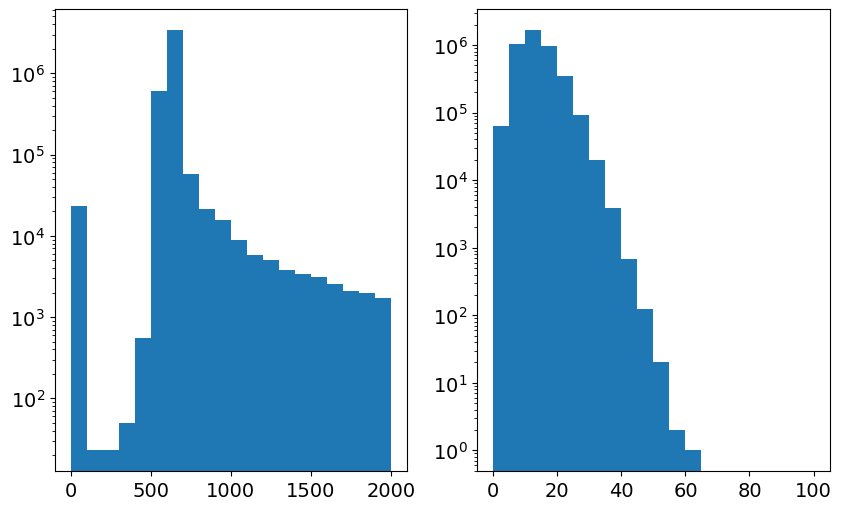

In [12]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

file = "Euclid_DET11_slitless.fits"
pf = pyfits.open(file)

data = pf['SCI'].data - 1024.
X = data.flatten()

data = pf['ERR'].data
Y = data.flatten()

fig = plt.figure()

ax1 = fig.add_subplot(121)
ax1.hist(X,bins=20, range=(0,2000))
ax1.set_yscale("log")

ax2 = fig.add_subplot(122)
ax2.hist(Y,bins=20, range=(0,100))
ax2.set_yscale("log")


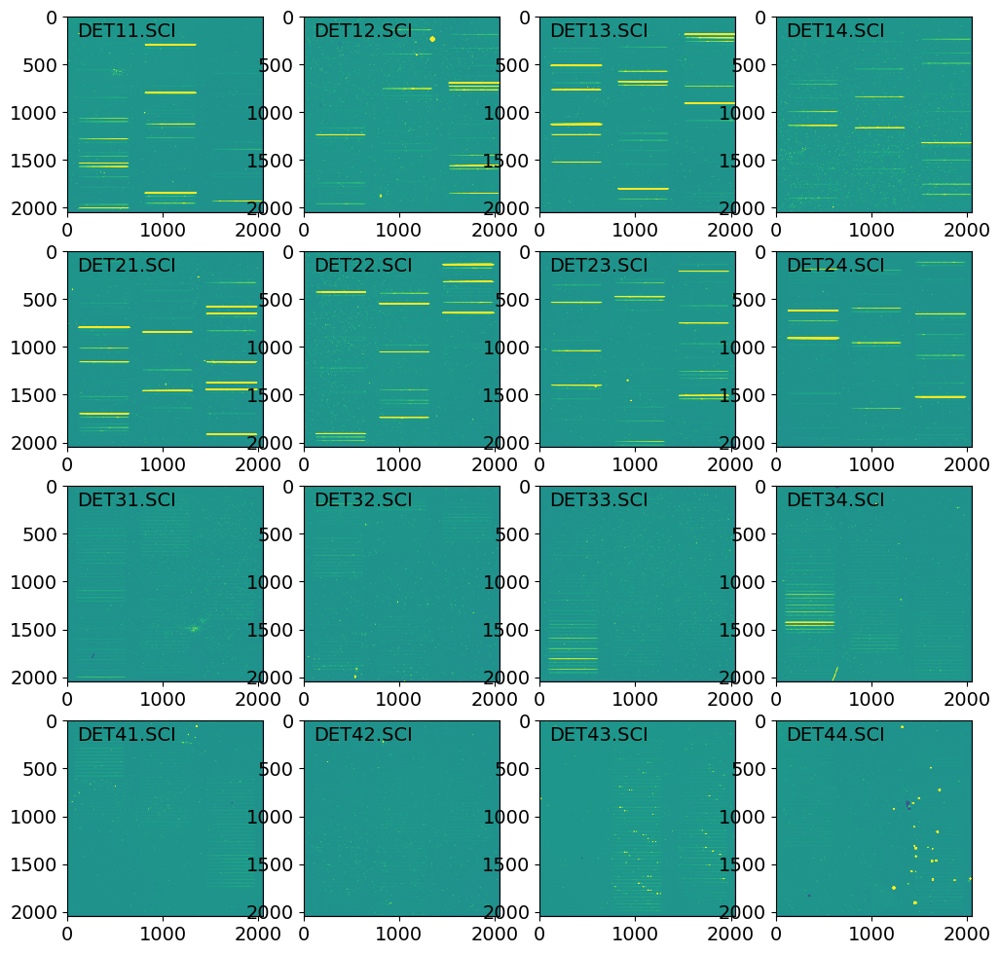

In [13]:
# Plot the slitless extensions
plot_slitless(slitless_files[0], verb=0)

In [14]:
## Read slitless headers and plot the image coordinates of the detectors relative to each other
heads = read_slitless_headers(slitless_files[0], verb=0, plot=0)
print(heads)

{'DET11.SCI': XTENSION= 'IMAGE   '           / IMAGE extension                                
BITPIX  =                   16 / number of bits per data pixel                  
NAXIS   =                    2 / number of data axes                            
NAXIS1  =                 2048 / length of data axis 1                          
NAXIS2  =                 2048 / length of data axis 2                          
PCOUNT  =                    0 / required keyword; must = 0                     
GCOUNT  =                    1 / required keyword; must = 1                     
BZERO   =                32768 / offset data range to that of unsigned short    
BSCALE  =                    1 / default scaling factor                         
EXTNAME = 'DET11.SCI'                                                           
CRVAL1  =      228.39419187752                                                  
CRVAL2  =      6.5903912393221                                                  
CRPIX1  =     

## Read the source catalog

In [15]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

print(catalog_files)
primer = Table.read(catalog_files[0]) 
print(primer.colnames)
print(len(primer))

['CATALOG_WP9_INTERMEDIATE_RUN_v2_NewCoord_mod.fits']
['SOURCE_ID', 'HALO_ID', 'KIND', 'RA', 'DEC', 'RA_MAG', 'DEC_MAG', 'Z_OBS', 'REF_MAG_ABS', 'REF_MAG', 'BULGE_FRACTION', 'BULGE_R50', 'DISK_R50', 'BULGE_NSERSIC', 'BULGE_AXIS_RATIO', 'INCLINATION_ANGLE', 'DISK_ANGLE', 'KAPPA', 'GAMMA1', 'GAMMA2', 'SED_TEMPLATE', 'EXT_LAW', 'EBV', 'HALPHA_LOGFLAM_EXT_MAG', 'HBETA_LOGFLAM_EXT_MAG', 'O2_LOGFLAM_EXT_MAG', 'O3_LOGFLAM_EXT_MAG', 'N2_LOGFLAM_EXT_MAG', 'S2_LOGFLAM_EXT_MAG', 'AV', 'TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG', 'TU_FNU_G_DECAM_MAG', 'TU_FNU_R_DECAM_MAG', 'TU_FNU_I_DECAM_MAG', 'TU_FNU_Z_DECAM_MAG', 'TU_FNU_U_MEGACAM_MAG', 'TU_FNU_R_MEGACAM_MAG', 'TU_FNU_G_JPCAM_MAG', 'TU_FNU_I_PANSTARRS_MAG', 'TU_FNU_Z_PANSTARRS_MAG', 'TU_FNU_Z_HSC_MAG', 'TU_FNU_G_GAIA_MAG', 'TU_FNU_BP_GAIA_MAG', 'TU_FNU_RP_GAIA_MAG', 'TU_FNU_U_LSST_MAG', 'TU_FNU_G_LSST_MAG', 'TU_FNU_R_LSST_MAG', 'TU_FNU_I_LSST_MAG', 'TU_FNU_Z_LSST_MAG', 'TU_FNU_Y_LSST_MAG', 'TU_FNU_U_KIDS_MAG'

In [16]:
print([col for col in primer.colnames if "TU_" in col])
Euclid_bands = ['VIS','NIR_Y','NIR_J','NIR_H']
Euclid_bands_flux = ['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG'] 

['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG', 'TU_FNU_G_DECAM_MAG', 'TU_FNU_R_DECAM_MAG', 'TU_FNU_I_DECAM_MAG', 'TU_FNU_Z_DECAM_MAG', 'TU_FNU_U_MEGACAM_MAG', 'TU_FNU_R_MEGACAM_MAG', 'TU_FNU_G_JPCAM_MAG', 'TU_FNU_I_PANSTARRS_MAG', 'TU_FNU_Z_PANSTARRS_MAG', 'TU_FNU_Z_HSC_MAG', 'TU_FNU_G_GAIA_MAG', 'TU_FNU_BP_GAIA_MAG', 'TU_FNU_RP_GAIA_MAG', 'TU_FNU_U_LSST_MAG', 'TU_FNU_G_LSST_MAG', 'TU_FNU_R_LSST_MAG', 'TU_FNU_I_LSST_MAG', 'TU_FNU_Z_LSST_MAG', 'TU_FNU_Y_LSST_MAG', 'TU_FNU_U_KIDS_MAG', 'TU_FNU_G_KIDS_MAG', 'TU_FNU_R_KIDS_MAG', 'TU_FNU_I_KIDS_MAG', 'TU_FNU_J_2MASS_MAG', 'TU_FNU_H_2MASS_MAG', 'TU_FNU_KS_2MASS_MAG']


In [17]:
primer[:10].show_in_notebook()

idx,SOURCE_ID,HALO_ID,KIND,RA,DEC,RA_MAG,DEC_MAG,Z_OBS,REF_MAG_ABS,REF_MAG,BULGE_FRACTION,BULGE_R50,DISK_R50,BULGE_NSERSIC,BULGE_AXIS_RATIO,INCLINATION_ANGLE,DISK_ANGLE,KAPPA,GAMMA1,GAMMA2,SED_TEMPLATE,EXT_LAW,EBV,HALPHA_LOGFLAM_EXT_MAG,HBETA_LOGFLAM_EXT_MAG,O2_LOGFLAM_EXT_MAG,O3_LOGFLAM_EXT_MAG,N2_LOGFLAM_EXT_MAG,S2_LOGFLAM_EXT_MAG,AV,TU_FNU_VIS_MAG,TU_FNU_Y_NISP_MAG,TU_FNU_J_NISP_MAG,TU_FNU_H_NISP_MAG,TU_FNU_G_DECAM_MAG,TU_FNU_R_DECAM_MAG,TU_FNU_I_DECAM_MAG,TU_FNU_Z_DECAM_MAG,TU_FNU_U_MEGACAM_MAG,TU_FNU_R_MEGACAM_MAG,TU_FNU_G_JPCAM_MAG,TU_FNU_I_PANSTARRS_MAG,TU_FNU_Z_PANSTARRS_MAG,TU_FNU_Z_HSC_MAG,TU_FNU_G_GAIA_MAG,TU_FNU_BP_GAIA_MAG,TU_FNU_RP_GAIA_MAG,TU_FNU_U_LSST_MAG,TU_FNU_G_LSST_MAG,TU_FNU_R_LSST_MAG,TU_FNU_I_LSST_MAG,TU_FNU_Z_LSST_MAG,TU_FNU_Y_LSST_MAG,TU_FNU_U_KIDS_MAG,TU_FNU_G_KIDS_MAG,TU_FNU_R_KIDS_MAG,TU_FNU_I_KIDS_MAG,TU_FNU_J_2MASS_MAG,TU_FNU_H_2MASS_MAG,TU_FNU_KS_2MASS_MAG,VIS,NIR_Y,NIR_J,NIR_H,SED_INDEX,SPECTRA_HDU,MASS_LOG,SFR_LOG,SIGMA_LOG,SIII_9069_LOGFLAM_EXT,SIII_9532_LOGFLAM_EXT,PaschenBETA_LOGFLAM_EXT,PaschenGAMMA_LOGFLAM_EXT,Paschen7_LOGFLAM_EXT,Paschen8_LOGFLAM_EXT,Paschen9_LOGFLAM_EXT,Paschen10_LOGFLAM_EXT,Balmer_GAMMA_LOGFLAM_EXT,Balmer_DELTA_LOGFLAM_EXT,Balmer_EPSILON_LOGFLAM_EXT,Lbol_AGN,Ldisk_AGN,logU,metallicity,alpha,FWHM,HALPHA_LOGFLAM_AGN_EXT,HBETA_LOGFLAM_AGN_EXT,O2_LOGFLAM_AGN_EXT,O3_LOGFLAM_AGN_EXT,N2_LOGFLAM_AGN_EXT,S2_LOGFLAM_AGN_EXT,SIII_9069_LOGFLAM_AGN_EXT,SIII_9532_LOGFLAM_AGN_EXT,PaschenBETA_FLAM_AGN_EXT,PaschenGAMMA_FLAM_AGN_EXT,Paschen7_FLAM_AGN_EXT,Paschen8_FLAM_AGN_EXT,Paschen9_FLAM_AGN_EXT
,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,Jy,Jy,Jy,Jy,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1191,0,1,228.74652,6.244,228.74652,6.244,0.1,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.5,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,2.560469383868375e-06,6.043357125747614e-06,1.1065422134118237e-05,2.124431167400817e-05,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,22.87920103189823,21.946804352059324,21.290080033867067,20.58189333924539,0,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,42.6,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
1,1822,0,1,228.74652,6.247,228.74652,6.247,0.2,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.25,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,2.3678139753534368e-06,4.190686633839127e-06,6.6663631344253864e-06,1.1859532869635476e-05,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,22.964131051168174,22.34428703276546,21.840277582156133,21.21483104221333,1,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,43.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
2,2806,0,1,228.74652,6.25,228.74652,6.25,0.6,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,1.2405649632756416e-06,2.099637587271171e-06,2.3382084431336903e-06,3.282033915403543e-06,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,23.665951221459235,23.094639152964227,22.977791939022264,22.609642338526854,2,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,43.6,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
3,3011,0,1,228.74652,6.253,228.74652,6.253,0.1,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.75,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,1.4898965830535686e-05,4.3777215482665326e-05,9.258969966782651e-05,0.00019338173160169024,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-9

In [18]:
primer[Euclid_bands][:10].show_in_notebook()

idx,VIS,NIR_Y,NIR_J,NIR_H
0,22.87920103189823,21.946804352059324,21.290080033867067,20.58189333924539
1,22.964131051168174,22.34428703276546,21.840277582156133,21.21483104221333
2,23.665951221459235,23.094639152964227,22.977791939022264,22.609642338526854
3,20.967109689653714,19.796879664650465,18.983593311541398,18.18396138818833
4,24.54541239600374,23.293064239480337,22.335353845173614,21.28612547653905
5,25.512887036978707,24.17330165283523,23.271649671262672,22.21933055556761
6,22.840784819520053,22.15957638744755,21.71128555192082,21.17227216545946
7,23.01188723805794,22.189283037169112,21.896121217548476,21.326601779533178
8,23.553351189279216,22.672226162990697,22.427581480427598,21.880654286113398
9,25.251711028755764,23.82423181861356,23.320011774347083,22.412133284066034


In [19]:
primer[Euclid_bands_flux][:10].show_in_notebook()

idx,TU_FNU_VIS_MAG,TU_FNU_Y_NISP_MAG,TU_FNU_J_NISP_MAG,TU_FNU_H_NISP_MAG
,Jy,Jy,Jy,Jy
0,2.560469383868375e-06,6.043357125747614e-06,1.1065422134118237e-05,2.124431167400817e-05
1,2.3678139753534368e-06,4.190686633839127e-06,6.6663631344253864e-06,1.1859532869635476e-05
2,1.2405649632756416e-06,2.099637587271171e-06,2.3382084431336903e-06,3.282033915403543e-06
3,1.4898965830535686e-05,4.3777215482665326e-05,9.258969966782651e-05,0.00019338173160169024
4,5.518677831089382e-07,1.7489375579573614e-06,4.2253088755053984e-06,1.1105799008227512e-05
5,2.2638371641263906e-07,7.774623001296257e-07,1.7837752406736063e-06,4.701839257741701e-06
6,2.6526873856706776e-06,4.967861104968473e-06,7.507334713034171e-06,1.2333636192499046e-05
7,2.2659227760640147e-06,4.833778938970656e-06,6.332154648560086e-06,1.0699396653061998e-05
8,1.3761301951837212e-06,3.0982006077930456e-06,3.881212378553296e-06,6.423005376586535e-06


## Plot the magnitude histogram of sources

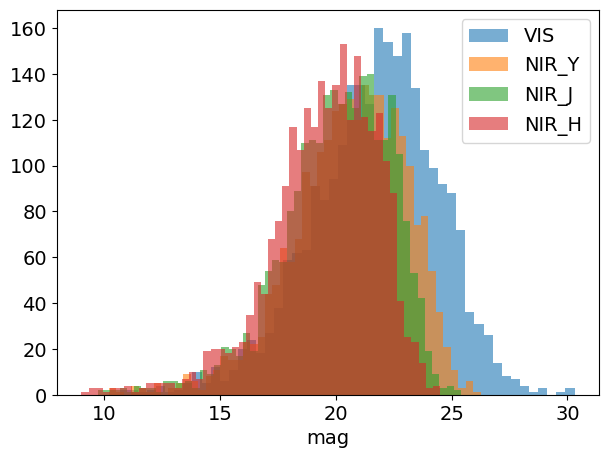

In [20]:
primer['TU_FNU_VIS_MAG'] # Jy
primer['TU_FNU_Y_NISP_MAG'] # Jy
primer['TU_FNU_J_NISP_MAG'] # Jy
primer['TU_FNU_H_NISP_MAG'] # Jy
primer['VIS'] # mag
primer['NIR_Y'] # mag
primer['NIR_J'] # mag
primer['NIR_H'] # mag

fig = plt.figure(figsize=(7,5))

p1 = fig.add_subplot(111)
p1.hist(primer['VIS'], bins=50, alpha=0.6, label="VIS")
p1.hist(primer['NIR_Y'], bins=50, alpha=0.6, label="NIR_Y")
p1.hist(primer['NIR_J'], bins=50, alpha=0.6, label="NIR_J")
p1.hist(primer['NIR_H'], bins=50, alpha=0.6, label="NIR_H")
p1.set_xlabel("mag")
p1.legend()
plt.show()

## Plot the RA and Dec distribution across the detectors

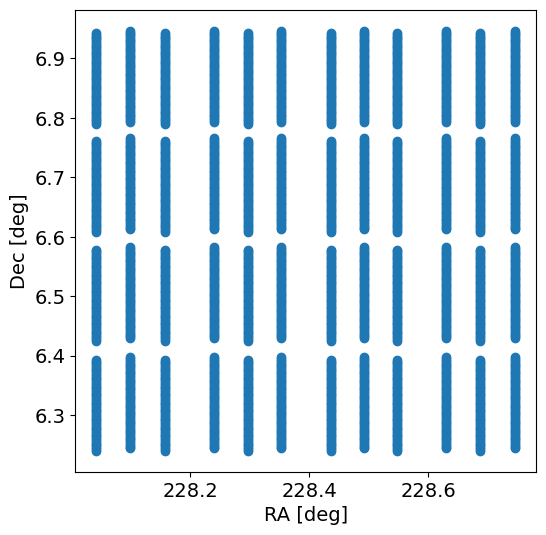

In [21]:
fig = plt.figure()

p1 = fig.add_subplot(111)
p1.scatter(primer['RA'],primer['DEC'])
p1.set_aspect(1.)
p1.set_xlabel("RA [deg]")
p1.set_ylabel("Dec [deg]")

plt.show()

In [22]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep', 'Input_Thumbnails'))
direct_thumbnail_files = glob.glob('NIS_catalog_file_??.thm.beamA.fits')
direct_thumbnail_files.sort()
print(direct_thumbnail_files)
print(len(direct_thumbnail_files))

['NIS_catalog_file_11.thm.beamA.fits', 'NIS_catalog_file_12.thm.beamA.fits', 'NIS_catalog_file_13.thm.beamA.fits', 'NIS_catalog_file_14.thm.beamA.fits', 'NIS_catalog_file_21.thm.beamA.fits', 'NIS_catalog_file_22.thm.beamA.fits', 'NIS_catalog_file_23.thm.beamA.fits', 'NIS_catalog_file_24.thm.beamA.fits', 'NIS_catalog_file_31.thm.beamA.fits', 'NIS_catalog_file_32.thm.beamA.fits', 'NIS_catalog_file_33.thm.beamA.fits', 'NIS_catalog_file_34.thm.beamA.fits', 'NIS_catalog_file_41.thm.beamA.fits', 'NIS_catalog_file_42.thm.beamA.fits', 'NIS_catalog_file_43.thm.beamA.fits', 'NIS_catalog_file_44.thm.beamA.fits']
16


In [23]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep', 'Input_Thumbnails'))
## Map the sources the sources from the catalog to the detectors 
#det_tbl, det_dict = map_src_to_det(plot=0)
det_dict = map_src_to_det(primer, heads, plot=0)

1 1
[1191, 1822, 2806, 3011, 3083, 3084, 3224, 3575, 3576, 3716, 3785, 3851, 3924, 3994, 4211, 4213, 4342, 4344, 4485, 4831, 4903, 4906, 5113, 5116, 5325, 5391, 5461, 5471, 5612, 5680, 5688, 5741, 5812, 5818, 5825, 5882, 5952, 5957, 6021, 6091, 6093, 6095, 6162, 6168, 6173, 6304, 6314, 6325, 6344, 6395, 6442, 6511, 16825, 16830, 16881, 16913, 16958, 17151, 17159, 17173, 17174, 17176, 17193, 17198, 17218, 17220, 17233, 17261, 17310, 17366, 17376, 17501, 17586, 17587, 17589, 17590, 17649, 17650, 17652, 17654, 17713, 17716, 17726, 17802, 17858, 17873, 17882, 17887, 17896, 17903, 17905, 17910, 17943, 17946, 17949, 17959, 17961, 17980, 18013, 18142, 18201, 18209, 18215, 18276, 31014, 31082, 31225, 31361, 31574, 31645, 31924, 32412, 32553, 32555, 32692, 32693, 33252, 33333, 33536, 33614, 33815, 33824, 33954, 33960, 33973, 33975, 34100, 34164, 34378, 34386, 34516, 34595, 34665, 34688, 34733, 34746, 34794, 34809, 34932, 34943, 34947, 35012, 35051, 35085, 35157, 35356, 35357, 35371, 35375, 3538

[6344, 6395, 6442, 6511, 6662, 6676, 6695, 6696, 6741, 6800, 6873, 7013, 7026, 7053, 7064, 7093, 7158, 7165, 7219, 7288, 7360, 7372, 7375, 7393, 7400, 7460, 7497, 7507, 7513, 7572, 7583, 7634, 7646, 7703, 7708, 7717, 7734, 7746, 7755, 7765, 7769, 7806, 7811, 7813, 7852, 7864, 7867, 7914, 7916, 7931, 8063, 8094, 8119, 8125, 8153, 8175, 18215, 18276, 18277, 18297, 18332, 18333, 18340, 18380, 18432, 18486, 18490, 18496, 18497, 18505, 18582, 18587, 18615, 18617, 18673, 18765, 18774, 18838, 18840, 18857, 19041, 19602, 19952, 21354, 21424, 21491, 21632, 21701, 21705, 21984, 22054, 22401, 22545, 22751, 22754, 23106, 23112, 23180, 23465, 23809, 23817, 23950, 24012, 24165, 24227, 24233, 24302, 24305, 24436, 24587, 35456, 35492, 35498, 35514, 35563, 35566, 35570, 35766, 35775, 35790, 35812, 35848, 35859, 35915, 35927, 35934, 35985, 35991, 36051, 36052, 36053, 36063, 36096, 36115, 36158, 36163, 36164, 36172, 36272, 36338, 36412, 36431, 36434, 36459, 36478, 36487, 36501, 36554, 36560, 36614, 36617

[12743, 12745, 12813, 13305, 13310, 13371, 13441, 13581, 13584, 13660, 13725, 13732, 13796, 13936, 14006, 14010, 14084, 14142, 14146, 14281, 14491, 14497, 14563, 14703, 14842, 15058, 15062, 15136, 15331, 15408, 15474, 15482, 15541, 15545, 15555, 15759, 15900, 15906, 16121, 16142, 16184, 16261, 16262, 16384, 16460, 16462, 16473, 16499, 16515, 16525, 16535, 16544, 16670, 16805, 16810, 16812, 16816, 26956, 26968, 26983, 27002, 27010, 27012, 27016, 27029, 27061, 27063, 27071, 27173, 27319, 27346, 27370, 27377, 27388, 27404, 27456, 27522, 27525, 27536, 27607, 27657, 27667, 27680, 27682, 27693, 27699, 27711, 27713, 27715, 27724, 27738, 27743, 27752, 27831, 27877, 27878, 28083, 28093, 28118, 28161, 28166, 28219, 28222, 28226, 28228, 28911, 29402, 29541, 30733, 30803, 30942, 30943, 42281, 42422, 42435, 42562, 42564, 42782, 42843, 43191, 43193, 43837, 43906, 44032, 44036, 44044, 44102, 44138, 44145, 44245, 44247, 44319, 44387, 44389, 44391, 44525, 44531, 44539, 44605, 44614, 44733, 44736, 44822

[46926, 46970, 46987, 47007, 47016, 47069, 47075, 47087, 47127, 47137, 47183, 47188, 48722, 48792, 49141, 49632, 49705, 49774, 49914, 49982, 50053, 50404, 51034, 51171, 51241, 51243, 51523, 51592, 51600, 51735, 51803, 51806, 51941, 52152, 52158, 52294, 52433, 52644, 52653, 52712, 52720, 52722, 52927, 52935, 53073, 53136, 53142, 53208, 53224, 53287, 53352, 53551, 53552, 53692, 64114, 64117, 64129, 64142, 64146, 64163, 64413, 64423, 64435, 64467, 64481, 64543, 64553, 64627, 64681, 64692, 64763, 64791, 64795, 64834, 64847, 64870, 64872, 64908, 64915, 64929, 64965, 64976, 65032, 65129, 65141, 65149, 65167, 65186, 65191, 65193, 65209, 65211, 65230, 65245, 65263, 65277, 65315, 65385, 65388, 65396, 65406, 65454, 65472, 65495, 65514, 65542, 65543, 65551, 65557, 65570, 75042, 75090, 75111, 75115, 75122, 75123, 75136, 75182, 75195, 75269, 75272, 75275, 75371, 75396, 75418, 75441, 75531, 75553, 75741, 76091, 77353, 77771, 78192, 78332, 78543, 78821, 79171, 79316, 79454, 79531, 79595, 79872, 80162

[55769, 55827, 55836, 55881, 55885, 55934, 56014, 56017, 56020, 56024, 56046, 56049, 56051, 56109, 56131, 56157, 56176, 56353, 56377, 56378, 56428, 56439, 56446, 56482, 56490, 56491, 56524, 56571, 56648, 57051, 58242, 58802, 58872, 59082, 59712, 59923, 60483, 60485, 60555, 60625, 60762, 61251, 61260, 61326, 61602, 61614, 61681, 61755, 62027, 62094, 62105, 62162, 62235, 62241, 62303, 71551, 71771, 71894, 72031, 72102, 72120, 72172, 72173, 72184, 72188, 72314, 72393, 72396, 72455, 72476, 72526, 72602, 72802, 72803, 72820, 72823, 72844, 72846, 72849, 72957, 72960, 73084, 73152, 73154, 73160, 73191, 73199, 73243, 73247, 73258, 73259, 73310, 73373, 73378, 73435, 73444, 73446, 73527, 73540, 73542, 73615, 73643, 73659, 73667, 73722, 73727, 73787, 73905, 73908, 73915, 73928, 73941, 83873, 83939, 83952, 84006, 84010, 84027, 84037, 84052, 84081, 84090, 84096, 84105, 84121, 84122, 84164, 84178, 84179, 84181, 84212, 84217, 84223, 84289, 84301, 84306, 84360, 84367, 84369, 84375, 84383, 84402, 84426

[199636, 199815, 199825, 200939, 201128, 201148, 201526, 232690, 234391, 235336, 235346, 235724, 235913, 236112, 236659, 237047, 237057, 237236, 237246, 237415, 237624, 237803, 238191, 238380, 238559, 238947, 268977, 269365, 269733, 269743, 270867, 271255, 271434, 271633, 272956, 273155, 273324, 273334, 274100, 274458, 274468, 274478, 274846, 275035, 275403, 275413, 275423, 275791, 276557, 277691, 278258, 278437, 278825, 309044, 310188, 310745, 238967, 239146, 239186, 239544, 239902, 240091, 270897, 272071, 272439, 272449, 272807, 272827, 273165, 273185, 273195, 273543, 273563, 273921, 273931, 273941, 274339, 275065, 275075, 275433, 275443, 275811, 276010, 276378, 276398, 276597, 276607, 277144, 277154, 277164, 277343, 277542, 277701, 277711, 277900, 278079, 278089, 278109, 278119, 278268, 278298, 278308, 278457, 278467, 278676, 278686, 278855, 278865, 279233, 279621, 577457, 577487, 577835, 577845, 577865, 578392, 578402, 578591, 578959, 579347, 579377, 579745, 579755, 579934, 580292,

[354234, 354791, 354990, 535092, 536614, 537748, 538504, 538882, 539260, 539628, 540016, 541339, 543418, 543607, 570991, 572881, 573637, 573657, 574035, 574393, 574960, 575338, 575348, 575527, 575726, 575905, 575925, 576094, 576303, 576661, 576671, 577984, 578173, 578362, 578571, 578740, 578949, 579118, 579327, 579516, 579685, 579874, 580083, 580272, 123491, 124247, 124267, 124804, 124993, 125371, 125381, 125391, 125401, 125789, 126535, 126724, 160902, 348385, 348395, 348763, 348773, 349141, 349907, 349917, 349927, 350305, 350315, 350653, 350663, 350693, 351041, 351051, 351071, 351409, 351787, 351797, 351986, 352165, 352175, 352185, 352205, 352354, 352364, 352384, 352732, 352921, 352961, 353140, 353150, 353299, 353319, 353329, 353339, 353508, 353876, 353886, 353896, 354075, 354085, 354463, 354821, 355000, 355010, 355199, 355388, 355408, 536246, 538912, 539280, 539300, 539668, 540056, 200263, 200267, 200459, 200460, 200641, 200835, 200837, 200838, 201213, 201216, 201397, 201401, 201402,

[275873, 276056, 276434, 276435, 276627, 276629, 276806, 276813, 276999, 277002, 277004, 277006, 277184, 277384, 277562, 277566, 277567, 277751, 277755, 277762, 277949, 278134, 278135, 278137, 278318, 278324, 278327, 278329, 278330, 278512, 278515, 278519, 278704, 278707, 278708, 278885, 278896, 278897, 279078, 279085, 279269, 279274, 279458, 279461, 279464, 279646, 279647, 279651, 279836, 279837, 279838, 279841, 279842, 312148, 541978, 542155, 542727, 542729, 542917, 543107, 543289, 543295, 543485, 543488, 543667, 543674, 543675, 543676, 543861, 543867, 544050, 544240, 544241, 544246, 544428, 544431, 544435, 544612, 544621, 544806, 544807, 544809, 544813, 544990, 544994, 544997, 545000, 545001, 545002, 545183, 545184, 545186, 545189, 545191, 545368, 545372, 545562, 545563, 545565, 545567, 545750, 545940, 545944, 545945, 545946, 545947, 546129, 546321, 546323, 546502, 278525, 278901, 278903, 278905, 279281, 279282, 279285, 279654, 279661, 279662, 318967, 318968, 319343, 319348, 319726,

[318578, 318579, 318586, 318774, 318775, 318956, 318958, 319141, 319145, 319146, 319153, 319335, 319523, 319524, 319525, 319527, 319530, 319531, 319716, 319718, 319719, 319904, 320093, 320096, 320279, 320284, 320471, 320472, 320475, 320476, 320659, 320660, 320854, 321041, 321043, 321418, 321799, 349947, 350331, 350703, 350711, 351081, 351090, 351459, 351469, 351845, 352026, 352219, 352220, 352224, 352601, 352603, 352976, 352978, 352983, 549725, 550103, 550104, 550105, 616060, 616437, 617192, 617193, 617194, 617195, 617196, 617197, 617572, 617948, 617951, 652339, 652346, 653103, 653473, 653477, 653479, 653484, 653851, 653856, 653857, 654238, 654616, 654617, 654619, 654992, 654994, 654997, 655178, 655363, 655370, 655374, 655557, 655741, 655745, 655747, 655751, 655753, 655935, 690142, 690516, 690894, 690899, 691280, 691656, 692034, 692037, 692038, 692222, 692406, 692410, 692412, 692413, 278531, 278538, 278908, 279286, 279289, 321626, 321627, 321999, 322001, 322382, 322385, 322758, 322759,

## Print each of the detectors WCS header information

In [24]:
from astropy import wcs

os.chdir(os.path.join(HOME_PATH, root, 'Prep'))
wcs_temp = "Euclid_DET%s_wcs.fits"

for i in range(0,4): 
    for j in range(0,4):
        print(i+1,j+1)
        num = '%i%i' % (i+1,j+1)
        hdu = pyfits.open(wcs_temp % (num), ignore_missing_simple=True)    
        head = hdu[0].header
        #print(head)
        print(head['CRVAL1'],head['CRVAL2'],head['CRPIX1'],head['CRPIX2'])

1 1
228.39419187752 6.5903912393221 4578.75045083333 4331.37522541667
1 2
228.39419187752 6.5903912393221 4578.75045083333 2126.45840847222
1 3
228.39419187752 6.5903912393221 4578.75045083333 -78.4584084722222
1 4
228.39419187752 6.5903912393221 4578.75045083333 -2283.37522541667
2 1
228.39419187752 6.5903912393221 2208.91681694444 4331.37522541667
2 2
228.39419187752 6.5903912393221 2208.91681694444 2126.45840847222
2 3
228.39419187752 6.5903912393221 2208.91681694444 -78.4584084722222
2 4
228.39419187752 6.5903912393221 2208.91681694444 -2283.37522541667
3 1
228.39419187752 6.5903912393221 -160.916816944444 4331.37522541667
3 2
228.39419187752 6.5903912393221 -160.916816944444 2126.45840847222
3 3
228.39419187752 6.5903912393221 -160.916816944444 -78.4584084722222
3 4
228.39419187752 6.5903912393221 -160.916816944444 -2283.37522541667
4 1
228.39419187752 6.5903912393221 -2530.75045083333 4331.37522541667
4 2
228.39419187752 6.5903912393221 -2530.75045083333 2126.45840847222
4 3
228.

In [25]:
primer["TU_FNU_H_NISP_MAG","NIR_H"][:10].show_in_notebook()

idx,TU_FNU_H_NISP_MAG,NIR_H
,Jy,
0,2.124431167400817e-05,20.58189333924539
1,1.1859532869635476e-05,21.21483104221333
2,3.282033915403543e-06,22.609642338526854
3,0.00019338173160169024,18.18396138818833
4,1.1105799008227512e-05,21.28612547653905
5,4.701839257741701e-06,22.21933055556761
6,1.2333636192499046e-05,21.17227216545946
7,1.0699396653061998e-05,21.326601779533178
8,6.423005376586535e-06,21.880654286113398


In [ ]:
#    # effective wavelength (pivot wavelength)
#    # http://www.astro.ljmu.ac.uk/~ikb/research/mags-fluxes/
#    numerator = integrate.trapz(tran,wav)
#    denominator = integrate.trapz(tran/wav**2,wav)
#    effwav_sq = numerator/denominator
#    effwav = np.sqrt(effwav_sq)

from scipy import integrate

def calc_pivot(wav,tran):
    
    numerator = integrate.trapz(tran * wav, wav)
    denominator = integrate.trapz(tran / wav, wav)    
    pivot = np.sqrt(numerator/denominator)
    
    return pivot

## Create input table for the reference image

In [26]:
thumb_temp = 'NIS_catalog_file_%s.thm.beamA.fits'
os.chdir(os.path.join(HOME_PATH, root, 'Prep', 'Input_Thumbnails'))

source_ids = []
thumbs = []

for i in range(0,4): 
    for j in range(0,4):
        num = '%i%i' % (i+1,j+1)
        hdus = pyfits.open(thumb_temp % (num))
        source_ids += [h.header['EXTNAME'] for h in hdus[1:]]
        thumbs += [h.data for h in hdus[1:]]
        
print(source_ids)
print(len(source_ids))

print(set(source_ids))
print(len(set(source_ids)))

print(sys.getsizeof([]),"bytes")
print(sys.getsizeof([1]),"bytes") 
print(sys.getsizeof(source_ids),"bytes")   

src_tbl = Table([source_ids,thumbs], names=['SOURCE_ID','THUMB'])
all_tbl = join(src_tbl, primer, keys='SOURCE_ID')
final_tbl = unique(all_tbl, keys='SOURCE_ID') # look for duplicate entries

print(len(all_tbl))
print(len(final_tbl))
#world = [[ra,dec] for ra,dec in det_tbl['RA','DEC']]
#world = [[ra,dec] for ra,dec in det_tbl['RA','DEC']]
ra = all_tbl['RA']
dec = all_tbl['DEC']

ra_avg = np.mean(ra)
dec_avg = np.mean(dec)
print(ra_avg)
print(dec_avg)

[1191, 1822, 2806, 3011, 3083, 3084, 3224, 3575, 3576, 3716, 3785, 3851, 3924, 3994, 4211, 4213, 4342, 4344, 4485, 4831, 4903, 4906, 5113, 5116, 5325, 5391, 5461, 5471, 5612, 5680, 5688, 5741, 5812, 5818, 5825, 5882, 5952, 5957, 6021, 6091, 6093, 6095, 6162, 6168, 6173, 6304, 6314, 6325, 6344, 6395, 6442, 6511, 16825, 16830, 16881, 16913, 16958, 17151, 17159, 17173, 17174, 17176, 17193, 17198, 17218, 17220, 17233, 17261, 17310, 17366, 17376, 17501, 17586, 17587, 17589, 17590, 17649, 17650, 17652, 17654, 17713, 17716, 17726, 17802, 17858, 17873, 17882, 17887, 17896, 17903, 17905, 17910, 17943, 17946, 17949, 17959, 17961, 17980, 18013, 18142, 18201, 18209, 18215, 18276, 31014, 31082, 31225, 31361, 31574, 31645, 31924, 32412, 32553, 32555, 32692, 32693, 33252, 33333, 33536, 33614, 33815, 33824, 33954, 33960, 33973, 33975, 34100, 34164, 34378, 34386, 34516, 34595, 34665, 34688, 34733, 34746, 34794, 34809, 34932, 34943, 34947, 35012, 35051, 35085, 35157, 35356, 35357, 35371, 35375, 35388, 3

In [27]:
all_tbl[:10].show_in_notebook()

idx,SOURCE_ID,THUMB,HALO_ID,KIND,RA,DEC,RA_MAG,DEC_MAG,Z_OBS,REF_MAG_ABS,REF_MAG,BULGE_FRACTION,BULGE_R50,DISK_R50,BULGE_NSERSIC,BULGE_AXIS_RATIO,INCLINATION_ANGLE,DISK_ANGLE,KAPPA,GAMMA1,GAMMA2,SED_TEMPLATE,EXT_LAW,EBV,HALPHA_LOGFLAM_EXT_MAG,HBETA_LOGFLAM_EXT_MAG,O2_LOGFLAM_EXT_MAG,O3_LOGFLAM_EXT_MAG,N2_LOGFLAM_EXT_MAG,S2_LOGFLAM_EXT_MAG,AV,TU_FNU_VIS_MAG,TU_FNU_Y_NISP_MAG,TU_FNU_J_NISP_MAG,TU_FNU_H_NISP_MAG,TU_FNU_G_DECAM_MAG,TU_FNU_R_DECAM_MAG,TU_FNU_I_DECAM_MAG,TU_FNU_Z_DECAM_MAG,TU_FNU_U_MEGACAM_MAG,TU_FNU_R_MEGACAM_MAG,TU_FNU_G_JPCAM_MAG,TU_FNU_I_PANSTARRS_MAG,TU_FNU_Z_PANSTARRS_MAG,TU_FNU_Z_HSC_MAG,TU_FNU_G_GAIA_MAG,TU_FNU_BP_GAIA_MAG,TU_FNU_RP_GAIA_MAG,TU_FNU_U_LSST_MAG,TU_FNU_G_LSST_MAG,TU_FNU_R_LSST_MAG,TU_FNU_I_LSST_MAG,TU_FNU_Z_LSST_MAG,TU_FNU_Y_LSST_MAG,TU_FNU_U_KIDS_MAG,TU_FNU_G_KIDS_MAG,TU_FNU_R_KIDS_MAG,TU_FNU_I_KIDS_MAG,TU_FNU_J_2MASS_MAG,TU_FNU_H_2MASS_MAG,TU_FNU_KS_2MASS_MAG,VIS,NIR_Y,NIR_J,NIR_H,SED_INDEX,SPECTRA_HDU,MASS_LOG,SFR_LOG,SIGMA_LOG,SIII_9069_LOGFLAM_EXT,SIII_9532_LOGFLAM_EXT,PaschenBETA_LOGFLAM_EXT,PaschenGAMMA_LOGFLAM_EXT,Paschen7_LOGFLAM_EXT,Paschen8_LOGFLAM_EXT,Paschen9_LOGFLAM_EXT,Paschen10_LOGFLAM_EXT,Balmer_GAMMA_LOGFLAM_EXT,Balmer_DELTA_LOGFLAM_EXT,Balmer_EPSILON_LOGFLAM_EXT,Lbol_AGN,Ldisk_AGN,logU,metallicity,alpha,FWHM,HALPHA_LOGFLAM_AGN_EXT,HBETA_LOGFLAM_AGN_EXT,O2_LOGFLAM_AGN_EXT,O3_LOGFLAM_AGN_EXT,N2_LOGFLAM_AGN_EXT,S2_LOGFLAM_AGN_EXT,SIII_9069_LOGFLAM_AGN_EXT,SIII_9532_LOGFLAM_AGN_EXT,PaschenBETA_FLAM_AGN_EXT,PaschenGAMMA_FLAM_AGN_EXT,Paschen7_FLAM_AGN_EXT,Paschen8_FLAM_AGN_EXT,Paschen9_FLAM_AGN_EXT
,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,Jy,Jy,Jy,Jy,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1191,0.0 .. 0.0,0,1,228.74652,6.244,228.74652,6.244,0.1,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.5,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,2.560469383868375e-06,6.043357125747614e-06,1.1065422134118237e-05,2.124431167400817e-05,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,22.87920103189823,21.946804352059324,21.290080033867067,20.58189333924539,0,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,42.6,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
1,1822,0.0 .. 0.0,0,1,228.74652,6.247,228.74652,6.247,0.2,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.25,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,2.3678139753534368e-06,4.190686633839127e-06,6.6663631344253864e-06,1.1859532869635476e-05,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,22.964131051168174,22.34428703276546,21.840277582156133,21.21483104221333,1,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,43.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
2,2806,0.0 .. 0.0,0,1,228.74652,6.25,228.74652,6.25,0.6,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,1.2405649632756416e-06,2.099637587271171e-06,2.3382084431336903e-06,3.282033915403543e-06,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,23.665951221459235,23.094639152964227,22.977791939022264,22.609642338526854,2,2,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,43.6,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99,-99.0,-99.0,-99.0,-99.0,-99.0
3,3011,0.0 .. 0.0,0,1,228.74652,6.253,228.74652,6.253,0.1,-99.0,-99.0,1.0,0.25,0.25,1,1,0,0.0,0.0001,0.0001,0.0001,1.0,-99.0,0.75,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,-99.0,1.4898965830535686e-05,4.3777215482665326e-05,9.258969966782651e-05,0.00019338173160

In [28]:
print(primer)
print(primer.colnames)

SOURCE_ID HALO_ID KIND ... Paschen8_FLAM_AGN_EXT Paschen9_FLAM_AGN_EXT
                       ...                                            
--------- ------- ---- ... --------------------- ---------------------
     1191       0    1 ...                 -99.0                 -99.0
     1822       0    1 ...                 -99.0                 -99.0
     2806       0    1 ...                 -99.0                 -99.0
     3011       0    1 ...                 -99.0                 -99.0
     3083       0    1 ...                 -99.0                 -99.0
     3084       0    1 ...                 -99.0                 -99.0
      ...     ...  ... ...                   ...                   ...
   550683       0    1 ...            -15.736602            -15.919489
   550684       0    1 ...            -15.223917            -15.402116
   550693       0    1 ...            -15.382325            -15.560085
   551062       0    1 ...            -15.029189            -15.206567
   551

## Create reference images

In [29]:
# Mauri et al. 2020
# (ropper et al. 2016
os.chdir(os.path.join(HOME_PATH, root, 'Prep', 'Input_Thumbnails'))

# noise characteristics of "direct image"
# Scaramella et al. 2022 - Euclid preparation I. The Euclid Wide Survey
# RGS000, RGS180, RGS000_rot, RGS180_rot
spec_exptime = 574 # seconds
spec_gain = 2.0

[[228.74652, 6.244]]
[[799.13957747 792.04935018]]
0
(22, 22)
12.852771148397999
12.850285
788 810
781 803

[[228.74652, 6.247]]
[[799.16498625 828.05446304]]
1
(22, 22)
11.885700074733126
11.8834
788 810
817 839

[[228.74652, 6.25]]
[[799.19039096 864.05383065]]
2
(22, 22)
6.227255700911068
6.226051
788 810
853 875

[[228.74652, 6.253]]
[[799.21579567 900.05317557]]
3
(22, 22)
74.78823975562158
74.77377
788 810
889 911

[[228.74652, 6.256]]
[[799.24120439 936.05822036]]
4
(22, 22)
2.770207042958946
2.769671
788 810
925 947

[[228.74652, 6.259]]
[[799.26660906 972.0575205 ]]
5
(22, 22)
1.1363768366484235
1.136157
788 810
961 983

[[228.74652, 6.262]]
[[ 799.29201775 1008.06252089]]
6
(22, 22)
13.315677239130807
13.313101
788 810
997 1019

[[228.74652, 6.265]]
[[ 799.31742239 1044.06177703]]
7
(22, 22)
11.374237498865797
11.372036
788 810
1033 1055

[[228.74652, 6.268]]
[[ 799.34283106 1080.06673382]]
8
(22, 22)
6.907751594504468
6.906415
788 810
1069 1091

[[228.74652, 6.271]]
[[ 799.3

[[228.49284, 6.328]]
[[3825.51563157 1798.78772507]]
906
(22, 22)
10.459975136565022
10.457951
3815 3837
1788 1810

[[228.49284, 6.331]]
[[3825.52273088 1834.78593873]]
907
(22, 22)
6.440285429995403
6.439039
3815 3837
1824 1846

[[228.49284, 6.334]]
[[3825.52983132 1870.78985721]]
908
(22, 22)
3818.3253064389346
3817.5864
3815 3837
1860 1882

[[228.49284, 6.337]]
[[3825.53693063 1906.78803637]]
909
(22, 22)
39.843269366471596
39.835564
3815 3837
1896 1918

[[228.49284, 6.34]]
[[3825.54403106 1942.79192074]]
910
(22, 22)
16.87795951122392
16.874695
3815 3837
1932 1954

[[228.49284, 6.343]]
[[3825.55113036 1978.79006619]]
911
(22, 22)
2.1734281997704024
2.1730077
3815 3837
1968 1990

[[228.49284, 6.346]]
[[3825.55823079 2014.79391723]]
912
(22, 22)
35.770061046327385
35.76314
3815 3837
2004 2026

[[228.49284, 6.349]]
[[3825.56533008 2050.79202975]]
913
(22, 22)
15.207951734512614
15.205009
3815 3837
2040 2062

[[228.49284, 6.352]]
[[3825.5724305  2086.79584826]]
914
(22, 22)
49428.87567

[[228.15662, 6.5483913]]
[[7834.4616034  4444.06609593]]
1816
(22, 22)
14.078683239460878
14.075959
7823 7845
4433 4455

[[228.15662, 6.551391]]
[[7834.44444211 4480.06381071]]
1817
(22, 22)
7.857228199248296
7.855708
7823 7845
4469 4491

[[228.29654, 6.578391]]
[[6166.25288517 4803.50611905]]
1818
(22, 22)
210.68415503075832
210.6434
6155 6177
4793 4815

[[228.29654, 6.578391]]
[[6166.25288517 4803.50611905]]
1819
(22, 22)
210.68415503075832
210.6434
6155 6177
4793 4815

[[228.15662, 6.5543914]]
[[7834.42727809 4516.06724474]]
1820
(22, 22)
55.72738600629262
55.716606
7823 7845
4505 4527

[[228.15662, 6.557391]]
[[7834.4101168  4552.06495401]]
1821
(22, 22)
39.868734300726615
39.86102
7823 7845
4541 4563

[[228.15662, 6.5603914]]
[[7834.39295279 4588.06838292]]
1822
(22, 22)
14.482954072844654
14.480153
7823 7845
4577 4599

[[228.04187, 6.440391]]
[[9203.38379058 3148.83832602]]
1823
(22, 22)
8.379819871603944
8.378199
9192 9214
3138 3160

[[228.04187, 6.4433913]]
[[9203.35834512 3184

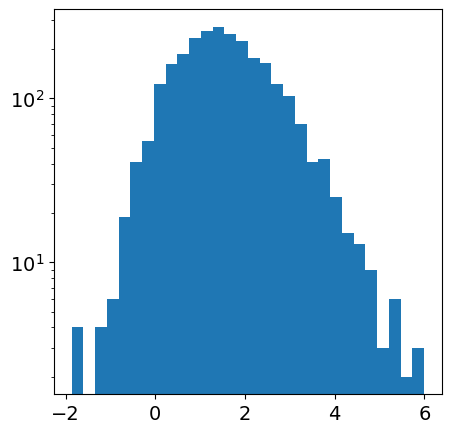

In [33]:
nexp = 4 

# VIS 
readnoise = 4.5  # e-
background = 1.2 # e-/s
#pixel_size = 12. # um
dir_gain = 1.0   # e-/photon

# VIS
flux_key = "TU_FNU_VIS_MAG"
mag_key = "VIS"
dir_exptime = 570 # seconds
wav_cen = 7102.613 # calculated from pivot
wav_width = 9000. - 5600.
eff_tot = 0.70
#eff_tot = 0.74
output = "Euclid_VIS_ref.fits"
filt = "VIS"
instr = "VIS"

test_fluxes_vis, test_mags_vis = fake_euclid_ref(all_tbl, ra_cen = ra_avg, dec_cen = dec_avg, 
                                         pixel_scale = 0.3, flux_key=flux_key, mag_key=mag_key, 
                                         gain=dir_gain, background=background, exptime=dir_exptime, 
                                         nexp=nexp, readnoise=readnoise, wav_cen=wav_cen, 
                                         wav_width=wav_width, eff_tot=eff_tot, output=output, 
                                         filt=filt, instr = instr)


[[228.74652, 6.244]]
[[799.13957747 792.04935018]]
0
(22, 22)
16.98589745151575
16.98261
788 810
781 803

[[228.74652, 6.247]]
[[799.16498625 828.05446304]]
1
(22, 22)
11.77864751870398
11.776368
788 810
817 839

[[228.74652, 6.25]]
[[799.19039096 864.05383065]]
2
(22, 22)
5.901393546773738
5.9002514
788 810
853 875

[[228.74652, 6.253]]
[[799.21579567 900.05317557]]
3
(22, 22)
123.04341402122117
123.019615
788 810
889 911

[[228.74652, 6.256]]
[[799.24120439 936.05822036]]
4
(22, 22)
4.91569063195038
4.9147396
788 810
925 947

[[228.74652, 6.259]]
[[799.26660906 972.0575205 ]]
5
(22, 22)
2.1851918772362313
2.1847692
788 810
961 983

[[228.74652, 6.262]]
[[ 799.29201775 1008.06252089]]
6
(22, 22)
13.96303040289535
13.96033
788 810
997 1019

[[228.74652, 6.265]]
[[ 799.31742239 1044.06177703]]
7
(22, 22)
13.586169351276748
13.58354
788 810
1033 1055

[[228.74652, 6.268]]
[[ 799.34283106 1080.06673382]]
8
(22, 22)
8.708027130150148
8.706343
788 810
1069 1091

[[228.74652, 6.271]]
[[ 799.

[[228.49284, 6.343]]
[[3825.55113036 1978.79006619]]
911
(22, 22)
5.297243783091244
5.296219
3815 3837
1968 1990

[[228.49284, 6.346]]
[[3825.55823079 2014.79391723]]
912
(22, 22)
22.17001105290564
22.165722
3815 3837
2004 2026

[[228.49284, 6.349]]
[[3825.56533008 2050.79202975]]
913
(22, 22)
14.184066587343986
14.181322
3815 3837
2040 2062

[[228.49284, 6.352]]
[[3825.5724305  2086.79584826]]
914
(22, 22)
47496.330771673114
47487.145
3815 3837
2076 2098

[[228.49284, 6.355]]
[[3825.57952979 2122.79392865]]
915
(22, 22)
1226.3052016016554
1226.0679
3815 3837
2112 2134

[[228.49284, 6.358]]
[[3825.58662907 2158.79199327]]
916
(22, 22)
19.97268223081628
19.968819
3815 3837
2148 2170

[[228.49284, 6.361]]
[[3825.59372948 2194.79576446]]
917
(22, 22)
3.335658782125268
3.3350134
3815 3837
2184 2206

[[228.49284, 6.364]]
[[3825.60082876 2230.79379812]]
918
(22, 22)
35.18357055191577
35.176765
3815 3837
2220 2242

[[228.49284, 6.367]]
[[3825.60792917 2266.79753876]]
919
(22, 22)
993.49255637

[[228.35292, 6.6213913]]
[[5494.08870213 5319.41523098]]
1848
(22, 22)
175.64443662094374
175.61047
5483 5505
5308 5330

[[228.15662, 6.6083913]]
[[7834.11835319 5164.07157345]]
1849
(22, 22)
2.232133469976598
2.2317016
7823 7845
5153 5175

[[228.15662, 6.611391]]
[[7834.10119191 5200.06926869]]
1850
(22, 22)
1.7385779651155957
1.7382417
7823 7845
5189 5211

[[228.35292, 6.624391]]
[[5494.08570525 5355.41263966]]
1851
(22, 22)
114.58556107415559
114.5634
5483 5505
5344 5366

[[228.15662, 6.6143913]]
[[7834.0840279  5236.07268711]]
1852
(22, 22)
3.919256860390931
3.9184985
7823 7845
5225 5247

[[228.15662, 6.617391]]
[[7834.06686662 5272.07038473]]
1853
(22, 22)
2.195401779085279
2.1949768
7823 7845
5261 5283

[[228.29654, 6.6203914]]
[[6166.15396687 5307.51038634]]
1854
(22, 22)
25.63987493920378
25.634914
6155 6177
5297 5319

[[228.29654, 6.623391]]
[[6166.14690183 5343.50783638]]
1855
(22, 22)
19.785016956331656
19.781189
6155 6177
5333 5355

[[228.35292, 6.6273913]]
[[5494.08270789 

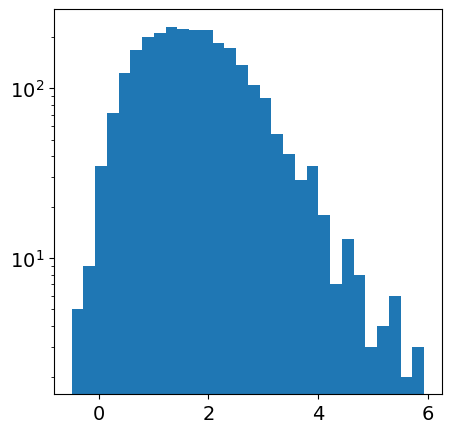

[[228.74652, 6.244]]
[[799.13957747 792.04935018]]
0
(22, 22)
38.25231353612779
38.24491
788 810
781 803

[[228.74652, 6.247]]
[[799.16498625 828.05446304]]
1
(22, 22)
23.045104802415548
23.040646
788 810
817 839

[[228.74652, 6.25]]
[[799.19039096 864.05383065]]
2
(22, 22)
8.083006811262372
8.081443
788 810
853 875

[[228.74652, 6.253]]
[[799.21579567 900.05317557]]
3
(22, 22)
320.0754728542345
320.01355
788 810
889 911

[[228.74652, 6.256]]
[[799.24120439 936.05822036]]
4
(22, 22)
14.606567913434203
14.603743
788 810
925 947

[[228.74652, 6.259]]
[[799.26660906 972.0575205 ]]
5
(22, 22)
6.166373858783282
6.165181
788 810
961 983

[[228.74652, 6.262]]
[[ 799.29201775 1008.06252089]]
6
(22, 22)
25.952278890309394
25.947258
788 810
997 1019

[[228.74652, 6.265]]
[[ 799.31742239 1044.06177703]]
7
(22, 22)
21.889771762898143
21.885538
788 810
1033 1055

[[228.74652, 6.268]]
[[ 799.34283106 1080.06673382]]
8
(22, 22)
13.417052779844232
13.414457
788 810
1069 1091

[[228.74652, 6.271]]
[[ 7

[[228.49284, 6.325]]
[[3825.50853112 1762.78377168]]
905
(22, 22)
31.147504772134482
31.14148
3815 3837
1752 1774

[[228.49284, 6.328]]
[[3825.51563157 1798.78772507]]
906
(22, 22)
23.334880403932488
23.330368
3815 3837
1788 1810

[[228.49284, 6.331]]
[[3825.52273088 1834.78593873]]
907
(22, 22)
15.863416165508346
15.860346
3815 3837
1824 1846

[[228.49284, 6.334]]
[[3825.52983132 1870.78985721]]
908
(22, 22)
9319.232627761849
9317.43
3815 3837
1860 1882

[[228.49284, 6.337]]
[[3825.53693063 1906.78803637]]
909
(22, 22)
126.28230317203197
126.25786
3815 3837
1896 1918

[[228.49284, 6.34]]
[[3825.54403106 1942.79192074]]
910
(22, 22)
63.02591807036724
63.013718
3815 3837
1932 1954

[[228.49284, 6.343]]
[[3825.55113036 1978.79006619]]
911
(22, 22)
15.191912998290178
15.188974
3815 3837
1968 1990

[[228.49284, 6.346]]
[[3825.55823079 2014.79391723]]
912
(22, 22)
32.98091321973696
32.974533
3815 3837
2004 2026

[[228.49284, 6.349]]
[[3825.56533008 2050.79202975]]
913
(22, 22)
18.7671035629

[[228.15662, 6.530391]]
[[7834.56457936 4228.06256998]]
1796
(22, 22)
22.82429947018559
22.819883
7824 7846
4217 4239

[[228.04187, 6.393]]
[[9203.78571815 2580.13105972]]
1797
(22, 22)
12.408571591197935
12.406171
9193 9215
2569 2591

[[228.04187, 6.393]]
[[9203.78571815 2580.13105972]]
1798
(22, 22)
12.408571591197935
12.406171
9193 9215
2569 2591

[[228.04187, 6.425391]]
[[9203.51100581 2968.83517119]]
1799
(22, 22)
8.56622159952302
8.564564
9193 9215
2958 2980

[[228.04187, 6.4283915]]
[[9203.48556032 3004.83925698]]
1800
(22, 22)
6.271563336247736
6.2703495
9192 9214
2994 3016

[[228.04187, 6.761391]]
[[9200.661374   7000.92064785]]
1801
(22, 22)
4.84652500501876
4.845587
9190 9212
6990 7012

[[228.04187, 6.761391]]
[[9200.661374   7000.92064785]]
1802
(22, 22)
4.84652500501876
4.845587
9190 9212
6990 7012

[[228.15662, 6.5333915]]
[[7834.54741533 4264.06602812]]
1803
(22, 22)
100.78774905282575
100.76825
7824 7846
4253 4275

[[228.15662, 6.5363913]]
[[7834.53025403 4300.06376013]

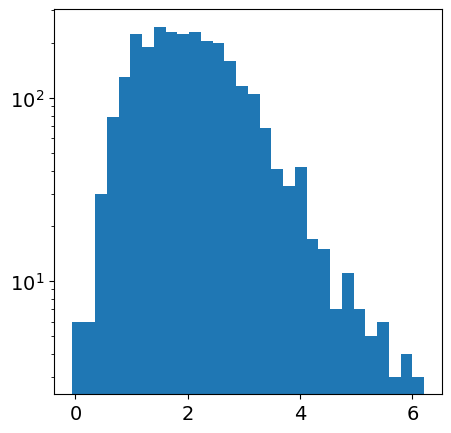

[[228.74652, 6.244]]
[[799.13957747 792.04935018]]
0
(22, 22)
70.23188034744574
70.21829
788 810
781 803

[[228.74652, 6.247]]
[[799.16498625 828.05446304]]
1
(22, 22)
39.206602984265665
39.19902
788 810
817 839

[[228.74652, 6.25]]
[[799.19039096 864.05383065]]
2
(22, 22)
10.850123872212581
10.848023
788 810
853 875

[[228.74652, 6.253]]
[[799.21579567 900.05317557]]
3
(22, 22)
639.3034918541721
639.1798
788 810
889 911

[[228.74652, 6.256]]
[[799.24120439 936.05822036]]
4
(22, 22)
36.71482319960979
36.707718
788 810
925 947

[[228.74652, 6.259]]
[[799.26660906 972.0575205 ]]
5
(22, 22)
15.543879097135076
15.540872
788 810
961 983

[[228.74652, 6.262]]
[[ 799.29201775 1008.06252089]]
6
(22, 22)
40.77394808608032
40.76606
788 810
997 1019

[[228.74652, 6.265]]
[[ 799.31742239 1044.06177703]]
7
(22, 22)
35.37129171603503
35.36445
788 810
1033 1055

[[228.74652, 6.268]]
[[ 799.34283106 1080.06673382]]
8
(22, 22)
21.23390731606213
21.2298
788 810
1069 1091

[[228.74652, 6.271]]
[[ 799.368

[[228.49284, 6.6783915]]
[[3826.34485809 6003.51424548]]
1013
(22, 22)
16.758920665660686
16.75568
3815 3837
5993 6015

[[228.49284, 6.6813912]]
[[3826.35195727 6039.51176749]]
1014
(22, 22)
202.0598012634949
202.0207
3815 3837
6029 6051

[[228.49284, 6.684391]]
[[3826.35905645 6075.50929521]]
1015
(22, 22)
61.15871855079359
61.14689
3815 3837
6065 6087

[[228.49284, 6.6873913]]
[[3826.36615675 6111.51255089]]
1016
(22, 22)
36.696131133954154
36.689034
3815 3837
6101 6123

[[228.49284, 6.690391]]
[[3826.37325594 6147.5100906 ]]
1017
(22, 22)
30.004038430529565
29.998234
3815 3837
6137 6159

[[228.49284, 6.6933913]]
[[3826.38035625 6183.51335868]]
1018
(22, 22)
12.922894275718619
12.920395
3815 3837
6173 6195

[[228.49284, 6.696391]]
[[3826.38745543 6219.51091118]]
1019
(22, 22)
50.73389850948416
50.724083
3815 3837
6209 6231

[[228.49284, 6.6993914]]
[[3826.39455574 6255.51419244]]
1020
(22, 22)
1858.1698577701209
1857.8103
3815 3837
6245 6267

[[228.49284, 6.702391]]
[[3826.40165493 6

[[228.15662, 6.8825912]]
[[7832.5496849  8454.52778284]]
2007
(22, 22)
129.15297679539532
129.12798
7822 7844
8444 8466

[[228.04187, 6.491391]]
[[9202.95125515 3760.85416664]]
2008
(22, 22)
78.05687346238004
78.04178
9192 9214
3750 3772

[[228.04187, 6.4943914]]
[[9202.9258098 3796.8580571]]
2009
(22, 22)
70.62639666404796
70.61273
9192 9214
3786 3808

[[228.04187, 6.497391]]
[[9202.9003685  3832.85621878]]
2010
(22, 22)
66.52248367747323
66.50961
9192 9214
3822 3844

[[228.15662, 6.885591]]
[[7832.53252318 8490.52639361]]
2011
(22, 22)
261.69476260982384
261.6441
7822 7844
8480 8502

[[228.04187, 6.500391]]
[[9202.8749272  3868.85437406]]
2012
(22, 22)
105.11185557294606
105.09152
9192 9214
3858 3880

[[228.04187, 6.5033913]]
[[9202.84948186 3904.85824529]]
2013
(22, 22)
82.98534719066771
82.969284
9192 9214
3894 3916

[[228.04187, 6.7955914]]
[[9200.37131838 7411.3347416 ]]
2014
(22, 22)
33.438388520367425
33.431923
9189 9211
7400 7422

[[228.04187, 6.798591]]
[[9200.34587684 7447.3

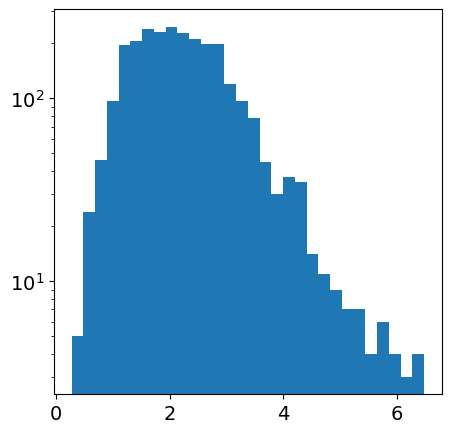

In [34]:
#dir_exptime = 448
#nexp = 1
nexp = 4

# NISP
readnoise = 6.   # e-
background = 1.2 # e-/s

#background = 0 # e-/s
#readnoise = 0
dir_gain = 1.0   # e-/photon

# Y
flux_key = "TU_FNU_Y_NISP_MAG"
mag_key = "NIR_Y"
dir_exptime = 112. # seconds
wav_cen = 10809. # Ang
wav_width = 2627. # Ang
eff_tot = 0.772
output = "Euclid_NISP_Y_ref.fits"
filt = "NISP_Y"
instr = "NISP"

test_fluxes_nisp_y, test_mags_nisp_y = fake_euclid_ref(all_tbl, ra_cen = ra_avg, dec_cen = dec_avg, 
                                         pixel_scale = 0.3, flux_key=flux_key, mag_key=mag_key, 
                                         gain=dir_gain, background=background, exptime=dir_exptime, 
                                         nexp=nexp, readnoise=readnoise, wav_cen=wav_cen, 
                                         wav_width=wav_width, eff_tot=eff_tot, output=output,
                                         filt=filt, instr = instr)

# J
flux_key = "TU_FNU_J_NISP_MAG"
mag_key = "NIR_J"
dir_exptime = 112. # seconds
wav_cen = 13673. # Ang
wav_width = 3994. # Ang
eff_tot = 0.790
output = "Euclid_NISP_J_ref.fits"
filt = "NISP_J"
instr = "NISP"

test_fluxes_nisp_j, test_mags_nisp_j = fake_euclid_ref(all_tbl, ra_cen = ra_avg, dec_cen = dec_avg, 
                                         pixel_scale = 0.3, flux_key=flux_key, mag_key=mag_key, 
                                         gain=dir_gain, background=background, exptime=dir_exptime, 
                                         nexp=nexp, readnoise=readnoise, wav_cen=wav_cen, 
                                         wav_width=wav_width, eff_tot=eff_tot, output=output,
                                         filt=filt, instr = instr)
# H
flux_key = "TU_FNU_H_NISP_MAG"
mag_key = "NIR_H"
wav_cen = 17714. # Ang
wav_width = 4999. # Ang
dir_exptime = 112. # seconds
eff_tot = 0.782
output = "Euclid_NISP_H_ref.fits"
filt = "NISP_H"
instr = "NISP"

test_fluxes_nisp_h, test_mags_nisp_h = fake_euclid_ref(all_tbl, ra_cen = ra_avg, dec_cen = dec_avg, 
                                         pixel_scale = 0.3, flux_key=flux_key, mag_key=mag_key, 
                                         gain=dir_gain, background=background, exptime=dir_exptime, 
                                         nexp=nexp, readnoise=readnoise, wav_cen=wav_cen, 
                                         wav_width=wav_width, eff_tot=eff_tot, output=output,
                                         filt=filt, instr = instr)
#print(all_direct)
# should label direct with "_direct"

In [35]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))
ref_files = ["Euclid_VIS_ref.fits", "Euclid_NISP_Y_ref.fits", "Euclid_NISP_J_ref.fits",
             "Euclid_NISP_H_ref.fits"]
total_image(ref_files, output="Euclid_total_ref.fits", img_ext='REF') 

[[[-0.04353674 -0.01584564 -0.03029544 ... -0.09480217  0.05015778
   -0.00855704]
  [-0.05570894  0.00974307  0.03241174 ... -0.00905373 -0.07384926
    0.07012136]
  [ 0.03375107 -0.07211647  0.04702944 ... -0.01181564  0.01546275
    0.00568881]
  ...
  [ 0.02254792 -0.02659089 -0.01808094 ... -0.00811903  0.06511059
   -0.01755659]
  [ 0.0090022   0.00534638 -0.02533163 ... -0.00595361 -0.08746434
   -0.07311634]
  [-0.04016932 -0.00137709  0.06047732 ...  0.04215947 -0.04162048
    0.00902781]]

 [[-0.07552736 -0.01891845  0.18738263 ... -0.1031723   0.02071554
    0.07346983]
  [ 0.02889845 -0.05145412 -0.01158809 ... -0.0776035   0.02344897
    0.26718447]
  [ 0.10141569 -0.22030639 -0.18953708 ...  0.00963054  0.01486095
   -0.06557741]
  ...
  [ 0.16753891 -0.0222012   0.11796783 ... -0.09431504 -0.09670048
    0.0791519 ]
  [-0.03988652  0.09826351 -0.23508499 ...  0.15955892 -0.13114648
    0.25105564]
  [ 0.10837897 -0.01737277 -0.2571792  ...  0.3556228  -0.093226
    0.13

In [36]:
# remove segmentation FITS to redo "next" step
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))
!rm *_seg.fits

In [37]:
## Make SExtractor catalog
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

# Euclid (Schirmer et al. 2022, XVIII. The NISP photometric system)
#mag_zero = 25.04 # +- 0.05 mag   Y 
#mag_zero = 25.26 # +- 0.05 mag   J
#mag_zero = 25.21 # +- 0.05 mag   H

#           VIS   Y      J      H      total
mag_zero = [25.6, 25.04, 25.26, 25.21, 26.0]

det_img = "Euclid_total_ref.fits"

all_cat = []
all_seg = []
all_bkg = []

all_ref_files = ref_files + [det_img]

for i,ref in enumerate(all_ref_files):

    prefix = ref.replace(".fits","")
    
    sex = "Euclid.sex"
             
    cat = prefix + ".cat" 
    #wht = prefix + "_wht.fits"
    seg = prefix + "_seg.fits"
    bkg = prefix + "_bkg.fits"
    #aper = prefix + "_aper.fits"
    
    all_cat.append(cat)
    all_seg.append(seg)
    all_bkg.append(bkg)
        
    if not os.path.exists(seg):
    
        det_wht = det_img + "[2]"
        wht = ref + "[2]"
        det_ext = det_img + "[1]"
        ref_ext = ref + "[1]"

        
        checkimage_name = seg + "," + bkg

        # detection image
        sex_str = 'sex ' + det_ext + "," + ref_ext + ' -c ' + sex + \
                  ' -WEIGHT_IMAGE ' + det_wht + "," + wht + \
                  ' -CHECKIMAGE_NAME ' + checkimage_name + ' -CATALOG_NAME ' + cat + \
                  ' -MAG_ZEROPOINT %.2f' % (mag_zero[i])
        
        # single image
        #sex_str = 'sex ' + ref_ext + ' -c ' + sex + ' -WEIGHT_IMAGE ' + wht + \
        #          ' -CHECKIMAGE_NAME ' + checkimage_name + ' -CATALOG_NAME ' + cat + \
        #          ' -MAG_ZEROPOINT %.2f' % (mag_zero[i])
        print(sex_str)
        os.system(sex_str)
            
    else:
        print("Skipping...")
        

# awk '{ printf "circle(%f, %f, 0.00007) # text={%.3f}\n", $4, $5, $42 }' GRS_FOV1_roll0_dx0_dy0_SCA1_direct.cat > GRS_FOV1_roll0_dx0_dy0_SCA1_direct.reg
        

sex Euclid_total_ref.fits[1],Euclid_VIS_ref.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_total_ref.fits[2],Euclid_VIS_ref.fits[2] -CHECKIMAGE_NAME Euclid_VIS_ref_seg.fits,Euclid_VIS_ref_bkg.fits -CATALOG_NAME Euclid_VIS_ref.cat -MAG_ZEROPOINT 25.60



> WARNING: NTHREADS != 1 ignored: this build of SExtractor is single-threaded

> 
----- SExtractor 2.19.5 started on 2023-05-30 at 12:03:24 with 1 thread

> Setting catalog parameters
> Initializing Neural Network
> Reading Neural Network Weights
> Initializing check-image(s)
> Initializing catalog
> Looking for Euclid_total_ref.fits
----- Detecting from: Euclid_total_ref.fits [1/3]
      "Unnamed" / no ext. header / 10000x10000 / 64 bits (floats)
> Looking for Euclid_VIS_ref.fits
----- Measuring from: Euclid_VIS_ref.fits [1/3]
      "Unnamed" / no ext. header / 10000x10000 / 64 bits (floats)
> Looking for Euclid_VIS_ref.fits
----- Weighting from: Euclid_VIS_ref.fits [2/3]
      "Unnamed" / no ext. header / 10000x10000 / 64 bits (floats)
> Looking for Euclid_total_ref.fits
----- Weighting from: Euclid_total_ref.fits [2/3]
      "Unnamed" / no ext. header / 10000x10000 / 64 bits (floats)
Measurement image:> Setting up background maps
> Setting up background map at line:   64
> Setting 

> Setting up background map at line: 9536
> Setting up background map at line: 9600
> Setting up background map at line: 9664
> Setting up background map at line: 9728
> Setting up background map at line: 9792
> Setting up background map at line: 9856
> Setting up background map at line: 9920
> Setting up background map at line: 9984
> Filtering background map(s)
> Computing background d-map
> Computing background-noise d-map
(M)   Background: 5.90324e-05 RMS: 0.04782    / Threshold: 0.2391     
Detection image: > Setting up background maps
> Setting up background map at line:   64
> Setting up background map at line:  128
> Setting up background map at line:  192
> Setting up background map at line:  256
> Setting up background map at line:  320
> Setting up background map at line:  384
> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at li

> Line:   25  Objects:        0 detected /        0 sextracted
> Line:   50  Objects:        0 detected /        0 sextracted
> Line:   75  Objects:        0 detected /        0 sextracted
> Line:  100  Objects:        0 detected /        0 sextracted
> Line:  125  Objects:        0 detected /        0 sextracted
> Line:  150  Objects:        0 detected /        0 sextracted
> Line:  175  Objects:        0 detected /        0 sextracted
> Line:  200  Objects:        0 detected /        0 sextracted
> Line:  225  Objects:        0 detected /        0 sextracted
> Line:  250  Objects:        0 detected /        0 sextracted
> Line:  275  Objects:        0 detected /        0 sextracted
> Line:  300  Objects:        0 detected /        0 sextracted
> Line:  325  Objects:        0 detected /        0 sextracted
> Line:  350  Objects:        0 detected /        0 sextracted
> Line:  375  Objects:        0 detected /        0 sextracted
> Line:  400  Objects:        0 detected /        0 sex

> Line: 4100  Objects:     1089 detected /        0 sextracted
> Line: 4125  Objects:     1098 detected /        0 sextracted
> Line: 4150  Objects:     1103 detected /        0 sextracted
> Line: 4175  Objects:     1114 detected /        0 sextracted
> Line: 4200  Objects:     1118 detected /        0 sextracted
> Line: 4225  Objects:     1124 detected /        0 sextracted
> Line: 4250  Objects:     1135 detected /        0 sextracted
> Line: 4275  Objects:     1139 detected /        0 sextracted
> Line: 4300  Objects:     1153 detected /        0 sextracted
> Line: 4325  Objects:     1162 detected /        0 sextracted
> Line: 4350  Objects:     1166 detected /        0 sextracted
> Line: 4375  Objects:     1172 detected /        0 sextracted
> Line: 4400  Objects:     1187 detected /        0 sextracted
> Line: 4425  Objects:     1195 detected /        0 sextracted
> Line: 4450  Objects:     1210 detected /        0 sextracted
> Line: 4475  Objects:     1216 detected /        0 sex

> Line: 7000  Objects:     2099 detected /      714 sextracted
> Line: 7025  Objects:     2114 detected /      727 sextracted
> Line: 7050  Objects:     2115 detected /      739 sextracted
> Line: 7075  Objects:     2123 detected /      744 sextracted
> Line: 7100  Objects:     2123 detected /      752 sextracted
> Line: 7125  Objects:     2123 detected /      755 sextracted
> Line: 7150  Objects:     2123 detected /      760 sextracted
> Line: 7175  Objects:     2123 detected /      774 sextracted
> Line: 7200  Objects:     2123 detected /      779 sextracted
> Line: 7225  Objects:     2123 detected /      785 sextracted
> Line: 7250  Objects:     2123 detected /      797 sextracted
> Line: 7266  Objects:     2123 detected /      800 sextracted
> Line: 7275  Objects:     2123 detected /      807 sextracted
> Line: 7300  Objects:     2123 detected /      816 sextracted
> Line: 7325  Objects:     2123 detected /      825 sextracted
> Line: 7350  Objects:     2132 detected /      835 sex

> Line:10000  Objects:     2792 detected /     2000 sextracted
> Line:10000  Objects:     2792 detected /     2400 sextracted
      Objects: detected 2792     / sextracted 2792            

> Closing files
> 
> All done (in 14.5 s: 690.4 lines/s , 192.8 detections/s)

> WARNING: NTHREADS != 1 ignored: this build of SExtractor is single-threaded

> 
----- SExtractor 2.19.5 started on 2023-05-30 at 12:03:39 with 1 thread

> Setting catalog parameters
> Initializing Neural Network
> Reading Neural Network Weights
> Initializing check-image(s)
> Initializing catalog
> Looking for Euclid_total_ref.fits
----- Detecting from: Euclid_total_ref.fits [1/3]
      "Unnamed" / no ext. header / 10000x10000 / 64 bits (floats)
> Looking for Euclid_NISP_Y_ref.fits
----- Measuring from: Euclid_NISP_Y_ref.fits [1/3]
      "Unnamed" / no ext. header / 10000x10000 / 64 bits (floats)
> Looking for Euclid_NISP_Y_ref.fits
----- Weighting from: Euclid_NISP_Y_ref.fits [2/3]
      "Unnamed" / no ext. header / 10

sex Euclid_total_ref.fits[1],Euclid_NISP_Y_ref.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_total_ref.fits[2],Euclid_NISP_Y_ref.fits[2] -CHECKIMAGE_NAME Euclid_NISP_Y_ref_seg.fits,Euclid_NISP_Y_ref_bkg.fits -CATALOG_NAME Euclid_NISP_Y_ref.cat -MAG_ZEROPOINT 25.04


> Setting up background map at line:  192
> Setting up background map at line:  256
> Setting up background map at line:  320
> Setting up background map at line:  384
> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at line: 1536
> Setting up background map at line: 1600
> Setting up background map at lin

> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at line: 1536
> Setting up background map at line: 1600
> Setting up background map at line: 1664
> Setting up background map at line: 1728
> Setting up background map at line: 1792
> Setting up background map at line: 1856
> Setting up background map at line: 1920
> Setting up background map at line: 1984
> Setting up background map at line: 2048
> Setting up background map at line: 2112
> Setting up background map at line: 2176
> Setting up background map at line: 2240
> Setting up background map at line: 2304
> Setting up background map at line: 2368
> Setting up background map at line: 2432
> Setting up background map at line: 2496
> Setting up background map at lin

> Line: 2150  Objects:      500 detected /        0 sextracted
> Line: 2175  Objects:      517 detected /        0 sextracted
> Line: 2200  Objects:      524 detected /        0 sextracted
> Line: 2225  Objects:      533 detected /        0 sextracted
> Line: 2250  Objects:      540 detected /        0 sextracted
> Line: 2275  Objects:      551 detected /        0 sextracted
> Line: 2300  Objects:      556 detected /        0 sextracted
> Line: 2325  Objects:      563 detected /        0 sextracted
> Line: 2350  Objects:      582 detected /        0 sextracted
> Line: 2375  Objects:      590 detected /        0 sextracted
> Line: 2400  Objects:      594 detected /        0 sextracted
> Line: 2425  Objects:      603 detected /        0 sextracted
> Line: 2450  Objects:      607 detected /        0 sextracted
> Line: 2475  Objects:      615 detected /        0 sextracted
> Line: 2500  Objects:      631 detected /        0 sextracted
> Line: 2525  Objects:      644 detected /        0 sex

> Line: 5150  Objects:     1361 detected /      121 sextracted
> Line: 5175  Objects:     1366 detected /      130 sextracted
> Line: 5200  Objects:     1366 detected /      138 sextracted
> Line: 5225  Objects:     1379 detected /      147 sextracted
> Line: 5250  Objects:     1387 detected /      154 sextracted
> Line: 5275  Objects:     1398 detected /      165 sextracted
> Line: 5300  Objects:     1410 detected /      174 sextracted
> Line: 5325  Objects:     1418 detected /      180 sextracted
> Line: 5350  Objects:     1425 detected /      193 sextracted
> Line: 5375  Objects:     1442 detected /      199 sextracted
> Line: 5400  Objects:     1455 detected /      205 sextracted
> Line: 5425  Objects:     1461 detected /      214 sextracted
> Line: 5450  Objects:     1467 detected /      234 sextracted
> Line: 5475  Objects:     1477 detected /      243 sextracted
> Line: 5500  Objects:     1482 detected /      255 sextracted
> Line: 5525  Objects:     1492 detected /      266 sex

> Line: 8225  Objects:     2427 detected /     1124 sextracted
> Line: 8250  Objects:     2437 detected /     1133 sextracted
> Line: 8275  Objects:     2446 detected /     1139 sextracted
> Line: 8300  Objects:     2456 detected /     1153 sextracted
> Line: 8325  Objects:     2465 detected /     1162 sextracted
> Line: 8350  Objects:     2474 detected /     1166 sextracted
> Line: 8375  Objects:     2495 detected /     1171 sextracted
> Line: 8400  Objects:     2507 detected /     1185 sextracted
> Line: 8425  Objects:     2518 detected /     1194 sextracted
> Line: 8430  Objects:     2519 detected /     1200 sextracted
> Line: 8450  Objects:     2522 detected /     1205 sextracted
> Line: 8475  Objects:     2530 detected /     1216 sextracted
> Line: 8500  Objects:     2540 detected /     1220 sextracted
> Line: 8525  Objects:     2545 detected /     1227 sextracted
> Line: 8550  Objects:     2561 detected /     1236 sextracted
> Line: 8575  Objects:     2565 detected /     1250 sex

sex Euclid_total_ref.fits[1],Euclid_NISP_J_ref.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_total_ref.fits[2],Euclid_NISP_J_ref.fits[2] -CHECKIMAGE_NAME Euclid_NISP_J_ref_seg.fits,Euclid_NISP_J_ref_bkg.fits -CATALOG_NAME Euclid_NISP_J_ref.cat -MAG_ZEROPOINT 25.26


> Setting up background map at line:  192
> Setting up background map at line:  256
> Setting up background map at line:  320
> Setting up background map at line:  384
> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at line: 1536
> Setting up background map at line: 1600
> Setting up background map at lin

> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at line: 1536
> Setting up background map at line: 1600
> Setting up background map at line: 1664
> Setting up background map at line: 1728
> Setting up background map at line: 1792
> Setting up background map at line: 1856
> Setting up background map at line: 1920
> Setting up background map at line: 1984
> Setting up background map at line: 2048
> Setting up background map at lin

> Line: 2350  Objects:      582 detected /        0 sextracted
> Line: 2375  Objects:      590 detected /        0 sextracted
> Line: 2400  Objects:      594 detected /        0 sextracted
> Line: 2425  Objects:      603 detected /        0 sextracted
> Line: 2450  Objects:      607 detected /        0 sextracted
> Line: 2475  Objects:      615 detected /        0 sextracted
> Line: 2500  Objects:      631 detected /        0 sextracted
> Line: 2525  Objects:      644 detected /        0 sextracted
> Line: 2550  Objects:      646 detected /        0 sextracted
> Line: 2575  Objects:      669 detected /        0 sextracted
> Line: 2600  Objects:      683 detected /        0 sextracted
> Line: 2625  Objects:      688 detected /        0 sextracted
> Line: 2650  Objects:      702 detected /        0 sextracted
> Line: 2675  Objects:      702 detected /        0 sextracted
> Line: 2700  Objects:      702 detected /        0 sextracted
> Line: 2725  Objects:      702 detected /        0 sex

> Line: 5325  Objects:     1418 detected /      180 sextracted
> Line: 5350  Objects:     1425 detected /      193 sextracted
> Line: 5375  Objects:     1442 detected /      199 sextracted
> Line: 5400  Objects:     1455 detected /      205 sextracted
> Line: 5425  Objects:     1461 detected /      214 sextracted
> Line: 5450  Objects:     1467 detected /      234 sextracted
> Line: 5475  Objects:     1477 detected /      243 sextracted
> Line: 5500  Objects:     1482 detected /      255 sextracted
> Line: 5525  Objects:     1492 detected /      266 sextracted
> Line: 5550  Objects:     1511 detected /      272 sextracted
> Line: 5575  Objects:     1519 detected /      277 sextracted
> Line: 5600  Objects:     1526 detected /      289 sextracted
> Line: 5625  Objects:     1544 detected /      295 sextracted
> Line: 5650  Objects:     1554 detected /      302 sextracted
> Line: 5675  Objects:     1560 detected /      317 sextracted
> Line: 5700  Objects:     1565 detected /      323 sex

> Line: 8425  Objects:     2518 detected /     1194 sextracted
> Line: 8430  Objects:     2519 detected /     1200 sextracted
> Line: 8450  Objects:     2522 detected /     1205 sextracted
> Line: 8475  Objects:     2530 detected /     1216 sextracted
> Line: 8500  Objects:     2540 detected /     1220 sextracted
> Line: 8525  Objects:     2545 detected /     1227 sextracted
> Line: 8550  Objects:     2561 detected /     1236 sextracted
> Line: 8575  Objects:     2565 detected /     1250 sextracted
> Line: 8600  Objects:     2576 detected /     1258 sextracted
> Line: 8625  Objects:     2588 detected /     1264 sextracted
> Line: 8650  Objects:     2597 detected /     1274 sextracted
> Line: 8675  Objects:     2607 detected /     1281 sextracted
> Line: 8700  Objects:     2616 detected /     1290 sextracted
> Line: 8725  Objects:     2629 detected /     1305 sextracted
> Line: 8750  Objects:     2642 detected /     1314 sextracted
> Line: 8775  Objects:     2656 detected /     1322 sex

sex Euclid_total_ref.fits[1],Euclid_NISP_H_ref.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_total_ref.fits[2],Euclid_NISP_H_ref.fits[2] -CHECKIMAGE_NAME Euclid_NISP_H_ref_seg.fits,Euclid_NISP_H_ref_bkg.fits -CATALOG_NAME Euclid_NISP_H_ref.cat -MAG_ZEROPOINT 25.21


> Setting up background map at line:   64
> Setting up background map at line:  128
> Setting up background map at line:  192
> Setting up background map at line:  256
> Setting up background map at line:  320
> Setting up background map at line:  384
> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at lin

> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at line: 1536
> Setting up background map at line: 1600
> Setting up background map at line: 1664
> Setting up background map at line: 1728
> Setting up background map at line: 1792
> Setting up background map at line: 1856
> Setting up background map at lin

> Line: 2300  Objects:      556 detected /        0 sextracted
> Line: 2325  Objects:      563 detected /        0 sextracted
> Line: 2350  Objects:      582 detected /        0 sextracted
> Line: 2375  Objects:      590 detected /        0 sextracted
> Line: 2400  Objects:      594 detected /        0 sextracted
> Line: 2425  Objects:      603 detected /        0 sextracted
> Line: 2450  Objects:      607 detected /        0 sextracted
> Line: 2475  Objects:      615 detected /        0 sextracted
> Line: 2500  Objects:      631 detected /        0 sextracted
> Line: 2525  Objects:      644 detected /        0 sextracted
> Line: 2550  Objects:      646 detected /        0 sextracted
> Line: 2575  Objects:      669 detected /        0 sextracted
> Line: 2600  Objects:      683 detected /        0 sextracted
> Line: 2625  Objects:      688 detected /        0 sextracted
> Line: 2650  Objects:      702 detected /        0 sextracted
> Line: 2675  Objects:      702 detected /        0 sex

> Line: 5250  Objects:     1387 detected /      154 sextracted
> Line: 5275  Objects:     1398 detected /      165 sextracted
> Line: 5300  Objects:     1410 detected /      174 sextracted
> Line: 5325  Objects:     1418 detected /      180 sextracted
> Line: 5350  Objects:     1425 detected /      193 sextracted
> Line: 5375  Objects:     1442 detected /      199 sextracted
> Line: 5400  Objects:     1455 detected /      205 sextracted
> Line: 5425  Objects:     1461 detected /      214 sextracted
> Line: 5450  Objects:     1467 detected /      234 sextracted
> Line: 5475  Objects:     1477 detected /      243 sextracted
> Line: 5500  Objects:     1482 detected /      255 sextracted
> Line: 5525  Objects:     1492 detected /      266 sextracted
> Line: 5550  Objects:     1511 detected /      272 sextracted
> Line: 5575  Objects:     1519 detected /      277 sextracted
> Line: 5600  Objects:     1526 detected /      289 sextracted
> Line: 5625  Objects:     1544 detected /      295 sex

> Line: 8325  Objects:     2465 detected /     1162 sextracted
> Line: 8350  Objects:     2474 detected /     1166 sextracted
> Line: 8375  Objects:     2495 detected /     1171 sextracted
> Line: 8400  Objects:     2507 detected /     1185 sextracted
> Line: 8425  Objects:     2518 detected /     1194 sextracted
> Line: 8430  Objects:     2519 detected /     1200 sextracted
> Line: 8450  Objects:     2522 detected /     1205 sextracted
> Line: 8475  Objects:     2530 detected /     1216 sextracted
> Line: 8500  Objects:     2540 detected /     1220 sextracted
> Line: 8525  Objects:     2545 detected /     1227 sextracted
> Line: 8550  Objects:     2561 detected /     1236 sextracted
> Line: 8575  Objects:     2565 detected /     1250 sextracted
> Line: 8600  Objects:     2576 detected /     1258 sextracted
> Line: 8625  Objects:     2588 detected /     1264 sextracted
> Line: 8650  Objects:     2597 detected /     1274 sextracted
> Line: 8675  Objects:     2607 detected /     1281 sex

sex Euclid_total_ref.fits[1],Euclid_total_ref.fits[1] -c Euclid.sex -WEIGHT_IMAGE Euclid_total_ref.fits[2],Euclid_total_ref.fits[2] -CHECKIMAGE_NAME Euclid_total_ref_seg.fits,Euclid_total_ref_bkg.fits -CATALOG_NAME Euclid_total_ref.cat -MAG_ZEROPOINT 26.00


> Setting up background map at line:   64
> Setting up background map at line:  128
> Setting up background map at line:  192
> Setting up background map at line:  256
> Setting up background map at line:  320
> Setting up background map at line:  384
> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at lin

> Setting up background map at line:  448
> Setting up background map at line:  512
> Setting up background map at line:  576
> Setting up background map at line:  640
> Setting up background map at line:  704
> Setting up background map at line:  768
> Setting up background map at line:  832
> Setting up background map at line:  896
> Setting up background map at line:  960
> Setting up background map at line: 1024
> Setting up background map at line: 1088
> Setting up background map at line: 1152
> Setting up background map at line: 1216
> Setting up background map at line: 1280
> Setting up background map at line: 1344
> Setting up background map at line: 1408
> Setting up background map at line: 1472
> Setting up background map at line: 1536
> Setting up background map at line: 1600
> Setting up background map at line: 1664
> Setting up background map at line: 1728
> Setting up background map at line: 1792
> Setting up background map at line: 1856
> Setting up background map at lin

> Line: 2350  Objects:      582 detected /        0 sextracted
> Line: 2375  Objects:      590 detected /        0 sextracted
> Line: 2400  Objects:      594 detected /        0 sextracted
> Line: 2425  Objects:      603 detected /        0 sextracted
> Line: 2450  Objects:      607 detected /        0 sextracted
> Line: 2475  Objects:      615 detected /        0 sextracted
> Line: 2500  Objects:      631 detected /        0 sextracted
> Line: 2525  Objects:      644 detected /        0 sextracted
> Line: 2550  Objects:      646 detected /        0 sextracted
> Line: 2575  Objects:      669 detected /        0 sextracted
> Line: 2600  Objects:      683 detected /        0 sextracted
> Line: 2625  Objects:      688 detected /        0 sextracted
> Line: 2650  Objects:      702 detected /        0 sextracted
> Line: 2675  Objects:      702 detected /        0 sextracted
> Line: 2700  Objects:      702 detected /        0 sextracted
> Line: 2725  Objects:      702 detected /        0 sex

> Line: 5350  Objects:     1425 detected /      193 sextracted
> Line: 5375  Objects:     1442 detected /      199 sextracted
> Line: 5400  Objects:     1455 detected /      205 sextracted
> Line: 5425  Objects:     1461 detected /      214 sextracted
> Line: 5450  Objects:     1467 detected /      234 sextracted
> Line: 5475  Objects:     1477 detected /      243 sextracted
> Line: 5500  Objects:     1482 detected /      255 sextracted
> Line: 5525  Objects:     1492 detected /      266 sextracted
> Line: 5550  Objects:     1511 detected /      272 sextracted
> Line: 5575  Objects:     1519 detected /      277 sextracted
> Line: 5600  Objects:     1526 detected /      289 sextracted
> Line: 5625  Objects:     1544 detected /      295 sextracted
> Line: 5650  Objects:     1554 detected /      302 sextracted
> Line: 5675  Objects:     1560 detected /      317 sextracted
> Line: 5700  Objects:     1565 detected /      323 sextracted
> Line: 5725  Objects:     1578 detected /      334 sex

> Line: 8450  Objects:     2522 detected /     1205 sextracted
> Line: 8475  Objects:     2530 detected /     1216 sextracted
> Line: 8500  Objects:     2540 detected /     1220 sextracted
> Line: 8525  Objects:     2545 detected /     1227 sextracted
> Line: 8550  Objects:     2561 detected /     1236 sextracted
> Line: 8575  Objects:     2565 detected /     1250 sextracted
> Line: 8600  Objects:     2576 detected /     1258 sextracted
> Line: 8625  Objects:     2588 detected /     1264 sextracted
> Line: 8650  Objects:     2597 detected /     1274 sextracted
> Line: 8675  Objects:     2607 detected /     1281 sextracted
> Line: 8700  Objects:     2616 detected /     1290 sextracted
> Line: 8725  Objects:     2629 detected /     1305 sextracted
> Line: 8750  Objects:     2642 detected /     1314 sextracted
> Line: 8775  Objects:     2656 detected /     1322 sextracted
> Line: 8800  Objects:     2666 detected /     1341 sextracted
> Line: 8825  Objects:     2671 detected /     1351 sex

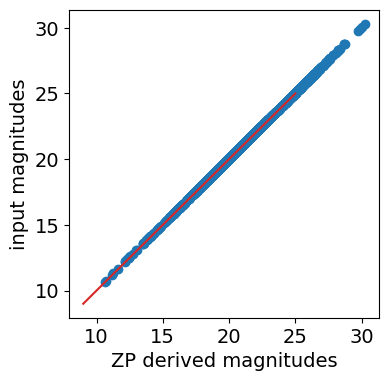

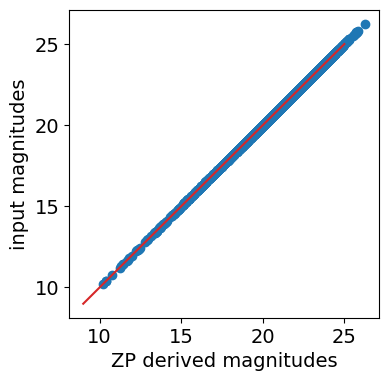

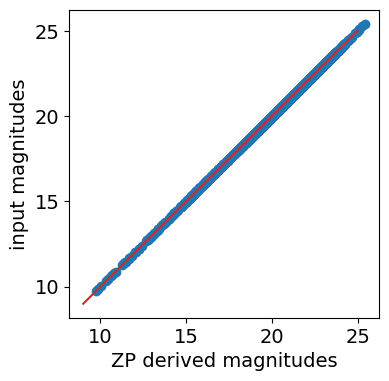

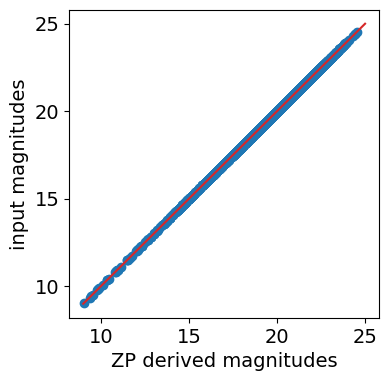

In [38]:

test_fluxes = [test_fluxes_vis, test_fluxes_nisp_y, test_fluxes_nisp_j, test_fluxes_nisp_h]
test_mags = [test_mags_vis, test_mags_nisp_y, test_mags_nisp_j, test_mags_nisp_h]

for i,zp in enumerate(mag_zero[:-1]):
    
    mag = -2.5 * np.log10(test_fluxes[i]) + zp


    fig = plt.figure(figsize=(4,4))
    ax = fig.add_subplot(111)
    ax.scatter(mag,test_mags[i])
    ax.plot([9,25],[9,25],c="tab:red")
    
    #ax.set_title(cat)
    ax.set_xlabel("ZP derived magnitudes")
    ax.set_ylabel("input magnitudes")

    plt.show()

In [39]:
all_direct = all_ref_files

In [40]:
dir()
print(all_direct)
print(all_slitless)

['Euclid_VIS_ref.fits', 'Euclid_NISP_Y_ref.fits', 'Euclid_NISP_J_ref.fits', 'Euclid_NISP_H_ref.fits', 'Euclid_total_ref.fits']
[['Euclid_DET11_slitless.fits', 'Euclid_DET12_slitless.fits', 'Euclid_DET13_slitless.fits', 'Euclid_DET14_slitless.fits', 'Euclid_DET21_slitless.fits', 'Euclid_DET22_slitless.fits', 'Euclid_DET23_slitless.fits', 'Euclid_DET24_slitless.fits', 'Euclid_DET31_slitless.fits', 'Euclid_DET32_slitless.fits', 'Euclid_DET33_slitless.fits', 'Euclid_DET34_slitless.fits', 'Euclid_DET41_slitless.fits', 'Euclid_DET42_slitless.fits', 'Euclid_DET43_slitless.fits', 'Euclid_DET44_slitless.fits']]


## Add all of the header metadata needed for Grizli

In [41]:
print(dir_exptime)
print(spec_exptime)
print(nexp)

112.0
574
4


In [42]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

suffix = "_final"

all_final_direct = []
all_final_slitless = []

## Subtract 1024 from science and sqrt(error), and adjust header keys

In [43]:
###############
### SPECTRA ###
###############
for slitless in all_slitless[0]:
    
    new_slitless = slitless.replace(".fits",suffix+".fits")
    all_final_slitless.append(new_slitless)
        
    hdu = pyfits.open(slitless)
    hdu.info()

    ext = 0
    #hdu[ext].header['INSTRUME'] = 'NISP' 
    hdu[ext].header['INSTRUME'] = 'NISP-GLWv1' 
    # v2:
    # - optical model looks the same for each detector
    # - sensitivity for each detector (are they different?)
    hdu[ext].header['FILTER'] = 'RED'
    hdu[ext].header['EXPTIME'] = spec_exptime

    ext = 1
    #hdu[ext].header['INSTRUME'] = 'NISP'
    hdu[ext].header['INSTRUME'] = 'NISP-GLWv1'
    hdu[ext].header['FILTER'] = 'RED'
    hdu[ext].header['EXTVER'] = ext
    hdu[ext].header['EXPTIME'] = spec_exptime

    sci = hdu[ext].data
    #hdu[ext].data = sci/spec_exptime/gain
    hdu[ext].data = (sci-1024.)/spec_exptime/spec_gain


    ext = 2
    chi2 = hdu[ext].data
    hdu[ext].data = np.sqrt(chi2)/spec_exptime/spec_gain

    hdu.writeto(new_slitless, overwrite=True, output_verify='fix')
    print("Writing",new_slitless)


Filename: Euclid_DET11_slitless.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  2  ERR           1 ImageHDU        29   (2048, 2048)   uint8   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
Writing Euclid_DET11_slitless_final.fits
Filename: Euclid_DET12_slitless.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 ImageHDU        31   (2048, 2048)   int16 (rescales to uint16)   
  2  ERR           1 ImageHDU        29   (2048, 2048)   uint8   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
Writing Euclid_DET12_slitless_final.fits
Filename: Euclid_DET13_slitless.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      26   ()      
  1  SCI           1 Image

In [44]:
print(all_final_direct)
print(all_final_slitless)

[]
['Euclid_DET11_slitless_final.fits', 'Euclid_DET12_slitless_final.fits', 'Euclid_DET13_slitless_final.fits', 'Euclid_DET14_slitless_final.fits', 'Euclid_DET21_slitless_final.fits', 'Euclid_DET22_slitless_final.fits', 'Euclid_DET23_slitless_final.fits', 'Euclid_DET24_slitless_final.fits', 'Euclid_DET31_slitless_final.fits', 'Euclid_DET32_slitless_final.fits', 'Euclid_DET33_slitless_final.fits', 'Euclid_DET34_slitless_final.fits', 'Euclid_DET41_slitless_final.fits', 'Euclid_DET42_slitless_final.fits', 'Euclid_DET43_slitless_final.fits', 'Euclid_DET44_slitless_final.fits']


## Check the pixel scale of the images

In [45]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

#for i in range(4):
#    for j in range(4):
#        num = '%i%i' % (i+1,j+1)
#        new_direct = "Euclid_DET%s%s.fits" % (num,suffix)
#        new_slitless = "Euclid_DET%s_slitless%s.fits"  % (num,suffix)

for direct in all_final_direct:        
    wcs_pixel_scale(direct)

for slitless in all_final_slitless:
    wcs_pixel_scale(slitless)

Filename: Euclid_DET11_slitless_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      29   ()      
  1  SCI           1 ImageHDU        35   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        29   (2048, 2048)   float32   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
cdelt1 = 0.2989 "/pixel
cdelt2 = -0.2989 "/pixel
crota1 = 180.0000 deg
crota2 = -0.0000 deg

Filename: Euclid_DET12_slitless_final.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      29   ()      
  1  SCI           1 ImageHDU        35   (2048, 2048)   float64   
  2  ERR           1 ImageHDU        29   (2048, 2048)   float32   
  3  DQ            1 ImageHDU        29   (2048, 2048)   float64   
cdelt1 = 0.2989 "/pixel
cdelt2 = -0.2989 "/pixel
crota1 = 180.0000 deg
crota2 = -0.0000 deg

Filename: Euclid_DET13_slitless_final.fits
No.    Name      Ver    Type      Cards   Dimension

In [46]:
all_phot = []

for cat in all_cat:
    #print(cat)
    phot = Table.read(cat, format='ascii.sextractor') # ref_cat in multimission
    all_phot.append(phot)
    print(cat," number_of_sources =",len(phot))
print()
print(phot.colnames)

Euclid_VIS_ref.cat  number_of_sources = 2792
Euclid_NISP_Y_ref.cat  number_of_sources = 2792
Euclid_NISP_J_ref.cat  number_of_sources = 2792
Euclid_NISP_H_ref.cat  number_of_sources = 2792
Euclid_total_ref.cat  number_of_sources = 2792

['NUMBER', 'X_IMAGE', 'Y_IMAGE', 'X_WORLD', 'Y_WORLD', 'A_IMAGE', 'B_IMAGE', 'THETA_IMAGE', 'A_WORLD', 'B_WORLD', 'THETA_WORLD', 'FLUX_APER', 'FLUX_APER_1', 'FLUX_APER_2', 'FLUX_APER_3', 'FLUX_APER_4', 'FLUX_APER_5', 'FLUX_APER_6', 'FLUX_APER_7', 'FLUX_APER_8', 'FLUX_APER_9', 'FLUX_APER_10', 'FLUX_APER_11', 'FLUX_APER_12', 'FLUX_APER_13', 'FLUXERR_APER', 'FLUXERR_APER_1', 'FLUXERR_APER_2', 'FLUXERR_APER_3', 'FLUXERR_APER_4', 'FLUXERR_APER_5', 'FLUXERR_APER_6', 'FLUXERR_APER_7', 'FLUXERR_APER_8', 'FLUXERR_APER_9', 'FLUXERR_APER_10', 'FLUXERR_APER_11', 'FLUXERR_APER_12', 'FLUXERR_APER_13', 'FLUX_AUTO', 'FLUXERR_AUTO', 'MAG_AUTO', 'MAGERR_AUTO', 'MAG_BEST', 'MAGERR_BEST', 'KRON_RADIUS', 'PETRO_RADIUS', 'BACKGROUND', 'THRESHOLD', 'ERRA_IMAGE', 'ERRB_IMAGE',

10.6616 99.0
10.2709 27.107
9.784 24.271
9.0743 23.7704
9.1293 23.3152


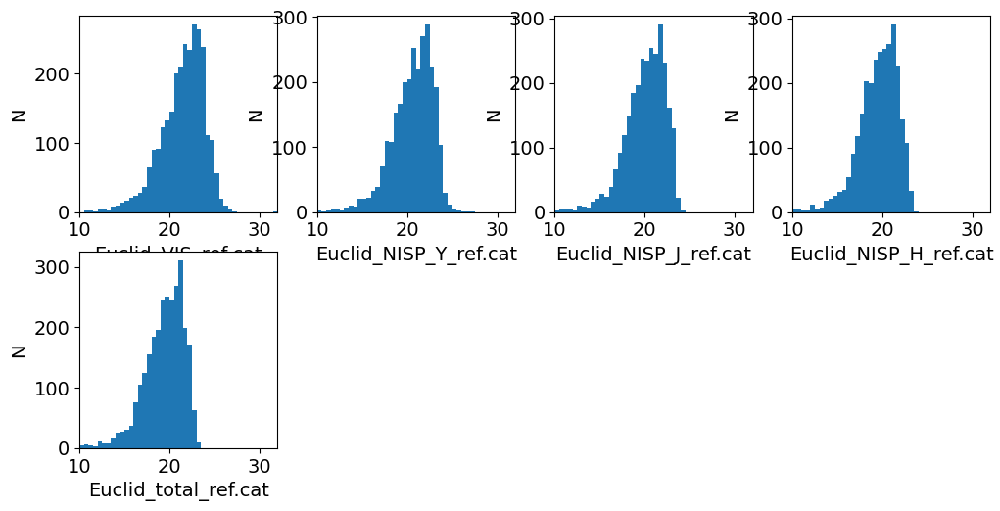

In [47]:
fig = plt.figure(figsize=(12,12))

k = 0
ax = []
for i,phot in enumerate(all_phot):
    
    cat = all_cat[i]

    #print(phot["MAG_AUTO"])
    #print(phot["FLUX_AUTO"])

    if len(phot) > 0:    
        print(np.min(phot["MAG_AUTO"]),np.max(phot["MAG_AUTO"]))
        #print(np.min(phot["FLUX_AUTO"]),np.max(phot["FLUX_AUTO"]))

    
    ax = fig.add_subplot(4,4,k+1)
    ax.hist(phot["MAG_AUTO"],range=(10,32),bins=44)
    #ax.hist(phot["MAG_AUTO"],bins=20)
    #ax.hist(phot["FLUX_AUTO"],bins=20)


    ax.set_xlabel(cat)
    ax.set_ylabel("N")
    ax.set_xlim(10,32)
    
    k += 1
    
plt.show()

In [48]:
for phot in all_phot:
    print(phot)

NUMBER  X_IMAGE   Y_IMAGE  ... FLUX_RADIUS FLUX_RADIUS_1 CLASS_STAR
          pix       pix    ...     pix          pix                
------ --------- --------- ... ----------- ------------- ----------
     1 3165.6235  734.8044 ...       1.597          5.25      0.003
     2 3174.3223   743.314 ...       1.192         2.778      0.001
     3 3165.4207  743.4195 ...       1.535         3.361      0.063
     4 7836.4082  743.4168 ...       1.527         3.224       0.77
     5 6167.4175   743.417 ...        1.51          3.22      0.029
     6 4493.4033  743.4733 ...       1.611         3.135      0.001
   ...       ...       ... ...         ...           ...        ...
  2786 4503.3179   8742.46 ...       1.112         2.274      0.606
  2787 1500.4193 8743.4102 ...       1.519         3.153      0.156
  2788 4494.4595 8751.3174 ...       1.016          2.12      0.926
  2789 6165.4194 8742.4268 ...       1.512           3.2      0.029
  2790 4494.4199 8742.4199 ...       1.544      

In [ ]:
plot_labels = 1
mag_cut = 17.

fig = plt.figure(figsize=(12,12))

k = 0
#for direct,phot in zip(all_direct,all_phot):
for direct,phot in zip(all_ref_files,all_phot):


    hdu = pyfits.open(direct)
    img = hdu[1].data
    
    p1 = fig.add_subplot(4,4,k+1)
    p1.imshow(img,origin="lower",vmin=-0.1,vmax=0.1)
    p1.scatter(phot["X_IMAGE"],phot["Y_IMAGE"],fc="None",ec="r",s=60,lw=0.3)

    if plot_labels:
        for j,src in enumerate(phot['MAG_AUTO']):
        #for j,src in enumerate(phot['NUMBER']):
        #for j,src in enumerate(phot['FLUX_AUTO']):
            if src < mag_cut:
                p1.text(phot['X_IMAGE'][j],phot['Y_IMAGE'][j],src)
            
    
    k += 1
plt.show()

Total number of sources found = 2792
Search primer and all_tbl for RA/DEC matches
Join all_tbl and primer tables
Select only sources < 0.60 arcsec
[0, 1, 3, 4, 6, 7, 8, 11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 31, 32, 33, 35, 36, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 49, 50, 51, 52, 53, 56, 57, 58, 59, 60, 61, 63, 64, 66, 67, 68, 69, 70, 71, 72, 74, 75, 76, 77, 79, 80, 81, 82, 83, 84, 85, 86, 87, 89, 90, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 144, 147, 148, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 163, 165, 166, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 179, 180, 181, 182, 183, 184, 186, 187, 189, 190, 191, 194, 195, 196, 197, 198, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 212, 213, 214, 215, 216, 217, 218, 219, 221, 222, 

[0, 1, 3, 4, 6, 7, 8, 11, 12, 13, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 31, 32, 33, 35, 36, 37, 38, 39, 40, 41, 42, 43, 45, 46, 47, 49, 50, 51, 52, 53, 56, 57, 58, 59, 60, 61, 63, 64, 66, 67, 68, 69, 70, 71, 72, 74, 75, 76, 77, 79, 80, 81, 82, 83, 84, 85, 86, 87, 89, 90, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 144, 147, 148, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 163, 165, 166, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 179, 180, 181, 182, 183, 184, 186, 187, 189, 190, 191, 194, 195, 196, 197, 198, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 212, 213, 214, 215, 216, 217, 218, 219, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 25

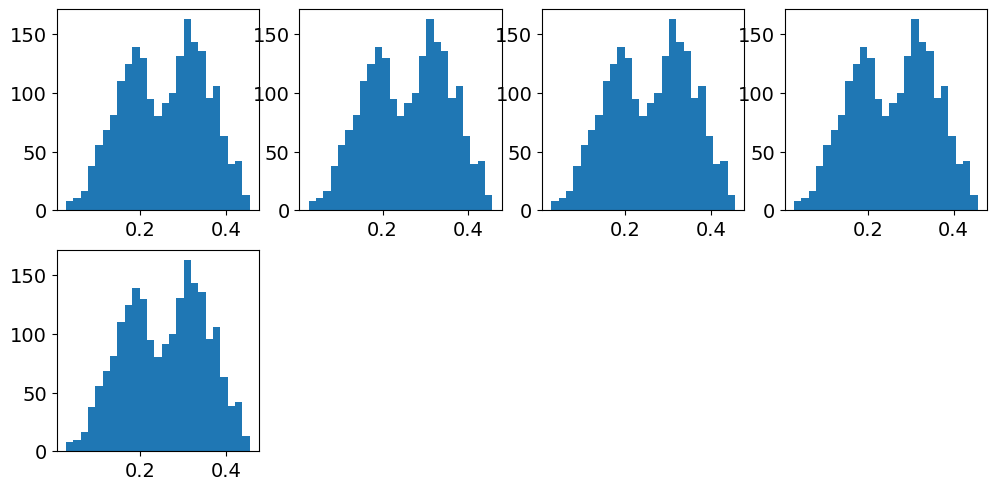

In [49]:
from astropy.table import Table, join, vstack
import astropy.units as u
from astropy.coordinates import SkyCoord

verb = 1
search_rad = 0.6

if verb:
    fig = plt.figure(figsize=(12,12))

all_phot_matched_clean = []
    
k = 0
for i,phot in enumerate(all_phot):
    
    #print(all_final_direct[i])
    print("Total number of sources found =",len(phot))
    print("Search primer and all_tbl for RA/DEC matches")
    
    if len(phot) > 0:
        c_prime = SkyCoord(ra=primer["RA"]*u.degree, dec=primer["DEC"]*u.degree)
        c_phot = SkyCoord(ra=phot["X_WORLD"], dec=phot["Y_WORLD"])

        #idx, d2d, d3d = c_prime.match_to_catalog_sky(c_phot)
        idx, d2d, d3d = c_phot.match_to_catalog_sky(c_prime)

        filt = d2d < 1*u.arcsec

        if verb:
            p1 = fig.add_subplot(4,4,k+1)
            p1.hist(d2d[filt].value*3600.,bins=25)
        
        #primer['idx'] = idx
        #primer['d2d'] = d2d

        phot['idx'] = idx
        phot['d2d'] = d2d
        #print(primer.colnames)
        
        #phot['idx'] = np.arange(len(phot))
        primer['idx'] = np.arange(len(primer))
        #print(all_tbl.colnames)
        #print(all_tbl['idx'])
        
        print("Join all_tbl and primer tables")
        match_tbl = join(phot, primer, keys='idx')
        #print(match_tbl)
        #print(match_tbl.colnames)
        
        print("Select only sources < %.2f arcsec" % (search_rad))
        #filt = match_tbl['d2d'] < 1.0*u.arcsec
        clean_filt = match_tbl['d2d'] < search_rad*u.arcsec
        match_clean_tbl = match_tbl[clean_filt]
        print(list(match_clean_tbl['idx']))
        print("Number of matches =",len(match_clean_tbl))
        print()
        
        if not i: print(match_clean_tbl.colnames)
        
    else:
        match_clean_tbl = []
    
    all_phot_matched_clean.append(match_clean_tbl)
    
    k+=1
        

In [ ]:
plot_labels = 0

fig = plt.figure(figsize=(12,12))

k = 0    
#for direct,match_clean_tbl in zip(all_direct,all_phot_matched_clean):
for direct,match_clean_tbl in zip(all_ref_files,all_phot_matched_clean):


    hdu = pyfits.open(direct)
    img = hdu[1].data

    p1 = fig.add_subplot(4,4,k+1)
    p1.imshow(img,origin="lower",vmin=-0.1,vmax=0.1)
    #p1.scatter(phot["X_IMAGE"],phot["Y_IMAGE"],fc="None",ec="r",s=60)
    if len(match_clean_tbl) > 0:
        p1.scatter(match_clean_tbl['X_IMAGE'],match_clean_tbl['Y_IMAGE'],lw=0.3,fc="None",ec="r",s=60)
    
    if plot_labels and len(match_clean_tbl) > 0:
        for j,src in enumerate(match_clean_tbl['SOURCE_ID']):
            #print(j)
            p1.text(match_clean_tbl['X_IMAGE'][j],match_clean_tbl['Y_IMAGE'][j],src)
    k += 1
plt.show()

In [50]:
print([col for col in primer.colnames if "TU_" in col])
Euclid_bands = ['VIS','NIR_Y','NIR_J','NIR_H']
Euclid_bands_flux = ['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG']

['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG', 'TU_FNU_G_DECAM_MAG', 'TU_FNU_R_DECAM_MAG', 'TU_FNU_I_DECAM_MAG', 'TU_FNU_Z_DECAM_MAG', 'TU_FNU_U_MEGACAM_MAG', 'TU_FNU_R_MEGACAM_MAG', 'TU_FNU_G_JPCAM_MAG', 'TU_FNU_I_PANSTARRS_MAG', 'TU_FNU_Z_PANSTARRS_MAG', 'TU_FNU_Z_HSC_MAG', 'TU_FNU_G_GAIA_MAG', 'TU_FNU_BP_GAIA_MAG', 'TU_FNU_RP_GAIA_MAG', 'TU_FNU_U_LSST_MAG', 'TU_FNU_G_LSST_MAG', 'TU_FNU_R_LSST_MAG', 'TU_FNU_I_LSST_MAG', 'TU_FNU_Z_LSST_MAG', 'TU_FNU_Y_LSST_MAG', 'TU_FNU_U_KIDS_MAG', 'TU_FNU_G_KIDS_MAG', 'TU_FNU_R_KIDS_MAG', 'TU_FNU_I_KIDS_MAG', 'TU_FNU_J_2MASS_MAG', 'TU_FNU_H_2MASS_MAG', 'TU_FNU_KS_2MASS_MAG']


N = 5

i = 0
Magnitudes:
min = 10.671
max = 27.010

Zeropoint:
mean   = 25.625
median = 25.590
std    = 0.228
min    = 20.198
max    = 27.027


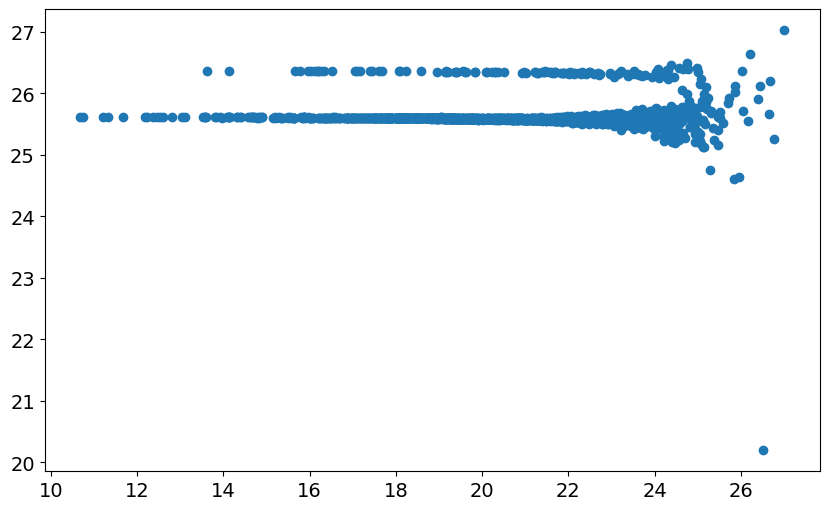

i = 1
Magnitudes:
min = 10.211
max = 24.391

Zeropoint:
mean   = 24.998
median = 24.965
std    = 0.202
min    = 22.582
max    = 26.206


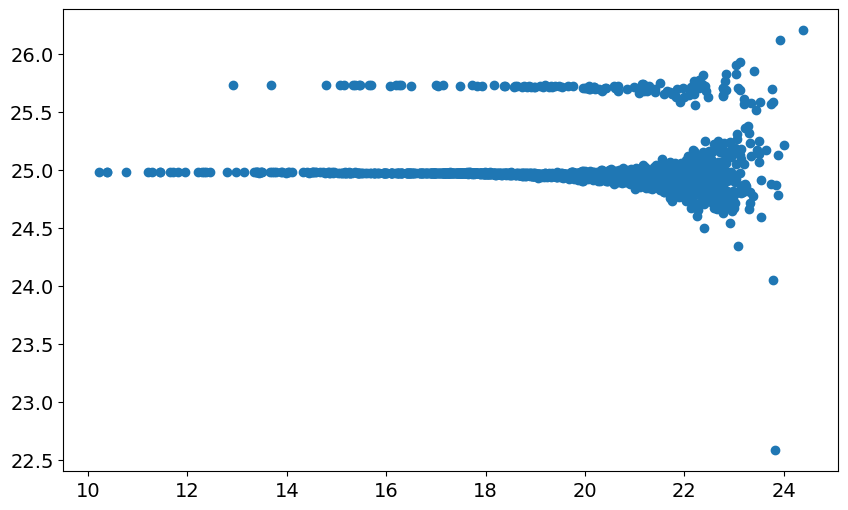

i = 2
Magnitudes:
min = 9.729
max = 23.533

Zeropoint:
mean   = 25.224
median = 25.185
std    = 0.182
min    = 24.906
max    = 25.995


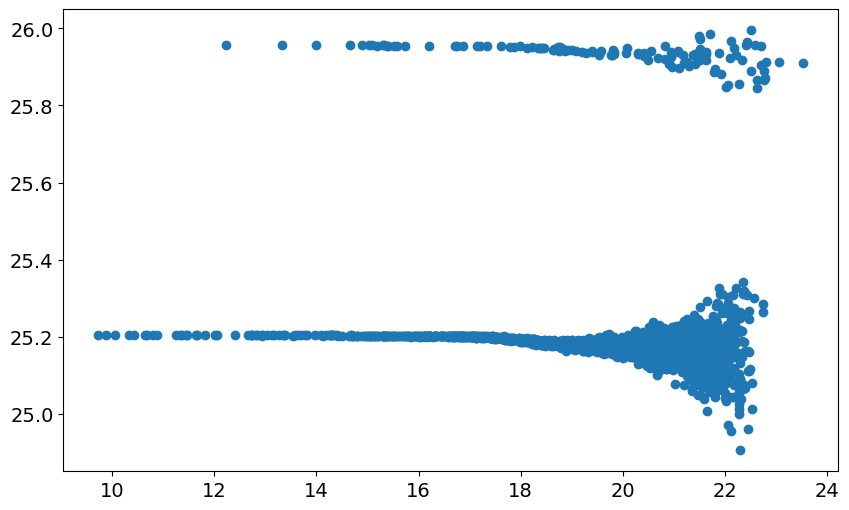

i = 3
Magnitudes:
min = 9.021
max = 22.517

Zeropoint:
mean   = 25.175
median = 25.135
std    = 0.181
min    = 24.979
max    = 25.959


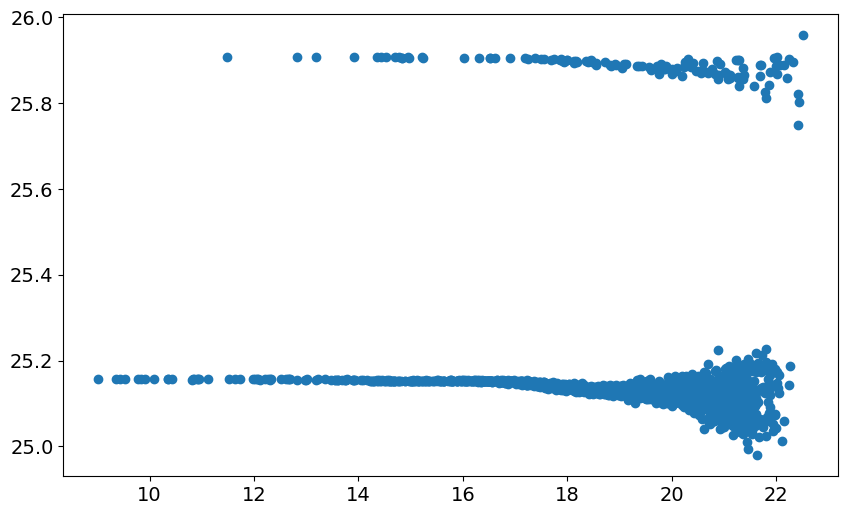

In [51]:
print("N =",len(all_phot_matched_clean))
print()

verb = 0

for i,match_clean_tbl in enumerate(all_phot_matched_clean[:-1]):  
    zps = []
    mags = []
    
    if len(match_clean_tbl) > 0:
        print("i =",i)
                
        for k,row in enumerate(match_clean_tbl):
            
            #ind = np.argmax(match_clean_tbl['FLUX_AUTO'])

            #print("ind =",ind)
            dn = row['FLUX_AUTO']
            mag = row[Euclid_bands[i]]
            flux = row[Euclid_bands_flux[i]]

            ## mag = -2.5 * log10(dn/exptime) + zp
            zp = mag + 2.5*np.log10(dn)
            
            
            mags.append(mag)
            zps.append(zp)
            if verb:
                print(k)
                print("dn =", dn)
                print("mag =", mag)
                print("flux =", flux)
                print("zp =", zp)
                print()

    print("Magnitudes:")
    print("min = %.3f" % (np.nanmin(mags)))
    print("max = %.3f" % (np.nanmax(mags)))
    print()

    print("Zeropoint:")
    print("mean   = %.3f" % (np.nanmean(zps)))
    print("median = %.3f" % (np.nanmedian(zps)))
    print("std    = %.3f" % (np.nanstd(zps)))
    print("min    = %.3f" % (np.nanmin(zps)))
    print("max    = %.3f" % (np.nanmax(zps)))


    fig = plt.figure()
    ax = fig.add_subplot(111)
    ax.scatter(mags,zps)
    plt.show()

In [ ]:
rms = 0.15
zp = 25.13
mag = - 2.5*np.log10(5*rms) + zp
print(mag)

## Euclid object simulation
[top](#Table-of-Contents)

In [ ]:
import importlib
importlib.reload(grizli.model)

In [ ]:
import grizli.model

In [52]:
print(all_final_slitless)
print(all_ref_files)
print(all_seg)
#print(all_phot_matched_clean)
print(all_phot_matched_clean[-1]['NUMBER','X_IMAGE','Y_IMAGE','MAG_AUTO'])

['Euclid_DET11_slitless_final.fits', 'Euclid_DET12_slitless_final.fits', 'Euclid_DET13_slitless_final.fits', 'Euclid_DET14_slitless_final.fits', 'Euclid_DET21_slitless_final.fits', 'Euclid_DET22_slitless_final.fits', 'Euclid_DET23_slitless_final.fits', 'Euclid_DET24_slitless_final.fits', 'Euclid_DET31_slitless_final.fits', 'Euclid_DET32_slitless_final.fits', 'Euclid_DET33_slitless_final.fits', 'Euclid_DET34_slitless_final.fits', 'Euclid_DET41_slitless_final.fits', 'Euclid_DET42_slitless_final.fits', 'Euclid_DET43_slitless_final.fits', 'Euclid_DET44_slitless_final.fits']
['Euclid_VIS_ref.fits', 'Euclid_NISP_Y_ref.fits', 'Euclid_NISP_J_ref.fits', 'Euclid_NISP_H_ref.fits', 'Euclid_total_ref.fits']
['Euclid_VIS_ref_seg.fits', 'Euclid_NISP_Y_ref_seg.fits', 'Euclid_NISP_J_ref_seg.fits', 'Euclid_NISP_H_ref_seg.fits', 'Euclid_total_ref_seg.fits']
NUMBER  X_IMAGE   Y_IMAGE  MAG_AUTO
          pix       pix      mag   
------ --------- --------- --------
    16  799.3267  792.4449  20.7343
    2

In [53]:
print(all_ref_files[3])
print(all_seg[-1])
print(all_phot_matched_clean[-1])

Euclid_NISP_H_ref.fits
Euclid_total_ref_seg.fits
NUMBER  X_IMAGE   Y_IMAGE  ... Paschen8_FLAM_AGN_EXT Paschen9_FLAM_AGN_EXT
          pix       pix    ...                                            
------ --------- --------- ... --------------------- ---------------------
    16  799.3267  792.4449 ...                 -99.0                 -99.0
    24  799.5083   828.415 ...                 -99.0                 -99.0
    40  799.4259  900.3998 ...                 -99.0                 -99.0
    56  799.4182  936.3998 ...                 -99.0                 -99.0
    81  799.4635 1008.4639 ...                 -99.0                 -99.0
    92  799.4412 1044.4521 ...                 -99.0                 -99.0
   ...       ...       ... ...                   ...                   ...
  1442 9199.4316 8959.4199 ...            -15.736602            -15.919489
  1429  9199.418 8995.4014 ...            -15.223917            -15.402116
  1422 9199.4688 9031.4521 ...            -15.38232

In [ ]:
import importlib
importlib.reload(grizli.grismconf)

In [ ]:
import grizli.grismconf

In [54]:
###################
# Reference image #
###################

T0 = time.time()

os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

# allow simulation of objects at the edges
pad=200 # pixels
#pad = 800 # I think this may be optimal given the spectra size (only seems to add 10-20 spectra)

mag_limit = 30 

all_euclid = []

#for i in range(len(all_final_slitless)):
for i in range(len(all_final_slitless)):
#for i in [0]:

    
    t0 = time.time()

    Euclid = grizli.model.GrismFLT(grism_file=all_final_slitless[i], verbose=True, pad=pad,  
                                   ref_file=all_ref_files[3], ref_ext=1, # NISP_H
                                   seg_file=all_seg[-1], # total
                                   #shrink_segimage=False)
                                   shrink_segimage=True)

    Euclid_cat = Euclid.blot_catalog(all_phot_matched_clean[-1], sextractor=True) 
    #Euclid_cat = Euclid.blot_catalog(all_phot[i], sextractor=True) 
    Euclid.catalog = Euclid_cat

    mask = Euclid_cat['MAG_AUTO'] < mag_limit
    print('N=%d' %(mask.sum()))
    #Euclid.compute_full_model(verbose=True)
    #Euclid.compute_full_model(compute_beams=['A'], mask=mask, verbose=False)
    Euclid.compute_full_model(ids=Euclid_cat['NUMBER'][mask], mags=Euclid_cat['MAG_AUTO'][mask], verbose=True)
    #Euclid.compute_full_model(ids=Euclid_cat['NUMBER'][mask], mags=Euclid_cat['MAG_AUTO'][mask], verbose=True)

    all_euclid.append(Euclid)
    
    t1 = time.time()
    
    print("Detector finished in %.1f seconds" % (t1-t0))
    
    
T1 = time.time()

print()
print("Finished in %.1f seconds" % (T1-T0))

Image cutout: x=slice(42, 2880, None), y=slice(233, 3071, None)
Euclid_DET11_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(42, 2880, None), y=slice(233, 3071, None)
Euclid_DET11_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET11_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=126


126it [00:00, 160.91it/s]


Detector finished in 2.7 seconds
Image cutout: x=slice(42, 2880, None), y=slice(2430, 5268, None)
Euclid_DET12_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(42, 2880, None), y=slice(2430, 5268, None)
Euclid_DET12_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET12_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=126


126it [00:00, 168.64it/s]


Detector finished in 2.7 seconds
Image cutout: x=slice(42, 2880, None), y=slice(4627, 7465, None)
Euclid_DET13_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(42, 2880, None), y=slice(4627, 7465, None)
Euclid_DET13_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET13_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=141


141it [00:00, 165.52it/s]


Detector finished in 2.6 seconds
Image cutout: x=slice(42, 2880, None), y=slice(6825, 9662, None)
Euclid_DET14_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(42, 2880, None), y=slice(6825, 9662, None)
Euclid_DET14_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET14_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=129


129it [00:00, 170.94it/s]


Detector finished in 2.6 seconds
Image cutout: x=slice(2403, 5241, None), y=slice(233, 3071, None)
Euclid_DET21_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(2403, 5241, None), y=slice(233, 3071, None)
Euclid_DET21_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET21_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=136


136it [00:00, 168.94it/s]


Detector finished in 2.6 seconds
Image cutout: x=slice(2403, 5241, None), y=slice(2430, 5268, None)
Euclid_DET22_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(2403, 5241, None), y=slice(2430, 5268, None)
Euclid_DET22_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET22_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=125


125it [00:00, 166.35it/s]


Detector finished in 2.6 seconds
Image cutout: x=slice(2403, 5241, None), y=slice(4627, 7465, None)
Euclid_DET23_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(2403, 5241, None), y=slice(4627, 7465, None)
Euclid_DET23_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET23_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=137


137it [00:00, 167.05it/s]


Detector finished in 2.6 seconds
Image cutout: x=slice(2403, 5241, None), y=slice(6825, 9662, None)
Euclid_DET24_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(2403, 5241, None), y=slice(6825, 9662, None)
Euclid_DET24_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET24_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=130


130it [00:00, 169.08it/s]


Detector finished in 2.6 seconds
Image cutout: x=slice(4764, 7602, None), y=slice(233, 3071, None)
Euclid_DET31_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(4764, 7602, None), y=slice(233, 3071, None)
Euclid_DET31_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET31_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=156


156it [00:00, 168.80it/s]


Detector finished in 2.8 seconds
Image cutout: x=slice(4764, 7602, None), y=slice(2430, 5268, None)
Euclid_DET32_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(4764, 7602, None), y=slice(2430, 5268, None)
Euclid_DET32_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET32_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=142


142it [00:00, 159.29it/s]


Detector finished in 2.8 seconds
Image cutout: x=slice(4764, 7602, None), y=slice(4628, 7465, None)
Euclid_DET33_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(4764, 7602, None), y=slice(4628, 7465, None)
Euclid_DET33_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET33_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=152


152it [00:00, 166.25it/s]


Detector finished in 2.7 seconds
Image cutout: x=slice(4764, 7602, None), y=slice(6825, 9662, None)
Euclid_DET34_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(4764, 7602, None), y=slice(6825, 9662, None)
Euclid_DET34_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET34_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=153


153it [00:00, 166.45it/s]


Detector finished in 2.7 seconds
Image cutout: x=slice(7126, 9964, None), y=slice(233, 3071, None)
Euclid_DET41_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(7126, 9964, None), y=slice(233, 3071, None)
Euclid_DET41_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET41_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=96


96it [00:00, 176.71it/s]


Detector finished in 2.4 seconds
Image cutout: x=slice(7126, 9964, None), y=slice(2430, 5268, None)
Euclid_DET42_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(7126, 9964, None), y=slice(2430, 5268, None)
Euclid_DET42_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET42_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=118


118it [00:00, 171.51it/s]


Detector finished in 2.5 seconds
Image cutout: x=slice(7126, 9964, None), y=slice(4628, 7465, None)
Euclid_DET43_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(7126, 9964, None), y=slice(4628, 7465, None)
Euclid_DET43_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET43_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=128


128it [00:00, 168.89it/s]


Detector finished in 2.6 seconds
Image cutout: x=slice(7126, 9964, None), y=slice(6825, 9662, None)
Euclid_DET44_slitless_final.fits / blot reference Euclid_NISP_H_ref.fits[0]
Using default C-based coordinate transformation...
Image cutout: x=slice(7126, 9964, None), y=slice(6825, 9662, None)
Euclid_DET44_slitless_final.fits / Pad ref HDU with 50 pixels
Euclid_DET44_slitless_final.fits / blot segmentation Euclid_total_ref_seg.fits[0]
Using default C-based coordinate transformation...
Using default C-based coordinate transformation...
N=84


84it [00:00, 172.07it/s]

Detector finished in 2.3 seconds

Finished in 41.9 seconds


In [ ]:
import importlib
importlib.reload(grizli.model)

In [ ]:
import grizli.model

In [55]:
print(all_euclid)

[<grizli.model.GrismFLT object at 0x7fc4e0f8baf0>, <grizli.model.GrismFLT object at 0x7fc4e0f736a0>, <grizli.model.GrismFLT object at 0x7fc4c05b8910>, <grizli.model.GrismFLT object at 0x7fc522729160>, <grizli.model.GrismFLT object at 0x7fc4c05b8580>, <grizli.model.GrismFLT object at 0x7fc4e15eba60>, <grizli.model.GrismFLT object at 0x7fc512133070>, <grizli.model.GrismFLT object at 0x7fc5121335b0>, <grizli.model.GrismFLT object at 0x7fc4fbf3f280>, <grizli.model.GrismFLT object at 0x7fc53793c910>, <grizli.model.GrismFLT object at 0x7fc4b0c97b80>, <grizli.model.GrismFLT object at 0x7fc51416e070>, <grizli.model.GrismFLT object at 0x7fc4b5ce45b0>, <grizli.model.GrismFLT object at 0x7fc4b5cf4a00>, <grizli.model.GrismFLT object at 0x7fc4b6cd5850>, <grizli.model.GrismFLT object at 0x7fc4b6cd3340>]


In [56]:
t0 = time.time()

print(all_euclid)

import pickle

# ~ 5GB file
with open('Euclid_GrismFLT.pickle', 'wb') as f:
    # Pickle the 'data' dictionary using the highest protocol available.
    pickle.dump(all_euclid, f, pickle.HIGHEST_PROTOCOL)
    
t1 = time.time()

print()
print("Finished in %.1f seconds" % (t1-t0))

[<grizli.model.GrismFLT object at 0x7fc4e0f8baf0>, <grizli.model.GrismFLT object at 0x7fc4e0f736a0>, <grizli.model.GrismFLT object at 0x7fc4c05b8910>, <grizli.model.GrismFLT object at 0x7fc522729160>, <grizli.model.GrismFLT object at 0x7fc4c05b8580>, <grizli.model.GrismFLT object at 0x7fc4e15eba60>, <grizli.model.GrismFLT object at 0x7fc512133070>, <grizli.model.GrismFLT object at 0x7fc5121335b0>, <grizli.model.GrismFLT object at 0x7fc4fbf3f280>, <grizli.model.GrismFLT object at 0x7fc53793c910>, <grizli.model.GrismFLT object at 0x7fc4b0c97b80>, <grizli.model.GrismFLT object at 0x7fc51416e070>, <grizli.model.GrismFLT object at 0x7fc4b5ce45b0>, <grizli.model.GrismFLT object at 0x7fc4b5cf4a00>, <grizli.model.GrismFLT object at 0x7fc4b6cd5850>, <grizli.model.GrismFLT object at 0x7fc4b6cd3340>]

Finished in 6.1 seconds


In [ ]:
t0 = time.time()

import pickle

with open('Euclid_GrismFLT.pickle', 'rb') as f:
    # The protocol version used is detected automatically, so we do not
    # have to specify it.
    all_euclid = pickle.load(f)
    
t1 = time.time()

print()
print("Finished in %.1f seconds" % (t1-t0))

In [57]:
print(all_euclid)
print(type(all_euclid))
print(len(all_euclid))
#print(all_euclid[0].__dict__)

[<grizli.model.GrismFLT object at 0x7fc4e0f8baf0>, <grizli.model.GrismFLT object at 0x7fc4e0f736a0>, <grizli.model.GrismFLT object at 0x7fc4c05b8910>, <grizli.model.GrismFLT object at 0x7fc522729160>, <grizli.model.GrismFLT object at 0x7fc4c05b8580>, <grizli.model.GrismFLT object at 0x7fc4e15eba60>, <grizli.model.GrismFLT object at 0x7fc512133070>, <grizli.model.GrismFLT object at 0x7fc5121335b0>, <grizli.model.GrismFLT object at 0x7fc4fbf3f280>, <grizli.model.GrismFLT object at 0x7fc53793c910>, <grizli.model.GrismFLT object at 0x7fc4b0c97b80>, <grizli.model.GrismFLT object at 0x7fc51416e070>, <grizli.model.GrismFLT object at 0x7fc4b5ce45b0>, <grizli.model.GrismFLT object at 0x7fc4b5cf4a00>, <grizli.model.GrismFLT object at 0x7fc4b6cd5850>, <grizli.model.GrismFLT object at 0x7fc4b6cd3340>]
<class 'list'>
16


## Check simulation
[top](#Table-of-Contents)

Possible problem with the aXeSIM conf file.  This function checks if the OrderDict exists within GrismFLT class.

In [58]:
mag_limit = 30

In [60]:
all_euclid_srcs = []

for i,euclid in enumerate(all_euclid):
    #Euclid_all,Euclid_magcut,Euclid_extract = check_sims(euclid, mag_limit)
    #print(euclid.catalog["MAG_AUTO"])
    #print(euclid.object_dispersers)
    #print(len(euclid.object_dispersers))
    #print(euclid.object_dispersers[93])
    #############################################
    # These are the actual Source Extractor IDs #
    #############################################
    #for id in euclid.object_dispersers:
        #print(id)
        #print(id, euclid.object_dispersers[id])
        #print(len(euclid.object_dispersers[id]))
    #print([(j,id) for j,id in enumerate(euclid.object_dispersers)])
    #sim.object_dispersers.index(id)
    #print(all_det[i])
    all_euclid_srcs.append(check_sims2(euclid, mag_limit))


All sources   = 126
Magnitude cut = 126
Simulated     = 126

All sources   = 126
Magnitude cut = 126
Simulated     = 126

All sources   = 141
Magnitude cut = 141
Simulated     = 141

All sources   = 129
Magnitude cut = 129
Simulated     = 129

All sources   = 136
Magnitude cut = 136
Simulated     = 136

All sources   = 125
Magnitude cut = 125
Simulated     = 125

All sources   = 137
Magnitude cut = 137
Simulated     = 137

All sources   = 130
Magnitude cut = 130
Simulated     = 130

All sources   = 156
Magnitude cut = 156
Simulated     = 156

All sources   = 142
Magnitude cut = 142
Simulated     = 142

All sources   = 152
Magnitude cut = 152
Simulated     = 152

All sources   = 153
Magnitude cut = 153
Simulated     = 153

All sources   = 96
Magnitude cut = 96
Simulated     = 96

All sources   = 118
Magnitude cut = 118
Simulated     = 118

All sources   = 128
Magnitude cut = 128
Simulated     = 128

All sources   = 84
Magnitude cut = 84
Simulated     = 84



In [61]:
print(all_euclid_srcs)

[(<Table length=126>
NUMBER  X_IMAGE   Y_IMAGE    X_WORLD    ...   id       ra          dec     
          pix       pix        deg      ...           deg          deg     
int64   float64   float64    float64    ... int64   float64      float64   
------ --------- --------- ------------ ... ----- ------------ ------------
    16  799.3267  792.4449  228.7465891 ...    16  228.7465891 6.2439495474
    24  799.5083   828.415 228.74657601 ...    24 228.74657601 6.2469468964
    40  799.4259  900.3998 228.74658717 ...    40 228.74658717 6.2529452896
    56  799.4182  936.3998 228.74658995 ...    56 228.74658995 6.2559451364
    81  799.4635 1008.4639 228.74659041 ...    81 228.74659041 6.2619501591
    92  799.4412 1044.4521 228.74659442 ...    92 228.74659442 6.2649490134
   ...       ...       ...          ... ...   ...          ...          ...
   602 2193.4565 2411.4595 228.62978761 ...   602 228.62978761    6.3789277
   629 2193.4294 2483.4243 228.62979272 ...   629 228.62979272 6.38

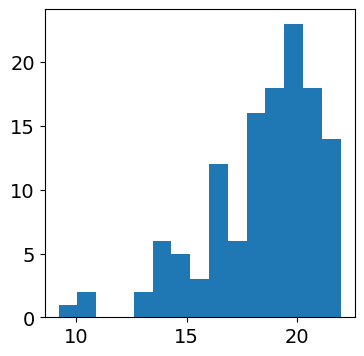

NUMBER      ra          dec      MAG_AUTO
           deg          deg        mag   
------ ------------ ------------ --------
   137 228.74660486 6.2769452991  16.2348
   253 228.74653807 6.3009448093  16.0627
   328 228.74655077 6.3189438017  14.6919
   346 228.74655294 6.3219435839  14.8861
   424 228.74656348 6.3369431426  14.1918
   434 228.74656596 6.3399427446  16.1922
   ...          ...          ...      ...
   654 228.68815708 6.3899776769   15.466
   675 228.68815873 6.3929775372  13.5118
   149 228.62982752 6.2799274241  16.4866
   456 228.62977507 6.3459252152  15.4712
   548 228.62978513  6.366924626  16.3558
   558 228.62978649 6.3699242434  16.7533
   662 228.62979639 6.3909241339   13.277
Length = 31 rows


In [62]:
# Euclid_extract
det11 = all_euclid_srcs[0][2]

fig = plt.figure(figsize=(4,4))
ax1 = fig.add_subplot(111)
ax1.hist(det11["MAG_AUTO"],bins=15)
plt.show()

filt = det11["MAG_AUTO"] < 17.0
print(det11["NUMBER","ra","dec","MAG_AUTO"][filt])

In [63]:
r0,d0 = 228.68820022, 6.3239380205 # mag=16.7511

## Extract a single 2D spectrum 
Science, model and contamination based on RA and Dec

[top](#Table-of-Contents)

ID:356, mag=16.36, dr=0.15"
NISP-GLWv1 1259.429293054185 1323.916406816733
(False, None, OrderedDict([('A', <grizli.model.GrismDisperser object at 0x7fc4c08b67f0>)]))
['MW_EBV', 'MW_F99', 'NX', 'PAM_value', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__slotnames__', '__str__', '__subclasshook__', '__weakref__', 'add_to_full_image', 'add_ytrace_offset', 'beam', 'compute_model', 'compute_model_psf', 'conf', 'contained_in_full_array', 'cutout_from_full_image', 'direct', 'dx', 'dxfull', 'dxpix', 'flat_index', 'fwcpos', 'get_PAM_value', 'get_psf_sensitivity', 'grow', 'id', 'idx', 'init_extended_epsf', 'init_galactic_extinction', 'init_optimal_profile', 'is_cgs', 'lam', 'lam_beam', 'lam_sort', 'model', 'modelf', 'optimal_extract', 'origin', 

'beam__00356.red.A.fits'

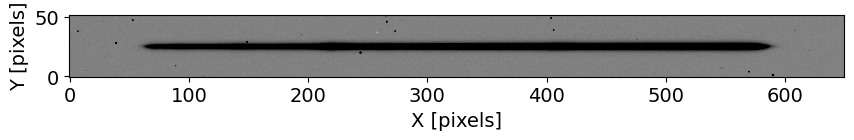

In [64]:
det_ind = 0 # DET11
Euclid = all_euclid[det_ind]
phot = all_phot[det_ind]

## Find the object ID near coordinates (r0,d0), 
## SExtractor IDs might not be constant across platforms

dr = np.sqrt((phot['X_WORLD']-r0)**2*np.cos(d0/180*np.pi)**2 + 
             (phot['Y_WORLD']-d0)**2)*3600.
id = phot['NUMBER'][np.argmin(dr)]
obj_mag = phot['MAG_AUTO'][np.argmin(dr)]
print('ID:%d, mag=%.2f, dr=%.2f"' %(id, obj_mag, np.min(dr)))

beams = OrderedDict()

ix = Euclid.catalog['id'] == id
x0, y0 = Euclid.catalog['x_flt'][ix][0], Euclid.catalog['y_flt'][ix][0]
print(Euclid.direct.instrument, x0, y0)
#print(Roman.wcs.pscale)
#dim = 18*0.135/sim.flt_wcs.pscale 
#beam = grizli.model.BeamCutout(id=id, x=x0, y=y0, 
#                               cutout_dimensions=np.cast[int]((dim, dim)), 
#                               conf=sim.conf, GrismFLT=sim)

print(Euclid.object_dispersers[id])

is_cgs, spectrum_1d, b = Euclid.object_dispersers[id]
#print(b)

cutout = grizli.model.BeamCutout(Euclid, b['A'], min_sens=0,) # min_mask=0) 

cutout.beam.compute_model()  
cutout.contam = cutout.beam.cutout_from_full_image(Euclid.model)
if id in Euclid.object_dispersers:
    cutout.contam -= cutout.beam.model

print(dir(cutout.beam))
#print(cutout.contam)
#print(cutout.beam.model)
#print(dir(cutout.beam))
print(cutout.beam.seg)
print(cutout.beam.seg.shape)

img = cutout.grism.data['SCI']*1
X = img.flatten()
std = np.std(X)
med = np.median(X)

sig = 1.
vmin = med-sig*std
vmax = med+sig*std

fig = plt.figure()
p1 = fig.add_subplot(111)
p1.imshow(cutout.grism.data['SCI']*1, origin='lower',cmap='gray_r',vmin=vmin,vmax=vmax)
p1.set_xlabel("X [pixels]")
p1.set_ylabel("Y [pixels]")

#p1.imshow(cutout.grism.data['ERR']*1)#,vmin=-0.1,vmax=0.1, origin='lower',cmap='gray_r')
    
beams[Euclid.grism.instrument] = cutout

cutout.write_fits() # still learning about the output

## 1D Spectral Extraction
[top](#Table-of-Contents)

In [65]:
print(beams.keys())
key = "NISP-GLWv1"
print(beams[key].grism.data.keys())

odict_keys(['NISP-GLWv1'])
odict_keys(['SCI', 'ERR', 'DQ', 'REF'])


(3.688858985900879, 29.343302726745605)

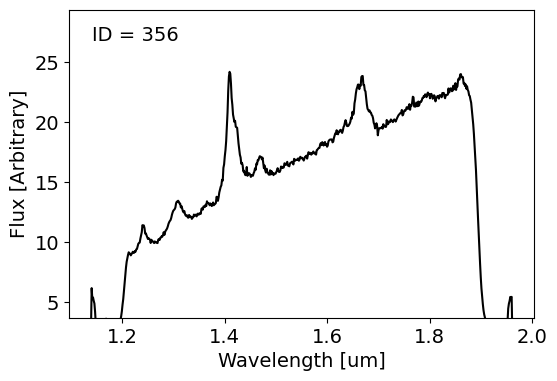

In [66]:
from scipy import integrate

### Plot 1D spectra

fig = plt.figure(figsize=(6,4))
p1 = fig.add_subplot(111)
key = "NISP-GLWv1"
w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], bin=0)
#w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
#                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)

#sf = f/np.nanmax(f)
sf = f
std = np.nanstd(sf)
med = np.nanmedian(sf)

sig = 2.
y0 = med-sig*std
y1 = med+sig*std

p1.text(0.05,0.9,"ID = %i" % (id),transform=p1.transAxes)
p1.plot(w/1.e4, sf, c="k") # linestyle='steps-mid')

#p1.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
p1.set_ylabel("Flux [Arbitrary]")
p1.set_xlabel("Wavelength [um]")

p1.set_ylim(y0,y1)

In [67]:
def ab2flux(mab,eff_wav):
    c = 2.9979E10 # cm/s
    Ang = 1E-8    # cm
    Jy = 1E-23    # erg/s/cm^2/Hz
    
    # mab = -2.5*np.log10(fnu) - 48.6 
    fnu = 10**(-0.4*(mab + 48.6))          # erg/s/cm^2/Hz
    flambda = fnu*(c/(eff_wav*Ang)**2)*Ang # erg/s/cm^2/Ang
   
    #print("%.2f AB" % (mab))
    #print("%.2e erg/s/cm^2/Hz" % (fnu))
    #print("%.2e Jy" % (fnu/Jy))
    #print("%.4f uJy" % (fnu/(1e-6*Jy)))
    #print("%.1f nJy" % (fnu/(1e-9*Jy)))
    #print()
    #print("%.2e erg/s/cm^2/Ang" % (flambda))
    #print()
    
    return flambda

In [68]:
print(os.environ['GRIZLI'])

/Users/gwalth/data/Roman/grizli/grizli


['WAVELENGTH', 'SENSITIVITY', 'ERROR']


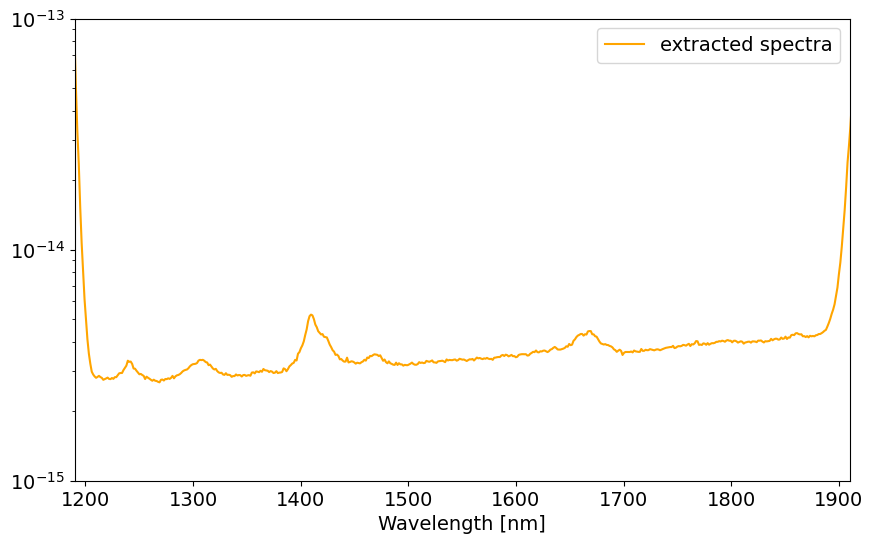

In [69]:
######################
#HOME_PATH = "/Users/gwalth/data/Roman/grizli/"
GRIZLI_PATH = os.environ['GRIZLI']
sens_file = GRIZLI_PATH + '/CONF/Euclid/CONF11/SENS_A.fits'
sens_tbl = Table.read(sens_file)
print(sens_tbl.colnames)

from scipy import interpolate

R = interpolate.interp1d(sens_tbl['WAVELENGTH'],sens_tbl['SENSITIVITY'])
w0,w1 = sens_tbl['WAVELENGTH'][0],sens_tbl['WAVELENGTH'][-1]

w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], bin=0)
#w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
#                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)

i0 = np.argmin(np.abs(w-w0))
i1 = np.argmin(np.abs(w-w1))

w = w[i0:i1]
f = f[i0:i1]
e = e[i0:i1]
    
response = [R(w_el) for w_el in w]
    
flux2 = f/response
noise2 = e/response

fig = plt.figure()
p1 = fig.add_subplot(111)
# plot spectrum
p1.plot(w/10., flux2, c="orange", label="extracted spectra") # linestyle='steps-mid')
# factor of 10 off, could be WAV_AB being wrong (i.e. 1600 instead of 160)

p1.set_xlim(1190,1910.0)
p1.set_ylim(1e-15,1e-13)
p1.set_yscale("log")
p1.set_xlabel("Wavelength [nm]")
#p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual

p1.legend(loc=1)
plt.show()

(3.688858985900879, 29.343302726745605)

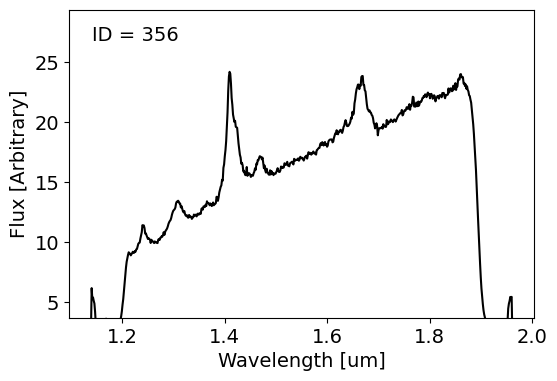

In [70]:
from scipy import integrate

### Plot 1D spectra

fig = plt.figure(figsize=(6,4))
p1 = fig.add_subplot(111)
key = "NISP-GLWv1"
w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], bin=0)
#w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
#                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)

#sf = f/np.nanmax(f)
sf = f
std = np.nanstd(sf)
med = np.nanmedian(sf)

sig = 2.
y0 = med-sig*std
y1 = med+sig*std

p1.text(0.05,0.9,"ID = %i" % (id),transform=p1.transAxes)
p1.plot(w/1.e4, sf, c="k") # linestyle='steps-mid')

#p1.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
p1.set_ylabel("Flux [Arbitrary]")
p1.set_xlabel("Wavelength [um]")

p1.set_ylim(y0,y1)

## Loop over all objects and fit their redshifts
[top](#Table-of-Contents)

In [71]:
os.chdir(os.path.join(HOME_PATH, root, 'Extractions'))

In [72]:
total_Nl = 0

all_Nl = []
for i,euclid_srcs in enumerate(all_euclid_srcs):
    euclid_all,euclid_magcut,euclid_extract = euclid_srcs
    Nl = [id for id in euclid_extract['NUMBER']]
    print(all_det[i],"number_of_sources =",len(Nl))
    all_Nl.append(Nl)
    
    total_Nl += len(Nl)

print()
print("Total sources for all detectors =",  total_Nl)
print(all_Nl)

DET11 number_of_sources = 126
DET12 number_of_sources = 126
DET13 number_of_sources = 141
DET14 number_of_sources = 129
DET21 number_of_sources = 136
DET22 number_of_sources = 125
DET23 number_of_sources = 137
DET24 number_of_sources = 130
DET31 number_of_sources = 156
DET32 number_of_sources = 142
DET33 number_of_sources = 152
DET34 number_of_sources = 153
DET41 number_of_sources = 96
DET42 number_of_sources = 118
DET43 number_of_sources = 128
DET44 number_of_sources = 84

Total sources for all detectors = 2079
[[16, 24, 40, 56, 81, 92, 107, 137, 154, 165, 204, 214, 234, 253, 265, 276, 289, 301, 316, 328, 346, 384, 397, 424, 434, 444, 469, 487, 500, 515, 528, 540, 551, 562, 582, 603, 614, 631, 668, 685, 698, 8, 12, 19, 35, 48, 64, 75, 86, 97, 111, 121, 147, 159, 174, 185, 198, 210, 224, 242, 260, 271, 283, 294, 309, 321, 336, 356, 373, 391, 414, 428, 439, 452, 465, 477, 495, 508, 522, 535, 545, 556, 574, 598, 607, 623, 639, 654, 675, 22, 37, 54, 79, 89, 103, 115, 127, 136, 149, 179, 1

In [ ]:
import importlib
importlib.reload(grizli.fitting)

In [ ]:
import importlib
importlib.reload(grizli.multifit)

In [73]:
# subset
all_Nl = [all_Nl[0]]

Fitting redshifts for DET11
id = 16
1 of 126
beam_00016.grism.A.fits
SIM_10_18_22_DET11_00016.beams.fits
load_master_fits: Euclid_DET11_00016.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00016.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500   12210.8 (0.0500) 1/335
  0.0542   12210.6 (0.0542) 2/335
  0.0584   12210.7 (0.0542) 3/335
  0.0627   12210.8 (0.0542) 4/335
  0.0669   12210.6 (0.0669) 5/335
  0.0712   12210.5 (0.0712) 6/335
  0.0755   12209.7 (0.0755) 7/335
  0.0798   12210.3 (0.0755) 8/335
  0.0841   12210.0 (0.0755) 9/335
  0.0885   12210.5 (0.0755) 10/335
  0.0929   12210.6 (0.0755) 11/335
  0.0972   12210.1 (0.0755) 12/335
  0.1016   12210.5 (0.0755) 13/335
  0.1060   12210.7 (0.0755) 14/335
  0.1105   12209.6 (0.1105) 15/335
  0.1149   12209.8 (0.1105) 16/335
  0.1194   12210.3 (0.1105) 17/335
  0.1239   12210.2 (0.1105) 18/335
  0.1284   12210.1 (0.1105)

  1.1832   12209.7 (0.8309) 184/335
  1.1919   12210.6 (0.8309) 185/335
  1.2007   12210.3 (0.8309) 186/335
  1.2096   12209.1 (0.8309) 187/335
  1.2184   12210.0 (0.8309) 188/335
  1.2273   12210.1 (0.8309) 189/335
  1.2362   12209.7 (0.8309) 190/335
  1.2452   12210.2 (0.8309) 191/335
  1.2542   12209.5 (0.8309) 192/335
  1.2632   12209.9 (0.8309) 193/335
  1.2723   12209.4 (0.8309) 194/335
  1.2814   12210.6 (0.8309) 195/335
  1.2905   12210.8 (0.8309) 196/335
  1.2997   12210.6 (0.8309) 197/335
  1.3089   12209.1 (0.8309) 198/335
  1.3182   12210.5 (0.8309) 199/335
  1.3275   12210.6 (0.8309) 200/335
  1.3368   12210.6 (0.8309) 201/335
  1.3462   12210.7 (0.8309) 202/335
  1.3556   12210.7 (0.8309) 203/335
  1.3650   12210.6 (0.8309) 204/335
  1.3745   12210.2 (0.8309) 205/335
  1.3840   12210.3 (0.8309) 206/335
  1.3936   12210.5 (0.8309) 207/335
  1.4032   12209.6 (0.8309) 208/335
  1.4128   12209.3 (0.8309) 209/335
  1.4225   12209.3 (0.8309) 210/335
  1.4322   12210.0 (0.8309) 

- 2.6753   12205.6 (2.6737) 42/243
- 2.6755   12205.7 (2.6737) 43/243
- 2.6757   12205.7 (2.6737) 44/243
- 2.6759   12205.8 (2.6737) 45/243
- 2.6761   12205.9 (2.6737) 46/243
- 2.6763   12205.9 (2.6737) 47/243
- 2.6765   12206.0 (2.6737) 48/243
- 2.6767   12206.1 (2.6737) 49/243
- 2.6769   12206.2 (2.6737) 50/243
- 2.6771   12206.2 (2.6737) 51/243
- 2.6773   12206.3 (2.6737) 52/243
- 2.6775   12206.4 (2.6737) 53/243
- 2.6777   12206.5 (2.6737) 54/243
- 2.6779   12206.6 (2.6737) 55/243
- 2.6781   12206.6 (2.6737) 56/243
- 2.6783   12206.7 (2.6737) 57/243
- 2.6785   12206.8 (2.6737) 58/243
- 2.6787   12206.8 (2.6737) 59/243
- 2.6789   12206.9 (2.6737) 60/243
- 2.6791   12207.0 (2.6737) 61/243
- 2.6793   12207.0 (2.6737) 62/243
- 2.6795   12207.1 (2.6737) 63/243
- 2.6797   12207.1 (2.6737) 64/243
- 2.6799   12207.2 (2.6737) 65/243
- 2.6801   12207.2 (2.6737) 66/243
- 2.6803   12207.3 (2.6737) 67/243
- 2.6805   12207.3 (2.6737) 68/243
- 2.6807   12207.4 (2.6737) 69/243
- 2.6809   12207.5 (

- 0.8393   12208.2 (2.6737) 235/243
- 0.8395   12208.3 (2.6737) 236/243
- 0.8397   12208.4 (2.6737) 237/243
- 0.8399   12208.4 (2.6737) 238/243
- 0.8401   12208.5 (2.6737) 239/243
- 0.8403   12208.6 (2.6737) 240/243
- 0.8405   12208.7 (2.6737) 241/243
- 0.8407   12208.7 (2.6737) 242/243
- 0.8409   12208.8 (2.6737) 243/243
User templates! N=16 

  2.6001   12210.2 (2.6001) 1/41
  2.6037   12210.4 (2.6001) 2/41
  2.6073   12210.7 (2.6001) 3/41
  2.6110   12210.7 (2.6001) 4/41
  2.6146   12210.7 (2.6001) 5/41
  2.6182   12210.4 (2.6001) 6/41
  2.6218   12209.8 (2.6218) 7/41
  2.6254   12209.4 (2.6254) 8/41
  2.6291   12208.4 (2.6291) 9/41
  2.6327   12206.7 (2.6327) 10/41
  2.6363   12206.5 (2.6363) 11/41
  2.6400   12206.8 (2.6363) 12/41
  2.6436   12207.4 (2.6363) 13/41
  2.6472   12208.0 (2.6363) 14/41
  2.6509   12208.6 (2.6363) 15/41
  2.6546   12208.8 (2.6363) 16/41
  2.6582   12208.8 (2.6363) 17/41
  2.6619   12208.4 (2.6363) 18/41
  2.6655   12207.6 (2.6363) 19/41
  2.6692   12206

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00016.full.fits
id = 24
2 of 126
beam_00024.grism.A.fits
SIM_10_18_22_DET11_00024.beams.fits
load_master_fits: Euclid_DET11_00024.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00024.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500    2601.3 (0.0500) 1/335
  0.0542    2594.6 (0.0542) 2/335
  0.0584    2588.8 (0.0584) 3/335
  0.0627    2583.2 (0.0627) 4/335
  0.0669    2578.8 (0.0669) 5/335
  0.0712    2575.4 (0.0712) 6/335
  0.0755    2571.9 (0.0755) 7/335
  0.0798    2569.6 (0.0798) 8/335
  0.0841    2567.7 (0.0841) 9/335
  0.0885    2565.3 (0.0885) 10/335
  0.0929    2563.5 (0.0929) 11/335
  0.0972    2562.9 (0.0972) 12/335
  0.1016    2564.1 (0.0972) 13/335
  0.1060    2564.6 (0.0972) 14/335
  0.1105    2565.5 (0.0972) 15/335
  0.1149    2567.0 (0.0972) 16/335
  0.1194    2567.7 (0.0972) 17/335
  0.1239    2569.0 (0.0972) 18/335
  0.1284    2569.8 (

  1.2184    2528.7 (1.1572) 188/335
  1.2273    2527.8 (1.1572) 189/335
  1.2362    2528.3 (1.1572) 190/335
  1.2452    2528.3 (1.1572) 191/335
  1.2542    2528.8 (1.1572) 192/335
  1.2632    2530.6 (1.1572) 193/335
  1.2723    2531.0 (1.1572) 194/335
  1.2814    2532.2 (1.1572) 195/335
  1.2905    2533.6 (1.1572) 196/335
  1.2997    2533.9 (1.1572) 197/335
  1.3089    2532.8 (1.1572) 198/335
  1.3182    2533.5 (1.1572) 199/335
  1.3275    2532.4 (1.1572) 200/335
  1.3368    2532.2 (1.1572) 201/335
  1.3462    2531.7 (1.1572) 202/335
  1.3556    2531.1 (1.1572) 203/335
  1.3650    2531.8 (1.1572) 204/335
  1.3745    2531.8 (1.1572) 205/335
  1.3840    2532.2 (1.1572) 206/335
  1.3936    2532.0 (1.1572) 207/335
  1.4032    2531.6 (1.1572) 208/335
  1.4128    2532.9 (1.1572) 209/335
  1.4225    2532.2 (1.1572) 210/335
  1.4322    2532.4 (1.1572) 211/335
  1.4419    2532.8 (1.1572) 212/335
  1.4517    2532.7 (1.1572) 213/335
  1.4615    2533.4 (1.1572) 214/335
  1.4714    2532.6 (1.1572) 

- 1.1635    2523.0 (1.1561) 55/243
- 1.1637    2523.0 (1.1561) 56/243
- 1.1639    2523.0 (1.1561) 57/243
- 1.1641    2523.0 (1.1561) 58/243
- 1.1643    2522.9 (1.1561) 59/243
- 1.1645    2522.9 (1.1561) 60/243
- 1.1647    2522.9 (1.1561) 61/243
- 1.1649    2522.9 (1.1561) 62/243
- 1.1651    2522.9 (1.1561) 63/243
- 1.1653    2522.9 (1.1561) 64/243
- 1.1655    2523.0 (1.1561) 65/243
- 1.1657    2523.0 (1.1561) 66/243
- 1.1659    2523.0 (1.1561) 67/243
- 1.1661    2523.0 (1.1561) 68/243
- 1.1663    2523.1 (1.1561) 69/243
- 1.1665    2523.2 (1.1561) 70/243
- 1.1667    2523.2 (1.1561) 71/243
- 1.1669    2523.3 (1.1561) 72/243
- 1.1671    2523.4 (1.1561) 73/243
- 1.1673    2523.5 (1.1561) 74/243
- 1.1675    2523.6 (1.1561) 75/243
- 1.1677    2523.7 (1.1561) 76/243
- 1.1679    2523.7 (1.1561) 77/243
- 1.1681    2523.7 (1.1561) 78/243
- 1.1683    2523.6 (1.1561) 79/243
- 1.1685    2523.6 (1.1561) 80/243
- 1.1687    2523.6 (1.1561) 81/243
- 0.8139    2525.3 (1.1561) 82/243
- 0.8141    2525.4 (

User templates! N=16 

  1.1131    2527.3 (1.1131) 1/41
  1.1152    2528.1 (1.1131) 2/41
  1.1173    2527.7 (1.1131) 3/41
  1.1194    2527.5 (1.1131) 4/41
  1.1215    2527.1 (1.1215) 5/41
  1.1236    2526.2 (1.1236) 6/41
  1.1258    2525.6 (1.1258) 7/41
  1.1279    2525.5 (1.1279) 8/41
  1.1300    2526.0 (1.1279) 9/41
  1.1322    2526.1 (1.1279) 10/41
  1.1343    2525.7 (1.1279) 11/41
  1.1364    2525.2 (1.1364) 12/41
  1.1386    2524.7 (1.1386) 13/41
  1.1407    2524.4 (1.1407) 14/41
  1.1428    2524.7 (1.1407) 15/41
  1.1450    2525.0 (1.1407) 16/41
  1.1471    2525.3 (1.1407) 17/41
  1.1493    2524.9 (1.1407) 18/41
  1.1514    2524.2 (1.1514) 19/41
  1.1536    2523.7 (1.1536) 20/41
  1.1557    2522.7 (1.1557) 21/41
  1.1579    2522.9 (1.1557) 22/41
  1.1601    2523.2 (1.1557) 23/41
  1.1622    2523.2 (1.1557) 24/41
  1.1644    2522.9 (1.1557) 25/41
  1.1665    2523.2 (1.1557) 26/41
  1.1687    2523.6 (1.1557) 27/41
  1.1709    2524.3 (1.1557) 28/41
  1.1731    2524.6 (1.1557) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00024.full.fits
id = 40
3 of 126
beam_00040.grism.A.fits
SIM_10_18_22_DET11_00040.beams.fits
load_master_fits: SIM_10_18_22_DET11_00040.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3126.8 (0.0500) 1/335
  0.0542    3121.8 (0.0542) 2/335
  0.0584    3118.0 (0.0584) 3/335
  0.0627    3116.0 (0.0627) 4/335
  0.0669    3113.1 (0.0669) 5/335
  0.0712    3109.4 (0.0712) 6/335
  0.0755    3107.5 (0.0755) 7/335
  0.0798    3106.2 (0.0798) 8/335
  0.0841    3104.3 (0.0841) 9/335
  0.0885    3103.3 (0.0885) 10/335
  0.0929    3102.4 (0.0929) 11/335
  0.0972    3101.6 (0.0972) 12/335
  0.1016    3102.1 (0.0972) 13/335
  0.1060    3101.6 (0.0972) 14/335
  0.1105    3102.9 (0.0972) 15/335
  0.1149    3104.0 (0.0972) 16/335
  0.1194    3104.8 (0.0972) 17/335
  0.1239    3105.7 (0.0972) 18/335
  0.1284    3107.7 (0.0972) 19/335
  0.1329    3109.5 (0.0972) 20/335
  0.1375    3111.2 (0.0972) 21/335
  0.1420    3112.9 (0.0972) 22/335
  0.1466   

  1.3462    2931.4 (0.8456) 202/335
  1.3556    2929.9 (0.8456) 203/335
  1.3650    2931.8 (0.8456) 204/335
  1.3745    2930.8 (0.8456) 205/335
  1.3840    2930.6 (0.8456) 206/335
  1.3936    2930.5 (0.8456) 207/335
  1.4032    2932.6 (0.8456) 208/335
  1.4128    2928.2 (0.8456) 209/335
  1.4225    2929.5 (0.8456) 210/335
  1.4322    2928.4 (0.8456) 211/335
  1.4419    2924.1 (0.8456) 212/335
  1.4517    2927.2 (0.8456) 213/335
  1.4615    2931.1 (0.8456) 214/335
  1.4714    2929.9 (0.8456) 215/335
  1.4813    2927.6 (0.8456) 216/335
  1.4913    2932.1 (0.8456) 217/335
  1.5012    2931.7 (0.8456) 218/335
  1.5113    2927.6 (0.8456) 219/335
  1.5213    2926.1 (0.8456) 220/335
  1.5314    2925.6 (0.8456) 221/335
  1.5416    2925.5 (0.8456) 222/335
  1.5518    2924.7 (0.8456) 223/335
  1.5620    2926.3 (0.8456) 224/335
  1.5723    2923.4 (0.8456) 225/335
  1.5826    2921.6 (0.8456) 226/335
  1.5929    2921.0 (0.8456) 227/335
  1.6033    2922.6 (0.8456) 228/335
  1.6138    2918.4 (0.8456) 

- 0.8535    2916.1 (0.8435) 75/243
- 0.8537    2916.2 (0.8435) 76/243
- 0.8539    2916.3 (0.8435) 77/243
- 0.8541    2916.5 (0.8435) 78/243
- 0.8543    2916.6 (0.8435) 79/243
- 0.8545    2916.8 (0.8435) 80/243
- 0.8547    2917.0 (0.8435) 81/243
- 1.6192    2913.1 (0.8435) 82/243
- 1.6194    2913.1 (1.6194) 83/243
- 1.6196    2913.1 (1.6194) 84/243
- 1.6198    2913.2 (1.6194) 85/243
- 1.6200    2913.3 (1.6194) 86/243
- 1.6202    2913.4 (1.6194) 87/243
- 1.6204    2913.6 (1.6194) 88/243
- 1.6206    2913.7 (1.6194) 89/243
- 1.6208    2913.8 (1.6194) 90/243
- 1.6210    2914.0 (1.6194) 91/243
- 1.6212    2914.1 (1.6194) 92/243
- 1.6214    2914.3 (1.6194) 93/243
- 1.6216    2914.5 (1.6194) 94/243
- 1.6218    2914.7 (1.6194) 95/243
- 1.6220    2915.0 (1.6194) 96/243
- 1.6222    2915.2 (1.6194) 97/243
- 1.6224    2915.5 (1.6194) 98/243
- 1.6226    2915.7 (1.6194) 99/243
- 1.6228    2915.8 (1.6194) 100/243
- 1.6230    2916.0 (1.6194) 101/243
- 1.6232    2916.1 (1.6194) 102/243
- 1.6234    2916.

  1.6242    2916.7 (1.6190) 23/41
  1.6268    2917.5 (1.6190) 24/41
  1.6295    2916.8 (1.6190) 25/41
  1.6321    2916.0 (1.6190) 26/41
  1.6347    2917.1 (1.6190) 27/41
  1.6374    2918.9 (1.6190) 28/41
  1.6400    2918.7 (1.6190) 29/41
  1.6426    2917.3 (1.6190) 30/41
  1.6453    2916.9 (1.6190) 31/41
  1.6479    2917.8 (1.6190) 32/41
  1.6506    2919.0 (1.6190) 33/41
  1.6532    2919.6 (1.6190) 34/41
  1.6559    2920.0 (1.6190) 35/41
  1.6585    2920.8 (1.6190) 36/41
  1.6612    2922.1 (1.6190) 37/41
  1.6639    2922.8 (1.6190) 38/41
  1.6665    2922.2 (1.6190) 39/41
  1.6692    2921.2 (1.6190) 40/41
  1.6719    2921.0 (1.6190) 41/41
First iteration: z_best=1.6190

- 1.6176    2914.6 (1.6176) 1/42
- 1.6178    2914.3 (1.6178) 2/42
- 1.6180    2914.1 (1.6180) 3/42
- 1.6182    2913.9 (1.6182) 4/42
- 1.6184    2913.7 (1.6184) 5/42
- 1.6186    2913.6 (1.6186) 6/42
- 1.6188    2913.4 (1.6188) 7/42
- 1.6190    2913.3 (1.6190) 8/42
- 1.6192    2913.2 (1.6192) 9/42
- 1.6194    2913.1 (1.619

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00040.full.fits
id = 56
4 of 126
beam_00056.grism.A.fits
SIM_10_18_22_DET11_00056.beams.fits
load_master_fits: SIM_10_18_22_DET11_00056.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1672.7 (0.0500) 1/335
  0.0542    1672.7 (0.0542) 2/335
  0.0584    1672.6 (0.0584) 3/335
  0.0627    1672.6 (0.0627) 4/335
  0.0669    1672.7 (0.0627) 5/335
  0.0712    1669.8 (0.0712) 6/335
  0.0755    1672.6 (0.0712) 7/335
  0.0798    1672.6 (0.0712) 8/335
  0.0841    1672.1 (0.0712) 9/335
  0.0885    1672.4 (0.0712) 10/335
  0.0929    1672.2 (0.0712) 11/335
  0.0972    1672.7 (0.0712) 12/335
  0.1016    1672.6 (0.0712) 13/335
  0.1060    1672.6 (0.0712) 14/335
  0.1105    1672.7 (0.0712) 15/335
  0.1149    1672.6 (0.0712) 16/335
  0.1194    1672.5 (0.0712) 17/335
  0.1239    1672.6 (0.0712) 18/335
  0.1284    1672.5 (0.0712) 19/335
  0.1329    1672.5 (0.0712) 20/335
  0.1375    1672.6 (0.0712) 21/335
  0.1420    1672.7 (0.0712) 22/335
  0.1466   

  1.1919    1672.1 (0.7312) 185/335
  1.2007    1672.1 (0.7312) 186/335
  1.2096    1672.0 (0.7312) 187/335
  1.2184    1672.0 (0.7312) 188/335
  1.2273    1672.2 (0.7312) 189/335
  1.2362    1672.1 (0.7312) 190/335
  1.2452    1672.1 (0.7312) 191/335
  1.2542    1672.1 (0.7312) 192/335
  1.2632    1672.2 (0.7312) 193/335
  1.2723    1672.2 (0.7312) 194/335
  1.2814    1672.2 (0.7312) 195/335
  1.2905    1672.2 (0.7312) 196/335
  1.2997    1672.2 (0.7312) 197/335
  1.3089    1672.3 (0.7312) 198/335
  1.3182    1672.3 (0.7312) 199/335
  1.3275    1672.4 (0.7312) 200/335
  1.3368    1672.3 (0.7312) 201/335
  1.3462    1672.3 (0.7312) 202/335
  1.3556    1672.0 (0.7312) 203/335
  1.3650    1671.9 (0.7312) 204/335
  1.3745    1672.2 (0.7312) 205/335
  1.3840    1672.1 (0.7312) 206/335
  1.3936    1672.1 (0.7312) 207/335
  1.4032    1670.6 (0.7312) 208/335
  1.4128    1671.8 (0.7312) 209/335
  1.4225    1672.0 (0.7312) 210/335
  1.4322    1670.3 (0.7312) 211/335
  1.4419    1671.7 (0.7312) 

- 1.5169    1670.3 (1.5117) 69/162
- 1.5171    1670.7 (1.5117) 70/162
- 1.5173    1671.1 (1.5117) 71/162
- 1.5175    1671.4 (1.5117) 72/162
- 1.5177    1671.6 (1.5117) 73/162
- 1.5179    1671.8 (1.5117) 74/162
- 1.5181    1672.0 (1.5117) 75/162
- 1.5183    1672.1 (1.5117) 76/162
- 1.5185    1672.2 (1.5117) 77/162
- 1.5187    1672.2 (1.5117) 78/162
- 1.5189    1672.2 (1.5117) 79/162
- 1.5191    1672.2 (1.5117) 80/162
- 1.5193    1672.2 (1.5117) 81/162
- 0.7232    1672.6 (1.5117) 82/162
- 0.7234    1672.6 (1.5117) 83/162
- 0.7236    1672.6 (1.5117) 84/162
- 0.7238    1672.6 (1.5117) 85/162
- 0.7240    1672.6 (1.5117) 86/162
- 0.7242    1672.6 (1.5117) 87/162
- 0.7244    1672.6 (1.5117) 88/162
- 0.7246    1672.6 (1.5117) 89/162
- 0.7248    1672.6 (1.5117) 90/162
- 0.7250    1672.6 (1.5117) 91/162
- 0.7252    1672.6 (1.5117) 92/162
- 0.7254    1672.6 (1.5117) 93/162
- 0.7256    1672.5 (1.5117) 94/162
- 0.7258    1672.5 (1.5117) 95/162
- 0.7260    1672.4 (1.5117) 96/162
- 0.7262    1672.4 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00056.full.fits
id = 81
5 of 126
beam_00081.grism.A.fits
SIM_10_18_22_DET11_00081.beams.fits
load_master_fits: SIM_10_18_22_DET11_00081.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1491.1 (0.0500) 1/335
  0.0542    1490.5 (0.0542) 2/335
  0.0584    1491.1 (0.0542) 3/335
  0.0627    1491.0 (0.0542) 4/335
  0.0669    1490.9 (0.0542) 5/335
  0.0712    1491.4 (0.0542) 6/335
  0.0755    1491.3 (0.0542) 7/335
  0.0798    1491.4 (0.0542) 8/335
  0.0841    1490.7 (0.0542) 9/335
  0.0885    1491.1 (0.0542) 10/335
  0.0929    1491.1 (0.0542) 11/335
  0.0972    1490.9 (0.0542) 12/335
  0.1016    1491.3 (0.0542) 13/335
  0.1060    1491.4 (0.0542) 14/335
  0.1105    1491.2 (0.0542) 15/335
  0.1149    1491.3 (0.0542) 16/335
  0.1194    1491.4 (0.0542) 17/335
  0.1239    1491.4 (0.0542) 18/335
  0.1284    1490.3 (0.1284) 19/335
  0.1329    1491.5 (0.1284) 20/335
  0.1375    1490.7 (0.1284) 21/335
  0.1420    1491.3 (0.1284) 22/335
  0.1466   

  1.2542    1491.5 (0.8904) 192/335
  1.2632    1491.4 (0.8904) 193/335
  1.2723    1491.3 (0.8904) 194/335
  1.2814    1491.4 (0.8904) 195/335
  1.2905    1491.4 (0.8904) 196/335
  1.2997    1491.3 (0.8904) 197/335
  1.3089    1491.3 (0.8904) 198/335
  1.3182    1491.3 (0.8904) 199/335
  1.3275    1490.8 (0.8904) 200/335
  1.3368    1491.4 (0.8904) 201/335
  1.3462    1491.2 (0.8904) 202/335
  1.3556    1491.2 (0.8904) 203/335
  1.3650    1491.3 (0.8904) 204/335
  1.3745    1491.0 (0.8904) 205/335
  1.3840    1491.2 (0.8904) 206/335
  1.3936    1491.1 (0.8904) 207/335
  1.4032    1491.4 (0.8904) 208/335
  1.4128    1491.4 (0.8904) 209/335
  1.4225    1490.0 (0.8904) 210/335
  1.4322    1490.2 (0.8904) 211/335
  1.4419    1490.9 (0.8904) 212/335
  1.4517    1491.4 (0.8904) 213/335
  1.4615    1491.4 (0.8904) 214/335
  1.4714    1491.4 (0.8904) 215/335
  1.4813    1491.3 (0.8904) 216/335
  1.4913    1491.1 (0.8904) 217/335
  1.5012    1491.3 (0.8904) 218/335
  1.5113    1491.4 (0.8904) 

- 1.7117    1489.3 (1.7095) 53/243
- 1.7119    1489.4 (1.7095) 54/243
- 1.7121    1489.5 (1.7095) 55/243
- 1.7123    1489.6 (1.7095) 56/243
- 1.7125    1489.7 (1.7095) 57/243
- 1.7127    1489.9 (1.7095) 58/243
- 1.7129    1490.0 (1.7095) 59/243
- 1.7131    1490.1 (1.7095) 60/243
- 1.7133    1490.3 (1.7095) 61/243
- 1.7135    1490.4 (1.7095) 62/243
- 1.7137    1490.6 (1.7095) 63/243
- 1.7139    1490.7 (1.7095) 64/243
- 1.7141    1490.8 (1.7095) 65/243
- 1.7143    1490.9 (1.7095) 66/243
- 1.7145    1491.1 (1.7095) 67/243
- 1.7147    1491.2 (1.7095) 68/243
- 1.7149    1491.2 (1.7095) 69/243
- 1.7151    1491.3 (1.7095) 70/243
- 1.7153    1491.4 (1.7095) 71/243
- 1.7155    1491.4 (1.7095) 72/243
- 1.7157    1491.5 (1.7095) 73/243
- 1.7159    1491.5 (1.7095) 74/243
- 1.7161    1491.5 (1.7095) 75/243
- 1.7163    1491.4 (1.7095) 76/243
- 1.7165    1491.4 (1.7095) 77/243
- 1.7167    1491.4 (1.7095) 78/243
- 1.7169    1491.4 (1.7095) 79/243
- 1.7171    1491.4 (1.7095) 80/243
- 1.7173    1491.4 (

User templates! N=16 

  1.6553    1490.8 (1.6553) 1/41
  1.6579    1491.1 (1.6553) 2/41
  1.6606    1491.3 (1.6553) 3/41
  1.6633    1491.5 (1.6553) 4/41
  1.6659    1491.4 (1.6553) 5/41
  1.6686    1491.6 (1.6553) 6/41
  1.6713    1491.5 (1.6553) 7/41
  1.6739    1490.8 (1.6739) 8/41
  1.6766    1490.6 (1.6766) 9/41
  1.6793    1490.9 (1.6766) 10/41
  1.6820    1491.4 (1.6766) 11/41
  1.6847    1491.2 (1.6766) 12/41
  1.6873    1491.0 (1.6766) 13/41
  1.6900    1491.3 (1.6766) 14/41
  1.6927    1491.3 (1.6766) 15/41
  1.6954    1491.2 (1.6766) 16/41
  1.6981    1491.0 (1.6766) 17/41
  1.7008    1491.1 (1.6766) 18/41
  1.7035    1491.4 (1.6766) 19/41
  1.7062    1490.2 (1.7062) 20/41
  1.7089    1488.6 (1.7089) 21/41
  1.7116    1489.2 (1.7089) 22/41
  1.7144    1491.0 (1.7089) 23/41
  1.7171    1491.4 (1.7089) 24/41
  1.7198    1491.3 (1.7089) 25/41
  1.7225    1490.9 (1.7089) 26/41
  1.7252    1490.3 (1.7089) 27/41
  1.7280    1490.4 (1.7089) 28/41
  1.7307    1490.9 (1.7089) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00081.full.fits
id = 92
6 of 126
beam_00092.grism.A.fits
SIM_10_18_22_DET11_00092.beams.fits
load_master_fits: SIM_10_18_22_DET11_00092.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2019.7 (0.0500) 1/335
  0.0542    2018.3 (0.0542) 2/335
  0.0584    2020.1 (0.0542) 3/335
  0.0627    2019.8 (0.0542) 4/335
  0.0669    2020.4 (0.0542) 5/335
  0.0712    2020.3 (0.0542) 6/335
  0.0755    2020.3 (0.0542) 7/335
  0.0798    2020.4 (0.0542) 8/335
  0.0841    2020.5 (0.0542) 9/335
  0.0885    2020.3 (0.0542) 10/335
  0.0929    2020.4 (0.0542) 11/335
  0.0972    2020.3 (0.0542) 12/335
  0.1016    2020.5 (0.0542) 13/335
  0.1060    2020.4 (0.0542) 14/335
  0.1105    2019.9 (0.0542) 15/335
  0.1149    2019.8 (0.0542) 16/335
  0.1194    2019.6 (0.0542) 17/335
  0.1239    2019.6 (0.0542) 18/335
  0.1284    2017.4 (0.1284) 19/335
  0.1329    2020.0 (0.1284) 20/335
  0.1375    2019.3 (0.1284) 21/335
  0.1420    2019.5 (0.1284) 22/335
  0.1466   

  1.2997    2020.3 (0.4693) 197/335
  1.3089    2020.3 (0.4693) 198/335
  1.3182    2020.3 (0.4693) 199/335
  1.3275    2019.4 (0.4693) 200/335
  1.3368    2020.4 (0.4693) 201/335
  1.3462    2020.3 (0.4693) 202/335
  1.3556    2020.3 (0.4693) 203/335
  1.3650    2020.4 (0.4693) 204/335
  1.3745    2020.4 (0.4693) 205/335
  1.3840    2018.2 (0.4693) 206/335
  1.3936    2020.2 (0.4693) 207/335
  1.4032    2020.2 (0.4693) 208/335
  1.4128    2019.9 (0.4693) 209/335
  1.4225    2020.1 (0.4693) 210/335
  1.4322    2018.3 (0.4693) 211/335
  1.4419    2019.1 (0.4693) 212/335
  1.4517    2017.3 (0.4693) 213/335
  1.4615    2015.3 (1.4615) 214/335
  1.4714    2018.7 (1.4615) 215/335
  1.4813    2020.0 (1.4615) 216/335
  1.4913    2019.8 (1.4615) 217/335
  1.5012    2020.2 (1.4615) 218/335
  1.5113    2020.2 (1.4615) 219/335
  1.5213    2019.9 (1.4615) 220/335
  1.5314    2020.3 (1.4615) 221/335
  1.5416    2020.1 (1.4615) 222/335
  1.5518    2019.9 (1.4615) 223/335
  1.5620    2019.8 (1.4615) 

- 1.4628    2016.5 (1.4590) 53/243
- 1.4630    2016.7 (1.4590) 54/243
- 1.4632    2016.9 (1.4590) 55/243
- 1.4634    2017.1 (1.4590) 56/243
- 1.4636    2017.3 (1.4590) 57/243
- 1.4638    2017.4 (1.4590) 58/243
- 1.4640    2017.6 (1.4590) 59/243
- 1.4642    2017.8 (1.4590) 60/243
- 1.4644    2017.9 (1.4590) 61/243
- 1.4646    2018.1 (1.4590) 62/243
- 1.4648    2018.2 (1.4590) 63/243
- 1.4650    2018.3 (1.4590) 64/243
- 1.4652    2018.4 (1.4590) 65/243
- 1.4654    2018.5 (1.4590) 66/243
- 1.4656    2018.6 (1.4590) 67/243
- 1.4658    2018.7 (1.4590) 68/243
- 1.4660    2018.7 (1.4590) 69/243
- 1.4662    2018.8 (1.4590) 70/243
- 1.4664    2018.8 (1.4590) 71/243
- 1.4666    2018.9 (1.4590) 72/243
- 1.4668    2018.9 (1.4590) 73/243
- 1.4670    2019.0 (1.4590) 74/243
- 1.4672    2019.0 (1.4590) 75/243
- 1.4674    2019.0 (1.4590) 76/243
- 1.4676    2019.0 (1.4590) 77/243
- 1.4678    2019.1 (1.4590) 78/243
- 1.4680    2019.1 (1.4590) 79/243
- 1.4682    2019.1 (1.4590) 80/243
- 1.4684    2019.1 (

User templates! N=16 

  1.4099    2020.0 (1.4099) 1/41
  1.4123    2020.0 (1.4099) 2/41
  1.4147    2019.5 (1.4147) 3/41
  1.4171    2019.7 (1.4147) 4/41
  1.4195    2020.0 (1.4147) 5/41
  1.4219    2020.1 (1.4147) 6/41
  1.4244    2020.1 (1.4147) 7/41
  1.4268    2020.1 (1.4147) 8/41
  1.4292    2019.2 (1.4292) 9/41
  1.4316    2018.3 (1.4316) 10/41
  1.4341    2018.6 (1.4316) 11/41
  1.4365    2019.2 (1.4316) 12/41
  1.4389    2019.4 (1.4316) 13/41
  1.4414    2019.0 (1.4316) 14/41
  1.4438    2019.9 (1.4316) 15/41
  1.4463    2020.1 (1.4316) 16/41
  1.4487    2017.1 (1.4487) 17/41
  1.4512    2017.0 (1.4512) 18/41
  1.4536    2017.7 (1.4512) 19/41
  1.4561    2015.8 (1.4561) 20/41
  1.4585    2014.1 (1.4585) 21/41
  1.4610    2014.8 (1.4585) 22/41
  1.4635    2017.1 (1.4585) 23/41
  1.4659    2018.7 (1.4585) 24/41
  1.4684    2019.1 (1.4585) 25/41
  1.4709    2018.7 (1.4585) 26/41
  1.4733    2019.0 (1.4585) 27/41
  1.4758    2019.6 (1.4585) 28/41
  1.4783    2019.8 (1.4585) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00092.full.fits
id = 107
7 of 126
beam_00107.grism.A.fits
SIM_10_18_22_DET11_00107.beams.fits
load_master_fits: SIM_10_18_22_DET11_00107.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1864.4 (0.0500) 1/335
  0.0542    1865.5 (0.0500) 2/335
  0.0584    1865.3 (0.0500) 3/335
  0.0627    1865.0 (0.0500) 4/335
  0.0669    1865.3 (0.0500) 5/335
  0.0712    1865.4 (0.0500) 6/335
  0.0755    1865.3 (0.0500) 7/335
  0.0798    1864.4 (0.0500) 8/335
  0.0841    1865.0 (0.0500) 9/335
  0.0885    1865.2 (0.0500) 10/335
  0.0929    1865.3 (0.0500) 11/335
  0.0972    1864.7 (0.0500) 12/335
  0.1016    1865.1 (0.0500) 13/335
  0.1060    1865.1 (0.0500) 14/335
  0.1105    1864.6 (0.0500) 15/335
  0.1149    1865.1 (0.0500) 16/335
  0.1194    1865.1 (0.0500) 17/335
  0.1239    1863.8 (0.1239) 18/335
  0.1284    1865.0 (0.1239) 19/335
  0.1329    1865.0 (0.1239) 20/335
  0.1375    1865.0 (0.1239) 21/335
  0.1420    1865.0 (0.1239) 22/335
  0.1466  

  1.2007    1865.3 (0.9754) 186/335
  1.2096    1865.2 (0.9754) 187/335
  1.2184    1865.3 (0.9754) 188/335
  1.2273    1865.3 (0.9754) 189/335
  1.2362    1864.4 (0.9754) 190/335
  1.2452    1865.3 (0.9754) 191/335
  1.2542    1865.3 (0.9754) 192/335
  1.2632    1864.9 (0.9754) 193/335
  1.2723    1865.2 (0.9754) 194/335
  1.2814    1865.2 (0.9754) 195/335
  1.2905    1865.2 (0.9754) 196/335
  1.2997    1864.7 (0.9754) 197/335
  1.3089    1865.1 (0.9754) 198/335
  1.3182    1865.1 (0.9754) 199/335
  1.3275    1865.1 (0.9754) 200/335
  1.3368    1865.0 (0.9754) 201/335
  1.3462    1865.2 (0.9754) 202/335
  1.3556    1864.9 (0.9754) 203/335
  1.3650    1865.0 (0.9754) 204/335
  1.3745    1863.8 (0.9754) 205/335
  1.3840    1864.8 (0.9754) 206/335
  1.3936    1864.5 (0.9754) 207/335
  1.4032    1864.8 (0.9754) 208/335
  1.4128    1864.8 (0.9754) 209/335
  1.4225    1864.6 (0.9754) 210/335
  1.4322    1862.7 (0.9754) 211/335
  1.4419    1864.0 (0.9754) 212/335
  1.4517    1864.7 (0.9754) 

- 0.9763    1857.1 (0.9763) 46/243
- 0.9765    1857.0 (0.9765) 47/243
- 0.9767    1857.1 (0.9765) 48/243
- 0.9769    1857.2 (0.9765) 49/243
- 0.9771    1857.4 (0.9765) 50/243
- 0.9773    1857.6 (0.9765) 51/243
- 0.9775    1857.9 (0.9765) 52/243
- 0.9777    1858.2 (0.9765) 53/243
- 0.9779    1858.5 (0.9765) 54/243
- 0.9781    1858.9 (0.9765) 55/243
- 0.9783    1859.2 (0.9765) 56/243
- 0.9785    1859.6 (0.9765) 57/243
- 0.9787    1859.9 (0.9765) 58/243
- 0.9789    1860.3 (0.9765) 59/243
- 0.9791    1860.6 (0.9765) 60/243
- 0.9793    1860.9 (0.9765) 61/243
- 0.9795    1861.2 (0.9765) 62/243
- 0.9797    1861.5 (0.9765) 63/243
- 0.9799    1861.8 (0.9765) 64/243
- 0.9801    1862.1 (0.9765) 65/243
- 0.9803    1862.4 (0.9765) 66/243
- 0.9805    1862.6 (0.9765) 67/243
- 0.9807    1862.9 (0.9765) 68/243
- 0.9809    1863.1 (0.9765) 69/243
- 0.9811    1863.3 (0.9765) 70/243
- 0.9813    1863.5 (0.9765) 71/243
- 0.9815    1863.7 (0.9765) 72/243
- 0.9817    1863.8 (0.9765) 73/243
- 0.9819    1864.0 (

- 0.4315    1863.4 (0.9765) 243/243
User templates! N=16 

  0.9370    1864.9 (0.9370) 1/41
  0.9389    1865.2 (0.9370) 2/41
  0.9408    1865.1 (0.9370) 3/41
  0.9428    1864.5 (0.9428) 4/41
  0.9447    1864.6 (0.9428) 5/41
  0.9467    1865.8 (0.9428) 6/41
  0.9486    1865.9 (0.9428) 7/41
  0.9506    1866.0 (0.9428) 8/41
  0.9525    1866.0 (0.9428) 9/41
  0.9545    1865.9 (0.9428) 10/41
  0.9564    1865.7 (0.9428) 11/41
  0.9584    1865.9 (0.9428) 12/41
  0.9604    1865.9 (0.9428) 13/41
  0.9623    1865.4 (0.9428) 14/41
  0.9643    1864.5 (0.9428) 15/41
  0.9662    1864.3 (0.9662) 16/41
  0.9682    1864.5 (0.9662) 17/41
  0.9702    1863.8 (0.9702) 18/41
  0.9722    1862.3 (0.9722) 19/41
  0.9741    1859.9 (0.9741) 20/41
  0.9761    1857.2 (0.9761) 21/41
  0.9781    1858.8 (0.9761) 22/41
  0.9801    1862.0 (0.9761) 23/41
  0.9820    1864.1 (0.9761) 24/41
  0.9840    1865.2 (0.9761) 25/41
  0.9860    1865.4 (0.9761) 26/41
  0.9880    1865.0 (0.9761) 27/41
  0.9900    1864.9 (0.9761) 28/4

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00107.full.fits
id = 137
8 of 126
beam_00137.grism.A.fits
SIM_10_18_22_DET11_00137.beams.fits
load_master_fits: SIM_10_18_22_DET11_00137.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   22247.9 (0.0500) 1/335
  0.0542   22233.8 (0.0542) 2/335
  0.0584   22223.6 (0.0584) 3/335
  0.0627   22213.7 (0.0627) 4/335
  0.0669   22206.7 (0.0669) 5/335
  0.0712   22202.3 (0.0712) 6/335
  0.0755   22196.5 (0.0755) 7/335
  0.0798   22187.6 (0.0798) 8/335
  0.0841   22194.6 (0.0798) 9/335
  0.0885   22208.8 (0.0798) 10/335
  0.0929   22209.3 (0.0798) 11/335
  0.0972   22215.5 (0.0798) 12/335
  0.1016   22230.6 (0.0798) 13/335
  0.1060   22247.4 (0.0798) 14/335
  0.1105   22255.1 (0.0798) 15/335
  0.1149   22258.9 (0.0798) 16/335
  0.1194   22275.2 (0.0798) 17/335
  0.1239   22288.3 (0.0798) 18/335
  0.1284   22295.6 (0.0798) 19/335
  0.1329   22299.2 (0.0798) 20/335
  0.1375   22302.5 (0.0798) 21/335
  0.1420   22306.0 (0.0798) 22/335
  0.1466  

  1.2542   22096.7 (0.8679) 192/335
  1.2632   22105.7 (0.8679) 193/335
  1.2723   22119.7 (0.8679) 194/335
  1.2814   22121.5 (0.8679) 195/335
  1.2905   22128.8 (0.8679) 196/335
  1.2997   22124.3 (0.8679) 197/335
  1.3089   22115.6 (0.8679) 198/335
  1.3182   22128.6 (0.8679) 199/335
  1.3275   22133.0 (0.8679) 200/335
  1.3368   22148.5 (0.8679) 201/335
  1.3462   22148.7 (0.8679) 202/335
  1.3556   22156.3 (0.8679) 203/335
  1.3650   22160.1 (0.8679) 204/335
  1.3745   22168.2 (0.8679) 205/335
  1.3840   22170.1 (0.8679) 206/335
  1.3936   22166.7 (0.8679) 207/335
  1.4032   22162.2 (0.8679) 208/335
  1.4128   22160.2 (0.8679) 209/335
  1.4225   22150.0 (0.8679) 210/335
  1.4322   22153.9 (0.8679) 211/335
  1.4419   22124.6 (0.8679) 212/335
  1.4517   22137.6 (0.8679) 213/335
  1.4615   22145.5 (0.8679) 214/335
  1.4714   22167.6 (0.8679) 215/335
  1.4813   22191.9 (0.8679) 216/335
  1.4913   22198.0 (0.8679) 217/335
  1.5012   22198.4 (0.8679) 218/335
  1.5113   22190.9 (0.8679) 

- 0.8679   22006.0 (0.8679) 52/81
- 0.8681   22005.9 (0.8681) 53/81
- 0.8683   22005.9 (0.8683) 54/81
- 0.8685   22005.9 (0.8683) 55/81
- 0.8687   22006.1 (0.8683) 56/81
- 0.8689   22006.2 (0.8683) 57/81
- 0.8691   22006.4 (0.8683) 58/81
- 0.8693   22006.5 (0.8683) 59/81
- 0.8695   22006.6 (0.8683) 60/81
- 0.8697   22006.7 (0.8683) 61/81
- 0.8699   22006.8 (0.8683) 62/81
- 0.8701   22006.9 (0.8683) 63/81
- 0.8703   22007.1 (0.8683) 64/81
- 0.8705   22007.3 (0.8683) 65/81
- 0.8707   22007.5 (0.8683) 66/81
- 0.8709   22007.8 (0.8683) 67/81
- 0.8711   22008.2 (0.8683) 68/81
- 0.8713   22008.6 (0.8683) 69/81
- 0.8715   22009.0 (0.8683) 70/81
- 0.8717   22009.4 (0.8683) 71/81
- 0.8719   22009.8 (0.8683) 72/81
- 0.8721   22010.2 (0.8683) 73/81
- 0.8723   22010.6 (0.8683) 74/81
- 0.8725   22011.0 (0.8683) 75/81
- 0.8727   22011.5 (0.8683) 76/81
- 0.8729   22012.0 (0.8683) 77/81
- 0.8731   22012.6 (0.8683) 78/81
- 0.8733   22013.2 (0.8683) 79/81
- 0.8735   22013.8 (0.8683) 80/81
- 0.8737   220

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00137.full.fits
id = 154
9 of 126
beam_00154.grism.A.fits
SIM_10_18_22_DET11_00154.beams.fits
load_master_fits: SIM_10_18_22_DET11_00154.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    7953.7 (0.0500) 1/335
  0.0542    7953.2 (0.0542) 2/335
  0.0584    7953.4 (0.0542) 3/335
  0.0627    7937.3 (0.0627) 4/335
  0.0669    7936.4 (0.0669) 5/335
  0.0712    7941.2 (0.0669) 6/335
  0.0755    7941.0 (0.0669) 7/335
  0.0798    7923.6 (0.0798) 8/335
  0.0841    7916.2 (0.0841) 9/335
  0.0885    7918.5 (0.0841) 10/335
  0.0929    7917.1 (0.0841) 11/335
  0.0972    7928.6 (0.0841) 12/335
  0.1016    7930.4 (0.0841) 13/335
  0.1060    7947.7 (0.0841) 14/335
  0.1105    7947.7 (0.0841) 15/335
  0.1149    7943.5 (0.0841) 16/335
  0.1194    7938.8 (0.0841) 17/335
  0.1239    7924.1 (0.0841) 18/335
  0.1284    7914.4 (0.1284) 19/335
  0.1329    7912.6 (0.1329) 20/335
  0.1375    7911.1 (0.1375) 21/335
  0.1420    7915.3 (0.1375) 22/335
  0.1466  

  1.3462    7932.0 (0.3402) 202/335
  1.3556    7929.2 (0.3402) 203/335
  1.3650    7933.2 (0.3402) 204/335
  1.3745    7930.0 (0.3402) 205/335
  1.3840    7922.0 (0.3402) 206/335
  1.3936    7922.7 (0.3402) 207/335
  1.4032    7924.0 (0.3402) 208/335
  1.4128    7926.6 (0.3402) 209/335
  1.4225    7930.2 (0.3402) 210/335
  1.4322    7943.1 (0.3402) 211/335
  1.4419    7949.7 (0.3402) 212/335
  1.4517    7950.3 (0.3402) 213/335
  1.4615    7949.7 (0.3402) 214/335
  1.4714    7950.8 (0.3402) 215/335
  1.4813    7957.0 (0.3402) 216/335
  1.4913    7961.0 (0.3402) 217/335
  1.5012    7953.0 (0.3402) 218/335
  1.5113    7954.1 (0.3402) 219/335
  1.5213    7954.4 (0.3402) 220/335
  1.5314    7927.1 (0.3402) 221/335
  1.5416    7924.8 (0.3402) 222/335
  1.5518    7925.7 (0.3402) 223/335
  1.5620    7925.6 (0.3402) 224/335
  1.5723    7946.1 (0.3402) 225/335
  1.5826    7944.9 (0.3402) 226/335
  1.5929    7921.6 (0.3402) 227/335
  1.6033    7909.0 (0.3402) 228/335
  1.6138    7893.2 (0.3402) 

- 2.5201    7923.9 (0.3388) 85/243
- 2.5203    7922.4 (0.3388) 86/243
- 2.5205    7921.1 (0.3388) 87/243
- 2.5207    7920.1 (0.3388) 88/243
- 2.5209    7918.8 (0.3388) 89/243
- 2.5211    7917.4 (0.3388) 90/243
- 2.5213    7916.0 (0.3388) 91/243
- 2.5215    7914.6 (0.3388) 92/243
- 2.5217    7913.1 (0.3388) 93/243
- 2.5219    7911.7 (0.3388) 94/243
- 2.5221    7910.2 (0.3388) 95/243
- 2.5223    7908.7 (0.3388) 96/243
- 2.5225    7907.3 (0.3388) 97/243
- 2.5227    7905.9 (0.3388) 98/243
- 2.5229    7904.5 (0.3388) 99/243
- 2.5231    7903.1 (0.3388) 100/243
- 2.5233    7901.8 (0.3388) 101/243
- 2.5235    7900.4 (0.3388) 102/243
- 2.5237    7899.1 (0.3388) 103/243
- 2.5239    7897.7 (0.3388) 104/243
- 2.5241    7896.4 (0.3388) 105/243
- 2.5243    7895.2 (0.3388) 106/243
- 2.5245    7894.0 (0.3388) 107/243
- 2.5247    7892.8 (0.3388) 108/243
- 2.5249    7891.7 (0.3388) 109/243
- 2.5251    7890.7 (0.3388) 110/243
- 2.5253    7889.6 (0.3388) 111/243
- 2.5255    7888.7 (0.3388) 112/243
- 2.525

- 0.3388    7876.5 (0.3388) 11/21
- 0.3390    7876.5 (0.3388) 12/21
- 0.3392    7876.6 (0.3388) 13/21
- 0.3394    7876.7 (0.3388) 14/21
- 0.3396    7876.9 (0.3388) 15/21
- 0.3398    7877.1 (0.3388) 16/21
- 0.3400    7877.4 (0.3388) 17/21
- 0.3402    7877.8 (0.3388) 18/21
- 0.3404    7878.1 (0.3388) 19/21
- 0.3406    7878.6 (0.3388) 20/21
- 0.3408    7879.0 (0.3388) 21/21
Drizzle line -> PaB  (-10.00 0.79)
Drizzle line -> HeI-1083 (-9.92 2.42)
Drizzle line -> SIII (31.33 4.14)
SIM_10_18_22_DET11_00154.full.fits


 [astropy.io.fits.verify]


id = 165
10 of 126
beam_00165.grism.A.fits
SIM_10_18_22_DET11_00165.beams.fits
load_master_fits: SIM_10_18_22_DET11_00165.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1754.1 (0.0500) 1/335
  0.0542    1754.0 (0.0542) 2/335
  0.0584    1753.9 (0.0584) 3/335
  0.0627    1754.1 (0.0584) 4/335
  0.0669    1754.1 (0.0584) 5/335
  0.0712    1754.0 (0.0584) 6/335
  0.0755    1754.1 (0.0584) 7/335
  0.0798    1753.5 (0.0798) 8/335
  0.0841    1752.6 (0.0841) 9/335
  0.0885    1753.2 (0.0841) 10/335
  0.0929    1753.0 (0.0841) 11/335
  0.0972    1751.9 (0.0972) 12/335
  0.1016    1752.4 (0.0972) 13/335
  0.1060    1752.6 (0.0972) 14/335
  0.1105    1752.6 (0.0972) 15/335
  0.1149    1751.6 (0.1149) 16/335
  0.1194    1752.6 (0.1149) 17/335
  0.1239    1752.5 (0.1149) 18/335
  0.1284    1751.4 (0.1284) 19/335
  0.1329    1752.0 (0.1284) 20/335
  0.1375    1752.0 (0.1284) 21/335
  0.1420    1751.8 (0.1284) 22/335
  0.1466    1752.1 (0.1284) 23/335
  0.1512 

  1.3089    1753.6 (0.1934) 198/335
  1.3182    1752.1 (0.1934) 199/335
  1.3275    1751.6 (0.1934) 200/335
  1.3368    1751.3 (0.1934) 201/335
  1.3462    1752.5 (0.1934) 202/335
  1.3556    1752.1 (0.1934) 203/335
  1.3650    1753.1 (0.1934) 204/335
  1.3745    1753.2 (0.1934) 205/335
  1.3840    1752.3 (0.1934) 206/335
  1.3936    1752.0 (0.1934) 207/335
  1.4032    1753.0 (0.1934) 208/335
  1.4128    1750.3 (0.1934) 209/335
  1.4225    1753.1 (0.1934) 210/335
  1.4322    1753.1 (0.1934) 211/335
  1.4419    1751.4 (0.1934) 212/335
  1.4517    1752.4 (0.1934) 213/335
  1.4615    1752.8 (0.1934) 214/335
  1.4714    1752.9 (0.1934) 215/335
  1.4813    1753.0 (0.1934) 216/335
  1.4913    1753.2 (0.1934) 217/335
  1.5012    1752.9 (0.1934) 218/335
  1.5113    1752.7 (0.1934) 219/335
  1.5213    1753.0 (0.1934) 220/335
  1.5314    1752.9 (0.1934) 221/335
  1.5416    1752.5 (0.1934) 222/335
  1.5518    1752.2 (0.1934) 223/335
  1.5620    1752.7 (0.1934) 224/335
  1.5723    1752.3 (0.1934) 

- 1.7028    1751.2 (1.6990) 61/243
- 1.7030    1751.4 (1.6990) 62/243
- 1.7032    1751.6 (1.6990) 63/243
- 1.7034    1751.8 (1.6990) 64/243
- 1.7036    1752.0 (1.6990) 65/243
- 1.7038    1752.1 (1.6990) 66/243
- 1.7040    1752.3 (1.6990) 67/243
- 1.7042    1752.4 (1.6990) 68/243
- 1.7044    1752.5 (1.6990) 69/243
- 1.7046    1752.5 (1.6990) 70/243
- 1.7048    1752.6 (1.6990) 71/243
- 1.7050    1752.7 (1.6990) 72/243
- 1.7052    1752.7 (1.6990) 73/243
- 1.7054    1752.8 (1.6990) 74/243
- 1.7056    1752.8 (1.6990) 75/243
- 1.7058    1752.8 (1.6990) 76/243
- 1.7060    1752.8 (1.6990) 77/243
- 1.7062    1752.9 (1.6990) 78/243
- 1.7064    1752.9 (1.6990) 79/243
- 1.7066    1752.9 (1.6990) 80/243
- 1.7068    1752.9 (1.6990) 81/243
- 2.1523    1752.2 (1.6990) 82/243
- 2.1525    1751.9 (1.6990) 83/243
- 2.1527    1751.7 (1.6990) 84/243
- 2.1529    1751.4 (1.6990) 85/243
- 2.1531    1751.2 (1.6990) 86/243
- 2.1533    1750.9 (1.6990) 87/243
- 2.1535    1750.6 (1.6990) 88/243
- 2.1537    1750.3 (

  2.1863    1753.4 (2.1578) 30/41
  2.1895    1752.3 (2.1578) 31/41
  2.1927    1750.6 (2.1578) 32/41
  2.1959    1750.2 (2.1578) 33/41
  2.1991    1751.9 (2.1578) 34/41
  2.2023    1752.5 (2.1578) 35/41
  2.2055    1752.4 (2.1578) 36/41
  2.2087    1752.8 (2.1578) 37/41
  2.2119    1753.2 (2.1578) 38/41
  2.2151    1753.2 (2.1578) 39/41
  2.2183    1752.8 (2.1578) 40/41
  2.2215    1752.8 (2.1578) 41/41
First iteration: z_best=2.1578

- 2.1565    1746.1 (2.1565) 1/63
- 2.1567    1745.9 (2.1567) 2/63
- 2.1569    1745.8 (2.1569) 3/63
- 2.1571    1745.6 (2.1571) 4/63
- 2.1573    1745.5 (2.1573) 5/63
- 2.1575    1745.3 (2.1575) 6/63
- 2.1577    1745.3 (2.1577) 7/63
- 2.1579    1745.2 (2.1579) 8/63
- 2.1581    1745.1 (2.1581) 9/63
- 2.1583    1745.1 (2.1583) 10/63
- 2.1585    1745.1 (2.1583) 11/63
- 2.1587    1745.2 (2.1583) 12/63
- 2.1589    1745.2 (2.1583) 13/63
- 2.1591    1745.3 (2.1583) 14/63
- 2.1593    1745.4 (2.1583) 15/63
- 2.1595    1745.5 (2.1583) 16/63
- 2.1597    1745.6 (2.158

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00165.full.fits
id = 204
11 of 126
beam_00204.grism.A.fits
SIM_10_18_22_DET11_00204.beams.fits
load_master_fits: SIM_10_18_22_DET11_00204.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3842.7 (0.0500) 1/335
  0.0542    3837.3 (0.0542) 2/335
  0.0584    3830.4 (0.0584) 3/335
  0.0627    3825.0 (0.0627) 4/335
  0.0669    3823.5 (0.0669) 5/335
  0.0712    3822.2 (0.0712) 6/335
  0.0755    3820.5 (0.0755) 7/335
  0.0798    3819.5 (0.0798) 8/335
  0.0841    3819.9 (0.0798) 9/335
  0.0885    3817.7 (0.0885) 10/335
  0.0929    3815.3 (0.0929) 11/335
  0.0972    3815.6 (0.0929) 12/335
  0.1016    3816.2 (0.0929) 13/335
  0.1060    3813.9 (0.1060) 14/335
  0.1105    3814.4 (0.1060) 15/335
  0.1149    3817.1 (0.1060) 16/335
  0.1194    3818.5 (0.1060) 17/335
  0.1239    3819.0 (0.1060) 18/335
  0.1284    3822.4 (0.1060) 19/335
  0.1329    3826.4 (0.1060) 20/335
  0.1375    3828.2 (0.1060) 21/335
  0.1420    3832.4 (0.1060) 22/335
  0.1466 

  1.2273    3669.7 (0.9834) 189/335
  1.2362    3669.7 (0.9834) 190/335
  1.2452    3671.4 (0.9834) 191/335
  1.2542    3672.7 (0.9834) 192/335
  1.2632    3672.5 (0.9834) 193/335
  1.2723    3674.7 (0.9834) 194/335
  1.2814    3676.5 (0.9834) 195/335
  1.2905    3679.3 (0.9834) 196/335
  1.2997    3679.8 (0.9834) 197/335
  1.3089    3680.0 (0.9834) 198/335
  1.3182    3682.6 (0.9834) 199/335
  1.3275    3680.4 (0.9834) 200/335
  1.3368    3684.0 (0.9834) 201/335
  1.3462    3685.2 (0.9834) 202/335
  1.3556    3683.7 (0.9834) 203/335
  1.3650    3681.2 (0.9834) 204/335
  1.3745    3686.2 (0.9834) 205/335
  1.3840    3685.4 (0.9834) 206/335
  1.3936    3687.4 (0.9834) 207/335
  1.4032    3683.4 (0.9834) 208/335
  1.4128    3686.4 (0.9834) 209/335
  1.4225    3685.1 (0.9834) 210/335
  1.4322    3683.4 (0.9834) 211/335
  1.4419    3686.5 (0.9834) 212/335
  1.4517    3686.8 (0.9834) 213/335
  1.4615    3684.9 (0.9834) 214/335
  1.4714    3683.6 (0.9834) 215/335
  1.4813    3680.6 (0.9834) 

- 0.9842    3643.1 (0.9800) 56/162
- 0.9844    3643.8 (0.9800) 57/162
- 0.9846    3644.6 (0.9800) 58/162
- 0.9848    3645.3 (0.9800) 59/162
- 0.9850    3646.0 (0.9800) 60/162
- 0.9852    3646.7 (0.9800) 61/162
- 0.9854    3647.5 (0.9800) 62/162
- 0.9856    3648.3 (0.9800) 63/162
- 0.9858    3649.1 (0.9800) 64/162
- 0.9860    3649.9 (0.9800) 65/162
- 0.9862    3650.7 (0.9800) 66/162
- 0.9864    3651.6 (0.9800) 67/162
- 0.9866    3652.4 (0.9800) 68/162
- 0.9868    3653.3 (0.9800) 69/162
- 0.9870    3654.2 (0.9800) 70/162
- 0.9872    3655.2 (0.9800) 71/162
- 0.9874    3656.1 (0.9800) 72/162
- 0.9876    3657.0 (0.9800) 73/162
- 0.9878    3657.9 (0.9800) 74/162
- 0.9880    3658.8 (0.9800) 75/162
- 0.9882    3659.7 (0.9800) 76/162
- 0.9884    3660.5 (0.9800) 77/162
- 0.9886    3661.4 (0.9800) 78/162
- 0.9888    3662.3 (0.9800) 79/162
- 0.9890    3663.1 (0.9800) 80/162
- 0.9892    3663.8 (0.9800) 81/162
- 1.5914    3650.6 (0.9800) 82/162
- 1.5916    3649.9 (0.9800) 83/162
- 1.5918    3649.3 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00204.full.fits
id = 214
12 of 126
beam_00214.grism.A.fits
SIM_10_18_22_DET11_00214.beams.fits
load_master_fits: SIM_10_18_22_DET11_00214.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2268.0 (0.0500) 1/335
  0.0542    2267.8 (0.0542) 2/335
  0.0584    2267.6 (0.0584) 3/335
  0.0627    2268.0 (0.0584) 4/335
  0.0669    2268.3 (0.0584) 5/335
  0.0712    2267.9 (0.0584) 6/335
  0.0755    2268.4 (0.0584) 7/335
  0.0798    2268.9 (0.0584) 8/335
  0.0841    2269.2 (0.0584) 9/335
  0.0885    2269.3 (0.0584) 10/335
  0.0929    2269.4 (0.0584) 11/335
  0.0972    2269.6 (0.0584) 12/335
  0.1016    2269.9 (0.0584) 13/335
  0.1060    2269.9 (0.0584) 14/335
  0.1105    2269.9 (0.0584) 15/335
  0.1149    2270.4 (0.0584) 16/335
  0.1194    2270.4 (0.0584) 17/335
  0.1239    2270.1 (0.0584) 18/335
  0.1284    2270.6 (0.0584) 19/335
  0.1329    2270.4 (0.0584) 20/335
  0.1375    2271.2 (0.0584) 21/335
  0.1420    2271.0 (0.0584) 22/335
  0.1466 

  1.3936    2265.0 (0.5171) 207/335
  1.4032    2264.4 (0.5171) 208/335
  1.4128    2265.0 (0.5171) 209/335
  1.4225    2264.5 (0.5171) 210/335
  1.4322    2265.1 (0.5171) 211/335
  1.4419    2264.7 (0.5171) 212/335
  1.4517    2265.0 (0.5171) 213/335
  1.4615    2264.0 (0.5171) 214/335
  1.4714    2264.4 (0.5171) 215/335
  1.4813    2263.6 (0.5171) 216/335
  1.4913    2260.0 (0.5171) 217/335
  1.5012    2264.3 (0.5171) 218/335
  1.5113    2262.9 (0.5171) 219/335
  1.5213    2255.9 (0.5171) 220/335
  1.5314    2256.4 (0.5171) 221/335
  1.5416    2261.5 (0.5171) 222/335
  1.5518    2258.0 (0.5171) 223/335
  1.5620    2260.3 (0.5171) 224/335
  1.5723    2259.9 (0.5171) 225/335
  1.5826    2260.9 (0.5171) 226/335
  1.5929    2261.3 (0.5171) 227/335
  1.6033    2260.9 (0.5171) 228/335
  1.6138    2260.4 (0.5171) 229/335
  1.6242    2261.7 (0.5171) 230/335
  1.6348    2261.8 (0.5171) 231/335
  1.6453    2261.3 (0.5171) 232/335
  1.6559    2261.7 (0.5171) 233/335
  1.6666    2260.4 (0.5171) 

- 2.3132    2233.0 (2.3110) 60/243
- 2.3134    2234.3 (2.3110) 61/243
- 2.3136    2235.7 (2.3110) 62/243
- 2.3138    2237.1 (2.3110) 63/243
- 2.3140    2238.4 (2.3110) 64/243
- 2.3142    2239.8 (2.3110) 65/243
- 2.3144    2241.1 (2.3110) 66/243
- 2.3146    2242.4 (2.3110) 67/243
- 2.3148    2243.7 (2.3110) 68/243
- 2.3150    2244.9 (2.3110) 69/243
- 2.3152    2246.1 (2.3110) 70/243
- 2.3154    2247.2 (2.3110) 71/243
- 2.3156    2248.2 (2.3110) 72/243
- 2.3158    2249.2 (2.3110) 73/243
- 2.3160    2250.2 (2.3110) 74/243
- 2.3162    2251.0 (2.3110) 75/243
- 2.3164    2251.8 (2.3110) 76/243
- 2.3166    2252.6 (2.3110) 77/243
- 2.3168    2253.3 (2.3110) 78/243
- 2.3170    2253.9 (2.3110) 79/243
- 2.3172    2254.5 (2.3110) 80/243
- 2.3174    2255.1 (2.3110) 81/243
- 0.5090    2261.2 (2.3110) 82/243
- 0.5092    2261.1 (2.3110) 83/243
- 0.5094    2260.9 (2.3110) 84/243
- 0.5096    2260.7 (2.3110) 85/243
- 0.5098    2260.5 (2.3110) 86/243
- 0.5100    2260.3 (2.3110) 87/243
- 0.5102    2260.0 (

  0.5260    2260.7 (0.5154) 28/41
  0.5275    2260.2 (0.5154) 29/41
  0.5291    2259.4 (0.5154) 30/41
  0.5306    2258.5 (0.5154) 31/41
  0.5321    2258.9 (0.5154) 32/41
  0.5337    2260.1 (0.5154) 33/41
  0.5352    2260.2 (0.5154) 34/41
  0.5367    2260.2 (0.5154) 35/41
  0.5383    2260.6 (0.5154) 36/41
  0.5398    2260.9 (0.5154) 37/41
  0.5413    2260.7 (0.5154) 38/41
  0.5429    2260.0 (0.5154) 39/41
  0.5444    2259.3 (0.5154) 40/41
  0.5460    2259.7 (0.5154) 41/41
First iteration: z_best=0.5154

- 0.5136    2244.4 (0.5136) 1/21
- 0.5138    2241.6 (0.5138) 2/21
- 0.5140    2238.5 (0.5140) 3/21
- 0.5142    2235.2 (0.5142) 4/21
- 0.5144    2231.7 (0.5144) 5/21
- 0.5146    2228.1 (0.5146) 6/21
- 0.5148    2224.7 (0.5148) 7/21
- 0.5150    2221.7 (0.5150) 8/21
- 0.5152    2219.2 (0.5152) 9/21
- 0.5154    2217.5 (0.5154) 10/21
- 0.5156    2216.7 (0.5156) 11/21
- 0.5158    2216.8 (0.5156) 12/21
- 0.5160    2217.8 (0.5156) 13/21
- 0.5162    2219.7 (0.5156) 14/21
- 0.5164    2222.2 (0.515

 [astropy.io.fits.verify]


id = 234
13 of 126
beam_00234.grism.A.fits
SIM_10_18_22_DET11_00234.beams.fits
load_master_fits: SIM_10_18_22_DET11_00234.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1714.5 (0.0500) 1/335
  0.0542    1714.5 (0.0500) 2/335
  0.0584    1714.7 (0.0500) 3/335
  0.0627    1714.8 (0.0500) 4/335
  0.0669    1714.9 (0.0500) 5/335
  0.0712    1714.7 (0.0500) 6/335
  0.0755    1715.2 (0.0500) 7/335
  0.0798    1715.2 (0.0500) 8/335
  0.0841    1715.1 (0.0500) 9/335
  0.0885    1715.4 (0.0500) 10/335
  0.0929    1715.5 (0.0500) 11/335
  0.0972    1715.6 (0.0500) 12/335
  0.1016    1714.6 (0.0500) 13/335
  0.1060    1714.0 (0.1060) 14/335
  0.1105    1715.6 (0.1060) 15/335
  0.1149    1715.6 (0.1060) 16/335
  0.1194    1715.5 (0.1060) 17/335
  0.1239    1715.6 (0.1060) 18/335
  0.1284    1715.7 (0.1060) 19/335
  0.1329    1715.2 (0.1060) 20/335
  0.1375    1714.5 (0.1060) 21/335
  0.1420    1715.6 (0.1060) 22/335
  0.1466    1715.6 (0.1060) 23/335
  0.1512 

  1.2814    1714.5 (0.2928) 195/335
  1.2905    1714.9 (0.2928) 196/335
  1.2997    1715.2 (0.2928) 197/335
  1.3089    1715.6 (0.2928) 198/335
  1.3182    1715.4 (0.2928) 199/335
  1.3275    1715.6 (0.2928) 200/335
  1.3368    1715.5 (0.2928) 201/335
  1.3462    1715.4 (0.2928) 202/335
  1.3556    1715.4 (0.2928) 203/335
  1.3650    1715.3 (0.2928) 204/335
  1.3745    1715.3 (0.2928) 205/335
  1.3840    1714.8 (0.2928) 206/335
  1.3936    1714.8 (0.2928) 207/335
  1.4032    1715.0 (0.2928) 208/335
  1.4128    1714.2 (0.2928) 209/335
  1.4225    1714.6 (0.2928) 210/335
  1.4322    1713.9 (0.2928) 211/335
  1.4419    1709.4 (1.4419) 212/335
  1.4517    1713.6 (1.4419) 213/335
  1.4615    1713.5 (1.4419) 214/335
  1.4714    1715.0 (1.4419) 215/335
  1.4813    1715.3 (1.4419) 216/335
  1.4913    1714.4 (1.4419) 217/335
  1.5012    1714.1 (1.4419) 218/335
  1.5113    1715.4 (1.4419) 219/335
  1.5213    1714.7 (1.4419) 220/335
  1.5314    1713.9 (1.4419) 221/335
  1.5416    1714.1 (1.4419) 

- 1.4491    1712.9 (1.4415) 76/243
- 1.4493    1713.0 (1.4415) 77/243
- 1.4495    1713.1 (1.4415) 78/243
- 1.4497    1713.2 (1.4415) 79/243
- 1.4499    1713.2 (1.4415) 80/243
- 1.4501    1713.3 (1.4415) 81/243
- 0.2845    1714.4 (1.4415) 82/243
- 0.2847    1714.4 (1.4415) 83/243
- 0.2849    1714.4 (1.4415) 84/243
- 0.2851    1714.3 (1.4415) 85/243
- 0.2853    1714.3 (1.4415) 86/243
- 0.2855    1714.2 (1.4415) 87/243
- 0.2857    1714.2 (1.4415) 88/243
- 0.2859    1714.1 (1.4415) 89/243
- 0.2861    1714.0 (1.4415) 90/243
- 0.2863    1713.9 (1.4415) 91/243
- 0.2865    1713.9 (1.4415) 92/243
- 0.2867    1713.8 (1.4415) 93/243
- 0.2869    1713.7 (1.4415) 94/243
- 0.2871    1713.6 (1.4415) 95/243
- 0.2873    1713.6 (1.4415) 96/243
- 0.2875    1713.6 (1.4415) 97/243
- 0.2877    1713.6 (1.4415) 98/243
- 0.2879    1713.6 (1.4415) 99/243
- 0.2881    1713.7 (1.4415) 100/243
- 0.2883    1713.8 (1.4415) 101/243
- 0.2885    1713.9 (1.4415) 102/243
- 0.2887    1714.0 (1.4415) 103/243
- 0.2889    1714

  1.4655    1712.3 (1.4409) 31/41
  1.4679    1713.6 (1.4409) 32/41
  1.4704    1714.8 (1.4409) 33/41
  1.4729    1715.0 (1.4409) 34/41
  1.4754    1715.0 (1.4409) 35/41
  1.4778    1715.2 (1.4409) 36/41
  1.4803    1715.3 (1.4409) 37/41
  1.4828    1715.3 (1.4409) 38/41
  1.4853    1715.4 (1.4409) 39/41
  1.4878    1715.0 (1.4409) 40/41
  1.4902    1714.5 (1.4409) 41/41
First iteration: z_best=1.4409

- 1.4396    1710.3 (1.4396) 1/42
- 1.4398    1710.1 (1.4398) 2/42
- 1.4400    1710.0 (1.4400) 3/42
- 1.4402    1709.8 (1.4402) 4/42
- 1.4404    1709.7 (1.4404) 5/42
- 1.4406    1709.6 (1.4406) 6/42
- 1.4408    1709.5 (1.4408) 7/42
- 1.4410    1709.4 (1.4410) 8/42
- 1.4412    1709.4 (1.4412) 9/42
- 1.4414    1709.4 (1.4414) 10/42
- 1.4416    1709.4 (1.4414) 11/42
- 1.4418    1709.4 (1.4414) 12/42
- 1.4420    1709.5 (1.4414) 13/42
- 1.4422    1709.5 (1.4414) 14/42
- 1.4424    1709.6 (1.4414) 15/42
- 1.4426    1709.7 (1.4414) 16/42
- 1.4428    1709.8 (1.4414) 17/42
- 1.4430    1709.9 (1.441

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00234.full.fits
id = 253
14 of 126
beam_00253.grism.A.fits
SIM_10_18_22_DET11_00253.beams.fits
load_master_fits: SIM_10_18_22_DET11_00253.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   36557.4 (0.0500) 1/335
  0.0542   36459.3 (0.0542) 2/335
  0.0584   36368.4 (0.0584) 3/335
  0.0627   36280.4 (0.0627) 4/335
  0.0669   36201.3 (0.0669) 5/335
  0.0712   36138.7 (0.0712) 6/335
  0.0755   36084.3 (0.0755) 7/335
  0.0798   36035.2 (0.0798) 8/335
  0.0841   35996.1 (0.0841) 9/335
  0.0885   35966.9 (0.0885) 10/335
  0.0929   35945.7 (0.0929) 11/335
  0.0972   35930.4 (0.0972) 12/335
  0.1016   35921.5 (0.1016) 13/335
  0.1060   35931.5 (0.1016) 14/335
  0.1105   35943.4 (0.1016) 15/335
  0.1149   35961.8 (0.1016) 16/335
  0.1194   35985.8 (0.1016) 17/335
  0.1239   36017.1 (0.1016) 18/335
  0.1284   36050.8 (0.1016) 19/335
  0.1329   36076.8 (0.1016) 20/335
  0.1375   36102.1 (0.1016) 21/335
  0.1420   36136.9 (0.1016) 22/335
  0.1466 

  1.2723   30672.1 (0.8679) 194/335
  1.2814   30668.3 (0.8679) 195/335
  1.2905   30672.2 (0.8679) 196/335
  1.2997   30660.0 (0.8679) 197/335
  1.3089   30650.9 (0.8679) 198/335
  1.3182   30661.5 (0.8679) 199/335
  1.3275   30665.7 (0.8679) 200/335
  1.3368   30674.7 (0.8679) 201/335
  1.3462   30666.9 (0.8679) 202/335
  1.3556   30668.5 (0.8679) 203/335
  1.3650   30672.6 (0.8679) 204/335
  1.3745   30682.3 (0.8679) 205/335
  1.3840   30691.4 (0.8679) 206/335
  1.3936   30692.0 (0.8679) 207/335
  1.4032   30704.8 (0.8679) 208/335
  1.4128   30692.6 (0.8679) 209/335
  1.4225   30698.9 (0.8679) 210/335
  1.4322   30684.1 (0.8679) 211/335
  1.4419   30677.3 (0.8679) 212/335
  1.4517   30676.0 (0.8679) 213/335
  1.4615   30680.3 (0.8679) 214/335
  1.4714   30704.8 (0.8679) 215/335
  1.4813   30734.5 (0.8679) 216/335
  1.4913   30730.8 (0.8679) 217/335
  1.5012   30707.8 (0.8679) 218/335
  1.5113   30686.6 (0.8679) 219/335
  1.5213   30652.7 (0.8679) 220/335
  1.5314   30628.6 (0.8679) 

- 0.8697   30422.6 (0.8677) 52/81
- 0.8699   30422.8 (0.8677) 53/81
- 0.8701   30423.0 (0.8677) 54/81
- 0.8703   30423.4 (0.8677) 55/81
- 0.8705   30423.7 (0.8677) 56/81
- 0.8707   30424.0 (0.8677) 57/81
- 0.8709   30424.3 (0.8677) 58/81
- 0.8711   30424.6 (0.8677) 59/81
- 0.8713   30424.7 (0.8677) 60/81
- 0.8715   30424.8 (0.8677) 61/81
- 0.8717   30424.9 (0.8677) 62/81
- 0.8719   30425.1 (0.8677) 63/81
- 0.8721   30425.4 (0.8677) 64/81
- 0.8723   30425.7 (0.8677) 65/81
- 0.8725   30426.0 (0.8677) 66/81
- 0.8727   30426.3 (0.8677) 67/81
- 0.8729   30426.5 (0.8677) 68/81
- 0.8731   30426.7 (0.8677) 69/81
- 0.8733   30426.9 (0.8677) 70/81
- 0.8735   30427.0 (0.8677) 71/81
- 0.8737   30427.2 (0.8677) 72/81
- 0.8739   30427.5 (0.8677) 73/81
- 0.8741   30428.0 (0.8677) 74/81
- 0.8743   30428.5 (0.8677) 75/81
- 0.8745   30428.9 (0.8677) 76/81
- 0.8747   30429.3 (0.8677) 77/81
- 0.8749   30429.7 (0.8677) 78/81
- 0.8751   30430.0 (0.8677) 79/81
- 0.8753   30430.4 (0.8677) 80/81
- 0.8755   304

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00253.full.fits
id = 265
15 of 126
beam_00265.grism.A.fits
SIM_10_18_22_DET11_00265.beams.fits
load_master_fits: SIM_10_18_22_DET11_00265.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    4429.8 (0.0500) 1/335
  0.0542    4424.0 (0.0542) 2/335
  0.0584    4415.5 (0.0584) 3/335
  0.0627    4408.2 (0.0627) 4/335
  0.0669    4401.3 (0.0669) 5/335
  0.0712    4395.8 (0.0712) 6/335
  0.0755    4391.8 (0.0755) 7/335
  0.0798    4388.8 (0.0798) 8/335
  0.0841    4389.4 (0.0798) 9/335
  0.0885    4389.1 (0.0798) 10/335
  0.0929    4370.4 (0.0929) 11/335
  0.0972    4320.8 (0.0972) 12/335
  0.1016    4317.8 (0.1016) 13/335
  0.1060    4369.8 (0.1016) 14/335
  0.1105    4383.0 (0.1016) 15/335
  0.1149    4397.3 (0.1016) 16/335
  0.1194    4399.9 (0.1016) 17/335
  0.1239    4403.9 (0.1016) 18/335
  0.1284    4406.4 (0.1016) 19/335
  0.1329    4405.1 (0.1016) 20/335
  0.1375    4408.2 (0.1016) 21/335
  0.1420    4408.9 (0.1016) 22/335
  0.1466 

  1.3089    4404.2 (1.1485) 198/335
  1.3182    4400.3 (1.1485) 199/335
  1.3275    4400.1 (1.1485) 200/335
  1.3368    4405.9 (1.1485) 201/335
  1.3462    4399.9 (1.1485) 202/335
  1.3556    4403.3 (1.1485) 203/335
  1.3650    4406.6 (1.1485) 204/335
  1.3745    4406.8 (1.1485) 205/335
  1.3840    4411.9 (1.1485) 206/335
  1.3936    4413.6 (1.1485) 207/335
  1.4032    4408.3 (1.1485) 208/335
  1.4128    4408.4 (1.1485) 209/335
  1.4225    4407.1 (1.1485) 210/335
  1.4322    4406.9 (1.1485) 211/335
  1.4419    4405.2 (1.1485) 212/335
  1.4517    4408.0 (1.1485) 213/335
  1.4615    4411.5 (1.1485) 214/335
  1.4714    4412.9 (1.1485) 215/335
  1.4813    4411.8 (1.1485) 216/335
  1.4913    4415.5 (1.1485) 217/335
  1.5012    4424.1 (1.1485) 218/335
  1.5113    4429.4 (1.1485) 219/335
  1.5213    4426.0 (1.1485) 220/335
  1.5314    4430.7 (1.1485) 221/335
  1.5416    4423.2 (1.1485) 222/335
  1.5518    4432.9 (1.1485) 223/335
  1.5620    4432.3 (1.1485) 224/335
  1.5723    4427.4 (1.1485) 

- 1.1536    4325.2 (1.1480) 66/81
- 1.1538    4326.3 (1.1480) 67/81
- 1.1540    4327.3 (1.1480) 68/81
- 1.1542    4328.3 (1.1480) 69/81
- 1.1544    4329.4 (1.1480) 70/81
- 1.1546    4330.6 (1.1480) 71/81
- 1.1548    4331.8 (1.1480) 72/81
- 1.1550    4333.2 (1.1480) 73/81
- 1.1552    4334.7 (1.1480) 74/81
- 1.1554    4336.3 (1.1480) 75/81
- 1.1556    4337.9 (1.1480) 76/81
- 1.1558    4339.7 (1.1480) 77/81
- 1.1560    4341.5 (1.1480) 78/81
- 1.1562    4343.3 (1.1480) 79/81
- 1.1564    4345.1 (1.1480) 80/81
- 1.1566    4347.0 (1.1480) 81/81
User templates! N=16 

  1.1051    4429.4 (1.1051) 1/41
  1.1072    4428.8 (1.1072) 2/41
  1.1093    4429.5 (1.1072) 3/41
  1.1114    4430.7 (1.1072) 4/41
  1.1135    4430.4 (1.1072) 5/41
  1.1157    4429.0 (1.1072) 6/41
  1.1178    4427.1 (1.1178) 7/41
  1.1199    4424.5 (1.1199) 8/41
  1.1220    4421.3 (1.1220) 9/41
  1.1241    4418.0 (1.1241) 10/41
  1.1263    4416.0 (1.1263) 11/41
  1.1284    4415.6 (1.1284) 12/41
  1.1305    4412.4 (1.1305) 13/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00265.full.fits
id = 276
16 of 126
beam_00276.grism.A.fits
SIM_10_18_22_DET11_00276.beams.fits
load_master_fits: SIM_10_18_22_DET11_00276.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2107.6 (0.0500) 1/335
  0.0542    2107.9 (0.0500) 2/335
  0.0584    2108.4 (0.0500) 3/335
  0.0627    2107.7 (0.0500) 4/335
  0.0669    2109.9 (0.0500) 5/335
  0.0712    2110.5 (0.0500) 6/335
  0.0755    2111.0 (0.0500) 7/335
  0.0798    2111.3 (0.0500) 8/335
  0.0841    2112.0 (0.0500) 9/335
  0.0885    2112.1 (0.0500) 10/335
  0.0929    2112.6 (0.0500) 11/335
  0.0972    2113.1 (0.0500) 12/335
  0.1016    2113.1 (0.0500) 13/335
  0.1060    2113.1 (0.0500) 14/335
  0.1105    2114.1 (0.0500) 15/335
  0.1149    2113.7 (0.0500) 16/335
  0.1194    2113.6 (0.0500) 17/335
  0.1239    2113.4 (0.0500) 18/335
  0.1284    2113.1 (0.0500) 19/335
  0.1329    2113.5 (0.0500) 20/335
  0.1375    2114.0 (0.0500) 21/335
  0.1420    2114.3 (0.0500) 22/335
  0.1466 

  1.3840    2113.2 (0.8163) 206/335
  1.3936    2113.2 (0.8163) 207/335
  1.4032    2113.8 (0.8163) 208/335
  1.4128    2114.3 (0.8163) 209/335
  1.4225    2114.5 (0.8163) 210/335
  1.4322    2112.7 (0.8163) 211/335
  1.4419    2113.0 (0.8163) 212/335
  1.4517    2114.2 (0.8163) 213/335
  1.4615    2113.8 (0.8163) 214/335
  1.4714    2114.5 (0.8163) 215/335
  1.4813    2114.0 (0.8163) 216/335
  1.4913    2114.0 (0.8163) 217/335
  1.5012    2114.9 (0.8163) 218/335
  1.5113    2115.1 (0.8163) 219/335
  1.5213    2113.1 (0.8163) 220/335
  1.5314    2112.9 (0.8163) 221/335
  1.5416    2112.7 (0.8163) 222/335
  1.5518    2111.7 (0.8163) 223/335
  1.5620    2112.1 (0.8163) 224/335
  1.5723    2111.8 (0.8163) 225/335
  1.5826    2111.5 (0.8163) 226/335
  1.5929    2112.9 (0.8163) 227/335
  1.6033    2113.2 (0.8163) 228/335
  1.6138    2112.7 (0.8163) 229/335
  1.6242    2110.2 (0.8163) 230/335
  1.6348    2101.0 (0.8163) 231/335
  1.6453    2106.3 (0.8163) 232/335
  1.6559    2109.9 (0.8163) 

- 2.4641    2103.9 (2.4599) 64/243
- 2.4643    2104.3 (2.4599) 65/243
- 2.4645    2104.7 (2.4599) 66/243
- 2.4647    2105.0 (2.4599) 67/243
- 2.4649    2105.4 (2.4599) 68/243
- 2.4651    2105.8 (2.4599) 69/243
- 2.4653    2106.1 (2.4599) 70/243
- 2.4655    2106.5 (2.4599) 71/243
- 2.4657    2106.9 (2.4599) 72/243
- 2.4659    2107.2 (2.4599) 73/243
- 2.4661    2107.6 (2.4599) 74/243
- 2.4663    2107.9 (2.4599) 75/243
- 2.4665    2108.2 (2.4599) 76/243
- 2.4667    2108.6 (2.4599) 77/243
- 2.4669    2108.9 (2.4599) 78/243
- 2.4671    2109.2 (2.4599) 79/243
- 2.4673    2109.5 (2.4599) 80/243
- 2.4675    2109.7 (2.4599) 81/243
- 0.8083    2111.0 (2.4599) 82/243
- 0.8085    2111.0 (2.4599) 83/243
- 0.8087    2110.9 (2.4599) 84/243
- 0.8089    2110.8 (2.4599) 85/243
- 0.8091    2110.7 (2.4599) 86/243
- 0.8093    2110.6 (2.4599) 87/243
- 0.8095    2110.6 (2.4599) 88/243
- 0.8097    2110.5 (2.4599) 89/243
- 0.8099    2110.4 (2.4599) 90/243
- 0.8101    2110.2 (2.4599) 91/243
- 0.8103    2110.1 (

  1.6514    2108.5 (1.6382) 26/41
  1.6540    2109.6 (1.6382) 27/41
  1.6567    2110.3 (1.6382) 28/41
  1.6593    2111.6 (1.6382) 29/41
  1.6620    2111.3 (1.6382) 30/41
  1.6647    2111.0 (1.6382) 31/41
  1.6673    2111.4 (1.6382) 32/41
  1.6700    2111.7 (1.6382) 33/41
  1.6727    2112.0 (1.6382) 34/41
  1.6754    2112.6 (1.6382) 35/41
  1.6780    2112.3 (1.6382) 36/41
  1.6807    2110.5 (1.6382) 37/41
  1.6834    2108.9 (1.6382) 38/41
  1.6861    2109.5 (1.6382) 39/41
  1.6888    2110.3 (1.6382) 40/41
  1.6915    2111.7 (1.6382) 41/41
First iteration: z_best=1.6382

- 1.6365    2098.7 (1.6365) 1/21
- 1.6367    2098.5 (1.6367) 2/21
- 1.6369    2098.3 (1.6369) 3/21
- 1.6371    2098.1 (1.6371) 4/21
- 1.6373    2097.9 (1.6373) 5/21
- 1.6375    2097.7 (1.6375) 6/21
- 1.6377    2097.6 (1.6377) 7/21
- 1.6379    2097.4 (1.6379) 8/21
- 1.6381    2097.3 (1.6381) 9/21
- 1.6383    2097.2 (1.6383) 10/21
- 1.6385    2097.2 (1.6385) 11/21
- 1.6387    2097.2 (1.6387) 12/21
- 1.6389    2097.2 (1.638

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00276.full.fits
id = 289
17 of 126
beam_00289.grism.A.fits
SIM_10_18_22_DET11_00289.beams.fits
load_master_fits: SIM_10_18_22_DET11_00289.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    4651.6 (0.0500) 1/335
  0.0542    4645.5 (0.0542) 2/335
  0.0584    4640.4 (0.0584) 3/335
  0.0627    4634.3 (0.0627) 4/335
  0.0669    4629.2 (0.0669) 5/335
  0.0712    4624.8 (0.0712) 6/335
  0.0755    4623.3 (0.0755) 7/335
  0.0798    4621.3 (0.0798) 8/335
  0.0841    4619.4 (0.0841) 9/335
  0.0885    4620.0 (0.0841) 10/335
  0.0929    4621.4 (0.0841) 11/335
  0.0972    4607.3 (0.0972) 12/335
  0.1016    4615.9 (0.0972) 13/335
  0.1060    4618.0 (0.0972) 14/335
  0.1105    4621.5 (0.0972) 15/335
  0.1149    4625.8 (0.0972) 16/335
  0.1194    4625.7 (0.0972) 17/335
  0.1239    4626.5 (0.0972) 18/335
  0.1284    4629.6 (0.0972) 19/335
  0.1329    4632.4 (0.0972) 20/335
  0.1375    4632.7 (0.0972) 21/335
  0.1420    4634.2 (0.0972) 22/335
  0.1466 

  1.2542    4526.8 (0.8904) 192/335
  1.2632    4531.8 (0.8904) 193/335
  1.2723    4537.2 (0.8904) 194/335
  1.2814    4535.1 (0.8904) 195/335
  1.2905    4535.7 (0.8904) 196/335
  1.2997    4534.9 (0.8904) 197/335
  1.3089    4531.6 (0.8904) 198/335
  1.3182    4529.7 (0.8904) 199/335
  1.3275    4526.5 (0.8904) 200/335
  1.3368    4526.7 (0.8904) 201/335
  1.3462    4525.6 (0.8904) 202/335
  1.3556    4523.5 (0.8904) 203/335
  1.3650    4522.0 (0.8904) 204/335
  1.3745    4520.7 (0.8904) 205/335
  1.3840    4526.0 (0.8904) 206/335
  1.3936    4534.9 (0.8904) 207/335
  1.4032    4536.6 (0.8904) 208/335
  1.4128    4540.0 (0.8904) 209/335
  1.4225    4539.7 (0.8904) 210/335
  1.4322    4518.6 (0.8904) 211/335
  1.4419    4529.8 (0.8904) 212/335
  1.4517    4516.7 (0.8904) 213/335
  1.4615    4535.0 (0.8904) 214/335
  1.4714    4539.0 (0.8904) 215/335
  1.4813    4538.5 (0.8904) 216/335
  1.4913    4531.4 (0.8904) 217/335
  1.5012    4533.2 (0.8904) 218/335
  1.5113    4533.0 (0.8904) 

- 2.4916    4487.2 (2.4878) 50/243
- 2.4918    4487.4 (2.4878) 51/243
- 2.4920    4487.5 (2.4878) 52/243
- 2.4922    4487.7 (2.4878) 53/243
- 2.4924    4487.9 (2.4878) 54/243
- 2.4926    4488.1 (2.4878) 55/243
- 2.4928    4488.3 (2.4878) 56/243
- 2.4930    4488.5 (2.4878) 57/243
- 2.4932    4488.7 (2.4878) 58/243
- 2.4934    4489.0 (2.4878) 59/243
- 2.4936    4489.2 (2.4878) 60/243
- 2.4938    4489.3 (2.4878) 61/243
- 2.4940    4489.5 (2.4878) 62/243
- 2.4942    4489.7 (2.4878) 63/243
- 2.4944    4489.8 (2.4878) 64/243
- 2.4946    4489.9 (2.4878) 65/243
- 2.4948    4490.0 (2.4878) 66/243
- 2.4950    4490.1 (2.4878) 67/243
- 2.4952    4490.2 (2.4878) 68/243
- 2.4954    4490.3 (2.4878) 69/243
- 2.4956    4490.4 (2.4878) 70/243
- 2.4958    4490.6 (2.4878) 71/243
- 2.4960    4490.7 (2.4878) 72/243
- 2.4962    4491.0 (2.4878) 73/243
- 2.4964    4491.2 (2.4878) 74/243
- 2.4966    4491.4 (2.4878) 75/243
- 2.4968    4491.7 (2.4878) 76/243
- 2.4970    4492.0 (2.4878) 77/243
- 2.4972    4492.3 (

User templates! N=16 

  2.0340    4528.4 (2.0340) 1/41
  2.0370    4523.2 (2.0370) 2/41
  2.0400    4520.6 (2.0400) 3/41
  2.0431    4523.3 (2.0400) 4/41
  2.0461    4527.6 (2.0400) 5/41
  2.0492    4529.2 (2.0400) 6/41
  2.0522    4530.6 (2.0400) 7/41
  2.0553    4531.5 (2.0400) 8/41
  2.0583    4528.8 (2.0400) 9/41
  2.0614    4522.3 (2.0400) 10/41
  2.0644    4519.9 (2.0644) 11/41
  2.0675    4522.0 (2.0644) 12/41
  2.0706    4521.8 (2.0644) 13/41
  2.0737    4518.7 (2.0737) 14/41
  2.0767    4518.3 (2.0767) 15/41
  2.0798    4518.5 (2.0767) 16/41
  2.0829    4518.1 (2.0829) 17/41
  2.0860    4517.2 (2.0860) 18/41
  2.0891    4497.2 (2.0891) 19/41
  2.0921    4490.7 (2.0921) 20/41
  2.0952    4485.2 (2.0952) 21/41
  2.0983    4487.7 (2.0952) 22/41
  2.1014    4516.2 (2.0952) 23/41
  2.1045    4517.3 (2.0952) 24/41
  2.1076    4517.8 (2.0952) 25/41
  2.1108    4518.2 (2.0952) 26/41
  2.1139    4518.5 (2.0952) 27/41
  2.1170    4517.9 (2.0952) 28/41
  2.1201    4517.8 (2.0952) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00289.full.fits
id = 301
18 of 126
beam_00301.grism.A.fits
SIM_10_18_22_DET11_00301.beams.fits
load_master_fits: SIM_10_18_22_DET11_00301.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2925.9 (0.0500) 1/335
  0.0542    2925.4 (0.0542) 2/335
  0.0584    2924.2 (0.0584) 3/335
  0.0627    2925.5 (0.0584) 4/335
  0.0669    2925.6 (0.0584) 5/335
  0.0712    2927.1 (0.0584) 6/335
  0.0755    2927.4 (0.0584) 7/335
  0.0798    2925.9 (0.0584) 8/335
  0.0841    2925.4 (0.0584) 9/335
  0.0885    2925.6 (0.0584) 10/335
  0.0929    2925.4 (0.0584) 11/335
  0.0972    2926.3 (0.0584) 12/335
  0.1016    2926.9 (0.0584) 13/335
  0.1060    2925.5 (0.0584) 14/335
  0.1105    2925.7 (0.0584) 15/335
  0.1149    2925.9 (0.0584) 16/335
  0.1194    2926.8 (0.0584) 17/335
  0.1239    2926.8 (0.0584) 18/335
  0.1284    2927.0 (0.0584) 19/335
  0.1329    2926.8 (0.0584) 20/335
  0.1375    2927.5 (0.0584) 21/335
  0.1420    2928.1 (0.0584) 22/335
  0.1466 

  1.4714    2926.7 (0.1466) 215/335
  1.4813    2927.0 (0.1466) 216/335
  1.4913    2925.6 (0.1466) 217/335
  1.5012    2926.4 (0.1466) 218/335
  1.5113    2927.3 (0.1466) 219/335
  1.5213    2926.6 (0.1466) 220/335
  1.5314    2927.1 (0.1466) 221/335
  1.5416    2928.4 (0.1466) 222/335
  1.5518    2927.4 (0.1466) 223/335
  1.5620    2927.5 (0.1466) 224/335
  1.5723    2928.1 (0.1466) 225/335
  1.5826    2927.7 (0.1466) 226/335
  1.5929    2927.5 (0.1466) 227/335
  1.6033    2927.6 (0.1466) 228/335
  1.6138    2927.0 (0.1466) 229/335
  1.6242    2926.5 (0.1466) 230/335
  1.6348    2926.5 (0.1466) 231/335
  1.6453    2923.3 (0.1466) 232/335
  1.6559    2924.6 (0.1466) 233/335
  1.6666    2922.8 (0.1466) 234/335
  1.6773    2926.3 (0.1466) 235/335
  1.6880    2926.8 (0.1466) 236/335
  1.6988    2925.1 (0.1466) 237/335
  1.7096    2925.0 (0.1466) 238/335
  1.7204    2928.0 (0.1466) 239/335
  1.7313    2928.1 (0.1466) 240/335
  1.7423    2928.2 (0.1466) 241/335
  1.7533    2937.4 (0.1466) 

- 0.1526    2928.2 (0.1462) 71/243
- 0.1528    2928.1 (0.1462) 72/243
- 0.1530    2928.0 (0.1462) 73/243
- 0.1532    2927.9 (0.1462) 74/243
- 0.1534    2927.8 (0.1462) 75/243
- 0.1536    2927.7 (0.1462) 76/243
- 0.1538    2927.6 (0.1462) 77/243
- 0.1540    2927.6 (0.1462) 78/243
- 0.1542    2927.5 (0.1462) 79/243
- 0.1544    2927.5 (0.1462) 80/243
- 0.1546    2927.5 (0.1462) 81/243
- 1.9272    2926.3 (0.1462) 82/243
- 1.9274    2926.3 (0.1462) 83/243
- 1.9276    2926.2 (0.1462) 84/243
- 1.9278    2926.0 (0.1462) 85/243
- 1.9280    2925.9 (0.1462) 86/243
- 1.9282    2925.7 (0.1462) 87/243
- 1.9284    2925.4 (0.1462) 88/243
- 1.9286    2925.1 (0.1462) 89/243
- 1.9288    2924.7 (0.1462) 90/243
- 1.9290    2924.3 (0.1462) 91/243
- 1.9292    2923.8 (0.1462) 92/243
- 1.9294    2923.2 (0.1462) 93/243
- 1.9296    2922.5 (0.1462) 94/243
- 1.9298    2921.7 (0.1462) 95/243
- 1.9300    2920.8 (0.1462) 96/243
- 1.9302    2919.8 (0.1462) 97/243
- 1.9304    2918.7 (0.1462) 98/243
- 1.9306    2917.6 (

  0.1528    2928.1 (0.1459) 27/41
  0.1539    2927.6 (0.1459) 28/41
  0.1551    2927.5 (0.1459) 29/41
  0.1562    2927.4 (0.1459) 30/41
  0.1574    2927.3 (0.1459) 31/41
  0.1585    2927.4 (0.1459) 32/41
  0.1597    2927.5 (0.1459) 33/41
  0.1609    2927.5 (0.1459) 34/41
  0.1620    2927.5 (0.1459) 35/41
  0.1632    2927.3 (0.1459) 36/41
  0.1643    2927.0 (0.1459) 37/41
  0.1655    2926.7 (0.1459) 38/41
  0.1667    2926.7 (0.1459) 39/41
  0.1678    2926.7 (0.1459) 40/41
  0.1690    2926.8 (0.1459) 41/41
First iteration: z_best=0.1459

- 0.1440    2924.9 (0.1440) 1/21
- 0.1442    2922.9 (0.1442) 2/21
- 0.1444    2920.3 (0.1444) 3/21
- 0.1446    2916.9 (0.1446) 4/21
- 0.1448    2912.9 (0.1448) 5/21
- 0.1450    2908.1 (0.1450) 6/21
- 0.1452    2902.6 (0.1452) 7/21
- 0.1454    2896.8 (0.1454) 8/21
- 0.1456    2891.3 (0.1456) 9/21
- 0.1458    2887.2 (0.1458) 10/21
- 0.1460    2885.2 (0.1460) 11/21
- 0.1462    2885.8 (0.1460) 12/21
- 0.1464    2888.6 (0.1460) 13/21
- 0.1466    2892.8 (0.146

 [astropy.io.fits.verify]


id = 316
19 of 126
beam_00316.grism.A.fits
SIM_10_18_22_DET11_00316.beams.fits
load_master_fits: SIM_10_18_22_DET11_00316.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    6342.5 (0.0500) 1/335
  0.0542    6339.3 (0.0542) 2/335
  0.0584    6335.6 (0.0584) 3/335
  0.0627    6341.8 (0.0584) 4/335
  0.0669    6336.1 (0.0584) 5/335
  0.0712    6340.6 (0.0584) 6/335
  0.0755    6335.6 (0.0755) 7/335
  0.0798    6336.7 (0.0755) 8/335
  0.0841    6340.8 (0.0755) 9/335
  0.0885    6334.7 (0.0885) 10/335
  0.0929    6340.5 (0.0885) 11/335
  0.0972    6340.1 (0.0885) 12/335
  0.1016    6341.2 (0.0885) 13/335
  0.1060    6343.8 (0.0885) 14/335
  0.1105    6342.4 (0.0885) 15/335
  0.1149    6334.6 (0.1149) 16/335
  0.1194    6339.0 (0.1149) 17/335
  0.1239    6335.0 (0.1149) 18/335
  0.1284    6336.6 (0.1149) 19/335
  0.1329    6339.7 (0.1149) 20/335
  0.1375    6342.7 (0.1149) 21/335
  0.1420    6342.4 (0.1149) 22/335
  0.1466    6342.8 (0.1149) 23/335
  0.1512 

  1.4128    6338.5 (0.3837) 209/335
  1.4225    6336.7 (0.3837) 210/335
  1.4322    6334.5 (0.3837) 211/335
  1.4419    6339.3 (0.3837) 212/335
  1.4517    6335.8 (0.3837) 213/335
  1.4615    6303.5 (0.3837) 214/335
  1.4714    6265.4 (0.3837) 215/335
  1.4813    6242.9 (0.3837) 216/335
  1.4913    6251.1 (0.3837) 217/335
  1.5012    6290.0 (0.3837) 218/335
  1.5113    6323.9 (0.3837) 219/335
  1.5213    6326.7 (0.3837) 220/335
  1.5314    6295.7 (0.3837) 221/335
  1.5416    6339.3 (0.3837) 222/335
  1.5518    6342.4 (0.3837) 223/335
  1.5620    6325.8 (0.3837) 224/335
  1.5723    6326.1 (0.3837) 225/335
  1.5826    6322.8 (0.3837) 226/335
  1.5929    6327.7 (0.3837) 227/335
  1.6033    6330.6 (0.3837) 228/335
  1.6138    6327.3 (0.3837) 229/335
  1.6242    6284.0 (0.3837) 230/335
  1.6348    6292.4 (0.3837) 231/335
  1.6453    6306.2 (0.3837) 232/335
  1.6559    6293.3 (0.3837) 233/335
  1.6666    6305.9 (0.3837) 234/335
  1.6773    6305.0 (0.3837) 235/335
  1.6880    6212.3 (0.3837) 

- 1.7042    6072.7 (1.6992) 69/162
- 1.7044    6083.6 (1.6992) 70/162
- 1.7046    6094.0 (1.6992) 71/162
- 1.7048    6103.8 (1.6992) 72/162
- 1.7050    6112.9 (1.6992) 73/162
- 1.7052    6121.3 (1.6992) 74/162
- 1.7054    6129.2 (1.6992) 75/162
- 1.7056    6136.9 (1.6992) 76/162
- 1.7058    6144.2 (1.6992) 77/162
- 1.7060    6151.1 (1.6992) 78/162
- 1.7062    6157.8 (1.6992) 79/162
- 1.7064    6164.2 (1.6992) 80/162
- 1.7066    6170.4 (1.6992) 81/162
- 2.6350    6251.2 (1.6992) 82/162
- 2.6352    6241.2 (1.6992) 83/162
- 2.6354    6231.1 (1.6992) 84/162
- 2.6356    6221.1 (1.6992) 85/162
- 2.6358    6210.9 (1.6992) 86/162
- 2.6360    6200.7 (1.6992) 87/162
- 2.6362    6190.4 (1.6992) 88/162
- 2.6364    6180.0 (1.6992) 89/162
- 2.6366    6169.3 (1.6992) 90/162
- 2.6368    6158.6 (1.6992) 91/162
- 2.6370    6147.7 (1.6992) 92/162
- 2.6372    6136.8 (1.6992) 93/162
- 2.6374    6125.7 (1.6992) 94/162
- 2.6376    6114.6 (1.6992) 95/162
- 2.6378    6103.5 (1.6992) 96/162
- 2.6380    6092.2 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00316.full.fits
id = 328
20 of 126
beam_00328.grism.A.fits
SIM_10_18_22_DET11_00328.beams.fits
load_master_fits: SIM_10_18_22_DET11_00328.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   93163.2 (0.0500) 1/335
  0.0542   93071.9 (0.0542) 2/335
  0.0584   92983.9 (0.0584) 3/335
  0.0627   92904.0 (0.0627) 4/335
  0.0669   92836.9 (0.0669) 5/335
  0.0712   92778.8 (0.0712) 6/335
  0.0755   92731.3 (0.0755) 7/335
  0.0798   92697.9 (0.0798) 8/335
  0.0841   92678.7 (0.0841) 9/335
  0.0885   92664.4 (0.0885) 10/335
  0.0929   92655.4 (0.0929) 11/335
  0.0972   92650.6 (0.0972) 12/335
  0.1016   92651.6 (0.0972) 13/335
  0.1060   92673.5 (0.0972) 14/335
  0.1105   92679.7 (0.0972) 15/335
  0.1149   92689.5 (0.0972) 16/335
  0.1194   92718.0 (0.0972) 17/335
  0.1239   92745.0 (0.0972) 18/335
  0.1284   92767.8 (0.0972) 19/335
  0.1329   92794.9 (0.0972) 20/335
  0.1375   92815.6 (0.0972) 21/335
  0.1420   92833.9 (0.0972) 22/335
  0.1466 

  1.2096   90896.5 (0.8753) 187/335
  1.2184   90899.5 (0.8753) 188/335
  1.2273   90899.1 (0.8753) 189/335
  1.2362   90902.1 (0.8753) 190/335
  1.2452   90914.5 (0.8753) 191/335
  1.2542   90911.2 (0.8753) 192/335
  1.2632   90916.8 (0.8753) 193/335
  1.2723   90922.3 (0.8753) 194/335
  1.2814   90918.4 (0.8753) 195/335
  1.2905   90925.8 (0.8753) 196/335
  1.2997   90924.6 (0.8753) 197/335
  1.3089   90915.7 (0.8753) 198/335
  1.3182   90915.5 (0.8753) 199/335
  1.3275   90924.4 (0.8753) 200/335
  1.3368   90948.9 (0.8753) 201/335
  1.3462   90959.5 (0.8753) 202/335
  1.3556   90955.0 (0.8753) 203/335
  1.3650   90955.7 (0.8753) 204/335
  1.3745   90969.0 (0.8753) 205/335
  1.3840   90983.1 (0.8753) 206/335
  1.3936   90961.8 (0.8753) 207/335
  1.4032   90959.5 (0.8753) 208/335
  1.4128   90916.3 (0.8753) 209/335
  1.4225   90908.0 (0.8753) 210/335
  1.4322   90910.6 (0.8753) 211/335
  1.4419   90889.4 (0.8753) 212/335
  1.4517   90909.1 (0.8753) 213/335
  1.4615   90933.6 (0.8753) 

- 0.8743   90708.6 (0.8739) 49/81
- 0.8745   90708.9 (0.8739) 50/81
- 0.8747   90709.2 (0.8739) 51/81
- 0.8749   90709.4 (0.8739) 52/81
- 0.8751   90709.5 (0.8739) 53/81
- 0.8753   90709.5 (0.8739) 54/81
- 0.8755   90709.4 (0.8739) 55/81
- 0.8757   90709.4 (0.8739) 56/81
- 0.8759   90709.5 (0.8739) 57/81
- 0.8761   90710.1 (0.8739) 58/81
- 0.8763   90710.9 (0.8739) 59/81
- 0.8765   90711.9 (0.8739) 60/81
- 0.8767   90712.9 (0.8739) 61/81
- 0.8769   90713.7 (0.8739) 62/81
- 0.8771   90714.2 (0.8739) 63/81
- 0.8773   90714.6 (0.8739) 64/81
- 0.8775   90714.9 (0.8739) 65/81
- 0.8777   90715.2 (0.8739) 66/81
- 0.8779   90715.7 (0.8739) 67/81
- 0.8781   90716.4 (0.8739) 68/81
- 0.8783   90717.3 (0.8739) 69/81
- 0.8785   90718.4 (0.8739) 70/81
- 0.8787   90719.4 (0.8739) 71/81
- 0.8789   90720.3 (0.8739) 72/81
- 0.8791   90721.2 (0.8739) 73/81
- 0.8793   90722.0 (0.8739) 74/81
- 0.8795   90722.8 (0.8739) 75/81
- 0.8797   90723.7 (0.8739) 76/81
- 0.8799   90724.7 (0.8739) 77/81
- 0.8801   907

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00328.full.fits
id = 346
21 of 126
beam_00346.grism.A.fits
SIM_10_18_22_DET11_00346.beams.fits
load_master_fits: SIM_10_18_22_DET11_00346.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   85653.9 (0.0500) 1/335
  0.0542   85541.4 (0.0542) 2/335
  0.0584   85439.6 (0.0584) 3/335
  0.0627   85344.2 (0.0627) 4/335
  0.0669   85253.2 (0.0669) 5/335
  0.0712   85178.7 (0.0712) 6/335
  0.0755   85119.5 (0.0755) 7/335
  0.0798   85064.6 (0.0798) 8/335
  0.0841   85027.0 (0.0841) 9/335
  0.0885   85003.3 (0.0885) 10/335
  0.0929   84986.6 (0.0929) 11/335
  0.0972   84969.5 (0.0972) 12/335
  0.1016   84961.6 (0.1016) 13/335
  0.1060   84970.3 (0.1016) 14/335
  0.1105   84977.9 (0.1016) 15/335
  0.1149   84994.0 (0.1016) 16/335
  0.1194   85025.0 (0.1016) 17/335
  0.1239   85051.8 (0.1016) 18/335
  0.1284   85075.0 (0.1016) 19/335
  0.1329   85109.6 (0.1016) 20/335
  0.1375   85133.3 (0.1016) 21/335
  0.1420   85162.6 (0.1016) 22/335
  0.1466 

  1.2184   81356.7 (0.8679) 188/335
  1.2273   81377.1 (0.8679) 189/335
  1.2362   81373.0 (0.8679) 190/335
  1.2452   81368.0 (0.8679) 191/335
  1.2542   81370.0 (0.8679) 192/335
  1.2632   81386.1 (0.8679) 193/335
  1.2723   81383.8 (0.8679) 194/335
  1.2814   81383.0 (0.8679) 195/335
  1.2905   81397.6 (0.8679) 196/335
  1.2997   81396.6 (0.8679) 197/335
  1.3089   81379.7 (0.8679) 198/335
  1.3182   81389.3 (0.8679) 199/335
  1.3275   81404.3 (0.8679) 200/335
  1.3368   81417.7 (0.8679) 201/335
  1.3462   81430.2 (0.8679) 202/335
  1.3556   81430.9 (0.8679) 203/335
  1.3650   81431.4 (0.8679) 204/335
  1.3745   81435.5 (0.8679) 205/335
  1.3840   81418.1 (0.8679) 206/335
  1.3936   81450.3 (0.8679) 207/335
  1.4032   81443.4 (0.8679) 208/335
  1.4128   81404.1 (0.8679) 209/335
  1.4225   81411.6 (0.8679) 210/335
  1.4322   81397.0 (0.8679) 211/335
  1.4419   81393.2 (0.8679) 212/335
  1.4517   81399.6 (0.8679) 213/335
  1.4615   81421.7 (0.8679) 214/335
  1.4714   81435.4 (0.8679) 

- 0.8718   81173.5 (0.8664) 55/81
- 0.8720   81174.0 (0.8664) 56/81
- 0.8722   81174.3 (0.8664) 57/81
- 0.8724   81174.5 (0.8664) 58/81
- 0.8726   81174.3 (0.8664) 59/81
- 0.8728   81174.0 (0.8664) 60/81
- 0.8730   81173.7 (0.8664) 61/81
- 0.8732   81173.5 (0.8664) 62/81
- 0.8734   81173.4 (0.8664) 63/81
- 0.8736   81173.5 (0.8664) 64/81
- 0.8738   81173.8 (0.8664) 65/81
- 0.8740   81174.2 (0.8664) 66/81
- 0.8742   81174.7 (0.8664) 67/81
- 0.8744   81175.2 (0.8664) 68/81
- 0.8746   81175.5 (0.8664) 69/81
- 0.8748   81175.6 (0.8664) 70/81
- 0.8750   81175.6 (0.8664) 71/81
- 0.8752   81175.7 (0.8664) 72/81
- 0.8754   81175.7 (0.8664) 73/81
- 0.8756   81176.0 (0.8664) 74/81
- 0.8758   81176.4 (0.8664) 75/81
- 0.8760   81177.1 (0.8664) 76/81
- 0.8762   81177.8 (0.8664) 77/81
- 0.8764   81178.6 (0.8664) 78/81
- 0.8766   81179.3 (0.8664) 79/81
- 0.8768   81180.0 (0.8664) 80/81
- 0.8770   81180.7 (0.8664) 81/81
User templates! N=16 

  0.8290   81275.8 (0.8290) 1/41
  0.8308   81265.3 (0.8308

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00346.full.fits
id = 384
22 of 126
beam_00384.grism.A.fits
SIM_10_18_22_DET11_00384.beams.fits
load_master_fits: SIM_10_18_22_DET11_00384.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2223.2 (0.0500) 1/335
  0.0542    2223.1 (0.0542) 2/335
  0.0584    2223.3 (0.0542) 3/335
  0.0627    2223.0 (0.0627) 4/335
  0.0669    2223.3 (0.0627) 5/335
  0.0712    2223.1 (0.0627) 6/335
  0.0755    2223.2 (0.0627) 7/335
  0.0798    2223.1 (0.0627) 8/335
  0.0841    2223.0 (0.0627) 9/335
  0.0885    2223.1 (0.0627) 10/335
  0.0929    2223.1 (0.0627) 11/335
  0.0972    2222.8 (0.0972) 12/335
  0.1016    2222.8 (0.1016) 13/335
  0.1060    2223.0 (0.1016) 14/335
  0.1105    2223.0 (0.1016) 15/335
  0.1149    2223.1 (0.1016) 16/335
  0.1194    2222.9 (0.1016) 17/335
  0.1239    2218.0 (0.1239) 18/335
  0.1284    2212.8 (0.1284) 19/335
  0.1329    2221.6 (0.1284) 20/335
  0.1375    2220.9 (0.1284) 21/335
  0.1420    2222.2 (0.1284) 22/335
  0.1466 

  1.2096    2216.8 (1.2007) 187/335
  1.2184    2222.9 (1.2007) 188/335
  1.2273    2223.1 (1.2007) 189/335
  1.2362    2223.5 (1.2007) 190/335
  1.2452    2223.5 (1.2007) 191/335
  1.2542    2221.4 (1.2007) 192/335
  1.2632    2223.9 (1.2007) 193/335
  1.2723    2222.9 (1.2007) 194/335
  1.2814    2220.5 (1.2007) 195/335
  1.2905    2223.8 (1.2007) 196/335
  1.2997    2223.7 (1.2007) 197/335
  1.3089    2223.6 (1.2007) 198/335
  1.3182    2223.7 (1.2007) 199/335
  1.3275    2223.2 (1.2007) 200/335
  1.3368    2222.0 (1.2007) 201/335
  1.3462    2223.9 (1.2007) 202/335
  1.3556    2223.7 (1.2007) 203/335
  1.3650    2223.7 (1.2007) 204/335
  1.3745    2223.7 (1.2007) 205/335
  1.3840    2222.5 (1.2007) 206/335
  1.3936    2220.7 (1.2007) 207/335
  1.4032    2222.7 (1.2007) 208/335
  1.4128    2222.3 (1.2007) 209/335
  1.4225    2223.4 (1.2007) 210/335
  1.4322    2223.3 (1.2007) 211/335
  1.4419    2223.6 (1.2007) 212/335
  1.4517    2223.8 (1.2007) 213/335
  1.4615    2220.8 (1.2007) 

- 1.2026    2208.5 (1.2020) 45/243
- 1.2028    2208.6 (1.2020) 46/243
- 1.2030    2208.7 (1.2020) 47/243
- 1.2032    2208.9 (1.2020) 48/243
- 1.2034    2209.1 (1.2020) 49/243
- 1.2036    2209.3 (1.2020) 50/243
- 1.2038    2209.5 (1.2020) 51/243
- 1.2040    2209.7 (1.2020) 52/243
- 1.2042    2210.0 (1.2020) 53/243
- 1.2044    2210.2 (1.2020) 54/243
- 1.2046    2210.5 (1.2020) 55/243
- 1.2048    2210.8 (1.2020) 56/243
- 1.2050    2211.0 (1.2020) 57/243
- 1.2052    2211.3 (1.2020) 58/243
- 1.2054    2211.5 (1.2020) 59/243
- 1.2056    2211.7 (1.2020) 60/243
- 1.2058    2212.0 (1.2020) 61/243
- 1.2060    2212.2 (1.2020) 62/243
- 1.2062    2212.4 (1.2020) 63/243
- 1.2064    2212.6 (1.2020) 64/243
- 1.2066    2212.8 (1.2020) 65/243
- 1.2068    2213.0 (1.2020) 66/243
- 1.2070    2213.2 (1.2020) 67/243
- 1.2072    2213.4 (1.2020) 68/243
- 1.2074    2213.6 (1.2020) 69/243
- 1.2076    2213.9 (1.2020) 70/243
- 1.2078    2214.1 (1.2020) 71/243
- 1.2080    2214.3 (1.2020) 72/243
- 1.2082    2214.6 (

- 1.8958    2216.1 (1.2020) 243/243
User templates! N=16 

  1.1579    2222.5 (1.1579) 1/41
  1.1601    2222.8 (1.1579) 2/41
  1.1623    2222.9 (1.1579) 3/41
  1.1644    2222.9 (1.1579) 4/41
  1.1666    2222.8 (1.1579) 5/41
  1.1687    2222.8 (1.1579) 6/41
  1.1709    2222.9 (1.1579) 7/41
  1.1731    2222.9 (1.1579) 8/41
  1.1753    2223.0 (1.1579) 9/41
  1.1774    2222.8 (1.1579) 10/41
  1.1796    2222.8 (1.1579) 11/41
  1.1818    2223.1 (1.1579) 12/41
  1.1840    2223.0 (1.1579) 13/41
  1.1862    2222.1 (1.1862) 14/41
  1.1884    2222.3 (1.1862) 15/41
  1.1905    2222.4 (1.1862) 16/41
  1.1927    2220.6 (1.1927) 17/41
  1.1949    2216.7 (1.1949) 18/41
  1.1971    2213.6 (1.1971) 19/41
  1.1993    2210.6 (1.1993) 20/41
  1.2015    2208.4 (1.2015) 21/41
  1.2037    2209.4 (1.2015) 22/41
  1.2059    2212.1 (1.2015) 23/41
  1.2081    2214.5 (1.2015) 24/41
  1.2103    2218.4 (1.2015) 25/41
  1.2126    2222.1 (1.2015) 26/41
  1.2148    2223.3 (1.2015) 27/41
  1.2170    2223.1 (1.2015) 28/4

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00384.full.fits
id = 397
23 of 126
beam_00397.grism.A.fits
SIM_10_18_22_DET11_00397.beams.fits
load_master_fits: SIM_10_18_22_DET11_00397.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1896.5 (0.0500) 1/335
  0.0542    1896.6 (0.0500) 2/335
  0.0584    1897.1 (0.0500) 3/335
  0.0627    1897.0 (0.0500) 4/335
  0.0669    1897.2 (0.0500) 5/335
  0.0712    1897.9 (0.0500) 6/335
  0.0755    1897.8 (0.0500) 7/335
  0.0798    1897.7 (0.0500) 8/335
  0.0841    1897.9 (0.0500) 9/335
  0.0885    1898.1 (0.0500) 10/335
  0.0929    1898.4 (0.0500) 11/335
  0.0972    1898.2 (0.0500) 12/335
  0.1016    1897.4 (0.0500) 13/335
  0.1060    1898.2 (0.0500) 14/335
  0.1105    1898.9 (0.0500) 15/335
  0.1149    1898.8 (0.0500) 16/335
  0.1194    1898.6 (0.0500) 17/335
  0.1239    1898.6 (0.0500) 18/335
  0.1284    1898.4 (0.0500) 19/335
  0.1329    1898.7 (0.0500) 20/335
  0.1375    1899.0 (0.0500) 21/335
  0.1420    1897.1 (0.0500) 22/335
  0.1466 

  1.3745    1898.8 (0.2621) 205/335
  1.3840    1897.5 (0.2621) 206/335
  1.3936    1893.1 (0.2621) 207/335
  1.4032    1897.9 (0.2621) 208/335
  1.4128    1898.8 (0.2621) 209/335
  1.4225    1898.2 (0.2621) 210/335
  1.4322    1898.8 (0.2621) 211/335
  1.4419    1898.4 (0.2621) 212/335
  1.4517    1896.6 (0.2621) 213/335
  1.4615    1896.0 (0.2621) 214/335
  1.4714    1898.4 (0.2621) 215/335
  1.4813    1898.7 (0.2621) 216/335
  1.4913    1898.2 (0.2621) 217/335
  1.5012    1897.6 (0.2621) 218/335
  1.5113    1897.6 (0.2621) 219/335
  1.5213    1897.2 (0.2621) 220/335
  1.5314    1897.5 (0.2621) 221/335
  1.5416    1896.4 (0.2621) 222/335
  1.5518    1896.6 (0.2621) 223/335
  1.5620    1896.9 (0.2621) 224/335
  1.5723    1894.3 (0.2621) 225/335
  1.5826    1893.5 (0.2621) 226/335
  1.5929    1897.5 (0.2621) 227/335
  1.6033    1897.0 (0.2621) 228/335
  1.6138    1897.5 (0.2621) 229/335
  1.6242    1895.7 (0.2621) 230/335
  1.6348    1895.7 (0.2621) 231/335
  1.6453    1897.1 (0.2621) 

- 0.2640    1893.4 (0.2622) 57/243
- 0.2642    1893.8 (0.2622) 58/243
- 0.2644    1894.1 (0.2622) 59/243
- 0.2646    1894.3 (0.2622) 60/243
- 0.2648    1894.5 (0.2622) 61/243
- 0.2650    1894.6 (0.2622) 62/243
- 0.2652    1894.7 (0.2622) 63/243
- 0.2654    1894.8 (0.2622) 64/243
- 0.2656    1894.8 (0.2622) 65/243
- 0.2658    1894.9 (0.2622) 66/243
- 0.2660    1894.9 (0.2622) 67/243
- 0.2662    1894.9 (0.2622) 68/243
- 0.2664    1895.0 (0.2622) 69/243
- 0.2666    1895.0 (0.2622) 70/243
- 0.2668    1895.1 (0.2622) 71/243
- 0.2670    1895.1 (0.2622) 72/243
- 0.2672    1895.2 (0.2622) 73/243
- 0.2674    1895.3 (0.2622) 74/243
- 0.2676    1895.3 (0.2622) 75/243
- 0.2678    1895.4 (0.2622) 76/243
- 0.2680    1895.4 (0.2622) 77/243
- 0.2682    1895.5 (0.2622) 78/243
- 0.2684    1895.5 (0.2622) 79/243
- 0.2686    1895.6 (0.2622) 80/243
- 0.2688    1895.6 (0.2622) 81/243
- 2.3690    1897.2 (0.2622) 82/243
- 2.3692    1897.2 (0.2622) 83/243
- 2.3694    1897.2 (0.2622) 84/243
- 2.3696    1897.2 (

  0.2733    1895.9 (0.2619) 30/41
  0.2746    1895.8 (0.2619) 31/41
  0.2759    1895.7 (0.2619) 32/41
  0.2772    1895.9 (0.2619) 33/41
  0.2784    1896.5 (0.2619) 34/41
  0.2797    1896.7 (0.2619) 35/41
  0.2810    1896.7 (0.2619) 36/41
  0.2823    1895.8 (0.2619) 37/41
  0.2836    1894.8 (0.2619) 38/41
  0.2849    1895.8 (0.2619) 39/41
  0.2861    1896.6 (0.2619) 40/41
  0.2874    1896.6 (0.2619) 41/41
First iteration: z_best=0.2619

- 0.2601    1893.0 (0.2601) 1/21
- 0.2603    1892.8 (0.2603) 2/21
- 0.2605    1892.5 (0.2605) 3/21
- 0.2607    1892.3 (0.2607) 4/21
- 0.2609    1892.0 (0.2609) 5/21
- 0.2611    1891.6 (0.2611) 6/21
- 0.2613    1891.3 (0.2613) 7/21
- 0.2615    1891.0 (0.2615) 8/21
- 0.2617    1890.8 (0.2617) 9/21
- 0.2619    1890.6 (0.2619) 10/21
- 0.2621    1890.5 (0.2621) 11/21
- 0.2623    1890.5 (0.2623) 12/21
- 0.2625    1890.5 (0.2623) 13/21
- 0.2627    1890.7 (0.2623) 14/21
- 0.2629    1891.0 (0.2623) 15/21
- 0.2631    1891.4 (0.2623) 16/21
- 0.2633    1891.8 (0.262

 [astropy.io.fits.verify]


id = 424
24 of 126
beam_00424.grism.A.fits
SIM_10_18_22_DET11_00424.beams.fits
load_master_fits: SIM_10_18_22_DET11_00424.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500  117068.5 (0.0500) 1/335
  0.0542  116930.1 (0.0542) 2/335
  0.0584  116798.6 (0.0584) 3/335
  0.0627  116691.9 (0.0627) 4/335
  0.0669  116590.5 (0.0669) 5/335
  0.0712  116495.9 (0.0712) 6/335
  0.0755  116439.8 (0.0755) 7/335
  0.0798  116388.7 (0.0798) 8/335
  0.0841  116337.7 (0.0841) 9/335
  0.0885  116317.6 (0.0885) 10/335
  0.0929  116319.3 (0.0885) 11/335
  0.0972  116304.7 (0.0972) 12/335
  0.1016  116309.1 (0.0972) 13/335
  0.1060  116340.5 (0.0972) 14/335
  0.1105  116355.3 (0.0972) 15/335
  0.1149  116374.1 (0.0972) 16/335
  0.1194  116419.5 (0.0972) 17/335
  0.1239  116469.6 (0.0972) 18/335
  0.1284  116503.6 (0.0972) 19/335
  0.1329  116553.8 (0.0972) 20/335
  0.1375  116595.2 (0.0972) 21/335
  0.1420  116625.5 (0.0972) 22/335
  0.1466  116669.5 (0.0972) 23/335
  0.1512 

  1.2184  113605.8 (0.8679) 188/335
  1.2273  113615.8 (0.8679) 189/335
  1.2362  113618.6 (0.8679) 190/335
  1.2452  113641.9 (0.8679) 191/335
  1.2542  113643.9 (0.8679) 192/335
  1.2632  113661.0 (0.8679) 193/335
  1.2723  113660.0 (0.8679) 194/335
  1.2814  113658.5 (0.8679) 195/335
  1.2905  113657.0 (0.8679) 196/335
  1.2997  113654.5 (0.8679) 197/335
  1.3089  113636.4 (0.8679) 198/335
  1.3182  113638.3 (0.8679) 199/335
  1.3275  113655.7 (0.8679) 200/335
  1.3368  113692.8 (0.8679) 201/335
  1.3462  113704.2 (0.8679) 202/335
  1.3556  113698.9 (0.8679) 203/335
  1.3650  113705.6 (0.8679) 204/335
  1.3745  113713.9 (0.8679) 205/335
  1.3840  113670.6 (0.8679) 206/335
  1.3936  113733.6 (0.8679) 207/335
  1.4032  113724.0 (0.8679) 208/335
  1.4128  113677.6 (0.8679) 209/335
  1.4225  113660.8 (0.8679) 210/335
  1.4322  113662.8 (0.8679) 211/335
  1.4419  113636.2 (0.8679) 212/335
  1.4517  113649.4 (0.8679) 213/335
  1.4615  113677.2 (0.8679) 214/335
  1.4714  113680.3 (0.8679) 

- 0.8686  113361.4 (0.8682) 42/81
- 0.8688  113361.6 (0.8682) 43/81
- 0.8690  113362.1 (0.8682) 44/81
- 0.8692  113362.6 (0.8682) 45/81
- 0.8694  113363.2 (0.8682) 46/81
- 0.8696  113363.8 (0.8682) 47/81
- 0.8698  113364.4 (0.8682) 48/81
- 0.8700  113364.9 (0.8682) 49/81
- 0.8702  113365.3 (0.8682) 50/81
- 0.8704  113365.8 (0.8682) 51/81
- 0.8706  113366.2 (0.8682) 52/81
- 0.8708  113366.8 (0.8682) 53/81
- 0.8710  113367.5 (0.8682) 54/81
- 0.8712  113368.3 (0.8682) 55/81
- 0.8714  113368.9 (0.8682) 56/81
- 0.8716  113369.5 (0.8682) 57/81
- 0.8718  113370.1 (0.8682) 58/81
- 0.8720  113370.6 (0.8682) 59/81
- 0.8722  113371.1 (0.8682) 60/81
- 0.8724  113371.5 (0.8682) 61/81
- 0.8726  113372.0 (0.8682) 62/81
- 0.8728  113372.4 (0.8682) 63/81
- 0.8730  113372.7 (0.8682) 64/81
- 0.8732  113372.9 (0.8682) 65/81
- 0.8734  113372.9 (0.8682) 66/81
- 0.8736  113373.0 (0.8682) 67/81
- 0.8738  113373.1 (0.8682) 68/81
- 0.8740  113373.5 (0.8682) 69/81
- 0.8742  113374.0 (0.8682) 70/81
- 0.8744  1133

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00424.full.fits
id = 434
25 of 126
beam_00434.grism.A.fits
SIM_10_18_22_DET11_00434.beams.fits
load_master_fits: SIM_10_18_22_DET11_00434.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   32098.6 (0.0500) 1/335
  0.0542   32027.9 (0.0542) 2/335
  0.0584   31947.3 (0.0584) 3/335
  0.0627   31873.5 (0.0627) 4/335
  0.0669   31809.4 (0.0669) 5/335
  0.0712   31764.4 (0.0712) 6/335
  0.0755   31738.1 (0.0755) 7/335
  0.0798   31711.9 (0.0798) 8/335
  0.0841   31682.2 (0.0841) 9/335
  0.0885   31653.6 (0.0885) 10/335
  0.0929   31625.5 (0.0929) 11/335
  0.0972   31602.1 (0.0972) 12/335
  0.1016   31584.2 (0.1016) 13/335
  0.1060   31568.2 (0.1060) 14/335
  0.1105   31566.7 (0.1105) 15/335
  0.1149   31573.0 (0.1105) 16/335
  0.1194   31588.6 (0.1105) 17/335
  0.1239   31610.7 (0.1105) 18/335
  0.1284   31636.7 (0.1105) 19/335
  0.1329   31664.9 (0.1105) 20/335
  0.1375   31704.9 (0.1105) 21/335
  0.1420   31744.3 (0.1105) 22/335
  0.1466 

  1.2997   28279.5 (0.9834) 197/335
  1.3089   28296.8 (0.9834) 198/335
  1.3182   28295.3 (0.9834) 199/335
  1.3275   28267.1 (0.9834) 200/335
  1.3368   28255.8 (0.9834) 201/335
  1.3462   28276.5 (0.9834) 202/335
  1.3556   28286.0 (0.9834) 203/335
  1.3650   28287.3 (0.9834) 204/335
  1.3745   28281.4 (0.9834) 205/335
  1.3840   28270.4 (0.9834) 206/335
  1.3936   28274.1 (0.9834) 207/335
  1.4032   28261.4 (0.9834) 208/335
  1.4128   28269.9 (0.9834) 209/335
  1.4225   28270.0 (0.9834) 210/335
  1.4322   28261.3 (0.9834) 211/335
  1.4419   28259.3 (0.9834) 212/335
  1.4517   28265.1 (0.9834) 213/335
  1.4615   28273.9 (0.9834) 214/335
  1.4714   28277.7 (0.9834) 215/335
  1.4813   28285.6 (0.9834) 216/335
  1.4913   28295.4 (0.9834) 217/335
  1.5012   28295.8 (0.9834) 218/335
  1.5113   28300.3 (0.9834) 219/335
  1.5213   28269.8 (0.9834) 220/335
  1.5314   28256.9 (0.9834) 221/335
  1.5416   28253.3 (0.9834) 222/335
  1.5518   28240.0 (0.9834) 223/335
  1.5620   28234.0 (0.9834) 

- 0.9881   28085.8 (0.9811) 63/81
- 0.9883   28087.7 (0.9811) 64/81
- 0.9885   28089.6 (0.9811) 65/81
- 0.9887   28091.5 (0.9811) 66/81
- 0.9889   28093.4 (0.9811) 67/81
- 0.9891   28095.3 (0.9811) 68/81
- 0.9893   28097.3 (0.9811) 69/81
- 0.9895   28099.2 (0.9811) 70/81
- 0.9897   28101.1 (0.9811) 71/81
- 0.9899   28102.9 (0.9811) 72/81
- 0.9901   28104.6 (0.9811) 73/81
- 0.9903   28106.2 (0.9811) 74/81
- 0.9905   28107.9 (0.9811) 75/81
- 0.9907   28109.7 (0.9811) 76/81
- 0.9909   28111.6 (0.9811) 77/81
- 0.9911   28113.6 (0.9811) 78/81
- 0.9913   28115.6 (0.9811) 79/81
- 0.9915   28117.8 (0.9811) 80/81
- 0.9917   28120.2 (0.9811) 81/81
User templates! N=16 

  0.9415   28368.8 (0.9415) 1/41
  0.9435   28362.7 (0.9435) 2/41
  0.9454   28355.6 (0.9454) 3/41
  0.9474   28348.8 (0.9474) 4/41
  0.9493   28342.4 (0.9493) 5/41
  0.9513   28337.8 (0.9513) 6/41
  0.9532   28334.8 (0.9532) 7/41
  0.9552   28329.6 (0.9552) 8/41
  0.9571   28321.6 (0.9571) 9/41
  0.9591   28312.3 (0.9591) 10/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00434.full.fits
id = 444
26 of 126
beam_00444.grism.A.fits
SIM_10_18_22_DET11_00444.beams.fits
load_master_fits: SIM_10_18_22_DET11_00444.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    4041.1 (0.0500) 1/335
  0.0542    4040.0 (0.0542) 2/335
  0.0584    4040.9 (0.0542) 3/335
  0.0627    4040.9 (0.0542) 4/335
  0.0669    4040.7 (0.0542) 5/335
  0.0712    4040.5 (0.0542) 6/335
  0.0755    4037.2 (0.0755) 7/335
  0.0798    4039.8 (0.0755) 8/335
  0.0841    4041.0 (0.0755) 9/335
  0.0885    4039.1 (0.0755) 10/335
  0.0929    4041.1 (0.0755) 11/335
  0.0972    4041.9 (0.0755) 12/335
  0.1016    4042.3 (0.0755) 13/335
  0.1060    4043.8 (0.0755) 14/335
  0.1105    4043.1 (0.0755) 15/335
  0.1149    4042.3 (0.0755) 16/335
  0.1194    4043.5 (0.0755) 17/335
  0.1239    4043.0 (0.0755) 18/335
  0.1284    4043.7 (0.0755) 19/335
  0.1329    4043.4 (0.0755) 20/335
  0.1375    4042.1 (0.0755) 21/335
  0.1420    4042.5 (0.0755) 22/335
  0.1466 

  1.2452    4037.3 (0.0755) 191/335
  1.2542    4037.3 (0.0755) 192/335
  1.2632    4039.1 (0.0755) 193/335
  1.2723    4044.2 (0.0755) 194/335
  1.2814    4044.1 (0.0755) 195/335
  1.2905    4043.4 (0.0755) 196/335
  1.2997    4042.8 (0.0755) 197/335
  1.3089    4042.3 (0.0755) 198/335
  1.3182    4043.6 (0.0755) 199/335
  1.3275    4039.8 (0.0755) 200/335
  1.3368    4042.1 (0.0755) 201/335
  1.3462    4043.9 (0.0755) 202/335
  1.3556    4043.4 (0.0755) 203/335
  1.3650    4043.4 (0.0755) 204/335
  1.3745    4044.1 (0.0755) 205/335
  1.3840    4043.8 (0.0755) 206/335
  1.3936    4045.2 (0.0755) 207/335
  1.4032    4045.6 (0.0755) 208/335
  1.4128    4047.7 (0.0755) 209/335
  1.4225    4047.3 (0.0755) 210/335
  1.4322    4048.3 (0.0755) 211/335
  1.4419    4049.2 (0.0755) 212/335
  1.4517    4045.3 (0.0755) 213/335
  1.4615    4050.6 (0.0755) 214/335
  1.4714    4051.0 (0.0755) 215/335
  1.4813    4048.8 (0.0755) 216/335
  1.4913    4047.1 (0.0755) 217/335
  1.5012    4050.2 (0.0755) 

- 2.6026    4031.6 (2.5992) 50/243
- 2.6028    4031.7 (2.5992) 51/243
- 2.6030    4031.8 (2.5992) 52/243
- 2.6032    4032.0 (2.5992) 53/243
- 2.6034    4032.1 (2.5992) 54/243
- 2.6036    4032.3 (2.5992) 55/243
- 2.6038    4032.5 (2.5992) 56/243
- 2.6040    4032.7 (2.5992) 57/243
- 2.6042    4032.9 (2.5992) 58/243
- 2.6044    4033.2 (2.5992) 59/243
- 2.6046    4033.6 (2.5992) 60/243
- 2.6048    4034.0 (2.5992) 61/243
- 2.6050    4034.5 (2.5992) 62/243
- 2.6052    4035.0 (2.5992) 63/243
- 2.6054    4035.6 (2.5992) 64/243
- 2.6056    4036.2 (2.5992) 65/243
- 2.6058    4036.9 (2.5992) 66/243
- 2.6060    4037.6 (2.5992) 67/243
- 2.6062    4038.3 (2.5992) 68/243
- 2.6064    4039.1 (2.5992) 69/243
- 2.6066    4039.8 (2.5992) 70/243
- 2.6068    4040.6 (2.5992) 71/243
- 2.6070    4041.3 (2.5992) 72/243
- 2.6072    4042.0 (2.5992) 73/243
- 2.6074    4042.6 (2.5992) 74/243
- 2.6076    4042.6 (2.5992) 75/243
- 2.6078    4042.6 (2.5992) 76/243
- 2.6080    4042.6 (2.5992) 77/243
- 2.6082    4042.6 (

- 0.0834    4041.0 (2.5992) 241/243
- 0.0836    4041.0 (2.5992) 242/243
- 0.0838    4041.0 (2.5992) 243/243
User templates! N=16 

  2.5273    4053.1 (2.5273) 1/41
  2.5308    4052.5 (2.5308) 2/41
  2.5344    4049.5 (2.5344) 3/41
  2.5379    4049.3 (2.5379) 4/41
  2.5414    4054.1 (2.5379) 5/41
  2.5450    4052.4 (2.5379) 6/41
  2.5485    4051.0 (2.5379) 7/41
  2.5521    4052.5 (2.5379) 8/41
  2.5556    4052.8 (2.5379) 9/41
  2.5592    4050.4 (2.5379) 10/41
  2.5627    4048.0 (2.5627) 11/41
  2.5663    4051.5 (2.5627) 12/41
  2.5699    4053.1 (2.5627) 13/41
  2.5734    4054.1 (2.5627) 14/41
  2.5770    4054.3 (2.5627) 15/41
  2.5806    4053.6 (2.5627) 16/41
  2.5842    4053.3 (2.5627) 17/41
  2.5878    4050.7 (2.5627) 18/41
  2.5914    4041.6 (2.5914) 19/41
  2.5950    4034.6 (2.5950) 20/41
  2.5986    4030.9 (2.5986) 21/41
  2.6022    4031.3 (2.5986) 22/41
  2.6058    4036.6 (2.5986) 23/41
  2.6094    4042.7 (2.5986) 24/41
  2.6130    4044.1 (2.5986) 25/41
  2.6166    4051.0 (2.5986) 

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00444.full.fits
id = 469
27 of 126
beam_00469.grism.A.fits
SIM_10_18_22_DET11_00469.beams.fits
load_master_fits: SIM_10_18_22_DET11_00469.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   27862.4 (0.0500) 1/335
  0.0542   27786.3 (0.0542) 2/335
  0.0584   27709.4 (0.0584) 3/335
  0.0627   27643.5 (0.0627) 4/335
  0.0669   27583.4 (0.0669) 5/335
  0.0712   27532.9 (0.0712) 6/335
  0.0755   27500.2 (0.0755) 7/335
  0.0798   27471.5 (0.0798) 8/335
  0.0841   27443.9 (0.0841) 9/335
  0.0885   27413.1 (0.0885) 10/335
  0.0929   27383.9 (0.0929) 11/335
  0.0972   27361.8 (0.0972) 12/335
  0.1016   27346.8 (0.1016) 13/335
  0.1060   27332.5 (0.1060) 14/335
  0.1105   27327.0 (0.1105) 15/335
  0.1149   27336.0 (0.1105) 16/335
  0.1194   27347.9 (0.1105) 17/335
  0.1239   27363.3 (0.1105) 18/335
  0.1284   27384.6 (0.1105) 19/335
  0.1329   27409.6 (0.1105) 20/335
  0.1375   27439.8 (0.1105) 21/335
  0.1420   27471.3 (0.1105) 22/335
  0.1466 

  1.1919   22284.1 (0.9834) 185/335
  1.2007   22297.2 (0.9834) 186/335
  1.2096   22298.0 (0.9834) 187/335
  1.2184   22282.9 (0.9834) 188/335
  1.2273   22279.7 (0.9834) 189/335
  1.2362   22282.6 (0.9834) 190/335
  1.2452   22280.2 (0.9834) 191/335
  1.2542   22286.9 (0.9834) 192/335
  1.2632   22285.6 (0.9834) 193/335
  1.2723   22295.3 (0.9834) 194/335
  1.2814   22312.9 (0.9834) 195/335
  1.2905   22314.8 (0.9834) 196/335
  1.2997   22314.5 (0.9834) 197/335
  1.3089   22324.3 (0.9834) 198/335
  1.3182   22296.2 (0.9834) 199/335
  1.3275   22264.6 (0.9834) 200/335
  1.3368   22259.3 (0.9834) 201/335
  1.3462   22243.4 (0.9834) 202/335
  1.3556   22283.1 (0.9834) 203/335
  1.3650   22300.4 (0.9834) 204/335
  1.3745   22311.5 (0.9834) 205/335
  1.3840   22308.1 (0.9834) 206/335
  1.3936   22312.4 (0.9834) 207/335
  1.4032   22304.3 (0.9834) 208/335
  1.4128   22308.7 (0.9834) 209/335
  1.4225   22308.5 (0.9834) 210/335
  1.4322   22292.6 (0.9834) 211/335
  1.4419   22293.2 (0.9834) 

- 0.9834   22066.9 (0.9814) 42/81
- 0.9836   22068.8 (0.9814) 43/81
- 0.9838   22070.8 (0.9814) 44/81
- 0.9840   22072.9 (0.9814) 45/81
- 0.9842   22075.2 (0.9814) 46/81
- 0.9844   22077.7 (0.9814) 47/81
- 0.9846   22080.4 (0.9814) 48/81
- 0.9848   22083.1 (0.9814) 49/81
- 0.9850   22085.8 (0.9814) 50/81
- 0.9852   22088.4 (0.9814) 51/81
- 0.9854   22091.0 (0.9814) 52/81
- 0.9856   22093.4 (0.9814) 53/81
- 0.9858   22095.7 (0.9814) 54/81
- 0.9860   22097.9 (0.9814) 55/81
- 0.9862   22100.0 (0.9814) 56/81
- 0.9864   22102.2 (0.9814) 57/81
- 0.9866   22104.5 (0.9814) 58/81
- 0.9868   22106.8 (0.9814) 59/81
- 0.9870   22109.0 (0.9814) 60/81
- 0.9872   22111.1 (0.9814) 61/81
- 0.9874   22113.1 (0.9814) 62/81
- 0.9876   22115.0 (0.9814) 63/81
- 0.9878   22116.7 (0.9814) 64/81
- 0.9880   22118.4 (0.9814) 65/81
- 0.9882   22120.0 (0.9814) 66/81
- 0.9884   22121.7 (0.9814) 67/81
- 0.9886   22123.3 (0.9814) 68/81
- 0.9888   22125.0 (0.9814) 69/81
- 0.9890   22126.6 (0.9814) 70/81
- 0.9892   221

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00469.full.fits
id = 487
28 of 126
beam_00487.grism.A.fits
SIM_10_18_22_DET11_00487.beams.fits
load_master_fits: SIM_10_18_22_DET11_00487.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   63331.8 (0.0500) 1/335
  0.0542   63264.9 (0.0542) 2/335
  0.0584   63211.5 (0.0584) 3/335
  0.0627   63167.8 (0.0627) 4/335
  0.0669   63125.7 (0.0669) 5/335
  0.0712   63113.7 (0.0712) 6/335
  0.0755   63111.6 (0.0755) 7/335
  0.0798   63106.3 (0.0798) 8/335
  0.0841   63098.1 (0.0841) 9/335
  0.0885   63088.9 (0.0885) 10/335
  0.0929   63075.5 (0.0929) 11/335
  0.0972   63050.5 (0.0972) 12/335
  0.1016   63027.9 (0.1016) 13/335
  0.1060   63005.1 (0.1060) 14/335
  0.1105   62989.7 (0.1105) 15/335
  0.1149   62980.1 (0.1149) 16/335
  0.1194   62984.9 (0.1149) 17/335
  0.1239   63006.1 (0.1149) 18/335
  0.1284   63030.4 (0.1149) 19/335
  0.1329   63049.5 (0.1149) 20/335
  0.1375   63066.8 (0.1149) 21/335
  0.1420   63095.8 (0.1149) 22/335
  0.1466 

  1.2007   62813.7 (0.9834) 186/335
  1.2096   62814.8 (0.9834) 187/335
  1.2184   62801.1 (0.9834) 188/335
  1.2273   62787.7 (0.9834) 189/335
  1.2362   62793.5 (0.9834) 190/335
  1.2452   62774.2 (0.9834) 191/335
  1.2542   62772.9 (0.9834) 192/335
  1.2632   62785.0 (0.9834) 193/335
  1.2723   62802.6 (0.9834) 194/335
  1.2814   62820.6 (0.9834) 195/335
  1.2905   62856.2 (0.9834) 196/335
  1.2997   62894.9 (0.9834) 197/335
  1.3089   62890.2 (0.9834) 198/335
  1.3182   62885.7 (0.9834) 199/335
  1.3275   62854.6 (0.9834) 200/335
  1.3368   62821.0 (0.9834) 201/335
  1.3462   62836.6 (0.9834) 202/335
  1.3556   62874.4 (0.9834) 203/335
  1.3650   62888.9 (0.9834) 204/335
  1.3745   62899.7 (0.9834) 205/335
  1.3840   62891.8 (0.9834) 206/335
  1.3936   62895.5 (0.9834) 207/335
  1.4032   62896.6 (0.9834) 208/335
  1.4128   62902.6 (0.9834) 209/335
  1.4225   62911.1 (0.9834) 210/335
  1.4322   62913.4 (0.9834) 211/335
  1.4419   62934.8 (0.9834) 212/335
  1.4517   62941.8 (0.9834) 

- 0.9855   62410.3 (0.9825) 50/81
- 0.9857   62414.0 (0.9825) 51/81
- 0.9859   62417.8 (0.9825) 52/81
- 0.9861   62422.0 (0.9825) 53/81
- 0.9863   62426.7 (0.9825) 54/81
- 0.9865   62431.8 (0.9825) 55/81
- 0.9867   62437.3 (0.9825) 56/81
- 0.9869   62442.9 (0.9825) 57/81
- 0.9871   62448.7 (0.9825) 58/81
- 0.9873   62454.5 (0.9825) 59/81
- 0.9875   62460.5 (0.9825) 60/81
- 0.9877   62466.7 (0.9825) 61/81
- 0.9879   62472.9 (0.9825) 62/81
- 0.9881   62479.1 (0.9825) 63/81
- 0.9883   62485.5 (0.9825) 64/81
- 0.9885   62492.0 (0.9825) 65/81
- 0.9887   62498.4 (0.9825) 66/81
- 0.9889   62504.7 (0.9825) 67/81
- 0.9891   62510.7 (0.9825) 68/81
- 0.9893   62516.3 (0.9825) 69/81
- 0.9895   62521.8 (0.9825) 70/81
- 0.9897   62527.3 (0.9825) 71/81
- 0.9899   62532.8 (0.9825) 72/81
- 0.9901   62538.3 (0.9825) 73/81
- 0.9903   62543.8 (0.9825) 74/81
- 0.9905   62549.2 (0.9825) 75/81
- 0.9907   62554.5 (0.9825) 76/81
- 0.9909   62559.4 (0.9825) 77/81
- 0.9911   62563.9 (0.9825) 78/81
- 0.9913   625

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00487.full.fits
id = 500
29 of 126
beam_00500.grism.A.fits
SIM_10_18_22_DET11_00500.beams.fits
load_master_fits: SIM_10_18_22_DET11_00500.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    5557.5 (0.0500) 1/335
  0.0542    5548.5 (0.0542) 2/335
  0.0584    5536.1 (0.0584) 3/335
  0.0627    5536.5 (0.0584) 4/335
  0.0669    5536.2 (0.0584) 5/335
  0.0712    5536.9 (0.0584) 6/335
  0.0755    5531.8 (0.0755) 7/335
  0.0798    5530.3 (0.0798) 8/335
  0.0841    5528.1 (0.0841) 9/335
  0.0885    5532.1 (0.0841) 10/335
  0.0929    5535.6 (0.0841) 11/335
  0.0972    5536.1 (0.0841) 12/335
  0.1016    5525.2 (0.1016) 13/335
  0.1060    5523.8 (0.1060) 14/335
  0.1105    5522.9 (0.1105) 15/335
  0.1149    5522.3 (0.1149) 16/335
  0.1194    5516.2 (0.1194) 17/335
  0.1239    5516.0 (0.1239) 18/335
  0.1284    5513.1 (0.1284) 19/335
  0.1329    5518.1 (0.1284) 20/335
  0.1375    5516.9 (0.1284) 21/335
  0.1420    5516.2 (0.1284) 22/335
  0.1466 

  1.2632    5549.6 (0.4402) 193/335
  1.2723    5549.6 (0.4402) 194/335
  1.2814    5549.9 (0.4402) 195/335
  1.2905    5540.6 (0.4402) 196/335
  1.2997    5540.6 (0.4402) 197/335
  1.3089    5542.1 (0.4402) 198/335
  1.3182    5539.1 (0.4402) 199/335
  1.3275    5538.5 (0.4402) 200/335
  1.3368    5540.2 (0.4402) 201/335
  1.3462    5534.4 (0.4402) 202/335
  1.3556    5532.7 (0.4402) 203/335
  1.3650    5529.4 (0.4402) 204/335
  1.3745    5532.8 (0.4402) 205/335
  1.3840    5555.2 (0.4402) 206/335
  1.3936    5539.0 (0.4402) 207/335
  1.4032    5530.5 (0.4402) 208/335
  1.4128    5526.7 (0.4402) 209/335
  1.4225    5527.8 (0.4402) 210/335
  1.4322    5533.9 (0.4402) 211/335
  1.4419    5523.9 (0.4402) 212/335
  1.4517    5519.6 (0.4402) 213/335
  1.4615    5521.0 (0.4402) 214/335
  1.4714    5524.6 (0.4402) 215/335
  1.4813    5530.2 (0.4402) 216/335
  1.4913    5536.9 (0.4402) 217/335
  1.5012    5538.8 (0.4402) 218/335
  1.5113    5540.8 (0.4402) 219/335
  1.5213    5537.0 (0.4402) 

- 0.4438    5499.7 (0.4384) 58/243
- 0.4440    5499.8 (0.4384) 59/243
- 0.4442    5500.1 (0.4384) 60/243
- 0.4444    5500.4 (0.4384) 61/243
- 0.4446    5500.8 (0.4384) 62/243
- 0.4448    5501.2 (0.4384) 63/243
- 0.4450    5501.7 (0.4384) 64/243
- 0.4452    5502.2 (0.4384) 65/243
- 0.4454    5502.7 (0.4384) 66/243
- 0.4456    5503.2 (0.4384) 67/243
- 0.4458    5503.7 (0.4384) 68/243
- 0.4460    5504.1 (0.4384) 69/243
- 0.4462    5504.6 (0.4384) 70/243
- 0.4464    5505.0 (0.4384) 71/243
- 0.4466    5505.4 (0.4384) 72/243
- 0.4468    5505.7 (0.4384) 73/243
- 0.4470    5506.1 (0.4384) 74/243
- 0.4472    5506.4 (0.4384) 75/243
- 0.4474    5506.7 (0.4384) 76/243
- 0.4476    5507.0 (0.4384) 77/243
- 0.4478    5507.3 (0.4384) 78/243
- 0.4480    5507.5 (0.4384) 79/243
- 0.4482    5507.8 (0.4384) 80/243
- 0.4484    5508.1 (0.4384) 81/243
- 2.4637    5499.5 (0.4384) 82/243
- 2.4639    5499.2 (0.4384) 83/243
- 2.4641    5498.9 (0.4384) 84/243
- 2.4643    5498.6 (0.4384) 85/243
- 2.4645    5498.3 (

  0.4425    5500.2 (0.4382) 24/41
  0.4439    5499.8 (0.4382) 25/41
  0.4454    5502.7 (0.4382) 26/41
  0.4468    5505.8 (0.4382) 27/41
  0.4483    5507.9 (0.4382) 28/41
  0.4497    5510.8 (0.4382) 29/41
  0.4512    5514.1 (0.4382) 30/41
  0.4526    5515.8 (0.4382) 31/41
  0.4541    5516.2 (0.4382) 32/41
  0.4555    5515.9 (0.4382) 33/41
  0.4570    5516.1 (0.4382) 34/41
  0.4585    5516.8 (0.4382) 35/41
  0.4599    5517.2 (0.4382) 36/41
  0.4614    5517.3 (0.4382) 37/41
  0.4628    5516.9 (0.4382) 38/41
  0.4643    5517.3 (0.4382) 39/41
  0.4658    5517.8 (0.4382) 40/41
  0.4672    5518.5 (0.4382) 41/41
First iteration: z_best=0.4382

- 0.4365    5495.3 (0.4365) 1/21
- 0.4367    5493.7 (0.4367) 2/21
- 0.4369    5492.1 (0.4369) 3/21
- 0.4371    5490.5 (0.4371) 4/21
- 0.4373    5489.1 (0.4373) 5/21
- 0.4375    5487.8 (0.4375) 6/21
- 0.4377    5486.7 (0.4377) 7/21
- 0.4379    5485.8 (0.4379) 8/21
- 0.4381    5485.1 (0.4381) 9/21
- 0.4383    5484.7 (0.4383) 10/21
- 0.4385    5484.6 (0.438

 [astropy.io.fits.verify]


id = 515
30 of 126
beam_00515.grism.A.fits
SIM_10_18_22_DET11_00515.beams.fits
load_master_fits: SIM_10_18_22_DET11_00515.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500  141750.1 (0.0500) 1/335
  0.0542  141620.7 (0.0542) 2/335
  0.0584  141508.7 (0.0584) 3/335
  0.0627  141405.5 (0.0627) 4/335
  0.0669  141314.0 (0.0669) 5/335
  0.0712  141239.1 (0.0712) 6/335
  0.0755  141183.9 (0.0755) 7/335
  0.0798  141134.8 (0.0798) 8/335
  0.0841  141099.8 (0.0841) 9/335
  0.0885  141090.0 (0.0885) 10/335
  0.0929  141090.4 (0.0885) 11/335
  0.0972  141080.1 (0.0972) 12/335
  0.1016  141076.9 (0.1016) 13/335
  0.1060  141106.8 (0.1016) 14/335
  0.1105  141118.6 (0.1016) 15/335
  0.1149  141124.8 (0.1016) 16/335
  0.1194  141154.0 (0.1016) 17/335
  0.1239  141187.6 (0.1016) 18/335
  0.1284  141207.5 (0.1016) 19/335
  0.1329  141230.3 (0.1016) 20/335
  0.1375  141247.3 (0.1016) 21/335
  0.1420  141259.2 (0.1016) 22/335
  0.1466  141285.6 (0.1016) 23/335
  0.1512 

  1.2997  139940.5 (0.8753) 197/335
  1.3089  139921.5 (0.8753) 198/335
  1.3182  139915.9 (0.8753) 199/335
  1.3275  139931.3 (0.8753) 200/335
  1.3368  139967.5 (0.8753) 201/335
  1.3462  139972.9 (0.8753) 202/335
  1.3556  139968.0 (0.8753) 203/335
  1.3650  139959.1 (0.8753) 204/335
  1.3745  139972.7 (0.8753) 205/335
  1.3840  139929.4 (0.8753) 206/335
  1.3936  139993.4 (0.8753) 207/335
  1.4032  139979.9 (0.8753) 208/335
  1.4128  139924.0 (0.8753) 209/335
  1.4225  139912.0 (0.8753) 210/335
  1.4322  139898.5 (0.8753) 211/335
  1.4419  139879.9 (0.8753) 212/335
  1.4517  139902.1 (0.8753) 213/335
  1.4615  139922.9 (0.8753) 214/335
  1.4714  139938.3 (0.8753) 215/335
  1.4813  140026.0 (0.8753) 216/335
  1.4913  140103.7 (0.8753) 217/335
  1.5012  140078.7 (0.8753) 218/335
  1.5113  140037.3 (0.8753) 219/335
  1.5213  140004.8 (0.8753) 220/335
  1.5314  139966.7 (0.8753) 221/335
  1.5416  139965.1 (0.8753) 222/335
  1.5518  139957.0 (0.8753) 223/335
  1.5620  139951.7 (0.8753) 

- 0.8760  139572.9 (0.8726) 51/81
- 0.8762  139573.3 (0.8726) 52/81
- 0.8764  139573.8 (0.8726) 53/81
- 0.8766  139574.2 (0.8726) 54/81
- 0.8768  139574.6 (0.8726) 55/81
- 0.8770  139574.8 (0.8726) 56/81
- 0.8772  139574.9 (0.8726) 57/81
- 0.8774  139575.0 (0.8726) 58/81
- 0.8776  139575.2 (0.8726) 59/81
- 0.8778  139575.3 (0.8726) 60/81
- 0.8780  139575.5 (0.8726) 61/81
- 0.8782  139575.7 (0.8726) 62/81
- 0.8784  139575.9 (0.8726) 63/81
- 0.8786  139576.2 (0.8726) 64/81
- 0.8788  139576.6 (0.8726) 65/81
- 0.8790  139576.9 (0.8726) 66/81
- 0.8792  139577.4 (0.8726) 67/81
- 0.8794  139577.9 (0.8726) 68/81
- 0.8796  139578.6 (0.8726) 69/81
- 0.8798  139579.2 (0.8726) 70/81
- 0.8800  139579.6 (0.8726) 71/81
- 0.8802  139579.8 (0.8726) 72/81
- 0.8804  139580.0 (0.8726) 73/81
- 0.8806  139580.1 (0.8726) 74/81
- 0.8808  139580.3 (0.8726) 75/81
- 0.8810  139580.7 (0.8726) 76/81
- 0.8812  139581.4 (0.8726) 77/81
- 0.8814  139582.3 (0.8726) 78/81
- 0.8816  139583.2 (0.8726) 79/81
- 0.8818  1395

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00515.full.fits
id = 528
31 of 126
beam_00528.grism.A.fits
SIM_10_18_22_DET11_00528.beams.fits
load_master_fits: SIM_10_18_22_DET11_00528.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500  133245.9 (0.0500) 1/335
  0.0542  133065.5 (0.0542) 2/335
  0.0584  132899.5 (0.0584) 3/335
  0.0627  132751.2 (0.0627) 4/335
  0.0669  132606.8 (0.0669) 5/335
  0.0712  132500.7 (0.0712) 6/335
  0.0755  132426.8 (0.0755) 7/335
  0.0798  132349.6 (0.0798) 8/335
  0.0841  132283.9 (0.0841) 9/335
  0.0885  132256.7 (0.0885) 10/335
  0.0929  132250.4 (0.0929) 11/335
  0.0972  132226.8 (0.0972) 12/335
  0.1016  132234.7 (0.0972) 13/335
  0.1060  132273.2 (0.0972) 14/335
  0.1105  132284.3 (0.0972) 15/335
  0.1149  132314.7 (0.0972) 16/335
  0.1194  132378.5 (0.0972) 17/335
  0.1239  132429.1 (0.0972) 18/335
  0.1284  132470.6 (0.0972) 19/335
  0.1329  132532.9 (0.0972) 20/335
  0.1375  132584.5 (0.0972) 21/335
  0.1420  132620.9 (0.0972) 22/335
  0.1466 

  1.2452  129681.0 (0.8753) 191/335
  1.2542  129662.7 (0.8753) 192/335
  1.2632  129660.0 (0.8753) 193/335
  1.2723  129663.8 (0.8753) 194/335
  1.2814  129654.1 (0.8753) 195/335
  1.2905  129677.1 (0.8753) 196/335
  1.2997  129663.1 (0.8753) 197/335
  1.3089  129643.4 (0.8753) 198/335
  1.3182  129650.4 (0.8753) 199/335
  1.3275  129661.6 (0.8753) 200/335
  1.3368  129696.8 (0.8753) 201/335
  1.3462  129699.8 (0.8753) 202/335
  1.3556  129695.3 (0.8753) 203/335
  1.3650  129695.7 (0.8753) 204/335
  1.3745  129699.6 (0.8753) 205/335
  1.3840  129721.5 (0.8753) 206/335
  1.3936  129720.2 (0.8753) 207/335
  1.4032  129716.7 (0.8753) 208/335
  1.4128  129632.8 (0.8753) 209/335
  1.4225  129632.8 (0.8753) 210/335
  1.4322  129620.5 (0.8753) 211/335
  1.4419  129620.7 (0.8753) 212/335
  1.4517  129663.0 (0.8753) 213/335
  1.4615  129672.7 (0.8753) 214/335
  1.4714  129696.1 (0.8753) 215/335
  1.4813  129797.4 (0.8753) 216/335
  1.4913  129837.7 (0.8753) 217/335
  1.5012  129793.2 (0.8753) 

- 0.8758  129369.5 (0.8758) 52/81
- 0.8760  129369.6 (0.8758) 53/81
- 0.8762  129369.9 (0.8758) 54/81
- 0.8764  129370.5 (0.8758) 55/81
- 0.8766  129371.2 (0.8758) 56/81
- 0.8768  129371.8 (0.8758) 57/81
- 0.8770  129372.3 (0.8758) 58/81
- 0.8772  129372.8 (0.8758) 59/81
- 0.8774  129373.3 (0.8758) 60/81
- 0.8776  129374.0 (0.8758) 61/81
- 0.8778  129375.0 (0.8758) 62/81
- 0.8780  129376.0 (0.8758) 63/81
- 0.8782  129377.1 (0.8758) 64/81
- 0.8784  129378.1 (0.8758) 65/81
- 0.8786  129379.1 (0.8758) 66/81
- 0.8788  129380.1 (0.8758) 67/81
- 0.8790  129381.2 (0.8758) 68/81
- 0.8792  129382.3 (0.8758) 69/81
- 0.8794  129383.7 (0.8758) 70/81
- 0.8796  129385.2 (0.8758) 71/81
- 0.8798  129386.9 (0.8758) 72/81
- 0.8800  129388.5 (0.8758) 73/81
- 0.8802  129389.9 (0.8758) 74/81
- 0.8804  129391.1 (0.8758) 75/81
- 0.8806  129392.0 (0.8758) 76/81
- 0.8808  129392.9 (0.8758) 77/81
- 0.8810  129394.1 (0.8758) 78/81
- 0.8812  129395.5 (0.8758) 79/81
- 0.8814  129397.2 (0.8758) 80/81
- 0.8816  1293

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00528.full.fits
id = 540
32 of 126
beam_00540.grism.A.fits
SIM_10_18_22_DET11_00540.beams.fits
load_master_fits: SIM_10_18_22_DET11_00540.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   17154.7 (0.0500) 1/335
  0.0542   17088.8 (0.0542) 2/335
  0.0584   17016.8 (0.0584) 3/335
  0.0627   16945.9 (0.0627) 4/335
  0.0669   16883.6 (0.0669) 5/335
  0.0712   16827.8 (0.0712) 6/335
  0.0755   16783.9 (0.0755) 7/335
  0.0798   16749.8 (0.0798) 8/335
  0.0841   16723.7 (0.0841) 9/335
  0.0885   16709.8 (0.0885) 10/335
  0.0929   16673.2 (0.0929) 11/335
  0.0972   16551.3 (0.0972) 12/335
  0.1016   16521.2 (0.1016) 13/335
  0.1060   16614.8 (0.1016) 14/335
  0.1105   16641.1 (0.1016) 15/335
  0.1149   16687.1 (0.1016) 16/335
  0.1194   16704.2 (0.1016) 17/335
  0.1239   16718.9 (0.1016) 18/335
  0.1284   16723.0 (0.1016) 19/335
  0.1329   16734.5 (0.1016) 20/335
  0.1375   16749.8 (0.1016) 21/335
  0.1420   16753.3 (0.1016) 22/335
  0.1466 

  1.3089   15852.2 (1.1485) 198/335
  1.3182   15853.3 (1.1485) 199/335
  1.3275   15854.6 (1.1485) 200/335
  1.3368   15844.6 (1.1485) 201/335
  1.3462   15842.2 (1.1485) 202/335
  1.3556   15826.6 (1.1485) 203/335
  1.3650   15822.2 (1.1485) 204/335
  1.3745   15824.3 (1.1485) 205/335
  1.3840   15825.3 (1.1485) 206/335
  1.3936   15824.2 (1.1485) 207/335
  1.4032   15815.8 (1.1485) 208/335
  1.4128   15801.1 (1.1485) 209/335
  1.4225   15784.8 (1.1485) 210/335
  1.4322   15790.6 (1.1485) 211/335
  1.4419   15770.8 (1.1485) 212/335
  1.4517   15780.0 (1.1485) 213/335
  1.4615   15800.4 (1.1485) 214/335
  1.4714   15819.1 (1.1485) 215/335
  1.4813   15834.4 (1.1485) 216/335
  1.4913   15858.7 (1.1485) 217/335
  1.5012   15865.5 (1.1485) 218/335
  1.5113   15857.8 (1.1485) 219/335
  1.5213   15851.0 (1.1485) 220/335
  1.5314   15845.4 (1.1485) 221/335
  1.5416   15865.2 (1.1485) 222/335
  1.5518   15895.0 (1.1485) 223/335
  1.5620   15902.6 (1.1485) 224/335
  1.5723   15903.7 (1.1485) 

- 1.1500   15613.7 (1.1470) 51/81
- 1.1502   15617.1 (1.1470) 52/81
- 1.1504   15620.6 (1.1470) 53/81
- 1.1506   15624.2 (1.1470) 54/81
- 1.1508   15627.9 (1.1470) 55/81
- 1.1510   15631.7 (1.1470) 56/81
- 1.1512   15635.6 (1.1470) 57/81
- 1.1514   15639.5 (1.1470) 58/81
- 1.1516   15643.7 (1.1470) 59/81
- 1.1518   15647.9 (1.1470) 60/81
- 1.1520   15652.2 (1.1470) 61/81
- 1.1522   15656.6 (1.1470) 62/81
- 1.1524   15661.1 (1.1470) 63/81
- 1.1526   15665.7 (1.1470) 64/81
- 1.1528   15670.4 (1.1470) 65/81
- 1.1530   15675.0 (1.1470) 66/81
- 1.1532   15679.6 (1.1470) 67/81
- 1.1534   15684.1 (1.1470) 68/81
- 1.1536   15688.4 (1.1470) 69/81
- 1.1538   15692.7 (1.1470) 70/81
- 1.1540   15696.7 (1.1470) 71/81
- 1.1542   15700.5 (1.1470) 72/81
- 1.1544   15704.3 (1.1470) 73/81
- 1.1546   15707.9 (1.1470) 74/81
- 1.1548   15711.4 (1.1470) 75/81
- 1.1550   15714.9 (1.1470) 76/81
- 1.1552   15718.3 (1.1470) 77/81
- 1.1554   15721.8 (1.1470) 78/81
- 1.1556   15725.3 (1.1470) 79/81
- 1.1558   157

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00540.full.fits
id = 551
33 of 126
beam_00551.grism.A.fits
SIM_10_18_22_DET11_00551.beams.fits
load_master_fits: SIM_10_18_22_DET11_00551.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3778.5 (0.0500) 1/335
  0.0542    3776.6 (0.0542) 2/335
  0.0584    3777.0 (0.0542) 3/335
  0.0627    3777.3 (0.0542) 4/335
  0.0669    3777.2 (0.0542) 5/335
  0.0712    3780.0 (0.0542) 6/335
  0.0755    3782.0 (0.0542) 7/335
  0.0798    3781.9 (0.0542) 8/335
  0.0841    3784.1 (0.0542) 9/335
  0.0885    3786.1 (0.0542) 10/335
  0.0929    3786.7 (0.0542) 11/335
  0.0972    3788.6 (0.0542) 12/335
  0.1016    3794.2 (0.0542) 13/335
  0.1060    3797.3 (0.0542) 14/335
  0.1105    3799.7 (0.0542) 15/335
  0.1149    3803.0 (0.0542) 16/335
  0.1194    3804.0 (0.0542) 17/335
  0.1239    3806.4 (0.0542) 18/335
  0.1284    3806.9 (0.0542) 19/335
  0.1329    3810.4 (0.0542) 20/335
  0.1375    3811.0 (0.0542) 21/335
  0.1420    3814.2 (0.0542) 22/335
  0.1466 

  1.3936    3755.1 (1.1658) 207/335
  1.4032    3755.2 (1.1658) 208/335
  1.4128    3754.9 (1.1658) 209/335
  1.4225    3753.7 (1.1658) 210/335
  1.4322    3755.8 (1.1658) 211/335
  1.4419    3756.1 (1.1658) 212/335
  1.4517    3753.0 (1.1658) 213/335
  1.4615    3740.4 (1.1658) 214/335
  1.4714    3701.0 (1.4714) 215/335
  1.4813    3684.8 (1.4813) 216/335
  1.4913    3722.9 (1.4813) 217/335
  1.5012    3743.1 (1.4813) 218/335
  1.5113    3746.6 (1.4813) 219/335
  1.5213    3748.1 (1.4813) 220/335
  1.5314    3751.5 (1.4813) 221/335
  1.5416    3755.3 (1.4813) 222/335
  1.5518    3755.1 (1.4813) 223/335
  1.5620    3751.0 (1.4813) 224/335
  1.5723    3751.6 (1.4813) 225/335
  1.5826    3750.1 (1.4813) 226/335
  1.5929    3751.1 (1.4813) 227/335
  1.6033    3752.3 (1.4813) 228/335
  1.6138    3752.1 (1.4813) 229/335
  1.6242    3750.4 (1.4813) 230/335
  1.6348    3752.1 (1.4813) 231/335
  1.6453    3748.7 (1.4813) 232/335
  1.6559    3743.7 (1.4813) 233/335
  1.6666    3740.4 (1.4813) 

- 1.4869    3710.6 (1.4813) 79/81
- 1.4871    3711.8 (1.4813) 80/81
- 1.4873    3712.9 (1.4813) 81/81
User templates! N=16 

  1.4316    3755.8 (1.4316) 1/41
  1.4341    3756.0 (1.4316) 2/41
  1.4365    3756.6 (1.4316) 3/41
  1.4389    3756.8 (1.4316) 4/41
  1.4414    3756.2 (1.4316) 5/41
  1.4438    3756.3 (1.4316) 6/41
  1.4463    3756.0 (1.4316) 7/41
  1.4487    3753.6 (1.4487) 8/41
  1.4512    3753.0 (1.4512) 9/41
  1.4536    3752.5 (1.4536) 10/41
  1.4561    3748.3 (1.4561) 11/41
  1.4585    3744.4 (1.4585) 12/41
  1.4610    3741.4 (1.4610) 13/41
  1.4634    3735.0 (1.4634) 14/41
  1.4659    3723.1 (1.4659) 15/41
  1.4684    3711.6 (1.4684) 16/41
  1.4708    3703.3 (1.4708) 17/41
  1.4733    3692.0 (1.4733) 18/41
  1.4758    3686.4 (1.4758) 19/41
  1.4783    3687.1 (1.4758) 20/41
  1.4807    3685.0 (1.4807) 21/41
  1.4832    3688.6 (1.4807) 22/41
  1.4857    3703.4 (1.4807) 23/41
  1.4882    3716.9 (1.4807) 24/41
  1.4907    3722.6 (1.4807) 25/41
  1.4932    3723.6 (1.4807) 26/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00551.full.fits
id = 562
34 of 126
beam_00562.grism.A.fits
SIM_10_18_22_DET11_00562.beams.fits
load_master_fits: SIM_10_18_22_DET11_00562.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   52775.4 (0.0500) 1/335
  0.0542   52673.3 (0.0542) 2/335
  0.0584   52561.1 (0.0584) 3/335
  0.0627   52450.4 (0.0627) 4/335
  0.0669   52358.1 (0.0669) 5/335
  0.0712   52288.6 (0.0712) 6/335
  0.0755   52240.2 (0.0755) 7/335
  0.0798   52193.6 (0.0798) 8/335
  0.0841   52156.8 (0.0841) 9/335
  0.0885   52120.3 (0.0885) 10/335
  0.0929   52069.7 (0.0929) 11/335
  0.0972   52033.0 (0.0972) 12/335
  0.1016   52000.5 (0.1016) 13/335
  0.1060   51971.7 (0.1060) 14/335
  0.1105   51955.4 (0.1105) 15/335
  0.1149   51956.9 (0.1105) 16/335
  0.1194   51973.4 (0.1105) 17/335
  0.1239   51997.5 (0.1105) 18/335
  0.1284   52029.8 (0.1105) 19/335
  0.1329   52071.9 (0.1105) 20/335
  0.1375   52118.5 (0.1105) 21/335
  0.1420   52161.9 (0.1105) 22/335
  0.1466 

  1.2273   47796.9 (0.9834) 189/335
  1.2362   47805.3 (0.9834) 190/335
  1.2452   47795.1 (0.9834) 191/335
  1.2542   47794.4 (0.9834) 192/335
  1.2632   47817.3 (0.9834) 193/335
  1.2723   47825.8 (0.9834) 194/335
  1.2814   47824.4 (0.9834) 195/335
  1.2905   47839.5 (0.9834) 196/335
  1.2997   47861.1 (0.9834) 197/335
  1.3089   47872.2 (0.9834) 198/335
  1.3182   47875.9 (0.9834) 199/335
  1.3275   47868.7 (0.9834) 200/335
  1.3368   47840.9 (0.9834) 201/335
  1.3462   47830.5 (0.9834) 202/335
  1.3556   47850.9 (0.9834) 203/335
  1.3650   47795.8 (0.9834) 204/335
  1.3745   47879.3 (0.9834) 205/335
  1.3840   47864.1 (0.9834) 206/335
  1.3936   47867.2 (0.9834) 207/335
  1.4032   47858.4 (0.9834) 208/335
  1.4128   47861.1 (0.9834) 209/335
  1.4225   47875.7 (0.9834) 210/335
  1.4322   47904.6 (0.9834) 211/335
  1.4419   47906.4 (0.9834) 212/335
  1.4517   47882.2 (0.9834) 213/335
  1.4615   47875.5 (0.9834) 214/335
  1.4714   47888.9 (0.9834) 215/335
  1.4813   47937.4 (0.9834) 

- 0.9868   47581.4 (0.9822) 56/81
- 0.9870   47585.6 (0.9822) 57/81
- 0.9872   47589.6 (0.9822) 58/81
- 0.9874   47593.6 (0.9822) 59/81
- 0.9876   47597.7 (0.9822) 60/81
- 0.9878   47601.7 (0.9822) 61/81
- 0.9880   47605.7 (0.9822) 62/81
- 0.9882   47609.6 (0.9822) 63/81
- 0.9884   47613.5 (0.9822) 64/81
- 0.9886   47617.4 (0.9822) 65/81
- 0.9888   47621.1 (0.9822) 66/81
- 0.9890   47624.5 (0.9822) 67/81
- 0.9892   47627.6 (0.9822) 68/81
- 0.9894   47630.5 (0.9822) 69/81
- 0.9896   47633.3 (0.9822) 70/81
- 0.9898   47635.8 (0.9822) 71/81
- 0.9900   47638.1 (0.9822) 72/81
- 0.9902   47640.4 (0.9822) 73/81
- 0.9904   47642.5 (0.9822) 74/81
- 0.9906   47644.6 (0.9822) 75/81
- 0.9908   47646.6 (0.9822) 76/81
- 0.9910   47648.5 (0.9822) 77/81
- 0.9912   47650.4 (0.9822) 78/81
- 0.9914   47652.5 (0.9822) 79/81
- 0.9916   47654.7 (0.9822) 80/81
- 0.9918   47657.1 (0.9822) 81/81
User templates! N=16 

  0.9425   47964.2 (0.9425) 1/41
  0.9445   47959.8 (0.9445) 2/41
  0.9464   47956.3 (0.9464)

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00562.full.fits
id = 582
35 of 126
beam_00582.grism.A.fits
SIM_10_18_22_DET11_00582.beams.fits
load_master_fits: SIM_10_18_22_DET11_00582.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1861.1 (0.0500) 1/335
  0.0542    1860.8 (0.0542) 2/335
  0.0584    1860.8 (0.0542) 3/335
  0.0627    1860.5 (0.0627) 4/335
  0.0669    1860.0 (0.0669) 5/335
  0.0712    1860.0 (0.0669) 6/335
  0.0755    1859.8 (0.0755) 7/335
  0.0798    1859.3 (0.0798) 8/335
  0.0841    1859.2 (0.0841) 9/335
  0.0885    1859.1 (0.0885) 10/335
  0.0929    1858.7 (0.0929) 11/335
  0.0972    1858.5 (0.0972) 12/335
  0.1016    1858.6 (0.0972) 13/335
  0.1060    1858.7 (0.0972) 14/335
  0.1105    1858.9 (0.0972) 15/335
  0.1149    1858.7 (0.0972) 16/335
  0.1194    1858.9 (0.0972) 17/335
  0.1239    1859.1 (0.0972) 18/335
  0.1284    1859.2 (0.0972) 19/335
  0.1329    1859.1 (0.0972) 20/335
  0.1375    1858.1 (0.1375) 21/335
  0.1420    1859.1 (0.1375) 22/335
  0.1466 

  1.4128    1848.4 (1.0234) 209/335
  1.4225    1848.4 (1.0234) 210/335
  1.4322    1847.1 (1.0234) 211/335
  1.4419    1847.1 (1.0234) 212/335
  1.4517    1847.5 (1.0234) 213/335
  1.4615    1847.8 (1.0234) 214/335
  1.4714    1846.6 (1.0234) 215/335
  1.4813    1847.6 (1.0234) 216/335
  1.4913    1847.4 (1.0234) 217/335
  1.5012    1846.3 (1.0234) 218/335
  1.5113    1848.4 (1.0234) 219/335
  1.5213    1848.9 (1.0234) 220/335
  1.5314    1848.8 (1.0234) 221/335
  1.5416    1847.5 (1.0234) 222/335
  1.5518    1847.9 (1.0234) 223/335
  1.5620    1849.3 (1.0234) 224/335
  1.5723    1849.1 (1.0234) 225/335
  1.5826    1848.9 (1.0234) 226/335
  1.5929    1848.7 (1.0234) 227/335
  1.6033    1848.0 (1.0234) 228/335
  1.6138    1848.1 (1.0234) 229/335
  1.6242    1847.3 (1.0234) 230/335
  1.6348    1847.3 (1.0234) 231/335
  1.6453    1847.3 (1.0234) 232/335
  1.6559    1846.5 (1.0234) 233/335
  1.6666    1848.1 (1.0234) 234/335
  1.6773    1848.1 (1.0234) 235/335
  1.6880    1848.9 (1.0234) 

- 2.0623    1849.2 (2.0531) 75/243
- 2.0625    1849.2 (2.0531) 76/243
- 2.0627    1849.2 (2.0531) 77/243
- 2.0629    1849.2 (2.0531) 78/243
- 2.0631    1849.2 (2.0531) 79/243
- 2.0633    1849.2 (2.0531) 80/243
- 2.0635    1849.2 (2.0531) 81/243
- 2.9561    1845.3 (2.0531) 82/243
- 2.9563    1845.2 (2.0531) 83/243
- 2.9565    1845.2 (2.0531) 84/243
- 2.9567    1845.1 (2.0531) 85/243
- 2.9569    1845.1 (2.0531) 86/243
- 2.9571    1845.0 (2.0531) 87/243
- 2.9573    1845.0 (2.0531) 88/243
- 2.9575    1845.0 (2.0531) 89/243
- 2.9577    1845.0 (2.0531) 90/243
- 2.9579    1845.0 (2.0531) 91/243
- 2.9581    1845.0 (2.0531) 92/243
- 2.9583    1845.0 (2.0531) 93/243
- 2.9585    1845.0 (2.0531) 94/243
- 2.9587    1845.0 (2.0531) 95/243
- 2.9589    1845.0 (2.0531) 96/243
- 2.9591    1845.0 (2.0531) 97/243
- 2.9593    1845.1 (2.0531) 98/243
- 2.9595    1845.1 (2.0531) 99/243
- 2.9597    1845.2 (2.0531) 100/243
- 2.9599    1845.2 (2.0531) 101/243
- 2.9601    1845.2 (2.0531) 102/243
- 2.9603    1845.

  2.0769    1847.5 (2.0524) 29/41
  2.0800    1848.5 (2.0524) 30/41
  2.0831    1848.7 (2.0524) 31/41
  2.0861    1848.5 (2.0524) 32/41
  2.0892    1849.1 (2.0524) 33/41
  2.0923    1849.6 (2.0524) 34/41
  2.0954    1850.0 (2.0524) 35/41
  2.0985    1849.8 (2.0524) 36/41
  2.1016    1849.4 (2.0524) 37/41
  2.1047    1849.9 (2.0524) 38/41
  2.1078    1849.3 (2.0524) 39/41
  2.1109    1848.8 (2.0524) 40/41
  2.1140    1848.8 (2.0524) 41/41
First iteration: z_best=2.0524

- 2.0508    1845.3 (2.0508) 1/42
- 2.0510    1845.1 (2.0510) 2/42
- 2.0512    1845.0 (2.0512) 3/42
- 2.0514    1844.8 (2.0514) 4/42
- 2.0516    1844.7 (2.0516) 5/42
- 2.0518    1844.5 (2.0518) 6/42
- 2.0520    1844.4 (2.0520) 7/42
- 2.0522    1844.3 (2.0522) 8/42
- 2.0524    1844.2 (2.0524) 9/42
- 2.0526    1844.2 (2.0526) 10/42
- 2.0528    1844.1 (2.0528) 11/42
- 2.0530    1844.1 (2.0530) 12/42
- 2.0532    1844.1 (2.0530) 13/42
- 2.0534    1844.2 (2.0530) 14/42
- 2.0536    1844.3 (2.0530) 15/42
- 2.0538    1844.4 (2.053

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00582.full.fits
id = 603
36 of 126
beam_00603.grism.A.fits
SIM_10_18_22_DET11_00603.beams.fits
load_master_fits: SIM_10_18_22_DET11_00603.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   20540.1 (0.0500) 1/335
  0.0542   20518.3 (0.0542) 2/335
  0.0584   20503.5 (0.0584) 3/335
  0.0627   20490.6 (0.0627) 4/335
  0.0669   20486.6 (0.0669) 5/335
  0.0712   20482.8 (0.0712) 6/335
  0.0755   20467.6 (0.0755) 7/335
  0.0798   20449.0 (0.0798) 8/335
  0.0841   20433.3 (0.0841) 9/335
  0.0885   20414.2 (0.0885) 10/335
  0.0929   20376.2 (0.0929) 11/335
  0.0972   20366.7 (0.0972) 12/335
  0.1016   20350.8 (0.1016) 13/335
  0.1060   20345.4 (0.1060) 14/335
  0.1105   20351.8 (0.1060) 15/335
  0.1149   20356.2 (0.1060) 16/335
  0.1194   20352.3 (0.1060) 17/335
  0.1239   20348.8 (0.1060) 18/335
  0.1284   20348.6 (0.1060) 19/335
  0.1329   20341.3 (0.1329) 20/335
  0.1375   20323.6 (0.1375) 21/335
  0.1420   20302.8 (0.1420) 22/335
  0.1466 

  1.3182   20103.6 (0.1839) 199/335
  1.3275   20216.7 (0.1839) 200/335
  1.3368   20277.2 (0.1839) 201/335
  1.3462   20290.1 (0.1839) 202/335
  1.3556   20301.8 (0.1839) 203/335
  1.3650   20311.6 (0.1839) 204/335
  1.3745   20301.4 (0.1839) 205/335
  1.3840   20304.7 (0.1839) 206/335
  1.3936   20286.1 (0.1839) 207/335
  1.4032   20309.1 (0.1839) 208/335
  1.4128   20320.3 (0.1839) 209/335
  1.4225   20335.4 (0.1839) 210/335
  1.4322   20342.5 (0.1839) 211/335
  1.4419   20349.0 (0.1839) 212/335
  1.4517   20351.9 (0.1839) 213/335
  1.4615   20340.9 (0.1839) 214/335
  1.4714   20320.0 (0.1839) 215/335
  1.4813   20327.5 (0.1839) 216/335
  1.4913   20313.3 (0.1839) 217/335
  1.5012   20311.5 (0.1839) 218/335
  1.5113   20325.0 (0.1839) 219/335
  1.5213   20318.3 (0.1839) 220/335
  1.5314   20322.6 (0.1839) 221/335
  1.5416   20311.2 (0.1839) 222/335
  1.5518   20284.6 (0.1839) 223/335
  1.5620   20270.2 (0.1839) 224/335
  1.5723   20279.7 (0.1839) 225/335
  1.5826   20272.9 (0.1839) 

- 0.1878   20079.9 (0.1846) 59/81
- 0.1880   20085.1 (0.1846) 60/81
- 0.1882   20090.1 (0.1846) 61/81
- 0.1884   20094.9 (0.1846) 62/81
- 0.1886   20099.1 (0.1846) 63/81
- 0.1888   20103.0 (0.1846) 64/81
- 0.1890   20106.7 (0.1846) 65/81
- 0.1892   20110.4 (0.1846) 66/81
- 0.1894   20114.0 (0.1846) 67/81
- 0.1896   20117.4 (0.1846) 68/81
- 0.1898   20120.4 (0.1846) 69/81
- 0.1900   20123.2 (0.1846) 70/81
- 0.1902   20126.0 (0.1846) 71/81
- 0.1904   20128.7 (0.1846) 72/81
- 0.1906   20131.2 (0.1846) 73/81
- 0.1908   20133.4 (0.1846) 74/81
- 0.1910   20135.0 (0.1846) 75/81
- 0.1912   20136.0 (0.1846) 76/81
- 0.1914   20136.6 (0.1846) 77/81
- 0.1916   20136.9 (0.1846) 78/81
- 0.1918   20136.8 (0.1846) 79/81
- 0.1920   20136.4 (0.1846) 80/81
- 0.1922   20136.1 (0.1846) 81/81
User templates! N=16 

  0.1608   20246.2 (0.1608) 1/41
  0.1620   20246.1 (0.1620) 2/41
  0.1631   20246.9 (0.1620) 3/41
  0.1643   20248.3 (0.1620) 4/41
  0.1655   20249.6 (0.1620) 5/41
  0.1666   20249.7 (0.1620) 6/

 [astropy.io.fits.verify]


id = 614
37 of 126
beam_00614.grism.A.fits
SIM_10_18_22_DET11_00614.beams.fits
load_master_fits: SIM_10_18_22_DET11_00614.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2182.1 (0.0500) 1/335
  0.0542    2182.5 (0.0500) 2/335
  0.0584    2183.2 (0.0500) 3/335
  0.0627    2183.4 (0.0500) 4/335
  0.0669    2184.1 (0.0500) 5/335
  0.0712    2184.9 (0.0500) 6/335
  0.0755    2183.5 (0.0500) 7/335
  0.0798    2185.0 (0.0500) 8/335
  0.0841    2184.9 (0.0500) 9/335
  0.0885    2184.7 (0.0500) 10/335
  0.0929    2184.9 (0.0500) 11/335
  0.0972    2185.1 (0.0500) 12/335
  0.1016    2185.1 (0.0500) 13/335
  0.1060    2185.3 (0.0500) 14/335
  0.1105    2185.5 (0.0500) 15/335
  0.1149    2185.6 (0.0500) 16/335
  0.1194    2185.4 (0.0500) 17/335
  0.1239    2185.3 (0.0500) 18/335
  0.1284    2185.3 (0.0500) 19/335
  0.1329    2184.5 (0.0500) 20/335
  0.1375    2183.9 (0.0500) 21/335
  0.1420    2183.6 (0.0500) 22/335
  0.1466    2182.9 (0.0500) 23/335
  0.1512 

  1.2096    2182.8 (0.6566) 187/335
  1.2184    2183.2 (0.6566) 188/335
  1.2273    2180.9 (0.6566) 189/335
  1.2362    2180.6 (0.6566) 190/335
  1.2452    2181.6 (0.6566) 191/335
  1.2542    2181.5 (0.6566) 192/335
  1.2632    2181.1 (0.6566) 193/335
  1.2723    2181.5 (0.6566) 194/335
  1.2814    2181.0 (0.6566) 195/335
  1.2905    2179.8 (0.6566) 196/335
  1.2997    2180.4 (0.6566) 197/335
  1.3089    2181.2 (0.6566) 198/335
  1.3182    2182.1 (0.6566) 199/335
  1.3275    2179.7 (0.6566) 200/335
  1.3368    2177.4 (0.6566) 201/335
  1.3462    2179.1 (0.6566) 202/335
  1.3556    2179.8 (0.6566) 203/335
  1.3650    2181.0 (0.6566) 204/335
  1.3745    2180.6 (0.6566) 205/335
  1.3840    2179.5 (0.6566) 206/335
  1.3936    2160.2 (0.6566) 207/335
  1.4032    2131.7 (1.4032) 208/335
  1.4128    2161.8 (1.4032) 209/335
  1.4225    2175.1 (1.4032) 210/335
  1.4322    2171.7 (1.4032) 211/335
  1.4419    2180.5 (1.4032) 212/335
  1.4517    2179.9 (1.4032) 213/335
  1.4615    2178.8 (1.4032) 

- 1.4085    2151.5 (1.4037) 68/81
- 1.4087    2152.0 (1.4037) 69/81
- 1.4089    2152.5 (1.4037) 70/81
- 1.4091    2153.0 (1.4037) 71/81
- 1.4093    2153.5 (1.4037) 72/81
- 1.4095    2154.0 (1.4037) 73/81
- 1.4097    2154.5 (1.4037) 74/81
- 1.4099    2154.9 (1.4037) 75/81
- 1.4101    2155.4 (1.4037) 76/81
- 1.4103    2155.8 (1.4037) 77/81
- 1.4105    2156.2 (1.4037) 78/81
- 1.4107    2156.6 (1.4037) 79/81
- 1.4109    2157.1 (1.4037) 80/81
- 1.4111    2157.5 (1.4037) 81/81
User templates! N=16 

  1.3555    2179.8 (1.3555) 1/41
  1.3579    2180.6 (1.3555) 2/41
  1.3602    2180.9 (1.3555) 3/41
  1.3626    2181.0 (1.3555) 4/41
  1.3649    2181.0 (1.3555) 5/41
  1.3673    2180.7 (1.3555) 6/41
  1.3697    2180.3 (1.3555) 7/41
  1.3720    2180.4 (1.3555) 8/41
  1.3744    2180.6 (1.3555) 9/41
  1.3768    2180.6 (1.3555) 10/41
  1.3792    2180.3 (1.3555) 11/41
  1.3816    2180.1 (1.3555) 12/41
  1.3839    2179.6 (1.3839) 13/41
  1.3863    2177.5 (1.3863) 14/41
  1.3887    2173.8 (1.3887) 15/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00614.full.fits
id = 631
38 of 126
beam_00631.grism.A.fits
SIM_10_18_22_DET11_00631.beams.fits
load_master_fits: SIM_10_18_22_DET11_00631.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1866.5 (0.0500) 1/335
  0.0542    1866.5 (0.0500) 2/335
  0.0584    1865.9 (0.0584) 3/335
  0.0627    1866.3 (0.0584) 4/335
  0.0669    1866.3 (0.0584) 5/335
  0.0712    1866.3 (0.0584) 6/335
  0.0755    1866.1 (0.0584) 7/335
  0.0798    1865.7 (0.0798) 8/335
  0.0841    1866.1 (0.0798) 9/335
  0.0885    1866.0 (0.0798) 10/335
  0.0929    1861.8 (0.0929) 11/335
  0.0972    1865.8 (0.0929) 12/335
  0.1016    1865.9 (0.0929) 13/335
  0.1060    1865.9 (0.0929) 14/335
  0.1105    1865.8 (0.0929) 15/335
  0.1149    1865.9 (0.0929) 16/335
  0.1194    1865.8 (0.0929) 17/335
  0.1239    1865.4 (0.0929) 18/335
  0.1284    1865.9 (0.0929) 19/335
  0.1329    1865.5 (0.0929) 20/335
  0.1375    1865.8 (0.0929) 21/335
  0.1420    1865.7 (0.0929) 22/335
  0.1466 

  1.3650    1864.0 (0.6699) 204/335
  1.3745    1864.1 (0.6699) 205/335
  1.3840    1864.2 (0.6699) 206/335
  1.3936    1864.1 (0.6699) 207/335
  1.4032    1862.7 (0.6699) 208/335
  1.4128    1862.9 (0.6699) 209/335
  1.4225    1860.5 (0.6699) 210/335
  1.4322    1863.8 (0.6699) 211/335
  1.4419    1862.8 (0.6699) 212/335
  1.4517    1863.2 (0.6699) 213/335
  1.4615    1863.8 (0.6699) 214/335
  1.4714    1863.8 (0.6699) 215/335
  1.4813    1863.8 (0.6699) 216/335
  1.4913    1863.5 (0.6699) 217/335
  1.5012    1863.7 (0.6699) 218/335
  1.5113    1862.6 (0.6699) 219/335
  1.5213    1863.6 (0.6699) 220/335
  1.5314    1863.0 (0.6699) 221/335
  1.5416    1862.8 (0.6699) 222/335
  1.5518    1863.1 (0.6699) 223/335
  1.5620    1863.6 (0.6699) 224/335
  1.5723    1863.8 (0.6699) 225/335
  1.5826    1863.9 (0.6699) 226/335
  1.5929    1863.9 (0.6699) 227/335
  1.6033    1863.5 (0.6699) 228/335
  1.6138    1863.7 (0.6699) 229/335
  1.6242    1863.1 (0.6699) 230/335
  1.6348    1863.9 (0.6699) 

- 1.8021    1861.9 (1.7973) 63/243
- 1.8023    1862.1 (1.7973) 64/243
- 1.8025    1862.3 (1.7973) 65/243
- 1.8027    1862.4 (1.7973) 66/243
- 1.8029    1862.6 (1.7973) 67/243
- 1.8031    1862.8 (1.7973) 68/243
- 1.8033    1862.9 (1.7973) 69/243
- 1.8035    1863.1 (1.7973) 70/243
- 1.8037    1863.2 (1.7973) 71/243
- 1.8039    1863.3 (1.7973) 72/243
- 1.8041    1863.4 (1.7973) 73/243
- 1.8043    1863.5 (1.7973) 74/243
- 1.8045    1863.6 (1.7973) 75/243
- 1.8047    1863.6 (1.7973) 76/243
- 1.8049    1863.7 (1.7973) 77/243
- 1.8051    1863.7 (1.7973) 78/243
- 1.8053    1863.8 (1.7973) 79/243
- 1.8055    1863.8 (1.7973) 80/243
- 1.8057    1863.8 (1.7973) 81/243
- 2.1722    1860.6 (1.7973) 82/243
- 2.1724    1860.4 (1.7973) 83/243
- 2.1726    1860.2 (1.7973) 84/243
- 2.1728    1860.0 (1.7973) 85/243
- 2.1730    1859.9 (1.7973) 86/243
- 2.1732    1859.7 (1.7973) 87/243
- 2.1734    1859.5 (1.7973) 88/243
- 2.1736    1859.4 (1.7973) 89/243
- 2.1738    1859.3 (1.7973) 90/243
- 2.1740    1859.1 (

  1.8248    1864.0 (1.7967) 31/41
  1.8276    1864.3 (1.7967) 32/41
  1.8304    1864.4 (1.7967) 33/41
  1.8332    1864.4 (1.7967) 34/41
  1.8361    1864.4 (1.7967) 35/41
  1.8389    1863.8 (1.7967) 36/41
  1.8418    1863.4 (1.7967) 37/41
  1.8446    1863.8 (1.7967) 38/41
  1.8474    1864.1 (1.7967) 39/41
  1.8503    1864.0 (1.7967) 40/41
  1.8532    1863.9 (1.7967) 41/41
First iteration: z_best=1.7967

- 1.7950    1858.7 (1.7950) 1/21
- 1.7952    1858.5 (1.7952) 2/21
- 1.7954    1858.4 (1.7954) 3/21
- 1.7956    1858.2 (1.7956) 4/21
- 1.7958    1858.1 (1.7958) 5/21
- 1.7960    1858.0 (1.7960) 6/21
- 1.7962    1857.9 (1.7962) 7/21
- 1.7964    1857.8 (1.7964) 8/21
- 1.7966    1857.7 (1.7966) 9/21
- 1.7968    1857.7 (1.7968) 10/21
- 1.7970    1857.6 (1.7970) 11/21
- 1.7972    1857.6 (1.7972) 12/21
- 1.7974    1857.6 (1.7972) 13/21
- 1.7976    1857.7 (1.7972) 14/21
- 1.7978    1857.7 (1.7972) 15/21
- 1.7980    1857.8 (1.7972) 16/21
- 1.7982    1857.9 (1.7972) 17/21
- 1.7984    1858.0 (1.797

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00631.full.fits
id = 668
39 of 126
beam_00668.grism.A.fits
SIM_10_18_22_DET11_00668.beams.fits
load_master_fits: SIM_10_18_22_DET11_00668.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2184.8 (0.0500) 1/335
  0.0542    2184.7 (0.0542) 2/335
  0.0584    2184.7 (0.0584) 3/335
  0.0627    2184.7 (0.0627) 4/335
  0.0669    2184.6 (0.0669) 5/335
  0.0712    2184.5 (0.0712) 6/335
  0.0755    2184.5 (0.0755) 7/335
  0.0798    2184.2 (0.0798) 8/335
  0.0841    2184.5 (0.0798) 9/335
  0.0885    2183.3 (0.0885) 10/335
  0.0929    2184.4 (0.0885) 11/335
  0.0972    2184.3 (0.0885) 12/335
  0.1016    2183.2 (0.1016) 13/335
  0.1060    2184.3 (0.1016) 14/335
  0.1105    2184.2 (0.1016) 15/335
  0.1149    2184.2 (0.1016) 16/335
  0.1194    2183.6 (0.1016) 17/335
  0.1239    2184.3 (0.1016) 18/335
  0.1284    2184.1 (0.1016) 19/335
  0.1329    2182.7 (0.1329) 20/335
  0.1375    2182.9 (0.1329) 21/335
  0.1420    2183.7 (0.1329) 22/335
  0.1466 

  1.2542    2177.4 (1.2542) 192/335
  1.2632    2179.7 (1.2542) 193/335
  1.2723    2179.0 (1.2542) 194/335
  1.2814    2179.5 (1.2542) 195/335
  1.2905    2179.9 (1.2542) 196/335
  1.2997    2179.4 (1.2542) 197/335
  1.3089    2179.4 (1.2542) 198/335
  1.3182    2179.2 (1.2542) 199/335
  1.3275    2179.6 (1.2542) 200/335
  1.3368    2179.5 (1.2542) 201/335
  1.3462    2179.4 (1.2542) 202/335
  1.3556    2178.8 (1.2542) 203/335
  1.3650    2179.6 (1.2542) 204/335
  1.3745    2177.9 (1.2542) 205/335
  1.3840    2177.8 (1.2542) 206/335
  1.3936    2179.5 (1.2542) 207/335
  1.4032    2179.3 (1.2542) 208/335
  1.4128    2179.2 (1.2542) 209/335
  1.4225    2179.0 (1.2542) 210/335
  1.4322    2177.0 (1.4322) 211/335
  1.4419    2178.3 (1.4322) 212/335
  1.4517    2179.1 (1.4322) 213/335
  1.4615    2178.9 (1.4322) 214/335
  1.4714    2179.8 (1.4322) 215/335
  1.4813    2179.5 (1.4322) 216/335
  1.4913    2179.7 (1.4322) 217/335
  1.5012    2179.5 (1.4322) 218/335
  1.5113    2179.8 (1.4322) 

- 2.9059    2170.6 (2.8961) 64/243
- 2.9061    2170.6 (2.8961) 65/243
- 2.9063    2170.6 (2.8961) 66/243
- 2.9065    2170.6 (2.8961) 67/243
- 2.9067    2170.6 (2.8961) 68/243
- 2.9069    2170.7 (2.8961) 69/243
- 2.9071    2170.7 (2.8961) 70/243
- 2.9073    2170.8 (2.8961) 71/243
- 2.9075    2170.8 (2.8961) 72/243
- 2.9077    2170.9 (2.8961) 73/243
- 2.9079    2170.9 (2.8961) 74/243
- 2.9081    2171.0 (2.8961) 75/243
- 2.9083    2171.1 (2.8961) 76/243
- 2.9085    2171.2 (2.8961) 77/243
- 2.9087    2171.3 (2.8961) 78/243
- 2.9089    2171.3 (2.8961) 79/243
- 2.9091    2171.4 (2.8961) 80/243
- 2.9093    2171.5 (2.8961) 81/243
- 2.7409    2175.2 (2.8961) 82/243
- 2.7411    2175.1 (2.8961) 83/243
- 2.7413    2175.0 (2.8961) 84/243
- 2.7415    2175.0 (2.8961) 85/243
- 2.7417    2174.9 (2.8961) 86/243
- 2.7419    2174.9 (2.8961) 87/243
- 2.7421    2174.8 (2.8961) 88/243
- 2.7423    2174.7 (2.8961) 89/243
- 2.7425    2174.7 (2.8961) 90/243
- 2.7427    2174.6 (2.8961) 91/243
- 2.7429    2174.5 (

  2.9424    2175.7 (2.8954) 33/41
  2.9463    2175.8 (2.8954) 34/41
  2.9503    2176.1 (2.8954) 35/41
  2.9542    2175.7 (2.8954) 36/41
  2.9582    2174.6 (2.8954) 37/41
  2.9622    2173.4 (2.8954) 38/41
  2.9661    2172.5 (2.8954) 39/41
  2.9701    2173.2 (2.8954) 40/41
  2.9741    2175.1 (2.8954) 41/41
First iteration: z_best=2.8954

- 2.8948    2170.5 (2.8948) 1/63
- 2.8950    2170.5 (2.8950) 2/63
- 2.8952    2170.4 (2.8952) 3/63
- 2.8954    2170.4 (2.8954) 4/63
- 2.8956    2170.4 (2.8956) 5/63
- 2.8958    2170.4 (2.8958) 6/63
- 2.8960    2170.4 (2.8960) 7/63
- 2.8962    2170.4 (2.8962) 8/63
- 2.8964    2170.4 (2.8962) 9/63
- 2.8966    2170.4 (2.8962) 10/63
- 2.8968    2170.4 (2.8962) 11/63
- 2.8970    2170.4 (2.8962) 12/63
- 2.8972    2170.4 (2.8962) 13/63
- 2.8974    2170.4 (2.8962) 14/63
- 2.8976    2170.5 (2.8962) 15/63
- 2.8978    2170.5 (2.8962) 16/63
- 2.8980    2170.5 (2.8962) 17/63
- 2.8982    2170.5 (2.8962) 18/63
- 2.8984    2170.5 (2.8962) 19/63
- 2.8986    2170.6 (2.896

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00668.full.fits
id = 685
40 of 126
beam_00685.grism.A.fits
SIM_10_18_22_DET11_00685.beams.fits
load_master_fits: SIM_10_18_22_DET11_00685.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   75826.5 (0.0500) 1/335
  0.0542   75689.7 (0.0542) 2/335
  0.0584   75557.6 (0.0584) 3/335
  0.0627   75432.4 (0.0627) 4/335
  0.0669   75316.7 (0.0669) 5/335
  0.0712   75239.8 (0.0712) 6/335
  0.0755   75186.2 (0.0755) 7/335
  0.0798   75137.2 (0.0798) 8/335
  0.0841   75089.9 (0.0841) 9/335
  0.0885   75041.3 (0.0885) 10/335
  0.0929   74984.0 (0.0929) 11/335
  0.0972   74939.2 (0.0972) 12/335
  0.1016   74902.1 (0.1016) 13/335
  0.1060   74864.3 (0.1060) 14/335
  0.1105   74833.2 (0.1105) 15/335
  0.1149   74833.7 (0.1105) 16/335
  0.1194   74849.9 (0.1105) 17/335
  0.1239   74871.3 (0.1105) 18/335
  0.1284   74910.9 (0.1105) 19/335
  0.1329   74958.7 (0.1105) 20/335
  0.1375   75005.2 (0.1105) 21/335
  0.1420   75058.8 (0.1105) 22/335
  0.1466 

  1.1919   72481.6 (0.9834) 185/335
  1.2007   72484.8 (0.9834) 186/335
  1.2096   72486.4 (0.9834) 187/335
  1.2184   72465.2 (0.9834) 188/335
  1.2273   72440.9 (0.9834) 189/335
  1.2362   72438.9 (0.9834) 190/335
  1.2452   72436.4 (0.9834) 191/335
  1.2542   72425.3 (0.9834) 192/335
  1.2632   72432.9 (0.9834) 193/335
  1.2723   72458.9 (0.9834) 194/335
  1.2814   72463.5 (0.9834) 195/335
  1.2905   72482.7 (0.9834) 196/335
  1.2997   72510.2 (0.9834) 197/335
  1.3089   72523.7 (0.9834) 198/335
  1.3182   72516.1 (0.9834) 199/335
  1.3275   72490.2 (0.9834) 200/335
  1.3368   72450.6 (0.9834) 201/335
  1.3462   72436.9 (0.9834) 202/335
  1.3556   72485.8 (0.9834) 203/335
  1.3650   72516.2 (0.9834) 204/335
  1.3745   72530.1 (0.9834) 205/335
  1.3840   72524.1 (0.9834) 206/335
  1.3936   72513.0 (0.9834) 207/335
  1.4032   72514.4 (0.9834) 208/335
  1.4128   72519.9 (0.9834) 209/335
  1.4225   72520.6 (0.9834) 210/335
  1.4322   72523.2 (0.9834) 211/335
  1.4419   72520.3 (0.9834) 

- 0.9860   72104.1 (0.9824) 53/81
- 0.9862   72110.6 (0.9824) 54/81
- 0.9864   72117.2 (0.9824) 55/81
- 0.9866   72123.9 (0.9824) 56/81
- 0.9868   72130.6 (0.9824) 57/81
- 0.9870   72137.1 (0.9824) 58/81
- 0.9872   72143.4 (0.9824) 59/81
- 0.9874   72149.5 (0.9824) 60/81
- 0.9876   72155.8 (0.9824) 61/81
- 0.9878   72162.3 (0.9824) 62/81
- 0.9880   72168.9 (0.9824) 63/81
- 0.9882   72175.8 (0.9824) 64/81
- 0.9884   72182.6 (0.9824) 65/81
- 0.9886   72189.5 (0.9824) 66/81
- 0.9888   72196.3 (0.9824) 67/81
- 0.9890   72202.8 (0.9824) 68/81
- 0.9892   72209.0 (0.9824) 69/81
- 0.9894   72214.9 (0.9824) 70/81
- 0.9896   72220.9 (0.9824) 71/81
- 0.9898   72226.9 (0.9824) 72/81
- 0.9900   72232.8 (0.9824) 73/81
- 0.9902   72238.4 (0.9824) 74/81
- 0.9904   72243.9 (0.9824) 75/81
- 0.9906   72249.1 (0.9824) 76/81
- 0.9908   72254.1 (0.9824) 77/81
- 0.9910   72258.8 (0.9824) 78/81
- 0.9912   72263.3 (0.9824) 79/81
- 0.9914   72267.5 (0.9824) 80/81
- 0.9916   72271.4 (0.9824) 81/81
User templates

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00685.full.fits
id = 698
41 of 126
beam_00698.grism.A.fits
SIM_10_18_22_DET11_00698.beams.fits
load_master_fits: SIM_10_18_22_DET11_00698.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500  155003.7 (0.0500) 1/335
  0.0542  154750.9 (0.0542) 2/335
  0.0584  154506.8 (0.0584) 3/335
  0.0627  154284.1 (0.0627) 4/335
  0.0669  154073.0 (0.0669) 5/335
  0.0712  153894.9 (0.0712) 6/335
  0.0755  153760.3 (0.0755) 7/335
  0.0798  153631.8 (0.0798) 8/335
  0.0841  153525.6 (0.0841) 9/335
  0.0885  153461.2 (0.0885) 10/335
  0.0929  153418.7 (0.0929) 11/335
  0.0972  153385.2 (0.0972) 12/335
  0.1016  153371.5 (0.1016) 13/335
  0.1060  153393.1 (0.1016) 14/335
  0.1105  153392.2 (0.1016) 15/335
  0.1149  153424.2 (0.1016) 16/335
  0.1194  153491.0 (0.1016) 17/335
  0.1239  153559.6 (0.1016) 18/335
  0.1284  153608.3 (0.1016) 19/335
  0.1329  153685.4 (0.1016) 20/335
  0.1375  153755.6 (0.1016) 21/335
  0.1420  153819.6 (0.1016) 22/335
  0.1466 

  1.2632  147279.1 (0.8753) 193/335
  1.2723  147282.9 (0.8753) 194/335
  1.2814  147272.1 (0.8753) 195/335
  1.2905  147277.6 (0.8753) 196/335
  1.2997  147276.7 (0.8753) 197/335
  1.3089  147245.7 (0.8753) 198/335
  1.3182  147246.9 (0.8753) 199/335
  1.3275  147265.1 (0.8753) 200/335
  1.3368  147302.3 (0.8753) 201/335
  1.3462  147305.0 (0.8753) 202/335
  1.3556  147301.6 (0.8753) 203/335
  1.3650  147308.6 (0.8753) 204/335
  1.3745  147325.4 (0.8753) 205/335
  1.3840  147351.0 (0.8753) 206/335
  1.3936  147365.1 (0.8753) 207/335
  1.4032  147350.0 (0.8753) 208/335
  1.4128  147281.7 (0.8753) 209/335
  1.4225  147252.2 (0.8753) 210/335
  1.4322  147257.8 (0.8753) 211/335
  1.4419  147247.5 (0.8753) 212/335
  1.4517  147273.8 (0.8753) 213/335
  1.4615  147297.1 (0.8753) 214/335
  1.4714  147312.1 (0.8753) 215/335
  1.4813  147391.2 (0.8753) 216/335
  1.4913  147485.8 (0.8753) 217/335
  1.5012  147460.2 (0.8753) 218/335
  1.5113  147429.5 (0.8753) 219/335
  1.5213  147377.1 (0.8753) 

- 0.8746  147060.6 (0.8718) 53/81
- 0.8748  147061.2 (0.8718) 54/81
- 0.8750  147061.5 (0.8718) 55/81
- 0.8752  147061.6 (0.8718) 56/81
- 0.8754  147061.6 (0.8718) 57/81
- 0.8756  147061.6 (0.8718) 58/81
- 0.8758  147061.7 (0.8718) 59/81
- 0.8760  147061.8 (0.8718) 60/81
- 0.8762  147062.1 (0.8718) 61/81
- 0.8764  147062.6 (0.8718) 62/81
- 0.8766  147063.0 (0.8718) 63/81
- 0.8768  147063.3 (0.8718) 64/81
- 0.8770  147063.4 (0.8718) 65/81
- 0.8772  147063.3 (0.8718) 66/81
- 0.8774  147063.3 (0.8718) 67/81
- 0.8776  147063.2 (0.8718) 68/81
- 0.8778  147063.1 (0.8718) 69/81
- 0.8780  147063.1 (0.8718) 70/81
- 0.8782  147063.2 (0.8718) 71/81
- 0.8784  147063.5 (0.8718) 72/81
- 0.8786  147064.0 (0.8718) 73/81
- 0.8788  147064.4 (0.8718) 74/81
- 0.8790  147064.9 (0.8718) 75/81
- 0.8792  147065.4 (0.8718) 76/81
- 0.8794  147065.9 (0.8718) 77/81
- 0.8796  147066.6 (0.8718) 78/81
- 0.8798  147067.2 (0.8718) 79/81
- 0.8800  147067.9 (0.8718) 80/81
- 0.8802  147068.7 (0.8718) 81/81
User templates

 [astropy.io.fits.verify]


id = 8
42 of 126
beam_00008.grism.A.fits
SIM_10_18_22_DET11_00008.beams.fits
load_master_fits: SIM_10_18_22_DET11_00008.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1797.5 (0.0500) 1/335
  0.0542    1797.4 (0.0542) 2/335
  0.0584    1797.7 (0.0542) 3/335
  0.0627    1799.0 (0.0542) 4/335
  0.0669    1798.9 (0.0542) 5/335
  0.0712    1798.9 (0.0542) 6/335
  0.0755    1798.7 (0.0542) 7/335
  0.0798    1797.8 (0.0542) 8/335
  0.0841    1797.0 (0.0841) 9/335
  0.0885    1797.2 (0.0841) 10/335
  0.0929    1797.3 (0.0841) 11/335
  0.0972    1797.7 (0.0841) 12/335
  0.1016    1798.3 (0.0841) 13/335
  0.1060    1798.6 (0.0841) 14/335
  0.1105    1798.3 (0.0841) 15/335
  0.1149    1797.7 (0.0841) 16/335
  0.1194    1797.5 (0.0841) 17/335
  0.1239    1797.0 (0.0841) 18/335
  0.1284    1793.3 (0.1284) 19/335
  0.1329    1796.6 (0.1284) 20/335
  0.1375    1796.9 (0.1284) 21/335
  0.1420    1797.3 (0.1284) 22/335
  0.1466    1797.8 (0.1284) 23/335
  0.1512   

  1.4322    1797.5 (0.3949) 211/335
  1.4419    1797.0 (0.3949) 212/335
  1.4517    1798.0 (0.3949) 213/335
  1.4615    1798.1 (0.3949) 214/335
  1.4714    1797.7 (0.3949) 215/335
  1.4813    1796.8 (0.3949) 216/335
  1.4913    1797.2 (0.3949) 217/335
  1.5012    1797.4 (0.3949) 218/335
  1.5113    1798.5 (0.3949) 219/335
  1.5213    1797.9 (0.3949) 220/335
  1.5314    1796.7 (0.3949) 221/335
  1.5416    1795.2 (0.3949) 222/335
  1.5518    1795.6 (0.3949) 223/335
  1.5620    1795.6 (0.3949) 224/335
  1.5723    1795.7 (0.3949) 225/335
  1.5826    1794.9 (0.3949) 226/335
  1.5929    1794.2 (0.3949) 227/335
  1.6033    1794.7 (0.3949) 228/335
  1.6138    1794.1 (0.3949) 229/335
  1.6242    1792.9 (0.3949) 230/335
  1.6348    1794.8 (0.3949) 231/335
  1.6453    1793.0 (0.3949) 232/335
  1.6559    1794.9 (0.3949) 233/335
  1.6666    1791.2 (0.3949) 234/335
  1.6773    1795.1 (0.3949) 235/335
  1.6880    1796.1 (0.3949) 236/335
  1.6988    1796.3 (0.3949) 237/335
  1.7096    1795.4 (0.3949) 

- 0.4035    1793.7 (0.3955) 81/243
- 2.0334    1795.7 (0.3955) 82/243
- 2.0336    1795.6 (0.3955) 83/243
- 2.0338    1795.6 (0.3955) 84/243
- 2.0340    1795.6 (0.3955) 85/243
- 2.0342    1795.5 (0.3955) 86/243
- 2.0344    1795.5 (0.3955) 87/243
- 2.0346    1795.4 (0.3955) 88/243
- 2.0348    1795.3 (0.3955) 89/243
- 2.0350    1795.3 (0.3955) 90/243
- 2.0352    1795.2 (0.3955) 91/243
- 2.0354    1795.1 (0.3955) 92/243
- 2.0356    1795.0 (0.3955) 93/243
- 2.0358    1794.9 (0.3955) 94/243
- 2.0360    1794.8 (0.3955) 95/243
- 2.0362    1794.7 (0.3955) 96/243
- 2.0364    1794.6 (0.3955) 97/243
- 2.0366    1794.4 (0.3955) 98/243
- 2.0368    1794.3 (0.3955) 99/243
- 2.0370    1794.1 (0.3955) 100/243
- 2.0372    1794.0 (0.3955) 101/243
- 2.0374    1793.8 (0.3955) 102/243
- 2.0376    1793.6 (0.3955) 103/243
- 2.0378    1793.4 (0.3955) 104/243
- 2.0380    1793.2 (0.3955) 105/243
- 2.0382    1793.1 (0.3955) 106/243
- 2.0384    1792.9 (0.3955) 107/243
- 2.0386    1792.7 (0.3955) 108/243
- 2.0388   

  0.4092    1793.3 (0.3952) 31/41
  0.4106    1793.6 (0.3952) 32/41
  0.4120    1794.0 (0.3952) 33/41
  0.4135    1794.3 (0.3952) 34/41
  0.4149    1794.3 (0.3952) 35/41
  0.4163    1794.4 (0.3952) 36/41
  0.4177    1794.3 (0.3952) 37/41
  0.4191    1794.3 (0.3952) 38/41
  0.4205    1794.3 (0.3952) 39/41
  0.4220    1794.2 (0.3952) 40/41
  0.4234    1794.0 (0.3952) 41/41
First iteration: z_best=0.3952

- 0.3935    1792.4 (0.3935) 1/42
- 0.3937    1792.2 (0.3937) 2/42
- 0.3939    1791.9 (0.3939) 3/42
- 0.3941    1791.6 (0.3941) 4/42
- 0.3943    1791.3 (0.3943) 5/42
- 0.3945    1791.0 (0.3945) 6/42
- 0.3947    1790.7 (0.3947) 7/42
- 0.3949    1790.5 (0.3949) 8/42
- 0.3951    1790.4 (0.3951) 9/42
- 0.3953    1790.3 (0.3953) 10/42
- 0.3955    1790.3 (0.3955) 11/42
- 0.3957    1790.3 (0.3955) 12/42
- 0.3959    1790.4 (0.3955) 13/42
- 0.3961    1790.5 (0.3955) 14/42
- 0.3963    1790.7 (0.3955) 15/42
- 0.3965    1790.9 (0.3955) 16/42
- 0.3967    1791.2 (0.3955) 17/42
- 0.3969    1791.4 (0.395

 [astropy.io.fits.verify]


id = 12
43 of 126
beam_00012.grism.A.fits
SIM_10_18_22_DET11_00012.beams.fits
load_master_fits: SIM_10_18_22_DET11_00012.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: Euclid_DET11_00012.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500    8292.4 (0.0500) 1/335
  0.0542    8288.5 (0.0542) 2/335
  0.0584    8285.8 (0.0584) 3/335
  0.0627    8280.5 (0.0627) 4/335
  0.0669    8274.2 (0.0669) 5/335
  0.0712    8271.2 (0.0712) 6/335
  0.0755    8269.0 (0.0755) 7/335
  0.0798    8266.6 (0.0798) 8/335
  0.0841    8266.7 (0.0798) 9/335
  0.0885    8266.9 (0.0798) 10/335
  0.0929    8265.8 (0.0929) 11/335
  0.0972    8265.3 (0.0972) 12/335
  0.1016    8262.7 (0.1016) 13/335
  0.1060    8258.9 (0.1060) 14/335
  0.1105    8258.1 (0.1105) 15/335
  0.1149    8259.0 (0.1105) 16/335
  0.1194    8258.5 (0.1105) 17/335
  0.1239    8256.8 (0.1239) 18/335
  0.1284    8256.8 (0.1239) 19/335
  0.1329    8258.5 

  1.2542    8242.2 (0.8980) 192/335
  1.2632    8245.0 (0.8980) 193/335
  1.2723    8244.4 (0.8980) 194/335
  1.2814    8242.6 (0.8980) 195/335
  1.2905    8238.7 (0.8980) 196/335
  1.2997    8239.1 (0.8980) 197/335
  1.3089    8239.9 (0.8980) 198/335
  1.3182    8238.6 (0.8980) 199/335
  1.3275    8235.5 (0.8980) 200/335
  1.3368    8237.5 (0.8980) 201/335
  1.3462    8240.9 (0.8980) 202/335
  1.3556    8241.6 (0.8980) 203/335
  1.3650    8247.1 (0.8980) 204/335
  1.3745    8249.3 (0.8980) 205/335
  1.3840    8237.4 (0.8980) 206/335
  1.3936    8239.5 (0.8980) 207/335
  1.4032    8246.6 (0.8980) 208/335
  1.4128    8246.5 (0.8980) 209/335
  1.4225    8242.5 (0.8980) 210/335
  1.4322    8240.1 (0.8980) 211/335
  1.4419    8239.9 (0.8980) 212/335
  1.4517    8239.4 (0.8980) 213/335
  1.4615    8240.9 (0.8980) 214/335
  1.4714    8247.3 (0.8980) 215/335
  1.4813    8236.7 (0.8980) 216/335
  1.4913    8211.1 (1.4913) 217/335
  1.5012    8224.9 (1.4913) 218/335
  1.5113    8223.1 (1.4913) 

- 1.4946    8214.6 (1.4904) 50/243
- 1.4948    8214.9 (1.4904) 51/243
- 1.4950    8215.3 (1.4904) 52/243
- 1.4952    8215.7 (1.4904) 53/243
- 1.4954    8216.1 (1.4904) 54/243
- 1.4956    8216.5 (1.4904) 55/243
- 1.4958    8216.9 (1.4904) 56/243
- 1.4960    8217.3 (1.4904) 57/243
- 1.4962    8217.6 (1.4904) 58/243
- 1.4964    8218.0 (1.4904) 59/243
- 1.4966    8218.4 (1.4904) 60/243
- 1.4968    8218.9 (1.4904) 61/243
- 1.4970    8219.3 (1.4904) 62/243
- 1.4972    8219.7 (1.4904) 63/243
- 1.4974    8220.1 (1.4904) 64/243
- 1.4976    8220.6 (1.4904) 65/243
- 1.4978    8221.0 (1.4904) 66/243
- 1.4980    8221.4 (1.4904) 67/243
- 1.4982    8221.8 (1.4904) 68/243
- 1.4984    8222.1 (1.4904) 69/243
- 1.4986    8222.4 (1.4904) 70/243
- 1.4988    8222.7 (1.4904) 71/243
- 1.4990    8223.0 (1.4904) 72/243
- 1.4992    8223.3 (1.4904) 73/243
- 1.4994    8223.6 (1.4904) 74/243
- 1.4996    8223.8 (1.4904) 75/243
- 1.4998    8224.1 (1.4904) 76/243
- 1.5000    8224.4 (1.4904) 77/243
- 1.5002    8224.6 (

User templates! N=16 

  1.4406    8240.2 (1.4406) 1/41
  1.4430    8240.0 (1.4430) 2/41
  1.4455    8240.1 (1.4430) 3/41
  1.4479    8238.1 (1.4479) 4/41
  1.4504    8238.7 (1.4479) 5/41
  1.4528    8240.0 (1.4479) 6/41
  1.4553    8240.9 (1.4479) 7/41
  1.4577    8242.4 (1.4479) 8/41
  1.4602    8241.8 (1.4479) 9/41
  1.4627    8240.4 (1.4479) 10/41
  1.4651    8242.4 (1.4479) 11/41
  1.4676    8245.9 (1.4479) 12/41
  1.4701    8247.7 (1.4479) 13/41
  1.4725    8246.0 (1.4479) 14/41
  1.4750    8242.8 (1.4479) 15/41
  1.4775    8240.8 (1.4479) 16/41
  1.4800    8238.7 (1.4479) 17/41
  1.4824    8234.3 (1.4824) 18/41
  1.4849    8226.7 (1.4849) 19/41
  1.4874    8216.7 (1.4874) 20/41
  1.4899    8210.9 (1.4899) 21/41
  1.4924    8211.6 (1.4899) 22/41
  1.4949    8215.1 (1.4899) 23/41
  1.4974    8220.2 (1.4899) 24/41
  1.4999    8224.3 (1.4899) 25/41
  1.5024    8224.9 (1.4899) 26/41
  1.5049    8223.4 (1.4899) 27/41
  1.5074    8222.7 (1.4899) 28/41
  1.5099    8222.9 (1.4899) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00012.full.fits
id = 19
44 of 126
beam_00019.grism.A.fits
SIM_10_18_22_DET11_00019.beams.fits
load_master_fits: Euclid_DET11_00019.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00019.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500    7397.6 (0.0500) 1/335
  0.0542    7392.4 (0.0542) 2/335
  0.0584    7388.5 (0.0584) 3/335
  0.0627    7383.9 (0.0627) 4/335
  0.0669    7379.5 (0.0669) 5/335
  0.0712    7375.8 (0.0712) 6/335
  0.0755    7372.4 (0.0755) 7/335
  0.0798    7369.8 (0.0798) 8/335
  0.0841    7366.4 (0.0841) 9/335
  0.0885    7362.6 (0.0885) 10/335
  0.0929    7360.2 (0.0929) 11/335
  0.0972    7358.7 (0.0972) 12/335
  0.1016    7357.7 (0.1016) 13/335
  0.1060    7357.1 (0.1060) 14/335
  0.1105    7356.0 (0.1105) 15/335
  0.1149    7355.5 (0.1149) 16/335
  0.1194    7355.8 (0.1149) 17/335
  0.1239    7354.9 (0.1239) 18/335
  0.1284    7351.8 

  1.1832    7322.6 (0.4061) 184/335
  1.1919    7320.1 (0.4061) 185/335
  1.2007    7316.0 (0.4061) 186/335
  1.2096    7321.7 (0.4061) 187/335
  1.2184    7324.7 (0.4061) 188/335
  1.2273    7324.0 (0.4061) 189/335
  1.2362    7324.0 (0.4061) 190/335
  1.2452    7324.2 (0.4061) 191/335
  1.2542    7323.2 (0.4061) 192/335
  1.2632    7323.9 (0.4061) 193/335
  1.2723    7323.6 (0.4061) 194/335
  1.2814    7323.5 (0.4061) 195/335
  1.2905    7323.5 (0.4061) 196/335
  1.2997    7322.1 (0.4061) 197/335
  1.3089    7321.9 (0.4061) 198/335
  1.3182    7320.8 (0.4061) 199/335
  1.3275    7319.7 (0.4061) 200/335
  1.3368    7319.6 (0.4061) 201/335
  1.3462    7316.8 (0.4061) 202/335
  1.3556    7314.3 (0.4061) 203/335
  1.3650    7313.2 (0.4061) 204/335
  1.3745    7312.0 (0.4061) 205/335
  1.3840    7310.1 (0.4061) 206/335
  1.3936    7309.3 (0.4061) 207/335
  1.4032    7310.8 (0.4061) 208/335
  1.4128    7310.1 (0.4061) 209/335
  1.4225    7309.5 (0.4061) 210/335
  1.4322    7309.9 (0.4061) 

- 0.4064    7299.6 (0.4058) 42/243
- 0.4066    7299.6 (0.4058) 43/243
- 0.4068    7299.7 (0.4058) 44/243
- 0.4070    7299.7 (0.4058) 45/243
- 0.4072    7299.7 (0.4058) 46/243
- 0.4074    7299.7 (0.4058) 47/243
- 0.4076    7299.8 (0.4058) 48/243
- 0.4078    7299.8 (0.4058) 49/243
- 0.4080    7299.8 (0.4058) 50/243
- 0.4082    7299.9 (0.4058) 51/243
- 0.4084    7299.9 (0.4058) 52/243
- 0.4086    7299.9 (0.4058) 53/243
- 0.4088    7300.0 (0.4058) 54/243
- 0.4090    7300.0 (0.4058) 55/243
- 0.4092    7300.0 (0.4058) 56/243
- 0.4094    7300.0 (0.4058) 57/243
- 0.4096    7300.1 (0.4058) 58/243
- 0.4098    7300.1 (0.4058) 59/243
- 0.4100    7300.1 (0.4058) 60/243
- 0.4102    7300.1 (0.4058) 61/243
- 0.4104    7300.2 (0.4058) 62/243
- 0.4106    7300.2 (0.4058) 63/243
- 0.4108    7300.2 (0.4058) 64/243
- 0.4110    7300.2 (0.4058) 65/243
- 0.4112    7300.2 (0.4058) 66/243
- 0.4114    7300.2 (0.4058) 67/243
- 0.4116    7300.2 (0.4058) 68/243
- 0.4118    7300.2 (0.4058) 69/243
- 0.4120    7300.2 (

- 0.9194    7301.4 (0.4058) 234/243
- 0.9196    7301.4 (0.4058) 235/243
- 0.9198    7301.3 (0.4058) 236/243
- 0.9200    7301.3 (0.4058) 237/243
- 0.9202    7301.3 (0.4058) 238/243
- 0.9204    7301.4 (0.4058) 239/243
- 0.9206    7301.4 (0.4058) 240/243
- 0.9208    7301.4 (0.4058) 241/243
- 0.9210    7301.4 (0.4058) 242/243
- 0.9212    7301.5 (0.4058) 243/243
User templates! N=16 

  0.3776    7303.0 (0.3776) 1/41
  0.3790    7302.7 (0.3790) 2/41
  0.3804    7302.4 (0.3804) 3/41
  0.3818    7302.1 (0.3818) 4/41
  0.3831    7301.9 (0.3831) 5/41
  0.3845    7301.8 (0.3845) 6/41
  0.3859    7301.7 (0.3859) 7/41
  0.3873    7301.6 (0.3873) 8/41
  0.3887    7301.5 (0.3887) 9/41
  0.3901    7301.5 (0.3901) 10/41
  0.3915    7301.4 (0.3915) 11/41
  0.3929    7301.2 (0.3929) 12/41
  0.3943    7301.0 (0.3943) 13/41
  0.3956    7300.8 (0.3956) 14/41
  0.3970    7300.7 (0.3970) 15/41
  0.3984    7300.6 (0.3984) 16/41
  0.3998    7300.4 (0.3998) 17/41
  0.4012    7300.2 (0.4012) 18/41
  0.4026    73

 [astropy.io.fits.verify]


id = 35
45 of 126
beam_00035.grism.A.fits
SIM_10_18_22_DET11_00035.beams.fits
load_master_fits: Euclid_DET11_00035.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00035.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500   10091.9 (0.0500) 1/335
  0.0542   10087.1 (0.0542) 2/335
  0.0584   10084.4 (0.0584) 3/335
  0.0627   10078.6 (0.0627) 4/335
  0.0669   10073.4 (0.0669) 5/335
  0.0712   10070.8 (0.0712) 6/335
  0.0755   10065.7 (0.0755) 7/335
  0.0798   10063.9 (0.0798) 8/335
  0.0841   10063.8 (0.0841) 9/335
  0.0885   10063.7 (0.0885) 10/335
  0.0929   10060.0 (0.0929) 11/335
  0.0972   10056.2 (0.0972) 12/335
  0.1016   10053.9 (0.1016) 13/335
  0.1060   10048.8 (0.1060) 14/335
  0.1105   10044.6 (0.1105) 15/335
  0.1149   10048.4 (0.1105) 16/335
  0.1194   10050.0 (0.1105) 17/335
  0.1239   10047.4 (0.1105) 18/335
  0.1284   10050.9 (0.1105) 19/335
  0.1329   10049.4 

  1.2542   10023.1 (1.1229) 192/335
  1.2632   10026.8 (1.1229) 193/335
  1.2723   10030.4 (1.1229) 194/335
  1.2814   10026.5 (1.1229) 195/335
  1.2905   10029.8 (1.1229) 196/335
  1.2997   10033.5 (1.1229) 197/335
  1.3089   10034.9 (1.1229) 198/335
  1.3182   10037.5 (1.1229) 199/335
  1.3275   10037.2 (1.1229) 200/335
  1.3368   10033.1 (1.1229) 201/335
  1.3462   10032.9 (1.1229) 202/335
  1.3556   10032.6 (1.1229) 203/335
  1.3650   10034.8 (1.1229) 204/335
  1.3745   10038.1 (1.1229) 205/335
  1.3840   10037.2 (1.1229) 206/335
  1.3936   10034.7 (1.1229) 207/335
  1.4032   10029.8 (1.1229) 208/335
  1.4128   10033.5 (1.1229) 209/335
  1.4225   10031.1 (1.1229) 210/335
  1.4322   10029.5 (1.1229) 211/335
  1.4419   10029.7 (1.1229) 212/335
  1.4517   10033.1 (1.1229) 213/335
  1.4615   10032.5 (1.1229) 214/335
  1.4714   10038.5 (1.1229) 215/335
  1.4813   10041.4 (1.1229) 216/335
  1.4913   10038.7 (1.1229) 217/335
  1.5012   10029.6 (1.1229) 218/335
  1.5113   10029.1 (1.1229) 

- 1.7324   10010.6 (1.7252) 54/243
- 1.7326   10010.7 (1.7252) 55/243
- 1.7328   10010.8 (1.7252) 56/243
- 1.7330   10010.9 (1.7252) 57/243
- 1.7332   10011.0 (1.7252) 58/243
- 1.7334   10011.2 (1.7252) 59/243
- 1.7336   10011.3 (1.7252) 60/243
- 1.7338   10011.4 (1.7252) 61/243
- 1.7340   10011.5 (1.7252) 62/243
- 1.7342   10011.5 (1.7252) 63/243
- 1.7344   10011.6 (1.7252) 64/243
- 1.7346   10011.6 (1.7252) 65/243
- 1.7348   10011.7 (1.7252) 66/243
- 1.7350   10011.8 (1.7252) 67/243
- 1.7352   10011.9 (1.7252) 68/243
- 1.7354   10012.1 (1.7252) 69/243
- 1.7356   10012.2 (1.7252) 70/243
- 1.7358   10012.4 (1.7252) 71/243
- 1.7360   10012.5 (1.7252) 72/243
- 1.7362   10012.6 (1.7252) 73/243
- 1.7364   10012.7 (1.7252) 74/243
- 1.7366   10012.8 (1.7252) 75/243
- 1.7368   10012.9 (1.7252) 76/243
- 1.7370   10013.0 (1.7252) 77/243
- 1.7372   10013.1 (1.7252) 78/243
- 1.7374   10013.2 (1.7252) 79/243
- 1.7376   10013.2 (1.7252) 80/243
- 1.7378   10013.3 (1.7252) 81/243
- 1.1156   10016.8 (

User templates! N=16 

  1.6707   10040.9 (1.6707) 1/41
  1.6734   10039.3 (1.6734) 2/41
  1.6760   10038.1 (1.6760) 3/41
  1.6787   10037.9 (1.6787) 4/41
  1.6814   10038.2 (1.6787) 5/41
  1.6841   10037.4 (1.6841) 6/41
  1.6868   10036.0 (1.6868) 7/41
  1.6895   10034.8 (1.6895) 8/41
  1.6921   10032.3 (1.6921) 9/41
  1.6948   10031.1 (1.6948) 10/41
  1.6975   10030.5 (1.6975) 11/41
  1.7002   10028.4 (1.7002) 12/41
  1.7029   10023.9 (1.7029) 13/41
  1.7056   10017.9 (1.7056) 14/41
  1.7083   10014.5 (1.7083) 15/41
  1.7111   10014.2 (1.7111) 16/41
  1.7138   10013.9 (1.7138) 17/41
  1.7165   10014.1 (1.7138) 18/41
  1.7192   10013.2 (1.7192) 19/41
  1.7219   10011.0 (1.7219) 20/41
  1.7246   10008.9 (1.7246) 21/41
  1.7274   10009.4 (1.7246) 22/41
  1.7301   10009.9 (1.7246) 23/41
  1.7328   10010.8 (1.7246) 24/41
  1.7356   10012.2 (1.7246) 25/41
  1.7383   10013.4 (1.7246) 26/41
  1.7410   10013.8 (1.7246) 27/41
  1.7438   10014.5 (1.7246) 28/41
  1.7465   10015.1 (1.7246) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00035.full.fits
id = 48
46 of 126
beam_00048.grism.A.fits
SIM_10_18_22_DET11_00048.beams.fits
load_master_fits: SIM_10_18_22_DET11_00048.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   37365.2 (0.0500) 1/335
  0.0542   37159.3 (0.0542) 2/335
  0.0584   37005.1 (0.0584) 3/335
  0.0627   36887.2 (0.0627) 4/335
  0.0669   36770.9 (0.0669) 5/335
  0.0712   36686.2 (0.0712) 6/335
  0.0755   36648.5 (0.0755) 7/335
  0.0798   36642.0 (0.0798) 8/335
  0.0841   36689.8 (0.0798) 9/335
  0.0885   36785.9 (0.0798) 10/335
  0.0929   36832.2 (0.0798) 11/335
  0.0972   36841.5 (0.0798) 12/335
  0.1016   36918.0 (0.0798) 13/335
  0.1060   37015.1 (0.0798) 14/335
  0.1105   37149.9 (0.0798) 15/335
  0.1149   37195.4 (0.0798) 16/335
  0.1194   37269.9 (0.0798) 17/335
  0.1239   37321.2 (0.0798) 18/335
  0.1284   37364.5 (0.0798) 19/335
  0.1329   37434.5 (0.0798) 20/335
  0.1375   37445.6 (0.0798) 21/335
  0.1420   37443.9 (0.0798) 22/335
  0.1466  

  1.2007   35931.0 (0.8679) 186/335
  1.2096   35978.5 (0.8679) 187/335
  1.2184   36059.1 (0.8679) 188/335
  1.2273   36111.6 (0.8679) 189/335
  1.2362   36155.7 (0.8679) 190/335
  1.2452   36200.5 (0.8679) 191/335
  1.2542   36220.5 (0.8679) 192/335
  1.2632   36275.4 (0.8679) 193/335
  1.2723   36329.7 (0.8679) 194/335
  1.2814   36347.5 (0.8679) 195/335
  1.2905   36353.7 (0.8679) 196/335
  1.2997   36344.3 (0.8679) 197/335
  1.3089   36296.0 (0.8679) 198/335
  1.3182   36313.4 (0.8679) 199/335
  1.3275   36407.5 (0.8679) 200/335
  1.3368   36513.7 (0.8679) 201/335
  1.3462   36575.0 (0.8679) 202/335
  1.3556   36575.7 (0.8679) 203/335
  1.3650   36563.7 (0.8679) 204/335
  1.3745   36590.9 (0.8679) 205/335
  1.3840   36659.2 (0.8679) 206/335
  1.3936   36649.7 (0.8679) 207/335
  1.4032   36652.5 (0.8679) 208/335
  1.4128   36559.8 (0.8679) 209/335
  1.4225   36503.9 (0.8679) 210/335
  1.4322   36494.1 (0.8679) 211/335
  1.4419   36419.1 (0.8679) 212/335
  1.4517   36514.0 (0.8679) 

- 0.8706   35474.3 (0.8686) 51/81
- 0.8708   35475.1 (0.8686) 52/81
- 0.8710   35476.4 (0.8686) 53/81
- 0.8712   35477.6 (0.8686) 54/81
- 0.8714   35478.7 (0.8686) 55/81
- 0.8716   35479.4 (0.8686) 56/81
- 0.8718   35479.8 (0.8686) 57/81
- 0.8720   35479.9 (0.8686) 58/81
- 0.8722   35480.0 (0.8686) 59/81
- 0.8724   35480.3 (0.8686) 60/81
- 0.8726   35480.9 (0.8686) 61/81
- 0.8728   35481.9 (0.8686) 62/81
- 0.8730   35483.1 (0.8686) 63/81
- 0.8732   35484.4 (0.8686) 64/81
- 0.8734   35485.7 (0.8686) 65/81
- 0.8736   35486.8 (0.8686) 66/81
- 0.8738   35487.9 (0.8686) 67/81
- 0.8740   35489.0 (0.8686) 68/81
- 0.8742   35490.2 (0.8686) 69/81
- 0.8744   35491.6 (0.8686) 70/81
- 0.8746   35493.1 (0.8686) 71/81
- 0.8748   35494.6 (0.8686) 72/81
- 0.8750   35496.0 (0.8686) 73/81
- 0.8752   35497.5 (0.8686) 74/81
- 0.8754   35499.1 (0.8686) 75/81
- 0.8756   35500.6 (0.8686) 76/81
- 0.8758   35502.3 (0.8686) 77/81
- 0.8760   35504.1 (0.8686) 78/81
- 0.8762   35506.3 (0.8686) 79/81
- 0.8764   355

 [astropy.io.fits.verify]


id = 64
47 of 126
beam_00064.grism.A.fits
SIM_10_18_22_DET11_00064.beams.fits
load_master_fits: SIM_10_18_22_DET11_00064.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: Euclid_DET11_00064.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500   45137.0 (0.0500) 1/335
  0.0542   45132.2 (0.0542) 2/335
  0.0584   45128.3 (0.0584) 3/335
  0.0627   45125.7 (0.0627) 4/335
  0.0669   45124.0 (0.0669) 5/335
  0.0712   45122.0 (0.0712) 6/335
  0.0755   45120.4 (0.0755) 7/335
  0.0798   45119.0 (0.0798) 8/335
  0.0841   45117.6 (0.0841) 9/335
  0.0885   45116.6 (0.0885) 10/335
  0.0929   45116.1 (0.0929) 11/335
  0.0972   45115.1 (0.0972) 12/335
  0.1016   45113.9 (0.1016) 13/335
  0.1060   45113.4 (0.1060) 14/335
  0.1105   45113.2 (0.1105) 15/335
  0.1149   45113.0 (0.1149) 16/335
  0.1194   45112.1 (0.1194) 17/335
  0.1239   45112.6 (0.1194) 18/335
  0.1284   45112.9 (0.1194) 19/335
  0.1329   45113.2 

  1.2096   45107.9 (0.9363) 187/335
  1.2184   45108.1 (0.9363) 188/335
  1.2273   45096.9 (1.2273) 189/335
  1.2362   45108.1 (1.2273) 190/335
  1.2452   45108.0 (1.2273) 191/335
  1.2542   45108.0 (1.2273) 192/335
  1.2632   45107.7 (1.2273) 193/335
  1.2723   45106.5 (1.2273) 194/335
  1.2814   45107.5 (1.2273) 195/335
  1.2905   45106.7 (1.2273) 196/335
  1.2997   45107.8 (1.2273) 197/335
  1.3089   45107.5 (1.2273) 198/335
  1.3182   45106.8 (1.2273) 199/335
  1.3275   45105.9 (1.2273) 200/335
  1.3368   45107.7 (1.2273) 201/335
  1.3462   45106.7 (1.2273) 202/335
  1.3556   45105.9 (1.2273) 203/335
  1.3650   45106.0 (1.2273) 204/335
  1.3745   45107.7 (1.2273) 205/335
  1.3840   45106.4 (1.2273) 206/335
  1.3936   45103.9 (1.2273) 207/335
  1.4032   45104.2 (1.2273) 208/335
  1.4128   45104.1 (1.2273) 209/335
  1.4225   45104.9 (1.2273) 210/335
  1.4322   45105.6 (1.2273) 211/335
  1.4419   45105.4 (1.2273) 212/335
  1.4517   45104.8 (1.2273) 213/335
  1.4615   45106.0 (1.2273) 

- 1.2269   45098.1 (1.2269) 39/243
- 1.2271   45097.5 (1.2271) 40/243
- 1.2273   45096.8 (1.2273) 41/243
- 1.2275   45096.2 (1.2275) 42/243
- 1.2277   45095.6 (1.2277) 43/243
- 1.2279   45095.2 (1.2279) 44/243
- 1.2281   45094.8 (1.2281) 45/243
- 1.2283   45094.6 (1.2283) 46/243
- 1.2285   45094.5 (1.2285) 47/243
- 1.2287   45094.5 (1.2287) 48/243
- 1.2289   45094.5 (1.2287) 49/243
- 1.2291   45094.7 (1.2287) 50/243
- 1.2293   45095.0 (1.2287) 51/243
- 1.2295   45095.3 (1.2287) 52/243
- 1.2297   45095.8 (1.2287) 53/243
- 1.2299   45096.3 (1.2287) 54/243
- 1.2301   45096.9 (1.2287) 55/243
- 1.2303   45097.4 (1.2287) 56/243
- 1.2305   45098.0 (1.2287) 57/243
- 1.2307   45098.5 (1.2287) 58/243
- 1.2309   45099.1 (1.2287) 59/243
- 1.2311   45099.7 (1.2287) 60/243
- 1.2313   45100.3 (1.2287) 61/243
- 1.2315   45100.9 (1.2287) 62/243
- 1.2317   45101.5 (1.2287) 63/243
- 1.2319   45102.1 (1.2287) 64/243
- 1.2321   45102.7 (1.2287) 65/243
- 1.2323   45103.3 (1.2287) 66/243
- 1.2325   45103.7 (

- 1.4028   45104.2 (1.2287) 230/243
- 1.4030   45104.2 (1.2287) 231/243
- 1.4032   45104.2 (1.2287) 232/243
- 1.4034   45104.2 (1.2287) 233/243
- 1.4036   45104.2 (1.2287) 234/243
- 1.4038   45104.2 (1.2287) 235/243
- 1.4040   45104.2 (1.2287) 236/243
- 1.4042   45104.3 (1.2287) 237/243
- 1.4044   45104.3 (1.2287) 238/243
- 1.4046   45104.3 (1.2287) 239/243
- 1.4048   45104.3 (1.2287) 240/243
- 1.4050   45104.3 (1.2287) 241/243
- 1.4052   45104.3 (1.2287) 242/243
- 1.4054   45104.3 (1.2287) 243/243
User templates! N=16 

  1.1841   45106.6 (1.1841) 1/41
  1.1863   45106.9 (1.1841) 2/41
  1.1885   45107.4 (1.1841) 3/41
  1.1907   45107.7 (1.1841) 4/41
  1.1929   45107.8 (1.1841) 5/41
  1.1951   45107.9 (1.1841) 6/41
  1.1972   45107.7 (1.1841) 7/41
  1.1994   45107.7 (1.1841) 8/41
  1.2016   45107.8 (1.1841) 9/41
  1.2039   45108.1 (1.1841) 10/41
  1.2061   45108.4 (1.1841) 11/41
  1.2083   45108.1 (1.1841) 12/41
  1.2105   45107.7 (1.1841) 13/41
  1.2127   45107.7 (1.1841) 14/41
  1.21

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00064.full.fits
id = 75
48 of 126
beam_00075.grism.A.fits
SIM_10_18_22_DET11_00075.beams.fits
load_master_fits: SIM_10_18_22_DET11_00075.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: Euclid_DET11_00075.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500   14876.0 (0.0500) 1/335
  0.0542   14876.4 (0.0500) 2/335
  0.0584   14876.5 (0.0500) 3/335
  0.0627   14876.8 (0.0500) 4/335
  0.0669   14876.4 (0.0500) 5/335
  0.0712   14875.4 (0.0712) 6/335
  0.0755   14876.3 (0.0712) 7/335
  0.0798   14877.1 (0.0712) 8/335
  0.0841   14878.2 (0.0712) 9/335
  0.0885   14877.7 (0.0712) 10/335
  0.0929   14875.9 (0.0712) 11/335
  0.0972   14876.8 (0.0712) 12/335
  0.1016   14877.6 (0.0712) 13/335
  0.1060   14878.1 (0.0712) 14/335
  0.1105   14877.7 (0.0712) 15/335
  0.1149   14876.7 (0.0712) 16/335
  0.1194   14877.5 (0.0712) 17/335
  0.1239   14877.0 (0.0712) 18/335
  0.1284   14877.0 

  1.2096   14876.5 (0.6045) 187/335
  1.2184   14878.6 (0.6045) 188/335
  1.2273   14877.8 (0.6045) 189/335
  1.2362   14878.0 (0.6045) 190/335
  1.2452   14880.2 (0.6045) 191/335
  1.2542   14879.8 (0.6045) 192/335
  1.2632   14880.0 (0.6045) 193/335
  1.2723   14879.3 (0.6045) 194/335
  1.2814   14877.4 (0.6045) 195/335
  1.2905   14878.8 (0.6045) 196/335
  1.2997   14880.8 (0.6045) 197/335
  1.3089   14880.9 (0.6045) 198/335
  1.3182   14880.8 (0.6045) 199/335
  1.3275   14876.0 (0.6045) 200/335
  1.3368   14879.1 (0.6045) 201/335
  1.3462   14879.2 (0.6045) 202/335
  1.3556   14880.5 (0.6045) 203/335
  1.3650   14880.0 (0.6045) 204/335
  1.3745   14878.9 (0.6045) 205/335
  1.3840   14877.7 (0.6045) 206/335
  1.3936   14875.0 (0.6045) 207/335
  1.4032   14879.2 (0.6045) 208/335
  1.4128   14879.0 (0.6045) 209/335
  1.4225   14878.7 (0.6045) 210/335
  1.4322   14878.2 (0.6045) 211/335
  1.4419   14875.5 (0.6045) 212/335
  1.4517   14875.7 (0.6045) 213/335
  1.4615   14878.4 (0.6045) 

- 0.6050   14864.5 (0.6030) 43/243
- 0.6052   14864.8 (0.6030) 44/243
- 0.6054   14865.0 (0.6030) 45/243
- 0.6056   14865.2 (0.6030) 46/243
- 0.6058   14865.3 (0.6030) 47/243
- 0.6060   14865.4 (0.6030) 48/243
- 0.6062   14865.4 (0.6030) 49/243
- 0.6064   14865.5 (0.6030) 50/243
- 0.6066   14865.5 (0.6030) 51/243
- 0.6068   14865.5 (0.6030) 52/243
- 0.6070   14865.6 (0.6030) 53/243
- 0.6072   14865.6 (0.6030) 54/243
- 0.6074   14865.7 (0.6030) 55/243
- 0.6076   14865.8 (0.6030) 56/243
- 0.6078   14866.0 (0.6030) 57/243
- 0.6080   14866.2 (0.6030) 58/243
- 0.6082   14866.4 (0.6030) 59/243
- 0.6084   14866.7 (0.6030) 60/243
- 0.6086   14867.0 (0.6030) 61/243
- 0.6088   14867.3 (0.6030) 62/243
- 0.6090   14867.5 (0.6030) 63/243
- 0.6092   14867.8 (0.6030) 64/243
- 0.6094   14868.1 (0.6030) 65/243
- 0.6096   14868.3 (0.6030) 66/243
- 0.6098   14868.5 (0.6030) 67/243
- 0.6100   14868.6 (0.6030) 68/243
- 0.6102   14868.6 (0.6030) 69/243
- 0.6104   14868.7 (0.6030) 70/243
- 0.6106   14868.7 (

- 0.2003   14872.0 (0.6030) 238/243
- 0.2005   14872.1 (0.6030) 239/243
- 0.2007   14872.1 (0.6030) 240/243
- 0.2009   14872.1 (0.6030) 241/243
- 0.2011   14872.2 (0.6030) 242/243
- 0.2013   14872.3 (0.6030) 243/243
User templates! N=16 

  0.5710   14867.6 (0.5710) 1/41
  0.5726   14866.9 (0.5726) 2/41
  0.5742   14866.1 (0.5742) 3/41
  0.5757   14865.3 (0.5757) 4/41
  0.5773   14865.1 (0.5773) 5/41
  0.5789   14866.0 (0.5773) 6/41
  0.5805   14866.0 (0.5773) 7/41
  0.5821   14865.8 (0.5773) 8/41
  0.5836   14865.7 (0.5773) 9/41
  0.5852   14866.2 (0.5773) 10/41
  0.5868   14866.6 (0.5773) 11/41
  0.5884   14867.0 (0.5773) 12/41
  0.5900   14867.3 (0.5773) 13/41
  0.5916   14867.2 (0.5773) 14/41
  0.5932   14867.2 (0.5773) 15/41
  0.5948   14867.5 (0.5773) 16/41
  0.5964   14868.2 (0.5773) 17/41
  0.5980   14869.2 (0.5773) 18/41
  0.5996   14869.3 (0.5773) 19/41
  0.6012   14866.1 (0.5773) 20/41
  0.6028   14861.8 (0.6028) 21/41
  0.6044   14863.4 (0.6028) 22/41
  0.6060   14865.4 (0.

 [astropy.io.fits.verify]


id = 86
49 of 126
beam_00086.grism.A.fits
SIM_10_18_22_DET11_00086.beams.fits
load_master_fits: Euclid_DET11_00086.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00086.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500    3208.5 (0.0500) 1/335
  0.0542    3203.4 (0.0542) 2/335
  0.0584    3198.6 (0.0584) 3/335
  0.0627    3193.0 (0.0627) 4/335
  0.0669    3189.0 (0.0669) 5/335
  0.0712    3186.5 (0.0712) 6/335
  0.0755    3182.9 (0.0755) 7/335
  0.0798    3180.1 (0.0798) 8/335
  0.0841    3179.4 (0.0841) 9/335
  0.0885    3178.2 (0.0885) 10/335
  0.0929    3176.4 (0.0929) 11/335
  0.0972    3176.2 (0.0972) 12/335
  0.1016    3176.1 (0.1016) 13/335
  0.1060    3175.6 (0.1060) 14/335
  0.1105    3176.9 (0.1060) 15/335
  0.1149    3176.8 (0.1060) 16/335
  0.1194    3176.2 (0.1060) 17/335
  0.1239    3176.9 (0.1060) 18/335
  0.1284    3177.5 (0.1060) 19/335
  0.1329    3178.3 

  1.2273    3168.6 (0.9056) 189/335
  1.2362    3169.4 (0.9056) 190/335
  1.2452    3167.6 (0.9056) 191/335
  1.2542    3168.9 (0.9056) 192/335
  1.2632    3168.8 (0.9056) 193/335
  1.2723    3169.4 (0.9056) 194/335
  1.2814    3169.7 (0.9056) 195/335
  1.2905    3170.9 (0.9056) 196/335
  1.2997    3171.1 (0.9056) 197/335
  1.3089    3171.0 (0.9056) 198/335
  1.3182    3170.9 (0.9056) 199/335
  1.3275    3170.7 (0.9056) 200/335
  1.3368    3170.2 (0.9056) 201/335
  1.3462    3170.2 (0.9056) 202/335
  1.3556    3168.9 (0.9056) 203/335
  1.3650    3168.2 (0.9056) 204/335
  1.3745    3169.7 (0.9056) 205/335
  1.3840    3170.9 (0.9056) 206/335
  1.3936    3170.0 (0.9056) 207/335
  1.4032    3168.5 (0.9056) 208/335
  1.4128    3170.0 (0.9056) 209/335
  1.4225    3168.5 (0.9056) 210/335
  1.4322    3168.2 (0.9056) 211/335
  1.4419    3167.8 (0.9056) 212/335
  1.4517    3168.3 (0.9056) 213/335
  1.4615    3168.5 (0.9056) 214/335
  1.4714    3172.9 (0.9056) 215/335
  1.4813    3177.2 (0.9056) 

- 0.9059    3172.9 (0.9043) 43/162
- 0.9061    3172.9 (0.9043) 44/162
- 0.9063    3173.0 (0.9043) 45/162
- 0.9065    3173.0 (0.9043) 46/162
- 0.9067    3173.1 (0.9043) 47/162
- 0.9069    3173.2 (0.9043) 48/162
- 0.9071    3173.3 (0.9043) 49/162
- 0.9073    3173.3 (0.9043) 50/162
- 0.9075    3173.4 (0.9043) 51/162
- 0.9077    3173.4 (0.9043) 52/162
- 0.9079    3173.4 (0.9043) 53/162
- 0.9081    3173.5 (0.9043) 54/162
- 0.9083    3173.5 (0.9043) 55/162
- 0.9085    3173.4 (0.9043) 56/162
- 0.9087    3173.4 (0.9043) 57/162
- 0.9089    3173.4 (0.9043) 58/162
- 0.9091    3173.4 (0.9043) 59/162
- 0.9093    3173.4 (0.9043) 60/162
- 0.9095    3173.4 (0.9043) 61/162
- 0.9097    3173.4 (0.9043) 62/162
- 0.9099    3173.4 (0.9043) 63/162
- 0.9101    3173.4 (0.9043) 64/162
- 0.9103    3173.5 (0.9043) 65/162
- 0.9105    3173.5 (0.9043) 66/162
- 0.9107    3173.5 (0.9043) 67/162
- 0.9109    3173.5 (0.9043) 68/162
- 0.9111    3173.5 (0.9043) 69/162
- 0.9113    3173.5 (0.9043) 70/162
- 0.9115    3173.5 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00086.full.fits
id = 97
50 of 126
beam_00097.grism.A.fits
SIM_10_18_22_DET11_00097.beams.fits
load_master_fits: Euclid_DET11_00097.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00097.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500    3248.1 (0.0500) 1/335
  0.0542    3240.5 (0.0542) 2/335
  0.0584    3233.6 (0.0584) 3/335
  0.0627    3227.6 (0.0627) 4/335
  0.0669    3222.2 (0.0669) 5/335
  0.0712    3217.7 (0.0712) 6/335
  0.0755    3214.2 (0.0755) 7/335
  0.0798    3210.4 (0.0798) 8/335
  0.0841    3207.8 (0.0841) 9/335
  0.0885    3206.5 (0.0885) 10/335
  0.0929    3204.7 (0.0929) 11/335
  0.0972    3203.4 (0.0972) 12/335
  0.1016    3203.7 (0.0972) 13/335
  0.1060    3204.2 (0.0972) 14/335
  0.1105    3204.8 (0.0972) 15/335
  0.1149    3206.0 (0.0972) 16/335
  0.1194    3206.8 (0.0972) 17/335
  0.1239    3207.6 (0.0972) 18/335
  0.1284    3208.4 

  1.2184    3169.2 (0.9056) 188/335
  1.2273    3168.3 (1.2273) 189/335
  1.2362    3169.0 (1.2273) 190/335
  1.2452    3169.1 (1.2273) 191/335
  1.2542    3168.9 (1.2273) 192/335
  1.2632    3169.2 (1.2273) 193/335
  1.2723    3169.2 (1.2273) 194/335
  1.2814    3169.5 (1.2273) 195/335
  1.2905    3169.3 (1.2273) 196/335
  1.2997    3169.4 (1.2273) 197/335
  1.3089    3168.1 (1.3089) 198/335
  1.3182    3169.4 (1.3089) 199/335
  1.3275    3170.2 (1.3089) 200/335
  1.3368    3171.4 (1.3089) 201/335
  1.3462    3171.1 (1.3089) 202/335
  1.3556    3170.2 (1.3089) 203/335
  1.3650    3171.1 (1.3089) 204/335
  1.3745    3171.8 (1.3089) 205/335
  1.3840    3171.5 (1.3089) 206/335
  1.3936    3172.1 (1.3089) 207/335
  1.4032    3172.0 (1.3089) 208/335
  1.4128    3172.1 (1.3089) 209/335
  1.4225    3171.9 (1.3089) 210/335
  1.4322    3172.8 (1.3089) 211/335
  1.4419    3172.8 (1.3089) 212/335
  1.4517    3172.7 (1.3089) 213/335
  1.4615    3172.7 (1.3089) 214/335
  1.4714    3174.9 (1.3089) 

- 1.3094    3168.1 (1.3088) 43/243
- 1.3096    3168.2 (1.3088) 44/243
- 1.3098    3168.2 (1.3088) 45/243
- 1.3100    3168.2 (1.3088) 46/243
- 1.3102    3168.2 (1.3088) 47/243
- 1.3104    3168.1 (1.3088) 48/243
- 1.3106    3168.1 (1.3088) 49/243
- 1.3108    3168.1 (1.3088) 50/243
- 1.3110    3168.1 (1.3088) 51/243
- 1.3112    3168.1 (1.3088) 52/243
- 1.3114    3168.2 (1.3088) 53/243
- 1.3116    3168.2 (1.3088) 54/243
- 1.3118    3168.2 (1.3088) 55/243
- 1.3120    3168.3 (1.3088) 56/243
- 1.3122    3168.3 (1.3088) 57/243
- 1.3124    3168.4 (1.3088) 58/243
- 1.3126    3168.4 (1.3088) 59/243
- 1.3128    3168.5 (1.3088) 60/243
- 1.3130    3168.5 (1.3088) 61/243
- 1.3132    3168.6 (1.3088) 62/243
- 1.3134    3168.6 (1.3088) 63/243
- 1.3136    3168.7 (1.3088) 64/243
- 1.3138    3168.7 (1.3088) 65/243
- 1.3140    3168.8 (1.3088) 66/243
- 1.3142    3168.8 (1.3088) 67/243
- 1.3144    3168.9 (1.3088) 68/243
- 1.3146    3168.9 (1.3088) 69/243
- 1.3148    3168.9 (1.3088) 70/243
- 1.3150    3169.0 (

- 0.9118    3170.0 (1.3088) 242/243
- 0.9120    3170.0 (1.3088) 243/243
User templates! N=16 

  1.2626    3169.3 (1.2626) 1/41
  1.2649    3169.3 (1.2626) 2/41
  1.2671    3169.3 (1.2626) 3/41
  1.2694    3169.0 (1.2694) 4/41
  1.2717    3169.1 (1.2694) 5/41
  1.2739    3169.4 (1.2694) 6/41
  1.2762    3169.4 (1.2694) 7/41
  1.2785    3169.3 (1.2694) 8/41
  1.2808    3169.5 (1.2694) 9/41
  1.2831    3169.3 (1.2694) 10/41
  1.2853    3169.2 (1.2694) 11/41
  1.2876    3169.0 (1.2876) 12/41
  1.2899    3169.1 (1.2876) 13/41
  1.2922    3169.7 (1.2876) 14/41
  1.2945    3169.5 (1.2876) 15/41
  1.2968    3169.5 (1.2876) 16/41
  1.2991    3169.4 (1.2876) 17/41
  1.3014    3169.2 (1.2876) 18/41
  1.3037    3169.1 (1.2876) 19/41
  1.3060    3169.0 (1.2876) 20/41
  1.3083    3168.1 (1.3083) 21/41
  1.3106    3168.1 (1.3083) 22/41
  1.3129    3168.5 (1.3083) 23/41
  1.3152    3169.0 (1.3083) 24/41
  1.3176    3169.3 (1.3083) 25/41
  1.3199    3169.5 (1.3083) 26/41
  1.3222    3169.9 (1.3083) 27

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00097.full.fits
id = 111
51 of 126
beam_00111.grism.A.fits
SIM_10_18_22_DET11_00111.beams.fits
load_master_fits: SIM_10_18_22_DET11_00111.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1637.2 (0.0500) 1/335
  0.0542    1637.8 (0.0500) 2/335
  0.0584    1638.8 (0.0500) 3/335
  0.0627    1639.2 (0.0500) 4/335
  0.0669    1639.3 (0.0500) 5/335
  0.0712    1639.1 (0.0500) 6/335
  0.0755    1637.3 (0.0500) 7/335
  0.0798    1637.1 (0.0798) 8/335
  0.0841    1639.0 (0.0798) 9/335
  0.0885    1639.1 (0.0798) 10/335
  0.0929    1639.1 (0.0798) 11/335
  0.0972    1638.5 (0.0798) 12/335
  0.1016    1639.3 (0.0798) 13/335
  0.1060    1638.8 (0.0798) 14/335
  0.1105    1639.0 (0.0798) 15/335
  0.1149    1638.5 (0.0798) 16/335
  0.1194    1637.9 (0.0798) 17/335
  0.1239    1638.2 (0.0798) 18/335
  0.1284    1635.0 (0.1284) 19/335
  0.1329    1636.3 (0.1284) 20/335
  0.1375    1638.4 (0.1284) 21/335
  0.1420    1637.7 (0.1284) 22/335
  0.1466 

  1.3936    1635.9 (0.3402) 207/335
  1.4032    1637.0 (0.3402) 208/335
  1.4128    1637.1 (0.3402) 209/335
  1.4225    1637.4 (0.3402) 210/335
  1.4322    1637.3 (0.3402) 211/335
  1.4419    1637.0 (0.3402) 212/335
  1.4517    1637.8 (0.3402) 213/335
  1.4615    1637.6 (0.3402) 214/335
  1.4714    1637.2 (0.3402) 215/335
  1.4813    1636.2 (0.3402) 216/335
  1.4913    1636.5 (0.3402) 217/335
  1.5012    1636.6 (0.3402) 218/335
  1.5113    1636.7 (0.3402) 219/335
  1.5213    1637.0 (0.3402) 220/335
  1.5314    1635.9 (0.3402) 221/335
  1.5416    1636.7 (0.3402) 222/335
  1.5518    1632.9 (0.3402) 223/335
  1.5620    1636.0 (0.3402) 224/335
  1.5723    1634.7 (0.3402) 225/335
  1.5826    1635.4 (0.3402) 226/335
  1.5929    1634.8 (0.3402) 227/335
  1.6033    1635.0 (0.3402) 228/335
  1.6138    1635.9 (0.3402) 229/335
  1.6242    1634.5 (0.3402) 230/335
  1.6348    1636.8 (0.3402) 231/335
  1.6453    1635.0 (0.3402) 232/335
  1.6559    1634.5 (0.3402) 233/335
  1.6666    1636.0 (0.3402) 

- 0.1825    1636.6 (0.3398) 93/243
- 0.1827    1636.4 (0.3398) 94/243
- 0.1829    1636.3 (0.3398) 95/243
- 0.1831    1636.1 (0.3398) 96/243
- 0.1833    1636.0 (0.3398) 97/243
- 0.1835    1635.9 (0.3398) 98/243
- 0.1837    1635.8 (0.3398) 99/243
- 0.1839    1635.8 (0.3398) 100/243
- 0.1841    1635.8 (0.3398) 101/243
- 0.1843    1635.9 (0.3398) 102/243
- 0.1845    1636.1 (0.3398) 103/243
- 0.1847    1636.2 (0.3398) 104/243
- 0.1849    1636.3 (0.3398) 105/243
- 0.1851    1636.5 (0.3398) 106/243
- 0.1853    1636.6 (0.3398) 107/243
- 0.1855    1636.6 (0.3398) 108/243
- 0.1857    1636.7 (0.3398) 109/243
- 0.1859    1636.7 (0.3398) 110/243
- 0.1861    1636.7 (0.3398) 111/243
- 0.1863    1636.7 (0.3398) 112/243
- 0.1865    1636.5 (0.3398) 113/243
- 0.1867    1636.4 (0.3398) 114/243
- 0.1869    1636.1 (0.3398) 115/243
- 0.1871    1635.8 (0.3398) 116/243
- 0.1873    1635.5 (0.3398) 117/243
- 0.1875    1635.1 (0.3398) 118/243
- 0.1877    1634.7 (0.3398) 119/243
- 0.1879    1634.3 (0.3398) 120/243

- 0.3396    1631.9 (0.3642) 31/42
- 0.3398    1631.8 (0.3642) 32/42
- 0.3400    1631.9 (0.3642) 33/42
- 0.3402    1632.0 (0.3642) 34/42
- 0.3404    1632.2 (0.3642) 35/42
- 0.3406    1632.5 (0.3642) 36/42
- 0.3408    1632.9 (0.3642) 37/42
- 0.3410    1633.3 (0.3642) 38/42
- 0.3412    1633.7 (0.3642) 39/42
- 0.3414    1634.1 (0.3642) 40/42
- 0.3416    1634.4 (0.3642) 41/42
- 0.3418    1634.7 (0.3642) 42/42
Drizzle line -> PaB  (10.67 2.09)
Drizzle line -> HeI-1083 (-10.00 2.29)
Drizzle line -> SIII (33.96 3.83)
SIM_10_18_22_DET11_00111.full.fits


 [astropy.io.fits.verify]


id = 121
52 of 126
beam_00121.grism.A.fits
SIM_10_18_22_DET11_00121.beams.fits
load_master_fits: SIM_10_18_22_DET11_00121.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2648.8 (0.0500) 1/335
  0.0542    2649.0 (0.0500) 2/335
  0.0584    2650.7 (0.0500) 3/335
  0.0627    2650.5 (0.0500) 4/335
  0.0669    2650.1 (0.0500) 5/335
  0.0712    2648.9 (0.0500) 6/335
  0.0755    2649.5 (0.0500) 7/335
  0.0798    2649.4 (0.0500) 8/335
  0.0841    2650.3 (0.0500) 9/335
  0.0885    2650.5 (0.0500) 10/335
  0.0929    2648.8 (0.0500) 11/335
  0.0972    2649.6 (0.0500) 12/335
  0.1016    2650.1 (0.0500) 13/335
  0.1060    2649.3 (0.0500) 14/335
  0.1105    2647.7 (0.1105) 15/335
  0.1149    2650.5 (0.1105) 16/335
  0.1194    2650.5 (0.1105) 17/335
  0.1239    2650.7 (0.1105) 18/335
  0.1284    2651.1 (0.1105) 19/335
  0.1329    2650.4 (0.1105) 20/335
  0.1375    2649.8 (0.1105) 21/335
  0.1420    2649.9 (0.1105) 22/335
  0.1466    2649.3 (0.1105) 23/335
  0.1512 

  1.5113    2650.9 (0.2371) 219/335
  1.5213    2649.9 (0.2371) 220/335
  1.5314    2648.7 (0.2371) 221/335
  1.5416    2649.4 (0.2371) 222/335
  1.5518    2648.8 (0.2371) 223/335
  1.5620    2649.3 (0.2371) 224/335
  1.5723    2649.7 (0.2371) 225/335
  1.5826    2648.2 (0.2371) 226/335
  1.5929    2649.3 (0.2371) 227/335
  1.6033    2649.2 (0.2371) 228/335
  1.6138    2648.0 (0.2371) 229/335
  1.6242    2647.9 (0.2371) 230/335
  1.6348    2647.9 (0.2371) 231/335
  1.6453    2647.4 (0.2371) 232/335
  1.6559    2647.8 (0.2371) 233/335
  1.6666    2649.0 (0.2371) 234/335
  1.6773    2647.8 (0.2371) 235/335
  1.6880    2646.8 (0.2371) 236/335
  1.6988    2647.2 (0.2371) 237/335
  1.7096    2648.8 (0.2371) 238/335
  1.7204    2656.7 (0.2371) 239/335
  1.7313    2649.4 (0.2371) 240/335
  1.7423    2646.6 (0.2371) 241/335
  1.7533    2648.6 (0.2371) 242/335
  1.7643    2648.3 (0.2371) 243/335
  1.7754    2648.5 (0.2371) 244/335
  1.7865    2648.4 (0.2371) 245/335
  1.7977    2646.7 (0.2371) 

- 0.2329    2646.7 (2.1657) 101/243
- 0.2331    2646.5 (2.1657) 102/243
- 0.2333    2646.2 (2.1657) 103/243
- 0.2335    2646.0 (2.1657) 104/243
- 0.2337    2645.8 (2.1657) 105/243
- 0.2339    2645.6 (2.1657) 106/243
- 0.2341    2645.3 (2.1657) 107/243
- 0.2343    2644.9 (2.1657) 108/243
- 0.2345    2644.3 (2.1657) 109/243
- 0.2347    2643.5 (2.1657) 110/243
- 0.2349    2642.5 (2.1657) 111/243
- 0.2351    2641.2 (2.1657) 112/243
- 0.2353    2639.6 (2.1657) 113/243
- 0.2355    2637.8 (2.1657) 114/243
- 0.2357    2635.9 (2.1657) 115/243
- 0.2359    2634.2 (2.1657) 116/243
- 0.2361    2632.8 (2.1657) 117/243
- 0.2363    2631.9 (2.1657) 118/243
- 0.2365    2631.6 (0.2365) 119/243
- 0.2367    2631.9 (0.2365) 120/243
- 0.2369    2632.9 (0.2365) 121/243
- 0.2371    2634.3 (0.2365) 122/243
- 0.2373    2636.1 (0.2365) 123/243
- 0.2375    2637.9 (0.2365) 124/243
- 0.2377    2639.6 (0.2365) 125/243
- 0.2379    2641.2 (0.2365) 126/243
- 0.2381    2642.5 (0.2365) 127/243
- 0.2383    2643.7 (0.2365) 

Drizzle line -> PaB  (5.01 2.35)
Drizzle line -> HeI-1083 (-8.65 2.66)
SIM_10_18_22_DET11_00121.full.fits


 [astropy.io.fits.verify]


id = 147
53 of 126
beam_00147.grism.A.fits
SIM_10_18_22_DET11_00147.beams.fits
load_master_fits: SIM_10_18_22_DET11_00147.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1642.6 (0.0500) 1/335
  0.0542    1642.6 (0.0542) 2/335
  0.0584    1642.6 (0.0542) 3/335
  0.0627    1642.1 (0.0627) 4/335
  0.0669    1642.7 (0.0627) 5/335
  0.0712    1642.6 (0.0627) 6/335
  0.0755    1642.7 (0.0627) 7/335
  0.0798    1642.7 (0.0627) 8/335
  0.0841    1642.7 (0.0627) 9/335
  0.0885    1642.7 (0.0627) 10/335
  0.0929    1642.7 (0.0627) 11/335
  0.0972    1642.8 (0.0627) 12/335
  0.1016    1642.2 (0.0627) 13/335
  0.1060    1642.6 (0.0627) 14/335
  0.1105    1639.8 (0.1105) 15/335
  0.1149    1642.4 (0.1105) 16/335
  0.1194    1642.7 (0.1105) 17/335
  0.1239    1642.7 (0.1105) 18/335
  0.1284    1642.7 (0.1105) 19/335
  0.1329    1642.4 (0.1105) 20/335
  0.1375    1642.0 (0.1105) 21/335
  0.1420    1642.3 (0.1105) 22/335
  0.1466    1642.0 (0.1105) 23/335
  0.1512 

  1.2096    1642.8 (0.2224) 187/335
  1.2184    1642.5 (0.2224) 188/335
  1.2273    1642.7 (0.2224) 189/335
  1.2362    1642.4 (0.2224) 190/335
  1.2452    1642.9 (0.2224) 191/335
  1.2542    1642.9 (0.2224) 192/335
  1.2632    1642.9 (0.2224) 193/335
  1.2723    1642.7 (0.2224) 194/335
  1.2814    1642.7 (0.2224) 195/335
  1.2905    1642.7 (0.2224) 196/335
  1.2997    1642.7 (0.2224) 197/335
  1.3089    1641.7 (0.2224) 198/335
  1.3182    1642.8 (0.2224) 199/335
  1.3275    1642.8 (0.2224) 200/335
  1.3368    1642.8 (0.2224) 201/335
  1.3462    1642.8 (0.2224) 202/335
  1.3556    1642.6 (0.2224) 203/335
  1.3650    1642.5 (0.2224) 204/335
  1.3745    1642.5 (0.2224) 205/335
  1.3840    1639.1 (0.2224) 206/335
  1.3936    1641.7 (0.2224) 207/335
  1.4032    1642.3 (0.2224) 208/335
  1.4128    1641.4 (0.2224) 209/335
  1.4225    1642.0 (0.2224) 210/335
  1.4322    1640.7 (0.2224) 211/335
  1.4419    1641.4 (0.2224) 212/335
  1.4517    1641.5 (0.2224) 213/335
  1.4615    1642.0 (0.2224) 

- 0.2247    1641.7 (0.2215) 52/243
- 0.2249    1641.8 (0.2215) 53/243
- 0.2251    1641.8 (0.2215) 54/243
- 0.2253    1641.8 (0.2215) 55/243
- 0.2255    1641.8 (0.2215) 56/243
- 0.2257    1641.8 (0.2215) 57/243
- 0.2259    1641.8 (0.2215) 58/243
- 0.2261    1641.8 (0.2215) 59/243
- 0.2263    1641.7 (0.2215) 60/243
- 0.2265    1641.7 (0.2215) 61/243
- 0.2267    1641.7 (0.2215) 62/243
- 0.2269    1641.7 (0.2215) 63/243
- 0.2271    1641.6 (0.2215) 64/243
- 0.2273    1641.6 (0.2215) 65/243
- 0.2275    1641.5 (0.2215) 66/243
- 0.2277    1641.5 (0.2215) 67/243
- 0.2279    1641.4 (0.2215) 68/243
- 0.2281    1641.4 (0.2215) 69/243
- 0.2283    1641.4 (0.2215) 70/243
- 0.2285    1641.4 (0.2215) 71/243
- 0.2287    1641.4 (0.2215) 72/243
- 0.2289    1641.4 (0.2215) 73/243
- 0.2291    1641.4 (0.2215) 74/243
- 0.2293    1641.5 (0.2215) 75/243
- 0.2295    1641.5 (0.2215) 76/243
- 0.2297    1641.5 (0.2215) 77/243
- 0.2299    1641.5 (0.2215) 78/243
- 0.2301    1641.4 (0.2215) 79/243
- 0.2303    1641.3 (

User templates! N=16 

  2.0640    1642.6 (2.0640) 1/41
  2.0671    1642.5 (2.0671) 2/41
  2.0702    1642.3 (2.0702) 3/41
  2.0732    1642.3 (2.0702) 4/41
  2.0763    1642.4 (2.0702) 5/41
  2.0794    1642.1 (2.0794) 6/41
  2.0825    1640.4 (2.0825) 7/41
  2.0855    1641.1 (2.0825) 8/41
  2.0886    1641.1 (2.0825) 9/41
  2.0917    1641.1 (2.0825) 10/41
  2.0948    1641.1 (2.0825) 11/41
  2.0979    1641.2 (2.0825) 12/41
  2.1010    1641.4 (2.0825) 13/41
  2.1041    1641.9 (2.0825) 14/41
  2.1072    1642.4 (2.0825) 15/41
  2.1103    1642.6 (2.0825) 16/41
  2.1134    1642.6 (2.0825) 17/41
  2.1166    1642.6 (2.0825) 18/41
  2.1197    1642.1 (2.0825) 19/41
  2.1228    1640.0 (2.1228) 20/41
  2.1259    1637.0 (2.1259) 21/41
  2.1290    1638.5 (2.1259) 22/41
  2.1322    1641.4 (2.1259) 23/41
  2.1353    1642.1 (2.1259) 24/41
  2.1384    1642.0 (2.1259) 25/41
  2.1416    1641.8 (2.1259) 26/41
  2.1447    1641.1 (2.1259) 27/41
  2.1479    1640.5 (2.1259) 28/41
  2.1510    1640.7 (2.1259) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00147.full.fits
id = 159
54 of 126
beam_00159.grism.A.fits
SIM_10_18_22_DET11_00159.beams.fits
load_master_fits: SIM_10_18_22_DET11_00159.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2362.6 (0.0500) 1/335
  0.0542    2364.9 (0.0500) 2/335
  0.0584    2366.4 (0.0500) 3/335
  0.0627    2366.3 (0.0500) 4/335
  0.0669    2365.9 (0.0500) 5/335
  0.0712    2365.1 (0.0500) 6/335
  0.0755    2360.4 (0.0755) 7/335
  0.0798    2354.8 (0.0798) 8/335
  0.0841    2347.9 (0.0841) 9/335
  0.0885    2341.6 (0.0885) 10/335
  0.0929    2339.1 (0.0929) 11/335
  0.0972    2338.0 (0.0972) 12/335
  0.1016    2336.4 (0.1016) 13/335
  0.1060    2336.1 (0.1060) 14/335
  0.1105    2335.9 (0.1105) 15/335
  0.1149    2334.3 (0.1149) 16/335
  0.1194    2333.0 (0.1194) 17/335
  0.1239    2332.8 (0.1239) 18/335
  0.1284    2331.7 (0.1284) 19/335
  0.1329    2329.9 (0.1329) 20/335
  0.1375    2328.6 (0.1375) 21/335
  0.1420    2328.1 (0.1420) 22/335
  0.1466 

  1.4128    2326.9 (1.2997) 209/335
  1.4225    2328.5 (1.2997) 210/335
  1.4322    2323.4 (1.2997) 211/335
  1.4419    2321.1 (1.2997) 212/335
  1.4517    2319.6 (1.2997) 213/335
  1.4615    2314.6 (1.2997) 214/335
  1.4714    2311.2 (1.2997) 215/335
  1.4813    2306.5 (1.2997) 216/335
  1.4913    2302.0 (1.2997) 217/335
  1.5012    2302.4 (1.2997) 218/335
  1.5113    2306.4 (1.2997) 219/335
  1.5213    2302.9 (1.2997) 220/335
  1.5314    2302.4 (1.2997) 221/335
  1.5416    2303.4 (1.2997) 222/335
  1.5518    2303.8 (1.2997) 223/335
  1.5620    2310.6 (1.2997) 224/335
  1.5723    2310.5 (1.2997) 225/335
  1.5826    2296.8 (1.2997) 226/335
  1.5929    2291.2 (1.2997) 227/335
  1.6033    2298.1 (1.2997) 228/335
  1.6138    2304.8 (1.2997) 229/335
  1.6242    2304.7 (1.2997) 230/335
  1.6348    2303.5 (1.2997) 231/335
  1.6453    2297.9 (1.2997) 232/335
  1.6559    2303.1 (1.2997) 233/335
  1.6666    2310.5 (1.2997) 234/335
  1.6773    2313.8 (1.2997) 235/335
  1.6880    2308.9 (1.2997) 

- 1.3070    2075.6 (1.3010) 72/81
- 1.3072    2081.5 (1.3010) 73/81
- 1.3074    2087.6 (1.3010) 74/81
- 1.3076    2093.7 (1.3010) 75/81
- 1.3078    2100.0 (1.3010) 76/81
- 1.3080    2106.4 (1.3010) 77/81
- 1.3082    2112.8 (1.3010) 78/81
- 1.3084    2119.2 (1.3010) 79/81
- 1.3086    2125.7 (1.3010) 80/81
- 1.3088    2132.2 (1.3010) 81/81
User templates! N=16 

  1.2549    2337.9 (1.2549) 1/41
  1.2572    2340.6 (1.2549) 2/41
  1.2595    2342.9 (1.2549) 3/41
  1.2617    2343.6 (1.2549) 4/41
  1.2640    2342.2 (1.2549) 5/41
  1.2662    2337.9 (1.2549) 6/41
  1.2685    2332.7 (1.2685) 7/41
  1.2708    2328.7 (1.2708) 8/41
  1.2731    2324.6 (1.2731) 9/41
  1.2753    2323.5 (1.2753) 10/41
  1.2776    2325.6 (1.2753) 11/41
  1.2799    2325.5 (1.2753) 12/41
  1.2822    2319.2 (1.2822) 13/41
  1.2844    2305.3 (1.2844) 14/41
  1.2867    2283.3 (1.2867) 15/41
  1.2890    2258.9 (1.2890) 16/41
  1.2913    2226.3 (1.2913) 17/41
  1.2936    2171.4 (1.2936) 18/41
  1.2959    2089.4 (1.2959) 19/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00159.full.fits
id = 174
55 of 126
beam_00174.grism.A.fits
SIM_10_18_22_DET11_00174.beams.fits
load_master_fits: SIM_10_18_22_DET11_00174.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1235.7 (0.0500) 1/335
  0.0542    1236.1 (0.0500) 2/335
  0.0584    1236.2 (0.0500) 3/335
  0.0627    1236.2 (0.0500) 4/335
  0.0669    1236.2 (0.0500) 5/335
  0.0712    1236.2 (0.0500) 6/335
  0.0755    1236.2 (0.0500) 7/335
  0.0798    1236.3 (0.0500) 8/335
  0.0841    1236.3 (0.0500) 9/335
  0.0885    1236.3 (0.0500) 10/335
  0.0929    1236.3 (0.0500) 11/335
  0.0972    1235.7 (0.0972) 12/335
  0.1016    1232.6 (0.1016) 13/335
  0.1060    1236.3 (0.1016) 14/335
  0.1105    1236.3 (0.1016) 15/335
  0.1149    1236.3 (0.1016) 16/335
  0.1194    1233.1 (0.1016) 17/335
  0.1239    1236.1 (0.1016) 18/335
  0.1284    1236.2 (0.1016) 19/335
  0.1329    1236.2 (0.1016) 20/335
  0.1375    1236.3 (0.1016) 21/335
  0.1420    1235.2 (0.1016) 22/335
  0.1466 

  1.3462    1236.3 (0.8904) 202/335
  1.3556    1236.3 (0.8904) 203/335
  1.3650    1236.3 (0.8904) 204/335
  1.3745    1236.3 (0.8904) 205/335
  1.3840    1236.0 (0.8904) 206/335
  1.3936    1236.1 (0.8904) 207/335
  1.4032    1236.3 (0.8904) 208/335
  1.4128    1235.9 (0.8904) 209/335
  1.4225    1235.4 (0.8904) 210/335
  1.4322    1235.9 (0.8904) 211/335
  1.4419    1236.2 (0.8904) 212/335
  1.4517    1233.6 (0.8904) 213/335
  1.4615    1236.3 (0.8904) 214/335
  1.4714    1236.4 (0.8904) 215/335
  1.4813    1236.0 (0.8904) 216/335
  1.4913    1236.4 (0.8904) 217/335
  1.5012    1236.3 (0.8904) 218/335
  1.5113    1235.9 (0.8904) 219/335
  1.5213    1236.2 (0.8904) 220/335
  1.5314    1236.3 (0.8904) 221/335
  1.5416    1236.3 (0.8904) 222/335
  1.5518    1236.1 (0.8904) 223/335
  1.5620    1236.2 (0.8904) 224/335
  1.5723    1234.7 (0.8904) 225/335
  1.5826    1235.1 (0.8904) 226/335
  1.5929    1235.8 (0.8904) 227/335
  1.6033    1234.1 (0.8904) 228/335
  1.6138    1235.8 (0.8904) 

- 1.8966    1234.7 (1.8898) 81/81
User templates! N=16 

  1.8320    1236.2 (1.8320) 1/41
  1.8348    1236.1 (1.8348) 2/41
  1.8376    1236.1 (1.8348) 3/41
  1.8405    1236.2 (1.8348) 4/41
  1.8433    1236.1 (1.8433) 5/41
  1.8462    1235.6 (1.8462) 6/41
  1.8490    1235.5 (1.8490) 7/41
  1.8519    1236.0 (1.8490) 8/41
  1.8547    1236.0 (1.8490) 9/41
  1.8576    1235.1 (1.8576) 10/41
  1.8604    1235.0 (1.8604) 11/41
  1.8633    1234.7 (1.8633) 12/41
  1.8662    1235.0 (1.8633) 13/41
  1.8690    1235.8 (1.8633) 14/41
  1.8719    1235.8 (1.8633) 15/41
  1.8748    1235.8 (1.8633) 16/41
  1.8776    1235.6 (1.8633) 17/41
  1.8805    1235.0 (1.8633) 18/41
  1.8834    1234.3 (1.8834) 19/41
  1.8863    1227.9 (1.8863) 20/41
  1.8892    1211.4 (1.8892) 21/41
  1.8921    1220.2 (1.8892) 22/41
  1.8950    1232.2 (1.8892) 23/41
  1.8979    1235.5 (1.8892) 24/41
  1.9008    1236.2 (1.8892) 25/41
  1.9037    1236.3 (1.8892) 26/41
  1.9066    1236.3 (1.8892) 27/41
  1.9095    1236.3 (1.8892) 28/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00174.full.fits
id = 185
56 of 126
beam_00185.grism.A.fits
SIM_10_18_22_DET11_00185.beams.fits
load_master_fits: SIM_10_18_22_DET11_00185.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1860.6 (0.0500) 1/335
  0.0542    1860.7 (0.0500) 2/335
  0.0584    1860.5 (0.0584) 3/335
  0.0627    1860.7 (0.0584) 4/335
  0.0669    1860.2 (0.0669) 5/335
  0.0712    1860.6 (0.0669) 6/335
  0.0755    1860.6 (0.0669) 7/335
  0.0798    1860.7 (0.0669) 8/335
  0.0841    1860.3 (0.0669) 9/335
  0.0885    1860.4 (0.0669) 10/335
  0.0929    1860.6 (0.0669) 11/335
  0.0972    1860.6 (0.0669) 12/335
  0.1016    1860.8 (0.0669) 13/335
  0.1060    1860.6 (0.0669) 14/335
  0.1105    1860.8 (0.0669) 15/335
  0.1149    1860.3 (0.0669) 16/335
  0.1194    1860.5 (0.0669) 17/335
  0.1239    1860.4 (0.0669) 18/335
  0.1284    1858.1 (0.1284) 19/335
  0.1329    1860.3 (0.1284) 20/335
  0.1375    1858.2 (0.1284) 21/335
  0.1420    1860.1 (0.1284) 22/335
  0.1466 

  1.3556    1858.9 (0.6566) 203/335
  1.3650    1858.5 (0.6566) 204/335
  1.3745    1859.1 (0.6566) 205/335
  1.3840    1858.8 (0.6566) 206/335
  1.3936    1859.1 (0.6566) 207/335
  1.4032    1857.6 (0.6566) 208/335
  1.4128    1859.7 (0.6566) 209/335
  1.4225    1859.9 (0.6566) 210/335
  1.4322    1860.5 (0.6566) 211/335
  1.4419    1859.5 (0.6566) 212/335
  1.4517    1859.1 (0.6566) 213/335
  1.4615    1859.1 (0.6566) 214/335
  1.4714    1859.1 (0.6566) 215/335
  1.4813    1859.3 (0.6566) 216/335
  1.4913    1860.0 (0.6566) 217/335
  1.5012    1858.0 (0.6566) 218/335
  1.5113    1859.6 (0.6566) 219/335
  1.5213    1859.6 (0.6566) 220/335
  1.5314    1860.4 (0.6566) 221/335
  1.5416    1859.1 (0.6566) 222/335
  1.5518    1859.8 (0.6566) 223/335
  1.5620    1859.1 (0.6566) 224/335
  1.5723    1857.8 (0.6566) 225/335
  1.5826    1857.8 (0.6566) 226/335
  1.5929    1858.5 (0.6566) 227/335
  1.6033    1858.7 (0.6566) 228/335
  1.6138    1858.6 (0.6566) 229/335
  1.6242    1859.4 (0.6566) 

- 0.6631    1859.3 (0.6567) 74/243
- 0.6633    1859.3 (0.6567) 75/243
- 0.6635    1859.3 (0.6567) 76/243
- 0.6637    1859.3 (0.6567) 77/243
- 0.6639    1859.3 (0.6567) 78/243
- 0.6641    1859.3 (0.6567) 79/243
- 0.6643    1859.4 (0.6567) 80/243
- 0.6645    1859.4 (0.6567) 81/243
- 2.1464    1860.1 (0.6567) 82/243
- 2.1466    1860.1 (0.6567) 83/243
- 2.1468    1860.2 (0.6567) 84/243
- 2.1470    1860.2 (0.6567) 85/243
- 2.1472    1860.2 (0.6567) 86/243
- 2.1474    1860.2 (0.6567) 87/243
- 2.1476    1860.1 (0.6567) 88/243
- 2.1478    1860.1 (0.6567) 89/243
- 2.1480    1859.9 (0.6567) 90/243
- 2.1482    1859.8 (0.6567) 91/243
- 2.1484    1859.6 (0.6567) 92/243
- 2.1486    1859.4 (0.6567) 93/243
- 2.1488    1859.1 (0.6567) 94/243
- 2.1490    1858.8 (0.6567) 95/243
- 2.1492    1858.5 (0.6567) 96/243
- 2.1494    1858.1 (0.6567) 97/243
- 2.1496    1857.7 (0.6567) 98/243
- 2.1498    1857.2 (0.6567) 99/243
- 2.1500    1856.7 (0.6567) 100/243
- 2.1502    1856.2 (0.6567) 101/243
- 2.1504    1855.7

  0.6814    1859.6 (0.6564) 36/41
  0.6831    1859.3 (0.6564) 37/41
  0.6848    1859.1 (0.6564) 38/41
  0.6864    1859.5 (0.6564) 39/41
  0.6881    1859.5 (0.6564) 40/41
  0.6898    1859.5 (0.6564) 41/41
First iteration: z_best=0.6564

- 0.6547    1856.3 (0.6547) 1/21
- 0.6549    1855.5 (0.6549) 2/21
- 0.6551    1854.7 (0.6551) 3/21
- 0.6553    1853.8 (0.6553) 4/21
- 0.6555    1852.8 (0.6555) 5/21
- 0.6557    1851.9 (0.6557) 6/21
- 0.6559    1851.0 (0.6559) 7/21
- 0.6561    1850.3 (0.6561) 8/21
- 0.6563    1849.7 (0.6563) 9/21
- 0.6565    1849.3 (0.6565) 10/21
- 0.6567    1849.2 (0.6567) 11/21
- 0.6569    1849.2 (0.6567) 12/21
- 0.6571    1849.5 (0.6567) 13/21
- 0.6573    1850.0 (0.6567) 14/21
- 0.6575    1850.6 (0.6567) 15/21
- 0.6577    1851.3 (0.6567) 16/21
- 0.6579    1852.0 (0.6567) 17/21
- 0.6581    1852.8 (0.6567) 18/21
- 0.6583    1853.5 (0.6567) 19/21
- 0.6585    1854.2 (0.6567) 20/21
- 0.6587    1854.8 (0.6567) 21/21
Drizzle line -> HeI-1083 (1.91 2.09)
Drizzle line -> SIII (

 [astropy.io.fits.verify]


id = 198
57 of 126
beam_00198.grism.A.fits
SIM_10_18_22_DET11_00198.beams.fits
load_master_fits: SIM_10_18_22_DET11_00198.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    8661.4 (0.0500) 1/335
  0.0542    8563.4 (0.0542) 2/335
  0.0584    8480.0 (0.0584) 3/335
  0.0627    8412.1 (0.0627) 4/335
  0.0669    8350.6 (0.0669) 5/335
  0.0712    8303.1 (0.0712) 6/335
  0.0755    8276.5 (0.0755) 7/335
  0.0798    8264.5 (0.0798) 8/335
  0.0841    8247.0 (0.0841) 9/335
  0.0885    8233.4 (0.0885) 10/335
  0.0929    8222.2 (0.0929) 11/335
  0.0972    8204.0 (0.0972) 12/335
  0.1016    8177.9 (0.1016) 13/335
  0.1060    8157.7 (0.1060) 14/335
  0.1105    8149.8 (0.1105) 15/335
  0.1149    8154.8 (0.1105) 16/335
  0.1194    8176.1 (0.1105) 17/335
  0.1239    8208.4 (0.1105) 18/335
  0.1284    8248.0 (0.1105) 19/335
  0.1329    8297.6 (0.1105) 20/335
  0.1375    8352.6 (0.1105) 21/335
  0.1420    8407.6 (0.1105) 22/335
  0.1466    8454.2 (0.1105) 23/335
  0.1512 

  1.3556    5100.2 (1.3182) 203/335
  1.3650    5140.8 (1.3182) 204/335
  1.3745    5145.9 (1.3182) 205/335
  1.3840    5163.5 (1.3182) 206/335
  1.3936    5199.2 (1.3182) 207/335
  1.4032    5247.6 (1.3182) 208/335
  1.4128    5296.2 (1.3182) 209/335
  1.4225    5334.4 (1.3182) 210/335
  1.4322    5385.2 (1.3182) 211/335
  1.4419    5422.2 (1.3182) 212/335
  1.4517    5403.7 (1.3182) 213/335
  1.4615    5403.6 (1.3182) 214/335
  1.4714    5379.4 (1.3182) 215/335
  1.4813    5365.6 (1.3182) 216/335
  1.4913    5437.1 (1.3182) 217/335
  1.5012    5312.1 (1.3182) 218/335
  1.5113    5277.3 (1.3182) 219/335
  1.5213    5274.1 (1.3182) 220/335
  1.5314    5285.1 (1.3182) 221/335
  1.5416    5281.9 (1.3182) 222/335
  1.5518    5310.5 (1.3182) 223/335
  1.5620    5309.2 (1.3182) 224/335
  1.5723    5319.7 (1.3182) 225/335
  1.5826    5355.4 (1.3182) 226/335
  1.5929    5364.9 (1.3182) 227/335
  1.6033    5374.8 (1.3182) 228/335
  1.6138    5296.1 (1.3182) 229/335
  1.6242    5157.5 (1.3182) 

- 1.6488    4777.6 (1.6422) 63/81
- 1.6490    4785.1 (1.6422) 64/81
- 1.6492    4792.3 (1.6422) 65/81
- 1.6494    4799.2 (1.6422) 66/81
- 1.6496    4805.9 (1.6422) 67/81
- 1.6498    4812.4 (1.6422) 68/81
- 1.6500    4819.0 (1.6422) 69/81
- 1.6502    4825.4 (1.6422) 70/81
- 1.6504    4831.9 (1.6422) 71/81
- 1.6506    4838.3 (1.6422) 72/81
- 1.6508    4844.4 (1.6422) 73/81
- 1.6510    4850.1 (1.6422) 74/81
- 1.6512    4855.6 (1.6422) 75/81
- 1.6514    4860.7 (1.6422) 76/81
- 1.6516    4865.7 (1.6422) 77/81
- 1.6518    4870.8 (1.6422) 78/81
- 1.6520    4876.1 (1.6422) 79/81
- 1.6522    4881.7 (1.6422) 80/81
- 1.6524    4887.6 (1.6422) 81/81
User templates! N=16 

  1.5894    5367.8 (1.5894) 1/41
  1.5919    5365.8 (1.5919) 2/41
  1.5945    5371.5 (1.5919) 3/41
  1.5971    5373.7 (1.5919) 4/41
  1.5997    5372.0 (1.5919) 5/41
  1.6023    5375.1 (1.5919) 6/41
  1.6049    5375.3 (1.5919) 7/41
  1.6075    5357.4 (1.6075) 8/41
  1.6102    5332.5 (1.6102) 9/41
  1.6128    5308.9 (1.6128) 10/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00198.full.fits
id = 210
58 of 126
beam_00210.grism.A.fits
SIM_10_18_22_DET11_00210.beams.fits
load_master_fits: SIM_10_18_22_DET11_00210.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1890.1 (0.0500) 1/335
  0.0542    1890.6 (0.0500) 2/335
  0.0584    1890.9 (0.0500) 3/335
  0.0627    1891.1 (0.0500) 4/335
  0.0669    1891.2 (0.0500) 5/335
  0.0712    1891.6 (0.0500) 6/335
  0.0755    1891.9 (0.0500) 7/335
  0.0798    1892.3 (0.0500) 8/335
  0.0841    1892.1 (0.0500) 9/335
  0.0885    1891.7 (0.0500) 10/335
  0.0929    1891.6 (0.0500) 11/335
  0.0972    1891.9 (0.0500) 12/335
  0.1016    1891.7 (0.0500) 13/335
  0.1060    1891.8 (0.0500) 14/335
  0.1105    1891.8 (0.0500) 15/335
  0.1149    1892.5 (0.0500) 16/335
  0.1194    1892.8 (0.0500) 17/335
  0.1239    1892.2 (0.0500) 18/335
  0.1284    1893.2 (0.0500) 19/335
  0.1329    1893.4 (0.0500) 20/335
  0.1375    1893.1 (0.0500) 21/335
  0.1420    1893.4 (0.0500) 22/335
  0.1466 

  1.4517    1892.1 (0.5602) 213/335
  1.4615    1891.4 (0.5602) 214/335
  1.4714    1891.6 (0.5602) 215/335
  1.4813    1889.7 (0.5602) 216/335
  1.4913    1891.0 (0.5602) 217/335
  1.5012    1890.9 (0.5602) 218/335
  1.5113    1890.3 (0.5602) 219/335
  1.5213    1890.7 (0.5602) 220/335
  1.5314    1891.6 (0.5602) 221/335
  1.5416    1891.6 (0.5602) 222/335
  1.5518    1891.1 (0.5602) 223/335
  1.5620    1891.5 (0.5602) 224/335
  1.5723    1890.4 (0.5602) 225/335
  1.5826    1890.3 (0.5602) 226/335
  1.5929    1877.7 (1.5929) 227/335
  1.6033    1872.9 (1.6033) 228/335
  1.6138    1886.2 (1.6033) 229/335
  1.6242    1890.1 (1.6033) 230/335
  1.6348    1890.5 (1.6033) 231/335
  1.6453    1886.7 (1.6033) 232/335
  1.6559    1889.3 (1.6033) 233/335
  1.6666    1889.1 (1.6033) 234/335
  1.6773    1890.4 (1.6033) 235/335
  1.6880    1889.6 (1.6033) 236/335
  1.6988    1890.5 (1.6033) 237/335
  1.7096    1890.5 (1.6033) 238/335
  1.7204    1890.8 (1.6033) 239/335
  1.7313    1891.7 (1.6033) 

- 0.5521    1890.4 (1.6009) 82/243
- 0.5523    1890.5 (1.6009) 83/243
- 0.5525    1890.5 (1.6009) 84/243
- 0.5527    1890.5 (1.6009) 85/243
- 0.5529    1890.5 (1.6009) 86/243
- 0.5531    1890.4 (1.6009) 87/243
- 0.5533    1890.3 (1.6009) 88/243
- 0.5535    1890.1 (1.6009) 89/243
- 0.5537    1889.9 (1.6009) 90/243
- 0.5539    1889.6 (1.6009) 91/243
- 0.5541    1889.3 (1.6009) 92/243
- 0.5543    1888.9 (1.6009) 93/243
- 0.5545    1888.5 (1.6009) 94/243
- 0.5547    1888.1 (1.6009) 95/243
- 0.5549    1887.7 (1.6009) 96/243
- 0.5551    1887.2 (1.6009) 97/243
- 0.5553    1886.8 (1.6009) 98/243
- 0.5555    1886.5 (1.6009) 99/243
- 0.5557    1886.2 (1.6009) 100/243
- 0.5559    1885.9 (1.6009) 101/243
- 0.5561    1885.8 (1.6009) 102/243
- 0.5563    1885.6 (1.6009) 103/243
- 0.5565    1885.6 (1.6009) 104/243
- 0.5567    1885.5 (1.6009) 105/243
- 0.5569    1885.5 (1.6009) 106/243
- 0.5571    1885.5 (1.6009) 107/243
- 0.5573    1885.5 (1.6009) 108/243
- 0.5575    1885.4 (1.6009) 109/243
- 0.5577  

  1.6291    1891.0 (1.6003) 32/41
  1.6317    1890.8 (1.6003) 33/41
  1.6343    1890.5 (1.6003) 34/41
  1.6370    1890.6 (1.6003) 35/41
  1.6396    1890.7 (1.6003) 36/41
  1.6423    1889.4 (1.6003) 37/41
  1.6449    1887.0 (1.6003) 38/41
  1.6475    1886.3 (1.6003) 39/41
  1.6502    1888.0 (1.6003) 40/41
  1.6528    1889.6 (1.6003) 41/41
First iteration: z_best=1.6003

- 1.5986    1871.6 (1.5986) 1/21
- 1.5988    1871.1 (1.5988) 2/21
- 1.5990    1870.6 (1.5990) 3/21
- 1.5992    1870.1 (1.5992) 4/21
- 1.5994    1869.7 (1.5994) 5/21
- 1.5996    1869.3 (1.5996) 6/21
- 1.5998    1869.0 (1.5998) 7/21
- 1.6000    1868.7 (1.6000) 8/21
- 1.6002    1868.5 (1.6002) 9/21
- 1.6004    1868.3 (1.6004) 10/21
- 1.6006    1868.2 (1.6006) 11/21
- 1.6008    1868.2 (1.6008) 12/21
- 1.6010    1868.2 (1.6008) 13/21
- 1.6012    1868.3 (1.6008) 14/21
- 1.6014    1868.5 (1.6008) 15/21
- 1.6016    1868.8 (1.6008) 16/21
- 1.6018    1869.1 (1.6008) 17/21
- 1.6020    1869.5 (1.6008) 18/21
- 1.6022    1869.9 (1.600

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00210.full.fits
id = 224
59 of 126
beam_00224.grism.A.fits
SIM_10_18_22_DET11_00224.beams.fits
load_master_fits: SIM_10_18_22_DET11_00224.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500  159755.0 (0.0500) 1/335
  0.0542  159452.7 (0.0542) 2/335
  0.0584  159765.2 (0.0542) 3/335
  0.0627  159985.8 (0.0542) 4/335
  0.0669  159642.1 (0.0542) 5/335
  0.0712  159440.4 (0.0712) 6/335
  0.0755  159233.0 (0.0755) 7/335
  0.0798  158494.4 (0.0798) 8/335
  0.0841  158402.5 (0.0841) 9/335
  0.0885  158506.2 (0.0841) 10/335
  0.0929  158456.9 (0.0841) 11/335
  0.0972  158486.0 (0.0841) 12/335
  0.1016  158508.3 (0.0841) 13/335
  0.1060  158648.2 (0.0841) 14/335
  0.1105  159171.5 (0.0841) 15/335
  0.1149  159561.7 (0.0841) 16/335
  0.1194  159576.4 (0.0841) 17/335
  0.1239  159506.6 (0.0841) 18/335
  0.1284  159297.1 (0.0841) 19/335
  0.1329  159114.8 (0.0841) 20/335
  0.1375  159227.1 (0.0841) 21/335
  0.1420  159494.6 (0.0841) 22/335
  0.1466 

  1.2096  158976.6 (1.1658) 187/335
  1.2184  158936.1 (1.1658) 188/335
  1.2273  158990.2 (1.1658) 189/335
  1.2362  159020.2 (1.1658) 190/335
  1.2452  158494.8 (1.1658) 191/335
  1.2542  158444.7 (1.1658) 192/335
  1.2632  158533.1 (1.1658) 193/335
  1.2723  158413.2 (1.1658) 194/335
  1.2814  158356.9 (1.1658) 195/335
  1.2905  158262.5 (1.1658) 196/335
  1.2997  158406.1 (1.1658) 197/335
  1.3089  158304.1 (1.1658) 198/335
  1.3182  158414.5 (1.1658) 199/335
  1.3275  158604.4 (1.1658) 200/335
  1.3368  157946.4 (1.1658) 201/335
  1.3462  154495.5 (1.3462) 202/335
  1.3556  156625.9 (1.3462) 203/335
  1.3650  158834.4 (1.3462) 204/335
  1.3745  158589.6 (1.3462) 205/335
  1.3840  159487.5 (1.3462) 206/335
  1.3936  159623.4 (1.3462) 207/335
  1.4032  159405.6 (1.3462) 208/335
  1.4128  159348.5 (1.3462) 209/335
  1.4225  158893.5 (1.3462) 210/335
  1.4322  158956.2 (1.3462) 211/335
  1.4419  158933.5 (1.3462) 212/335
  1.4517  159029.8 (1.3462) 213/335
  1.4615  158447.3 (1.3462) 

- 1.3483  153782.6 (1.3483) 46/81
- 1.3485  153762.5 (1.3485) 47/81
- 1.3487  153749.1 (1.3487) 48/81
- 1.3489  153741.7 (1.3489) 49/81
- 1.3491  153739.7 (1.3491) 50/81
- 1.3493  153742.3 (1.3491) 51/81
- 1.3495  153749.8 (1.3491) 52/81
- 1.3497  153762.9 (1.3491) 53/81
- 1.3499  153783.1 (1.3491) 54/81
- 1.3501  153811.2 (1.3491) 55/81
- 1.3503  153848.0 (1.3491) 56/81
- 1.3505  153895.3 (1.3491) 57/81
- 1.3507  153953.9 (1.3491) 58/81
- 1.3509  154025.2 (1.3491) 59/81
- 1.3511  154106.2 (1.3491) 60/81
- 1.3513  154193.3 (1.3491) 61/81
- 1.3515  154280.6 (1.3491) 62/81
- 1.3517  154366.0 (1.3491) 63/81
- 1.3519  154449.2 (1.3491) 64/81
- 1.3521  154533.3 (1.3491) 65/81
- 1.3523  154621.2 (1.3491) 66/81
- 1.3525  154717.5 (1.3491) 67/81
- 1.3527  154824.7 (1.3491) 68/81
- 1.3529  154945.0 (1.3491) 69/81
- 1.3531  155075.9 (1.3491) 70/81
- 1.3533  155212.7 (1.3491) 71/81
- 1.3535  155346.5 (1.3491) 72/81
- 1.3537  155473.4 (1.3491) 73/81
- 1.3539  155591.0 (1.3491) 74/81
- 1.3541  1557

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00224.full.fits
id = 242
60 of 126
beam_00242.grism.A.fits
SIM_10_18_22_DET11_00242.beams.fits
load_master_fits: SIM_10_18_22_DET11_00242.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2984.7 (0.0500) 1/335
  0.0542    2986.0 (0.0500) 2/335
  0.0584    2988.8 (0.0500) 3/335
  0.0627    2994.9 (0.0500) 4/335
  0.0669    3002.0 (0.0500) 5/335
  0.0712    3008.4 (0.0500) 6/335
  0.0755    3017.1 (0.0500) 7/335
  0.0798    3024.2 (0.0500) 8/335
  0.0841    3023.3 (0.0500) 9/335
  0.0885    3021.9 (0.0500) 10/335
  0.0929    3022.5 (0.0500) 11/335
  0.0972    3022.3 (0.0500) 12/335
  0.1016    3023.1 (0.0500) 13/335
  0.1060    3025.3 (0.0500) 14/335
  0.1105    3026.9 (0.0500) 15/335
  0.1149    3031.2 (0.0500) 16/335
  0.1194    3036.3 (0.0500) 17/335
  0.1239    3040.6 (0.0500) 18/335
  0.1284    3046.8 (0.0500) 19/335
  0.1329    3054.2 (0.0500) 20/335
  0.1375    3056.7 (0.0500) 21/335
  0.1420    3057.8 (0.0500) 22/335
  0.1466 

  1.1919    3009.8 (0.3295) 185/335
  1.2007    3010.4 (0.3295) 186/335
  1.2096    3015.2 (0.3295) 187/335
  1.2184    3013.5 (0.3295) 188/335
  1.2273    3011.0 (0.3295) 189/335
  1.2362    3007.8 (0.3295) 190/335
  1.2452    3005.5 (0.3295) 191/335
  1.2542    2992.7 (0.3295) 192/335
  1.2632    2985.1 (0.3295) 193/335
  1.2723    2987.4 (0.3295) 194/335
  1.2814    2994.3 (0.3295) 195/335
  1.2905    3004.4 (0.3295) 196/335
  1.2997    3019.8 (0.3295) 197/335
  1.3089    3031.1 (0.3295) 198/335
  1.3182    3032.9 (0.3295) 199/335
  1.3275    3033.8 (0.3295) 200/335
  1.3368    3037.5 (0.3295) 201/335
  1.3462    3038.7 (0.3295) 202/335
  1.3556    3039.6 (0.3295) 203/335
  1.3650    3045.1 (0.3295) 204/335
  1.3745    3050.5 (0.3295) 205/335
  1.3840    3054.7 (0.3295) 206/335
  1.3936    3056.7 (0.3295) 207/335
  1.4032    3057.4 (0.3295) 208/335
  1.4128    3053.3 (0.3295) 209/335
  1.4225    3047.7 (0.3295) 210/335
  1.4322    3045.9 (0.3295) 211/335
  1.4419    3048.4 (0.3295) 

- 1.6052    2744.2 (1.6012) 60/81
- 1.6054    2750.9 (1.6012) 61/81
- 1.6056    2757.6 (1.6012) 62/81
- 1.6058    2764.0 (1.6012) 63/81
- 1.6060    2770.2 (1.6012) 64/81
- 1.6062    2776.0 (1.6012) 65/81
- 1.6064    2781.4 (1.6012) 66/81
- 1.6066    2786.6 (1.6012) 67/81
- 1.6068    2791.5 (1.6012) 68/81
- 1.6070    2796.2 (1.6012) 69/81
- 1.6072    2800.7 (1.6012) 70/81
- 1.6074    2805.1 (1.6012) 71/81
- 1.6076    2809.4 (1.6012) 72/81
- 1.6078    2813.7 (1.6012) 73/81
- 1.6080    2818.0 (1.6012) 74/81
- 1.6082    2822.3 (1.6012) 75/81
- 1.6084    2826.5 (1.6012) 76/81
- 1.6086    2830.8 (1.6012) 77/81
- 1.6088    2835.1 (1.6012) 78/81
- 1.6090    2839.5 (1.6012) 79/81
- 1.6092    2844.0 (1.6012) 80/81
- 1.6094    2848.6 (1.6012) 81/81
User templates! N=16 

  1.5491    3029.2 (1.5491) 1/41
  1.5517    3031.8 (1.5491) 2/41
  1.5542    3035.1 (1.5491) 3/41
  1.5568    3039.1 (1.5491) 4/41
  1.5593    3040.2 (1.5491) 5/41
  1.5619    3037.7 (1.5491) 6/41
  1.5645    3034.2 (1.5491) 7/4

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00242.full.fits
id = 260
61 of 126
beam_00260.grism.A.fits
SIM_10_18_22_DET11_00260.beams.fits
load_master_fits: SIM_10_18_22_DET11_00260.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2368.1 (0.0500) 1/335
  0.0542    2360.0 (0.0542) 2/335
  0.0584    2369.3 (0.0542) 3/335
  0.0627    2368.1 (0.0542) 4/335
  0.0669    2366.3 (0.0542) 5/335
  0.0712    2365.7 (0.0542) 6/335
  0.0755    2368.1 (0.0542) 7/335
  0.0798    2371.1 (0.0542) 8/335
  0.0841    2370.9 (0.0542) 9/335
  0.0885    2372.8 (0.0542) 10/335
  0.0929    2374.4 (0.0542) 11/335
  0.0972    2374.4 (0.0542) 12/335
  0.1016    2377.3 (0.0542) 13/335
  0.1060    2382.2 (0.0542) 14/335
  0.1105    2386.2 (0.0542) 15/335
  0.1149    2389.8 (0.0542) 16/335
  0.1194    2392.6 (0.0542) 17/335
  0.1239    2393.2 (0.0542) 18/335
  0.1284    2388.9 (0.0542) 19/335
  0.1329    2386.3 (0.0542) 20/335
  0.1375    2385.1 (0.0542) 21/335
  0.1420    2382.4 (0.0542) 22/335
  0.1466 

  1.4032    2395.0 (0.7661) 208/335
  1.4128    2392.6 (0.7661) 209/335
  1.4225    2393.2 (0.7661) 210/335
  1.4322    2396.2 (0.7661) 211/335
  1.4419    2396.0 (0.7661) 212/335
  1.4517    2398.0 (0.7661) 213/335
  1.4615    2400.5 (0.7661) 214/335
  1.4714    2398.4 (0.7661) 215/335
  1.4813    2404.3 (0.7661) 216/335
  1.4913    2405.3 (0.7661) 217/335
  1.5012    2402.7 (0.7661) 218/335
  1.5113    2395.7 (0.7661) 219/335
  1.5213    2392.7 (0.7661) 220/335
  1.5314    2390.1 (0.7661) 221/335
  1.5416    2394.2 (0.7661) 222/335
  1.5518    2394.0 (0.7661) 223/335
  1.5620    2389.7 (0.7661) 224/335
  1.5723    2390.0 (0.7661) 225/335
  1.5826    2389.2 (0.7661) 226/335
  1.5929    2390.3 (0.7661) 227/335
  1.6033    2389.9 (0.7661) 228/335
  1.6138    2382.2 (0.7661) 229/335
  1.6242    2379.2 (0.7661) 230/335
  1.6348    2381.0 (0.7661) 231/335
  1.6453    2382.6 (0.7661) 232/335
  1.6559    2388.3 (0.7661) 233/335
  1.6666    2386.6 (0.7661) 234/335
  1.6773    2378.9 (0.7661) 

- 1.7074    2205.8 (1.7014) 76/81
- 1.7076    2210.5 (1.7014) 77/81
- 1.7078    2215.3 (1.7014) 78/81
- 1.7080    2220.1 (1.7014) 79/81
- 1.7082    2224.8 (1.7014) 80/81
- 1.7084    2229.5 (1.7014) 81/81
User templates! N=16 

  1.6474    2383.7 (1.6474) 1/41
  1.6501    2386.7 (1.6474) 2/41
  1.6527    2387.8 (1.6474) 3/41
  1.6554    2388.2 (1.6474) 4/41
  1.6581    2389.5 (1.6474) 5/41
  1.6607    2390.1 (1.6474) 6/41
  1.6634    2389.3 (1.6474) 7/41
  1.6660    2387.2 (1.6474) 8/41
  1.6687    2384.8 (1.6474) 9/41
  1.6714    2382.4 (1.6714) 10/41
  1.6740    2380.7 (1.6740) 11/41
  1.6767    2379.1 (1.6767) 12/41
  1.6794    2377.2 (1.6794) 13/41
  1.6821    2372.6 (1.6821) 14/41
  1.6848    2363.5 (1.6848) 15/41
  1.6875    2350.6 (1.6875) 16/41
  1.6901    2332.5 (1.6901) 17/41
  1.6928    2300.2 (1.6928) 18/41
  1.6955    2239.2 (1.6955) 19/41
  1.6982    2165.6 (1.6982) 20/41
  1.7009    2122.9 (1.7009) 21/41
  1.7036    2135.7 (1.7009) 22/41
  1.7063    2181.1 (1.7009) 23/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00260.full.fits
id = 271
62 of 126
beam_00271.grism.A.fits
SIM_10_18_22_DET11_00271.beams.fits
load_master_fits: SIM_10_18_22_DET11_00271.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2278.5 (0.0500) 1/335
  0.0542    2274.5 (0.0542) 2/335
  0.0584    2277.3 (0.0542) 3/335
  0.0627    2277.5 (0.0542) 4/335
  0.0669    2277.2 (0.0542) 5/335
  0.0712    2275.8 (0.0542) 6/335
  0.0755    2275.2 (0.0542) 7/335
  0.0798    2275.0 (0.0542) 8/335
  0.0841    2274.1 (0.0841) 9/335
  0.0885    2274.2 (0.0841) 10/335
  0.0929    2273.6 (0.0929) 11/335
  0.0972    2271.5 (0.0972) 12/335
  0.1016    2270.1 (0.1016) 13/335
  0.1060    2269.2 (0.1060) 14/335
  0.1105    2270.6 (0.1060) 15/335
  0.1149    2271.2 (0.1060) 16/335
  0.1194    2272.5 (0.1060) 17/335
  0.1239    2272.1 (0.1060) 18/335
  0.1284    2273.4 (0.1060) 19/335
  0.1329    2259.3 (0.1329) 20/335
  0.1375    2272.6 (0.1329) 21/335
  0.1420    2273.0 (0.1329) 22/335
  0.1466 

  1.2184    2272.3 (1.2096) 188/335
  1.2273    2272.4 (1.2096) 189/335
  1.2362    2272.7 (1.2096) 190/335
  1.2452    2273.2 (1.2096) 191/335
  1.2542    2273.4 (1.2096) 192/335
  1.2632    2274.6 (1.2096) 193/335
  1.2723    2273.5 (1.2096) 194/335
  1.2814    2273.1 (1.2096) 195/335
  1.2905    2273.1 (1.2096) 196/335
  1.2997    2274.4 (1.2096) 197/335
  1.3089    2267.9 (1.2096) 198/335
  1.3182    2267.3 (1.2096) 199/335
  1.3275    2272.1 (1.2096) 200/335
  1.3368    2271.8 (1.2096) 201/335
  1.3462    2270.9 (1.2096) 202/335
  1.3556    2268.9 (1.2096) 203/335
  1.3650    2268.3 (1.2096) 204/335
  1.3745    2266.9 (1.2096) 205/335
  1.3840    2266.9 (1.2096) 206/335
  1.3936    2269.7 (1.2096) 207/335
  1.4032    2269.3 (1.2096) 208/335
  1.4128    2269.2 (1.2096) 209/335
  1.4225    2269.5 (1.2096) 210/335
  1.4322    2268.4 (1.2096) 211/335
  1.4419    2265.8 (1.2096) 212/335
  1.4517    2270.2 (1.2096) 213/335
  1.4615    2272.7 (1.2096) 214/335
  1.4714    2268.8 (1.2096) 

- 1.9036    2261.8 (1.9000) 59/243
- 1.9038    2262.5 (1.9000) 60/243
- 1.9040    2263.3 (1.9000) 61/243
- 1.9042    2264.0 (1.9000) 62/243
- 1.9044    2264.8 (1.9000) 63/243
- 1.9046    2265.6 (1.9000) 64/243
- 1.9048    2266.3 (1.9000) 65/243
- 1.9050    2267.1 (1.9000) 66/243
- 1.9052    2267.7 (1.9000) 67/243
- 1.9054    2268.4 (1.9000) 68/243
- 1.9056    2269.0 (1.9000) 69/243
- 1.9058    2269.5 (1.9000) 70/243
- 1.9060    2270.1 (1.9000) 71/243
- 1.9062    2270.6 (1.9000) 72/243
- 1.9064    2271.1 (1.9000) 73/243
- 1.9066    2271.6 (1.9000) 74/243
- 1.9068    2272.1 (1.9000) 75/243
- 1.9070    2272.5 (1.9000) 76/243
- 1.9072    2272.9 (1.9000) 77/243
- 1.9074    2273.3 (1.9000) 78/243
- 1.9076    2273.6 (1.9000) 79/243
- 1.9078    2273.9 (1.9000) 80/243
- 1.9080    2274.2 (1.9000) 81/243
- 1.2007    2268.0 (1.9000) 82/243
- 1.2009    2268.0 (1.9000) 83/243
- 1.2011    2268.0 (1.9000) 84/243
- 1.2013    2268.0 (1.9000) 85/243
- 1.2015    2268.0 (1.9000) 86/243
- 1.2017    2267.9 (

  1.9111    2276.1 (1.8995) 25/41
  1.9141    2276.0 (1.8995) 26/41
  1.9170    2275.7 (1.8995) 27/41
  1.9199    2275.8 (1.8995) 28/41
  1.9228    2275.9 (1.8995) 29/41
  1.9257    2275.2 (1.8995) 30/41
  1.9287    2274.5 (1.8995) 31/41
  1.9316    2275.7 (1.8995) 32/41
  1.9345    2276.1 (1.8995) 33/41
  1.9375    2274.2 (1.8995) 34/41
  1.9404    2273.2 (1.8995) 35/41
  1.9433    2273.2 (1.8995) 36/41
  1.9463    2273.1 (1.8995) 37/41
  1.9492    2273.3 (1.8995) 38/41
  1.9522    2272.8 (1.8995) 39/41
  1.9551    2273.0 (1.8995) 40/41
  1.9581    2273.0 (1.8995) 41/41
First iteration: z_best=1.8995

- 1.8977    2256.4 (1.8977) 1/21
- 1.8979    2256.0 (1.8979) 2/21
- 1.8981    2255.6 (1.8981) 3/21
- 1.8983    2255.2 (1.8983) 4/21
- 1.8985    2254.9 (1.8985) 5/21
- 1.8987    2254.6 (1.8987) 6/21
- 1.8989    2254.3 (1.8989) 7/21
- 1.8991    2254.1 (1.8991) 8/21
- 1.8993    2253.9 (1.8993) 9/21
- 1.8995    2253.8 (1.8995) 10/21
- 1.8997    2253.7 (1.8997) 11/21
- 1.8999    2253.6 (1.899

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00271.full.fits
id = 283
63 of 126
beam_00283.grism.A.fits
SIM_10_18_22_DET11_00283.beams.fits
load_master_fits: SIM_10_18_22_DET11_00283.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2347.8 (0.0500) 1/335
  0.0542    2347.2 (0.0542) 2/335
  0.0584    2346.7 (0.0584) 3/335
  0.0627    2346.1 (0.0627) 4/335
  0.0669    2347.6 (0.0627) 5/335
  0.0712    2347.3 (0.0627) 6/335
  0.0755    2346.3 (0.0627) 7/335
  0.0798    2345.8 (0.0798) 8/335
  0.0841    2346.2 (0.0798) 9/335
  0.0885    2346.6 (0.0798) 10/335
  0.0929    2340.8 (0.0929) 11/335
  0.0972    2346.1 (0.0929) 12/335
  0.1016    2345.6 (0.0929) 13/335
  0.1060    2346.1 (0.0929) 14/335
  0.1105    2345.3 (0.0929) 15/335
  0.1149    2344.4 (0.0929) 16/335
  0.1194    2343.6 (0.0929) 17/335
  0.1239    2343.8 (0.0929) 18/335
  0.1284    2345.2 (0.0929) 19/335
  0.1329    2343.6 (0.0929) 20/335
  0.1375    2342.2 (0.0929) 21/335
  0.1420    2321.3 (0.1420) 22/335
  0.1466 

  1.2905    2339.1 (1.2273) 196/335
  1.2997    2345.5 (1.2273) 197/335
  1.3089    2345.6 (1.2273) 198/335
  1.3182    2344.1 (1.2273) 199/335
  1.3275    2343.6 (1.2273) 200/335
  1.3368    2345.1 (1.2273) 201/335
  1.3462    2344.3 (1.2273) 202/335
  1.3556    2343.0 (1.2273) 203/335
  1.3650    2342.9 (1.2273) 204/335
  1.3745    2345.7 (1.2273) 205/335
  1.3840    2344.4 (1.2273) 206/335
  1.3936    2340.8 (1.2273) 207/335
  1.4032    2340.7 (1.2273) 208/335
  1.4128    2341.9 (1.2273) 209/335
  1.4225    2341.7 (1.2273) 210/335
  1.4322    2341.8 (1.2273) 211/335
  1.4419    2342.0 (1.2273) 212/335
  1.4517    2340.6 (1.2273) 213/335
  1.4615    2342.3 (1.2273) 214/335
  1.4714    2343.5 (1.2273) 215/335
  1.4813    2344.3 (1.2273) 216/335
  1.4913    2343.0 (1.2273) 217/335
  1.5012    2342.6 (1.2273) 218/335
  1.5113    2341.0 (1.2273) 219/335
  1.5213    2338.9 (1.2273) 220/335
  1.5314    2341.1 (1.2273) 221/335
  1.5416    2340.8 (1.2273) 222/335
  1.5518    2340.7 (1.2273) 

- 1.2312    2319.5 (1.2286) 59/162
- 1.2314    2321.5 (1.2286) 60/162
- 1.2316    2323.4 (1.2286) 61/162
- 1.2318    2325.1 (1.2286) 62/162
- 1.2320    2326.6 (1.2286) 63/162
- 1.2322    2328.0 (1.2286) 64/162
- 1.2324    2329.2 (1.2286) 65/162
- 1.2326    2330.3 (1.2286) 66/162
- 1.2328    2331.2 (1.2286) 67/162
- 1.2330    2332.0 (1.2286) 68/162
- 1.2332    2332.7 (1.2286) 69/162
- 1.2334    2333.3 (1.2286) 70/162
- 1.2336    2333.9 (1.2286) 71/162
- 1.2338    2334.4 (1.2286) 72/162
- 1.2340    2334.9 (1.2286) 73/162
- 1.2342    2335.3 (1.2286) 74/162
- 1.2344    2335.7 (1.2286) 75/162
- 1.2346    2336.0 (1.2286) 76/162
- 1.2348    2336.3 (1.2286) 77/162
- 1.2350    2336.6 (1.2286) 78/162
- 1.2352    2336.8 (1.2286) 79/162
- 1.2354    2337.0 (1.2286) 80/162
- 1.2356    2337.2 (1.2286) 81/162
- 1.9162    2336.0 (1.2286) 82/162
- 1.9164    2335.0 (1.2286) 83/162
- 1.9166    2334.0 (1.2286) 84/162
- 1.9168    2333.0 (1.2286) 85/162
- 1.9170    2331.8 (1.2286) 86/162
- 1.9172    2330.6 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00283.full.fits
id = 294
64 of 126
beam_00294.grism.A.fits
SIM_10_18_22_DET11_00294.beams.fits
load_master_fits: SIM_10_18_22_DET11_00294.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3751.4 (0.0500) 1/335
  0.0542    3752.0 (0.0500) 2/335
  0.0584    3749.0 (0.0584) 3/335
  0.0627    3737.2 (0.0627) 4/335
  0.0669    3735.5 (0.0669) 5/335
  0.0712    3732.1 (0.0712) 6/335
  0.0755    3729.7 (0.0755) 7/335
  0.0798    3736.1 (0.0755) 8/335
  0.0841    3745.3 (0.0755) 9/335
  0.0885    3746.4 (0.0755) 10/335
  0.0929    3759.8 (0.0755) 11/335
  0.0972    3782.7 (0.0755) 12/335
  0.1016    3792.0 (0.0755) 13/335
  0.1060    3784.5 (0.0755) 14/335
  0.1105    3781.3 (0.0755) 15/335
  0.1149    3786.3 (0.0755) 16/335
  0.1194    3785.2 (0.0755) 17/335
  0.1239    3784.2 (0.0755) 18/335
  0.1284    3785.9 (0.0755) 19/335
  0.1329    3786.5 (0.0755) 20/335
  0.1375    3792.2 (0.0755) 21/335
  0.1420    3797.9 (0.0755) 22/335
  0.1466 

  1.2997    3678.8 (0.9056) 197/335
  1.3089    3655.5 (0.9056) 198/335
  1.3182    3646.1 (0.9056) 199/335
  1.3275    3633.0 (0.9056) 200/335
  1.3368    3645.9 (0.9056) 201/335
  1.3462    3668.5 (0.9056) 202/335
  1.3556    3693.4 (0.9056) 203/335
  1.3650    3699.8 (0.9056) 204/335
  1.3745    3718.4 (0.9056) 205/335
  1.3840    3709.4 (0.9056) 206/335
  1.3936    3720.1 (0.9056) 207/335
  1.4032    3725.3 (0.9056) 208/335
  1.4128    3731.6 (0.9056) 209/335
  1.4225    3723.9 (0.9056) 210/335
  1.4322    3723.6 (0.9056) 211/335
  1.4419    3708.5 (0.9056) 212/335
  1.4517    3688.4 (0.9056) 213/335
  1.4615    3722.5 (0.9056) 214/335
  1.4714    3714.6 (0.9056) 215/335
  1.4813    3573.7 (0.9056) 216/335
  1.4913    3227.4 (0.9056) 217/335
  1.5012    3294.6 (0.9056) 218/335
  1.5113    3562.4 (0.9056) 219/335
  1.5213    3633.2 (0.9056) 220/335
  1.5314    3681.8 (0.9056) 221/335
  1.5416    3729.5 (0.9056) 222/335
  1.5518    3755.2 (0.9056) 223/335
  1.5620    3783.4 (0.9056) 

- 0.9046    3149.7 (0.9016) 54/81
- 0.9048    3160.3 (0.9016) 55/81
- 0.9050    3171.2 (0.9016) 56/81
- 0.9052    3182.2 (0.9016) 57/81
- 0.9054    3193.5 (0.9016) 58/81
- 0.9056    3205.0 (0.9016) 59/81
- 0.9058    3217.0 (0.9016) 60/81
- 0.9060    3229.5 (0.9016) 61/81
- 0.9062    3242.3 (0.9016) 62/81
- 0.9064    3255.5 (0.9016) 63/81
- 0.9066    3269.0 (0.9016) 64/81
- 0.9068    3282.8 (0.9016) 65/81
- 0.9070    3296.4 (0.9016) 66/81
- 0.9072    3309.8 (0.9016) 67/81
- 0.9074    3323.0 (0.9016) 68/81
- 0.9076    3335.9 (0.9016) 69/81
- 0.9078    3348.7 (0.9016) 70/81
- 0.9080    3361.3 (0.9016) 71/81
- 0.9082    3373.7 (0.9016) 72/81
- 0.9084    3385.9 (0.9016) 73/81
- 0.9086    3398.1 (0.9016) 74/81
- 0.9088    3410.1 (0.9016) 75/81
- 0.9090    3422.0 (0.9016) 76/81
- 0.9092    3433.5 (0.9016) 77/81
- 0.9094    3444.8 (0.9016) 78/81
- 0.9096    3455.8 (0.9016) 79/81
- 0.9098    3466.5 (0.9016) 80/81
- 0.9100    3476.7 (0.9016) 81/81
User templates! N=16 

  0.8636    3743.5 (0.863

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00294.full.fits
id = 309
65 of 126
beam_00309.grism.A.fits
SIM_10_18_22_DET11_00309.beams.fits
load_master_fits: SIM_10_18_22_DET11_00309.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3727.3 (0.0500) 1/335
  0.0542    3724.9 (0.0542) 2/335
  0.0584    3719.7 (0.0584) 3/335
  0.0627    3712.0 (0.0627) 4/335
  0.0669    3711.7 (0.0669) 5/335
  0.0712    3709.3 (0.0712) 6/335
  0.0755    3702.4 (0.0755) 7/335
  0.0798    3700.7 (0.0798) 8/335
  0.0841    3700.0 (0.0841) 9/335
  0.0885    3699.1 (0.0885) 10/335
  0.0929    3705.8 (0.0885) 11/335
  0.0972    3712.6 (0.0885) 12/335
  0.1016    3718.5 (0.0885) 13/335
  0.1060    3723.3 (0.0885) 14/335
  0.1105    3727.8 (0.0885) 15/335
  0.1149    3730.7 (0.0885) 16/335
  0.1194    3735.0 (0.0885) 17/335
  0.1239    3738.5 (0.0885) 18/335
  0.1284    3739.6 (0.0885) 19/335
  0.1329    3742.9 (0.0885) 20/335
  0.1375    3748.7 (0.0885) 21/335
  0.1420    3757.7 (0.0885) 22/335
  0.1466 

  1.2184    3705.2 (0.9993) 188/335
  1.2273    3707.2 (0.9993) 189/335
  1.2362    3689.6 (0.9993) 190/335
  1.2452    3660.2 (0.9993) 191/335
  1.2542    3647.3 (0.9993) 192/335
  1.2632    3644.4 (0.9993) 193/335
  1.2723    3676.1 (0.9993) 194/335
  1.2814    3703.5 (0.9993) 195/335
  1.2905    3723.1 (0.9993) 196/335
  1.2997    3727.0 (0.9993) 197/335
  1.3089    3724.9 (0.9993) 198/335
  1.3182    3730.4 (0.9993) 199/335
  1.3275    3720.2 (0.9993) 200/335
  1.3368    3714.7 (0.9993) 201/335
  1.3462    3732.1 (0.9993) 202/335
  1.3556    3732.0 (0.9993) 203/335
  1.3650    3734.5 (0.9993) 204/335
  1.3745    3742.0 (0.9993) 205/335
  1.3840    3747.3 (0.9993) 206/335
  1.3936    3746.2 (0.9993) 207/335
  1.4032    3739.9 (0.9993) 208/335
  1.4128    3733.8 (0.9993) 209/335
  1.4225    3728.4 (0.9993) 210/335
  1.4322    3725.0 (0.9993) 211/335
  1.4419    3718.1 (0.9993) 212/335
  1.4517    3716.7 (0.9993) 213/335
  1.4615    3725.0 (0.9993) 214/335
  1.4714    3728.0 (0.9993) 

- 1.0011    3203.6 (1.0011) 43/81
- 1.0013    3203.0 (1.0013) 44/81
- 1.0015    3203.4 (1.0013) 45/81
- 1.0017    3204.7 (1.0013) 46/81
- 1.0019    3207.0 (1.0013) 47/81
- 1.0021    3210.3 (1.0013) 48/81
- 1.0023    3214.6 (1.0013) 49/81
- 1.0025    3219.8 (1.0013) 50/81
- 1.0027    3225.8 (1.0013) 51/81
- 1.0029    3232.3 (1.0013) 52/81
- 1.0031    3239.3 (1.0013) 53/81
- 1.0033    3246.6 (1.0013) 54/81
- 1.0035    3254.2 (1.0013) 55/81
- 1.0037    3262.0 (1.0013) 56/81
- 1.0039    3270.2 (1.0013) 57/81
- 1.0041    3278.7 (1.0013) 58/81
- 1.0043    3287.7 (1.0013) 59/81
- 1.0045    3296.8 (1.0013) 60/81
- 1.0047    3306.2 (1.0013) 61/81
- 1.0049    3315.5 (1.0013) 62/81
- 1.0051    3324.7 (1.0013) 63/81
- 1.0053    3333.8 (1.0013) 64/81
- 1.0055    3342.8 (1.0013) 65/81
- 1.0057    3351.8 (1.0013) 66/81
- 1.0059    3360.9 (1.0013) 67/81
- 1.0061    3370.2 (1.0013) 68/81
- 1.0063    3379.6 (1.0013) 69/81
- 1.0065    3389.4 (1.0013) 70/81
- 1.0067    3399.2 (1.0013) 71/81
- 1.0069    34

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00309.full.fits
id = 321
66 of 126
beam_00321.grism.A.fits
SIM_10_18_22_DET11_00321.beams.fits
load_master_fits: SIM_10_18_22_DET11_00321.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2994.9 (0.0500) 1/335
  0.0542    2989.8 (0.0542) 2/335
  0.0584    2984.5 (0.0584) 3/335
  0.0627    2980.0 (0.0627) 4/335
  0.0669    2972.8 (0.0669) 5/335
  0.0712    2965.5 (0.0712) 6/335
  0.0755    2963.5 (0.0755) 7/335
  0.0798    2956.9 (0.0798) 8/335
  0.0841    2946.2 (0.0841) 9/335
  0.0885    2937.2 (0.0885) 10/335
  0.0929    2929.9 (0.0929) 11/335
  0.0972    2923.0 (0.0972) 12/335
  0.1016    2920.7 (0.1016) 13/335
  0.1060    2916.4 (0.1060) 14/335
  0.1105    2910.1 (0.1105) 15/335
  0.1149    2906.6 (0.1149) 16/335
  0.1194    2891.1 (0.1194) 17/335
  0.1239    2777.2 (0.1239) 18/335
  0.1284    2620.9 (0.1284) 19/335
  0.1329    2831.7 (0.1284) 20/335
  0.1375    2886.2 (0.1284) 21/335
  0.1420    2895.6 (0.1284) 22/335
  0.1466 

  1.3462    2916.1 (1.2007) 202/335
  1.3556    2901.0 (1.2007) 203/335
  1.3650    2886.9 (1.2007) 204/335
  1.3745    2864.2 (1.2007) 205/335
  1.3840    2856.5 (1.2007) 206/335
  1.3936    2865.2 (1.2007) 207/335
  1.4032    2878.3 (1.2007) 208/335
  1.4128    2878.8 (1.2007) 209/335
  1.4225    2882.3 (1.2007) 210/335
  1.4322    2888.9 (1.2007) 211/335
  1.4419    2893.7 (1.2007) 212/335
  1.4517    2903.3 (1.2007) 213/335
  1.4615    2890.0 (1.2007) 214/335
  1.4714    2872.8 (1.2007) 215/335
  1.4813    2872.1 (1.2007) 216/335
  1.4913    2869.9 (1.2007) 217/335
  1.5012    2881.6 (1.2007) 218/335
  1.5113    2881.5 (1.2007) 219/335
  1.5213    2889.5 (1.2007) 220/335
  1.5314    2895.3 (1.2007) 221/335
  1.5416    2894.0 (1.2007) 222/335
  1.5518    2910.2 (1.2007) 223/335
  1.5620    2907.6 (1.2007) 224/335
  1.5723    2897.9 (1.2007) 225/335
  1.5826    2906.9 (1.2007) 226/335
  1.5929    2919.9 (1.2007) 227/335
  1.6033    2920.5 (1.2007) 228/335
  1.6138    2924.2 (1.2007) 

- 1.2070    2672.1 (1.2016) 69/81
- 1.2072    2679.5 (1.2016) 70/81
- 1.2074    2686.8 (1.2016) 71/81
- 1.2076    2694.0 (1.2016) 72/81
- 1.2078    2701.1 (1.2016) 73/81
- 1.2080    2708.2 (1.2016) 74/81
- 1.2082    2715.3 (1.2016) 75/81
- 1.2084    2722.4 (1.2016) 76/81
- 1.2086    2729.5 (1.2016) 77/81
- 1.2088    2736.6 (1.2016) 78/81
- 1.2090    2743.6 (1.2016) 79/81
- 1.2092    2750.5 (1.2016) 80/81
- 1.2094    2757.3 (1.2016) 81/81
User templates! N=16 

  1.1575    2944.5 (1.1575) 1/41
  1.1597    2947.3 (1.1575) 2/41
  1.1618    2949.7 (1.1575) 3/41
  1.1640    2952.7 (1.1575) 4/41
  1.1662    2954.9 (1.1575) 5/41
  1.1683    2954.9 (1.1575) 6/41
  1.1705    2952.8 (1.1575) 7/41
  1.1727    2952.8 (1.1575) 8/41
  1.1748    2955.9 (1.1575) 9/41
  1.1770    2957.4 (1.1575) 10/41
  1.1792    2956.0 (1.1575) 11/41
  1.1814    2952.9 (1.1575) 12/41
  1.1836    2946.9 (1.1575) 13/41
  1.1857    2935.0 (1.1857) 14/41
  1.1879    2916.5 (1.1879) 15/41
  1.1901    2886.0 (1.1901) 16/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00321.full.fits
id = 336
67 of 126
beam_00336.grism.A.fits
SIM_10_18_22_DET11_00336.beams.fits
load_master_fits: SIM_10_18_22_DET11_00336.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2871.5 (0.0500) 1/335
  0.0542    2874.0 (0.0500) 2/335
  0.0584    2877.7 (0.0500) 3/335
  0.0627    2882.8 (0.0500) 4/335
  0.0669    2888.6 (0.0500) 5/335
  0.0712    2894.5 (0.0500) 6/335
  0.0755    2898.0 (0.0500) 7/335
  0.0798    2899.0 (0.0500) 8/335
  0.0841    2900.0 (0.0500) 9/335
  0.0885    2902.8 (0.0500) 10/335
  0.0929    2903.2 (0.0500) 11/335
  0.0972    2905.5 (0.0500) 12/335
  0.1016    2909.0 (0.0500) 13/335
  0.1060    2909.9 (0.0500) 14/335
  0.1105    2910.4 (0.0500) 15/335
  0.1149    2911.0 (0.0500) 16/335
  0.1194    2911.0 (0.0500) 17/335
  0.1239    2910.4 (0.0500) 18/335
  0.1284    2908.7 (0.0500) 19/335
  0.1329    2905.5 (0.0500) 20/335
  0.1375    2901.7 (0.0500) 21/335
  0.1420    2899.9 (0.0500) 22/335
  0.1466 

  1.3368    2872.6 (0.6566) 201/335
  1.3462    2864.6 (0.6566) 202/335
  1.3556    2872.5 (0.6566) 203/335
  1.3650    2878.8 (0.6566) 204/335
  1.3745    2874.1 (0.6566) 205/335
  1.3840    2853.7 (0.6566) 206/335
  1.3936    2732.2 (0.6566) 207/335
  1.4032    2626.1 (1.4032) 208/335
  1.4128    2792.0 (1.4032) 209/335
  1.4225    2857.8 (1.4032) 210/335
  1.4322    2861.4 (1.4032) 211/335
  1.4419    2857.9 (1.4032) 212/335
  1.4517    2858.2 (1.4032) 213/335
  1.4615    2854.2 (1.4032) 214/335
  1.4714    2865.7 (1.4032) 215/335
  1.4813    2863.3 (1.4032) 216/335
  1.4913    2861.2 (1.4032) 217/335
  1.5012    2857.1 (1.4032) 218/335
  1.5113    2855.4 (1.4032) 219/335
  1.5213    2855.9 (1.4032) 220/335
  1.5314    2855.3 (1.4032) 221/335
  1.5416    2851.8 (1.4032) 222/335
  1.5518    2850.4 (1.4032) 223/335
  1.5620    2841.8 (1.4032) 224/335
  1.5723    2834.0 (1.4032) 225/335
  1.5826    2826.0 (1.4032) 226/335
  1.5929    2815.5 (1.4032) 227/335
  1.6033    2816.1 (1.4032) 

- 1.4059    2663.3 (1.4019) 60/81
- 1.4061    2666.8 (1.4019) 61/81
- 1.4063    2670.4 (1.4019) 62/81
- 1.4065    2674.1 (1.4019) 63/81
- 1.4067    2678.0 (1.4019) 64/81
- 1.4069    2681.9 (1.4019) 65/81
- 1.4071    2686.0 (1.4019) 66/81
- 1.4073    2690.3 (1.4019) 67/81
- 1.4075    2694.6 (1.4019) 68/81
- 1.4077    2699.1 (1.4019) 69/81
- 1.4079    2703.6 (1.4019) 70/81
- 1.4081    2708.2 (1.4019) 71/81
- 1.4083    2712.7 (1.4019) 72/81
- 1.4085    2717.2 (1.4019) 73/81
- 1.4087    2721.6 (1.4019) 74/81
- 1.4089    2726.0 (1.4019) 75/81
- 1.4091    2730.4 (1.4019) 76/81
- 1.4093    2734.7 (1.4019) 77/81
- 1.4095    2738.9 (1.4019) 78/81
- 1.4097    2743.0 (1.4019) 79/81
- 1.4099    2747.0 (1.4019) 80/81
- 1.4101    2750.9 (1.4019) 81/81
User templates! N=16 

  1.3538    2871.2 (1.3538) 1/41
  1.3562    2873.2 (1.3538) 2/41
  1.3585    2875.9 (1.3538) 3/41
  1.3609    2876.7 (1.3538) 4/41
  1.3633    2877.1 (1.3538) 5/41
  1.3656    2879.1 (1.3538) 6/41
  1.3680    2879.7 (1.3538) 7/4

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00336.full.fits
id = 356
68 of 126
beam_00356.grism.A.fits
SIM_10_18_22_DET11_00356.beams.fits
load_master_fits: SIM_10_18_22_DET11_00356.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1997.6 (0.0500) 1/335
  0.0542    1936.1 (0.0542) 2/335
  0.0584    1870.8 (0.0584) 3/335
  0.0627    1804.2 (0.0627) 4/335
  0.0669    1743.2 (0.0669) 5/335
  0.0712    1693.0 (0.0712) 6/335
  0.0755    1652.8 (0.0755) 7/335
  0.0798    1618.5 (0.0798) 8/335
  0.0841    1591.8 (0.0841) 9/335
  0.0885    1571.9 (0.0885) 10/335
  0.0929    1554.9 (0.0929) 11/335
  0.0972    1525.2 (0.0972) 12/335
  0.1016    1511.2 (0.1016) 13/335
  0.1060    1522.9 (0.1016) 14/335
  0.1105    1528.6 (0.1016) 15/335
  0.1149    1535.3 (0.1016) 16/335
  0.1194    1543.6 (0.1016) 17/335
  0.1239    1552.5 (0.1016) 18/335
  0.1284    1561.8 (0.1016) 19/335
  0.1329    1571.9 (0.1016) 20/335
  0.1375    1579.7 (0.1016) 21/335
  0.1420    1589.5 (0.1016) 22/335
  0.1466 

  1.2452     680.7 (1.1485) 191/335
  1.2542     688.4 (1.1485) 192/335
  1.2632     689.6 (1.1485) 193/335
  1.2723     685.5 (1.1485) 194/335
  1.2814     681.4 (1.1485) 195/335
  1.2905     676.8 (1.1485) 196/335
  1.2997     672.0 (1.1485) 197/335
  1.3089     667.7 (1.1485) 198/335
  1.3182     664.3 (1.1485) 199/335
  1.3275     662.6 (1.1485) 200/335
  1.3368     663.5 (1.1485) 201/335
  1.3462     662.7 (1.1485) 202/335
  1.3556     658.9 (1.1485) 203/335
  1.3650     654.7 (1.1485) 204/335
  1.3745     656.6 (1.1485) 205/335
  1.3840     663.5 (1.1485) 206/335
  1.3936     665.8 (1.1485) 207/335
  1.4032     654.7 (1.1485) 208/335
  1.4128     644.0 (1.1485) 209/335
  1.4225     638.3 (1.1485) 210/335
  1.4322     639.0 (1.1485) 211/335
  1.4419     640.7 (1.1485) 212/335
  1.4517     644.2 (1.1485) 213/335
  1.4615     649.5 (1.1485) 214/335
  1.4714     657.3 (1.1485) 215/335
  1.4813     667.3 (1.1485) 216/335
  1.4913     684.1 (1.1485) 217/335
  1.5012     685.0 (1.1485) 

- 1.1496     605.4 (1.1478) 46/162
- 1.1498     606.0 (1.1478) 47/162
- 1.1500     606.6 (1.1478) 48/162
- 1.1502     607.2 (1.1478) 49/162
- 1.1504     607.9 (1.1478) 50/162
- 1.1506     608.7 (1.1478) 51/162
- 1.1508     609.5 (1.1478) 52/162
- 1.1510     610.4 (1.1478) 53/162
- 1.1512     611.2 (1.1478) 54/162
- 1.1514     612.1 (1.1478) 55/162
- 1.1516     613.0 (1.1478) 56/162
- 1.1518     614.0 (1.1478) 57/162
- 1.1520     614.9 (1.1478) 58/162
- 1.1522     615.9 (1.1478) 59/162
- 1.1524     616.8 (1.1478) 60/162
- 1.1526     617.8 (1.1478) 61/162
- 1.1528     618.8 (1.1478) 62/162
- 1.1530     619.8 (1.1478) 63/162
- 1.1532     620.8 (1.1478) 64/162
- 1.1534     621.8 (1.1478) 65/162
- 1.1536     622.7 (1.1478) 66/162
- 1.1538     623.7 (1.1478) 67/162
- 1.1540     624.7 (1.1478) 68/162
- 1.1542     625.7 (1.1478) 69/162
- 1.1544     626.6 (1.1478) 70/162
- 1.1546     627.5 (1.1478) 71/162
- 1.1548     628.5 (1.1478) 72/162
- 1.1550     629.4 (1.1478) 73/162
- 1.1552     630.3 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00356.full.fits
id = 373
69 of 126
beam_00373.grism.A.fits
SIM_10_18_22_DET11_00373.beams.fits
load_master_fits: SIM_10_18_22_DET11_00373.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   13726.5 (0.0500) 1/335
  0.0542   13559.5 (0.0542) 2/335
  0.0584   13419.2 (0.0584) 3/335
  0.0627   13300.7 (0.0627) 4/335
  0.0669   13194.4 (0.0669) 5/335
  0.0712   13110.5 (0.0712) 6/335
  0.0755   13053.1 (0.0755) 7/335
  0.0798   13010.7 (0.0798) 8/335
  0.0841   12978.8 (0.0841) 9/335
  0.0885   12940.5 (0.0885) 10/335
  0.0929   12898.9 (0.0929) 11/335
  0.0972   12854.4 (0.0972) 12/335
  0.1016   12811.1 (0.1016) 13/335
  0.1060   12784.9 (0.1060) 14/335
  0.1105   12772.2 (0.1105) 15/335
  0.1149   12783.3 (0.1105) 16/335
  0.1194   12826.3 (0.1105) 17/335
  0.1239   12886.4 (0.1105) 18/335
  0.1284   12954.3 (0.1105) 19/335
  0.1329   13025.3 (0.1105) 20/335
  0.1375   13098.5 (0.1105) 21/335
  0.1420   13174.8 (0.1105) 22/335
  0.1466 

  1.2362    7332.5 (1.1314) 190/335
  1.2452    7309.5 (1.1314) 191/335
  1.2542    7292.8 (1.1314) 192/335
  1.2632    7251.6 (1.1314) 193/335
  1.2723    7189.7 (1.1314) 194/335
  1.2814    7051.7 (1.1314) 195/335
  1.2905    6903.5 (1.2905) 196/335
  1.2997    6764.0 (1.2997) 197/335
  1.3089    6668.2 (1.3089) 198/335
  1.3182    6658.1 (1.3182) 199/335
  1.3275    6762.7 (1.3182) 200/335
  1.3368    6951.1 (1.3182) 201/335
  1.3462    7081.8 (1.3182) 202/335
  1.3556    7171.3 (1.3182) 203/335
  1.3650    7245.2 (1.3182) 204/335
  1.3745    7298.9 (1.3182) 205/335
  1.3840    7355.7 (1.3182) 206/335
  1.3936    7413.6 (1.3182) 207/335
  1.4032    7495.1 (1.3182) 208/335
  1.4128    7579.4 (1.3182) 209/335
  1.4225    7632.7 (1.3182) 210/335
  1.4322    7696.0 (1.3182) 211/335
  1.4419    7726.5 (1.3182) 212/335
  1.4517    7732.5 (1.3182) 213/335
  1.4615    7728.5 (1.3182) 214/335
  1.4714    7694.7 (1.3182) 215/335
  1.4813    7651.6 (1.3182) 216/335
  1.4913    7607.8 (1.3182) 

- 1.6459    6586.9 (1.6425) 45/81
- 1.6461    6595.0 (1.6425) 46/81
- 1.6463    6604.2 (1.6425) 47/81
- 1.6465    6614.3 (1.6425) 48/81
- 1.6467    6625.1 (1.6425) 49/81
- 1.6469    6636.2 (1.6425) 50/81
- 1.6471    6647.4 (1.6425) 51/81
- 1.6473    6658.3 (1.6425) 52/81
- 1.6475    6668.9 (1.6425) 53/81
- 1.6477    6679.5 (1.6425) 54/81
- 1.6479    6690.3 (1.6425) 55/81
- 1.6481    6701.3 (1.6425) 56/81
- 1.6483    6712.4 (1.6425) 57/81
- 1.6485    6723.7 (1.6425) 58/81
- 1.6487    6735.1 (1.6425) 59/81
- 1.6489    6746.2 (1.6425) 60/81
- 1.6491    6756.9 (1.6425) 61/81
- 1.6493    6767.1 (1.6425) 62/81
- 1.6495    6776.9 (1.6425) 63/81
- 1.6497    6786.5 (1.6425) 64/81
- 1.6499    6796.0 (1.6425) 65/81
- 1.6501    6805.3 (1.6425) 66/81
- 1.6503    6814.3 (1.6425) 67/81
- 1.6505    6823.0 (1.6425) 68/81
- 1.6507    6831.3 (1.6425) 69/81
- 1.6509    6839.1 (1.6425) 70/81
- 1.6511    6846.3 (1.6425) 71/81
- 1.6513    6853.1 (1.6425) 72/81
- 1.6515    6859.5 (1.6425) 73/81
- 1.6517    68

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00373.full.fits
id = 391
70 of 126
beam_00391.grism.A.fits
SIM_10_18_22_DET11_00391.beams.fits
load_master_fits: SIM_10_18_22_DET11_00391.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2036.7 (0.0500) 1/335
  0.0542    2035.8 (0.0542) 2/335
  0.0584    2034.8 (0.0584) 3/335
  0.0627    2035.6 (0.0584) 4/335
  0.0669    2035.6 (0.0584) 5/335
  0.0712    2035.3 (0.0584) 6/335
  0.0755    2037.1 (0.0584) 7/335
  0.0798    2037.9 (0.0584) 8/335
  0.0841    2036.7 (0.0584) 9/335
  0.0885    2035.9 (0.0584) 10/335
  0.0929    2036.0 (0.0584) 11/335
  0.0972    2035.4 (0.0584) 12/335
  0.1016    2036.5 (0.0584) 13/335
  0.1060    2035.4 (0.0584) 14/335
  0.1105    2035.9 (0.0584) 15/335
  0.1149    2036.0 (0.0584) 16/335
  0.1194    2036.3 (0.0584) 17/335
  0.1239    2036.8 (0.0584) 18/335
  0.1284    2037.8 (0.0584) 19/335
  0.1329    2040.2 (0.0584) 20/335
  0.1375    2040.8 (0.0584) 21/335
  0.1420    2040.9 (0.0584) 22/335
  0.1466 

  1.3275    2020.3 (0.5602) 200/335
  1.3368    2020.7 (0.5602) 201/335
  1.3462    2021.2 (0.5602) 202/335
  1.3556    2020.8 (0.5602) 203/335
  1.3650    2022.4 (0.5602) 204/335
  1.3745    2023.7 (0.5602) 205/335
  1.3840    2023.6 (0.5602) 206/335
  1.3936    2022.6 (0.5602) 207/335
  1.4032    2023.6 (0.5602) 208/335
  1.4128    2022.7 (0.5602) 209/335
  1.4225    2021.3 (0.5602) 210/335
  1.4322    2022.0 (0.5602) 211/335
  1.4419    2022.3 (0.5602) 212/335
  1.4517    2021.5 (0.5602) 213/335
  1.4615    2017.4 (0.5602) 214/335
  1.4714    2019.9 (0.5602) 215/335
  1.4813    2016.1 (0.5602) 216/335
  1.4913    2019.2 (0.5602) 217/335
  1.5012    2020.0 (0.5602) 218/335
  1.5113    2020.7 (0.5602) 219/335
  1.5213    2021.0 (0.5602) 220/335
  1.5314    2021.2 (0.5602) 221/335
  1.5416    2019.9 (0.5602) 222/335
  1.5518    2016.2 (0.5602) 223/335
  1.5620    2018.9 (0.5602) 224/335
  1.5723    2017.8 (0.5602) 225/335
  1.5826    2016.9 (0.5602) 226/335
  1.5929    1992.3 (1.5929) 

- 1.6051    1971.7 (1.6011) 56/81
- 1.6053    1972.7 (1.6011) 57/81
- 1.6055    1973.7 (1.6011) 58/81
- 1.6057    1974.7 (1.6011) 59/81
- 1.6059    1975.7 (1.6011) 60/81
- 1.6061    1976.6 (1.6011) 61/81
- 1.6063    1977.6 (1.6011) 62/81
- 1.6065    1978.4 (1.6011) 63/81
- 1.6067    1979.3 (1.6011) 64/81
- 1.6069    1980.1 (1.6011) 65/81
- 1.6071    1980.9 (1.6011) 66/81
- 1.6073    1981.7 (1.6011) 67/81
- 1.6075    1982.5 (1.6011) 68/81
- 1.6077    1983.2 (1.6011) 69/81
- 1.6079    1984.0 (1.6011) 70/81
- 1.6081    1984.8 (1.6011) 71/81
- 1.6083    1985.6 (1.6011) 72/81
- 1.6085    1986.4 (1.6011) 73/81
- 1.6087    1987.2 (1.6011) 74/81
- 1.6089    1988.0 (1.6011) 75/81
- 1.6091    1988.8 (1.6011) 76/81
- 1.6093    1989.7 (1.6011) 77/81
- 1.6095    1990.6 (1.6011) 78/81
- 1.6097    1991.5 (1.6011) 79/81
- 1.6099    1992.5 (1.6011) 80/81
- 1.6101    1993.5 (1.6011) 81/81
User templates! N=16 

  1.5491    2014.1 (1.5491) 1/41
  1.5516    2016.0 (1.5491) 2/41
  1.5542    2017.7 (1.5491)

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00391.full.fits
id = 414
71 of 126
beam_00414.grism.A.fits
SIM_10_18_22_DET11_00414.beams.fits
load_master_fits: SIM_10_18_22_DET11_00414.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   10461.1 (0.0500) 1/335
  0.0542   10348.5 (0.0542) 2/335
  0.0584   10264.5 (0.0584) 3/335
  0.0627   10201.3 (0.0627) 4/335
  0.0669   10161.4 (0.0669) 5/335
  0.0712   10150.5 (0.0712) 6/335
  0.0755   10142.4 (0.0755) 7/335
  0.0798   10147.7 (0.0755) 8/335
  0.0841   10134.4 (0.0841) 9/335
  0.0885   10088.2 (0.0885) 10/335
  0.0929    9996.3 (0.0929) 11/335
  0.0972    9934.8 (0.0972) 12/335
  0.1016    9903.7 (0.1016) 13/335
  0.1060    9824.2 (0.1060) 14/335
  0.1105    9840.7 (0.1060) 15/335
  0.1149    9843.6 (0.1060) 16/335
  0.1194    9886.5 (0.1060) 17/335
  0.1239    9933.9 (0.1060) 18/335
  0.1284    9978.5 (0.1060) 19/335
  0.1329   10021.8 (0.1060) 20/335
  0.1375   10056.7 (0.1060) 21/335
  0.1420   10051.0 (0.1060) 22/335
  0.1466 

  1.2723   10090.8 (0.1886) 194/335
  1.2814   10094.4 (0.1886) 195/335
  1.2905   10085.3 (0.1886) 196/335
  1.2997   10087.0 (0.1886) 197/335
  1.3089   10018.3 (0.1886) 198/335
  1.3182    9882.5 (0.1886) 199/335
  1.3275    9948.5 (0.1886) 200/335
  1.3368   10022.3 (0.1886) 201/335
  1.3462   10030.9 (0.1886) 202/335
  1.3556   10018.1 (0.1886) 203/335
  1.3650    9969.8 (0.1886) 204/335
  1.3745    9930.8 (0.1886) 205/335
  1.3840    9912.2 (0.1886) 206/335
  1.3936    9903.7 (0.1886) 207/335
  1.4032    9948.1 (0.1886) 208/335
  1.4128    9918.3 (0.1886) 209/335
  1.4225    9871.7 (0.1886) 210/335
  1.4322    9900.0 (0.1886) 211/335
  1.4419    9880.7 (0.1886) 212/335
  1.4517    9845.1 (0.1886) 213/335
  1.4615    9880.3 (0.1886) 214/335
  1.4714    9915.8 (0.1886) 215/335
  1.4813   10043.0 (0.1886) 216/335
  1.4913   10161.9 (0.1886) 217/335
  1.5012   10158.6 (0.1886) 218/335
  1.5113   10076.2 (0.1886) 219/335
  1.5213    9989.5 (0.1886) 220/335
  1.5314    9896.4 (0.1886) 

- 0.1921    9683.1 (0.1875) 59/81
- 0.1923    9686.7 (0.1875) 60/81
- 0.1925    9690.4 (0.1875) 61/81
- 0.1927    9694.3 (0.1875) 62/81
- 0.1929    9698.3 (0.1875) 63/81
- 0.1931    9702.5 (0.1875) 64/81
- 0.1933    9706.8 (0.1875) 65/81
- 0.1935    9711.3 (0.1875) 66/81
- 0.1937    9715.9 (0.1875) 67/81
- 0.1939    9720.6 (0.1875) 68/81
- 0.1941    9725.3 (0.1875) 69/81
- 0.1943    9730.0 (0.1875) 70/81
- 0.1945    9734.6 (0.1875) 71/81
- 0.1947    9739.2 (0.1875) 72/81
- 0.1949    9743.6 (0.1875) 73/81
- 0.1951    9747.8 (0.1875) 74/81
- 0.1953    9751.9 (0.1875) 75/81
- 0.1955    9756.0 (0.1875) 76/81
- 0.1957    9759.9 (0.1875) 77/81
- 0.1959    9763.9 (0.1875) 78/81
- 0.1961    9767.8 (0.1875) 79/81
- 0.1963    9771.7 (0.1875) 80/81
- 0.1965    9775.7 (0.1875) 81/81
User templates! N=16 

  0.1638    9881.4 (0.1638) 1/41
  0.1650    9868.2 (0.1650) 2/41
  0.1662    9857.3 (0.1662) 3/41
  0.1673    9849.8 (0.1673) 4/41
  0.1685    9846.0 (0.1685) 5/41
  0.1697    9845.5 (0.1697) 6/

 [astropy.io.fits.verify]


id = 428
72 of 126
beam_00428.grism.A.fits
SIM_10_18_22_DET11_00428.beams.fits
load_master_fits: SIM_10_18_22_DET11_00428.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2379.5 (0.0500) 1/335
  0.0542    2378.5 (0.0542) 2/335
  0.0584    2379.9 (0.0542) 3/335
  0.0627    2381.6 (0.0542) 4/335
  0.0669    2380.2 (0.0542) 5/335
  0.0712    2381.9 (0.0542) 6/335
  0.0755    2383.3 (0.0542) 7/335
  0.0798    2384.0 (0.0542) 8/335
  0.0841    2385.4 (0.0542) 9/335
  0.0885    2388.5 (0.0542) 10/335
  0.0929    2390.5 (0.0542) 11/335
  0.0972    2392.8 (0.0542) 12/335
  0.1016    2393.8 (0.0542) 13/335
  0.1060    2391.8 (0.0542) 14/335
  0.1105    2393.9 (0.0542) 15/335
  0.1149    2394.3 (0.0542) 16/335
  0.1194    2394.5 (0.0542) 17/335
  0.1239    2395.9 (0.0542) 18/335
  0.1284    2396.6 (0.0542) 19/335
  0.1329    2396.5 (0.0542) 20/335
  0.1375    2395.5 (0.0542) 21/335
  0.1420    2394.4 (0.0542) 22/335
  0.1466    2392.6 (0.0542) 23/335
  0.1512 

  1.2007    2381.7 (0.8236) 186/335
  1.2096    2384.2 (0.8236) 187/335
  1.2184    2385.6 (0.8236) 188/335
  1.2273    2387.7 (0.8236) 189/335
  1.2362    2391.9 (0.8236) 190/335
  1.2452    2389.5 (0.8236) 191/335
  1.2542    2391.5 (0.8236) 192/335
  1.2632    2388.7 (0.8236) 193/335
  1.2723    2388.2 (0.8236) 194/335
  1.2814    2387.6 (0.8236) 195/335
  1.2905    2388.4 (0.8236) 196/335
  1.2997    2389.4 (0.8236) 197/335
  1.3089    2388.1 (0.8236) 198/335
  1.3182    2389.0 (0.8236) 199/335
  1.3275    2389.5 (0.8236) 200/335
  1.3368    2387.1 (0.8236) 201/335
  1.3462    2382.7 (0.8236) 202/335
  1.3556    2383.8 (0.8236) 203/335
  1.3650    2385.7 (0.8236) 204/335
  1.3745    2386.2 (0.8236) 205/335
  1.3840    2386.8 (0.8236) 206/335
  1.3936    2388.0 (0.8236) 207/335
  1.4032    2388.9 (0.8236) 208/335
  1.4128    2391.0 (0.8236) 209/335
  1.4225    2391.9 (0.8236) 210/335
  1.4322    2389.7 (0.8236) 211/335
  1.4419    2376.7 (0.8236) 212/335
  1.4517    2381.1 (0.8236) 

- 0.8206    2370.6 (0.8196) 40/243
- 0.8208    2370.8 (0.8196) 41/243
- 0.8210    2371.0 (0.8196) 42/243
- 0.8212    2371.3 (0.8196) 43/243
- 0.8214    2371.5 (0.8196) 44/243
- 0.8216    2371.8 (0.8196) 45/243
- 0.8218    2372.0 (0.8196) 46/243
- 0.8220    2372.2 (0.8196) 47/243
- 0.8222    2372.4 (0.8196) 48/243
- 0.8224    2372.5 (0.8196) 49/243
- 0.8226    2372.7 (0.8196) 50/243
- 0.8228    2372.8 (0.8196) 51/243
- 0.8230    2373.0 (0.8196) 52/243
- 0.8232    2373.1 (0.8196) 53/243
- 0.8234    2373.2 (0.8196) 54/243
- 0.8236    2373.3 (0.8196) 55/243
- 0.8238    2373.4 (0.8196) 56/243
- 0.8240    2373.5 (0.8196) 57/243
- 0.8242    2373.6 (0.8196) 58/243
- 0.8244    2373.7 (0.8196) 59/243
- 0.8246    2373.8 (0.8196) 60/243
- 0.8248    2373.9 (0.8196) 61/243
- 0.8250    2374.1 (0.8196) 62/243
- 0.8252    2374.2 (0.8196) 63/243
- 0.8254    2374.4 (0.8196) 64/243
- 0.8256    2374.6 (0.8196) 65/243
- 0.8258    2374.8 (0.8196) 66/243
- 0.8260    2375.0 (0.8196) 67/243
- 0.8262    2375.2 (

User templates! N=16 

  0.7832    2383.9 (0.7832) 1/41
  0.7850    2384.8 (0.7832) 2/41
  0.7868    2385.7 (0.7832) 3/41
  0.7886    2386.2 (0.7832) 4/41
  0.7904    2386.4 (0.7832) 5/41
  0.7922    2386.5 (0.7832) 6/41
  0.7940    2385.9 (0.7832) 7/41
  0.7958    2384.6 (0.7832) 8/41
  0.7976    2382.6 (0.7976) 9/41
  0.7994    2379.3 (0.7994) 10/41
  0.8012    2375.5 (0.8012) 11/41
  0.8030    2374.3 (0.8030) 12/41
  0.8048    2375.5 (0.8030) 13/41
  0.8066    2376.3 (0.8030) 14/41
  0.8084    2377.2 (0.8030) 15/41
  0.8102    2377.3 (0.8030) 16/41
  0.8120    2377.0 (0.8030) 17/41
  0.8138    2376.1 (0.8030) 18/41
  0.8156    2374.9 (0.8030) 19/41
  0.8175    2372.5 (0.8175) 20/41
  0.8193    2370.1 (0.8193) 21/41
  0.8211    2371.2 (0.8193) 22/41
  0.8229    2372.9 (0.8193) 23/41
  0.8247    2373.9 (0.8193) 24/41
  0.8266    2375.6 (0.8193) 25/41
  0.8284    2377.8 (0.8193) 26/41
  0.8302    2379.8 (0.8193) 27/41
  0.8321    2380.2 (0.8193) 28/41
  0.8339    2378.9 (0.8193) 29/41


 [astropy.io.fits.verify]


id = 439
73 of 126
beam_00439.grism.A.fits
SIM_10_18_22_DET11_00439.beams.fits
load_master_fits: SIM_10_18_22_DET11_00439.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1903.3 (0.0500) 1/335
  0.0542    1901.2 (0.0542) 2/335
  0.0584    1903.6 (0.0542) 3/335
  0.0627    1902.7 (0.0542) 4/335
  0.0669    1903.5 (0.0542) 5/335
  0.0712    1903.8 (0.0542) 6/335
  0.0755    1903.7 (0.0542) 7/335
  0.0798    1903.7 (0.0542) 8/335
  0.0841    1903.5 (0.0542) 9/335
  0.0885    1902.7 (0.0542) 10/335
  0.0929    1902.3 (0.0542) 11/335
  0.0972    1901.4 (0.0542) 12/335
  0.1016    1901.0 (0.1016) 13/335
  0.1060    1901.1 (0.1016) 14/335
  0.1105    1902.3 (0.1016) 15/335
  0.1149    1902.0 (0.1016) 16/335
  0.1194    1902.3 (0.1016) 17/335
  0.1239    1903.5 (0.1016) 18/335
  0.1284    1902.1 (0.1016) 19/335
  0.1329    1905.2 (0.1016) 20/335
  0.1375    1905.3 (0.1016) 21/335
  0.1420    1904.9 (0.1016) 22/335
  0.1466    1905.1 (0.1016) 23/335
  0.1512 

  1.4419    1902.1 (0.3032) 212/335
  1.4517    1904.2 (0.3032) 213/335
  1.4615    1905.0 (0.3032) 214/335
  1.4714    1905.5 (0.3032) 215/335
  1.4813    1905.7 (0.3032) 216/335
  1.4913    1906.4 (0.3032) 217/335
  1.5012    1906.3 (0.3032) 218/335
  1.5113    1907.4 (0.3032) 219/335
  1.5213    1907.6 (0.3032) 220/335
  1.5314    1905.7 (0.3032) 221/335
  1.5416    1905.6 (0.3032) 222/335
  1.5518    1905.3 (0.3032) 223/335
  1.5620    1904.8 (0.3032) 224/335
  1.5723    1905.2 (0.3032) 225/335
  1.5826    1904.7 (0.3032) 226/335
  1.5929    1904.1 (0.3032) 227/335
  1.6033    1904.0 (0.3032) 228/335
  1.6138    1908.2 (0.3032) 229/335
  1.6242    1907.8 (0.3032) 230/335
  1.6348    1906.2 (0.3032) 231/335
  1.6453    1906.5 (0.3032) 232/335
  1.6559    1904.2 (0.3032) 233/335
  1.6666    1905.9 (0.3032) 234/335
  1.6773    1907.9 (0.3032) 235/335
  1.6880    1905.1 (0.3032) 236/335
  1.6988    1903.9 (0.3032) 237/335
  1.7096    1904.6 (0.3032) 238/335
  1.7204    1899.7 (1.7204) 

- 1.7310    1901.3 (1.7234) 81/243
- 0.2958    1905.6 (1.7234) 82/243
- 0.2960    1905.6 (1.7234) 83/243
- 0.2962    1905.6 (1.7234) 84/243
- 0.2964    1905.7 (1.7234) 85/243
- 0.2966    1905.7 (1.7234) 86/243
- 0.2968    1905.6 (1.7234) 87/243
- 0.2970    1905.6 (1.7234) 88/243
- 0.2972    1905.5 (1.7234) 89/243
- 0.2974    1905.4 (1.7234) 90/243
- 0.2976    1905.3 (1.7234) 91/243
- 0.2978    1905.3 (1.7234) 92/243
- 0.2980    1905.2 (1.7234) 93/243
- 0.2982    1905.2 (1.7234) 94/243
- 0.2984    1905.2 (1.7234) 95/243
- 0.2986    1905.3 (1.7234) 96/243
- 0.2988    1905.3 (1.7234) 97/243
- 0.2990    1905.4 (1.7234) 98/243
- 0.2992    1905.4 (1.7234) 99/243
- 0.2994    1905.5 (1.7234) 100/243
- 0.2996    1905.5 (1.7234) 101/243
- 0.2998    1905.5 (1.7234) 102/243
- 0.3000    1905.4 (1.7234) 103/243
- 0.3002    1905.4 (1.7234) 104/243
- 0.3004    1905.3 (1.7234) 105/243
- 0.3006    1905.2 (1.7234) 106/243
- 0.3008    1905.1 (1.7234) 107/243
- 0.3010    1904.8 (1.7234) 108/243
- 0.3012   

- 1.7225    1898.7 (1.7225) 7/21
- 1.7227    1898.7 (1.7227) 8/21
- 1.7229    1898.6 (1.7229) 9/21
- 1.7231    1898.6 (1.7231) 10/21
- 1.7233    1898.6 (1.7233) 11/21
- 1.7235    1898.6 (1.7235) 12/21
- 1.7237    1898.6 (1.7235) 13/21
- 1.7239    1898.6 (1.7235) 14/21
- 1.7241    1898.7 (1.7235) 15/21
- 1.7243    1898.8 (1.7235) 16/21
- 1.7245    1898.9 (1.7235) 17/21
- 1.7247    1898.9 (1.7235) 18/21
- 1.7249    1899.0 (1.7235) 19/21
- 1.7251    1899.1 (1.7235) 20/21
- 1.7253    1899.2 (1.7235) 21/21
Drizzle line -> SII  (1.79 2.74)
Drizzle line -> Ha   (28.68 2.30)
Drizzle line -> OI-6302 (0.48 2.92)
Drizzle line -> HeI-5877 (-3.45 2.33)
Drizzle line -> OIII (-0.13 3.57)
Drizzle line -> Hb   (39.38 2.90)


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00439.full.fits
id = 452
74 of 126
beam_00452.grism.A.fits
SIM_10_18_22_DET11_00452.beams.fits
load_master_fits: SIM_10_18_22_DET11_00452.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    5782.7 (0.0500) 1/335
  0.0542    5797.2 (0.0500) 2/335
  0.0584    5804.5 (0.0500) 3/335
  0.0627    5810.1 (0.0500) 4/335
  0.0669    5816.5 (0.0500) 5/335
  0.0712    5813.4 (0.0500) 6/335
  0.0755    5781.1 (0.0755) 7/335
  0.0798    5795.6 (0.0755) 8/335
  0.0841    5822.2 (0.0755) 9/335
  0.0885    5826.5 (0.0755) 10/335
  0.0929    5836.5 (0.0755) 11/335
  0.0972    5840.0 (0.0755) 12/335
  0.1016    5810.9 (0.0755) 13/335
  0.1060    5810.5 (0.0755) 14/335
  0.1105    5831.1 (0.0755) 15/335
  0.1149    5838.7 (0.0755) 16/335
  0.1194    5827.6 (0.0755) 17/335
  0.1239    5803.6 (0.0755) 18/335
  0.1284    5804.5 (0.0755) 19/335
  0.1329    5817.2 (0.0755) 20/335
  0.1375    5820.1 (0.0755) 21/335
  0.1420    5765.7 (0.1420) 22/335
  0.1466 

  1.4322    5832.6 (0.4174) 211/335
  1.4419    5827.8 (0.4174) 212/335
  1.4517    5787.2 (0.4174) 213/335
  1.4615    5805.7 (0.4174) 214/335
  1.4714    5813.2 (0.4174) 215/335
  1.4813    5800.5 (0.4174) 216/335
  1.4913    5798.3 (0.4174) 217/335
  1.5012    5801.2 (0.4174) 218/335
  1.5113    5796.0 (0.4174) 219/335
  1.5213    5779.4 (0.4174) 220/335
  1.5314    5779.2 (0.4174) 221/335
  1.5416    5771.3 (0.4174) 222/335
  1.5518    5763.4 (0.4174) 223/335
  1.5620    5772.8 (0.4174) 224/335
  1.5723    5791.6 (0.4174) 225/335
  1.5826    5787.9 (0.4174) 226/335
  1.5929    5787.2 (0.4174) 227/335
  1.6033    5789.9 (0.4174) 228/335
  1.6138    5788.4 (0.4174) 229/335
  1.6242    5792.4 (0.4174) 230/335
  1.6348    5786.2 (0.4174) 231/335
  1.6453    5779.9 (0.4174) 232/335
  1.6559    5780.4 (0.4174) 233/335
  1.6666    5776.9 (0.4174) 234/335
  1.6773    5777.5 (0.4174) 235/335
  1.6880    5758.3 (0.4174) 236/335
  1.6988    5759.4 (0.4174) 237/335
  1.7096    5766.5 (0.4174) 

- 2.7242    5791.8 (1.7643) 89/243
- 2.7244    5788.2 (1.7643) 90/243
- 2.7246    5784.6 (1.7643) 91/243
- 2.7248    5780.9 (1.7643) 92/243
- 2.7250    5777.3 (1.7643) 93/243
- 2.7252    5773.6 (1.7643) 94/243
- 2.7254    5770.0 (1.7643) 95/243
- 2.7256    5766.5 (1.7643) 96/243
- 2.7258    5763.0 (1.7643) 97/243
- 2.7260    5759.5 (1.7643) 98/243
- 2.7262    5756.1 (1.7643) 99/243
- 2.7264    5752.8 (1.7643) 100/243
- 2.7266    5749.4 (1.7643) 101/243
- 2.7268    5746.1 (1.7643) 102/243
- 2.7270    5742.8 (1.7643) 103/243
- 2.7272    5739.6 (1.7643) 104/243
- 2.7274    5736.3 (1.7643) 105/243
- 2.7276    5733.1 (1.7643) 106/243
- 2.7278    5730.0 (1.7643) 107/243
- 2.7280    5727.0 (1.7643) 108/243
- 2.7282    5724.1 (1.7643) 109/243
- 2.7284    5721.4 (1.7643) 110/243
- 2.7286    5718.8 (1.7643) 111/243
- 2.7288    5716.5 (1.7643) 112/243
- 2.7290    5714.3 (1.7643) 113/243
- 2.7292    5712.3 (1.7643) 114/243
- 2.7294    5710.4 (1.7643) 115/243
- 2.7296    5708.7 (1.7643) 116/243
- 2

- 1.7652    5657.2 (1.7644) 16/21
- 1.7654    5658.2 (1.7644) 17/21
- 1.7656    5659.4 (1.7644) 18/21
- 1.7658    5660.7 (1.7644) 19/21
- 1.7660    5662.0 (1.7644) 20/21
- 1.7662    5663.3 (1.7644) 21/21
Drizzle line -> SII  (36.06 2.69)
Drizzle line -> Ha   (-10.00 0.80)
Drizzle line -> OI-6302 (21.18 2.84)
Drizzle line -> HeI-5877 (4.45 2.29)
Drizzle line -> OIII (-10.00 3.35)
Drizzle line -> Hb   (59.61 2.73)
Drizzle line -> OIII-4363 (120.03 4.62)
Drizzle line -> Hg   (944.47 26.19)


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00452.full.fits
id = 465
75 of 126
beam_00465.grism.A.fits
SIM_10_18_22_DET11_00465.beams.fits
load_master_fits: SIM_10_18_22_DET11_00465.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2134.1 (0.0500) 1/335
  0.0542    2134.9 (0.0500) 2/335
  0.0584    2135.3 (0.0500) 3/335
  0.0627    2135.5 (0.0500) 4/335
  0.0669    2135.4 (0.0500) 5/335
  0.0712    2135.5 (0.0500) 6/335
  0.0755    2135.8 (0.0500) 7/335
  0.0798    2136.5 (0.0500) 8/335
  0.0841    2135.1 (0.0500) 9/335
  0.0885    2136.5 (0.0500) 10/335
  0.0929    2136.8 (0.0500) 11/335
  0.0972    2136.8 (0.0500) 12/335
  0.1016    2136.4 (0.0500) 13/335
  0.1060    2136.8 (0.0500) 14/335
  0.1105    2136.5 (0.0500) 15/335
  0.1149    2136.4 (0.0500) 16/335
  0.1194    2136.0 (0.0500) 17/335
  0.1239    2135.6 (0.0500) 18/335
  0.1284    2134.3 (0.0500) 19/335
  0.1329    2135.7 (0.0500) 20/335
  0.1375    2133.8 (0.1375) 21/335
  0.1420    2135.6 (0.1375) 22/335
  0.1466 

  1.2096    2135.1 (0.7312) 187/335
  1.2184    2132.4 (0.7312) 188/335
  1.2273    2134.4 (0.7312) 189/335
  1.2362    2135.0 (0.7312) 190/335
  1.2452    2135.2 (0.7312) 191/335
  1.2542    2134.5 (0.7312) 192/335
  1.2632    2135.5 (0.7312) 193/335
  1.2723    2134.2 (0.7312) 194/335
  1.2814    2134.9 (0.7312) 195/335
  1.2905    2134.7 (0.7312) 196/335
  1.2997    2134.1 (0.7312) 197/335
  1.3089    2135.2 (0.7312) 198/335
  1.3182    2135.3 (0.7312) 199/335
  1.3275    2135.2 (0.7312) 200/335
  1.3368    2135.2 (0.7312) 201/335
  1.3462    2135.0 (0.7312) 202/335
  1.3556    2135.6 (0.7312) 203/335
  1.3650    2135.5 (0.7312) 204/335
  1.3745    2134.0 (0.7312) 205/335
  1.3840    2130.6 (0.7312) 206/335
  1.3936    2132.9 (0.7312) 207/335
  1.4032    2135.4 (0.7312) 208/335
  1.4128    2134.8 (0.7312) 209/335
  1.4225    2134.6 (0.7312) 210/335
  1.4322    2134.6 (0.7312) 211/335
  1.4419    2134.4 (0.7312) 212/335
  1.4517    2133.9 (0.7312) 213/335
  1.4615    2133.0 (0.7312) 

- 0.7304    2126.7 (0.7304) 39/243
- 0.7306    2126.0 (0.7306) 40/243
- 0.7308    2125.4 (0.7308) 41/243
- 0.7310    2124.9 (0.7310) 42/243
- 0.7312    2124.5 (0.7312) 43/243
- 0.7314    2124.2 (0.7314) 44/243
- 0.7316    2124.1 (0.7316) 45/243
- 0.7318    2124.3 (0.7316) 46/243
- 0.7320    2124.6 (0.7316) 47/243
- 0.7322    2125.1 (0.7316) 48/243
- 0.7324    2125.8 (0.7316) 49/243
- 0.7326    2126.6 (0.7316) 50/243
- 0.7328    2127.4 (0.7316) 51/243
- 0.7330    2128.2 (0.7316) 52/243
- 0.7332    2129.0 (0.7316) 53/243
- 0.7334    2129.7 (0.7316) 54/243
- 0.7336    2130.3 (0.7316) 55/243
- 0.7338    2130.8 (0.7316) 56/243
- 0.7340    2131.2 (0.7316) 57/243
- 0.7342    2131.5 (0.7316) 58/243
- 0.7344    2131.8 (0.7316) 59/243
- 0.7346    2132.1 (0.7316) 60/243
- 0.7348    2132.3 (0.7316) 61/243
- 0.7350    2132.5 (0.7316) 62/243
- 0.7352    2132.7 (0.7316) 63/243
- 0.7354    2132.8 (0.7316) 64/243
- 0.7356    2133.0 (0.7316) 65/243
- 0.7358    2133.1 (0.7316) 66/243
- 0.7360    2133.3 (

User templates! N=16 

  0.6970    2133.9 (0.6970) 1/41
  0.6987    2133.2 (0.6987) 2/41
  0.7004    2132.5 (0.7004) 3/41
  0.7021    2133.6 (0.7004) 4/41
  0.7038    2133.8 (0.7004) 5/41
  0.7055    2133.4 (0.7004) 6/41
  0.7072    2133.7 (0.7004) 7/41
  0.7089    2133.2 (0.7004) 8/41
  0.7106    2132.0 (0.7106) 9/41
  0.7123    2131.5 (0.7123) 10/41
  0.7140    2133.2 (0.7123) 11/41
  0.7157    2133.8 (0.7123) 12/41
  0.7175    2133.5 (0.7123) 13/41
  0.7192    2133.3 (0.7123) 14/41
  0.7209    2132.2 (0.7123) 15/41
  0.7226    2132.1 (0.7123) 16/41
  0.7243    2132.3 (0.7123) 17/41
  0.7261    2132.3 (0.7123) 18/41
  0.7278    2132.4 (0.7123) 19/41
  0.7295    2129.7 (0.7295) 20/41
  0.7313    2124.4 (0.7313) 21/41
  0.7330    2128.0 (0.7313) 22/41
  0.7347    2132.2 (0.7313) 23/41
  0.7365    2133.5 (0.7313) 24/41
  0.7382    2134.0 (0.7313) 25/41
  0.7399    2134.1 (0.7313) 26/41
  0.7417    2134.1 (0.7313) 27/41
  0.7434    2133.8 (0.7313) 28/41
  0.7452    2132.8 (0.7313) 29/41


 [astropy.io.fits.verify]


id = 477
76 of 126
beam_00477.grism.A.fits
SIM_10_18_22_DET11_00477.beams.fits
load_master_fits: SIM_10_18_22_DET11_00477.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2336.3 (0.0500) 1/335
  0.0542    2336.3 (0.0500) 2/335
  0.0584    2336.7 (0.0500) 3/335
  0.0627    2336.6 (0.0500) 4/335
  0.0669    2336.9 (0.0500) 5/335
  0.0712    2337.7 (0.0500) 6/335
  0.0755    2336.9 (0.0500) 7/335
  0.0798    2337.9 (0.0500) 8/335
  0.0841    2338.3 (0.0500) 9/335
  0.0885    2338.8 (0.0500) 10/335
  0.0929    2337.5 (0.0500) 11/335
  0.0972    2338.9 (0.0500) 12/335
  0.1016    2339.1 (0.0500) 13/335
  0.1060    2339.1 (0.0500) 14/335
  0.1105    2338.9 (0.0500) 15/335
  0.1149    2339.6 (0.0500) 16/335
  0.1194    2339.6 (0.0500) 17/335
  0.1239    2339.7 (0.0500) 18/335
  0.1284    2340.1 (0.0500) 19/335
  0.1329    2340.2 (0.0500) 20/335
  0.1375    2340.0 (0.0500) 21/335
  0.1420    2339.3 (0.0500) 22/335
  0.1466    2340.1 (0.0500) 23/335
  0.1512 

  1.3368    2337.6 (0.6109) 201/335
  1.3462    2337.2 (0.6109) 202/335
  1.3556    2337.5 (0.6109) 203/335
  1.3650    2337.4 (0.6109) 204/335
  1.3745    2337.6 (0.6109) 205/335
  1.3840    2337.5 (0.6109) 206/335
  1.3936    2337.7 (0.6109) 207/335
  1.4032    2338.2 (0.6109) 208/335
  1.4128    2338.1 (0.6109) 209/335
  1.4225    2338.8 (0.6109) 210/335
  1.4322    2339.8 (0.6109) 211/335
  1.4419    2338.9 (0.6109) 212/335
  1.4517    2338.0 (0.6109) 213/335
  1.4615    2337.6 (0.6109) 214/335
  1.4714    2334.6 (0.6109) 215/335
  1.4813    2340.1 (0.6109) 216/335
  1.4913    2339.3 (0.6109) 217/335
  1.5012    2338.1 (0.6109) 218/335
  1.5113    2339.1 (0.6109) 219/335
  1.5213    2338.3 (0.6109) 220/335
  1.5314    2338.1 (0.6109) 221/335
  1.5416    2337.9 (0.6109) 222/335
  1.5518    2336.5 (0.6109) 223/335
  1.5620    2338.0 (0.6109) 224/335
  1.5723    2337.9 (0.6109) 225/335
  1.5826    2337.6 (0.6109) 226/335
  1.5929    2337.7 (0.6109) 227/335
  1.6033    2337.5 (0.6109) 

- 1.6918    2335.9 (1.6872) 64/243
- 1.6920    2336.1 (1.6872) 65/243
- 1.6922    2336.4 (1.6872) 66/243
- 1.6924    2336.6 (1.6872) 67/243
- 1.6926    2336.8 (1.6872) 68/243
- 1.6928    2337.0 (1.6872) 69/243
- 1.6930    2337.1 (1.6872) 70/243
- 1.6932    2337.3 (1.6872) 71/243
- 1.6934    2337.4 (1.6872) 72/243
- 1.6936    2337.5 (1.6872) 73/243
- 1.6938    2337.6 (1.6872) 74/243
- 1.6940    2337.6 (1.6872) 75/243
- 1.6942    2337.7 (1.6872) 76/243
- 1.6944    2337.7 (1.6872) 77/243
- 1.6946    2337.7 (1.6872) 78/243
- 1.6948    2337.7 (1.6872) 79/243
- 1.6950    2337.7 (1.6872) 80/243
- 1.6952    2337.7 (1.6872) 81/243
- 0.6030    2340.0 (1.6872) 82/243
- 0.6032    2340.0 (1.6872) 83/243
- 0.6034    2340.1 (1.6872) 84/243
- 0.6036    2340.1 (1.6872) 85/243
- 0.6038    2340.1 (1.6872) 86/243
- 0.6040    2340.1 (1.6872) 87/243
- 0.6042    2340.1 (1.6872) 88/243
- 0.6044    2340.0 (1.6872) 89/243
- 0.6046    2340.0 (1.6872) 90/243
- 0.6048    2339.9 (1.6872) 91/243
- 0.6050    2339.8 (

  0.6274    2339.8 (0.6128) 30/41
  0.6290    2339.9 (0.6128) 31/41
  0.6306    2339.9 (0.6128) 32/41
  0.6322    2339.1 (0.6128) 33/41
  0.6339    2336.9 (0.6128) 34/41
  0.6355    2334.6 (0.6128) 35/41
  0.6371    2334.8 (0.6128) 36/41
  0.6388    2338.0 (0.6128) 37/41
  0.6404    2339.5 (0.6128) 38/41
  0.6421    2340.0 (0.6128) 39/41
  0.6437    2340.2 (0.6128) 40/41
  0.6454    2340.0 (0.6128) 41/41
First iteration: z_best=0.6128

- 0.6108    2331.3 (0.6108) 1/42
- 0.6110    2330.8 (0.6110) 2/42
- 0.6112    2330.2 (0.6112) 3/42
- 0.6114    2329.7 (0.6114) 4/42
- 0.6116    2329.2 (0.6116) 5/42
- 0.6118    2328.7 (0.6118) 6/42
- 0.6120    2328.2 (0.6120) 7/42
- 0.6122    2327.8 (0.6122) 8/42
- 0.6124    2327.4 (0.6124) 9/42
- 0.6126    2327.1 (0.6126) 10/42
- 0.6128    2326.8 (0.6128) 11/42
- 0.6130    2326.7 (0.6130) 12/42
- 0.6132    2326.7 (0.6130) 13/42
- 0.6134    2326.9 (0.6130) 14/42
- 0.6136    2327.2 (0.6130) 15/42
- 0.6138    2327.7 (0.6130) 16/42
- 0.6140    2328.4 (0.613

 [astropy.io.fits.verify]


id = 495
77 of 126
beam_00495.grism.A.fits
SIM_10_18_22_DET11_00495.beams.fits
load_master_fits: SIM_10_18_22_DET11_00495.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2093.5 (0.0500) 1/335
  0.0542    2093.4 (0.0542) 2/335
  0.0584    2093.2 (0.0584) 3/335
  0.0627    2093.3 (0.0584) 4/335
  0.0669    2093.9 (0.0584) 5/335
  0.0712    2094.1 (0.0584) 6/335
  0.0755    2094.2 (0.0584) 7/335
  0.0798    2094.2 (0.0584) 8/335
  0.0841    2094.4 (0.0584) 9/335
  0.0885    2094.6 (0.0584) 10/335
  0.0929    2094.8 (0.0584) 11/335
  0.0972    2095.1 (0.0584) 12/335
  0.1016    2095.1 (0.0584) 13/335
  0.1060    2095.4 (0.0584) 14/335
  0.1105    2095.8 (0.0584) 15/335
  0.1149    2094.9 (0.0584) 16/335
  0.1194    2093.6 (0.0584) 17/335
  0.1239    2094.2 (0.0584) 18/335
  0.1284    2094.8 (0.0584) 19/335
  0.1329    2094.3 (0.0584) 20/335
  0.1375    2094.3 (0.0584) 21/335
  0.1420    2094.4 (0.0584) 22/335
  0.1466    2094.9 (0.0584) 23/335
  0.1512 

  1.2905    2094.3 (0.6045) 196/335
  1.2997    2091.7 (0.6045) 197/335
  1.3089    2094.0 (0.6045) 198/335
  1.3182    2094.3 (0.6045) 199/335
  1.3275    2094.5 (0.6045) 200/335
  1.3368    2094.3 (0.6045) 201/335
  1.3462    2094.2 (0.6045) 202/335
  1.3556    2094.2 (0.6045) 203/335
  1.3650    2094.4 (0.6045) 204/335
  1.3745    2094.3 (0.6045) 205/335
  1.3840    2091.5 (0.6045) 206/335
  1.3936    2092.4 (0.6045) 207/335
  1.4032    2093.3 (0.6045) 208/335
  1.4128    2093.3 (0.6045) 209/335
  1.4225    2093.1 (0.6045) 210/335
  1.4322    2091.9 (0.6045) 211/335
  1.4419    2093.0 (0.6045) 212/335
  1.4517    2091.6 (0.6045) 213/335
  1.4615    2091.2 (0.6045) 214/335
  1.4714    2089.3 (0.6045) 215/335
  1.4813    2092.4 (0.6045) 216/335
  1.4913    2092.3 (0.6045) 217/335
  1.5012    2094.4 (0.6045) 218/335
  1.5113    2095.6 (0.6045) 219/335
  1.5213    2095.6 (0.6045) 220/335
  1.5314    2094.4 (0.6045) 221/335
  1.5416    2093.7 (0.6045) 222/335
  1.5518    2094.8 (0.6045) 

- 1.6815    2091.4 (1.6767) 67/243
- 1.6817    2091.6 (1.6767) 68/243
- 1.6819    2091.7 (1.6767) 69/243
- 1.6821    2091.9 (1.6767) 70/243
- 1.6823    2092.0 (1.6767) 71/243
- 1.6825    2092.2 (1.6767) 72/243
- 1.6827    2092.3 (1.6767) 73/243
- 1.6829    2092.4 (1.6767) 74/243
- 1.6831    2092.6 (1.6767) 75/243
- 1.6833    2092.7 (1.6767) 76/243
- 1.6835    2092.8 (1.6767) 77/243
- 1.6837    2092.9 (1.6767) 78/243
- 1.6839    2093.0 (1.6767) 79/243
- 1.6841    2093.1 (1.6767) 80/243
- 1.6843    2093.2 (1.6767) 81/243
- 0.5988    2093.9 (1.6767) 82/243
- 0.5990    2093.8 (1.6767) 83/243
- 0.5992    2093.7 (1.6767) 84/243
- 0.5994    2093.6 (1.6767) 85/243
- 0.5996    2093.4 (1.6767) 86/243
- 0.5998    2093.3 (1.6767) 87/243
- 0.6000    2093.1 (1.6767) 88/243
- 0.6002    2093.0 (1.6767) 89/243
- 0.6004    2092.8 (1.6767) 90/243
- 0.6006    2092.7 (1.6767) 91/243
- 0.6008    2092.6 (1.6767) 92/243
- 0.6010    2092.5 (1.6767) 93/243
- 0.6012    2092.4 (1.6767) 94/243
- 0.6014    2092.4 (

  0.6154    2093.1 (0.6058) 27/41
  0.6170    2093.5 (0.6058) 28/41
  0.6187    2093.4 (0.6058) 29/41
  0.6203    2093.3 (0.6058) 30/41
  0.6219    2092.4 (0.6058) 31/41
  0.6235    2091.5 (0.6058) 32/41
  0.6251    2091.6 (0.6058) 33/41
  0.6268    2092.2 (0.6058) 34/41
  0.6284    2092.7 (0.6058) 35/41
  0.6300    2093.2 (0.6058) 36/41
  0.6317    2093.3 (0.6058) 37/41
  0.6333    2093.9 (0.6058) 38/41
  0.6349    2094.2 (0.6058) 39/41
  0.6366    2094.4 (0.6058) 40/41
  0.6382    2094.4 (0.6058) 41/41
First iteration: z_best=0.6058

- 0.6041    2089.1 (0.6041) 1/42
- 0.6043    2088.6 (0.6043) 2/42
- 0.6045    2087.9 (0.6045) 3/42
- 0.6047    2087.3 (0.6047) 4/42
- 0.6049    2086.7 (0.6049) 5/42
- 0.6051    2086.1 (0.6051) 6/42
- 0.6053    2085.6 (0.6053) 7/42
- 0.6055    2085.2 (0.6055) 8/42
- 0.6057    2084.9 (0.6057) 9/42
- 0.6059    2084.7 (0.6059) 10/42
- 0.6061    2084.6 (0.6061) 11/42
- 0.6063    2084.7 (0.6061) 12/42
- 0.6065    2084.9 (0.6061) 13/42
- 0.6067    2085.2 (0.606

 [astropy.io.fits.verify]


id = 508
78 of 126
beam_00508.grism.A.fits
SIM_10_18_22_DET11_00508.beams.fits
load_master_fits: SIM_10_18_22_DET11_00508.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    4410.9 (0.0500) 1/335
  0.0542    4412.9 (0.0500) 2/335
  0.0584    4407.7 (0.0584) 3/335
  0.0627    4408.6 (0.0584) 4/335
  0.0669    4409.5 (0.0584) 5/335
  0.0712    4413.6 (0.0584) 6/335
  0.0755    4414.7 (0.0584) 7/335
  0.0798    4413.4 (0.0584) 8/335
  0.0841    4412.2 (0.0584) 9/335
  0.0885    4414.4 (0.0584) 10/335
  0.0929    4407.6 (0.0929) 11/335
  0.0972    4414.1 (0.0929) 12/335
  0.1016    4416.1 (0.0929) 13/335
  0.1060    4416.3 (0.0929) 14/335
  0.1105    4416.3 (0.0929) 15/335
  0.1149    4416.3 (0.0929) 16/335
  0.1194    4415.1 (0.0929) 17/335
  0.1239    4414.5 (0.0929) 18/335
  0.1284    4416.0 (0.0929) 19/335
  0.1329    4415.5 (0.0929) 20/335
  0.1375    4415.4 (0.0929) 21/335
  0.1420    4415.5 (0.0929) 22/335
  0.1466    4416.1 (0.0929) 23/335
  0.1512 

  1.4322    4360.2 (1.0726) 211/335
  1.4419    4360.2 (1.0726) 212/335
  1.4517    4357.6 (1.0726) 213/335
  1.4615    4358.0 (1.0726) 214/335
  1.4714    4361.3 (1.0726) 215/335
  1.4813    4357.5 (1.0726) 216/335
  1.4913    4362.8 (1.0726) 217/335
  1.5012    4373.5 (1.0726) 218/335
  1.5113    4362.2 (1.0726) 219/335
  1.5213    4367.5 (1.0726) 220/335
  1.5314    4372.9 (1.0726) 221/335
  1.5416    4384.3 (1.0726) 222/335
  1.5518    4374.7 (1.0726) 223/335
  1.5620    4368.5 (1.0726) 224/335
  1.5723    4364.2 (1.0726) 225/335
  1.5826    4367.9 (1.0726) 226/335
  1.5929    4371.7 (1.0726) 227/335
  1.6033    4364.6 (1.0726) 228/335
  1.6138    4378.8 (1.0726) 229/335
  1.6242    4372.0 (1.0726) 230/335
  1.6348    4363.3 (1.0726) 231/335
  1.6453    4362.8 (1.0726) 232/335
  1.6559    4361.8 (1.0726) 233/335
  1.6666    4365.4 (1.0726) 234/335
  1.6773    4367.5 (1.0726) 235/335
  1.6880    4361.3 (1.0726) 236/335
  1.6988    4370.7 (1.0726) 237/335
  1.7096    4385.8 (1.0726) 

- 0.9484    4343.8 (1.0694) 88/243
- 0.9486    4343.6 (1.0694) 89/243
- 0.9488    4343.5 (1.0694) 90/243
- 0.9490    4343.6 (1.0694) 91/243
- 0.9492    4343.7 (1.0694) 92/243
- 0.9494    4343.6 (1.0694) 93/243
- 0.9496    4343.6 (1.0694) 94/243
- 0.9498    4343.5 (1.0694) 95/243
- 0.9500    4343.5 (1.0694) 96/243
- 0.9502    4343.4 (1.0694) 97/243
- 0.9504    4343.4 (1.0694) 98/243
- 0.9506    4343.3 (1.0694) 99/243
- 0.9508    4343.3 (1.0694) 100/243
- 0.9510    4343.3 (1.0694) 101/243
- 0.9512    4343.3 (1.0694) 102/243
- 0.9514    4343.3 (1.0694) 103/243
- 0.9516    4343.3 (1.0694) 104/243
- 0.9518    4343.3 (1.0694) 105/243
- 0.9520    4343.3 (1.0694) 106/243
- 0.9522    4343.3 (1.0694) 107/243
- 0.9524    4343.3 (1.0694) 108/243
- 0.9526    4343.3 (1.0694) 109/243
- 0.9528    4343.4 (1.0694) 110/243
- 0.9530    4343.4 (1.0694) 111/243
- 0.9532    4343.5 (1.0694) 112/243
- 0.9534    4343.5 (1.0694) 113/243
- 0.9536    4343.5 (1.0694) 114/243
- 0.9538    4343.6 (1.0694) 115/243
- 0.

  1.0960    4352.1 (1.0689) 34/41
  1.0981    4351.2 (1.0689) 35/41
  1.1002    4350.6 (1.0689) 36/41
  1.1023    4349.6 (1.0689) 37/41
  1.1044    4348.9 (1.0689) 38/41
  1.1065    4348.6 (1.0689) 39/41
  1.1086    4348.0 (1.0689) 40/41
  1.1107    4347.6 (1.0689) 41/41
First iteration: z_best=1.0689

- 1.0677    4340.9 (1.0677) 1/21
- 1.0679    4340.5 (1.0679) 2/21
- 1.0681    4340.2 (1.0681) 3/21
- 1.0683    4339.9 (1.0683) 4/21
- 1.0685    4339.6 (1.0685) 5/21
- 1.0687    4339.4 (1.0687) 6/21
- 1.0689    4339.3 (1.0689) 7/21
- 1.0691    4339.2 (1.0691) 8/21
- 1.0693    4339.2 (1.0693) 9/21
- 1.0695    4339.2 (1.0693) 10/21
- 1.0697    4339.2 (1.0693) 11/21
- 1.0699    4339.3 (1.0693) 12/21
- 1.0701    4339.4 (1.0693) 13/21
- 1.0703    4339.5 (1.0693) 14/21
- 1.0705    4339.6 (1.0693) 15/21
- 1.0707    4339.7 (1.0693) 16/21
- 1.0709    4339.8 (1.0693) 17/21
- 1.0711    4340.0 (1.0693) 18/21
- 1.0713    4340.1 (1.0693) 19/21
- 1.0715    4340.2 (1.0693) 20/21
- 1.0717    4340.3 (1.069

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00508.full.fits
id = 522
79 of 126
beam_00522.grism.A.fits
SIM_10_18_22_DET11_00522.beams.fits
load_master_fits: SIM_10_18_22_DET11_00522.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2726.4 (0.0500) 1/335
  0.0542    2727.3 (0.0500) 2/335
  0.0584    2726.9 (0.0500) 3/335
  0.0627    2725.9 (0.0627) 4/335
  0.0669    2726.3 (0.0627) 5/335
  0.0712    2728.0 (0.0627) 6/335
  0.0755    2727.9 (0.0627) 7/335
  0.0798    2729.6 (0.0627) 8/335
  0.0841    2731.1 (0.0627) 9/335
  0.0885    2732.3 (0.0627) 10/335
  0.0929    2732.9 (0.0627) 11/335
  0.0972    2732.9 (0.0627) 12/335
  0.1016    2730.8 (0.0627) 13/335
  0.1060    2721.1 (0.1060) 14/335
  0.1105    2731.9 (0.1060) 15/335
  0.1149    2732.4 (0.1060) 16/335
  0.1194    2731.2 (0.1060) 17/335
  0.1239    2734.0 (0.1060) 18/335
  0.1284    2735.0 (0.1060) 19/335
  0.1329    2734.7 (0.1060) 20/335
  0.1375    2735.8 (0.1060) 21/335
  0.1420    2735.7 (0.1060) 22/335
  0.1466 

  1.3368    2725.7 (1.1572) 201/335
  1.3462    2725.7 (1.1572) 202/335
  1.3556    2726.4 (1.1572) 203/335
  1.3650    2713.3 (1.1572) 204/335
  1.3745    2725.9 (1.1572) 205/335
  1.3840    2728.0 (1.1572) 206/335
  1.3936    2726.2 (1.1572) 207/335
  1.4032    2725.8 (1.1572) 208/335
  1.4128    2722.0 (1.1572) 209/335
  1.4225    2723.5 (1.1572) 210/335
  1.4322    2722.3 (1.1572) 211/335
  1.4419    2716.4 (1.1572) 212/335
  1.4517    2713.9 (1.1572) 213/335
  1.4615    2722.5 (1.1572) 214/335
  1.4714    2726.3 (1.1572) 215/335
  1.4813    2729.3 (1.1572) 216/335
  1.4913    2726.7 (1.1572) 217/335
  1.5012    2725.4 (1.1572) 218/335
  1.5113    2721.5 (1.1572) 219/335
  1.5213    2717.4 (1.1572) 220/335
  1.5314    2723.3 (1.1572) 221/335
  1.5416    2722.4 (1.1572) 222/335
  1.5518    2723.4 (1.1572) 223/335
  1.5620    2719.8 (1.1572) 224/335
  1.5723    2723.0 (1.1572) 225/335
  1.5826    2723.6 (1.1572) 226/335
  1.5929    2723.6 (1.1572) 227/335
  1.6033    2724.7 (1.1572) 

- 1.1601    2715.5 (1.1573) 57/162
- 1.1603    2717.1 (1.1573) 58/162
- 1.1605    2718.5 (1.1573) 59/162
- 1.1607    2719.8 (1.1573) 60/162
- 1.1609    2720.9 (1.1573) 61/162
- 1.1611    2721.8 (1.1573) 62/162
- 1.1613    2722.5 (1.1573) 63/162
- 1.1615    2723.1 (1.1573) 64/162
- 1.1617    2723.5 (1.1573) 65/162
- 1.1619    2723.9 (1.1573) 66/162
- 1.1621    2724.1 (1.1573) 67/162
- 1.1623    2724.3 (1.1573) 68/162
- 1.1625    2724.5 (1.1573) 69/162
- 1.1627    2724.6 (1.1573) 70/162
- 1.1629    2724.6 (1.1573) 71/162
- 1.1631    2724.6 (1.1573) 72/162
- 1.1633    2724.5 (1.1573) 73/162
- 1.1635    2724.4 (1.1573) 74/162
- 1.1637    2724.2 (1.1573) 75/162
- 1.1639    2724.0 (1.1573) 76/162
- 1.1641    2723.9 (1.1573) 77/162
- 1.1643    2723.7 (1.1573) 78/162
- 1.1645    2723.6 (1.1573) 79/162
- 1.1647    2723.4 (1.1573) 80/162
- 1.1649    2723.4 (1.1573) 81/162
- 0.4789    2721.1 (1.1573) 82/162
- 0.4791    2720.8 (1.1573) 83/162
- 0.4793    2720.6 (1.1573) 84/162
- 0.4795    2720.3 (

 [astropy.io.fits.verify]


id = 535
80 of 126
beam_00535.grism.A.fits
SIM_10_18_22_DET11_00535.beams.fits
load_master_fits: SIM_10_18_22_DET11_00535.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    4557.6 (0.0500) 1/335
  0.0542    4558.0 (0.0500) 2/335
  0.0584    4559.1 (0.0500) 3/335
  0.0627    4561.6 (0.0500) 4/335
  0.0669    4561.3 (0.0500) 5/335
  0.0712    4561.1 (0.0500) 6/335
  0.0755    4561.6 (0.0500) 7/335
  0.0798    4560.9 (0.0500) 8/335
  0.0841    4562.1 (0.0500) 9/335
  0.0885    4563.1 (0.0500) 10/335
  0.0929    4564.5 (0.0500) 11/335
  0.0972    4565.8 (0.0500) 12/335
  0.1016    4566.6 (0.0500) 13/335
  0.1060    4567.4 (0.0500) 14/335
  0.1105    4567.5 (0.0500) 15/335
  0.1149    4567.5 (0.0500) 16/335
  0.1194    4567.4 (0.0500) 17/335
  0.1239    4567.6 (0.0500) 18/335
  0.1284    4568.4 (0.0500) 19/335
  0.1329    4569.0 (0.0500) 20/335
  0.1375    4568.9 (0.0500) 21/335
  0.1420    4569.6 (0.0500) 22/335
  0.1466    4570.1 (0.0500) 23/335
  0.1512 

  1.2542    4573.8 (0.3084) 192/335
  1.2632    4573.9 (0.3084) 193/335
  1.2723    4575.9 (0.3084) 194/335
  1.2814    4575.0 (0.3084) 195/335
  1.2905    4571.0 (0.3084) 196/335
  1.2997    4577.2 (0.3084) 197/335
  1.3089    4578.0 (0.3084) 198/335
  1.3182    4576.0 (0.3084) 199/335
  1.3275    4579.9 (0.3084) 200/335
  1.3368    4585.3 (0.3084) 201/335
  1.3462    4590.9 (0.3084) 202/335
  1.3556    4583.8 (0.3084) 203/335
  1.3650    4582.2 (0.3084) 204/335
  1.3745    4580.0 (0.3084) 205/335
  1.3840    4580.9 (0.3084) 206/335
  1.3936    4582.0 (0.3084) 207/335
  1.4032    4578.9 (0.3084) 208/335
  1.4128    4580.3 (0.3084) 209/335
  1.4225    4581.6 (0.3084) 210/335
  1.4322    4579.4 (0.3084) 211/335
  1.4419    4577.9 (0.3084) 212/335
  1.4517    4574.0 (0.3084) 213/335
  1.4615    4573.9 (0.3084) 214/335
  1.4714    4581.9 (0.3084) 215/335
  1.4813    4582.1 (0.3084) 216/335
  1.4913    4586.0 (0.3084) 217/335
  1.5012    4589.8 (0.3084) 218/335
  1.5113    4582.0 (0.3084) 

- 2.9706    4555.3 (2.9594) 74/243
- 2.9708    4555.4 (2.9594) 75/243
- 2.9710    4555.4 (2.9594) 76/243
- 2.9712    4555.4 (2.9594) 77/243
- 2.9714    4555.4 (2.9594) 78/243
- 2.9716    4555.4 (2.9594) 79/243
- 2.9718    4555.4 (2.9594) 80/243
- 2.9720    4555.4 (2.9594) 81/243
- 1.6572    4573.1 (2.9594) 82/243
- 1.6574    4573.0 (2.9594) 83/243
- 1.6576    4572.9 (2.9594) 84/243
- 1.6578    4572.8 (2.9594) 85/243
- 1.6580    4572.8 (2.9594) 86/243
- 1.6582    4572.7 (2.9594) 87/243
- 1.6584    4572.7 (2.9594) 88/243
- 1.6586    4572.6 (2.9594) 89/243
- 1.6588    4572.5 (2.9594) 90/243
- 1.6590    4572.4 (2.9594) 91/243
- 1.6592    4572.3 (2.9594) 92/243
- 1.6594    4572.2 (2.9594) 93/243
- 1.6596    4572.0 (2.9594) 94/243
- 1.6598    4571.7 (2.9594) 95/243
- 1.6600    4571.4 (2.9594) 96/243
- 1.6602    4571.1 (2.9594) 97/243
- 1.6604    4570.7 (2.9594) 98/243
- 1.6606    4570.3 (2.9594) 99/243
- 1.6608    4569.8 (2.9594) 100/243
- 1.6610    4569.3 (2.9594) 101/243
- 1.6612    4568.8

  3.0293    4533.5 (3.0293) 30/41
  3.0333    4532.0 (3.0333) 31/41
  3.0373    4539.0 (3.0333) 32/41
  3.0414    4546.4 (3.0333) 33/41
  3.0454    4549.5 (3.0333) 34/41
  3.0495    4549.9 (3.0333) 35/41
  3.0535    4549.2 (3.0333) 36/41
  3.0576    4551.2 (3.0333) 37/41
  3.0616    4552.4 (3.0333) 38/41
  3.0657    4550.6 (3.0333) 39/41
  3.0698    4549.1 (3.0333) 40/41
  3.0738    4548.3 (3.0333) 41/41
First iteration: z_best=3.0333

- 3.0300    4532.2 (3.0300) 1/21
- 3.0302    4531.9 (3.0302) 2/21
- 3.0304    4531.7 (3.0304) 3/21
- 3.0306    4531.4 (3.0306) 4/21
- 3.0308    4531.3 (3.0308) 5/21
- 3.0310    4531.1 (3.0310) 6/21
- 3.0312    4531.0 (3.0312) 7/21
- 3.0314    4531.0 (3.0314) 8/21
- 3.0316    4530.9 (3.0316) 9/21
- 3.0318    4531.0 (3.0316) 10/21
- 3.0320    4531.0 (3.0316) 11/21
- 3.0322    4531.1 (3.0316) 12/21
- 3.0324    4531.2 (3.0316) 13/21
- 3.0326    4531.3 (3.0316) 14/21
- 3.0328    4531.5 (3.0316) 15/21
- 3.0330    4531.7 (3.0316) 16/21
- 3.0332    4531.9 (3.031

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00535.full.fits
id = 545
81 of 126
beam_00545.grism.A.fits
SIM_10_18_22_DET11_00545.beams.fits
load_master_fits: SIM_10_18_22_DET11_00545.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2590.4 (0.0500) 1/335
  0.0542    2590.4 (0.0542) 2/335
  0.0584    2591.0 (0.0542) 3/335
  0.0627    2591.3 (0.0542) 4/335
  0.0669    2591.5 (0.0542) 5/335
  0.0712    2591.7 (0.0542) 6/335
  0.0755    2592.2 (0.0542) 7/335
  0.0798    2592.1 (0.0542) 8/335
  0.0841    2592.2 (0.0542) 9/335
  0.0885    2593.1 (0.0542) 10/335
  0.0929    2592.5 (0.0542) 11/335
  0.0972    2593.4 (0.0542) 12/335
  0.1016    2594.3 (0.0542) 13/335
  0.1060    2594.9 (0.0542) 14/335
  0.1105    2594.7 (0.0542) 15/335
  0.1149    2595.1 (0.0542) 16/335
  0.1194    2595.3 (0.0542) 17/335
  0.1239    2595.4 (0.0542) 18/335
  0.1284    2596.2 (0.0542) 19/335
  0.1329    2595.0 (0.0542) 20/335
  0.1375    2596.4 (0.0542) 21/335
  0.1420    2596.8 (0.0542) 22/335
  0.1466 

  1.2997    2593.8 (0.3084) 197/335
  1.3089    2593.1 (0.3084) 198/335
  1.3182    2593.5 (0.3084) 199/335
  1.3275    2594.5 (0.3084) 200/335
  1.3368    2593.7 (0.3084) 201/335
  1.3462    2594.5 (0.3084) 202/335
  1.3556    2594.8 (0.3084) 203/335
  1.3650    2594.5 (0.3084) 204/335
  1.3745    2595.0 (0.3084) 205/335
  1.3840    2594.8 (0.3084) 206/335
  1.3936    2594.2 (0.3084) 207/335
  1.4032    2592.2 (0.3084) 208/335
  1.4128    2594.1 (0.3084) 209/335
  1.4225    2595.2 (0.3084) 210/335
  1.4322    2593.6 (0.3084) 211/335
  1.4419    2594.5 (0.3084) 212/335
  1.4517    2594.8 (0.3084) 213/335
  1.4615    2590.9 (0.3084) 214/335
  1.4714    2593.5 (0.3084) 215/335
  1.4813    2593.8 (0.3084) 216/335
  1.4913    2593.5 (0.3084) 217/335
  1.5012    2594.2 (0.3084) 218/335
  1.5113    2594.7 (0.3084) 219/335
  1.5213    2593.6 (0.3084) 220/335
  1.5314    2592.9 (0.3084) 221/335
  1.5416    2594.7 (0.3084) 222/335
  1.5518    2590.3 (0.3084) 223/335
  1.5620    2592.2 (0.3084) 

- 0.3136    2589.7 (0.3084) 64/243
- 0.3138    2590.0 (0.3084) 65/243
- 0.3140    2590.3 (0.3084) 66/243
- 0.3142    2590.5 (0.3084) 67/243
- 0.3144    2590.7 (0.3084) 68/243
- 0.3146    2591.0 (0.3084) 69/243
- 0.3148    2591.2 (0.3084) 70/243
- 0.3150    2591.4 (0.3084) 71/243
- 0.3152    2591.6 (0.3084) 72/243
- 0.3154    2591.7 (0.3084) 73/243
- 0.3156    2591.9 (0.3084) 74/243
- 0.3158    2592.0 (0.3084) 75/243
- 0.3160    2592.0 (0.3084) 76/243
- 0.3162    2592.1 (0.3084) 77/243
- 0.3164    2592.2 (0.3084) 78/243
- 0.3166    2592.2 (0.3084) 79/243
- 0.3168    2592.3 (0.3084) 80/243
- 0.3170    2592.3 (0.3084) 81/243
- 0.7371    2590.8 (0.3084) 82/243
- 0.7373    2591.1 (0.3084) 83/243
- 0.7375    2591.3 (0.3084) 84/243
- 0.7377    2591.5 (0.3084) 85/243
- 0.7379    2591.6 (0.3084) 86/243
- 0.7381    2591.8 (0.3084) 87/243
- 0.7383    2591.9 (0.3084) 88/243
- 0.7385    2592.0 (0.3084) 89/243
- 0.7387    2592.1 (0.3084) 90/243
- 0.7389    2592.2 (0.3084) 91/243
- 0.7391    2592.3 (

  0.7597    2589.3 (0.7457) 29/41
  0.7615    2589.3 (0.7457) 30/41
  0.7632    2590.4 (0.7457) 31/41
  0.7650    2589.4 (0.7457) 32/41
  0.7668    2588.6 (0.7457) 33/41
  0.7685    2589.0 (0.7457) 34/41
  0.7703    2590.5 (0.7457) 35/41
  0.7721    2591.2 (0.7457) 36/41
  0.7738    2591.5 (0.7457) 37/41
  0.7756    2591.7 (0.7457) 38/41
  0.7774    2592.0 (0.7457) 39/41
  0.7792    2592.0 (0.7457) 40/41
  0.7810    2591.5 (0.7457) 41/41
First iteration: z_best=0.7457

- 0.7440    2590.5 (0.7440) 1/42
- 0.7442    2589.9 (0.7442) 2/42
- 0.7444    2589.3 (0.7444) 3/42
- 0.7446    2588.7 (0.7446) 4/42
- 0.7448    2588.0 (0.7448) 5/42
- 0.7450    2587.5 (0.7450) 6/42
- 0.7452    2586.9 (0.7452) 7/42
- 0.7454    2586.5 (0.7454) 8/42
- 0.7456    2586.2 (0.7456) 9/42
- 0.7458    2586.0 (0.7458) 10/42
- 0.7460    2586.0 (0.7460) 11/42
- 0.7462    2586.0 (0.7460) 12/42
- 0.7464    2586.2 (0.7460) 13/42
- 0.7466    2586.5 (0.7460) 14/42
- 0.7468    2586.8 (0.7460) 15/42
- 0.7470    2587.2 (0.746

 [astropy.io.fits.verify]


id = 556
82 of 126
beam_00556.grism.A.fits
SIM_10_18_22_DET11_00556.beams.fits
load_master_fits: SIM_10_18_22_DET11_00556.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1794.7 (0.0500) 1/335
  0.0542    1793.5 (0.0542) 2/335
  0.0584    1794.6 (0.0542) 3/335
  0.0627    1794.8 (0.0542) 4/335
  0.0669    1794.7 (0.0542) 5/335
  0.0712    1794.7 (0.0542) 6/335
  0.0755    1792.8 (0.0755) 7/335
  0.0798    1793.2 (0.0755) 8/335
  0.0841    1794.4 (0.0755) 9/335
  0.0885    1795.5 (0.0755) 10/335
  0.0929    1795.4 (0.0755) 11/335
  0.0972    1795.7 (0.0755) 12/335
  0.1016    1795.9 (0.0755) 13/335
  0.1060    1795.9 (0.0755) 14/335
  0.1105    1795.7 (0.0755) 15/335
  0.1149    1795.9 (0.0755) 16/335
  0.1194    1796.2 (0.0755) 17/335
  0.1239    1796.2 (0.0755) 18/335
  0.1284    1796.3 (0.0755) 19/335
  0.1329    1783.1 (0.1329) 20/335
  0.1375    1796.4 (0.1329) 21/335
  0.1420    1796.8 (0.1329) 22/335
  0.1466    1796.9 (0.1329) 23/335
  0.1512 

  1.5416    1793.3 (0.5232) 222/335
  1.5518    1790.2 (0.5232) 223/335
  1.5620    1792.0 (0.5232) 224/335
  1.5723    1793.0 (0.5232) 225/335
  1.5826    1792.9 (0.5232) 226/335
  1.5929    1792.4 (0.5232) 227/335
  1.6033    1793.3 (0.5232) 228/335
  1.6138    1794.0 (0.5232) 229/335
  1.6242    1793.6 (0.5232) 230/335
  1.6348    1794.3 (0.5232) 231/335
  1.6453    1794.3 (0.5232) 232/335
  1.6559    1794.3 (0.5232) 233/335
  1.6666    1794.1 (0.5232) 234/335
  1.6773    1794.2 (0.5232) 235/335
  1.6880    1794.1 (0.5232) 236/335
  1.6988    1793.0 (0.5232) 237/335
  1.7096    1792.5 (0.5232) 238/335
  1.7204    1792.7 (0.5232) 239/335
  1.7313    1792.7 (0.5232) 240/335
  1.7423    1793.5 (0.5232) 241/335
  1.7533    1790.1 (0.5232) 242/335
  1.7643    1791.3 (0.5232) 243/335
  1.7754    1790.7 (0.5232) 244/335
  1.7865    1793.6 (0.5232) 245/335
  1.7977    1793.8 (0.5232) 246/335
  1.8089    1793.4 (0.5232) 247/335
  1.8202    1792.5 (0.5232) 248/335
  1.8315    1791.4 (0.5232) 

- 1.8971    1777.3 (0.5233) 106/243
- 1.8973    1776.8 (0.5233) 107/243
- 1.8975    1776.3 (0.5233) 108/243
- 1.8977    1775.9 (0.5233) 109/243
- 1.8979    1775.6 (0.5233) 110/243
- 1.8981    1775.3 (0.5233) 111/243
- 1.8983    1775.1 (0.5233) 112/243
- 1.8985    1775.0 (0.5233) 113/243
- 1.8987    1775.0 (0.5233) 114/243
- 1.8989    1775.1 (0.5233) 115/243
- 1.8991    1775.3 (0.5233) 116/243
- 1.8993    1775.6 (0.5233) 117/243
- 1.8995    1775.9 (0.5233) 118/243
- 1.8997    1776.4 (0.5233) 119/243
- 1.8999    1776.9 (0.5233) 120/243
- 1.9001    1777.4 (0.5233) 121/243
- 1.9003    1778.0 (0.5233) 122/243
- 1.9005    1778.7 (0.5233) 123/243
- 1.9007    1779.3 (0.5233) 124/243
- 1.9009    1780.0 (0.5233) 125/243
- 1.9011    1780.8 (0.5233) 126/243
- 1.9013    1781.5 (0.5233) 127/243
- 1.9015    1782.2 (0.5233) 128/243
- 1.9017    1782.9 (0.5233) 129/243
- 1.9019    1783.7 (0.5233) 130/243
- 1.9021    1784.4 (0.5233) 131/243
- 1.9023    1785.1 (0.5233) 132/243
- 1.9025    1785.7 (0.5233) 

Drizzle line -> HeI-1083 (-2.58 2.09)
Drizzle line -> SIII (-9.51 3.08)
SIM_10_18_22_DET11_00556.full.fits


 [astropy.io.fits.verify]


id = 574
83 of 126
beam_00574.grism.A.fits
SIM_10_18_22_DET11_00574.beams.fits
load_master_fits: SIM_10_18_22_DET11_00574.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2244.4 (0.0500) 1/335
  0.0542    2242.2 (0.0542) 2/335
  0.0584    2244.3 (0.0542) 3/335
  0.0627    2244.3 (0.0542) 4/335
  0.0669    2243.8 (0.0542) 5/335
  0.0712    2243.7 (0.0542) 6/335
  0.0755    2244.3 (0.0542) 7/335
  0.0798    2244.3 (0.0542) 8/335
  0.0841    2244.8 (0.0542) 9/335
  0.0885    2245.0 (0.0542) 10/335
  0.0929    2245.2 (0.0542) 11/335
  0.0972    2245.2 (0.0542) 12/335
  0.1016    2245.1 (0.0542) 13/335
  0.1060    2245.1 (0.0542) 14/335
  0.1105    2237.6 (0.1105) 15/335
  0.1149    2244.0 (0.1105) 16/335
  0.1194    2242.4 (0.1105) 17/335
  0.1239    2244.3 (0.1105) 18/335
  0.1284    2243.3 (0.1105) 19/335
  0.1329    2241.7 (0.1105) 20/335
  0.1375    2244.5 (0.1105) 21/335
  0.1420    2243.2 (0.1105) 22/335
  0.1466    2241.9 (0.1105) 23/335
  0.1512 

  1.5113    2240.6 (0.8090) 219/335
  1.5213    2244.5 (0.8090) 220/335
  1.5314    2244.5 (0.8090) 221/335
  1.5416    2244.8 (0.8090) 222/335
  1.5518    2243.1 (0.8090) 223/335
  1.5620    2244.5 (0.8090) 224/335
  1.5723    2244.0 (0.8090) 225/335
  1.5826    2244.0 (0.8090) 226/335
  1.5929    2244.3 (0.8090) 227/335
  1.6033    2244.6 (0.8090) 228/335
  1.6138    2244.7 (0.8090) 229/335
  1.6242    2244.8 (0.8090) 230/335
  1.6348    2245.3 (0.8090) 231/335
  1.6453    2242.8 (0.8090) 232/335
  1.6559    2244.4 (0.8090) 233/335
  1.6666    2244.7 (0.8090) 234/335
  1.6773    2244.3 (0.8090) 235/335
  1.6880    2244.7 (0.8090) 236/335
  1.6988    2240.2 (0.8090) 237/335
  1.7096    2243.4 (0.8090) 238/335
  1.7204    2244.9 (0.8090) 239/335
  1.7313    2243.2 (0.8090) 240/335
  1.7423    2244.4 (0.8090) 241/335
  1.7533    2244.9 (0.8090) 242/335
  1.7643    2241.5 (0.8090) 243/335
  1.7754    2245.8 (0.8090) 244/335
  1.7865    2244.7 (0.8090) 245/335
  1.7977    2245.1 (0.8090) 

User templates! N=16 

  0.7727    2242.2 (0.7727) 1/41
  0.7744    2243.1 (0.7727) 2/41
  0.7762    2244.0 (0.7727) 3/41
  0.7780    2244.1 (0.7727) 4/41
  0.7798    2243.9 (0.7727) 5/41
  0.7816    2243.1 (0.7727) 6/41
  0.7833    2242.5 (0.7727) 7/41
  0.7851    2243.9 (0.7727) 8/41
  0.7869    2244.1 (0.7727) 9/41
  0.7887    2244.0 (0.7727) 10/41
  0.7905    2244.0 (0.7727) 11/41
  0.7923    2243.9 (0.7727) 12/41
  0.7941    2243.8 (0.7727) 13/41
  0.7959    2243.8 (0.7727) 14/41
  0.7977    2243.8 (0.7727) 15/41
  0.7995    2243.9 (0.7727) 16/41
  0.8013    2244.0 (0.7727) 17/41
  0.8031    2244.0 (0.7727) 18/41
  0.8049    2243.6 (0.7727) 19/41
  0.8067    2234.7 (0.8067) 20/41
  0.8085    2202.2 (0.8085) 21/41
  0.8103    2225.9 (0.8085) 22/41
  0.8121    2244.3 (0.8085) 23/41
  0.8139    2244.2 (0.8085) 24/41
  0.8157    2243.9 (0.8085) 25/41
  0.8175    2242.7 (0.8085) 26/41
  0.8194    2242.8 (0.8085) 27/41
  0.8212    2243.5 (0.8085) 28/41
  0.8230    2244.0 (0.8085) 29/41


 [astropy.io.fits.verify]


id = 598
84 of 126
beam_00598.grism.A.fits
SIM_10_18_22_DET11_00598.beams.fits
load_master_fits: SIM_10_18_22_DET11_00598.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2848.1 (0.0500) 1/335
  0.0542    2848.5 (0.0500) 2/335
  0.0584    2849.3 (0.0500) 3/335
  0.0627    2849.8 (0.0500) 4/335
  0.0669    2850.5 (0.0500) 5/335
  0.0712    2850.7 (0.0500) 6/335
  0.0755    2851.4 (0.0500) 7/335
  0.0798    2851.3 (0.0500) 8/335
  0.0841    2851.1 (0.0500) 9/335
  0.0885    2851.7 (0.0500) 10/335
  0.0929    2852.0 (0.0500) 11/335
  0.0972    2851.5 (0.0500) 12/335
  0.1016    2851.5 (0.0500) 13/335
  0.1060    2851.1 (0.0500) 14/335
  0.1105    2851.1 (0.0500) 15/335
  0.1149    2850.4 (0.0500) 16/335
  0.1194    2850.4 (0.0500) 17/335
  0.1239    2850.6 (0.0500) 18/335
  0.1284    2850.8 (0.0500) 19/335
  0.1329    2847.7 (0.1329) 20/335
  0.1375    2849.7 (0.1329) 21/335
  0.1420    2850.0 (0.1329) 22/335
  0.1466    2849.7 (0.1329) 23/335
  0.1512 

  1.3840    2831.7 (0.5981) 206/335
  1.3936    2831.5 (0.5981) 207/335
  1.4032    2831.5 (0.5981) 208/335
  1.4128    2831.6 (0.5981) 209/335
  1.4225    2832.8 (0.5981) 210/335
  1.4322    2827.8 (0.5981) 211/335
  1.4419    2830.0 (0.5981) 212/335
  1.4517    2816.4 (0.5981) 213/335
  1.4615    2824.2 (0.5981) 214/335
  1.4714    2830.0 (0.5981) 215/335
  1.4813    2829.1 (0.5981) 216/335
  1.4913    2824.9 (0.5981) 217/335
  1.5012    2824.2 (0.5981) 218/335
  1.5113    2821.7 (0.5981) 219/335
  1.5213    2825.7 (0.5981) 220/335
  1.5314    2824.1 (0.5981) 221/335
  1.5416    2824.2 (0.5981) 222/335
  1.5518    2824.4 (0.5981) 223/335
  1.5620    2824.7 (0.5981) 224/335
  1.5723    2822.6 (0.5981) 225/335
  1.5826    2825.3 (0.5981) 226/335
  1.5929    2824.6 (0.5981) 227/335
  1.6033    2820.4 (0.5981) 228/335
  1.6138    2822.9 (0.5981) 229/335
  1.6242    2821.8 (0.5981) 230/335
  1.6348    2821.3 (0.5981) 231/335
  1.6453    2820.8 (0.5981) 232/335
  1.6559    2820.2 (0.5981) 

- 2.6498    2799.5 (2.6424) 75/243
- 2.6500    2799.6 (2.6424) 76/243
- 2.6502    2799.6 (2.6424) 77/243
- 2.6504    2799.6 (2.6424) 78/243
- 2.6506    2799.7 (2.6424) 79/243
- 2.6508    2799.7 (2.6424) 80/243
- 2.6510    2799.6 (2.6424) 81/243
- 2.2123    2801.1 (2.6424) 82/243
- 2.2125    2800.9 (2.6424) 83/243
- 2.2127    2800.7 (2.6424) 84/243
- 2.2129    2800.5 (2.6424) 85/243
- 2.2131    2800.3 (2.6424) 86/243
- 2.2133    2800.1 (2.6424) 87/243
- 2.2135    2799.9 (2.6424) 88/243
- 2.2137    2799.7 (2.6424) 89/243
- 2.2139    2799.5 (2.6424) 90/243
- 2.2141    2799.3 (2.6424) 91/243
- 2.2143    2799.2 (2.6424) 92/243
- 2.2145    2799.1 (2.6424) 93/243
- 2.2147    2799.0 (2.6424) 94/243
- 2.2149    2799.0 (2.6424) 95/243
- 2.2151    2798.9 (2.6424) 96/243
- 2.2153    2798.9 (2.6424) 97/243
- 2.2155    2798.9 (2.6424) 98/243
- 2.2157    2798.9 (2.6424) 99/243
- 2.2159    2798.9 (2.6424) 100/243
- 2.2161    2799.0 (2.6424) 101/243
- 2.2163    2799.0 (2.6424) 102/243
- 2.2165    2799.

  2.6894    2806.8 (2.6418) 34/41
  2.6931    2807.8 (2.6418) 35/41
  2.6968    2808.4 (2.6418) 36/41
  2.7005    2808.1 (2.6418) 37/41
  2.7042    2806.7 (2.6418) 38/41
  2.7079    2807.8 (2.6418) 39/41
  2.7116    2809.0 (2.6418) 40/41
  2.7154    2808.9 (2.6418) 41/41
First iteration: z_best=2.6418

- 2.6398    2797.7 (2.6398) 1/63
- 2.6400    2797.7 (2.6400) 2/63
- 2.6402    2797.7 (2.6402) 3/63
- 2.6404    2797.7 (2.6404) 4/63
- 2.6406    2797.6 (2.6406) 5/63
- 2.6408    2797.6 (2.6408) 6/63
- 2.6410    2797.6 (2.6410) 7/63
- 2.6412    2797.5 (2.6412) 8/63
- 2.6414    2797.5 (2.6414) 9/63
- 2.6416    2797.5 (2.6416) 10/63
- 2.6418    2797.5 (2.6418) 11/63
- 2.6420    2797.5 (2.6420) 12/63
- 2.6422    2797.5 (2.6422) 13/63
- 2.6424    2797.5 (2.6424) 14/63
- 2.6426    2797.5 (2.6426) 15/63
- 2.6428    2797.5 (2.6426) 16/63
- 2.6430    2797.5 (2.6426) 17/63
- 2.6432    2797.5 (2.6426) 18/63
- 2.6434    2797.5 (2.6426) 19/63
- 2.6436    2797.5 (2.6426) 20/63
- 2.6438    2797.6 (2.642

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00598.full.fits
id = 607
85 of 126
beam_00607.grism.A.fits
SIM_10_18_22_DET11_00607.beams.fits
load_master_fits: SIM_10_18_22_DET11_00607.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3295.7 (0.0500) 1/335
  0.0542    3294.1 (0.0542) 2/335
  0.0584    3293.8 (0.0584) 3/335
  0.0627    3293.8 (0.0627) 4/335
  0.0669    3292.3 (0.0669) 5/335
  0.0712    3290.4 (0.0712) 6/335
  0.0755    3288.3 (0.0755) 7/335
  0.0798    3286.9 (0.0798) 8/335
  0.0841    3282.4 (0.0841) 9/335
  0.0885    3277.4 (0.0885) 10/335
  0.0929    3274.3 (0.0929) 11/335
  0.0972    3271.7 (0.0972) 12/335
  0.1016    3268.6 (0.1016) 13/335
  0.1060    3267.4 (0.1060) 14/335
  0.1105    3262.7 (0.1105) 15/335
  0.1149    3258.4 (0.1149) 16/335
  0.1194    3249.1 (0.1194) 17/335
  0.1239    3213.1 (0.1239) 18/335
  0.1284    3146.4 (0.1284) 19/335
  0.1329    3228.3 (0.1284) 20/335
  0.1375    3223.0 (0.1284) 21/335
  0.1420    3244.5 (0.1284) 22/335
  0.1466 

  1.2362    3221.1 (0.5171) 190/335
  1.2452    3219.7 (0.5171) 191/335
  1.2542    3211.4 (0.5171) 192/335
  1.2632    3219.8 (0.5171) 193/335
  1.2723    3218.9 (0.5171) 194/335
  1.2814    3217.4 (0.5171) 195/335
  1.2905    3219.7 (0.5171) 196/335
  1.2997    3215.4 (0.5171) 197/335
  1.3089    3211.5 (0.5171) 198/335
  1.3182    3211.7 (0.5171) 199/335
  1.3275    3210.1 (0.5171) 200/335
  1.3368    3206.6 (0.5171) 201/335
  1.3462    3195.8 (0.5171) 202/335
  1.3556    3186.3 (0.5171) 203/335
  1.3650    3184.1 (0.5171) 204/335
  1.3745    3179.4 (0.5171) 205/335
  1.3840    3169.4 (0.5171) 206/335
  1.3936    3169.6 (0.5171) 207/335
  1.4032    3169.5 (0.5171) 208/335
  1.4128    3168.8 (0.5171) 209/335
  1.4225    3169.0 (0.5171) 210/335
  1.4322    3166.2 (0.5171) 211/335
  1.4419    3168.1 (0.5171) 212/335
  1.4517    3167.2 (0.5171) 213/335
  1.4615    3159.6 (0.5171) 214/335
  1.4714    3139.7 (0.5171) 215/335
  1.4813    3129.4 (0.5171) 216/335
  1.4913    3130.9 (0.5171) 

- 2.5852    2982.9 (2.5852) 43/81
- 2.5854    2982.8 (2.5854) 44/81
- 2.5856    2982.8 (2.5856) 45/81
- 2.5858    2982.7 (2.5858) 46/81
- 2.5860    2982.7 (2.5860) 47/81
- 2.5862    2982.7 (2.5860) 48/81
- 2.5864    2982.7 (2.5860) 49/81
- 2.5866    2982.8 (2.5860) 50/81
- 2.5868    2982.8 (2.5860) 51/81
- 2.5870    2982.9 (2.5860) 52/81
- 2.5872    2983.0 (2.5860) 53/81
- 2.5874    2983.0 (2.5860) 54/81
- 2.5876    2983.1 (2.5860) 55/81
- 2.5878    2983.1 (2.5860) 56/81
- 2.5880    2983.2 (2.5860) 57/81
- 2.5882    2983.2 (2.5860) 58/81
- 2.5884    2983.3 (2.5860) 59/81
- 2.5886    2983.3 (2.5860) 60/81
- 2.5888    2983.3 (2.5860) 61/81
- 2.5890    2983.4 (2.5860) 62/81
- 2.5892    2983.4 (2.5860) 63/81
- 2.5894    2983.4 (2.5860) 64/81
- 2.5896    2983.5 (2.5860) 65/81
- 2.5898    2983.5 (2.5860) 66/81
- 2.5900    2983.6 (2.5860) 67/81
- 2.5902    2983.6 (2.5860) 68/81
- 2.5904    2983.7 (2.5860) 69/81
- 2.5906    2983.8 (2.5860) 70/81
- 2.5908    2983.8 (2.5860) 71/81
- 2.5910    29

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00607.full.fits
id = 623
86 of 126
beam_00623.grism.A.fits
SIM_10_18_22_DET11_00623.beams.fits
load_master_fits: SIM_10_18_22_DET11_00623.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500  131907.0 (0.0500) 1/335
  0.0542  131863.6 (0.0542) 2/335
  0.0584  131829.7 (0.0584) 3/335
  0.0627  131792.1 (0.0627) 4/335
  0.0669  131748.6 (0.0669) 5/335
  0.0712  131711.9 (0.0712) 6/335
  0.0755  131685.1 (0.0755) 7/335
  0.0798  131656.7 (0.0798) 8/335
  0.0841  131636.2 (0.0841) 9/335
  0.0885  131618.1 (0.0885) 10/335
  0.0929  131587.0 (0.0929) 11/335
  0.0972  131557.4 (0.0972) 12/335
  0.1016  131538.4 (0.1016) 13/335
  0.1060  131519.2 (0.1060) 14/335
  0.1105  131505.3 (0.1105) 15/335
  0.1149  131492.2 (0.1149) 16/335
  0.1194  131489.6 (0.1194) 17/335
  0.1239  131474.5 (0.1239) 18/335
  0.1284  131453.3 (0.1284) 19/335
  0.1329  131439.4 (0.1329) 20/335
  0.1375  131422.3 (0.1375) 21/335
  0.1420  131417.3 (0.1420) 22/335
  0.1466 

  1.1919  131143.4 (0.8829) 185/335
  1.2007  131183.5 (0.8829) 186/335
  1.2096  131226.0 (0.8829) 187/335
  1.2184  131221.3 (0.8829) 188/335
  1.2273  131208.1 (0.8829) 189/335
  1.2362  131202.1 (0.8829) 190/335
  1.2452  131183.2 (0.8829) 191/335
  1.2542  131177.4 (0.8829) 192/335
  1.2632  131172.3 (0.8829) 193/335
  1.2723  131167.4 (0.8829) 194/335
  1.2814  131138.0 (0.8829) 195/335
  1.2905  131142.7 (0.8829) 196/335
  1.2997  131160.7 (0.8829) 197/335
  1.3089  131151.3 (0.8829) 198/335
  1.3182  131149.3 (0.8829) 199/335
  1.3275  131178.3 (0.8829) 200/335
  1.3368  131207.1 (0.8829) 201/335
  1.3462  131211.0 (0.8829) 202/335
  1.3556  131219.6 (0.8829) 203/335
  1.3650  131235.1 (0.8829) 204/335
  1.3745  131257.2 (0.8829) 205/335
  1.3840  131203.2 (0.8829) 206/335
  1.3936  131152.6 (0.8829) 207/335
  1.4032  131094.6 (0.8829) 208/335
  1.4128  131158.1 (0.8829) 209/335
  1.4225  131157.5 (0.8829) 210/335
  1.4322  131163.8 (0.8829) 211/335
  1.4419  131155.9 (0.8829) 

- 0.8836  130959.7 (0.8836) 41/81
- 0.8838  130961.1 (0.8836) 42/81
- 0.8840  130964.3 (0.8836) 43/81
- 0.8842  130969.9 (0.8836) 44/81
- 0.8844  130977.6 (0.8836) 45/81
- 0.8846  130987.4 (0.8836) 46/81
- 0.8848  130999.1 (0.8836) 47/81
- 0.8850  131012.5 (0.8836) 48/81
- 0.8852  131027.2 (0.8836) 49/81
- 0.8854  131042.5 (0.8836) 50/81
- 0.8856  131058.0 (0.8836) 51/81
- 0.8858  131073.2 (0.8836) 52/81
- 0.8860  131087.7 (0.8836) 53/81
- 0.8862  131101.5 (0.8836) 54/81
- 0.8864  131114.4 (0.8836) 55/81
- 0.8866  131126.5 (0.8836) 56/81
- 0.8868  131137.8 (0.8836) 57/81
- 0.8870  131148.5 (0.8836) 58/81
- 0.8872  131158.6 (0.8836) 59/81
- 0.8874  131167.9 (0.8836) 60/81
- 0.8876  131176.4 (0.8836) 61/81
- 0.8878  131184.0 (0.8836) 62/81
- 0.8880  131190.7 (0.8836) 63/81
- 0.8882  131196.6 (0.8836) 64/81
- 0.8884  131202.0 (0.8836) 65/81
- 0.8886  131207.1 (0.8836) 66/81
- 0.8888  131212.3 (0.8836) 67/81
- 0.8890  131217.9 (0.8836) 68/81
- 0.8892  131224.0 (0.8836) 69/81
- 0.8894  1312

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00623.full.fits
id = 639
87 of 126
beam_00639.grism.A.fits
SIM_10_18_22_DET11_00639.beams.fits
load_master_fits: SIM_10_18_22_DET11_00639.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   28536.6 (0.0500) 1/335
  0.0542   28316.4 (0.0542) 2/335
  0.0584   28157.2 (0.0584) 3/335
  0.0627   28237.9 (0.0584) 4/335
  0.0669   28115.2 (0.0669) 5/335
  0.0712   27711.1 (0.0712) 6/335
  0.0755   27905.7 (0.0712) 7/335
  0.0798   28006.8 (0.0712) 8/335
  0.0841   28157.8 (0.0712) 9/335
  0.0885   28250.6 (0.0712) 10/335
  0.0929   28403.1 (0.0712) 11/335
  0.0972   28651.4 (0.0712) 12/335
  0.1016   29160.2 (0.0712) 13/335
  0.1060   29342.8 (0.0712) 14/335
  0.1105   29338.8 (0.0712) 15/335
  0.1149   29368.7 (0.0712) 16/335
  0.1194   29237.0 (0.0712) 17/335
  0.1239   29098.6 (0.0712) 18/335
  0.1284   29235.4 (0.0712) 19/335
  0.1329   29439.8 (0.0712) 20/335
  0.1375   29505.8 (0.0712) 21/335
  0.1420   29497.3 (0.0712) 22/335
  0.1466 

  1.2814   29004.2 (0.7875) 195/335
  1.2905   28762.3 (0.7875) 196/335
  1.2997   28801.1 (0.7875) 197/335
  1.3089   28737.6 (0.7875) 198/335
  1.3182   28185.8 (0.7875) 199/335
  1.3275   24430.9 (1.3275) 200/335
  1.3368   27684.5 (1.3275) 201/335
  1.3462   28912.8 (1.3275) 202/335
  1.3556   28866.7 (1.3275) 203/335
  1.3650   29396.9 (1.3275) 204/335
  1.3745   29537.1 (1.3275) 205/335
  1.3840   29375.7 (1.3275) 206/335
  1.3936   29599.9 (1.3275) 207/335
  1.4032   29182.9 (1.3275) 208/335
  1.4128   29462.9 (1.3275) 209/335
  1.4225   29372.7 (1.3275) 210/335
  1.4322   29396.4 (1.3275) 211/335
  1.4419   28967.4 (1.3275) 212/335
  1.4517   29013.0 (1.3275) 213/335
  1.4615   29443.5 (1.3275) 214/335
  1.4714   29352.7 (1.3275) 215/335
  1.4813   28918.3 (1.3275) 216/335
  1.4913   28790.9 (1.3275) 217/335
  1.5012   28908.6 (1.3275) 218/335
  1.5113   29628.2 (1.3275) 219/335
  1.5213   30001.3 (1.3275) 220/335
  1.5314   30148.6 (1.3275) 221/335
  1.5416   29776.6 (1.3275) 

- 1.3300   24463.5 (1.3286) 52/81
- 1.3302   24535.9 (1.3286) 53/81
- 1.3304   24628.6 (1.3286) 54/81
- 1.3306   24740.0 (1.3286) 55/81
- 1.3308   24864.8 (1.3286) 56/81
- 1.3310   24990.6 (1.3286) 57/81
- 1.3312   25110.3 (1.3286) 58/81
- 1.3314   25218.6 (1.3286) 59/81
- 1.3316   25318.3 (1.3286) 60/81
- 1.3318   25413.9 (1.3286) 61/81
- 1.3320   25511.7 (1.3286) 62/81
- 1.3322   25615.9 (1.3286) 63/81
- 1.3324   25730.1 (1.3286) 64/81
- 1.3326   25854.2 (1.3286) 65/81
- 1.3328   25984.4 (1.3286) 66/81
- 1.3330   26113.8 (1.3286) 67/81
- 1.3332   26236.5 (1.3286) 68/81
- 1.3334   26348.1 (1.3286) 69/81
- 1.3336   26449.3 (1.3286) 70/81
- 1.3338   26543.1 (1.3286) 71/81
- 1.3340   26633.2 (1.3286) 72/81
- 1.3342   26722.4 (1.3286) 73/81
- 1.3344   26812.2 (1.3286) 74/81
- 1.3346   26902.4 (1.3286) 75/81
- 1.3348   26991.9 (1.3286) 76/81
- 1.3350   27078.9 (1.3286) 77/81
- 1.3352   27161.3 (1.3286) 78/81
- 1.3354   27238.4 (1.3286) 79/81
- 1.3356   27310.1 (1.3286) 80/81
- 1.3358   273

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00639.full.fits
id = 654
88 of 126
beam_00654.grism.A.fits
SIM_10_18_22_DET11_00654.beams.fits
load_master_fits: SIM_10_18_22_DET11_00654.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    7210.3 (0.0500) 1/335
  0.0542    7227.1 (0.0500) 2/335
  0.0584    7261.5 (0.0500) 3/335
  0.0627    7291.9 (0.0500) 4/335
  0.0669    7319.3 (0.0500) 5/335
  0.0712    7370.8 (0.0500) 6/335
  0.0755    7430.3 (0.0500) 7/335
  0.0798    7476.2 (0.0500) 8/335
  0.0841    7512.5 (0.0500) 9/335
  0.0885    7554.4 (0.0500) 10/335
  0.0929    7594.5 (0.0500) 11/335
  0.0972    7633.6 (0.0500) 12/335
  0.1016    7660.7 (0.0500) 13/335
  0.1060    7687.8 (0.0500) 14/335
  0.1105    7704.2 (0.0500) 15/335
  0.1149    7719.8 (0.0500) 16/335
  0.1194    7709.1 (0.0500) 17/335
  0.1239    7698.9 (0.0500) 18/335
  0.1284    7711.6 (0.0500) 19/335
  0.1329    7712.0 (0.0500) 20/335
  0.1375    7696.8 (0.0500) 21/335
  0.1420    7674.2 (0.0500) 22/335
  0.1466 

  1.3650    7530.4 (0.2774) 204/335
  1.3745    7539.1 (0.2774) 205/335
  1.3840    7522.6 (0.2774) 206/335
  1.3936    7520.8 (0.2774) 207/335
  1.4032    7501.7 (0.2774) 208/335
  1.4128    7511.3 (0.2774) 209/335
  1.4225    7443.2 (0.2774) 210/335
  1.4322    7417.6 (0.2774) 211/335
  1.4419    7420.9 (0.2774) 212/335
  1.4517    7384.6 (0.2774) 213/335
  1.4615    7367.2 (0.2774) 214/335
  1.4714    7333.5 (0.2774) 215/335
  1.4813    7180.4 (0.2774) 216/335
  1.4913    6579.2 (0.2774) 217/335
  1.5012    5336.9 (1.5012) 218/335
  1.5113    6574.6 (1.5012) 219/335
  1.5213    7135.0 (1.5012) 220/335
  1.5314    7227.2 (1.5012) 221/335
  1.5416    7283.1 (1.5012) 222/335
  1.5518    7254.2 (1.5012) 223/335
  1.5620    7186.1 (1.5012) 224/335
  1.5723    7302.3 (1.5012) 225/335
  1.5826    7258.0 (1.5012) 226/335
  1.5929    7182.5 (1.5012) 227/335
  1.6033    7156.6 (1.5012) 228/335
  1.6138    7152.9 (1.5012) 229/335
  1.6242    7163.2 (1.5012) 230/335
  1.6348    7148.0 (1.5012) 

- 1.5083    6181.3 (1.5001) 76/81
- 1.5085    6206.9 (1.5001) 77/81
- 1.5087    6232.7 (1.5001) 78/81
- 1.5089    6258.9 (1.5001) 79/81
- 1.5091    6285.6 (1.5001) 80/81
- 1.5093    6312.7 (1.5001) 81/81
User templates! N=16 

  1.4501    7396.8 (1.4501) 1/41
  1.4525    7379.7 (1.4525) 2/41
  1.4550    7373.6 (1.4550) 3/41
  1.4574    7376.2 (1.4550) 4/41
  1.4599    7373.6 (1.4550) 5/41
  1.4624    7362.0 (1.4624) 6/41
  1.4648    7349.7 (1.4648) 7/41
  1.4673    7343.1 (1.4673) 8/41
  1.4697    7338.4 (1.4697) 9/41
  1.4722    7330.6 (1.4722) 10/41
  1.4747    7310.1 (1.4747) 11/41
  1.4772    7273.4 (1.4772) 12/41
  1.4796    7225.5 (1.4796) 13/41
  1.4821    7155.0 (1.4821) 14/41
  1.4846    7052.3 (1.4846) 15/41
  1.4871    6919.8 (1.4871) 16/41
  1.4896    6743.8 (1.4896) 17/41
  1.4921    6478.5 (1.4921) 18/41
  1.4946    6104.5 (1.4946) 19/41
  1.4971    5629.1 (1.4971) 20/41
  1.4996    5294.7 (1.4996) 21/41
  1.5021    5426.8 (1.4996) 22/41
  1.5046    5757.0 (1.4996) 23/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00654.full.fits
id = 675
89 of 126
beam_00675.grism.A.fits
SIM_10_18_22_DET11_00675.beams.fits
load_master_fits: SIM_10_18_22_DET11_00675.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   29712.0 (0.0500) 1/335
  0.0542   29360.6 (0.0542) 2/335
  0.0584   29292.2 (0.0584) 3/335
  0.0627   29317.5 (0.0584) 4/335
  0.0669   29319.0 (0.0584) 5/335
  0.0712   29355.8 (0.0584) 6/335
  0.0755   29425.8 (0.0584) 7/335
  0.0798   29517.5 (0.0584) 8/335
  0.0841   29618.8 (0.0584) 9/335
  0.0885   29666.9 (0.0584) 10/335
  0.0929   29675.4 (0.0584) 11/335
  0.0972   29652.3 (0.0584) 12/335
  0.1016   29597.5 (0.0584) 13/335
  0.1060   29529.2 (0.0584) 14/335
  0.1105   29507.4 (0.0584) 15/335
  0.1149   29512.8 (0.0584) 16/335
  0.1194   29575.3 (0.0584) 17/335
  0.1239   29689.8 (0.0584) 18/335
  0.1284   29848.4 (0.0584) 19/335
  0.1329   29999.7 (0.0584) 20/335
  0.1375   30154.0 (0.0584) 21/335
  0.1420   30288.2 (0.0584) 22/335
  0.1466 

  1.2184   29807.7 (0.3509) 188/335
  1.2273   29802.2 (0.3509) 189/335
  1.2362   29744.3 (0.3509) 190/335
  1.2452   29629.5 (0.3509) 191/335
  1.2542   29599.8 (0.3509) 192/335
  1.2632   29568.3 (0.3509) 193/335
  1.2723   29518.0 (0.3509) 194/335
  1.2814   29356.7 (0.3509) 195/335
  1.2905   29087.5 (0.3509) 196/335
  1.2997   28757.5 (0.3509) 197/335
  1.3089   28652.9 (0.3509) 198/335
  1.3182   28689.3 (0.3509) 199/335
  1.3275   28880.0 (0.3509) 200/335
  1.3368   29282.9 (0.3509) 201/335
  1.3462   29439.6 (0.3509) 202/335
  1.3556   29571.3 (0.3509) 203/335
  1.3650   29600.5 (0.3509) 204/335
  1.3745   29611.3 (0.3509) 205/335
  1.3840   29734.0 (0.3509) 206/335
  1.3936   29931.7 (0.3509) 207/335
  1.4032   30128.7 (0.3509) 208/335
  1.4128   30317.7 (0.3509) 209/335
  1.4225   30413.8 (0.3509) 210/335
  1.4322   30510.1 (0.3509) 211/335
  1.4419   30588.7 (0.3509) 212/335
  1.4517   30597.0 (0.3509) 213/335
  1.4615   30649.9 (0.3509) 214/335
  1.4714   30664.0 (0.3509) 

- 1.6450   28539.6 (1.6418) 46/81
- 1.6452   28552.3 (1.6418) 47/81
- 1.6454   28564.2 (1.6418) 48/81
- 1.6456   28575.1 (1.6418) 49/81
- 1.6458   28586.5 (1.6418) 50/81
- 1.6460   28599.1 (1.6418) 51/81
- 1.6462   28613.0 (1.6418) 52/81
- 1.6464   28628.0 (1.6418) 53/81
- 1.6466   28643.1 (1.6418) 54/81
- 1.6468   28658.1 (1.6418) 55/81
- 1.6470   28673.1 (1.6418) 56/81
- 1.6472   28687.6 (1.6418) 57/81
- 1.6474   28701.1 (1.6418) 58/81
- 1.6476   28714.1 (1.6418) 59/81
- 1.6478   28727.2 (1.6418) 60/81
- 1.6480   28740.8 (1.6418) 61/81
- 1.6482   28755.1 (1.6418) 62/81
- 1.6484   28770.1 (1.6418) 63/81
- 1.6486   28785.2 (1.6418) 64/81
- 1.6488   28800.0 (1.6418) 65/81
- 1.6490   28814.5 (1.6418) 66/81
- 1.6492   28828.6 (1.6418) 67/81
- 1.6494   28842.0 (1.6418) 68/81
- 1.6496   28854.6 (1.6418) 69/81
- 1.6498   28866.5 (1.6418) 70/81
- 1.6500   28878.7 (1.6418) 71/81
- 1.6502   28891.4 (1.6418) 72/81
- 1.6504   28903.7 (1.6418) 73/81
- 1.6506   28915.4 (1.6418) 74/81
- 1.6508   289

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00675.full.fits
id = 22
90 of 126
beam_00022.grism.A.fits
SIM_10_18_22_DET11_00022.beams.fits
load_master_fits: SIM_10_18_22_DET11_00022.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: Euclid_DET11_00022.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500   15176.5 (0.0500) 1/335
  0.0542   15162.2 (0.0542) 2/335
  0.0584   15147.9 (0.0584) 3/335
  0.0627   15138.4 (0.0627) 4/335
  0.0669   15126.4 (0.0669) 5/335
  0.0712   15116.2 (0.0712) 6/335
  0.0755   15107.4 (0.0755) 7/335
  0.0798   15100.2 (0.0798) 8/335
  0.0841   15094.0 (0.0841) 9/335
  0.0885   15085.7 (0.0885) 10/335
  0.0929   15084.1 (0.0929) 11/335
  0.0972   15080.8 (0.0972) 12/335
  0.1016   15068.0 (0.1016) 13/335
  0.1060   15061.0 (0.1060) 14/335
  0.1105   15055.8 (0.1105) 15/335
  0.1149   15054.2 (0.1149) 16/335
  0.1194   15053.1 (0.1194) 17/335
  0.1239   15052.0 (0.1239) 18/335
  0.1284   15056.2 

  1.1658   15077.2 (0.1698) 182/335
  1.1745   15070.7 (0.1698) 183/335
  1.1832   15080.3 (0.1698) 184/335
  1.1919   15084.8 (0.1698) 185/335
  1.2007   15084.3 (0.1698) 186/335
  1.2096   15089.3 (0.1698) 187/335
  1.2184   15091.0 (0.1698) 188/335
  1.2273   15096.1 (0.1698) 189/335
  1.2362   15095.4 (0.1698) 190/335
  1.2452   15091.7 (0.1698) 191/335
  1.2542   15080.1 (0.1698) 192/335
  1.2632   15068.5 (0.1698) 193/335
  1.2723   15067.2 (0.1698) 194/335
  1.2814   15060.1 (0.1698) 195/335
  1.2905   15054.2 (0.1698) 196/335
  1.2997   15058.6 (0.1698) 197/335
  1.3089   15060.3 (0.1698) 198/335
  1.3182   15061.9 (0.1698) 199/335
  1.3275   15053.0 (0.1698) 200/335
  1.3368   15050.8 (0.1698) 201/335
  1.3462   15053.9 (0.1698) 202/335
  1.3556   15055.0 (0.1698) 203/335
  1.3650   15060.4 (0.1698) 204/335
  1.3745   15070.2 (0.1698) 205/335
  1.3840   15054.0 (0.1698) 206/335
  1.3936   15057.6 (0.1698) 207/335
  1.4032   15061.3 (0.1698) 208/335
  1.4128   15049.7 (0.1698) 

- 0.1693   15037.4 (0.1693) 37/243
- 0.1695   15037.2 (0.1695) 38/243
- 0.1697   15036.9 (0.1697) 39/243
- 0.1699   15036.7 (0.1699) 40/243
- 0.1701   15036.5 (0.1701) 41/243
- 0.1703   15036.3 (0.1703) 42/243
- 0.1705   15036.1 (0.1705) 43/243
- 0.1707   15036.0 (0.1707) 44/243
- 0.1709   15035.9 (0.1709) 45/243
- 0.1711   15035.8 (0.1711) 46/243
- 0.1713   15035.8 (0.1713) 47/243
- 0.1715   15035.8 (0.1713) 48/243
- 0.1717   15035.9 (0.1713) 49/243
- 0.1719   15036.0 (0.1713) 50/243
- 0.1721   15036.2 (0.1713) 51/243
- 0.1723   15036.4 (0.1713) 52/243
- 0.1725   15036.7 (0.1713) 53/243
- 0.1727   15037.0 (0.1713) 54/243
- 0.1729   15037.4 (0.1713) 55/243
- 0.1731   15037.8 (0.1713) 56/243
- 0.1733   15038.2 (0.1713) 57/243
- 0.1735   15038.7 (0.1713) 58/243
- 0.1737   15039.2 (0.1713) 59/243
- 0.1739   15039.7 (0.1713) 60/243
- 0.1741   15040.3 (0.1713) 61/243
- 0.1743   15040.9 (0.1713) 62/243
- 0.1745   15041.5 (0.1713) 63/243
- 0.1747   15042.1 (0.1713) 64/243
- 0.1749   15042.8 (

- 0.1276   15055.1 (0.1713) 228/243
- 0.1278   15055.4 (0.1713) 229/243
- 0.1280   15055.7 (0.1713) 230/243
- 0.1282   15055.9 (0.1713) 231/243
- 0.1284   15056.2 (0.1713) 232/243
- 0.1286   15056.5 (0.1713) 233/243
- 0.1288   15056.8 (0.1713) 234/243
- 0.1290   15057.1 (0.1713) 235/243
- 0.1292   15057.3 (0.1713) 236/243
- 0.1294   15057.5 (0.1713) 237/243
- 0.1296   15057.7 (0.1713) 238/243
- 0.1298   15057.8 (0.1713) 239/243
- 0.1300   15057.9 (0.1713) 240/243
- 0.1302   15057.9 (0.1713) 241/243
- 0.1304   15057.9 (0.1713) 242/243
- 0.1306   15057.8 (0.1713) 243/243
User templates! N=16 

  0.1478   15044.1 (0.1478) 1/41
  0.1490   15043.1 (0.1490) 2/41
  0.1501   15042.3 (0.1501) 3/41
  0.1513   15042.4 (0.1501) 4/41
  0.1524   15043.0 (0.1501) 5/41
  0.1536   15043.5 (0.1501) 6/41
  0.1548   15044.0 (0.1501) 7/41
  0.1559   15044.8 (0.1501) 8/41
  0.1571   15045.7 (0.1501) 9/41
  0.1582   15046.1 (0.1501) 10/41
  0.1594   15046.1 (0.1501) 11/41
  0.1605   15046.1 (0.1501) 12/41
  

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00022.full.fits
id = 37
91 of 126
beam_00037.grism.A.fits
SIM_10_18_22_DET11_00037.beams.fits
load_master_fits: Euclid_DET11_00037.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00037.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500    6522.4 (0.0500) 1/335
  0.0542    6502.0 (0.0542) 2/335
  0.0584    6484.3 (0.0584) 3/335
  0.0627    6469.6 (0.0627) 4/335
  0.0669    6458.1 (0.0669) 5/335
  0.0712    6445.2 (0.0712) 6/335
  0.0755    6438.7 (0.0755) 7/335
  0.0798    6428.2 (0.0798) 8/335
  0.0841    6418.2 (0.0841) 9/335
  0.0885    6416.0 (0.0885) 10/335
  0.0929    6412.8 (0.0929) 11/335
  0.0972    6405.2 (0.0972) 12/335
  0.1016    6404.2 (0.1016) 13/335
  0.1060    6405.1 (0.1016) 14/335
  0.1105    6405.5 (0.1016) 15/335
  0.1149    6409.1 (0.1016) 16/335
  0.1194    6412.5 (0.1016) 17/335
  0.1239    6416.4 (0.1016) 18/335
  0.1284    6417.7 

  1.2452    6305.3 (1.1745) 191/335
  1.2542    6304.0 (1.1745) 192/335
  1.2632    6304.7 (1.1745) 193/335
  1.2723    6303.9 (1.1745) 194/335
  1.2814    6303.3 (1.1745) 195/335
  1.2905    6304.9 (1.1745) 196/335
  1.2997    6305.6 (1.1745) 197/335
  1.3089    6302.7 (1.1745) 198/335
  1.3182    6304.6 (1.1745) 199/335
  1.3275    6309.9 (1.1745) 200/335
  1.3368    6313.8 (1.1745) 201/335
  1.3462    6313.3 (1.1745) 202/335
  1.3556    6308.5 (1.1745) 203/335
  1.3650    6310.5 (1.1745) 204/335
  1.3745    6317.5 (1.1745) 205/335
  1.3840    6318.6 (1.1745) 206/335
  1.3936    6320.7 (1.1745) 207/335
  1.4032    6318.7 (1.1745) 208/335
  1.4128    6314.7 (1.1745) 209/335
  1.4225    6311.7 (1.1745) 210/335
  1.4322    6316.2 (1.1745) 211/335
  1.4419    6316.9 (1.1745) 212/335
  1.4517    6318.5 (1.1745) 213/335
  1.4615    6320.2 (1.1745) 214/335
  1.4714    6323.6 (1.1745) 215/335
  1.4813    6331.6 (1.1745) 216/335
  1.4913    6337.6 (1.1745) 217/335
  1.5012    6333.5 (1.1745) 

- 1.6275    6296.1 (1.6275) 49/243
- 1.6277    6295.8 (1.6277) 50/243
- 1.6279    6295.6 (1.6279) 51/243
- 1.6281    6295.3 (1.6281) 52/243
- 1.6283    6295.1 (1.6283) 53/243
- 1.6285    6295.0 (1.6285) 54/243
- 1.6287    6294.9 (1.6287) 55/243
- 1.6289    6294.9 (1.6289) 56/243
- 1.6291    6294.9 (1.6289) 57/243
- 1.6293    6295.0 (1.6289) 58/243
- 1.6295    6295.1 (1.6289) 59/243
- 1.6297    6295.1 (1.6289) 60/243
- 1.6299    6295.1 (1.6289) 61/243
- 1.6301    6295.2 (1.6289) 62/243
- 1.6303    6295.2 (1.6289) 63/243
- 1.6305    6295.3 (1.6289) 64/243
- 1.6307    6295.4 (1.6289) 65/243
- 1.6309    6295.6 (1.6289) 66/243
- 1.6311    6295.8 (1.6289) 67/243
- 1.6313    6296.1 (1.6289) 68/243
- 1.6315    6296.4 (1.6289) 69/243
- 1.6317    6296.7 (1.6289) 70/243
- 1.6319    6297.0 (1.6289) 71/243
- 1.6321    6297.4 (1.6289) 72/243
- 1.6323    6297.7 (1.6289) 73/243
- 1.6325    6298.1 (1.6289) 74/243
- 1.6327    6298.5 (1.6289) 75/243
- 1.6329    6298.8 (1.6289) 76/243
- 1.6331    6299.1 (

User templates! N=16 

  1.5762    6311.7 (1.5762) 1/41
  1.5788    6312.2 (1.5762) 2/41
  1.5814    6313.3 (1.5762) 3/41
  1.5840    6313.1 (1.5762) 4/41
  1.5866    6312.4 (1.5762) 5/41
  1.5891    6310.8 (1.5891) 6/41
  1.5917    6309.1 (1.5917) 7/41
  1.5943    6307.2 (1.5943) 8/41
  1.5969    6306.4 (1.5969) 9/41
  1.5995    6306.9 (1.5969) 10/41
  1.6021    6308.3 (1.5969) 11/41
  1.6047    6310.2 (1.5969) 12/41
  1.6073    6309.5 (1.5969) 13/41
  1.6099    6307.9 (1.5969) 14/41
  1.6125    6307.0 (1.5969) 15/41
  1.6152    6303.2 (1.6152) 16/41
  1.6178    6300.8 (1.6178) 17/41
  1.6204    6300.1 (1.6204) 18/41
  1.6230    6298.6 (1.6230) 19/41
  1.6256    6297.1 (1.6256) 20/41
  1.6283    6295.1 (1.6283) 21/41
  1.6309    6295.6 (1.6283) 22/41
  1.6335    6299.8 (1.6283) 23/41
  1.6362    6303.4 (1.6283) 24/41
  1.6388    6305.0 (1.6283) 25/41
  1.6414    6307.3 (1.6283) 26/41
  1.6441    6309.9 (1.6283) 27/41
  1.6467    6311.7 (1.6283) 28/41
  1.6494    6313.1 (1.6283) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00037.full.fits
id = 54
92 of 126
beam_00054.grism.A.fits
SIM_10_18_22_DET11_00054.beams.fits
load_master_fits: SIM_10_18_22_DET11_00054.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: Euclid_DET11_00054.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500   16726.5 (0.0500) 1/335
  0.0542   16724.4 (0.0542) 2/335
  0.0584   16721.4 (0.0584) 3/335
  0.0627   16716.9 (0.0627) 4/335
  0.0669   16712.9 (0.0669) 5/335
  0.0712   16710.5 (0.0712) 6/335
  0.0755   16705.9 (0.0755) 7/335
  0.0798   16703.2 (0.0798) 8/335
  0.0841   16703.7 (0.0798) 9/335
  0.0885   16701.4 (0.0885) 10/335
  0.0929   16698.5 (0.0929) 11/335
  0.0972   16698.5 (0.0929) 12/335
  0.1016   16698.3 (0.1016) 13/335
  0.1060   16698.2 (0.1060) 14/335
  0.1105   16699.7 (0.1060) 15/335
  0.1149   16698.4 (0.1060) 16/335
  0.1194   16698.7 (0.1060) 17/335
  0.1239   16697.4 (0.1239) 18/335
  0.1284   16696.2 

  1.2184   16648.6 (1.2184) 188/335
  1.2273   16658.3 (1.2184) 189/335
  1.2362   16655.8 (1.2184) 190/335
  1.2452   16660.1 (1.2184) 191/335
  1.2542   16664.6 (1.2184) 192/335
  1.2632   16665.4 (1.2184) 193/335
  1.2723   16668.1 (1.2184) 194/335
  1.2814   16668.3 (1.2184) 195/335
  1.2905   16664.6 (1.2184) 196/335
  1.2997   16661.6 (1.2184) 197/335
  1.3089   16663.6 (1.2184) 198/335
  1.3182   16659.5 (1.2184) 199/335
  1.3275   16664.9 (1.2184) 200/335
  1.3368   16670.7 (1.2184) 201/335
  1.3462   16667.1 (1.2184) 202/335
  1.3556   16666.4 (1.2184) 203/335
  1.3650   16665.8 (1.2184) 204/335
  1.3745   16667.8 (1.2184) 205/335
  1.3840   16670.9 (1.2184) 206/335
  1.3936   16668.4 (1.2184) 207/335
  1.4032   16661.8 (1.2184) 208/335
  1.4128   16671.0 (1.2184) 209/335
  1.4225   16669.1 (1.2184) 210/335
  1.4322   16666.8 (1.2184) 211/335
  1.4419   16669.1 (1.2184) 212/335
  1.4517   16665.0 (1.2184) 213/335
  1.4615   16667.7 (1.2184) 214/335
  1.4714   16672.4 (1.2184) 

- 1.2158   16646.2 (1.2152) 42/243
- 1.2160   16646.4 (1.2152) 43/243
- 1.2162   16646.5 (1.2152) 44/243
- 1.2164   16646.7 (1.2152) 45/243
- 1.2166   16646.8 (1.2152) 46/243
- 1.2168   16646.9 (1.2152) 47/243
- 1.2170   16647.0 (1.2152) 48/243
- 1.2172   16647.1 (1.2152) 49/243
- 1.2174   16647.2 (1.2152) 50/243
- 1.2176   16647.3 (1.2152) 51/243
- 1.2178   16647.5 (1.2152) 52/243
- 1.2180   16647.7 (1.2152) 53/243
- 1.2182   16648.1 (1.2152) 54/243
- 1.2184   16648.5 (1.2152) 55/243
- 1.2186   16648.9 (1.2152) 56/243
- 1.2188   16649.4 (1.2152) 57/243
- 1.2190   16649.8 (1.2152) 58/243
- 1.2192   16650.1 (1.2152) 59/243
- 1.2194   16650.3 (1.2152) 60/243
- 1.2196   16650.5 (1.2152) 61/243
- 1.2198   16650.7 (1.2152) 62/243
- 1.2200   16650.9 (1.2152) 63/243
- 1.2202   16651.2 (1.2152) 64/243
- 1.2204   16651.6 (1.2152) 65/243
- 1.2206   16652.0 (1.2152) 66/243
- 1.2208   16652.4 (1.2152) 67/243
- 1.2210   16652.9 (1.2152) 68/243
- 1.2212   16653.2 (1.2152) 69/243
- 1.2214   16653.6 (

- 1.7655   16656.3 (1.2152) 232/243
- 1.7657   16656.5 (1.2152) 233/243
- 1.7659   16656.6 (1.2152) 234/243
- 1.7661   16656.8 (1.2152) 235/243
- 1.7663   16657.0 (1.2152) 236/243
- 1.7665   16657.1 (1.2152) 237/243
- 1.7667   16657.3 (1.2152) 238/243
- 1.7669   16657.4 (1.2152) 239/243
- 1.7671   16657.6 (1.2152) 240/243
- 1.7673   16657.8 (1.2152) 241/243
- 1.7675   16658.0 (1.2152) 242/243
- 1.7677   16658.3 (1.2152) 243/243
User templates! N=16 

  1.1710   16649.7 (1.1710) 1/41
  1.1731   16649.6 (1.1731) 2/41
  1.1753   16653.0 (1.1731) 3/41
  1.1775   16656.8 (1.1731) 4/41
  1.1797   16658.6 (1.1731) 5/41
  1.1818   16658.3 (1.1731) 6/41
  1.1840   16656.5 (1.1731) 7/41
  1.1862   16654.4 (1.1731) 8/41
  1.1884   16652.2 (1.1731) 9/41
  1.1906   16650.5 (1.1731) 10/41
  1.1928   16650.4 (1.1731) 11/41
  1.1950   16652.6 (1.1731) 12/41
  1.1972   16655.7 (1.1731) 13/41
  1.1994   16656.3 (1.1731) 14/41
  1.2016   16653.5 (1.1731) 15/41
  1.2038   16650.2 (1.1731) 16/41
  1.2060  

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00054.full.fits
id = 79
93 of 126
beam_00079.grism.A.fits
SIM_10_18_22_DET11_00079.beams.fits
load_master_fits: Euclid_DET11_00079.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00079.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500    3601.3 (0.0500) 1/335
  0.0542    3588.5 (0.0542) 2/335
  0.0584    3577.4 (0.0584) 3/335
  0.0627    3567.8 (0.0627) 4/335
  0.0669    3558.5 (0.0669) 5/335
  0.0712    3549.6 (0.0712) 6/335
  0.0755    3543.9 (0.0755) 7/335
  0.0798    3539.2 (0.0798) 8/335
  0.0841    3534.1 (0.0841) 9/335
  0.0885    3530.8 (0.0885) 10/335
  0.0929    3526.7 (0.0929) 11/335
  0.0972    3524.2 (0.0972) 12/335
  0.1016    3519.8 (0.1016) 13/335
  0.1060    3517.2 (0.1060) 14/335
  0.1105    3516.4 (0.1105) 15/335
  0.1149    3515.3 (0.1149) 16/335
  0.1194    3515.1 (0.1194) 17/335
  0.1239    3517.3 (0.1194) 18/335
  0.1284    3518.9 

  1.2007    3464.3 (0.9676) 186/335
  1.2096    3464.6 (0.9676) 187/335
  1.2184    3462.6 (0.9676) 188/335
  1.2273    3461.6 (0.9676) 189/335
  1.2362    3459.8 (0.9676) 190/335
  1.2452    3459.6 (0.9676) 191/335
  1.2542    3461.3 (0.9676) 192/335
  1.2632    3460.5 (0.9676) 193/335
  1.2723    3458.1 (0.9676) 194/335
  1.2814    3455.7 (1.2814) 195/335
  1.2905    3453.7 (1.2905) 196/335
  1.2997    3453.3 (1.2997) 197/335
  1.3089    3455.3 (1.2997) 198/335
  1.3182    3456.6 (1.2997) 199/335
  1.3275    3457.8 (1.2997) 200/335
  1.3368    3460.1 (1.2997) 201/335
  1.3462    3464.3 (1.2997) 202/335
  1.3556    3465.0 (1.2997) 203/335
  1.3650    3466.1 (1.2997) 204/335
  1.3745    3467.0 (1.2997) 205/335
  1.3840    3468.0 (1.2997) 206/335
  1.3936    3468.5 (1.2997) 207/335
  1.4032    3470.3 (1.2997) 208/335
  1.4128    3473.3 (1.2997) 209/335
  1.4225    3473.9 (1.2997) 210/335
  1.4322    3475.0 (1.2997) 211/335
  1.4419    3476.8 (1.2997) 212/335
  1.4517    3476.4 (1.2997) 

- 1.2963    3453.6 (1.2887) 39/162
- 1.2965    3453.5 (1.2887) 40/162
- 1.2967    3453.5 (1.2967) 41/162
- 1.2969    3453.4 (1.2969) 42/162
- 1.2971    3453.4 (1.2971) 43/162
- 1.2973    3453.4 (1.2973) 44/162
- 1.2975    3453.4 (1.2973) 45/162
- 1.2977    3453.4 (1.2973) 46/162
- 1.2979    3453.4 (1.2973) 47/162
- 1.2981    3453.4 (1.2973) 48/162
- 1.2983    3453.4 (1.2983) 49/162
- 1.2985    3453.3 (1.2985) 50/162
- 1.2987    3453.3 (1.2987) 51/162
- 1.2989    3453.3 (1.2989) 52/162
- 1.2991    3453.2 (1.2991) 53/162
- 1.2993    3453.2 (1.2991) 54/162
- 1.2995    3453.3 (1.2991) 55/162
- 1.2997    3453.3 (1.2991) 56/162
- 1.2999    3453.4 (1.2991) 57/162
- 1.3001    3453.4 (1.2991) 58/162
- 1.3003    3453.5 (1.2991) 59/162
- 1.3005    3453.5 (1.2991) 60/162
- 1.3007    3453.5 (1.2991) 61/162
- 1.3009    3453.5 (1.2991) 62/162
- 1.3011    3453.5 (1.2991) 63/162
- 1.3013    3453.5 (1.2991) 64/162
- 1.3015    3453.5 (1.2991) 65/162
- 1.3017    3453.5 (1.2991) 66/162
- 1.3019    3453.6 (

- 1.3214    3456.1 (1.2992) 30/42
- 1.3216    3456.1 (1.2992) 31/42
- 1.3218    3456.1 (1.2992) 32/42
- 1.3220    3456.1 (1.2992) 33/42
- 1.3222    3456.1 (1.2992) 34/42
- 1.3224    3456.0 (1.2992) 35/42
- 1.3226    3456.0 (1.2992) 36/42
- 1.3228    3456.0 (1.2992) 37/42
- 1.3230    3456.1 (1.2992) 38/42
- 1.3232    3456.1 (1.2992) 39/42
- 1.3234    3456.2 (1.2992) 40/42
- 1.3236    3456.2 (1.2992) 41/42
- 1.3238    3456.3 (1.2992) 42/42
Drizzle line -> OII-7325 (0.22 0.74)
Drizzle line -> ArIII-7138 (2.32 0.69)
Drizzle line -> SII  (1.52 0.80)
Drizzle line -> Ha   (7.53 0.79)
Drizzle line -> OI-6302 (1.25 0.88)
Drizzle line -> HeI-5877 (1.05 0.69)


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00079.full.fits
id = 89
94 of 126
beam_00089.grism.A.fits
SIM_10_18_22_DET11_00089.beams.fits
load_master_fits: Euclid_DET11_00089.beams.fits
1 Euclid_DET11_slitless_final.fits RED
load_master_fits: SIM_10_18_22_DET11_00089.beams.fits
1 Euclid_DET11_slitless_final.fits RED
Add beams: {'RED': 1}
      Now: {'RED': 2}
User templates! N=16 

  0.0500  205231.3 (0.0500) 1/335
  0.0542  205229.6 (0.0542) 2/335
  0.0584  205228.6 (0.0584) 3/335
  0.0627  205226.2 (0.0627) 4/335
  0.0669  205222.2 (0.0669) 5/335
  0.0712  205219.8 (0.0712) 6/335
  0.0755  205218.6 (0.0755) 7/335
  0.0798  205218.5 (0.0798) 8/335
  0.0841  205218.8 (0.0798) 9/335
  0.0885  205218.5 (0.0798) 10/335
  0.0929  205218.2 (0.0929) 11/335
  0.0972  205217.7 (0.0972) 12/335
  0.1016  205217.9 (0.0972) 13/335
  0.1060  205218.9 (0.0972) 14/335
  0.1105  205219.9 (0.0972) 15/335
  0.1149  205220.5 (0.0972) 16/335
  0.1194  205222.9 (0.0972) 17/335
  0.1239  205224.0 (0.0972) 18/335
  0.1284  205225.5 

  1.2362  205409.4 (0.4287) 190/335
  1.2452  205406.4 (0.4287) 191/335
  1.2542  205406.9 (0.4287) 192/335
  1.2632  205402.3 (0.4287) 193/335
  1.2723  205399.8 (0.4287) 194/335
  1.2814  205398.6 (0.4287) 195/335
  1.2905  205396.9 (0.4287) 196/335
  1.2997  205405.9 (0.4287) 197/335
  1.3089  205414.7 (0.4287) 198/335
  1.3182  205421.5 (0.4287) 199/335
  1.3275  205407.4 (0.4287) 200/335
  1.3368  205397.2 (0.4287) 201/335
  1.3462  205378.0 (0.4287) 202/335
  1.3556  205354.4 (0.4287) 203/335
  1.3650  205360.1 (0.4287) 204/335
  1.3745  205379.2 (0.4287) 205/335
  1.3840  205397.0 (0.4287) 206/335
  1.3936  205409.8 (0.4287) 207/335
  1.4032  205417.3 (0.4287) 208/335
  1.4128  205410.8 (0.4287) 209/335
  1.4225  205411.8 (0.4287) 210/335
  1.4322  205401.9 (0.4287) 211/335
  1.4419  205405.9 (0.4287) 212/335
  1.4517  205416.9 (0.4287) 213/335
  1.4615  205428.9 (0.4287) 214/335
  1.4714  205430.5 (0.4287) 215/335
  1.4813  205431.6 (0.4287) 216/335
  1.4913  205425.8 (0.4287) 

- 0.4335  205167.7 (0.4321) 51/243
- 0.4337  205167.7 (0.4321) 52/243
- 0.4339  205167.8 (0.4321) 53/243
- 0.4341  205167.9 (0.4321) 54/243
- 0.4343  205167.9 (0.4321) 55/243
- 0.4345  205168.0 (0.4321) 56/243
- 0.4347  205168.1 (0.4321) 57/243
- 0.4349  205168.2 (0.4321) 58/243
- 0.4351  205168.3 (0.4321) 59/243
- 0.4353  205168.4 (0.4321) 60/243
- 0.4355  205168.5 (0.4321) 61/243
- 0.4357  205168.6 (0.4321) 62/243
- 0.4359  205168.7 (0.4321) 63/243
- 0.4361  205168.8 (0.4321) 64/243
- 0.4363  205168.9 (0.4321) 65/243
- 0.4365  205169.0 (0.4321) 66/243
- 0.4367  205169.1 (0.4321) 67/243
- 0.4369  205169.1 (0.4321) 68/243
- 0.4371  205169.2 (0.4321) 69/243
- 0.4373  205169.3 (0.4321) 70/243
- 0.4375  205169.3 (0.4321) 71/243
- 0.4377  205169.4 (0.4321) 72/243
- 0.4379  205169.5 (0.4321) 73/243
- 0.4381  205169.6 (0.4321) 74/243
- 0.4383  205169.7 (0.4321) 75/243
- 0.4385  205169.8 (0.4321) 76/243
- 0.4387  205169.9 (0.4321) 77/243
- 0.4389  205170.0 (0.4321) 78/243
- 0.4391  205170.1 (

User templates! N=16 

  0.4034  205168.9 (0.4034) 1/41
  0.4048  205168.8 (0.4048) 2/41
  0.4062  205169.1 (0.4048) 3/41
  0.4076  205169.2 (0.4048) 4/41
  0.4090  205169.1 (0.4048) 5/41
  0.4104  205168.7 (0.4104) 6/41
  0.4118  205168.5 (0.4118) 7/41
  0.4132  205168.7 (0.4118) 8/41
  0.4146  205168.7 (0.4118) 9/41
  0.4160  205169.0 (0.4118) 10/41
  0.4175  205169.5 (0.4118) 11/41
  0.4189  205170.0 (0.4118) 12/41
  0.4203  205169.9 (0.4118) 13/41
  0.4217  205169.4 (0.4118) 14/41
  0.4231  205169.1 (0.4118) 15/41
  0.4246  205169.1 (0.4118) 16/41
  0.4260  205169.0 (0.4118) 17/41
  0.4274  205168.5 (0.4118) 18/41
  0.4288  205167.9 (0.4288) 19/41
  0.4303  205167.8 (0.4303) 20/41
  0.4317  205167.5 (0.4317) 21/41
  0.4331  205167.6 (0.4317) 22/41
  0.4346  205168.0 (0.4317) 23/41
  0.4360  205168.8 (0.4317) 24/41
  0.4374  205169.3 (0.4317) 25/41
  0.4389  205170.0 (0.4317) 26/41
  0.4403  205170.7 (0.4317) 27/41
  0.4418  205171.4 (0.4317) 28/41
  0.4432  205172.4 (0.4317) 29/41


 [astropy.io.fits.verify]


id = 103
95 of 126
beam_00103.grism.A.fits
SIM_10_18_22_DET11_00103.beams.fits
load_master_fits: SIM_10_18_22_DET11_00103.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3268.1 (0.0500) 1/335
  0.0542    3267.3 (0.0542) 2/335
  0.0584    3265.4 (0.0584) 3/335
  0.0627    3263.5 (0.0627) 4/335
  0.0669    3262.4 (0.0669) 5/335
  0.0712    3262.7 (0.0669) 6/335
  0.0755    3261.4 (0.0755) 7/335
  0.0798    3260.0 (0.0798) 8/335
  0.0841    3260.4 (0.0798) 9/335
  0.0885    3260.7 (0.0798) 10/335
  0.0929    3257.9 (0.0929) 11/335
  0.0972    3246.9 (0.0972) 12/335
  0.1016    3240.5 (0.1016) 13/335
  0.1060    3253.1 (0.1016) 14/335
  0.1105    3256.0 (0.1016) 15/335
  0.1149    3259.7 (0.1016) 16/335
  0.1194    3258.0 (0.1016) 17/335
  0.1239    3258.3 (0.1016) 18/335
  0.1284    3258.7 (0.1016) 19/335
  0.1329    3258.5 (0.1016) 20/335
  0.1375    3258.5 (0.1016) 21/335
  0.1420    3257.4 (0.1016) 22/335
  0.1466    3260.3 (0.1016) 23/335
  0.1512 

  1.2184    3262.8 (0.1016) 188/335
  1.2273    3258.0 (0.1016) 189/335
  1.2362    3261.3 (0.1016) 190/335
  1.2452    3259.3 (0.1016) 191/335
  1.2542    3261.9 (0.1016) 192/335
  1.2632    3261.5 (0.1016) 193/335
  1.2723    3262.0 (0.1016) 194/335
  1.2814    3262.0 (0.1016) 195/335
  1.2905    3263.8 (0.1016) 196/335
  1.2997    3263.6 (0.1016) 197/335
  1.3089    3262.9 (0.1016) 198/335
  1.3182    3261.2 (0.1016) 199/335
  1.3275    3260.0 (0.1016) 200/335
  1.3368    3259.4 (0.1016) 201/335
  1.3462    3259.2 (0.1016) 202/335
  1.3556    3259.7 (0.1016) 203/335
  1.3650    3253.6 (0.1016) 204/335
  1.3745    3258.0 (0.1016) 205/335
  1.3840    3260.6 (0.1016) 206/335
  1.3936    3259.9 (0.1016) 207/335
  1.4032    3258.6 (0.1016) 208/335
  1.4128    3260.0 (0.1016) 209/335
  1.4225    3257.6 (0.1016) 210/335
  1.4322    3255.3 (0.1016) 211/335
  1.4419    3253.2 (0.1016) 212/335
  1.4517    3256.7 (0.1016) 213/335
  1.4615    3258.5 (0.1016) 214/335
  1.4714    3263.6 (0.1016) 

- 0.1055    3254.3 (0.1005) 64/243
- 0.1057    3253.9 (0.1005) 65/243
- 0.1059    3253.4 (0.1005) 66/243
- 0.1061    3253.0 (0.1005) 67/243
- 0.1063    3252.6 (0.1005) 68/243
- 0.1065    3252.2 (0.1005) 69/243
- 0.1067    3251.9 (0.1005) 70/243
- 0.1069    3251.7 (0.1005) 71/243
- 0.1071    3251.6 (0.1005) 72/243
- 0.1073    3251.7 (0.1005) 73/243
- 0.1075    3251.8 (0.1005) 74/243
- 0.1077    3252.0 (0.1005) 75/243
- 0.1079    3252.3 (0.1005) 76/243
- 0.1081    3252.7 (0.1005) 77/243
- 0.1083    3253.1 (0.1005) 78/243
- 0.1085    3253.6 (0.1005) 79/243
- 0.1087    3254.0 (0.1005) 80/243
- 0.1089    3254.3 (0.1005) 81/243
- 1.8130    3249.6 (0.1005) 82/243
- 1.8132    3249.1 (0.1005) 83/243
- 1.8134    3248.5 (0.1005) 84/243
- 1.8136    3247.9 (0.1005) 85/243
- 1.8138    3247.2 (0.1005) 86/243
- 1.8140    3246.6 (0.1005) 87/243
- 1.8142    3245.9 (0.1005) 88/243
- 1.8144    3245.2 (0.1005) 89/243
- 1.8146    3244.6 (0.1005) 90/243
- 1.8148    3243.9 (0.1005) 91/243
- 1.8150    3243.2 (

  0.1037    3255.5 (0.1004) 24/41
  0.1048    3255.7 (0.1004) 25/41
  0.1059    3253.5 (0.1004) 26/41
  0.1070    3251.7 (0.1004) 27/41
  0.1081    3252.7 (0.1004) 28/41
  0.1092    3254.8 (0.1004) 29/41
  0.1103    3255.8 (0.1004) 30/41
  0.1114    3257.7 (0.1004) 31/41
  0.1125    3259.6 (0.1004) 32/41
  0.1136    3260.1 (0.1004) 33/41
  0.1148    3259.9 (0.1004) 34/41
  0.1159    3258.9 (0.1004) 35/41
  0.1170    3258.0 (0.1004) 36/41
  0.1181    3257.5 (0.1004) 37/41
  0.1192    3257.9 (0.1004) 38/41
  0.1203    3258.3 (0.1004) 39/41
  0.1215    3258.2 (0.1004) 40/41
  0.1226    3258.2 (0.1004) 41/41
First iteration: z_best=0.1004

- 0.0985    3244.4 (0.0985) 1/21
- 0.0987    3243.7 (0.0987) 2/21
- 0.0989    3242.9 (0.0989) 3/21
- 0.0991    3241.9 (0.0991) 4/21
- 0.0993    3240.7 (0.0993) 5/21
- 0.0995    3239.6 (0.0995) 6/21
- 0.0997    3238.4 (0.0997) 7/21
- 0.0999    3237.3 (0.0999) 8/21
- 0.1001    3236.3 (0.1001) 9/21
- 0.1003    3235.5 (0.1003) 10/21
- 0.1005    3235.1 (0.100

 [astropy.io.fits.verify]


id = 115
96 of 126
beam_00115.grism.A.fits
SIM_10_18_22_DET11_00115.beams.fits
load_master_fits: SIM_10_18_22_DET11_00115.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1972.5 (0.0500) 1/335
  0.0542    1972.6 (0.0500) 2/335
  0.0584    1972.7 (0.0500) 3/335
  0.0627    1972.6 (0.0500) 4/335
  0.0669    1972.6 (0.0500) 5/335
  0.0712    1973.2 (0.0500) 6/335
  0.0755    1972.7 (0.0500) 7/335
  0.0798    1973.4 (0.0500) 8/335
  0.0841    1973.7 (0.0500) 9/335
  0.0885    1974.0 (0.0500) 10/335
  0.0929    1974.1 (0.0500) 11/335
  0.0972    1972.4 (0.0972) 12/335
  0.1016    1974.0 (0.0972) 13/335
  0.1060    1974.2 (0.0972) 14/335
  0.1105    1974.4 (0.0972) 15/335
  0.1149    1971.4 (0.1149) 16/335
  0.1194    1974.0 (0.1149) 17/335
  0.1239    1973.7 (0.1149) 18/335
  0.1284    1974.1 (0.1149) 19/335
  0.1329    1974.0 (0.1149) 20/335
  0.1375    1972.9 (0.1149) 21/335
  0.1420    1973.5 (0.1149) 22/335
  0.1466    1973.6 (0.1149) 23/335
  0.1512 

  1.3650    1973.7 (0.3727) 204/335
  1.3745    1974.1 (0.3727) 205/335
  1.3840    1974.5 (0.3727) 206/335
  1.3936    1974.1 (0.3727) 207/335
  1.4032    1974.2 (0.3727) 208/335
  1.4128    1972.8 (0.3727) 209/335
  1.4225    1974.3 (0.3727) 210/335
  1.4322    1973.9 (0.3727) 211/335
  1.4419    1973.0 (0.3727) 212/335
  1.4517    1972.2 (0.3727) 213/335
  1.4615    1972.8 (0.3727) 214/335
  1.4714    1973.4 (0.3727) 215/335
  1.4813    1972.4 (0.3727) 216/335
  1.4913    1969.7 (0.3727) 217/335
  1.5012    1973.9 (0.3727) 218/335
  1.5113    1973.2 (0.3727) 219/335
  1.5213    1972.6 (0.3727) 220/335
  1.5314    1971.6 (0.3727) 221/335
  1.5416    1971.1 (0.3727) 222/335
  1.5518    1972.3 (0.3727) 223/335
  1.5620    1971.9 (0.3727) 224/335
  1.5723    1971.9 (0.3727) 225/335
  1.5826    1971.2 (0.3727) 226/335
  1.5929    1972.4 (0.3727) 227/335
  1.6033    1972.7 (0.3727) 228/335
  1.6138    1973.6 (0.3727) 229/335
  1.6242    1973.2 (0.3727) 230/335
  1.6348    1971.7 (0.3727) 

- 0.3803    1973.6 (0.3731) 79/243
- 0.3805    1973.6 (0.3731) 80/243
- 0.3807    1973.6 (0.3731) 81/243
- 1.6691    1971.8 (0.3731) 82/243
- 1.6693    1971.7 (0.3731) 83/243
- 1.6695    1971.6 (0.3731) 84/243
- 1.6697    1971.4 (0.3731) 85/243
- 1.6699    1971.3 (0.3731) 86/243
- 1.6701    1971.2 (0.3731) 87/243
- 1.6703    1971.1 (0.3731) 88/243
- 1.6705    1971.0 (0.3731) 89/243
- 1.6707    1970.8 (0.3731) 90/243
- 1.6709    1970.7 (0.3731) 91/243
- 1.6711    1970.5 (0.3731) 92/243
- 1.6713    1970.4 (0.3731) 93/243
- 1.6715    1970.2 (0.3731) 94/243
- 1.6717    1970.0 (0.3731) 95/243
- 1.6719    1969.8 (0.3731) 96/243
- 1.6721    1969.6 (0.3731) 97/243
- 1.6723    1969.4 (0.3731) 98/243
- 1.6725    1969.2 (0.3731) 99/243
- 1.6727    1969.0 (0.3731) 100/243
- 1.6729    1968.8 (0.3731) 101/243
- 1.6731    1968.6 (0.3731) 102/243
- 1.6733    1968.4 (0.3731) 103/243
- 1.6735    1968.2 (0.3731) 104/243
- 1.6737    1968.0 (0.3731) 105/243
- 1.6739    1967.8 (0.3731) 106/243
- 1.6741    1

  1.7130    1972.7 (1.6753) 35/41
  1.7157    1972.1 (1.6753) 36/41
  1.7185    1971.4 (1.6753) 37/41
  1.7212    1971.0 (1.6753) 38/41
  1.7239    1971.6 (1.6753) 39/41
  1.7266    1972.5 (1.6753) 40/41
  1.7294    1972.3 (1.6753) 41/41
First iteration: z_best=1.6753

- 1.6743    1967.5 (1.6743) 1/21
- 1.6745    1967.4 (1.6745) 2/21
- 1.6747    1967.3 (1.6747) 3/21
- 1.6749    1967.2 (1.6749) 4/21
- 1.6751    1967.1 (1.6751) 5/21
- 1.6753    1967.1 (1.6753) 6/21
- 1.6755    1967.0 (1.6755) 7/21
- 1.6757    1967.0 (1.6757) 8/21
- 1.6759    1967.0 (1.6759) 9/21
- 1.6761    1967.0 (1.6759) 10/21
- 1.6763    1967.0 (1.6759) 11/21
- 1.6765    1967.1 (1.6759) 12/21
- 1.6767    1967.1 (1.6759) 13/21
- 1.6769    1967.1 (1.6759) 14/21
- 1.6771    1967.2 (1.6759) 15/21
- 1.6773    1967.2 (1.6759) 16/21
- 1.6775    1967.3 (1.6759) 17/21
- 1.6777    1967.3 (1.6759) 18/21
- 1.6779    1967.3 (1.6759) 19/21
- 1.6781    1967.4 (1.6759) 20/21
- 1.6783    1967.4 (1.6759) 21/21
Drizzle line -> ArIII-713

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00115.full.fits
id = 127
97 of 126
beam_00127.grism.A.fits
SIM_10_18_22_DET11_00127.beams.fits
load_master_fits: SIM_10_18_22_DET11_00127.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    4296.5 (0.0500) 1/335
  0.0542    4289.4 (0.0542) 2/335
  0.0584    4283.0 (0.0584) 3/335
  0.0627    4278.6 (0.0627) 4/335
  0.0669    4275.1 (0.0669) 5/335
  0.0712    4271.0 (0.0712) 6/335
  0.0755    4268.9 (0.0755) 7/335
  0.0798    4268.1 (0.0798) 8/335
  0.0841    4266.6 (0.0841) 9/335
  0.0885    4264.4 (0.0885) 10/335
  0.0929    4263.3 (0.0929) 11/335
  0.0972    4263.5 (0.0929) 12/335
  0.1016    4263.4 (0.0929) 13/335
  0.1060    4261.1 (0.1060) 14/335
  0.1105    4260.1 (0.1105) 15/335
  0.1149    4260.9 (0.1105) 16/335
  0.1194    4261.3 (0.1105) 17/335
  0.1239    4263.7 (0.1105) 18/335
  0.1284    4266.9 (0.1105) 19/335
  0.1329    4269.6 (0.1105) 20/335
  0.1375    4271.6 (0.1105) 21/335
  0.1420    4274.5 (0.1105) 22/335
  0.1466 

  1.4128    4113.6 (0.9993) 209/335
  1.4225    4114.4 (0.9993) 210/335
  1.4322    4117.3 (0.9993) 211/335
  1.4419    4117.1 (0.9993) 212/335
  1.4517    4117.5 (0.9993) 213/335
  1.4615    4116.9 (0.9993) 214/335
  1.4714    4116.3 (0.9993) 215/335
  1.4813    4118.6 (0.9993) 216/335
  1.4913    4120.5 (0.9993) 217/335
  1.5012    4115.9 (0.9993) 218/335
  1.5113    4116.8 (0.9993) 219/335
  1.5213    4113.0 (0.9993) 220/335
  1.5314    4112.5 (0.9993) 221/335
  1.5416    4114.3 (0.9993) 222/335
  1.5518    4112.9 (0.9993) 223/335
  1.5620    4113.6 (0.9993) 224/335
  1.5723    4111.9 (0.9993) 225/335
  1.5826    4113.3 (0.9993) 226/335
  1.5929    4101.4 (0.9993) 227/335
  1.6033    4105.7 (0.9993) 228/335
  1.6138    4098.8 (0.9993) 229/335
  1.6242    4089.0 (0.9993) 230/335
  1.6348    4101.1 (0.9993) 231/335
  1.6453    4102.5 (0.9993) 232/335
  1.6559    4105.7 (0.9993) 233/335
  1.6666    4104.8 (0.9993) 234/335
  1.6773    4109.6 (0.9993) 235/335
  1.6880    4113.3 (0.9993) 

- 1.0025    4095.3 (0.9983) 63/243
- 1.0027    4095.7 (0.9983) 64/243
- 1.0029    4096.1 (0.9983) 65/243
- 1.0031    4096.5 (0.9983) 66/243
- 1.0033    4096.8 (0.9983) 67/243
- 1.0035    4097.2 (0.9983) 68/243
- 1.0037    4097.6 (0.9983) 69/243
- 1.0039    4097.9 (0.9983) 70/243
- 1.0041    4098.3 (0.9983) 71/243
- 1.0043    4098.6 (0.9983) 72/243
- 1.0045    4098.8 (0.9983) 73/243
- 1.0047    4099.1 (0.9983) 74/243
- 1.0049    4099.3 (0.9983) 75/243
- 1.0051    4099.5 (0.9983) 76/243
- 1.0053    4099.7 (0.9983) 77/243
- 1.0055    4099.9 (0.9983) 78/243
- 1.0057    4100.2 (0.9983) 79/243
- 1.0059    4100.4 (0.9983) 80/243
- 1.0061    4100.6 (0.9983) 81/243
- 1.6157    4092.3 (0.9983) 82/243
- 1.6159    4091.5 (0.9983) 83/243
- 1.6161    4090.6 (0.9983) 84/243
- 1.6163    4089.7 (0.9983) 85/243
- 1.6165    4088.8 (0.9983) 86/243
- 1.6167    4088.0 (0.9983) 87/243
- 1.6169    4087.1 (0.9983) 88/243
- 1.6171    4086.3 (1.6171) 89/243
- 1.6173    4085.5 (1.6173) 90/243
- 1.6175    4084.7 (

  1.6221    4082.7 (1.6195) 22/41
  1.6247    4090.4 (1.6195) 23/41
  1.6274    4096.3 (1.6195) 24/41
  1.6300    4099.0 (1.6195) 25/41
  1.6326    4099.9 (1.6195) 26/41
  1.6353    4101.7 (1.6195) 27/41
  1.6379    4103.1 (1.6195) 28/41
  1.6405    4102.4 (1.6195) 29/41
  1.6432    4101.8 (1.6195) 30/41
  1.6458    4102.8 (1.6195) 31/41
  1.6485    4104.0 (1.6195) 32/41
  1.6511    4104.6 (1.6195) 33/41
  1.6538    4105.5 (1.6195) 34/41
  1.6564    4106.0 (1.6195) 35/41
  1.6591    4106.5 (1.6195) 36/41
  1.6617    4108.0 (1.6195) 37/41
  1.6644    4107.4 (1.6195) 38/41
  1.6671    4104.2 (1.6195) 39/41
  1.6697    4104.0 (1.6195) 40/41
  1.6724    4106.2 (1.6195) 41/41
First iteration: z_best=1.6195

- 1.6181    4082.7 (1.6181) 1/21
- 1.6183    4082.0 (1.6183) 2/21
- 1.6185    4081.5 (1.6185) 3/21
- 1.6187    4081.0 (1.6187) 4/21
- 1.6189    4080.6 (1.6189) 5/21
- 1.6191    4080.3 (1.6191) 6/21
- 1.6193    4080.0 (1.6193) 7/21
- 1.6195    4079.8 (1.6195) 8/21
- 1.6197    4079.7 (1.61

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00127.full.fits
id = 136
98 of 126
beam_00136.grism.A.fits
SIM_10_18_22_DET11_00136.beams.fits
load_master_fits: SIM_10_18_22_DET11_00136.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2413.9 (0.0500) 1/335
  0.0542    2413.2 (0.0542) 2/335
  0.0584    2412.1 (0.0584) 3/335
  0.0627    2410.7 (0.0627) 4/335
  0.0669    2410.4 (0.0669) 5/335
  0.0712    2410.3 (0.0712) 6/335
  0.0755    2409.6 (0.0755) 7/335
  0.0798    2409.6 (0.0798) 8/335
  0.0841    2410.4 (0.0798) 9/335
  0.0885    2404.9 (0.0885) 10/335
  0.0929    2407.5 (0.0885) 11/335
  0.0972    2405.8 (0.0885) 12/335
  0.1016    2410.5 (0.0885) 13/335
  0.1060    2409.3 (0.0885) 14/335
  0.1105    2409.5 (0.0885) 15/335
  0.1149    2412.6 (0.0885) 16/335
  0.1194    2412.8 (0.0885) 17/335
  0.1239    2412.7 (0.0885) 18/335
  0.1284    2413.1 (0.0885) 19/335
  0.1329    2413.7 (0.0885) 20/335
  0.1375    2413.6 (0.0885) 21/335
  0.1420    2413.4 (0.0885) 22/335
  0.1466 

  1.3936    2405.8 (0.5416) 207/335
  1.4032    2405.7 (0.5416) 208/335
  1.4128    2406.0 (0.5416) 209/335
  1.4225    2405.5 (0.5416) 210/335
  1.4322    2404.9 (0.5416) 211/335
  1.4419    2404.9 (0.5416) 212/335
  1.4517    2405.6 (0.5416) 213/335
  1.4615    2405.1 (0.5416) 214/335
  1.4714    2406.4 (0.5416) 215/335
  1.4813    2404.6 (0.5416) 216/335
  1.4913    2407.7 (0.5416) 217/335
  1.5012    2407.5 (0.5416) 218/335
  1.5113    2405.9 (0.5416) 219/335
  1.5213    2405.7 (0.5416) 220/335
  1.5314    2403.7 (0.5416) 221/335
  1.5416    2402.4 (0.5416) 222/335
  1.5518    2404.0 (0.5416) 223/335
  1.5620    2402.5 (0.5416) 224/335
  1.5723    2404.4 (0.5416) 225/335
  1.5826    2405.0 (0.5416) 226/335
  1.5929    2404.7 (0.5416) 227/335
  1.6033    2407.4 (0.5416) 228/335
  1.6138    2404.5 (0.5416) 229/335
  1.6242    2405.9 (0.5416) 230/335
  1.6348    2405.1 (0.5416) 231/335
  1.6453    2404.8 (0.5416) 232/335
  1.6559    2405.6 (0.5416) 233/335
  1.6666    2404.7 (0.5416) 

- 1.8017    2401.3 (0.5417) 87/243
- 1.8019    2401.4 (0.5417) 88/243
- 1.8021    2401.5 (0.5417) 89/243
- 1.8023    2401.7 (0.5417) 90/243
- 1.8025    2401.8 (0.5417) 91/243
- 1.8027    2401.9 (0.5417) 92/243
- 1.8029    2401.9 (0.5417) 93/243
- 1.8031    2401.9 (0.5417) 94/243
- 1.8033    2401.8 (0.5417) 95/243
- 1.8035    2401.7 (0.5417) 96/243
- 1.8037    2401.5 (0.5417) 97/243
- 1.8039    2401.3 (0.5417) 98/243
- 1.8041    2401.1 (0.5417) 99/243
- 1.8043    2400.8 (0.5417) 100/243
- 1.8045    2400.5 (0.5417) 101/243
- 1.8047    2400.1 (0.5417) 102/243
- 1.8049    2399.8 (0.5417) 103/243
- 1.8051    2399.4 (0.5417) 104/243
- 1.8053    2399.0 (0.5417) 105/243
- 1.8055    2398.6 (0.5417) 106/243
- 1.8057    2398.1 (0.5417) 107/243
- 1.8059    2397.7 (0.5417) 108/243
- 1.8061    2397.3 (0.5417) 109/243
- 1.8063    2396.9 (0.5417) 110/243
- 1.8065    2396.6 (0.5417) 111/243
- 1.8067    2396.2 (0.5417) 112/243
- 1.8069    2395.9 (0.5417) 113/243
- 1.8071    2395.5 (0.5417) 114/243
- 1.8

- 1.8148    2390.7 (1.8138) 18/42
- 1.8150    2390.8 (1.8138) 19/42
- 1.8152    2390.9 (1.8138) 20/42
- 1.8154    2391.1 (1.8138) 21/42
- 1.8367    2393.7 (1.8138) 22/42
- 1.8369    2393.6 (1.8138) 23/42
- 1.8371    2393.5 (1.8138) 24/42
- 1.8373    2393.4 (1.8138) 25/42
- 1.8375    2393.3 (1.8138) 26/42
- 1.8377    2393.2 (1.8138) 27/42
- 1.8379    2393.2 (1.8138) 28/42
- 1.8381    2393.1 (1.8138) 29/42
- 1.8383    2393.1 (1.8138) 30/42
- 1.8385    2393.1 (1.8138) 31/42
- 1.8387    2393.1 (1.8138) 32/42
- 1.8389    2393.2 (1.8138) 33/42
- 1.8391    2393.2 (1.8138) 34/42
- 1.8393    2393.3 (1.8138) 35/42
- 1.8395    2393.4 (1.8138) 36/42
- 1.8397    2393.5 (1.8138) 37/42
- 1.8399    2393.6 (1.8138) 38/42
- 1.8401    2393.7 (1.8138) 39/42
- 1.8403    2393.8 (1.8138) 40/42
- 1.8405    2393.9 (1.8138) 41/42
- 1.8407    2394.0 (1.8138) 42/42
Drizzle line -> SII  (285.73 5.24)
Drizzle line -> Ha   (28.30 2.38)
Drizzle line -> OI-6302 (7.11 2.88)
Drizzle line -> HeI-5877 (-5.71 2.24)
Drizzle

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00136.full.fits
id = 149
99 of 126
beam_00149.grism.A.fits
SIM_10_18_22_DET11_00149.beams.fits
load_master_fits: SIM_10_18_22_DET11_00149.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   19726.6 (0.0500) 1/335
  0.0542   19702.9 (0.0542) 2/335
  0.0584   19683.0 (0.0584) 3/335
  0.0627   19658.0 (0.0627) 4/335
  0.0669   19648.9 (0.0669) 5/335
  0.0712   19643.9 (0.0712) 6/335
  0.0755   19633.3 (0.0755) 7/335
  0.0798   19633.3 (0.0755) 8/335
  0.0841   19636.7 (0.0755) 9/335
  0.0885   19630.2 (0.0885) 10/335
  0.0929   19623.4 (0.0929) 11/335
  0.0972   19622.9 (0.0972) 12/335
  0.1016   19615.1 (0.1016) 13/335
  0.1060   19602.1 (0.1060) 14/335
  0.1105   19597.1 (0.1105) 15/335
  0.1149   19596.2 (0.1149) 16/335
  0.1194   19595.8 (0.1194) 17/335
  0.1239   19601.2 (0.1194) 18/335
  0.1284   19609.4 (0.1194) 19/335
  0.1329   19616.6 (0.1194) 20/335
  0.1375   19629.7 (0.1194) 21/335
  0.1420   19640.5 (0.1194) 22/335
  0.1466 

  1.2542   19554.4 (0.9834) 192/335
  1.2632   19557.9 (0.9834) 193/335
  1.2723   19566.2 (0.9834) 194/335
  1.2814   19571.1 (0.9834) 195/335
  1.2905   19575.7 (0.9834) 196/335
  1.2997   19581.3 (0.9834) 197/335
  1.3089   19580.6 (0.9834) 198/335
  1.3182   19582.6 (0.9834) 199/335
  1.3275   19569.6 (0.9834) 200/335
  1.3368   19561.8 (0.9834) 201/335
  1.3462   19560.3 (0.9834) 202/335
  1.3556   19568.2 (0.9834) 203/335
  1.3650   19575.4 (0.9834) 204/335
  1.3745   19576.9 (0.9834) 205/335
  1.3840   19580.1 (0.9834) 206/335
  1.3936   19571.0 (0.9834) 207/335
  1.4032   19571.3 (0.9834) 208/335
  1.4128   19569.2 (0.9834) 209/335
  1.4225   19574.3 (0.9834) 210/335
  1.4322   19576.9 (0.9834) 211/335
  1.4419   19591.5 (0.9834) 212/335
  1.4517   19599.2 (0.9834) 213/335
  1.4615   19606.7 (0.9834) 214/335
  1.4714   19615.9 (0.9834) 215/335
  1.4813   19621.6 (0.9834) 216/335
  1.4913   19636.7 (0.9834) 217/335
  1.5012   19638.1 (0.9834) 218/335
  1.5113   19629.8 (0.9834) 

- 0.9858   19454.9 (0.9818) 49/81
- 0.9860   19457.4 (0.9818) 50/81
- 0.9862   19459.9 (0.9818) 51/81
- 0.9864   19462.5 (0.9818) 52/81
- 0.9866   19465.1 (0.9818) 53/81
- 0.9868   19467.7 (0.9818) 54/81
- 0.9870   19470.1 (0.9818) 55/81
- 0.9872   19472.3 (0.9818) 56/81
- 0.9874   19474.3 (0.9818) 57/81
- 0.9876   19476.2 (0.9818) 58/81
- 0.9878   19477.9 (0.9818) 59/81
- 0.9880   19479.5 (0.9818) 60/81
- 0.9882   19480.9 (0.9818) 61/81
- 0.9884   19482.3 (0.9818) 62/81
- 0.9886   19483.7 (0.9818) 63/81
- 0.9888   19484.9 (0.9818) 64/81
- 0.9890   19486.0 (0.9818) 65/81
- 0.9892   19486.9 (0.9818) 66/81
- 0.9894   19487.6 (0.9818) 67/81
- 0.9896   19488.2 (0.9818) 68/81
- 0.9898   19488.6 (0.9818) 69/81
- 0.9900   19488.9 (0.9818) 70/81
- 0.9902   19489.1 (0.9818) 71/81
- 0.9904   19489.2 (0.9818) 72/81
- 0.9906   19489.1 (0.9818) 73/81
- 0.9908   19488.9 (0.9818) 74/81
- 0.9910   19488.6 (0.9818) 75/81
- 0.9912   19488.2 (0.9818) 76/81
- 0.9914   19487.9 (0.9818) 77/81
- 0.9916   194

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00149.full.fits
id = 179
100 of 126
beam_00179.grism.A.fits
SIM_10_18_22_DET11_00179.beams.fits
load_master_fits: SIM_10_18_22_DET11_00179.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    5897.9 (0.0500) 1/335
  0.0542    5896.7 (0.0542) 2/335
  0.0584    5895.7 (0.0584) 3/335
  0.0627    5896.1 (0.0584) 4/335
  0.0669    5898.4 (0.0584) 5/335
  0.0712    5898.2 (0.0584) 6/335
  0.0755    5894.3 (0.0755) 7/335
  0.0798    5890.4 (0.0798) 8/335
  0.0841    5891.5 (0.0798) 9/335
  0.0885    5888.9 (0.0885) 10/335
  0.0929    5886.8 (0.0929) 11/335
  0.0972    5884.8 (0.0972) 12/335
  0.1016    5883.5 (0.1016) 13/335
  0.1060    5880.3 (0.1060) 14/335
  0.1105    5877.8 (0.1105) 15/335
  0.1149    5875.2 (0.1149) 16/335
  0.1194    5873.6 (0.1194) 17/335
  0.1239    5872.9 (0.1239) 18/335
  0.1284    5876.3 (0.1239) 19/335
  0.1329    5875.9 (0.1239) 20/335
  0.1375    5872.3 (0.1375) 21/335
  0.1420    5870.9 (0.1420) 22/335
  0.1466

  1.5213    5863.6 (1.5213) 220/335
  1.5314    5864.8 (1.5213) 221/335
  1.5416    5867.0 (1.5213) 222/335
  1.5518    5868.7 (1.5213) 223/335
  1.5620    5868.7 (1.5213) 224/335
  1.5723    5871.7 (1.5213) 225/335
  1.5826    5869.3 (1.5213) 226/335
  1.5929    5870.4 (1.5213) 227/335
  1.6033    5871.6 (1.5213) 228/335
  1.6138    5874.9 (1.5213) 229/335
  1.6242    5871.5 (1.5213) 230/335
  1.6348    5870.9 (1.5213) 231/335
  1.6453    5877.0 (1.5213) 232/335
  1.6559    5877.6 (1.5213) 233/335
  1.6666    5882.1 (1.5213) 234/335
  1.6773    5883.0 (1.5213) 235/335
  1.6880    5880.2 (1.5213) 236/335
  1.6988    5873.0 (1.5213) 237/335
  1.7096    5875.9 (1.5213) 238/335
  1.7204    5875.5 (1.5213) 239/335
  1.7313    5876.5 (1.5213) 240/335
  1.7423    5876.7 (1.5213) 241/335
  1.7533    5873.6 (1.5213) 242/335
  1.7643    5872.4 (1.5213) 243/335
  1.7754    5875.4 (1.5213) 244/335
  1.7865    5873.2 (1.5213) 245/335
  1.7977    5874.1 (1.5213) 246/335
  1.8089    5870.5 (1.5213) 

- 2.5607    5796.5 (2.5527) 80/243
- 2.5609    5796.6 (2.5527) 81/243
- 2.8325    5800.8 (2.5527) 82/243
- 2.8327    5800.7 (2.5527) 83/243
- 2.8329    5800.7 (2.5527) 84/243
- 2.8331    5800.6 (2.5527) 85/243
- 2.8333    5800.5 (2.5527) 86/243
- 2.8335    5800.4 (2.5527) 87/243
- 2.8337    5800.3 (2.5527) 88/243
- 2.8339    5800.3 (2.5527) 89/243
- 2.8341    5800.1 (2.5527) 90/243
- 2.8343    5800.0 (2.5527) 91/243
- 2.8345    5799.9 (2.5527) 92/243
- 2.8347    5799.8 (2.5527) 93/243
- 2.8349    5799.6 (2.5527) 94/243
- 2.8351    5799.4 (2.5527) 95/243
- 2.8353    5799.3 (2.5527) 96/243
- 2.8355    5799.2 (2.5527) 97/243
- 2.8357    5799.0 (2.5527) 98/243
- 2.8359    5798.9 (2.5527) 99/243
- 2.8361    5798.9 (2.5527) 100/243
- 2.8363    5798.8 (2.5527) 101/243
- 2.8365    5798.8 (2.5527) 102/243
- 2.8367    5798.8 (2.5527) 103/243
- 2.8369    5798.8 (2.5527) 104/243
- 2.8371    5798.9 (2.5527) 105/243
- 2.8373    5798.9 (2.5527) 106/243
- 2.8375    5798.9 (2.5527) 107/243
- 2.8377    

  2.6092    5805.5 (2.5519) 37/41
  2.6128    5807.4 (2.5519) 38/41
  2.6165    5805.6 (2.5519) 39/41
  2.6201    5801.0 (2.5519) 40/41
  2.6237    5799.0 (2.5519) 41/41
First iteration: z_best=2.5519

- 2.5508    5792.6 (2.5508) 1/63
- 2.5510    5792.5 (2.5510) 2/63
- 2.5512    5792.4 (2.5512) 3/63
- 2.5514    5792.4 (2.5514) 4/63
- 2.5516    5792.3 (2.5516) 5/63
- 2.5518    5792.2 (2.5518) 6/63
- 2.5520    5792.2 (2.5520) 7/63
- 2.5522    5792.1 (2.5522) 8/63
- 2.5524    5792.1 (2.5524) 9/63
- 2.5526    5792.1 (2.5526) 10/63
- 2.5528    5792.1 (2.5526) 11/63
- 2.5530    5792.1 (2.5526) 12/63
- 2.5532    5792.1 (2.5526) 13/63
- 2.5534    5792.2 (2.5526) 14/63
- 2.5536    5792.2 (2.5526) 15/63
- 2.5538    5792.3 (2.5526) 16/63
- 2.5540    5792.3 (2.5526) 17/63
- 2.5542    5792.3 (2.5526) 18/63
- 2.5544    5792.4 (2.5526) 19/63
- 2.5546    5792.4 (2.5526) 20/63
- 2.5548    5792.5 (2.5526) 21/63
- 2.4968    5795.3 (2.5526) 22/63
- 2.4970    5795.1 (2.5526) 23/63
- 2.4972    5794.9 (2.552

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00179.full.fits
id = 192
101 of 126
beam_00192.grism.A.fits
SIM_10_18_22_DET11_00192.beams.fits
load_master_fits: SIM_10_18_22_DET11_00192.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   15846.9 (0.0500) 1/335
  0.0542   15845.0 (0.0542) 2/335
  0.0584   15839.8 (0.0584) 3/335
  0.0627   15838.6 (0.0627) 4/335
  0.0669   15845.4 (0.0627) 5/335
  0.0712   15843.4 (0.0627) 6/335
  0.0755   15829.3 (0.0755) 7/335
  0.0798   15815.4 (0.0798) 8/335
  0.0841   15818.5 (0.0798) 9/335
  0.0885   15807.8 (0.0885) 10/335
  0.0929   15800.2 (0.0929) 11/335
  0.0972   15799.2 (0.0972) 12/335
  0.1016   15787.5 (0.1016) 13/335
  0.1060   15775.4 (0.1060) 14/335
  0.1105   15766.7 (0.1105) 15/335
  0.1149   15764.6 (0.1149) 16/335
  0.1194   15757.6 (0.1194) 17/335
  0.1239   15750.7 (0.1239) 18/335
  0.1284   15763.3 (0.1239) 19/335
  0.1329   15759.5 (0.1239) 20/335
  0.1375   15747.5 (0.1375) 21/335
  0.1420   15741.5 (0.1420) 22/335
  0.1466

  1.5518   15739.7 (0.2273) 223/335
  1.5620   15734.5 (0.2273) 224/335
  1.5723   15751.8 (0.2273) 225/335
  1.5826   15744.2 (0.2273) 226/335
  1.5929   15745.3 (0.2273) 227/335
  1.6033   15747.7 (0.2273) 228/335
  1.6138   15757.0 (0.2273) 229/335
  1.6242   15750.5 (0.2273) 230/335
  1.6348   15750.7 (0.2273) 231/335
  1.6453   15770.0 (0.2273) 232/335
  1.6559   15769.5 (0.2273) 233/335
  1.6666   15784.8 (0.2273) 234/335
  1.6773   15791.8 (0.2273) 235/335
  1.6880   15781.7 (0.2273) 236/335
  1.6988   15759.4 (0.2273) 237/335
  1.7096   15761.9 (0.2273) 238/335
  1.7204   15762.7 (0.2273) 239/335
  1.7313   15767.9 (0.2273) 240/335
  1.7423   15766.0 (0.2273) 241/335
  1.7533   15756.3 (0.2273) 242/335
  1.7643   15753.5 (0.2273) 243/335
  1.7754   15758.8 (0.2273) 244/335
  1.7865   15753.3 (0.2273) 245/335
  1.7977   15756.4 (0.2273) 246/335
  1.8089   15758.9 (0.2273) 247/335
  1.8202   15766.2 (0.2273) 248/335
  1.8315   15751.8 (0.2273) 249/335
  1.8428   15762.5 (0.2273) 

- 2.4257   15526.4 (2.5864) 88/243
- 2.4259   15526.0 (2.5864) 89/243
- 2.4261   15525.7 (2.5864) 90/243
- 2.4263   15525.3 (2.5864) 91/243
- 2.4265   15524.9 (2.5864) 92/243
- 2.4267   15524.5 (2.5864) 93/243
- 2.4269   15524.1 (2.5864) 94/243
- 2.4271   15523.8 (2.5864) 95/243
- 2.4273   15523.5 (2.5864) 96/243
- 2.4275   15523.2 (2.5864) 97/243
- 2.4277   15522.9 (2.5864) 98/243
- 2.4279   15522.7 (2.5864) 99/243
- 2.4281   15522.4 (2.5864) 100/243
- 2.4283   15522.2 (2.5864) 101/243
- 2.4285   15522.0 (2.5864) 102/243
- 2.4287   15521.8 (2.5864) 103/243
- 2.4289   15521.6 (2.5864) 104/243
- 2.4291   15521.4 (2.5864) 105/243
- 2.4293   15521.3 (2.5864) 106/243
- 2.4295   15521.2 (2.5864) 107/243
- 2.4297   15521.1 (2.5864) 108/243
- 2.4299   15521.0 (2.5864) 109/243
- 2.4301   15521.0 (2.5864) 110/243
- 2.4303   15520.9 (2.5864) 111/243
- 2.4305   15521.0 (2.5864) 112/243
- 2.4307   15521.0 (2.5864) 113/243
- 2.4309   15521.1 (2.5864) 114/243
- 2.4311   15521.2 (2.5864) 115/243
- 2.

  2.6398   15527.7 (2.5856) 36/41
  2.6434   15527.8 (2.5856) 37/41
  2.6471   15523.3 (2.5856) 38/41
  2.6507   15523.8 (2.5856) 39/41
  2.6544   15530.3 (2.5856) 40/41
  2.6580   15531.4 (2.5856) 41/41
First iteration: z_best=2.5856

- 2.5844   15496.2 (2.5844) 1/63
- 2.5846   15495.9 (2.5846) 2/63
- 2.5848   15495.5 (2.5848) 3/63
- 2.5850   15495.2 (2.5850) 4/63
- 2.5852   15494.8 (2.5852) 5/63
- 2.5854   15494.4 (2.5854) 6/63
- 2.5856   15494.1 (2.5856) 7/63
- 2.5858   15493.9 (2.5858) 8/63
- 2.5860   15493.8 (2.5860) 9/63
- 2.5862   15493.7 (2.5862) 10/63
- 2.5864   15493.7 (2.5864) 11/63
- 2.5866   15493.8 (2.5864) 12/63
- 2.5868   15493.9 (2.5864) 13/63
- 2.5870   15494.0 (2.5864) 14/63
- 2.5872   15494.2 (2.5864) 15/63
- 2.5874   15494.3 (2.5864) 16/63
- 2.5876   15494.5 (2.5864) 17/63
- 2.5878   15494.7 (2.5864) 18/63
- 2.5880   15494.9 (2.5864) 19/63
- 2.5882   15495.1 (2.5864) 20/63
- 2.5884   15495.3 (2.5864) 21/63
- 2.5523   15496.6 (2.5864) 22/63
- 2.5525   15496.1 (2.586

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00192.full.fits
id = 202
102 of 126
beam_00202.grism.A.fits
SIM_10_18_22_DET11_00202.beams.fits
load_master_fits: SIM_10_18_22_DET11_00202.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2147.6 (0.0500) 1/335
  0.0542    2147.6 (0.0542) 2/335
  0.0584    2147.2 (0.0584) 3/335
  0.0627    2147.1 (0.0627) 4/335
  0.0669    2146.7 (0.0669) 5/335
  0.0712    2146.6 (0.0712) 6/335
  0.0755    2146.5 (0.0755) 7/335
  0.0798    2146.6 (0.0755) 8/335
  0.0841    2146.0 (0.0841) 9/335
  0.0885    2145.4 (0.0885) 10/335
  0.0929    2145.9 (0.0885) 11/335
  0.0972    2145.8 (0.0885) 12/335
  0.1016    2146.0 (0.0885) 13/335
  0.1060    2146.1 (0.0885) 14/335
  0.1105    2146.2 (0.0885) 15/335
  0.1149    2146.4 (0.0885) 16/335
  0.1194    2146.4 (0.0885) 17/335
  0.1239    2146.4 (0.0885) 18/335
  0.1284    2146.9 (0.0885) 19/335
  0.1329    2146.4 (0.0885) 20/335
  0.1375    2147.4 (0.0885) 21/335
  0.1420    2147.4 (0.0885) 22/335
  0.1466

  1.3936    2126.8 (0.7037) 207/335
  1.4032    2127.5 (0.7037) 208/335
  1.4128    2126.4 (0.7037) 209/335
  1.4225    2125.8 (0.7037) 210/335
  1.4322    2124.9 (0.7037) 211/335
  1.4419    2125.2 (0.7037) 212/335
  1.4517    2126.4 (0.7037) 213/335
  1.4615    2126.7 (0.7037) 214/335
  1.4714    2123.2 (0.7037) 215/335
  1.4813    2125.9 (0.7037) 216/335
  1.4913    2124.7 (0.7037) 217/335
  1.5012    2125.7 (0.7037) 218/335
  1.5113    2126.7 (0.7037) 219/335
  1.5213    2126.8 (0.7037) 220/335
  1.5314    2127.4 (0.7037) 221/335
  1.5416    2126.7 (0.7037) 222/335
  1.5518    2126.2 (0.7037) 223/335
  1.5620    2128.6 (0.7037) 224/335
  1.5723    2127.8 (0.7037) 225/335
  1.5826    2127.9 (0.7037) 226/335
  1.5929    2126.3 (0.7037) 227/335
  1.6033    2126.8 (0.7037) 228/335
  1.6138    2125.9 (0.7037) 229/335
  1.6242    2125.8 (0.7037) 230/335
  1.6348    2126.0 (0.7037) 231/335
  1.6453    2126.3 (0.7037) 232/335
  1.6559    2126.4 (0.7037) 233/335
  1.6666    2126.6 (0.7037) 

- 2.2475    2122.5 (2.2437) 61/243
- 2.2477    2122.6 (2.2437) 62/243
- 2.2479    2122.8 (2.2437) 63/243
- 2.2481    2123.0 (2.2437) 64/243
- 2.2483    2123.2 (2.2437) 65/243
- 2.2485    2123.3 (2.2437) 66/243
- 2.2487    2123.5 (2.2437) 67/243
- 2.2489    2123.6 (2.2437) 68/243
- 2.2491    2123.8 (2.2437) 69/243
- 2.2493    2123.9 (2.2437) 70/243
- 2.2495    2124.1 (2.2437) 71/243
- 2.2497    2124.2 (2.2437) 72/243
- 2.2499    2124.4 (2.2437) 73/243
- 2.2501    2124.5 (2.2437) 74/243
- 2.2503    2124.6 (2.2437) 75/243
- 2.2505    2124.8 (2.2437) 76/243
- 2.2507    2124.9 (2.2437) 77/243
- 2.2509    2125.0 (2.2437) 78/243
- 2.2511    2125.1 (2.2437) 79/243
- 2.2513    2125.2 (2.2437) 80/243
- 2.2515    2125.3 (2.2437) 81/243
- 0.6959    2127.6 (2.2437) 82/243
- 0.6961    2127.7 (2.2437) 83/243
- 0.6963    2127.8 (2.2437) 84/243
- 0.6965    2127.8 (2.2437) 85/243
- 0.6967    2127.9 (2.2437) 86/243
- 0.6969    2127.9 (2.2437) 87/243
- 0.6971    2127.9 (2.2437) 88/243
- 0.6973    2127.9 (

  2.2691    2124.5 (2.2431) 29/41
  2.2724    2122.7 (2.2431) 30/41
  2.2757    2124.4 (2.2431) 31/41
  2.2790    2126.4 (2.2431) 32/41
  2.2822    2126.8 (2.2431) 33/41
  2.2855    2126.0 (2.2431) 34/41
  2.2888    2125.9 (2.2431) 35/41
  2.2921    2126.1 (2.2431) 36/41
  2.2954    2127.3 (2.2431) 37/41
  2.2987    2128.3 (2.2431) 38/41
  2.3020    2127.9 (2.2431) 39/41
  2.3053    2127.3 (2.2431) 40/41
  2.3086    2127.7 (2.2431) 41/41
First iteration: z_best=2.2431

- 2.2413    2120.9 (2.2413) 1/42
- 2.2415    2120.8 (2.2415) 2/42
- 2.2417    2120.7 (2.2417) 3/42
- 2.2419    2120.6 (2.2419) 4/42
- 2.2421    2120.6 (2.2421) 5/42
- 2.2423    2120.5 (2.2423) 6/42
- 2.2425    2120.4 (2.2425) 7/42
- 2.2427    2120.4 (2.2427) 8/42
- 2.2429    2120.3 (2.2429) 9/42
- 2.2431    2120.3 (2.2431) 10/42
- 2.2433    2120.3 (2.2433) 11/42
- 2.2435    2120.2 (2.2435) 12/42
- 2.2437    2120.2 (2.2437) 13/42
- 2.2439    2120.2 (2.2437) 14/42
- 2.2441    2120.2 (2.2437) 15/42
- 2.2443    2120.3 (2.243

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00202.full.fits
id = 230
103 of 126
beam_00230.grism.A.fits
SIM_10_18_22_DET11_00230.beams.fits
load_master_fits: SIM_10_18_22_DET11_00230.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    8014.7 (0.0500) 1/335
  0.0542    8009.7 (0.0542) 2/335
  0.0584    8008.1 (0.0584) 3/335
  0.0627    8008.5 (0.0584) 4/335
  0.0669    8009.7 (0.0584) 5/335
  0.0712    8006.2 (0.0712) 6/335
  0.0755    8000.1 (0.0755) 7/335
  0.0798    7996.0 (0.0798) 8/335
  0.0841    7987.2 (0.0841) 9/335
  0.0885    7980.1 (0.0885) 10/335
  0.0929    7972.1 (0.0929) 11/335
  0.0972    7969.4 (0.0972) 12/335
  0.1016    7967.0 (0.1016) 13/335
  0.1060    7967.9 (0.1016) 14/335
  0.1105    7970.6 (0.1016) 15/335
  0.1149    7970.1 (0.1016) 16/335
  0.1194    7968.5 (0.1016) 17/335
  0.1239    7968.3 (0.1016) 18/335
  0.1284    7967.8 (0.1016) 19/335
  0.1329    7962.0 (0.1329) 20/335
  0.1375    7956.4 (0.1375) 21/335
  0.1420    7949.8 (0.1420) 22/335
  0.1466

  1.3182    7894.2 (1.3089) 199/335
  1.3275    7934.1 (1.3089) 200/335
  1.3368    7939.5 (1.3089) 201/335
  1.3462    7946.9 (1.3089) 202/335
  1.3556    7950.4 (1.3089) 203/335
  1.3650    7950.2 (1.3089) 204/335
  1.3745    7950.1 (1.3089) 205/335
  1.3840    7942.4 (1.3089) 206/335
  1.3936    7947.3 (1.3089) 207/335
  1.4032    7952.0 (1.3089) 208/335
  1.4128    7935.5 (1.3089) 209/335
  1.4225    7963.7 (1.3089) 210/335
  1.4322    7965.2 (1.3089) 211/335
  1.4419    7959.6 (1.3089) 212/335
  1.4517    7959.1 (1.3089) 213/335
  1.4615    7960.3 (1.3089) 214/335
  1.4714    7961.3 (1.3089) 215/335
  1.4813    7961.9 (1.3089) 216/335
  1.4913    7963.3 (1.3089) 217/335
  1.5012    7959.9 (1.3089) 218/335
  1.5113    7956.6 (1.3089) 219/335
  1.5213    7952.8 (1.3089) 220/335
  1.5314    7954.6 (1.3089) 221/335
  1.5416    7946.4 (1.3089) 222/335
  1.5518    7944.2 (1.3089) 223/335
  1.5620    7953.7 (1.3089) 224/335
  1.5723    7954.2 (1.3089) 225/335
  1.5826    7955.1 (1.3089) 

- 1.3139    7863.9 (1.3091) 60/162
- 1.3141    7865.1 (1.3091) 61/162
- 1.3143    7866.3 (1.3091) 62/162
- 1.3145    7867.5 (1.3091) 63/162
- 1.3147    7868.7 (1.3091) 64/162
- 1.3149    7869.9 (1.3091) 65/162
- 1.3151    7871.3 (1.3091) 66/162
- 1.3153    7872.8 (1.3091) 67/162
- 1.3155    7874.3 (1.3091) 68/162
- 1.3157    7875.9 (1.3091) 69/162
- 1.3159    7877.5 (1.3091) 70/162
- 1.3161    7879.1 (1.3091) 71/162
- 1.3163    7880.7 (1.3091) 72/162
- 1.3165    7882.1 (1.3091) 73/162
- 1.3167    7883.4 (1.3091) 74/162
- 1.3169    7884.7 (1.3091) 75/162
- 1.3171    7886.0 (1.3091) 76/162
- 1.3173    7887.4 (1.3091) 77/162
- 1.3175    7888.8 (1.3091) 78/162
- 1.3177    7890.4 (1.3091) 79/162
- 1.3179    7891.9 (1.3091) 80/162
- 1.3181    7893.5 (1.3091) 81/162
- 0.1752    7929.4 (1.3091) 82/162
- 0.1754    7928.4 (1.3091) 83/162
- 0.1756    7927.3 (1.3091) 84/162
- 0.1758    7926.1 (1.3091) 85/162
- 0.1760    7924.8 (1.3091) 86/162
- 0.1762    7923.5 (1.3091) 87/162
- 0.1764    7922.0 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00230.full.fits
id = 252
104 of 126
beam_00252.grism.A.fits
SIM_10_18_22_DET11_00252.beams.fits
load_master_fits: SIM_10_18_22_DET11_00252.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2218.5 (0.0500) 1/335
  0.0542    2218.6 (0.0500) 2/335
  0.0584    2218.4 (0.0584) 3/335
  0.0627    2218.4 (0.0584) 4/335
  0.0669    2215.9 (0.0669) 5/335
  0.0712    2218.0 (0.0669) 6/335
  0.0755    2218.0 (0.0669) 7/335
  0.0798    2218.3 (0.0669) 8/335
  0.0841    2217.4 (0.0669) 9/335
  0.0885    2217.2 (0.0669) 10/335
  0.0929    2218.6 (0.0669) 11/335
  0.0972    2218.1 (0.0669) 12/335
  0.1016    2218.3 (0.0669) 13/335
  0.1060    2218.3 (0.0669) 14/335
  0.1105    2218.1 (0.0669) 15/335
  0.1149    2218.1 (0.0669) 16/335
  0.1194    2218.0 (0.0669) 17/335
  0.1239    2218.0 (0.0669) 18/335
  0.1284    2218.0 (0.0669) 19/335
  0.1329    2217.7 (0.0669) 20/335
  0.1375    2216.9 (0.0669) 21/335
  0.1420    2216.2 (0.0669) 22/335
  0.1466

  1.2007    2218.1 (0.9993) 186/335
  1.2096    2218.0 (0.9993) 187/335
  1.2184    2218.6 (0.9993) 188/335
  1.2273    2217.4 (0.9993) 189/335
  1.2362    2218.5 (0.9993) 190/335
  1.2452    2217.9 (0.9993) 191/335
  1.2542    2217.6 (0.9993) 192/335
  1.2632    2217.5 (0.9993) 193/335
  1.2723    2217.3 (0.9993) 194/335
  1.2814    2217.2 (0.9993) 195/335
  1.2905    2217.7 (0.9993) 196/335
  1.2997    2217.8 (0.9993) 197/335
  1.3089    2218.0 (0.9993) 198/335
  1.3182    2217.6 (0.9993) 199/335
  1.3275    2218.1 (0.9993) 200/335
  1.3368    2218.0 (0.9993) 201/335
  1.3462    2217.7 (0.9993) 202/335
  1.3556    2218.2 (0.9993) 203/335
  1.3650    2218.4 (0.9993) 204/335
  1.3745    2217.7 (0.9993) 205/335
  1.3840    2217.9 (0.9993) 206/335
  1.3936    2216.5 (0.9993) 207/335
  1.4032    2217.8 (0.9993) 208/335
  1.4128    2217.4 (0.9993) 209/335
  1.4225    2217.7 (0.9993) 210/335
  1.4322    2217.7 (0.9993) 211/335
  1.4419    2217.8 (0.9993) 212/335
  1.4517    2218.4 (0.9993) 

- 1.0009    2192.4 (1.0009) 43/162
- 1.0011    2192.4 (1.0009) 44/162
- 1.0013    2192.4 (1.0009) 45/162
- 1.0015    2192.5 (1.0009) 46/162
- 1.0017    2192.6 (1.0009) 47/162
- 1.0019    2192.8 (1.0009) 48/162
- 1.0021    2193.0 (1.0009) 49/162
- 1.0023    2193.3 (1.0009) 50/162
- 1.0025    2193.6 (1.0009) 51/162
- 1.0027    2193.9 (1.0009) 52/162
- 1.0029    2194.2 (1.0009) 53/162
- 1.0031    2194.6 (1.0009) 54/162
- 1.0033    2195.0 (1.0009) 55/162
- 1.0035    2195.3 (1.0009) 56/162
- 1.0037    2195.7 (1.0009) 57/162
- 1.0039    2196.1 (1.0009) 58/162
- 1.0041    2196.5 (1.0009) 59/162
- 1.0043    2197.0 (1.0009) 60/162
- 1.0045    2197.4 (1.0009) 61/162
- 1.0047    2197.9 (1.0009) 62/162
- 1.0049    2198.4 (1.0009) 63/162
- 1.0051    2198.9 (1.0009) 64/162
- 1.0053    2199.4 (1.0009) 65/162
- 1.0055    2199.9 (1.0009) 66/162
- 1.0057    2200.4 (1.0009) 67/162
- 1.0059    2200.9 (1.0009) 68/162
- 1.0061    2201.5 (1.0009) 69/162
- 1.0063    2202.1 (1.0009) 70/162
- 1.0065    2202.7 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00252.full.fits
id = 287
105 of 126
beam_00287.grism.A.fits
SIM_10_18_22_DET11_00287.beams.fits
load_master_fits: SIM_10_18_22_DET11_00287.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    6325.1 (0.0500) 1/335
  0.0542    6323.8 (0.0542) 2/335
  0.0584    6321.2 (0.0584) 3/335
  0.0627    6321.8 (0.0584) 4/335
  0.0669    6323.7 (0.0584) 5/335
  0.0712    6321.8 (0.0584) 6/335
  0.0755    6315.3 (0.0755) 7/335
  0.0798    6311.1 (0.0798) 8/335
  0.0841    6312.0 (0.0798) 9/335
  0.0885    6306.7 (0.0885) 10/335
  0.0929    6305.2 (0.0929) 11/335
  0.0972    6305.9 (0.0929) 12/335
  0.1016    6300.2 (0.1016) 13/335
  0.1060    6294.4 (0.1060) 14/335
  0.1105    6292.2 (0.1105) 15/335
  0.1149    6289.4 (0.1149) 16/335
  0.1194    6288.7 (0.1194) 17/335
  0.1239    6287.2 (0.1239) 18/335
  0.1284    6293.4 (0.1239) 19/335
  0.1329    6290.4 (0.1239) 20/335
  0.1375    6285.6 (0.1375) 21/335
  0.1420    6282.5 (0.1420) 22/335
  0.1466

  1.2905    6298.3 (1.1314) 196/335
  1.2997    6294.6 (1.1314) 197/335
  1.3089    6294.0 (1.1314) 198/335
  1.3182    6295.8 (1.1314) 199/335
  1.3275    6298.8 (1.1314) 200/335
  1.3368    6299.7 (1.1314) 201/335
  1.3462    6300.9 (1.1314) 202/335
  1.3556    6299.4 (1.1314) 203/335
  1.3650    6295.3 (1.1314) 204/335
  1.3745    6294.5 (1.1314) 205/335
  1.3840    6299.6 (1.1314) 206/335
  1.3936    6312.8 (1.1314) 207/335
  1.4032    6309.3 (1.1314) 208/335
  1.4128    6298.6 (1.1314) 209/335
  1.4225    6290.8 (1.1314) 210/335
  1.4322    6285.7 (1.1314) 211/335
  1.4419    6284.9 (1.1314) 212/335
  1.4517    6287.3 (1.1314) 213/335
  1.4615    6287.3 (1.1314) 214/335
  1.4714    6284.6 (1.1314) 215/335
  1.4813    6284.0 (1.1314) 216/335
  1.4913    6282.4 (1.1314) 217/335
  1.5012    6282.6 (1.1314) 218/335
  1.5113    6282.5 (1.1314) 219/335
  1.5213    6284.6 (1.1314) 220/335
  1.5314    6285.9 (1.1314) 221/335
  1.5416    6285.9 (1.1314) 222/335
  1.5518    6288.7 (1.1314) 

- 2.8427    6217.0 (2.8427) 54/243
- 2.8429    6216.9 (2.8429) 55/243
- 2.8431    6216.9 (2.8431) 56/243
- 2.8433    6216.9 (2.8433) 57/243
- 2.8435    6216.8 (2.8435) 58/243
- 2.8437    6216.9 (2.8435) 59/243
- 2.8439    6216.9 (2.8435) 60/243
- 2.8441    6216.9 (2.8435) 61/243
- 2.8443    6216.9 (2.8435) 62/243
- 2.8445    6216.9 (2.8435) 63/243
- 2.8447    6216.9 (2.8435) 64/243
- 2.8449    6217.0 (2.8435) 65/243
- 2.8451    6217.0 (2.8435) 66/243
- 2.8453    6217.1 (2.8435) 67/243
- 2.8455    6217.2 (2.8435) 68/243
- 2.8457    6217.3 (2.8435) 69/243
- 2.8459    6217.4 (2.8435) 70/243
- 2.8461    6217.5 (2.8435) 71/243
- 2.8463    6217.7 (2.8435) 72/243
- 2.8465    6217.9 (2.8435) 73/243
- 2.8467    6218.3 (2.8435) 74/243
- 2.8469    6218.9 (2.8435) 75/243
- 2.8471    6219.5 (2.8435) 76/243
- 2.8473    6220.2 (2.8435) 77/243
- 2.8475    6220.9 (2.8435) 78/243
- 2.8477    6221.6 (2.8435) 79/243
- 2.8479    6222.3 (2.8435) 80/243
- 2.8481    6223.0 (2.8435) 81/243
- 2.5826    6226.1 (

User templates! N=16 

  2.7667    6237.8 (2.7667) 1/41
  2.7704    6241.4 (2.7667) 2/41
  2.7742    6245.6 (2.7667) 3/41
  2.7780    6245.9 (2.7667) 4/41
  2.7818    6247.2 (2.7667) 5/41
  2.7856    6251.0 (2.7667) 6/41
  2.7893    6233.5 (2.7893) 7/41
  2.7931    6234.4 (2.7893) 8/41
  2.7969    6231.2 (2.7969) 9/41
  2.8007    6229.0 (2.8007) 10/41
  2.8045    6225.0 (2.8045) 11/41
  2.8083    6222.5 (2.8083) 12/41
  2.8122    6233.9 (2.8083) 13/41
  2.8160    6244.8 (2.8083) 14/41
  2.8198    6243.2 (2.8083) 15/41
  2.8236    6235.6 (2.8083) 16/41
  2.8274    6220.5 (2.8274) 17/41
  2.8313    6220.1 (2.8313) 18/41
  2.8351    6219.7 (2.8351) 19/41
  2.8389    6219.7 (2.8351) 20/41
  2.8428    6217.0 (2.8428) 21/41
  2.8466    6218.1 (2.8428) 22/41
  2.8505    6228.4 (2.8428) 23/41
  2.8543    6228.3 (2.8428) 24/41
  2.8582    6227.7 (2.8428) 25/41
  2.8620    6234.8 (2.8428) 26/41
  2.8659    6239.1 (2.8428) 27/41
  2.8698    6232.7 (2.8428) 28/41
  2.8736    6228.9 (2.8428) 29/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00287.full.fits
id = 297
106 of 126
beam_00297.grism.A.fits
SIM_10_18_22_DET11_00297.beams.fits
load_master_fits: SIM_10_18_22_DET11_00297.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    4219.6 (0.0500) 1/335
  0.0542    4215.4 (0.0542) 2/335
  0.0584    4211.0 (0.0584) 3/335
  0.0627    4209.7 (0.0627) 4/335
  0.0669    4206.2 (0.0669) 5/335
  0.0712    4202.8 (0.0712) 6/335
  0.0755    4201.0 (0.0755) 7/335
  0.0798    4199.5 (0.0798) 8/335
  0.0841    4196.5 (0.0841) 9/335
  0.0885    4192.4 (0.0885) 10/335
  0.0929    4189.7 (0.0929) 11/335
  0.0972    4188.3 (0.0972) 12/335
  0.1016    4186.5 (0.1016) 13/335
  0.1060    4186.5 (0.1060) 14/335
  0.1105    4187.8 (0.1060) 15/335
  0.1149    4189.2 (0.1060) 16/335
  0.1194    4191.6 (0.1060) 17/335
  0.1239    4192.2 (0.1060) 18/335
  0.1284    4193.5 (0.1060) 19/335
  0.1329    4193.3 (0.1060) 20/335
  0.1375    4192.7 (0.1060) 21/335
  0.1420    4191.5 (0.1060) 22/335
  0.1466

  1.3089    3981.3 (1.3089) 198/335
  1.3182    4005.0 (1.3089) 199/335
  1.3275    4027.1 (1.3089) 200/335
  1.3368    4033.2 (1.3089) 201/335
  1.3462    4028.9 (1.3089) 202/335
  1.3556    4025.8 (1.3089) 203/335
  1.3650    4025.9 (1.3089) 204/335
  1.3745    4024.0 (1.3089) 205/335
  1.3840    4024.3 (1.3089) 206/335
  1.3936    4028.8 (1.3089) 207/335
  1.4032    4039.0 (1.3089) 208/335
  1.4128    4041.5 (1.3089) 209/335
  1.4225    4042.1 (1.3089) 210/335
  1.4322    4043.1 (1.3089) 211/335
  1.4419    4044.3 (1.3089) 212/335
  1.4517    4043.7 (1.3089) 213/335
  1.4615    4042.6 (1.3089) 214/335
  1.4714    4041.3 (1.3089) 215/335
  1.4813    4041.5 (1.3089) 216/335
  1.4913    4038.1 (1.3089) 217/335
  1.5012    4037.0 (1.3089) 218/335
  1.5113    4037.6 (1.3089) 219/335
  1.5213    4036.7 (1.3089) 220/335
  1.5314    4035.3 (1.3089) 221/335
  1.5416    4032.1 (1.3089) 222/335
  1.5518    4032.2 (1.3089) 223/335
  1.5620    4035.1 (1.3089) 224/335
  1.5723    4036.6 (1.3089) 

- 1.3125    3982.5 (1.3105) 52/81
- 1.3127    3983.1 (1.3105) 53/81
- 1.3129    3983.8 (1.3105) 54/81
- 1.3131    3984.6 (1.3105) 55/81
- 1.3133    3985.4 (1.3105) 56/81
- 1.3135    3986.2 (1.3105) 57/81
- 1.3137    3987.0 (1.3105) 58/81
- 1.3139    3987.9 (1.3105) 59/81
- 1.3141    3988.8 (1.3105) 60/81
- 1.3143    3989.7 (1.3105) 61/81
- 1.3145    3990.6 (1.3105) 62/81
- 1.3147    3991.5 (1.3105) 63/81
- 1.3149    3992.3 (1.3105) 64/81
- 1.3151    3993.1 (1.3105) 65/81
- 1.3153    3994.0 (1.3105) 66/81
- 1.3155    3994.9 (1.3105) 67/81
- 1.3157    3995.8 (1.3105) 68/81
- 1.3159    3996.7 (1.3105) 69/81
- 1.3161    3997.5 (1.3105) 70/81
- 1.3163    3998.4 (1.3105) 71/81
- 1.3165    3999.1 (1.3105) 72/81
- 1.3167    3999.9 (1.3105) 73/81
- 1.3169    4000.6 (1.3105) 74/81
- 1.3171    4001.2 (1.3105) 75/81
- 1.3173    4001.9 (1.3105) 76/81
- 1.3175    4002.6 (1.3105) 77/81
- 1.3177    4003.3 (1.3105) 78/81
- 1.3179    4004.0 (1.3105) 79/81
- 1.3181    4004.7 (1.3105) 80/81
- 1.3183    40

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00297.full.fits
id = 314
107 of 126
beam_00314.grism.A.fits
SIM_10_18_22_DET11_00314.beams.fits
load_master_fits: SIM_10_18_22_DET11_00314.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2190.0 (0.0500) 1/335
  0.0542    2191.1 (0.0500) 2/335
  0.0584    2190.8 (0.0500) 3/335
  0.0627    2190.3 (0.0500) 4/335
  0.0669    2190.6 (0.0500) 5/335
  0.0712    2190.3 (0.0500) 6/335
  0.0755    2189.6 (0.0755) 7/335
  0.0798    2189.4 (0.0798) 8/335
  0.0841    2188.9 (0.0841) 9/335
  0.0885    2188.4 (0.0885) 10/335
  0.0929    2187.7 (0.0929) 11/335
  0.0972    2187.6 (0.0972) 12/335
  0.1016    2187.3 (0.1016) 13/335
  0.1060    2187.1 (0.1060) 14/335
  0.1105    2188.2 (0.1060) 15/335
  0.1149    2188.0 (0.1060) 16/335
  0.1194    2187.7 (0.1060) 17/335
  0.1239    2187.8 (0.1060) 18/335
  0.1284    2188.0 (0.1060) 19/335
  0.1329    2181.8 (0.1329) 20/335
  0.1375    2188.1 (0.1329) 21/335
  0.1420    2187.7 (0.1329) 22/335
  0.1466

  1.2997    2188.6 (0.1329) 197/335
  1.3089    2189.3 (0.1329) 198/335
  1.3182    2187.4 (0.1329) 199/335
  1.3275    2188.5 (0.1329) 200/335
  1.3368    2188.3 (0.1329) 201/335
  1.3462    2188.3 (0.1329) 202/335
  1.3556    2188.2 (0.1329) 203/335
  1.3650    2187.5 (0.1329) 204/335
  1.3745    2187.8 (0.1329) 205/335
  1.3840    2187.3 (0.1329) 206/335
  1.3936    2186.0 (0.1329) 207/335
  1.4032    2186.4 (0.1329) 208/335
  1.4128    2186.5 (0.1329) 209/335
  1.4225    2186.1 (0.1329) 210/335
  1.4322    2186.6 (0.1329) 211/335
  1.4419    2184.9 (0.1329) 212/335
  1.4517    2186.1 (0.1329) 213/335
  1.4615    2186.8 (0.1329) 214/335
  1.4714    2187.2 (0.1329) 215/335
  1.4813    2188.3 (0.1329) 216/335
  1.4913    2187.6 (0.1329) 217/335
  1.5012    2188.3 (0.1329) 218/335
  1.5113    2189.4 (0.1329) 219/335
  1.5213    2190.5 (0.1329) 220/335
  1.5314    2189.8 (0.1329) 221/335
  1.5416    2190.0 (0.1329) 222/335
  1.5518    2188.1 (0.1329) 223/335
  1.5620    2188.6 (0.1329) 

- 0.1395    2188.2 (0.1333) 74/243
- 0.1397    2188.2 (0.1333) 75/243
- 0.1399    2188.2 (0.1333) 76/243
- 0.1401    2188.1 (0.1333) 77/243
- 0.1403    2188.1 (0.1333) 78/243
- 0.1405    2188.1 (0.1333) 79/243
- 0.1407    2188.1 (0.1333) 80/243
- 0.1409    2188.0 (0.1333) 81/243
- 1.8934    2189.5 (0.1333) 82/243
- 1.8936    2189.3 (0.1333) 83/243
- 1.8938    2189.1 (0.1333) 84/243
- 1.8940    2188.9 (0.1333) 85/243
- 1.8942    2188.7 (0.1333) 86/243
- 1.8944    2188.4 (0.1333) 87/243
- 1.8946    2188.2 (0.1333) 88/243
- 1.8948    2188.0 (0.1333) 89/243
- 1.8950    2187.7 (0.1333) 90/243
- 1.8952    2187.5 (0.1333) 91/243
- 1.8954    2187.2 (0.1333) 92/243
- 1.8956    2186.9 (0.1333) 93/243
- 1.8958    2186.6 (0.1333) 94/243
- 1.8960    2186.3 (0.1333) 95/243
- 1.8962    2186.0 (0.1333) 96/243
- 1.8964    2185.7 (0.1333) 97/243
- 1.8966    2185.5 (0.1333) 98/243
- 1.8968    2185.2 (0.1333) 99/243
- 1.8970    2185.0 (0.1333) 100/243
- 1.8972    2184.7 (0.1333) 101/243
- 1.8974    2184.5

  1.9252    2189.1 (1.9019) 29/41
  1.9281    2189.6 (1.9019) 30/41
  1.9311    2189.3 (1.9019) 31/41
  1.9340    2189.0 (1.9019) 32/41
  1.9369    2188.9 (1.9019) 33/41
  1.9399    2189.1 (1.9019) 34/41
  1.9428    2189.5 (1.9019) 35/41
  1.9458    2189.7 (1.9019) 36/41
  1.9487    2190.1 (1.9019) 37/41
  1.9517    2190.1 (1.9019) 38/41
  1.9546    2189.5 (1.9019) 39/41
  1.9576    2188.7 (1.9019) 40/41
  1.9605    2187.7 (1.9019) 41/41
First iteration: z_best=1.9019

- 1.9004    2182.3 (1.9004) 1/21
- 1.9006    2182.2 (1.9006) 2/21
- 1.9008    2182.1 (1.9008) 3/21
- 1.9010    2182.0 (1.9010) 4/21
- 1.9012    2181.9 (1.9012) 5/21
- 1.9014    2181.9 (1.9014) 6/21
- 1.9016    2181.8 (1.9016) 7/21
- 1.9018    2181.8 (1.9018) 8/21
- 1.9020    2181.7 (1.9020) 9/21
- 1.9022    2181.7 (1.9022) 10/21
- 1.9024    2181.7 (1.9024) 11/21
- 1.9026    2181.7 (1.9024) 12/21
- 1.9028    2181.7 (1.9024) 13/21
- 1.9030    2181.7 (1.9024) 14/21
- 1.9032    2181.8 (1.9024) 15/21
- 1.9034    2181.8 (1.902

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00314.full.fits
id = 326
108 of 126
beam_00326.grism.A.fits
SIM_10_18_22_DET11_00326.beams.fits
load_master_fits: SIM_10_18_22_DET11_00326.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   25429.0 (0.0500) 1/335
  0.0542   25424.6 (0.0542) 2/335
  0.0584   25413.8 (0.0584) 3/335
  0.0627   25417.3 (0.0584) 4/335
  0.0669   25428.1 (0.0584) 5/335
  0.0712   25421.4 (0.0584) 6/335
  0.0755   25392.6 (0.0755) 7/335
  0.0798   25370.7 (0.0798) 8/335
  0.0841   25376.8 (0.0798) 9/335
  0.0885   25351.3 (0.0885) 10/335
  0.0929   25338.4 (0.0929) 11/335
  0.0972   25344.7 (0.0929) 12/335
  0.1016   25315.8 (0.1016) 13/335
  0.1060   25290.9 (0.1060) 14/335
  0.1105   25275.0 (0.1105) 15/335
  0.1149   25269.7 (0.1149) 16/335
  0.1194   25255.8 (0.1194) 17/335
  0.1239   25250.3 (0.1239) 18/335
  0.1284   25278.4 (0.1239) 19/335
  0.1329   25264.0 (0.1239) 20/335
  0.1375   25240.6 (0.1375) 21/335
  0.1420   25230.7 (0.1420) 22/335
  0.1466

  1.2997   25274.3 (0.2273) 197/335
  1.3089   25272.2 (0.2273) 198/335
  1.3182   25279.6 (0.2273) 199/335
  1.3275   25296.6 (0.2273) 200/335
  1.3368   25303.9 (0.2273) 201/335
  1.3462   25307.3 (0.2273) 202/335
  1.3556   25306.2 (0.2273) 203/335
  1.3650   25286.8 (0.2273) 204/335
  1.3745   25279.4 (0.2273) 205/335
  1.3840   25308.1 (0.2273) 206/335
  1.3936   25354.8 (0.2273) 207/335
  1.4032   25349.5 (0.2273) 208/335
  1.4128   25298.5 (0.2273) 209/335
  1.4225   25260.2 (0.2273) 210/335
  1.4322   25238.2 (0.2273) 211/335
  1.4419   25228.4 (0.2273) 212/335
  1.4517   25242.6 (0.2273) 213/335
  1.4615   25242.4 (0.2273) 214/335
  1.4714   25229.3 (0.2273) 215/335
  1.4813   25226.2 (0.2273) 216/335
  1.4913   25217.6 (0.2273) 217/335
  1.5012   25217.2 (0.2273) 218/335
  1.5113   25215.4 (0.2273) 219/335
  1.5213   25222.8 (0.2273) 220/335
  1.5314   25230.3 (0.2273) 221/335
  1.5416   25235.9 (0.2273) 222/335
  1.5518   25241.8 (0.2273) 223/335
  1.5620   25241.1 (0.2273) 

- 2.5955   24887.2 (2.5837) 70/162
- 2.5957   24886.1 (2.5837) 71/162
- 2.5959   24885.2 (2.5837) 72/162
- 2.5961   24884.4 (2.5837) 73/162
- 2.5963   24884.0 (2.5837) 74/162
- 2.5965   24883.7 (2.5837) 75/162
- 2.5967   24883.8 (2.5837) 76/162
- 2.5969   24883.9 (2.5837) 77/162
- 2.5971   24884.3 (2.5837) 78/162
- 2.5973   24884.7 (2.5837) 79/162
- 2.5975   24885.0 (2.5837) 80/162
- 2.5977   24885.4 (2.5837) 81/162
- 2.8321   24880.7 (2.5837) 82/162
- 2.8323   24880.4 (2.5837) 83/162
- 2.8325   24880.2 (2.5837) 84/162
- 2.8327   24880.1 (2.5837) 85/162
- 2.8329   24880.0 (2.5837) 86/162
- 2.8331   24880.1 (2.5837) 87/162
- 2.8333   24880.3 (2.5837) 88/162
- 2.8335   24880.6 (2.5837) 89/162
- 2.8337   24881.1 (2.5837) 90/162
- 2.8339   24881.5 (2.5837) 91/162
- 2.8341   24882.0 (2.5837) 92/162
- 2.8343   24882.4 (2.5837) 93/162
- 2.8345   24882.8 (2.5837) 94/162
- 2.8347   24883.2 (2.5837) 95/162
- 2.8349   24883.3 (2.5837) 96/162
- 2.8351   24883.4 (2.5837) 97/162
- 2.8353   24883.4 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00326.full.fits
id = 343
109 of 126
beam_00343.grism.A.fits
SIM_10_18_22_DET11_00343.beams.fits
load_master_fits: SIM_10_18_22_DET11_00343.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2137.6 (0.0500) 1/335
  0.0542    2137.1 (0.0542) 2/335
  0.0584    2136.2 (0.0584) 3/335
  0.0627    2136.4 (0.0584) 4/335
  0.0669    2136.2 (0.0584) 5/335
  0.0712    2135.7 (0.0712) 6/335
  0.0755    2135.4 (0.0755) 7/335
  0.0798    2135.9 (0.0755) 8/335
  0.0841    2135.3 (0.0841) 9/335
  0.0885    2135.7 (0.0841) 10/335
  0.0929    2136.4 (0.0841) 11/335
  0.0972    2136.4 (0.0841) 12/335
  0.1016    2136.1 (0.0841) 13/335
  0.1060    2135.8 (0.0841) 14/335
  0.1105    2135.5 (0.0841) 15/335
  0.1149    2135.4 (0.0841) 16/335
  0.1194    2135.4 (0.0841) 17/335
  0.1239    2134.6 (0.1239) 18/335
  0.1284    2135.1 (0.1239) 19/335
  0.1329    2135.7 (0.1239) 20/335
  0.1375    2135.7 (0.1239) 21/335
  0.1420    2135.7 (0.1239) 22/335
  0.1466

  1.4615    2127.1 (0.5853) 214/335
  1.4714    2127.4 (0.5853) 215/335
  1.4813    2127.9 (0.5853) 216/335
  1.4913    2128.0 (0.5853) 217/335
  1.5012    2127.4 (0.5853) 218/335
  1.5113    2126.9 (0.5853) 219/335
  1.5213    2128.0 (0.5853) 220/335
  1.5314    2127.9 (0.5853) 221/335
  1.5416    2128.0 (0.5853) 222/335
  1.5518    2126.6 (0.5853) 223/335
  1.5620    2125.8 (0.5853) 224/335
  1.5723    2126.7 (0.5853) 225/335
  1.5826    2126.5 (0.5853) 226/335
  1.5929    2127.9 (0.5853) 227/335
  1.6033    2128.1 (0.5853) 228/335
  1.6138    2128.4 (0.5853) 229/335
  1.6242    2128.9 (0.5853) 230/335
  1.6348    2115.3 (0.5853) 231/335
  1.6453    2099.5 (1.6453) 232/335
  1.6559    2116.7 (1.6453) 233/335
  1.6666    2124.9 (1.6453) 234/335
  1.6773    2126.5 (1.6453) 235/335
  1.6880    2125.7 (1.6453) 236/335
  1.6988    2123.0 (1.6453) 237/335
  1.7096    2124.2 (1.6453) 238/335
  1.7204    2126.3 (1.6453) 239/335
  1.7313    2126.9 (1.6453) 240/335
  1.7423    2126.6 (1.6453) 

- 1.6523    2113.7 (1.6437) 77/81
- 1.6525    2113.6 (1.6437) 78/81
- 1.6527    2113.6 (1.6437) 79/81
- 1.6529    2113.6 (1.6437) 80/81
- 1.6531    2113.6 (1.6437) 81/81
User templates! N=16 

  1.5908    2128.0 (1.5908) 1/41
  1.5934    2127.9 (1.5934) 2/41
  1.5960    2128.2 (1.5934) 3/41
  1.5986    2128.4 (1.5934) 4/41
  1.6012    2128.3 (1.5934) 5/41
  1.6038    2128.1 (1.5934) 6/41
  1.6064    2128.9 (1.5934) 7/41
  1.6090    2129.2 (1.5934) 8/41
  1.6116    2128.8 (1.5934) 9/41
  1.6142    2128.3 (1.5934) 10/41
  1.6169    2128.1 (1.5934) 11/41
  1.6195    2128.3 (1.5934) 12/41
  1.6221    2128.8 (1.5934) 13/41
  1.6247    2128.9 (1.5934) 14/41
  1.6273    2127.0 (1.6273) 15/41
  1.6300    2123.8 (1.6300) 16/41
  1.6326    2119.9 (1.6326) 17/41
  1.6352    2114.3 (1.6352) 18/41
  1.6379    2109.5 (1.6379) 19/41
  1.6405    2103.2 (1.6405) 20/41
  1.6432    2097.4 (1.6432) 21/41
  1.6458    2100.8 (1.6432) 22/41
  1.6484    2110.3 (1.6432) 23/41
  1.6511    2114.0 (1.6432) 24/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00343.full.fits
id = 382
110 of 126
beam_00382.grism.A.fits
SIM_10_18_22_DET11_00382.beams.fits
load_master_fits: SIM_10_18_22_DET11_00382.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   14074.8 (0.0500) 1/335
  0.0542   14071.9 (0.0542) 2/335
  0.0584   14063.3 (0.0584) 3/335
  0.0627   14066.6 (0.0584) 4/335
  0.0669   14071.2 (0.0584) 5/335
  0.0712   14065.7 (0.0584) 6/335
  0.0755   14043.8 (0.0755) 7/335
  0.0798   14031.7 (0.0798) 8/335
  0.0841   14034.8 (0.0798) 9/335
  0.0885   14019.0 (0.0885) 10/335
  0.0929   14014.8 (0.0929) 11/335
  0.0972   14016.5 (0.0929) 12/335
  0.1016   14000.1 (0.1016) 13/335
  0.1060   13987.8 (0.1060) 14/335
  0.1105   13978.9 (0.1105) 15/335
  0.1149   13976.0 (0.1149) 16/335
  0.1194   13969.1 (0.1194) 17/335
  0.1239   13970.2 (0.1194) 18/335
  0.1284   13990.7 (0.1194) 19/335
  0.1329   13971.5 (0.1194) 20/335
  0.1375   13960.2 (0.1375) 21/335
  0.1420   13957.4 (0.1420) 22/335
  0.1466

  1.2362   14022.6 (1.1314) 190/335
  1.2452   14002.6 (1.1314) 191/335
  1.2542   13994.7 (1.1314) 192/335
  1.2632   14001.0 (1.1314) 193/335
  1.2723   14001.1 (1.1314) 194/335
  1.2814   13997.6 (1.1314) 195/335
  1.2905   14001.5 (1.1314) 196/335
  1.2997   13990.3 (1.1314) 197/335
  1.3089   13990.2 (1.1314) 198/335
  1.3182   13996.2 (1.1314) 199/335
  1.3275   14004.9 (1.1314) 200/335
  1.3368   14008.1 (1.1314) 201/335
  1.3462   14009.9 (1.1314) 202/335
  1.3556   14008.1 (1.1314) 203/335
  1.3650   13997.2 (1.1314) 204/335
  1.3745   13993.6 (1.1314) 205/335
  1.3840   14005.3 (1.1314) 206/335
  1.3936   14027.4 (1.1314) 207/335
  1.4032   14030.2 (1.1314) 208/335
  1.4128   14001.6 (1.1314) 209/335
  1.4225   13980.0 (1.1314) 210/335
  1.4322   13966.7 (1.1314) 211/335
  1.4419   13964.7 (1.1314) 212/335
  1.4517   13971.9 (1.1314) 213/335
  1.4615   13974.1 (1.1314) 214/335
  1.4714   13965.8 (1.1314) 215/335
  1.4813   13961.1 (1.1314) 216/335
  1.4913   13949.0 (1.1314) 

- 2.8458   13843.2 (2.8444) 72/243
- 2.8460   13843.4 (2.8444) 73/243
- 2.8462   13843.7 (2.8444) 74/243
- 2.8464   13844.2 (2.8444) 75/243
- 2.8466   13845.2 (2.8444) 76/243
- 2.8468   13846.6 (2.8444) 77/243
- 2.8470   13848.2 (2.8444) 78/243
- 2.8472   13850.0 (2.8444) 79/243
- 2.8474   13851.9 (2.8444) 80/243
- 2.8476   13853.8 (2.8444) 81/243
- 2.9644   13861.1 (2.8444) 82/243
- 2.9646   13860.8 (2.8444) 83/243
- 2.9648   13860.4 (2.8444) 84/243
- 2.9650   13860.1 (2.8444) 85/243
- 2.9652   13859.9 (2.8444) 86/243
- 2.9654   13859.6 (2.8444) 87/243
- 2.9656   13859.4 (2.8444) 88/243
- 2.9658   13859.2 (2.8444) 89/243
- 2.9660   13859.0 (2.8444) 90/243
- 2.9662   13858.9 (2.8444) 91/243
- 2.9664   13858.8 (2.8444) 92/243
- 2.9666   13858.6 (2.8444) 93/243
- 2.9668   13858.5 (2.8444) 94/243
- 2.9670   13858.5 (2.8444) 95/243
- 2.9672   13858.4 (2.8444) 96/243
- 2.9674   13858.4 (2.8444) 97/243
- 2.9676   13858.4 (2.8444) 98/243
- 2.9678   13858.5 (2.8444) 99/243
- 2.9680   13858.6 (

  2.8938   13933.1 (2.8435) 34/41
  2.8977   13948.2 (2.8435) 35/41
  2.9016   13954.2 (2.8435) 36/41
  2.9055   14004.0 (2.8435) 37/41
  2.9094   14078.8 (2.8435) 38/41
  2.9134   14124.4 (2.8435) 39/41
  2.9173   14063.7 (2.8435) 40/41
  2.9212   13981.2 (2.8435) 41/41
First iteration: z_best=2.8435

- 2.8412   13846.6 (2.8412) 1/63
- 2.8414   13846.1 (2.8414) 2/63
- 2.8416   13845.7 (2.8416) 3/63
- 2.8418   13845.1 (2.8418) 4/63
- 2.8420   13844.6 (2.8420) 5/63
- 2.8422   13844.1 (2.8422) 6/63
- 2.8424   13843.7 (2.8424) 7/63
- 2.8426   13843.3 (2.8426) 8/63
- 2.8428   13843.0 (2.8428) 9/63
- 2.8430   13842.8 (2.8430) 10/63
- 2.8432   13842.6 (2.8432) 11/63
- 2.8434   13842.5 (2.8434) 12/63
- 2.8436   13842.4 (2.8436) 13/63
- 2.8438   13842.4 (2.8438) 14/63
- 2.8440   13842.4 (2.8440) 15/63
- 2.8442   13842.4 (2.8442) 16/63
- 2.8444   13842.4 (2.8444) 17/63
- 2.8446   13842.4 (2.8444) 18/63
- 2.8448   13842.5 (2.8444) 19/63
- 2.8450   13842.5 (2.8444) 20/63
- 2.8452   13842.6 (2.844

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00382.full.fits
id = 408
111 of 126
beam_00408.grism.A.fits
SIM_10_18_22_DET11_00408.beams.fits
load_master_fits: SIM_10_18_22_DET11_00408.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    6341.7 (0.0500) 1/335
  0.0542    6340.6 (0.0542) 2/335
  0.0584    6337.5 (0.0584) 3/335
  0.0627    6337.9 (0.0584) 4/335
  0.0669    6340.7 (0.0584) 5/335
  0.0712    6338.3 (0.0584) 6/335
  0.0755    6332.3 (0.0755) 7/335
  0.0798    6328.7 (0.0798) 8/335
  0.0841    6328.7 (0.0841) 9/335
  0.0885    6325.2 (0.0885) 10/335
  0.0929    6320.0 (0.0929) 11/335
  0.0972    6320.7 (0.0929) 12/335
  0.1016    6315.3 (0.1016) 13/335
  0.1060    6312.6 (0.1060) 14/335
  0.1105    6312.1 (0.1105) 15/335
  0.1149    6310.8 (0.1149) 16/335
  0.1194    6310.2 (0.1194) 17/335
  0.1239    6307.8 (0.1239) 18/335
  0.1284    6317.6 (0.1239) 19/335
  0.1329    6312.6 (0.1239) 20/335
  0.1375    6307.3 (0.1375) 21/335
  0.1420    6307.0 (0.1420) 22/335
  0.1466

  1.4225    6315.5 (0.1791) 210/335
  1.4322    6310.2 (0.1791) 211/335
  1.4419    6308.3 (0.1791) 212/335
  1.4517    6312.0 (0.1791) 213/335
  1.4615    6311.6 (0.1791) 214/335
  1.4714    6308.3 (0.1791) 215/335
  1.4813    6306.6 (0.1791) 216/335
  1.4913    6305.1 (0.1791) 217/335
  1.5012    6304.8 (0.1791) 218/335
  1.5113    6304.3 (0.1791) 219/335
  1.5213    6306.7 (0.1791) 220/335
  1.5314    6308.4 (0.1791) 221/335
  1.5416    6309.8 (0.1791) 222/335
  1.5518    6311.6 (0.1791) 223/335
  1.5620    6311.1 (0.1791) 224/335
  1.5723    6315.6 (0.1791) 225/335
  1.5826    6309.6 (0.1791) 226/335
  1.5929    6311.3 (0.1791) 227/335
  1.6033    6312.2 (0.1791) 228/335
  1.6138    6313.5 (0.1791) 229/335
  1.6242    6310.9 (0.1791) 230/335
  1.6348    6311.0 (0.1791) 231/335
  1.6453    6317.9 (0.1791) 232/335
  1.6559    6318.3 (0.1791) 233/335
  1.6666    6322.0 (0.1791) 234/335
  1.6773    6323.6 (0.1791) 235/335
  1.6880    6317.2 (0.1791) 236/335
  1.6988    6314.4 (0.1791) 

- 2.8313    6282.0 (2.5962) 82/243
- 2.8315    6281.9 (2.5962) 83/243
- 2.8317    6281.7 (2.5962) 84/243
- 2.8319    6281.6 (2.5962) 85/243
- 2.8321    6281.4 (2.5962) 86/243
- 2.8323    6281.3 (2.5962) 87/243
- 2.8325    6281.1 (2.5962) 88/243
- 2.8327    6281.0 (2.5962) 89/243
- 2.8329    6280.9 (2.5962) 90/243
- 2.8331    6280.8 (2.5962) 91/243
- 2.8333    6280.8 (2.5962) 92/243
- 2.8335    6280.8 (2.5962) 93/243
- 2.8337    6280.8 (2.5962) 94/243
- 2.8339    6280.9 (2.5962) 95/243
- 2.8341    6281.0 (2.5962) 96/243
- 2.8343    6281.1 (2.5962) 97/243
- 2.8345    6281.2 (2.5962) 98/243
- 2.8347    6281.3 (2.5962) 99/243
- 2.8349    6281.4 (2.5962) 100/243
- 2.8351    6281.4 (2.5962) 101/243
- 2.8353    6281.5 (2.5962) 102/243
- 2.8355    6281.5 (2.5962) 103/243
- 2.8357    6281.5 (2.5962) 104/243
- 2.8359    6281.5 (2.5962) 105/243
- 2.8361    6281.5 (2.5962) 106/243
- 2.8363    6281.6 (2.5962) 107/243
- 2.8365    6281.6 (2.5962) 108/243
- 2.8367    6281.7 (2.5962) 109/243
- 2.8369  

  2.6389    6288.1 (2.5955) 33/41
  2.6425    6282.6 (2.5955) 34/41
  2.6462    6280.3 (2.5955) 35/41
  2.6498    6283.4 (2.5955) 36/41
  2.6535    6286.2 (2.5955) 37/41
  2.6571    6285.7 (2.5955) 38/41
  2.6608    6287.8 (2.5955) 39/41
  2.6645    6289.5 (2.5955) 40/41
  2.6681    6290.3 (2.5955) 41/41
First iteration: z_best=2.5955

- 2.5939    6276.6 (2.5939) 1/63
- 2.5941    6276.4 (2.5941) 2/63
- 2.5943    6276.3 (2.5943) 3/63
- 2.5945    6276.2 (2.5945) 4/63
- 2.5947    6276.1 (2.5947) 5/63
- 2.5949    6276.0 (2.5949) 6/63
- 2.5951    6275.8 (2.5951) 7/63
- 2.5953    6275.7 (2.5953) 8/63
- 2.5955    6275.5 (2.5955) 9/63
- 2.5957    6275.4 (2.5957) 10/63
- 2.5959    6275.3 (2.5959) 11/63
- 2.5961    6275.3 (2.5961) 12/63
- 2.5963    6275.3 (2.5963) 13/63
- 2.5965    6275.3 (2.5963) 14/63
- 2.5967    6275.4 (2.5963) 15/63
- 2.5969    6275.5 (2.5963) 16/63
- 2.5971    6275.7 (2.5963) 17/63
- 2.5973    6275.9 (2.5963) 18/63
- 2.5975    6276.1 (2.5963) 19/63
- 2.5977    6276.3 (2.596

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00408.full.fits
id = 431
112 of 126
beam_00431.grism.A.fits
SIM_10_18_22_DET11_00431.beams.fits
load_master_fits: SIM_10_18_22_DET11_00431.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   16465.5 (0.0500) 1/335
  0.0542   16440.7 (0.0542) 2/335
  0.0584   16424.1 (0.0584) 3/335
  0.0627   16409.4 (0.0627) 4/335
  0.0669   16393.8 (0.0669) 5/335
  0.0712   16380.4 (0.0712) 6/335
  0.0755   16367.3 (0.0755) 7/335
  0.0798   16352.0 (0.0798) 8/335
  0.0841   16337.5 (0.0841) 9/335
  0.0885   16321.0 (0.0885) 10/335
  0.0929   16304.1 (0.0929) 11/335
  0.0972   16287.4 (0.0972) 12/335
  0.1016   16284.3 (0.1016) 13/335
  0.1060   16281.8 (0.1060) 14/335
  0.1105   16281.1 (0.1105) 15/335
  0.1149   16286.4 (0.1105) 16/335
  0.1194   16285.6 (0.1105) 17/335
  0.1239   16285.4 (0.1105) 18/335
  0.1284   16286.5 (0.1105) 19/335
  0.1329   16283.2 (0.1105) 20/335
  0.1375   16271.4 (0.1375) 21/335
  0.1420   16265.2 (0.1420) 22/335
  0.1466

  1.2723   15942.1 (1.0315) 194/335
  1.2814   15933.7 (1.0315) 195/335
  1.2905   15920.7 (1.0315) 196/335
  1.2997   15880.7 (1.0315) 197/335
  1.3089   15783.4 (1.3089) 198/335
  1.3182   15792.5 (1.3089) 199/335
  1.3275   15853.5 (1.3089) 200/335
  1.3368   15891.2 (1.3089) 201/335
  1.3462   15903.5 (1.3089) 202/335
  1.3556   15908.1 (1.3089) 203/335
  1.3650   15910.4 (1.3089) 204/335
  1.3745   15908.1 (1.3089) 205/335
  1.3840   15908.6 (1.3089) 206/335
  1.3936   15912.8 (1.3089) 207/335
  1.4032   15911.8 (1.3089) 208/335
  1.4128   15923.7 (1.3089) 209/335
  1.4225   15930.4 (1.3089) 210/335
  1.4322   15931.2 (1.3089) 211/335
  1.4419   15923.2 (1.3089) 212/335
  1.4517   15921.2 (1.3089) 213/335
  1.4615   15917.5 (1.3089) 214/335
  1.4714   15909.9 (1.3089) 215/335
  1.4813   15909.5 (1.3089) 216/335
  1.4913   15906.3 (1.3089) 217/335
  1.5012   15908.8 (1.3089) 218/335
  1.5113   15914.4 (1.3089) 219/335
  1.5213   15914.5 (1.3089) 220/335
  1.5314   15918.1 (1.3089) 

- 1.3152   15758.4 (1.3148) 53/81
- 1.3154   15759.0 (1.3148) 54/81
- 1.3156   15760.1 (1.3148) 55/81
- 1.3158   15761.4 (1.3148) 56/81
- 1.3160   15763.1 (1.3148) 57/81
- 1.3162   15764.9 (1.3148) 58/81
- 1.3164   15766.9 (1.3148) 59/81
- 1.3166   15769.0 (1.3148) 60/81
- 1.3168   15771.2 (1.3148) 61/81
- 1.3170   15773.7 (1.3148) 62/81
- 1.3172   15776.3 (1.3148) 63/81
- 1.3174   15779.2 (1.3148) 64/81
- 1.3176   15782.3 (1.3148) 65/81
- 1.3178   15785.5 (1.3148) 66/81
- 1.3180   15788.9 (1.3148) 67/81
- 1.3182   15792.2 (1.3148) 68/81
- 1.3184   15795.5 (1.3148) 69/81
- 1.3186   15798.7 (1.3148) 70/81
- 1.3188   15801.6 (1.3148) 71/81
- 1.3190   15804.4 (1.3148) 72/81
- 1.3192   15807.1 (1.3148) 73/81
- 1.3194   15809.6 (1.3148) 74/81
- 1.3196   15812.0 (1.3148) 75/81
- 1.3198   15814.2 (1.3148) 76/81
- 1.3200   15816.4 (1.3148) 77/81
- 1.3202   15818.5 (1.3148) 78/81
- 1.3204   15820.4 (1.3148) 79/81
- 1.3206   15822.2 (1.3148) 80/81
- 1.3208   15823.9 (1.3148) 81/81
User templates

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00431.full.fits
id = 456
113 of 126
beam_00456.grism.A.fits
SIM_10_18_22_DET11_00456.beams.fits
load_master_fits: SIM_10_18_22_DET11_00456.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   85215.3 (0.0500) 1/335
  0.0542   85121.5 (0.0542) 2/335
  0.0584   85032.1 (0.0584) 3/335
  0.0627   84932.9 (0.0627) 4/335
  0.0669   84850.1 (0.0669) 5/335
  0.0712   84795.1 (0.0712) 6/335
  0.0755   84751.7 (0.0755) 7/335
  0.0798   84708.9 (0.0798) 8/335
  0.0841   84675.3 (0.0841) 9/335
  0.0885   84637.0 (0.0885) 10/335
  0.0929   84593.3 (0.0929) 11/335
  0.0972   84568.3 (0.0972) 12/335
  0.1016   84544.4 (0.1016) 13/335
  0.1060   84517.6 (0.1060) 14/335
  0.1105   84507.6 (0.1105) 15/335
  0.1149   84519.0 (0.1105) 16/335
  0.1194   84539.2 (0.1105) 17/335
  0.1239   84559.3 (0.1105) 18/335
  0.1284   84586.9 (0.1105) 19/335
  0.1329   84619.0 (0.1105) 20/335
  0.1375   84657.0 (0.1105) 21/335
  0.1420   84696.9 (0.1105) 22/335
  0.1466

  1.3368   79687.6 (0.9834) 201/335
  1.3462   79688.6 (0.9834) 202/335
  1.3556   79717.9 (0.9834) 203/335
  1.3650   79742.7 (0.9834) 204/335
  1.3745   79732.8 (0.9834) 205/335
  1.3840   79732.7 (0.9834) 206/335
  1.3936   79735.1 (0.9834) 207/335
  1.4032   79728.2 (0.9834) 208/335
  1.4128   79734.5 (0.9834) 209/335
  1.4225   79741.9 (0.9834) 210/335
  1.4322   79734.9 (0.9834) 211/335
  1.4419   79740.8 (0.9834) 212/335
  1.4517   79746.3 (0.9834) 213/335
  1.4615   79753.5 (0.9834) 214/335
  1.4714   79767.2 (0.9834) 215/335
  1.4813   79779.6 (0.9834) 216/335
  1.4913   79796.0 (0.9834) 217/335
  1.5012   79802.0 (0.9834) 218/335
  1.5113   79791.2 (0.9834) 219/335
  1.5213   79768.0 (0.9834) 220/335
  1.5314   79747.6 (0.9834) 221/335
  1.5416   79741.5 (0.9834) 222/335
  1.5518   79724.8 (0.9834) 223/335
  1.5620   79729.3 (0.9834) 224/335
  1.5723   79720.9 (0.9834) 225/335
  1.5826   79698.3 (0.9834) 226/335
  1.5929   79541.5 (0.9834) 227/335
  1.6033   79534.1 (0.9834) 

- 0.9887   79542.6 (0.9815) 69/81
- 0.9889   79544.9 (0.9815) 70/81
- 0.9891   79547.2 (0.9815) 71/81
- 0.9893   79549.5 (0.9815) 72/81
- 0.9895   79551.8 (0.9815) 73/81
- 0.9897   79554.1 (0.9815) 74/81
- 0.9899   79556.2 (0.9815) 75/81
- 0.9901   79558.3 (0.9815) 76/81
- 0.9903   79560.4 (0.9815) 77/81
- 0.9905   79562.6 (0.9815) 78/81
- 0.9907   79564.8 (0.9815) 79/81
- 0.9909   79567.1 (0.9815) 80/81
- 0.9911   79569.6 (0.9815) 81/81
User templates! N=16 

  0.9418   79810.0 (0.9418) 1/41
  0.9438   79805.4 (0.9438) 2/41
  0.9457   79799.6 (0.9457) 3/41
  0.9477   79795.5 (0.9477) 4/41
  0.9496   79793.0 (0.9496) 5/41
  0.9515   79790.0 (0.9515) 6/41
  0.9535   79785.4 (0.9535) 7/41
  0.9555   79779.1 (0.9555) 8/41
  0.9574   79771.0 (0.9574) 9/41
  0.9594   79759.3 (0.9594) 10/41
  0.9613   79747.5 (0.9613) 11/41
  0.9633   79741.1 (0.9633) 12/41
  0.9653   79733.4 (0.9653) 13/41
  0.9672   79718.9 (0.9672) 14/41
  0.9692   79698.3 (0.9692) 15/41
  0.9712   79666.8 (0.9712) 16/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00456.full.fits
id = 498
114 of 126
beam_00498.grism.A.fits
SIM_10_18_22_DET11_00498.beams.fits
load_master_fits: SIM_10_18_22_DET11_00498.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    2589.7 (0.0500) 1/335
  0.0542    2589.3 (0.0542) 2/335
  0.0584    2589.8 (0.0542) 3/335
  0.0627    2591.1 (0.0542) 4/335
  0.0669    2590.8 (0.0542) 5/335
  0.0712    2592.6 (0.0542) 6/335
  0.0755    2592.6 (0.0542) 7/335
  0.0798    2592.4 (0.0542) 8/335
  0.0841    2592.0 (0.0542) 9/335
  0.0885    2592.3 (0.0542) 10/335
  0.0929    2592.4 (0.0542) 11/335
  0.0972    2592.1 (0.0542) 12/335
  0.1016    2592.1 (0.0542) 13/335
  0.1060    2593.2 (0.0542) 14/335
  0.1105    2593.3 (0.0542) 15/335
  0.1149    2594.1 (0.0542) 16/335
  0.1194    2579.6 (0.1194) 17/335
  0.1239    2524.9 (0.1239) 18/335
  0.1284    2451.7 (0.1284) 19/335
  0.1329    2552.2 (0.1284) 20/335
  0.1375    2598.2 (0.1284) 21/335
  0.1420    2598.7 (0.1284) 22/335
  0.1466

  1.3840    2596.5 (1.2007) 206/335
  1.3936    2596.3 (1.2007) 207/335
  1.4032    2596.2 (1.2007) 208/335
  1.4128    2597.2 (1.2007) 209/335
  1.4225    2596.3 (1.2007) 210/335
  1.4322    2597.7 (1.2007) 211/335
  1.4419    2598.3 (1.2007) 212/335
  1.4517    2600.7 (1.2007) 213/335
  1.4615    2600.2 (1.2007) 214/335
  1.4714    2596.9 (1.2007) 215/335
  1.4813    2595.2 (1.2007) 216/335
  1.4913    2596.4 (1.2007) 217/335
  1.5012    2597.1 (1.2007) 218/335
  1.5113    2598.7 (1.2007) 219/335
  1.5213    2599.0 (1.2007) 220/335
  1.5314    2600.2 (1.2007) 221/335
  1.5416    2600.6 (1.2007) 222/335
  1.5518    2600.3 (1.2007) 223/335
  1.5620    2598.3 (1.2007) 224/335
  1.5723    2597.3 (1.2007) 225/335
  1.5826    2596.4 (1.2007) 226/335
  1.5929    2597.8 (1.2007) 227/335
  1.6033    2599.6 (1.2007) 228/335
  1.6138    2601.5 (1.2007) 229/335
  1.6242    2601.1 (1.2007) 230/335
  1.6348    2602.3 (1.2007) 231/335
  1.6453    2602.1 (1.2007) 232/335
  1.6559    2602.0 (1.2007) 

- 1.2088    2502.2 (1.2018) 78/243
- 1.2090    2505.5 (1.2018) 79/243
- 1.2092    2508.7 (1.2018) 80/243
- 1.2094    2512.0 (1.2018) 81/243
- 1.8809    2500.3 (1.2018) 82/243
- 1.8811    2498.4 (1.2018) 83/243
- 1.8813    2496.5 (1.2018) 84/243
- 1.8815    2494.6 (1.2018) 85/243
- 1.8817    2492.7 (1.2018) 86/243
- 1.8819    2490.8 (1.2018) 87/243
- 1.8821    2488.9 (1.2018) 88/243
- 1.8823    2487.0 (1.2018) 89/243
- 1.8825    2485.1 (1.2018) 90/243
- 1.8827    2483.2 (1.2018) 91/243
- 1.8829    2481.2 (1.2018) 92/243
- 1.8831    2479.3 (1.2018) 93/243
- 1.8833    2477.4 (1.2018) 94/243
- 1.8835    2475.5 (1.2018) 95/243
- 1.8837    2473.6 (1.2018) 96/243
- 1.8839    2471.8 (1.2018) 97/243
- 1.8841    2470.1 (1.2018) 98/243
- 1.8843    2468.4 (1.2018) 99/243
- 1.8845    2466.7 (1.2018) 100/243
- 1.8847    2465.1 (1.2018) 101/243
- 1.8849    2463.6 (1.2018) 102/243
- 1.8851    2462.1 (1.2018) 103/243
- 1.8853    2460.7 (1.2018) 104/243
- 1.8855    2459.3 (1.2018) 105/243
- 1.8857    24

  1.2123    2556.2 (1.2013) 26/41
  1.2145    2581.1 (1.2013) 27/41
  1.2167    2596.9 (1.2013) 28/41
  1.2190    2605.0 (1.2013) 29/41
  1.2212    2606.8 (1.2013) 30/41
  1.2234    2606.0 (1.2013) 31/41
  1.2256    2605.5 (1.2013) 32/41
  1.2278    2605.1 (1.2013) 33/41
  1.2301    2604.4 (1.2013) 34/41
  1.2323    2603.6 (1.2013) 35/41
  1.2345    2603.0 (1.2013) 36/41
  1.2368    2602.8 (1.2013) 37/41
  1.2390    2602.8 (1.2013) 38/41
  1.2413    2602.5 (1.2013) 39/41
  1.2435    2602.1 (1.2013) 40/41
  1.2457    2602.2 (1.2013) 41/41
First iteration: z_best=1.2013

- 1.1997    2427.4 (1.1997) 1/21
- 1.1999    2425.4 (1.1999) 2/21
- 1.2001    2423.6 (1.2001) 3/21
- 1.2003    2422.1 (1.2003) 4/21
- 1.2005    2420.7 (1.2005) 5/21
- 1.2007    2419.5 (1.2007) 6/21
- 1.2009    2418.6 (1.2009) 7/21
- 1.2011    2417.8 (1.2011) 8/21
- 1.2013    2417.3 (1.2013) 9/21
- 1.2015    2416.9 (1.2015) 10/21
- 1.2017    2416.7 (1.2017) 11/21
- 1.2019    2416.7 (1.2017) 12/21
- 1.2021    2417.0 (1.201

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00498.full.fits
id = 526
115 of 126
beam_00526.grism.A.fits
SIM_10_18_22_DET11_00526.beams.fits
load_master_fits: SIM_10_18_22_DET11_00526.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    5470.4 (0.0500) 1/335
  0.0542    5469.7 (0.0542) 2/335
  0.0584    5466.3 (0.0584) 3/335
  0.0627    5466.5 (0.0584) 4/335
  0.0669    5467.5 (0.0584) 5/335
  0.0712    5465.1 (0.0712) 6/335
  0.0755    5460.1 (0.0755) 7/335
  0.0798    5457.2 (0.0798) 8/335
  0.0841    5456.9 (0.0841) 9/335
  0.0885    5455.8 (0.0885) 10/335
  0.0929    5457.4 (0.0885) 11/335
  0.0972    5459.0 (0.0885) 12/335
  0.1016    5455.4 (0.1016) 13/335
  0.1060    5453.2 (0.1060) 14/335
  0.1105    5452.0 (0.1105) 15/335
  0.1149    5451.4 (0.1149) 16/335
  0.1194    5450.0 (0.1194) 17/335
  0.1239    5449.3 (0.1239) 18/335
  0.1284    5452.5 (0.1239) 19/335
  0.1329    5448.6 (0.1329) 20/335
  0.1375    5447.5 (0.1375) 21/335
  0.1420    5445.8 (0.1420) 22/335
  0.1466

  1.4225    5446.1 (0.2825) 210/335
  1.4322    5441.8 (0.2825) 211/335
  1.4419    5443.4 (0.2825) 212/335
  1.4517    5443.0 (0.2825) 213/335
  1.4615    5446.9 (0.2825) 214/335
  1.4714    5442.6 (0.2825) 215/335
  1.4813    5442.0 (0.2825) 216/335
  1.4913    5430.5 (1.4913) 217/335
  1.5012    5412.8 (1.5012) 218/335
  1.5113    5432.6 (1.5012) 219/335
  1.5213    5438.4 (1.5012) 220/335
  1.5314    5443.0 (1.5012) 221/335
  1.5416    5444.6 (1.5012) 222/335
  1.5518    5445.2 (1.5012) 223/335
  1.5620    5443.9 (1.5012) 224/335
  1.5723    5448.3 (1.5012) 225/335
  1.5826    5446.6 (1.5012) 226/335
  1.5929    5445.9 (1.5012) 227/335
  1.6033    5445.9 (1.5012) 228/335
  1.6138    5445.2 (1.5012) 229/335
  1.6242    5443.1 (1.5012) 230/335
  1.6348    5446.1 (1.5012) 231/335
  1.6453    5449.6 (1.5012) 232/335
  1.6559    5451.1 (1.5012) 233/335
  1.6666    5452.9 (1.5012) 234/335
  1.6773    5452.2 (1.5012) 235/335
  1.6880    5446.9 (1.5012) 236/335
  1.6988    5447.0 (1.5012) 

- 2.2745    5425.7 (1.5022) 91/243
- 2.2747    5425.4 (1.5022) 92/243
- 2.2749    5425.0 (1.5022) 93/243
- 2.2751    5424.7 (1.5022) 94/243
- 2.2753    5424.3 (1.5022) 95/243
- 2.2755    5423.9 (1.5022) 96/243
- 2.2757    5423.5 (1.5022) 97/243
- 2.2759    5423.1 (1.5022) 98/243
- 2.2761    5422.8 (1.5022) 99/243
- 2.2763    5422.4 (1.5022) 100/243
- 2.2765    5422.0 (1.5022) 101/243
- 2.2767    5421.6 (1.5022) 102/243
- 2.2769    5421.3 (1.5022) 103/243
- 2.2771    5420.9 (1.5022) 104/243
- 2.2773    5420.6 (1.5022) 105/243
- 2.2775    5420.2 (1.5022) 106/243
- 2.2777    5420.0 (1.5022) 107/243
- 2.2779    5419.7 (1.5022) 108/243
- 2.2781    5419.5 (1.5022) 109/243
- 2.2783    5419.3 (1.5022) 110/243
- 2.2785    5419.1 (1.5022) 111/243
- 2.2787    5419.0 (1.5022) 112/243
- 2.2789    5418.9 (1.5022) 113/243
- 2.2791    5418.8 (1.5022) 114/243
- 2.2793    5418.8 (1.5022) 115/243
- 2.2795    5418.8 (1.5022) 116/243
- 2.2797    5418.8 (1.5022) 117/243
- 2.2799    5418.9 (1.5022) 118/243
-

- 1.5035    5413.8 (1.5021) 19/21
- 1.5037    5414.2 (1.5021) 20/21
- 1.5039    5414.7 (1.5021) 21/21
Drizzle line -> OII-7325 (-4.16 2.25)
Drizzle line -> ArIII-7138 (4.89 2.06)
Drizzle line -> SII  (4.31 2.50)
Drizzle line -> Ha   (35.31 2.29)
Drizzle line -> OI-6302 (-6.18 2.71)
Drizzle line -> HeI-5877 (-3.35 2.30)
Drizzle line -> OIII (25.96 4.04)
Drizzle line -> Hb   (77.90 3.60)


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00526.full.fits
id = 539
116 of 126
beam_00539.grism.A.fits
SIM_10_18_22_DET11_00539.beams.fits
load_master_fits: SIM_10_18_22_DET11_00539.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   17988.1 (0.0500) 1/335
  0.0542   17985.6 (0.0542) 2/335
  0.0584   17971.3 (0.0584) 3/335
  0.0627   17979.7 (0.0584) 4/335
  0.0669   17988.8 (0.0584) 5/335
  0.0712   17981.1 (0.0584) 6/335
  0.0755   17952.4 (0.0755) 7/335
  0.0798   17938.1 (0.0798) 8/335
  0.0841   17943.4 (0.0798) 9/335
  0.0885   17923.4 (0.0885) 10/335
  0.0929   17916.5 (0.0929) 11/335
  0.0972   17919.9 (0.0929) 12/335
  0.1016   17900.2 (0.1016) 13/335
  0.1060   17881.7 (0.1060) 14/335
  0.1105   17869.7 (0.1105) 15/335
  0.1149   17864.4 (0.1149) 16/335
  0.1194   17856.0 (0.1194) 17/335
  0.1239   17851.2 (0.1239) 18/335
  0.1284   17866.6 (0.1239) 19/335
  0.1329   17857.6 (0.1239) 20/335
  0.1375   17842.1 (0.1375) 21/335
  0.1420   17836.8 (0.1420) 22/335
  0.1466

  1.3089   17875.6 (1.1314) 198/335
  1.3182   17885.0 (1.1314) 199/335
  1.3275   17901.1 (1.1314) 200/335
  1.3368   17905.5 (1.1314) 201/335
  1.3462   17908.4 (1.1314) 202/335
  1.3556   17906.1 (1.1314) 203/335
  1.3650   17891.8 (1.1314) 204/335
  1.3745   17885.8 (1.1314) 205/335
  1.3840   17910.5 (1.1314) 206/335
  1.3936   17948.9 (1.1314) 207/335
  1.4032   17934.7 (1.1314) 208/335
  1.4128   17900.3 (1.1314) 209/335
  1.4225   17863.8 (1.1314) 210/335
  1.4322   17845.4 (1.1314) 211/335
  1.4419   17842.9 (1.1314) 212/335
  1.4517   17848.7 (1.1314) 213/335
  1.4615   17852.0 (1.1314) 214/335
  1.4714   17842.9 (1.1314) 215/335
  1.4813   17838.7 (1.1314) 216/335
  1.4913   17832.6 (1.1314) 217/335
  1.5012   17832.1 (1.1314) 218/335
  1.5113   17832.6 (1.1314) 219/335
  1.5213   17840.3 (1.1314) 220/335
  1.5314   17846.9 (1.1314) 221/335
  1.5416   17854.9 (1.1314) 222/335
  1.5518   17862.8 (1.1314) 223/335
  1.5620   17856.8 (1.1314) 224/335
  1.5723   17863.3 (1.1314) 

- 2.5587   17672.6 (2.5523) 67/243
- 2.5589   17673.4 (2.5523) 68/243
- 2.5591   17674.2 (2.5523) 69/243
- 2.5593   17675.0 (2.5523) 70/243
- 2.5595   17675.7 (2.5523) 71/243
- 2.5597   17676.2 (2.5523) 72/243
- 2.5599   17676.7 (2.5523) 73/243
- 2.5601   17677.0 (2.5523) 74/243
- 2.5603   17677.3 (2.5523) 75/243
- 2.5605   17677.5 (2.5523) 76/243
- 2.5607   17677.8 (2.5523) 77/243
- 2.5609   17678.2 (2.5523) 78/243
- 2.5611   17678.6 (2.5523) 79/243
- 2.5613   17679.1 (2.5523) 80/243
- 2.5615   17679.7 (2.5523) 81/243
- 2.4234   17679.0 (2.5523) 82/243
- 2.4236   17678.5 (2.5523) 83/243
- 2.4238   17678.0 (2.5523) 84/243
- 2.4240   17677.4 (2.5523) 85/243
- 2.4242   17676.9 (2.5523) 86/243
- 2.4244   17676.4 (2.5523) 87/243
- 2.4246   17675.8 (2.5523) 88/243
- 2.4248   17675.3 (2.5523) 89/243
- 2.4250   17674.8 (2.5523) 90/243
- 2.4252   17674.3 (2.5523) 91/243
- 2.4254   17673.7 (2.5523) 92/243
- 2.4256   17673.2 (2.5523) 93/243
- 2.4258   17672.6 (2.5523) 94/243
- 2.4260   17672.1 (

  2.5981   17665.5 (2.5517) 34/41
  2.6017   17674.1 (2.5517) 35/41
  2.6053   17684.6 (2.5517) 36/41
  2.6089   17705.0 (2.5517) 37/41
  2.6125   17725.2 (2.5517) 38/41
  2.6162   17716.0 (2.5517) 39/41
  2.6198   17692.6 (2.5517) 40/41
  2.6234   17686.0 (2.5517) 41/41
First iteration: z_best=2.5517

- 2.5499   17655.5 (2.5499) 1/63
- 2.5501   17655.0 (2.5501) 2/63
- 2.5503   17654.6 (2.5503) 3/63
- 2.5505   17654.2 (2.5505) 4/63
- 2.5507   17654.0 (2.5507) 5/63
- 2.5509   17653.8 (2.5509) 6/63
- 2.5511   17653.6 (2.5511) 7/63
- 2.5513   17653.3 (2.5513) 8/63
- 2.5515   17653.1 (2.5515) 9/63
- 2.5517   17652.9 (2.5517) 10/63
- 2.5519   17652.7 (2.5519) 11/63
- 2.5521   17652.5 (2.5521) 12/63
- 2.5523   17652.5 (2.5523) 13/63
- 2.5525   17652.5 (2.5523) 14/63
- 2.5527   17652.7 (2.5523) 15/63
- 2.5529   17652.9 (2.5523) 16/63
- 2.5531   17653.3 (2.5523) 17/63
- 2.5533   17653.8 (2.5523) 18/63
- 2.5535   17654.4 (2.5523) 19/63
- 2.5537   17654.9 (2.5523) 20/63
- 2.5539   17655.5 (2.552

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00539.full.fits
id = 548
117 of 126
beam_00548.grism.A.fits
SIM_10_18_22_DET11_00548.beams.fits
load_master_fits: SIM_10_18_22_DET11_00548.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   25389.2 (0.0500) 1/335
  0.0542   25357.8 (0.0542) 2/335
  0.0584   25348.8 (0.0584) 3/335
  0.0627   25375.3 (0.0584) 4/335
  0.0669   25378.1 (0.0584) 5/335
  0.0712   25385.0 (0.0584) 6/335
  0.0755   25399.4 (0.0584) 7/335
  0.0798   25413.2 (0.0584) 8/335
  0.0841   25423.4 (0.0584) 9/335
  0.0885   25435.1 (0.0584) 10/335
  0.0929   25448.1 (0.0584) 11/335
  0.0972   25452.9 (0.0584) 12/335
  0.1016   25450.0 (0.0584) 13/335
  0.1060   25447.8 (0.0584) 14/335
  0.1105   25442.3 (0.0584) 15/335
  0.1149   25439.5 (0.0584) 16/335
  0.1194   25447.5 (0.0584) 17/335
  0.1239   25460.2 (0.0584) 18/335
  0.1284   25476.4 (0.0584) 19/335
  0.1329   25492.2 (0.0584) 20/335
  0.1375   25502.7 (0.0584) 21/335
  0.1420   25513.5 (0.0584) 22/335
  0.1466

  1.3275   25380.7 (0.3509) 200/335
  1.3368   25423.5 (0.3509) 201/335
  1.3462   25450.9 (0.3509) 202/335
  1.3556   25468.9 (0.3509) 203/335
  1.3650   25461.9 (0.3509) 204/335
  1.3745   25461.1 (0.3509) 205/335
  1.3840   25476.8 (0.3509) 206/335
  1.3936   25498.7 (0.3509) 207/335
  1.4032   25526.1 (0.3509) 208/335
  1.4128   25539.0 (0.3509) 209/335
  1.4225   25553.0 (0.3509) 210/335
  1.4322   25567.2 (0.3509) 211/335
  1.4419   25573.0 (0.3509) 212/335
  1.4517   25569.2 (0.3509) 213/335
  1.4615   25571.7 (0.3509) 214/335
  1.4714   25562.6 (0.3509) 215/335
  1.4813   25551.3 (0.3509) 216/335
  1.4913   25540.5 (0.3509) 217/335
  1.5012   25526.4 (0.3509) 218/335
  1.5113   25530.4 (0.3509) 219/335
  1.5213   25505.6 (0.3509) 220/335
  1.5314   25504.1 (0.3509) 221/335
  1.5416   25522.3 (0.3509) 222/335
  1.5518   25529.6 (0.3509) 223/335
  1.5620   25528.7 (0.3509) 224/335
  1.5723   25537.5 (0.3509) 225/335
  1.5826   25558.3 (0.3509) 226/335
  1.5929   25568.1 (0.3509) 

- 0.3550   25373.6 (0.3524) 58/243
- 0.3552   25377.1 (0.3524) 59/243
- 0.3554   25380.4 (0.3524) 60/243
- 0.3556   25383.3 (0.3524) 61/243
- 0.3558   25386.0 (0.3524) 62/243
- 0.3560   25388.6 (0.3524) 63/243
- 0.3562   25391.1 (0.3524) 64/243
- 0.3564   25393.3 (0.3524) 65/243
- 0.3566   25395.4 (0.3524) 66/243
- 0.3568   25397.3 (0.3524) 67/243
- 0.3570   25399.4 (0.3524) 68/243
- 0.3572   25401.7 (0.3524) 69/243
- 0.3574   25404.1 (0.3524) 70/243
- 0.3576   25406.5 (0.3524) 71/243
- 0.3578   25408.9 (0.3524) 72/243
- 0.3580   25411.3 (0.3524) 73/243
- 0.3582   25413.6 (0.3524) 74/243
- 0.3584   25415.6 (0.3524) 75/243
- 0.3586   25417.3 (0.3524) 76/243
- 0.3588   25418.7 (0.3524) 77/243
- 0.3590   25419.7 (0.3524) 78/243
- 0.3592   25420.5 (0.3524) 79/243
- 0.3594   25420.9 (0.3524) 80/243
- 0.3596   25421.0 (0.3524) 81/243
- 1.6352   25377.4 (0.3524) 82/243
- 1.6354   25375.1 (0.3524) 83/243
- 1.6356   25372.8 (0.3524) 84/243
- 1.6358   25370.4 (0.3524) 85/243
- 1.6360   25368.0 (

  1.6278   25463.6 (1.6278) 16/41
  1.6305   25429.8 (1.6305) 17/41
  1.6331   25400.2 (1.6331) 18/41
  1.6357   25371.4 (1.6357) 19/41
  1.6384   25332.0 (1.6384) 20/41
  1.6410   25305.1 (1.6410) 21/41
  1.6436   25322.9 (1.6410) 22/41
  1.6463   25358.0 (1.6410) 23/41
  1.6489   25382.0 (1.6410) 24/41
  1.6516   25407.5 (1.6410) 25/41
  1.6542   25423.9 (1.6410) 26/41
  1.6569   25433.6 (1.6410) 27/41
  1.6595   25440.0 (1.6410) 28/41
  1.6622   25455.0 (1.6410) 29/41
  1.6649   25469.7 (1.6410) 30/41
  1.6675   25486.1 (1.6410) 31/41
  1.6702   25503.5 (1.6410) 32/41
  1.6729   25518.6 (1.6410) 33/41
  1.6756   25536.8 (1.6410) 34/41
  1.6782   25554.3 (1.6410) 35/41
  1.6809   25559.3 (1.6410) 36/41
  1.6836   25555.8 (1.6410) 37/41
  1.6863   25554.4 (1.6410) 38/41
  1.6890   25553.1 (1.6410) 39/41
  1.6917   25552.0 (1.6410) 40/41
  1.6943   25545.6 (1.6410) 41/41
First iteration: z_best=1.6410

- 1.6393   25319.9 (1.6393) 1/21
- 1.6395   25317.4 (1.6395) 2/21
- 1.6397   25315.0

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00548.full.fits
id = 558
118 of 126
beam_00558.grism.A.fits
SIM_10_18_22_DET11_00558.beams.fits
load_master_fits: SIM_10_18_22_DET11_00558.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   14350.1 (0.0500) 1/335
  0.0542   14342.9 (0.0542) 2/335
  0.0584   14335.6 (0.0584) 3/335
  0.0627   14331.7 (0.0627) 4/335
  0.0669   14324.0 (0.0669) 5/335
  0.0712   14313.1 (0.0712) 6/335
  0.0755   14304.1 (0.0755) 7/335
  0.0798   14290.9 (0.0798) 8/335
  0.0841   14271.6 (0.0841) 9/335
  0.0885   14262.6 (0.0885) 10/335
  0.0929   14253.9 (0.0929) 11/335
  0.0972   14244.2 (0.0972) 12/335
  0.1016   14236.3 (0.1016) 13/335
  0.1060   14230.7 (0.1060) 14/335
  0.1105   14210.3 (0.1105) 15/335
  0.1149   14202.1 (0.1149) 16/335
  0.1194   14196.3 (0.1194) 17/335
  0.1239   14181.8 (0.1239) 18/335
  0.1284   14184.8 (0.1239) 19/335
  0.1329   14197.3 (0.1239) 20/335
  0.1375   14198.6 (0.1239) 21/335
  0.1420   14201.0 (0.1239) 22/335
  0.1466

  1.3368   14245.7 (0.8309) 201/335
  1.3462   14235.1 (0.8309) 202/335
  1.3556   14231.1 (0.8309) 203/335
  1.3650   14230.1 (0.8309) 204/335
  1.3745   14230.3 (0.8309) 205/335
  1.3840   14224.7 (0.8309) 206/335
  1.3936   14219.5 (0.8309) 207/335
  1.4032   14220.4 (0.8309) 208/335
  1.4128   14205.3 (0.8309) 209/335
  1.4225   14175.9 (0.8309) 210/335
  1.4322   14151.7 (1.4322) 211/335
  1.4419   14128.9 (1.4419) 212/335
  1.4517   14128.8 (1.4517) 213/335
  1.4615   14145.0 (1.4517) 214/335
  1.4714   14151.9 (1.4517) 215/335
  1.4813   14170.6 (1.4517) 216/335
  1.4913   14194.3 (1.4517) 217/335
  1.5012   14206.9 (1.4517) 218/335
  1.5113   14212.6 (1.4517) 219/335
  1.5213   14207.3 (1.4517) 220/335
  1.5314   14207.9 (1.4517) 221/335
  1.5416   14218.7 (1.4517) 222/335
  1.5518   14233.9 (1.4517) 223/335
  1.5620   14255.0 (1.4517) 224/335
  1.5723   14263.9 (1.4517) 225/335
  1.5826   14273.9 (1.4517) 226/335
  1.5929   14280.9 (1.4517) 227/335
  1.6033   14273.6 (1.4517) 

- 1.8137   14141.2 (1.8087) 64/81
- 1.8139   14143.3 (1.8087) 65/81
- 1.8141   14145.3 (1.8087) 66/81
- 1.8143   14147.2 (1.8087) 67/81
- 1.8145   14149.1 (1.8087) 68/81
- 1.8147   14150.7 (1.8087) 69/81
- 1.8149   14152.3 (1.8087) 70/81
- 1.8151   14153.8 (1.8087) 71/81
- 1.8153   14155.3 (1.8087) 72/81
- 1.8155   14156.7 (1.8087) 73/81
- 1.8157   14158.1 (1.8087) 74/81
- 1.8159   14159.6 (1.8087) 75/81
- 1.8161   14161.0 (1.8087) 76/81
- 1.8163   14162.3 (1.8087) 77/81
- 1.8165   14163.5 (1.8087) 78/81
- 1.8167   14164.7 (1.8087) 79/81
- 1.8169   14165.7 (1.8087) 80/81
- 1.8171   14166.8 (1.8087) 81/81
User templates! N=16 

  1.7525   14298.8 (1.7525) 1/41
  1.7552   14300.0 (1.7525) 2/41
  1.7580   14300.2 (1.7525) 3/41
  1.7607   14297.8 (1.7607) 4/41
  1.7635   14295.1 (1.7635) 5/41
  1.7662   14295.6 (1.7635) 6/41
  1.7690   14293.2 (1.7690) 7/41
  1.7718   14284.1 (1.7718) 8/41
  1.7746   14278.0 (1.7746) 9/41
  1.7773   14277.0 (1.7773) 10/41
  1.7801   14277.5 (1.7773) 11/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00558.full.fits
id = 581
119 of 126
beam_00581.grism.A.fits
SIM_10_18_22_DET11_00581.beams.fits
load_master_fits: SIM_10_18_22_DET11_00581.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    1918.5 (0.0500) 1/335
  0.0542    1919.3 (0.0500) 2/335
  0.0584    1919.4 (0.0500) 3/335
  0.0627    1920.4 (0.0500) 4/335
  0.0669    1920.2 (0.0500) 5/335
  0.0712    1921.0 (0.0500) 6/335
  0.0755    1919.8 (0.0500) 7/335
  0.0798    1918.6 (0.0500) 8/335
  0.0841    1920.2 (0.0500) 9/335
  0.0885    1918.8 (0.0500) 10/335
  0.0929    1918.3 (0.0929) 11/335
  0.0972    1917.5 (0.0972) 12/335
  0.1016    1919.1 (0.0972) 13/335
  0.1060    1918.3 (0.0972) 14/335
  0.1105    1919.3 (0.0972) 15/335
  0.1149    1919.6 (0.0972) 16/335
  0.1194    1920.2 (0.0972) 17/335
  0.1239    1919.6 (0.0972) 18/335
  0.1284    1917.9 (0.0972) 19/335
  0.1329    1919.9 (0.0972) 20/335
  0.1375    1919.7 (0.0972) 21/335
  0.1420    1921.0 (0.0972) 22/335
  0.1466

  1.2905    1921.3 (0.1839) 196/335
  1.2997    1920.7 (0.1839) 197/335
  1.3089    1920.5 (0.1839) 198/335
  1.3182    1921.8 (0.1839) 199/335
  1.3275    1920.7 (0.1839) 200/335
  1.3368    1921.6 (0.1839) 201/335
  1.3462    1921.1 (0.1839) 202/335
  1.3556    1920.3 (0.1839) 203/335
  1.3650    1920.0 (0.1839) 204/335
  1.3745    1920.2 (0.1839) 205/335
  1.3840    1918.1 (0.1839) 206/335
  1.3936    1919.0 (0.1839) 207/335
  1.4032    1919.8 (0.1839) 208/335
  1.4128    1919.3 (0.1839) 209/335
  1.4225    1919.6 (0.1839) 210/335
  1.4322    1920.2 (0.1839) 211/335
  1.4419    1920.4 (0.1839) 212/335
  1.4517    1920.5 (0.1839) 213/335
  1.4615    1919.8 (0.1839) 214/335
  1.4714    1920.2 (0.1839) 215/335
  1.4813    1919.7 (0.1839) 216/335
  1.4913    1919.6 (0.1839) 217/335
  1.5012    1918.4 (0.1839) 218/335
  1.5113    1918.6 (0.1839) 219/335
  1.5213    1919.2 (0.1839) 220/335
  1.5314    1920.2 (0.1839) 221/335
  1.5416    1919.9 (0.1839) 222/335
  1.5518    1918.3 (0.1839) 

- 2.0345    1916.9 (2.0313) 58/243
- 2.0347    1917.1 (2.0313) 59/243
- 2.0349    1917.3 (2.0313) 60/243
- 2.0351    1917.5 (2.0313) 61/243
- 2.0353    1917.7 (2.0313) 62/243
- 2.0355    1917.8 (2.0313) 63/243
- 2.0357    1917.9 (2.0313) 64/243
- 2.0359    1918.1 (2.0313) 65/243
- 2.0361    1918.2 (2.0313) 66/243
- 2.0363    1918.2 (2.0313) 67/243
- 2.0365    1918.3 (2.0313) 68/243
- 2.0367    1918.3 (2.0313) 69/243
- 2.0369    1918.4 (2.0313) 70/243
- 2.0371    1918.4 (2.0313) 71/243
- 2.0373    1918.4 (2.0313) 72/243
- 2.0375    1918.4 (2.0313) 73/243
- 2.0377    1918.4 (2.0313) 74/243
- 2.0379    1918.4 (2.0313) 75/243
- 2.0381    1918.4 (2.0313) 76/243
- 2.0383    1918.3 (2.0313) 77/243
- 2.0385    1918.3 (2.0313) 78/243
- 2.0387    1918.3 (2.0313) 79/243
- 2.0389    1918.3 (2.0313) 80/243
- 2.0391    1918.2 (2.0313) 81/243
- 0.1753    1915.2 (2.0313) 82/243
- 0.1755    1915.7 (2.0313) 83/243
- 0.1757    1916.3 (2.0313) 84/243
- 0.1759    1916.9 (2.0313) 85/243
- 0.1761    1917.4 (

  0.4182    1915.6 (0.4097) 27/41
  0.4196    1916.3 (0.4097) 28/41
  0.4210    1916.6 (0.4097) 29/41
  0.4224    1916.6 (0.4097) 30/41
  0.4239    1916.5 (0.4097) 31/41
  0.4253    1916.4 (0.4097) 32/41
  0.4267    1916.3 (0.4097) 33/41
  0.4281    1916.2 (0.4097) 34/41
  0.4296    1916.1 (0.4097) 35/41
  0.4310    1916.0 (0.4097) 36/41
  0.4324    1916.1 (0.4097) 37/41
  0.4339    1916.2 (0.4097) 38/41
  0.4353    1916.2 (0.4097) 39/41
  0.4367    1916.1 (0.4097) 40/41
  0.4382    1916.2 (0.4097) 41/41
First iteration: z_best=0.4097

- 0.4080    1915.1 (0.4080) 1/21
- 0.4082    1914.7 (0.4082) 2/21
- 0.4084    1914.3 (0.4084) 3/21
- 0.4086    1913.8 (0.4086) 4/21
- 0.4088    1913.4 (0.4088) 5/21
- 0.4090    1913.1 (0.4090) 6/21
- 0.4092    1912.8 (0.4092) 7/21
- 0.4094    1912.6 (0.4094) 8/21
- 0.4096    1912.4 (0.4096) 9/21
- 0.4098    1912.3 (0.4098) 10/21
- 0.4100    1912.3 (0.4100) 11/21
- 0.4102    1912.3 (0.4100) 12/21
- 0.4104    1912.5 (0.4100) 13/21
- 0.4106    1912.6 (0.410

 [astropy.io.fits.verify]


id = 593
120 of 126
beam_00593.grism.A.fits
SIM_10_18_22_DET11_00593.beams.fits
load_master_fits: SIM_10_18_22_DET11_00593.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   15487.2 (0.0500) 1/335
  0.0542   15484.6 (0.0542) 2/335
  0.0584   15476.9 (0.0584) 3/335
  0.0627   15479.2 (0.0584) 4/335
  0.0669   15482.3 (0.0584) 5/335
  0.0712   15475.6 (0.0712) 6/335
  0.0755   15450.7 (0.0755) 7/335
  0.0798   15437.7 (0.0798) 8/335
  0.0841   15439.9 (0.0798) 9/335
  0.0885   15422.2 (0.0885) 10/335
  0.0929   15415.3 (0.0929) 11/335
  0.0972   15412.8 (0.0972) 12/335
  0.1016   15400.3 (0.1016) 13/335
  0.1060   15385.5 (0.1060) 14/335
  0.1105   15375.1 (0.1105) 15/335
  0.1149   15372.1 (0.1149) 16/335
  0.1194   15363.0 (0.1194) 17/335
  0.1239   15365.6 (0.1194) 18/335
  0.1284   15385.0 (0.1194) 19/335
  0.1329   15369.7 (0.1194) 20/335
  0.1375   15354.1 (0.1375) 21/335
  0.1420   15349.8 (0.1420) 22/335
  0.1466   15336.7 (0.1466) 23/335
  0.1512

  1.2632   15405.1 (1.1314) 193/335
  1.2723   15404.7 (1.1314) 194/335
  1.2814   15406.3 (1.1314) 195/335
  1.2905   15402.9 (1.1314) 196/335
  1.2997   15393.8 (1.1314) 197/335
  1.3089   15392.1 (1.1314) 198/335
  1.3182   15398.7 (1.1314) 199/335
  1.3275   15407.4 (1.1314) 200/335
  1.3368   15411.2 (1.1314) 201/335
  1.3462   15410.5 (1.1314) 202/335
  1.3556   15408.9 (1.1314) 203/335
  1.3650   15399.7 (1.1314) 204/335
  1.3745   15396.3 (1.1314) 205/335
  1.3840   15412.1 (1.1314) 206/335
  1.3936   15430.9 (1.1314) 207/335
  1.4032   15431.0 (1.1314) 208/335
  1.4128   15401.9 (1.1314) 209/335
  1.4225   15372.6 (1.1314) 210/335
  1.4322   15359.7 (1.1314) 211/335
  1.4419   15359.4 (1.1314) 212/335
  1.4517   15364.5 (1.1314) 213/335
  1.4615   15368.2 (1.1314) 214/335
  1.4714   15362.4 (1.1314) 215/335
  1.4813   15359.0 (1.1314) 216/335
  1.4913   15354.2 (1.1314) 217/335
  1.5012   15349.5 (1.1314) 218/335
  1.5113   15353.4 (1.1314) 219/335
  1.5213   15363.0 (1.1314) 

- 2.8436   15234.9 (2.8436) 65/243
- 2.8438   15234.9 (2.8438) 66/243
- 2.8440   15234.9 (2.8440) 67/243
- 2.8442   15234.8 (2.8442) 68/243
- 2.8444   15234.7 (2.8444) 69/243
- 2.8446   15234.7 (2.8446) 70/243
- 2.8448   15234.6 (2.8448) 71/243
- 2.8450   15234.6 (2.8450) 72/243
- 2.8452   15234.5 (2.8452) 73/243
- 2.8454   15234.5 (2.8454) 74/243
- 2.8456   15234.5 (2.8454) 75/243
- 2.8458   15234.5 (2.8454) 76/243
- 2.8460   15234.6 (2.8454) 77/243
- 2.8462   15234.7 (2.8454) 78/243
- 2.8464   15234.9 (2.8454) 79/243
- 2.8466   15235.4 (2.8454) 80/243
- 2.8468   15237.1 (2.8454) 81/243
- 2.5448   15258.6 (2.8454) 82/243
- 2.5450   15258.3 (2.8454) 83/243
- 2.5452   15257.9 (2.8454) 84/243
- 2.5454   15257.5 (2.8454) 85/243
- 2.5456   15257.1 (2.8454) 86/243
- 2.5458   15256.5 (2.8454) 87/243
- 2.5460   15255.9 (2.8454) 88/243
- 2.5462   15255.2 (2.8454) 89/243
- 2.5464   15254.5 (2.8454) 90/243
- 2.5466   15253.7 (2.8454) 91/243
- 2.5468   15252.9 (2.8454) 92/243
- 2.5470   15252.2 (

  2.8601   15280.1 (2.8447) 25/41
  2.8639   15299.2 (2.8447) 26/41
  2.8678   15294.5 (2.8447) 27/41
  2.8717   15279.8 (2.8447) 28/41
  2.8756   15275.3 (2.8447) 29/41
  2.8794   15277.0 (2.8447) 30/41
  2.8833   15283.9 (2.8447) 31/41
  2.8872   15300.7 (2.8447) 32/41
  2.8911   15327.3 (2.8447) 33/41
  2.8950   15348.6 (2.8447) 34/41
  2.8989   15354.4 (2.8447) 35/41
  2.9028   15385.8 (2.8447) 36/41
  2.9067   15449.5 (2.8447) 37/41
  2.9106   15522.8 (2.8447) 38/41
  2.9145   15536.4 (2.8447) 39/41
  2.9184   15451.8 (2.8447) 40/41
  2.9223   15375.0 (2.8447) 41/41
First iteration: z_best=2.8447

- 2.8416   15238.2 (2.8416) 1/42
- 2.8418   15237.7 (2.8418) 2/42
- 2.8420   15237.2 (2.8420) 3/42
- 2.8422   15236.7 (2.8422) 4/42
- 2.8424   15236.2 (2.8424) 5/42
- 2.8426   15235.8 (2.8426) 6/42
- 2.8428   15235.5 (2.8428) 7/42
- 2.8430   15235.3 (2.8430) 8/42
- 2.8432   15235.1 (2.8432) 9/42
- 2.8434   15235.0 (2.8434) 10/42
- 2.8436   15234.9 (2.8436) 11/42
- 2.8438   15234.9 (2.843

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00593.full.fits
id = 602
121 of 126
beam_00602.grism.A.fits
SIM_10_18_22_DET11_00602.beams.fits
load_master_fits: SIM_10_18_22_DET11_00602.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   19621.3 (0.0500) 1/335
  0.0542   19619.4 (0.0542) 2/335
  0.0584   19605.6 (0.0584) 3/335
  0.0627   19610.0 (0.0584) 4/335
  0.0669   19620.7 (0.0584) 5/335
  0.0712   19609.2 (0.0584) 6/335
  0.0755   19572.9 (0.0755) 7/335
  0.0798   19551.1 (0.0798) 8/335
  0.0841   19557.4 (0.0798) 9/335
  0.0885   19531.9 (0.0885) 10/335
  0.0929   19522.0 (0.0929) 11/335
  0.0972   19524.5 (0.0929) 12/335
  0.1016   19500.0 (0.1016) 13/335
  0.1060   19477.3 (0.1060) 14/335
  0.1105   19459.5 (0.1105) 15/335
  0.1149   19452.6 (0.1149) 16/335
  0.1194   19440.2 (0.1194) 17/335
  0.1239   19438.9 (0.1239) 18/335
  0.1284   19465.5 (0.1239) 19/335
  0.1329   19452.1 (0.1239) 20/335
  0.1375   19424.1 (0.1375) 21/335
  0.1420   19417.5 (0.1420) 22/335
  0.1466

  1.2723   19494.3 (0.1698) 194/335
  1.2814   19495.8 (0.1698) 195/335
  1.2905   19501.8 (0.1698) 196/335
  1.2997   19488.6 (0.1698) 197/335
  1.3089   19479.0 (0.1698) 198/335
  1.3182   19487.4 (0.1698) 199/335
  1.3275   19519.4 (0.1698) 200/335
  1.3368   19530.2 (0.1698) 201/335
  1.3462   19522.3 (0.1698) 202/335
  1.3556   19519.8 (0.1698) 203/335
  1.3650   19494.3 (0.1698) 204/335
  1.3745   19485.9 (0.1698) 205/335
  1.3840   19513.6 (0.1698) 206/335
  1.3936   19572.2 (0.1698) 207/335
  1.4032   19557.9 (0.1698) 208/335
  1.4128   19504.8 (0.1698) 209/335
  1.4225   19457.5 (0.1698) 210/335
  1.4322   19427.8 (0.1698) 211/335
  1.4419   19423.8 (0.1698) 212/335
  1.4517   19434.6 (0.1698) 213/335
  1.4615   19436.6 (0.1698) 214/335
  1.4714   19424.2 (0.1698) 215/335
  1.4813   19415.4 (0.1698) 216/335
  1.4913   19411.6 (0.1698) 217/335
  1.5012   19410.3 (0.1698) 218/335
  1.5113   19412.1 (0.1698) 219/335
  1.5213   19427.0 (0.1698) 220/335
  1.5314   19433.9 (0.1698) 

- 2.8417   19182.2 (2.8417) 52/81
- 2.8419   19181.4 (2.8419) 53/81
- 2.8421   19180.7 (2.8421) 54/81
- 2.8423   19180.1 (2.8423) 55/81
- 2.8425   19179.6 (2.8425) 56/81
- 2.8427   19179.3 (2.8427) 57/81
- 2.8429   19179.1 (2.8429) 58/81
- 2.8431   19179.1 (2.8431) 59/81
- 2.8433   19179.2 (2.8431) 60/81
- 2.8435   19179.3 (2.8431) 61/81
- 2.8437   19179.6 (2.8431) 62/81
- 2.8439   19179.8 (2.8431) 63/81
- 2.8441   19180.0 (2.8431) 64/81
- 2.8443   19180.2 (2.8431) 65/81
- 2.8445   19180.4 (2.8431) 66/81
- 2.8447   19180.6 (2.8431) 67/81
- 2.8449   19180.8 (2.8431) 68/81
- 2.8451   19181.0 (2.8431) 69/81
- 2.8453   19181.4 (2.8431) 70/81
- 2.8455   19181.8 (2.8431) 71/81
- 2.8457   19182.3 (2.8431) 72/81
- 2.8459   19182.9 (2.8431) 73/81
- 2.8461   19183.6 (2.8431) 74/81
- 2.8463   19184.3 (2.8431) 75/81
- 2.8465   19185.2 (2.8431) 76/81
- 2.8467   19186.0 (2.8431) 77/81
- 2.8469   19186.8 (2.8431) 78/81
- 2.8471   19187.7 (2.8431) 79/81
- 2.8473   19190.3 (2.8431) 80/81
- 2.8475   191

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00602.full.fits
id = 629
122 of 126
beam_00629.grism.A.fits
SIM_10_18_22_DET11_00629.beams.fits
load_master_fits: SIM_10_18_22_DET11_00629.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3258.2 (0.0500) 1/335
  0.0542    3258.4 (0.0500) 2/335
  0.0584    3258.3 (0.0500) 3/335
  0.0627    3258.6 (0.0500) 4/335
  0.0669    3251.5 (0.0669) 5/335
  0.0712    3198.7 (0.0712) 6/335
  0.0755    3099.0 (0.0755) 7/335
  0.0798    3180.0 (0.0755) 8/335
  0.0841    3246.7 (0.0755) 9/335
  0.0885    3258.5 (0.0755) 10/335
  0.0929    3260.3 (0.0755) 11/335
  0.0972    3257.9 (0.0755) 12/335
  0.1016    3259.1 (0.0755) 13/335
  0.1060    3260.3 (0.0755) 14/335
  0.1105    3261.4 (0.0755) 15/335
  0.1149    3262.2 (0.0755) 16/335
  0.1194    3262.7 (0.0755) 17/335
  0.1239    3262.5 (0.0755) 18/335
  0.1284    3262.6 (0.0755) 19/335
  0.1329    3263.3 (0.0755) 20/335
  0.1375    3264.1 (0.0755) 21/335
  0.1420    3264.5 (0.0755) 22/335
  0.1466

  1.2997    3262.5 (0.0755) 197/335
  1.3089    3262.7 (0.0755) 198/335
  1.3182    3262.9 (0.0755) 199/335
  1.3275    3264.4 (0.0755) 200/335
  1.3368    3264.4 (0.0755) 201/335
  1.3462    3264.6 (0.0755) 202/335
  1.3556    3261.9 (0.0755) 203/335
  1.3650    3260.1 (0.0755) 204/335
  1.3745    3260.3 (0.0755) 205/335
  1.3840    3261.4 (0.0755) 206/335
  1.3936    3261.4 (0.0755) 207/335
  1.4032    3262.7 (0.0755) 208/335
  1.4128    3261.7 (0.0755) 209/335
  1.4225    3263.8 (0.0755) 210/335
  1.4322    3266.7 (0.0755) 211/335
  1.4419    3267.5 (0.0755) 212/335
  1.4517    3266.9 (0.0755) 213/335
  1.4615    3269.2 (0.0755) 214/335
  1.4714    3267.5 (0.0755) 215/335
  1.4813    3265.0 (0.0755) 216/335
  1.4913    3262.6 (0.0755) 217/335
  1.5012    3262.5 (0.0755) 218/335
  1.5113    3266.8 (0.0755) 219/335
  1.5213    3268.6 (0.0755) 220/335
  1.5314    3269.6 (0.0755) 221/335
  1.5416    3272.7 (0.0755) 222/335
  1.5518    3269.1 (0.0755) 223/335
  1.5620    3265.5 (0.0755) 

- 0.0819    3230.9 (0.0761) 72/162
- 0.0821    3233.4 (0.0761) 73/162
- 0.0823    3235.6 (0.0761) 74/162
- 0.0825    3237.7 (0.0761) 75/162
- 0.0827    3239.5 (0.0761) 76/162
- 0.0829    3241.1 (0.0761) 77/162
- 0.0831    3242.5 (0.0761) 78/162
- 0.0833    3243.7 (0.0761) 79/162
- 0.0835    3244.7 (0.0761) 80/162
- 0.0837    3245.5 (0.0761) 81/162
- 1.0925    3180.9 (0.0761) 82/162
- 1.0927    3178.6 (0.0761) 83/162
- 1.0929    3176.4 (0.0761) 84/162
- 1.0931    3174.0 (0.0761) 85/162
- 1.0933    3171.6 (0.0761) 86/162
- 1.0935    3169.1 (0.0761) 87/162
- 1.0937    3166.6 (0.0761) 88/162
- 1.0939    3164.0 (0.0761) 89/162
- 1.0941    3161.4 (0.0761) 90/162
- 1.0943    3158.7 (0.0761) 91/162
- 1.0945    3156.0 (0.0761) 92/162
- 1.0947    3153.2 (0.0761) 93/162
- 1.0949    3150.3 (0.0761) 94/162
- 1.0951    3147.4 (0.0761) 95/162
- 1.0953    3144.3 (0.0761) 96/162
- 1.0955    3141.2 (0.0761) 97/162
- 1.0957    3138.0 (0.0761) 98/162
- 1.0959    3134.9 (0.0761) 99/162
- 1.0961    3131.7 (

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00629.full.fits
id = 646
123 of 126
beam_00646.grism.A.fits
SIM_10_18_22_DET11_00646.beams.fits
load_master_fits: SIM_10_18_22_DET11_00646.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   26926.0 (0.0500) 1/335
  0.0542   26866.8 (0.0542) 2/335
  0.0584   26845.9 (0.0584) 3/335
  0.0627   26873.4 (0.0584) 4/335
  0.0669   26833.9 (0.0669) 5/335
  0.0712   26823.5 (0.0712) 6/335
  0.0755   26804.8 (0.0755) 7/335
  0.0798   26831.7 (0.0755) 8/335
  0.0841   26841.0 (0.0755) 9/335
  0.0885   26988.9 (0.0755) 10/335
  0.0929   26792.9 (0.0929) 11/335
  0.0972   26787.7 (0.0972) 12/335
  0.1016   26810.5 (0.0972) 13/335
  0.1060   26774.1 (0.1060) 14/335
  0.1105   26758.0 (0.1105) 15/335
  0.1149   26764.9 (0.1105) 16/335
  0.1194   26736.9 (0.1194) 17/335
  0.1239   26769.5 (0.1194) 18/335
  0.1284   26750.5 (0.1194) 19/335
  0.1329   26735.0 (0.1329) 20/335
  0.1375   26729.5 (0.1375) 21/335
  0.1420   26714.4 (0.1420) 22/335
  0.1466

  1.2814   26787.8 (0.5416) 195/335
  1.2905   26792.4 (0.5416) 196/335
  1.2997   26733.1 (0.5416) 197/335
  1.3089   26728.0 (0.5416) 198/335
  1.3182   26809.3 (0.5416) 199/335
  1.3275   26793.3 (0.5416) 200/335
  1.3368   26747.8 (0.5416) 201/335
  1.3462   26793.9 (0.5416) 202/335
  1.3556   26794.5 (0.5416) 203/335
  1.3650   26901.7 (0.5416) 204/335
  1.3745   26855.9 (0.5416) 205/335
  1.3840   26795.7 (0.5416) 206/335
  1.3936   26770.9 (0.5416) 207/335
  1.4032   26857.2 (0.5416) 208/335
  1.4128   26897.0 (0.5416) 209/335
  1.4225   26816.2 (0.5416) 210/335
  1.4322   26792.6 (0.5416) 211/335
  1.4419   26805.6 (0.5416) 212/335
  1.4517   26841.5 (0.5416) 213/335
  1.4615   26831.5 (0.5416) 214/335
  1.4714   26871.9 (0.5416) 215/335
  1.4813   26877.1 (0.5416) 216/335
  1.4913   26828.3 (0.5416) 217/335
  1.5012   26831.5 (0.5416) 218/335
  1.5113   26781.0 (0.5416) 219/335
  1.5213   26780.4 (0.5416) 220/335
  1.5314   26819.8 (0.5416) 221/335
  1.5416   26831.4 (0.5416) 

- 2.4741   25555.2 (2.4741) 64/81
- 2.4743   25552.9 (2.4743) 65/81
- 2.4745   25550.7 (2.4745) 66/81
- 2.4747   25548.7 (2.4747) 67/81
- 2.4749   25546.9 (2.4749) 68/81
- 2.4751   25545.1 (2.4751) 69/81
- 2.4753   25543.3 (2.4753) 70/81
- 2.4755   25541.6 (2.4755) 71/81
- 2.4757   25540.1 (2.4757) 72/81
- 2.4759   25539.0 (2.4759) 73/81
- 2.4761   25538.0 (2.4761) 74/81
- 2.4763   25537.4 (2.4763) 75/81
- 2.4765   25537.0 (2.4765) 76/81
- 2.4767   25536.6 (2.4767) 77/81
- 2.4769   25536.3 (2.4769) 78/81
- 2.4771   25535.9 (2.4771) 79/81
- 2.4773   25535.3 (2.4773) 80/81
- 2.4775   25534.6 (2.4775) 81/81
User templates! N=16 

  2.4105   26857.0 (2.4105) 1/41
  2.4139   26394.1 (2.4139) 2/41
  2.4173   26149.9 (2.4173) 3/41
  2.4207   26053.1 (2.4207) 4/41
  2.4241   25996.2 (2.4241) 5/41
  2.4276   25920.5 (2.4276) 6/41
  2.4310   25865.0 (2.4310) 7/41
  2.4344   25858.0 (2.4344) 8/41
  2.4379   25843.0 (2.4379) 9/41
  2.4413   25772.2 (2.4413) 10/41
  2.4447   25676.3 (2.4447) 11/41


 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00646.full.fits
id = 662
124 of 126
beam_00662.grism.A.fits
SIM_10_18_22_DET11_00662.beams.fits
load_master_fits: SIM_10_18_22_DET11_00662.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500  252403.9 (0.0500) 1/335
  0.0542  252550.2 (0.0500) 2/335
  0.0584  252153.6 (0.0584) 3/335
  0.0627  252380.4 (0.0584) 4/335
  0.0669  251433.2 (0.0669) 5/335
  0.0712  252215.2 (0.0669) 6/335
  0.0755  253593.0 (0.0669) 7/335
  0.0798  254139.4 (0.0669) 8/335
  0.0841  254946.0 (0.0669) 9/335
  0.0885  254929.8 (0.0669) 10/335
  0.0929  255191.7 (0.0669) 11/335
  0.0972  253112.6 (0.0669) 12/335
  0.1016  252210.7 (0.0669) 13/335
  0.1060  254404.2 (0.0669) 14/335
  0.1105  254704.9 (0.0669) 15/335
  0.1149  255060.0 (0.0669) 16/335
  0.1194  256045.7 (0.0669) 17/335
  0.1239  254694.3 (0.0669) 18/335
  0.1284  253065.1 (0.0669) 19/335
  0.1329  254128.3 (0.0669) 20/335
  0.1375  254604.9 (0.0669) 21/335
  0.1420  254467.9 (0.0669) 22/335
  0.1466

  1.2905  253816.8 (0.4460) 196/335
  1.2997  254286.4 (0.4460) 197/335
  1.3089  254607.7 (0.4460) 198/335
  1.3182  254134.2 (0.4460) 199/335
  1.3275  253086.7 (0.4460) 200/335
  1.3368  252234.5 (0.4460) 201/335
  1.3462  252393.2 (0.4460) 202/335
  1.3556  253426.3 (0.4460) 203/335
  1.3650  253638.9 (0.4460) 204/335
  1.3745  254470.4 (0.4460) 205/335
  1.3840  254403.5 (0.4460) 206/335
  1.3936  253932.6 (0.4460) 207/335
  1.4032  253836.0 (0.4460) 208/335
  1.4128  254088.5 (0.4460) 209/335
  1.4225  254480.0 (0.4460) 210/335
  1.4322  255007.3 (0.4460) 211/335
  1.4419  254893.2 (0.4460) 212/335
  1.4517  255054.8 (0.4460) 213/335
  1.4615  254861.9 (0.4460) 214/335
  1.4714  254186.4 (0.4460) 215/335
  1.4813  254170.8 (0.4460) 216/335
  1.4913  254881.8 (0.4460) 217/335
  1.5012  253732.0 (0.4460) 218/335
  1.5113  251558.7 (0.4460) 219/335
  1.5213  252140.4 (0.4460) 220/335
  1.5314  251995.0 (0.4460) 221/335
  1.5416  251506.8 (0.4460) 222/335
  1.5518  250981.0 (0.4460) 

- 1.8236  238590.2 (1.8236) 53/81
- 1.8238  238582.3 (1.8238) 54/81
- 1.8240  238622.8 (1.8238) 55/81
- 1.8242  238705.9 (1.8238) 56/81
- 1.8244  238829.8 (1.8238) 57/81
- 1.8246  238984.1 (1.8238) 58/81
- 1.8248  239160.9 (1.8238) 59/81
- 1.8250  239344.3 (1.8238) 60/81
- 1.8252  239526.0 (1.8238) 61/81
- 1.8254  239701.3 (1.8238) 62/81
- 1.8256  239875.9 (1.8238) 63/81
- 1.8258  240062.7 (1.8238) 64/81
- 1.8260  240280.3 (1.8238) 65/81
- 1.8262  240540.3 (1.8238) 66/81
- 1.8264  240852.5 (1.8238) 67/81
- 1.8266  241208.5 (1.8238) 68/81
- 1.8268  241590.0 (1.8238) 69/81
- 1.8270  241975.9 (1.8238) 70/81
- 1.8272  242337.1 (1.8238) 71/81
- 1.8274  242666.6 (1.8238) 72/81
- 1.8276  242959.8 (1.8238) 73/81
- 1.8278  243228.1 (1.8238) 74/81
- 1.8280  243489.7 (1.8238) 75/81
- 1.8282  243756.0 (1.8238) 76/81
- 1.8284  244039.9 (1.8238) 77/81
- 1.8286  244340.9 (1.8238) 78/81
- 1.8288  244647.7 (1.8238) 79/81
- 1.8290  244953.1 (1.8238) 80/81
- 1.8292  245238.0 (1.8238) 81/81
User templates

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00662.full.fits
id = 683
125 of 126
beam_00683.grism.A.fits
SIM_10_18_22_DET11_00683.beams.fits
load_master_fits: SIM_10_18_22_DET11_00683.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500    3154.2 (0.0500) 1/335
  0.0542    3153.3 (0.0542) 2/335
  0.0584    3150.8 (0.0584) 3/335
  0.0627    3150.8 (0.0627) 4/335
  0.0669    3150.0 (0.0669) 5/335
  0.0712    3149.4 (0.0712) 6/335
  0.0755    3149.7 (0.0712) 7/335
  0.0798    3150.8 (0.0712) 8/335
  0.0841    3151.0 (0.0712) 9/335
  0.0885    3150.3 (0.0712) 10/335
  0.0929    3149.3 (0.0929) 11/335
  0.0972    3148.9 (0.0972) 12/335
  0.1016    3147.5 (0.1016) 13/335
  0.1060    3147.0 (0.1060) 14/335
  0.1105    3146.7 (0.1105) 15/335
  0.1149    3144.3 (0.1149) 16/335
  0.1194    3145.4 (0.1149) 17/335
  0.1239    3147.1 (0.1149) 18/335
  0.1284    3145.9 (0.1149) 19/335
  0.1329    3148.0 (0.1149) 20/335
  0.1375    3149.7 (0.1149) 21/335
  0.1420    3146.1 (0.1149) 22/335
  0.1466

  1.2997    3147.5 (0.9913) 197/335
  1.3089    3147.8 (0.9913) 198/335
  1.3182    3143.6 (0.9913) 199/335
  1.3275    3143.3 (0.9913) 200/335
  1.3368    3147.7 (0.9913) 201/335
  1.3462    3148.8 (0.9913) 202/335
  1.3556    3145.7 (0.9913) 203/335
  1.3650    3145.8 (0.9913) 204/335
  1.3745    3145.5 (0.9913) 205/335
  1.3840    3142.8 (0.9913) 206/335
  1.3936    3143.6 (0.9913) 207/335
  1.4032    3146.2 (0.9913) 208/335
  1.4128    3145.1 (0.9913) 209/335
  1.4225    3139.7 (0.9913) 210/335
  1.4322    3144.5 (0.9913) 211/335
  1.4419    3143.8 (0.9913) 212/335
  1.4517    3144.8 (0.9913) 213/335
  1.4615    3146.9 (0.9913) 214/335
  1.4714    3145.4 (0.9913) 215/335
  1.4813    3149.4 (0.9913) 216/335
  1.4913    3148.6 (0.9913) 217/335
  1.5012    3151.1 (0.9913) 218/335
  1.5113    3146.1 (0.9913) 219/335
  1.5213    3148.0 (0.9913) 220/335
  1.5314    3147.3 (0.9913) 221/335
  1.5416    3145.0 (0.9913) 222/335
  1.5518    3145.5 (0.9913) 223/335
  1.5620    3141.4 (0.9913) 

- 0.9939    3136.5 (0.9805) 68/243
- 0.9941    3136.6 (0.9805) 69/243
- 0.9943    3136.6 (0.9805) 70/243
- 0.9945    3136.7 (0.9805) 71/243
- 0.9947    3136.7 (0.9805) 72/243
- 0.9949    3136.8 (0.9805) 73/243
- 0.9951    3136.9 (0.9805) 74/243
- 0.9953    3137.0 (0.9805) 75/243
- 0.9955    3137.2 (0.9805) 76/243
- 0.9957    3137.3 (0.9805) 77/243
- 0.9959    3137.4 (0.9805) 78/243
- 0.9961    3137.6 (0.9805) 79/243
- 0.9963    3137.7 (0.9805) 80/243
- 0.9965    3137.8 (0.9805) 81/243
- 0.6743    3140.1 (0.9805) 82/243
- 0.6745    3140.0 (0.9805) 83/243
- 0.6747    3139.9 (0.9805) 84/243
- 0.6749    3139.9 (0.9805) 85/243
- 0.6751    3139.8 (0.9805) 86/243
- 0.6753    3139.7 (0.9805) 87/243
- 0.6755    3139.6 (0.9805) 88/243
- 0.6757    3139.6 (0.9805) 89/243
- 0.6759    3139.5 (0.9805) 90/243
- 0.6761    3139.5 (0.9805) 91/243
- 0.6763    3139.4 (0.9805) 92/243
- 0.6765    3139.4 (0.9805) 93/243
- 0.6767    3139.3 (0.9805) 94/243
- 0.6769    3139.3 (0.9805) 95/243
- 0.6771    3139.3 (

  0.6806    3138.0 (0.6806) 20/41
  0.6823    3136.3 (0.6823) 21/41
  0.6840    3137.7 (0.6823) 22/41
  0.6857    3140.2 (0.6823) 23/41
  0.6874    3140.9 (0.6823) 24/41
  0.6891    3141.5 (0.6823) 25/41
  0.6907    3142.0 (0.6823) 26/41
  0.6924    3142.6 (0.6823) 27/41
  0.6941    3143.4 (0.6823) 28/41
  0.6958    3144.1 (0.6823) 29/41
  0.6975    3144.4 (0.6823) 30/41
  0.6992    3143.7 (0.6823) 31/41
  0.7009    3141.3 (0.6823) 32/41
  0.7026    3140.3 (0.6823) 33/41
  0.7043    3142.2 (0.6823) 34/41
  0.7060    3143.6 (0.6823) 35/41
  0.7077    3144.2 (0.6823) 36/41
  0.7094    3144.1 (0.6823) 37/41
  0.7112    3144.4 (0.6823) 38/41
  0.7129    3144.7 (0.6823) 39/41
  0.7146    3144.6 (0.6823) 40/41
  0.7163    3144.6 (0.6823) 41/41
First iteration: z_best=0.6823

- 0.6804    3138.2 (0.6804) 1/63
- 0.6806    3138.0 (0.6806) 2/63
- 0.6808    3137.8 (0.6808) 3/63
- 0.6810    3137.6 (0.6810) 4/63
- 0.6812    3137.4 (0.6812) 5/63
- 0.6814    3137.2 (0.6814) 6/63
- 0.6816    3137.0 (0.

 [astropy.io.fits.verify]


id = 696
126 of 126
beam_00696.grism.A.fits
SIM_10_18_22_DET11_00696.beams.fits
load_master_fits: SIM_10_18_22_DET11_00696.beams.fits
1 Euclid_DET11_slitless_final.fits RED
User templates! N=16 

  0.0500   30723.6 (0.0500) 1/335
  0.0542   30722.5 (0.0542) 2/335
  0.0584   30708.8 (0.0584) 3/335
  0.0627   30713.6 (0.0584) 4/335
  0.0669   30724.9 (0.0584) 5/335
  0.0712   30715.9 (0.0584) 6/335
  0.0755   30674.1 (0.0755) 7/335
  0.0798   30645.9 (0.0798) 8/335
  0.0841   30653.4 (0.0798) 9/335
  0.0885   30620.9 (0.0885) 10/335
  0.0929   30605.5 (0.0929) 11/335
  0.0972   30608.9 (0.0929) 12/335
  0.1016   30578.4 (0.1016) 13/335
  0.1060   30550.4 (0.1060) 14/335
  0.1105   30531.0 (0.1105) 15/335
  0.1149   30519.4 (0.1149) 16/335
  0.1194   30505.8 (0.1194) 17/335
  0.1239   30501.4 (0.1239) 18/335
  0.1284   30532.8 (0.1239) 19/335
  0.1329   30517.0 (0.1239) 20/335
  0.1375   30491.9 (0.1375) 21/335
  0.1420   30481.6 (0.1420) 22/335
  0.1466   30461.2 (0.1466) 23/335
  0.1512

  1.2096   30523.2 (0.1651) 187/335
  1.2184   30525.7 (0.1651) 188/335
  1.2273   30653.5 (0.1651) 189/335
  1.2362   30615.1 (0.1651) 190/335
  1.2452   30561.4 (0.1651) 191/335
  1.2542   30542.7 (0.1651) 192/335
  1.2632   30563.5 (0.1651) 193/335
  1.2723   30557.6 (0.1651) 194/335
  1.2814   30561.7 (0.1651) 195/335
  1.2905   30571.0 (0.1651) 196/335
  1.2997   30551.0 (0.1651) 197/335
  1.3089   30545.0 (0.1651) 198/335
  1.3182   30556.2 (0.1651) 199/335
  1.3275   30574.7 (0.1651) 200/335
  1.3368   30581.7 (0.1651) 201/335
  1.3462   30585.8 (0.1651) 202/335
  1.3556   30585.2 (0.1651) 203/335
  1.3650   30566.3 (0.1651) 204/335
  1.3745   30557.6 (0.1651) 205/335
  1.3840   30579.8 (0.1651) 206/335
  1.3936   30636.3 (0.1651) 207/335
  1.4032   30629.7 (0.1651) 208/335
  1.4128   30574.1 (0.1651) 209/335
  1.4225   30531.6 (0.1651) 210/335
  1.4322   30496.8 (0.1651) 211/335
  1.4419   30489.6 (0.1651) 212/335
  1.4517   30496.8 (0.1651) 213/335
  1.4615   30503.6 (0.1651) 

- 2.5545   30169.7 (2.5527) 44/81
- 2.5547   30170.5 (2.5527) 45/81
- 2.5549   30171.3 (2.5527) 46/81
- 2.5551   30172.3 (2.5527) 47/81
- 2.5553   30173.3 (2.5527) 48/81
- 2.5555   30174.5 (2.5527) 49/81
- 2.5557   30175.8 (2.5527) 50/81
- 2.5559   30177.1 (2.5527) 51/81
- 2.5561   30178.6 (2.5527) 52/81
- 2.5563   30180.1 (2.5527) 53/81
- 2.5565   30181.6 (2.5527) 54/81
- 2.5567   30183.0 (2.5527) 55/81
- 2.5569   30184.3 (2.5527) 56/81
- 2.5571   30185.5 (2.5527) 57/81
- 2.5573   30186.6 (2.5527) 58/81
- 2.5575   30187.6 (2.5527) 59/81
- 2.5577   30188.5 (2.5527) 60/81
- 2.5579   30189.5 (2.5527) 61/81
- 2.5581   30190.4 (2.5527) 62/81
- 2.5583   30191.4 (2.5527) 63/81
- 2.5585   30192.5 (2.5527) 64/81
- 2.5587   30193.7 (2.5527) 65/81
- 2.5589   30194.9 (2.5527) 66/81
- 2.5591   30196.2 (2.5527) 67/81
- 2.5593   30197.4 (2.5527) 68/81
- 2.5595   30198.4 (2.5527) 69/81
- 2.5597   30199.3 (2.5527) 70/81
- 2.5599   30200.0 (2.5527) 71/81
- 2.5601   30200.5 (2.5527) 72/81
- 2.5603   302

 [astropy.io.fits.verify]


SIM_10_18_22_DET11_00696.full.fits

Finished DET11 in 1079.0 seconds


Finished in 1079.1 seconds


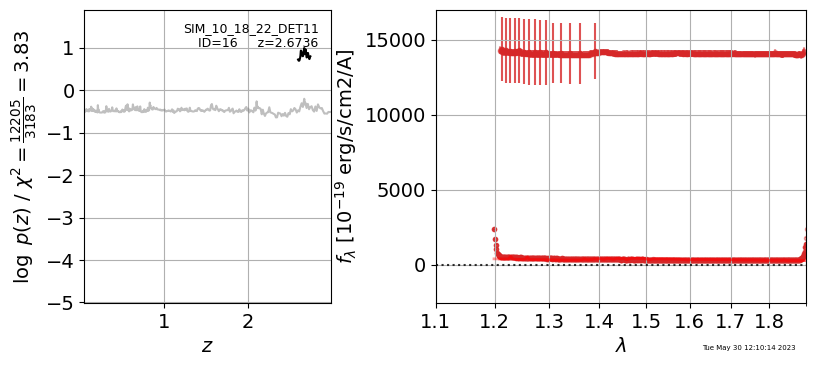

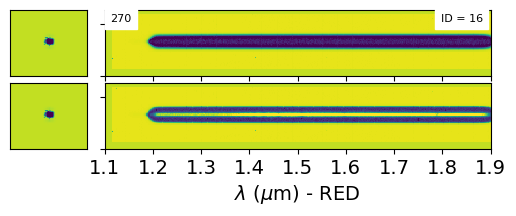

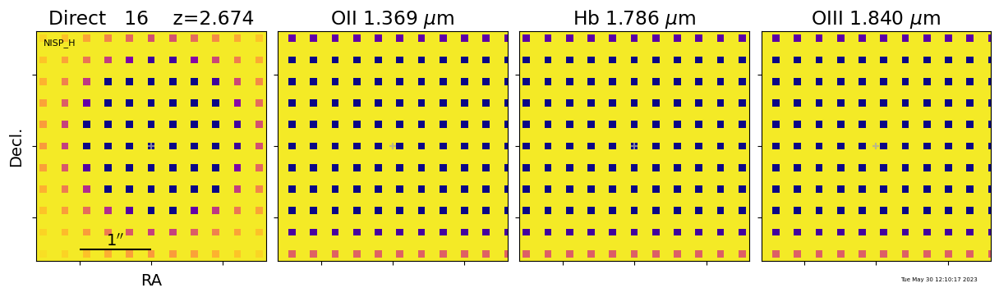

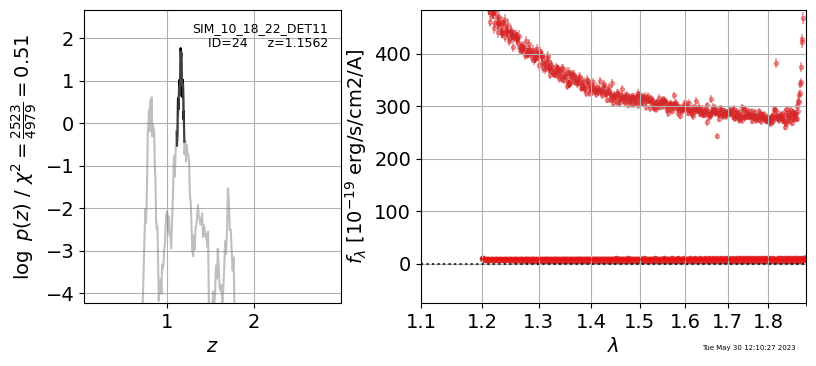

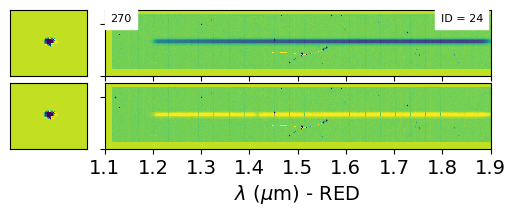

...

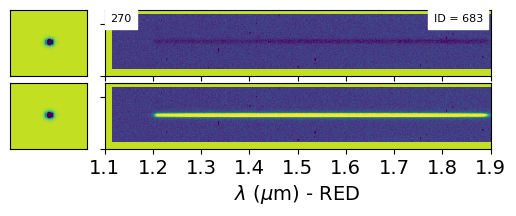

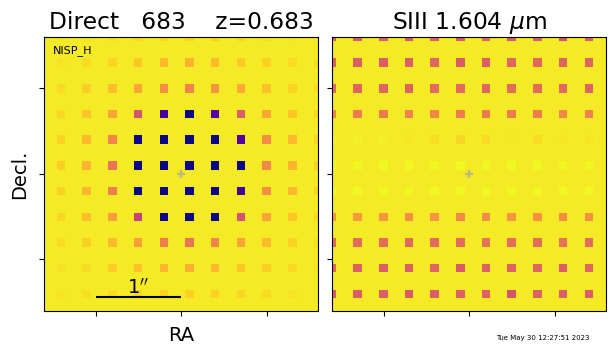

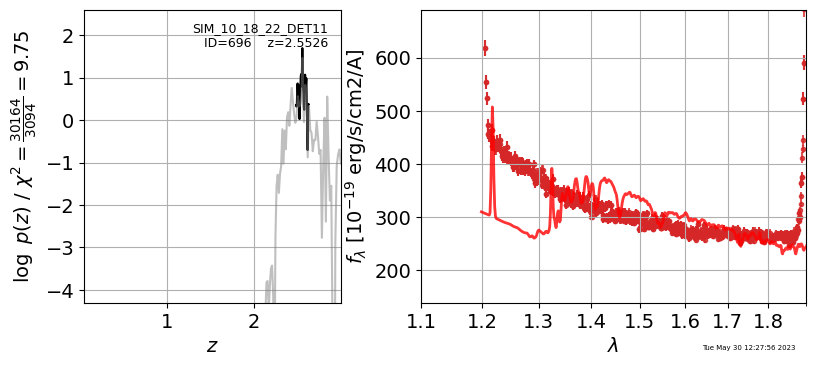

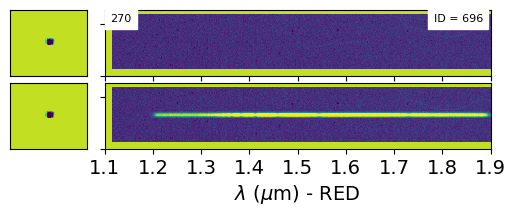

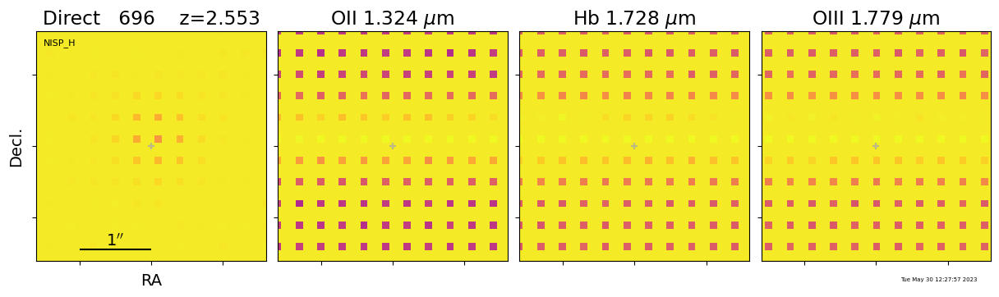

In [74]:
T0 = time.time()

os.chdir(os.path.join(HOME_PATH, root, 'Extractions'))

#fwhm = 395 # km/s
fwhm = 400 # km/s

#t0 = utils.load_templates(fwhm=fwhm, line_complexes=True, fsps_templates=True) # redshift fits, fixed line ratios
#t1 = utils.load_templates(fwhm=fwhm, line_complexes=False, fsps_templates=True) # final fits

# Fitting templates

# First is set with combined emission line complexes for the redshift fit 
# (don't allow infinite freedom) of the line ratios / fluxes
temp0 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=True, stars=False, 
                                     full_line_list=None,  continuum_list=None, 
                                     fsps_templates=True)

# Second set has individual line templates for fitting the line fluxes
temp1 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=False, stars=False, 
                                     full_line_list=None, continuum_list=None, 
                                     fsps_templates=True)

#print(temp0)
#print(len(temp0))
#print(temp1)
#print(len(temp1))

for i,Nl in enumerate(all_Nl):
    
    print("Fitting redshifts for %s" % (all_det[i]))
    euclid = all_euclid[i]
    
    group_name = root + "_" + all_det[i]
    
    t0 = time.time()
    
    if not os.path.exists(all_det[i]):
        os.mkdir(all_det[i])    
    os.chdir(all_det[i])

    for j,id in enumerate(Nl):

        print("id =",id)
        print("%i of %i" % (j+1,len(Nl)))
    
        #beams = OrderedDict()

        is_cgs, spectrum_1d, b = euclid.object_dispersers[id]
        cutout = grizli.model.BeamCutout(euclid, b['A'], min_sens=0,) # min_mask=0) 

        cutout.beam.compute_model()  
        cutout.contam = cutout.beam.cutout_from_full_image(euclid.model)
        if id in euclid.object_dispersers:
            cutout.contam -= cutout.beam.model

        hdu = cutout.write_fits(get_hdu=True)
        ext = 0
        hdu[ext].header['EXPTIME'] = hdu['SCI'].header['EXPTIME']

        beam = 'beam_%05d.grism.A.fits' % (id)
        hdu.writeto(beam,overwrite=True)

        mb = multifit.MultiBeam([beam], fcontam=0.2, group_name=group_name, psf=False, min_sens=0.05)
        mb.write_master_fits()
    
        # kludge
        os.remove(beam)
        ###########################
        
        fitting.run_all(id, temp0, temp1, fit_only_beams=True, fwhm=fwhm, zr=[0.05, 3.0], 
                        dz=[0.004, 0.0002], fitter=['nnls', 'bounded'], group_name=group_name)
    

    os.chdir("..")
    
    t1 = time.time()
    print()
    print("Finished %s in %.1f seconds" % (all_det[i],t1-t0))
    print()
    
    
T1 = time.time()

print()
print("Finished in %.1f seconds" % (T1-T0))

In [ ]:
print(os.getcwd())

In [ ]:
os.chdir(os.path.join(HOME_PATH, root, 'Extractions'))

In [ ]:
#id = 29
#det = 11

full = "DET%i/%s_DET%i_%05d.full.fits" % (det,root,det,id)
row = "DET%i/%s_DET%i_%05d.row.fits" % (det,root,det,id)
oned = "DET%i/%s_DET%i_%05d.1D.fits" % (det,root,det,id)


hdu = pyfits.open(full)
hdu.info()
head = hdu[0].header
ra = head["RA"]
dec = head["DEC"]
print(ra,dec)

hdu = pyfits.open(row)
hdu.info()
#hdu[0].header

hdu = pyfits.open(oned)
hdu.info()
hdu[0].header

In [ ]:
prefix = '{0}_DET{1}_{2:05d}'.format(root,det,id)
#display_grizli(prefix, path="DET%i" % (det), dispersers=["RED"], 
#               w0=1.18, w1=1.92)
display_grizli(prefix, path="DET%i" % (det), dispersers=["RED"], 
               w0=1.18, w1=1.92, ) #norm=1e-19)


In [ ]:
#print(primer)
print(primer.colnames)
#print([col for col in primer.colnames if "TU_" in col])
#bands = [col for col in primer.colnames if "_MAG" in col]
bands = [col for col in primer.colnames if "TU_" in col]


Euclid_bands = ['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG']
print(ra,dec)

dr = np.sqrt((primer['RA']-ra)**2*np.cos(dec/180*np.pi)**2 + 
             (primer['DEC']-dec)**2)*3600.

ind = np.argmin(dr)
source_id = primer['SOURCE_ID'][ind]
obj_mag = primer['TU_FNU_H_NISP_MAG'][ind]
print('SOURCE_ID:%d, H_mag=%.2f, dr=%.2f"' % (source_id, obj_mag, np.min(dr)))
print(primer['Z_OBS'][ind])
fnu = primer['TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 'TU_FNU_H_NISP_MAG'][ind]

fnu = np.array(list(fnu))
#print(dir(fnu))
#print(primer[bands][ind])
print(fnu)

Jy = 1e-23 # erg/s/cm^2/Hz

m = -2.5*np.log10(fnu*Jy)-48.60
print(m)

primer_small = primer['SOURCE_ID','RA','DEC','TU_FNU_VIS_MAG', 'TU_FNU_Y_NISP_MAG', 'TU_FNU_J_NISP_MAG', 
                      'TU_FNU_H_NISP_MAG']

tbl = Table(rows=primer_small[ind])
#print(tbl.colnames)
print(tbl)
print()

# rename columns
tbl.rename_column("SOURCE_ID","id")   
tbl.rename_column("RA","ra")   
tbl.rename_column("DEC","dec")   

for col in tbl.colnames:
    if "TU_FNU_" in col:
        print(col)
        new_col = col.replace("TU_FNU_","").replace("_MAG","_FLUX")
        print(new_col)
        tbl.rename_column(col,new_col)    
print()
    
# adjust flux and add errors
for col in tbl.colnames:
    if "_FLUX" in col:
        print(col)
        tbl[col] /= 1e-6
        #row[col]
        new_col = col + "ERR"
        tbl[new_col] = 0.5

tbl["z_spec"] = -1.0
        
#print(tbl)

euclid_phot_file = "Euclid_phot.fits"
tbl.write(euclid_phot_file, overwrite=True)            
tbl.show_in_notebook()

In [ ]:
# Requires eazy-py:  https://github.com/gbrammer/eazy-py
import eazy
print('\n Eazy-py version: ', eazy.__version__)

In [ ]:
# Preparation for eazy-py
eazy.symlink_eazy_inputs()

In [ ]:
### Initialize **eazy.photoz** object

params = {}

translate_file = 'Euclid_phot.translate'
params['CATALOG_FILE'] = 'Euclid_phot.fits'
params['MAIN_OUTPUT_FILE'] = 'Euclid_phot.eazypy'
params['TEMPLATES_FILE'] = 'templates/fsps_full/tweak_fsps_QSF_12_v3.param'

# Galactic extinction
params['MW_EBV'] = 0.0
params['Z_STEP'] = 0.002
params['Z_MAX'] = 3.
params['FIX_ZSPEC']='n'
#params['PRIOR_FILTER'] = 205

ez = eazy.photoz.PhotoZ(param_file=None, translate_file=translate_file, 
                        zeropoint_file=None, params=params, 
                        load_prior=True, load_products=False)

In [ ]:
from grizli.pipeline import photoz
## Grism fitting arguments created in Grizli-Pipeline
#args = np.load('fit_args.npy', allow_pickle=True)[0]

## First-pass redshift templates, similar to the eazy templates but 
## with separate emission lines
#t0 = args['t0'] # read earlier

#############
## Make a helper object for generating photometry in a format that grizli 
## understands. 

## Passing the parameters precomputes a function to quickly interpolate
## the templates through the broad-band filters.  It's not required, 
## but makes the fitting much faster.
## 
## `zgrid` defaults to ez.zgrid, be explicit here to show you can 
## change it. 
print(ez.zgrid)

phot_obj = photoz.EazyPhot(ez, grizli_templates=temp0, zgrid=ez.zgrid) 

In [ ]:
ez.fit_parallel(n_proc=4)
ez.error_residuals()

print('Get physical parameters')
ez.standard_output()

In [ ]:
# Show SEDs with best-fit templates and p(z)
ez.show_fit(0, id_is_idx=True)

In [ ]:
### Spline templates for dummy grism continuum fits
wspline = np.arange(4200, 2.5e4)
Rspline = 50
df_spl = len(utils.log_zgrid(zr=[wspline[0], wspline[-1]], dz=1./Rspline))
tspline = utils.bspline_templates(wspline, df=df_spl+2, log=True, clip=0.0001)

In [ ]:
print(source_id) # primer
print(id)        # sims.catalog

catalog = all_euclid[0].catalog["NUMBER"]
idx = list(catalog).index(id)
print(idx)
#print(list(catalog[indices]))
#print(all_euclid[0].catalog[indices])

In [ ]:
## This isn't necessary for general fitting, but 
## load the grism spectrum here for demonstrating the grism/photometry scaling
group_name = root + "_DET%i" % (det)
beams_file = "%s_DET%i_%05d.beams.fits" % (root,det,id)
mb = multifit.MultiBeam(beams_file, fcontam=0.2, group_name=group_name)

In [ ]:
# Generate the `phot` dictionary
phot, ii, dd = phot_obj.get_phot_dict(mb.ra, mb.dec)
label = "Euclid Catalog ID: {0}, dr={1:.2f}, zphot={2:.3f}"
print(label.format(ez.cat['id'][ii], dd, ez.zbest[ii]))

print('\n`phot` keys:', list(phot.keys()))
for k in phot:
    print('\n'+k+':\n', phot[k])
    
# Initialize photometry for the MultiBeam object
mb.set_photometry(**phot)

In [ ]:
# parametric template fit to get reasonable background
sfit = mb.template_at_z(templates=tspline, fit_background=True, 
                        include_photometry=False)
fig = mb.oned_figure(tfit=sfit)

ax = fig.axes[0]
ax.errorbar(mb.photom_pivot/1.e4, mb.photom_flam/1.e-19, 
            mb.photom_eflam/1.e-19, 
            marker='s', color='k', alpha=0.4, linestyle='None',
            label='Euclid photometry')

ax.legend(loc='upper left', fontsize=8)

ax.set_ylim(0,100)
ax.set_xlim(0.6,1.9)

print(mb.photom_pivot/1.e4)
print(mb.photom_flam/1.e-19)

In [ ]:
## First example:  no rescaling
z_phot = ez.zbest[0]

# Reset scale parameter
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')
    
#t1 = args['t1']
tfit = mb.template_at_z(z=z_phot)
print('No rescaling, chi-squared={0:.1f}'.format(tfit['chi2']))
fig = fitting.full_sed_plot(mb, tfit, zfit=None, bin=4)

In [ ]:
# Reset scale parameter
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')

# Template rescaling, simple multiplicative factor
scl = mb.scale_to_photometry(order=0)

# has funny units of polynomial coefficients times 10**power, 
# see `grizli.fitting.GroupFitter.compute_scale_array`
# Scale value is the inverse, so, e.g., 
# scl.x = [8.89] means scale the grism spectrum by 10/8.89=1.12
print(scl.x) 

mb.pscale = scl.x 

# Redo template fit
tfit = mb.template_at_z(z=z_phot)
print(z_phot)
print('Simple scaling, chi-squared={0:.1f}'.format(tfit['chi2']))
fig = fitting.full_sed_plot(mb, tfit, zfit=None, bin=4)

In [ ]:
# Reset scale parameter
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')
    mb.compute_model()

# Template rescaling, linear fit
scl = mb.scale_to_photometry(order=0)

# has funny units of polynomial coefficients times 10**power, 
# see `grizli.fitting.GroupFitter.compute_scale_array`
# Scale value is the inverse, so, e.g., 
# scl.x = [8.89] means scale the grism spectrum by 10/8.89=1.12
print(scl.x) 

mb.pscale = scl.x 

# Redo template fit
tfit = mb.template_at_z(z=z_phot)
print('Simple scaling, chi-squared={0:.1f}'.format(tfit['chi2']))
fig = fitting.full_sed_plot(mb, tfit, zfit=None, bin=4)

In [ ]:
if hasattr(mb,'pscale'):
    delattr(mb, 'pscale')
    mb.compute_model()

# Now run the full redshift fit script with the photometry, which will also do the scaling
order=0
#fitting.run_all_parallel(id, phot=phot, verbose=False, 
#                         scale_photometry=order+1, zr=[0.05, 3.0])

fitting.run_all(id, temp0, temp1, phot=phot, scale_photometry=order+1, fit_only_beams=True, fwhm=fwhm, 
                zr=[0.05, 3.0], dz=[0.008, 0.0004], fitter=['nnls', 'bounded'], group_name=group_name)

#fitting.run_all(id, temp0, temp1, fit_only_beams=True, fwhm=fwhm, zr=[0.05, 3.0], 
#                        dz=[0.004, 0.0002], fitter=['nnls', 'bounded'], group_name=group_name)
    


In [ ]:
zfit = pyfits.open('{0}_DET{1}_{2:05d}.full.fits'.format(root, det, id))
z_grism = zfit['ZFIT_STACK'].header['Z_MAP']
print('Best redshift: {0:.4f}'.format(z_grism))

# Compare PDFs
pztab = utils.GTable.gread(zfit['ZFIT_STACK'])
plt.plot(pztab['zgrid'], pztab['pdf'], label='grism+Euclid')

plt.plot(ez.zgrid, np.exp(ez.lnp[0,:]), label='photo-z')

plt.semilogy()
plt.xlim(z_grism-0.05, z_grism+0.05); plt.ylim(1.e-10, 1000)
plt.xlabel(r'$z$'); plt.ylabel(r'$p(z)$')
plt.grid()
plt.legend()

## Extract a single 2D spectrum 
Science, model and contamination based on RA and Dec

[top](#Table-of-Contents)

In [ ]:
det_ind = 0 # DET11
Euclid = all_euclid[det_ind]
phot = all_phot[det_ind]

## Find the object ID near coordinates (r0,d0), 
## SExtractor IDs might not be constant across platforms

#r0,d0 = 228.6882041, 6.2969624 # cont src
#r0,d0 = 228.6882147, 6.3239512 #  emission line src
#r0,d0 = 228.6881854, 6.3209442
#r0,d0 = 228.6882128, 6.3028898 
#r0,d0 = 228.6881973, 6.3179116 
r0,d0 = 228.6881976, 6.3149738 


dr = np.sqrt((phot['X_WORLD']-r0)**2*np.cos(d0/180*np.pi)**2 + 
             (phot['Y_WORLD']-d0)**2)*3600.
id = phot['NUMBER'][np.argmin(dr)]
obj_mag = phot['MAG_AUTO'][np.argmin(dr)]
print('ID:%d, mag=%.2f, dr=%.2f"' %(id, obj_mag, np.min(dr)))

beams = OrderedDict()

ix = Euclid.catalog['id'] == id
x0, y0 = Euclid.catalog['x_flt'][ix][0], Euclid.catalog['y_flt'][ix][0]
print(Euclid.direct.instrument, x0, y0)
#print(Roman.wcs.pscale)
#dim = 18*0.135/sim.flt_wcs.pscale 
#beam = grizli.model.BeamCutout(id=id, x=x0, y=y0, 
#                               cutout_dimensions=np.cast[int]((dim, dim)), 
#                               conf=sim.conf, GrismFLT=sim)

print(Euclid.object_dispersers[id])

is_cgs, spectrum_1d, b = Euclid.object_dispersers[id]
#print(b)

cutout = grizli.model.BeamCutout(Euclid, b['A'], min_sens=0,) # min_mask=0) 

cutout.beam.compute_model()  
cutout.contam = cutout.beam.cutout_from_full_image(Euclid.model)
if id in Euclid.object_dispersers:
    cutout.contam -= cutout.beam.model

print(dir(cutout.beam))
#print(cutout.contam)
#print(cutout.beam.model)
#print(dir(cutout.beam))
print(cutout.beam.seg)
print(cutout.beam.seg.shape)

img = cutout.grism.data['SCI']*1
X = img.flatten()
std = np.std(X)
med = np.median(X)

sig = 1.
vmin = med-sig*std
vmax = med+sig*std

fig = plt.figure()
p1 = fig.add_subplot(111)
p1.imshow(cutout.grism.data['SCI']*1, origin='lower',cmap='gray_r',vmin=vmin,vmax=vmax)
p1.set_xlabel("X [pixels]")
p1.set_ylabel("Y [pixels]")

#p1.imshow(cutout.grism.data['ERR']*1)#,vmin=-0.1,vmax=0.1, origin='lower',cmap='gray_r')
    
beams[Euclid.grism.instrument] = cutout

cutout.write_fits() # still learning about the output

## 1D Spectral Extraction
[top](#Table-of-Contents)

In [ ]:
from scipy import integrate

### Plot 1D spectra
fig = plt.figure(figsize=(10,6))
p1 = fig.add_subplot(111)
key = "NISP-GLWv1"
w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], bin=0)
#w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
#                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)


#sf = f/np.nanmax(f)
sf = f
std = np.nanstd(sf)
med = np.nanmedian(sf)

sig = 2.
y0 = med-sig*std
y1 = med+sig*std

p1.text(0.05,0.9,"ID = %i" % (id),transform=p1.transAxes)
p1.plot(w/1.e4, sf, c="k") # linestyle='steps-mid')

#p1.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
p1.set_ylabel("Flux [Arbitrary]")
p1.set_xlabel("Wavelength [um]")

p1.set_ylim(y0,y1)

## Display Redshift Fit
[top](#Table-of-Contents)

In [ ]:
det_ind = 0
os.chdir(os.path.join(HOME_PATH, root, 'Extractions',all_det[det_ind]))
group_name = root + "_" + all_det[det_ind]

In [ ]:
display_grizli(group_name, id, w0=1.15, w1=1.95, labels=1)

In [ ]:
#########################
# copy sextractor files #
#########################

# cd ~/data/Roman/grizli/my_roman_sims/Prep

# rsync -avz Roman.param cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/sims/sim_v2/Prep
# rsync -avz Roman.sex   cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/sims/sim_v2/Prep
# rsync -avz default.nnw cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/sims/sim_v2/Prep

In [ ]:
##############################
# compare branch differences #
##############################

# git diff roman_sims_v1_gwalth..master -- *.py

# cd ~/python/grizli_1.3.2/grizli

# rsync -avz grismconf.py cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli
# rsync -avz model.py     cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli
# rsync -avz multifit.py  cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli
# rsync -avz utils.py     cygnusc.ipac.caltech.edu:/home/gwalth/python/src/grizli/grizli


In [ ]:
#########################
# copy grism conf files #
#########################

# cd ~/data/Roman/grizli/grizli/CONF

# rsync -avz Roman.G150-v?-GLW.conf cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/grizli/CONF
# rsync -avz sens_0720_2020.fits    cygnusc.ipac.caltech.edu:/home/gwalth/data/Roman/grizli/grizli/CONF

# Appendix - Old

## aXeSIM predictions based on conf file
[top](#Table-of-Contents)

In [ ]:
os.chdir(os.path.join(HOME_PATH, root, 'Prep'))

In [ ]:
from grizli import grismconf

In [ ]:
# This one gives the error
import os
os.chdir("/Users/gwalth/data/Roman/grizli/grizli/CONF")
conf = grismconf.load_grism_config("./Euclid.Gred.0.conf")

# This one works!
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman.det1.07242020.conf")
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman_bad/Roman.det1.07242020.conf")

dx = conf.dxlam["A"]
print(dx)
x0,y0 = 1024,1024

dy,lam = conf.get_beam_trace(x=x0,y=y0,dx=dx)
print(dy)
print(lam)

In [ ]:
conf.show_beams()

In [ ]:
# This one gives the error
import os
os.chdir("/Users/gwalth/data/Roman/grizli/grizli/CONF/CONF11")
conf = grismconf.load_grism_config("./NISP_RGS000_21.conf")
#conf = grismconf.load_grism_config("./NISP_RGS000_21.conf.beamA")

# This one works!
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman.det1.07242020.conf")
#conf = grismconf.load_grism_config("../../../grizli/CONF/Roman_bad/Roman.det1.07242020.conf")

dx = conf.dxlam["A"]
print(dx)
x0,y0 = 1024,1024

dy,lam = conf.get_beam_trace(x=x0,y=y0,dx=dx)
print(dy)
print(lam)

In [ ]:
conf.show_beams()

In [ ]:
print(os.getcwd())

## Show 2D beam
[top](#Table-of-Contents)

In [ ]:
## Spectrum with lines & noise
#spectrum_file = os.path.join(os.path.dirname(grizli.__file__), 'data/erb2010.dat')
#spectrum_file = '../../../grizli/templates/erb2010.dat'
#erb = np.loadtxt(spectrum_file, unpack=True)
#z = 2.0 # test redshift

## normalize spectrum to unity to use normalization defined in the direct image
#import pysynphot as S
#spec = S.ArraySpectrum(erb[0], erb[1], fluxunits='flam')
#spec = spec.redshift(z).renorm(1., 'flam', S.ObsBandpass('wfc3,ir,f140w'))
#spec.convert('flam') # bug in pysynphot, now units being converted automatically above? (11/10/16)

fig = plt.figure(figsize=(14,4))
for i, key in enumerate(beams.keys()):
    #     beams[key].compute_model(beams[key].thumb, id=beams[key].id, 
    #                              xspec=spec.wave, yspec=spec.flux)
    #print(key)
    #beams[key].beam.compute_model(spectrum_1d=[spec.wave, spec.flux]) 
    #beams[key].beam.compute_model()
    
    gdata = beams[key].grism.data['SCI']*1
    gmodel = beams[key].model
    gcontam = beams[key].contam
    
    print(gdata)
    print(gmodel)
    print(gcontam)
    
    print(np.min(gdata),np.max(gdata))
    print(np.min(gmodel),np.max(gmodel))
    print(np.min(gcontam),np.max(gcontam))
    
    print(gdata.shape)
    print(gmodel.shape)
    print(gcontam.shape)
    
    axl = fig.add_subplot(321+i*2)
    #axl.imshow(beams[key].model + beams[key].grism.data['SCI']*1, interpolation='Nearest', 
    #       origin='lower', vmin=-0.006, vmax=0.16, cmap='gray_r', aspect='auto')
    
    axl.imshow(beams[key].grism.data['SCI']*1, interpolation='Nearest', 
           origin='lower', vmin=-0.1,vmax=0.1, cmap='gray_r', aspect='auto')
    
    
    axr = fig.add_subplot(321+i*2+1)
    #axr.imshow(beams[key].contam + beams[key].grism.data['SCI'] + beams[key].model, 
    #           interpolation='Nearest', 
    #           origin='lower', vmin=-1, vmax=2, cmap='gray_r', aspect='auto')

    axr.imshow(beams[key].contam , 
               interpolation='Nearest', 
               origin='lower', vmin=-0.1,vmax=0.1, cmap='gray_r', aspect='auto')
    
    #axl.set_title('%s - %s' %(key, beams[key].grism.filter))
    #for ax in [axl, axr]:
    #    beams[key].beam.twod_axis_labels(wscale=1.e4, mpl_axis=ax)
    #    beams[key].beam.twod_xlim(1.3,1.75, wscale=1.e4, mpl_axis=ax)
    #    if i < 2:
    #        ax.set_xticklabels([])
    #    else:
    #        ax.set_xlabel(r'$\lambda$')

fig.tight_layout(pad=0.5)

In [ ]:
def ab2flux(mab,eff_wav):
    c = 2.9979E10 # cm/s
    Ang = 1E-8    # cm
    Jy = 1E-23    # erg/s/cm^2/Hz
    
    # mab = -2.5*np.log10(fnu) - 48.6 
    fnu = 10**(-0.4*(mab + 48.6))          # erg/s/cm^2/Hz
    flambda = fnu*(c/(eff_wav*Ang)**2)*Ang # erg/s/cm^2/Ang
   
    #print("%.2f AB" % (mab))
    #print("%.2e erg/s/cm^2/Hz" % (fnu))
    #print("%.2e Jy" % (fnu/Jy))
    #print("%.4f uJy" % (fnu/(1e-6*Jy)))
    #print("%.1f nJy" % (fnu/(1e-9*Jy)))
    #print()
    #print("%.2e erg/s/cm^2/Ang" % (flambda))
    #print()
    
    return flambda

In [ ]:
# determine flux in Ang for the source in the direct image

mab = phot[phot['NUMBER']==id]['MAG_AUTO'][0]

f_scale = ab2flux(mab,15800.)

## Simple SN calculations based on the spcontetc
[top](#Table-of-Contents)

In [ ]:
# Per pix S/N=1
mag_per_pix_w0 = 21.9       # 1.00 um
mag_per_pix_w1 = 21.9       # 1.93 um
mag_per_pix_deepest = 22.7  # 1.34 um

In [ ]:
ab2flux(mag_per_pix_w0,10000.)
ab2flux(mag_per_pix_deepest,13400.)

In [ ]:
print(os.getcwd())
spcontetc_1n = Table.read("../etc/spcontetc_1n_0.2.dat",format="ascii")
spcontetc_8n = Table.read("../etc/spcontetc_8n_0.2.dat",format="ascii")
#spcontetc_1n = Table.read("../etc/spcontetc_1n_0.5.dat",format="ascii")
#spcontetc_8n = Table.read("../etc/spcontetc_8n_0.5.dat",format="ascii")
print(spcontetc_1n)

#|  um  | arcsec |      |exp per Jy|per pix |per resl|1e4 km/s|
fig = plt.figure()
p = fig.add_subplot(111)
#for n in range(5,8):
for n in range(5,7):
    #p.plot(spcontetc_1n['col1'],spcontetc_1n['col%i' % (n)]) # AB
    #p.plot(spcontetc_8n['col1'],spcontetc_8n['col%i' % (n)]) # AB
    
    f1 = ab2flux(spcontetc_1n['col%i' % (n)],spcontetc_1n['col1']*1e4)
    f8 = ab2flux(spcontetc_8n['col%i' % (n)],spcontetc_8n['col1']*1e4)
    
    p.plot(spcontetc_1n['col1'],f1)  
    #p.plot(spcontetc_8n['col1'],f8) 

    

#p.set_ylim(0e-18,2e-18)
p.set_xlabel(r'$\lambda$ [micron]')
p.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$ Ang$^{-1}$]')
#p.set_ylabel(r'Mag [AB]')

#p.invert_yaxis()
    
plt.show()

Roughly estimated from spcontetc (>1.4 micron):

<span style="color:red">5 sigma limit = 1.75e-18 erg/s/cm^2/Ang</span>

<span style="color:red">1 sigma limit = 1.00e-18 erg/s/cm^2/Ang</span>


## Simple SN calculations based on the pzcaletc
[top](#Table-of-Contents)

In [ ]:
print(os.getcwd())
pzcaletc_1n = Table.read("../etc/pzcaletc_1n.dat",format="ascii")
pzcaletc_8n = Table.read("../etc/pzcaletc_8n.dat",format="ascii")
print(pzcaletc_1n)

fig = plt.figure()
p = fig.add_subplot(111)
#for n in range(2,13):
for n in range(2,3):
    #p.plot(pzcaletc_1n['col1'],pzcaletc_1n['col%i' % (n)]) # W/m^2
    p.plot(pzcaletc_1n['col1'],pzcaletc_1n['col%i' % (n)]*1000.) # erg/s/cm^2
    p.plot(pzcaletc_8n['col1'],pzcaletc_8n['col%i' % (n)]*1000.) # erg/s/cm^2

    
#p.legend(fontsize=14)
#p.set_xlim(w1-0.05, w2+0.05)
#p.set_ylim(-1e-21,3e-20)
p.set_xlabel(r'$\lambda$ [micron]')
p.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$]')
    
plt.show()

## Simple SN calculations based on the apttables2021
[top](#Table-of-Contents)

In [ ]:
print(os.getcwd())
apt_rad0_0_zod1_2 = Table.read("../apttables2021/grism/spec_half-light-rad0.0_zod1.2.dat",format="ascii",
                               names=('AB','1.05','1.20','1.40','1.60','1.80','2.00'))
apt_rad0_2_zod1_2 = Table.read("../apttables2021/grism/spec_half-light-rad0.2_zod1.2.dat",format="ascii",
                               names=('AB','1.05','1.20','1.40','1.60','1.80','2.00'))
apt_rad0_3_zod1_2 = Table.read("../apttables2021/grism/spec_half-light-rad0.3_zod1.2.dat",format="ascii",
                               names=('AB','1.05','1.20','1.40','1.60','1.80','2.00'))
#print(apt_rad0_0_zod1_2)
#print(apt_rad0_2_zod1_2)
#print(apt_rad0_3_zod1_2)

fig = plt.figure()
p = fig.add_subplot(111)

wlist = ['1.05','1.20','1.40','1.60','1.80','2.00']

#for w in wlist:
#    p.plot(apt_rad0_0_zod1_2[w],apt_rad0_0_zod1_2['AB'],label=w) 

p.scatter(apt_rad0_0_zod1_2['1.20'],apt_rad0_0_zod1_2['AB'],label='half-light radius 0.0')
p.scatter(apt_rad0_2_zod1_2['1.20'],apt_rad0_0_zod1_2['AB'],label='half-light radius 0.2')
p.scatter(apt_rad0_3_zod1_2['1.20'],apt_rad0_0_zod1_2['AB'],label='half-light radius 0.3')
    
p.legend(fontsize=14)
p.set_xscale("log")

#p.set_xlim(0,2000)
#p.set_ylim(20,22)
    
plt.show()

In [ ]:
##############
# My crude ETC
# based on 
# https://roman.gsfc.nasa.gov/science/apttables2021/table-grism.html
##############

# notes:
# might need a fit cutoff to t = 1e7 

from scipy.optimize import leastsq

t = 301.

param = [1,0]
err = 1.0

# y = ax + b
line_fn = lambda p,x: p[1]*x+p[0]

err_fn = lambda p: (line_fn(p,x) - y)/err

wlist = ['1.05','1.20','1.40','1.60','1.80','2.00'] # microns

mag_ab_5sig = []

fig = plt.figure()
p = fig.add_subplot(111)

#x = np.log10(apt_rad0_0_zod1_2['1.20'])
y = apt_rad0_2_zod1_2['AB']
for w in wlist:
    print(w)
    x = np.log10(apt_rad0_2_zod1_2[w])

    sol = leastsq(err_fn,param,full_output=1)
    print(sol[0])

    mag_ab = line_fn(sol[0],np.log10(t))
    print(mag_ab)
    mag_ab_5sig.append(mag_ab)
    print()

    logt = np.arange(2.0,8.6,0.1)
    mag = line_fn(sol[0],logt)
    

    p.plot(10**logt,mag,c="k")
    p.scatter(10**x,y,label=w,s=50,alpha=0.7)
    
p.legend(fontsize=14)
p.set_xscale("log")

p.set_xlim(400,2.5e8)
p.set_ylim(20.8,27.2)

p.invert_yaxis()
plt.show()

In [ ]:
fig = plt.figure(figsize=(10,4))
p1 = fig.add_subplot(121)

warr = 1e4*np.array([float(w0) for w0 in wlist]) # Angstroms


mag_ab_5sig = np.array(mag_ab_5sig)

p1.plot(warr,mag_ab_5sig)
p1.set_xlabel(r'$\lambda$ [Ang]')
p1.set_ylabel(r'mag [AB]')
p1.invert_yaxis()


#p.set_xlim(0,2000)
#p.set_ylim(20,22)
p2 = fig.add_subplot(122)

#flux_5sig = [ab2flux(mag_ab_5sig[i],w0) for i,w0 in enumerate(warr)]
flux_5sig = ab2flux(mag_ab_5sig,warr) 
p2.plot(warr,flux_5sig)

p2.set_xlabel(r'$\lambda$ [Ang]')
p2.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$ Ang$^{-1}$]')
    
plt.show()

Comparison between spcontetc and apttables2021

In [ ]:
print(os.getcwd())
spcontetc_1n = Table.read("../etc/spcontetc_1n_0.2.dat",format="ascii")
spcontetc_8n = Table.read("../etc/spcontetc_8n_0.2.dat",format="ascii")
#spcontetc_1n = Table.read("../etc/spcontetc_1n_0.5.dat",format="ascii")
#spcontetc_8n = Table.read("../etc/spcontetc_8n_0.5.dat",format="ascii")
print(spcontetc_1n)

fig = plt.figure()
p = fig.add_subplot(111)
#for n in range(5,8):
for n in range(5,7):
    #p.plot(spcontetc_1n['col1'],spcontetc_1n['col%i' % (n)]) # AB
    #p.plot(spcontetc_8n['col1'],spcontetc_8n['col%i' % (n)]) # AB
    
    f1 = ab2flux(spcontetc_1n['col%i' % (n)],spcontetc_1n['col1']*1e4)
    f8 = ab2flux(spcontetc_8n['col%i' % (n)],spcontetc_8n['col1']*1e4)
    
    p.plot(spcontetc_1n['col1'],f1,label='spcontetc 0.2"')  
    #p.plot(spcontetc_8n['col1'],f8) 


p.plot(warr/1e4,flux_5sig,label="apttables2021")

#p.set_ylim(0e-18,2e-18)
p.set_xlabel(r'$\lambda$ [micron]')
p.set_ylabel(r'Flux [erg s$^{-1}$ cm$^{-2}$ Ang$^{-1}$]')
#p.set_ylabel(r'Mag [AB]')

#p.invert_yaxis()
p.legend()
    
plt.show()

In [ ]:
def poly_n(p, x):
    p = np.array(p)
    y = np.zeros((x.shape[0],))
    for n in np.arange(p.shape[0]):
        y += p[n]*x**n
    return y

def solve_for_y(poly_coeffs, y):
    pc = poly_coeffs.copy()
    print(pc)
    pc[0] -= y
    print(pc)
    return np.roots(pc)


print(os.getcwd())
apt_SN_55sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_55sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_75sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_75sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_100sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_100sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))


img_table = Table()
img_table['AB'] = apt_SN_55sec_zod1_2['AB']
img_table['55'] = apt_SN_55sec_zod1_2['F158']
img_table['75'] = apt_SN_75sec_zod1_2['F158']
img_table['100'] = apt_SN_100sec_zod1_2['F158']


#print(img_table)

t = 141

# SNR ~ t^(0.5)
# time
x = np.sqrt(np.array([55.,75.,100.]))
param = [1, 0]
err = 1.0

line_fn = lambda p,x: p[1]*x+p[0]

err_fn = lambda p: (line_fn(p,x) - y)/err

fig = plt.figure()
p = fig.add_subplot(111)

SN = [] # at t

###################
# fit for SNR and t
###################
for i,y in enumerate(img_table['55','75','100']):

    # SNR
    y = np.array(list(y))
    
    sol = leastsq(err_fn,param,full_output=1)
    print(sol[0])
    
    t0 = np.arange(50,200,0.1)
    snr = line_fn(sol[0],np.sqrt(t0))
    
    mag = np.ones(snr.shape)*img_table['AB'][i]

    p.plot(mag,snr,c="k")
    
    SN.append(line_fn(sol[0],np.sqrt(t)))

img_table['141'] = SN



param = [1,1,1,1]
# mag
x = img_table['AB']
#print(x)
err = np.ones(x.shape)
#err[:5] = 0.01
#err[-5:] = 0.01

err_fn2 = lambda p: (poly_n(p,x) - y)/err
#####################
# fit for SNR and mag
#####################

dict = {}

for i,t0 in enumerate(['55','75','100','141']):
    
    # SNR
    y = 2.5*np.log10(img_table[t0])
    
    sol = leastsq(err_fn2,param,full_output=1)
    print(sol[0])
    
    mag = np.arange(16.5,26.5,0.1)
    snr = 10**(0.4*poly_n(sol[0],mag))
    
    p.plot(mag,snr,c="k")
    print(len(sol[0]))
    
    dict['sol%s' % t0] = sol[0]

#################
# solving for s/n
#################
print(dict)
sol0 = dict['sol141']
print(solve_for_y(sol0,2.5*np.log10(10.0)))


p.scatter(img_table['AB'],img_table['55'],label='55 sec')
p.scatter(img_table['AB'],img_table['75'],label='75 sec')
p.scatter(img_table['AB'],img_table['100'],label='100 sec')
p.scatter(img_table['AB'],SN,label='141 sec')


p.plot([17,27],[10,10],"-",c="k",alpha=0.5)
p.plot([17,27],[5,5],"--",c="k",alpha=0.5)
p.plot([17,27],[3,3],"-.",c="k",alpha=0.5)

p.legend(fontsize=14)
p.set_yscale("log")

#p.set_xlim(0,2000)
#p.set_ylim(20,22)
#p.invert_yaxis()
    
plt.show()

In [ ]:
print(os.getcwd())
apt_SN_55sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_55sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_75sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_75sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
apt_SN_100sec_zod1_2 = Table.read("../apttables2021/imaging/ap_phot_2pix_0.22rad_SN_100sec_zod1.2x.dat",format="ascii",
                               names=('AB','F062','F087','F106','F129','F158','F184','F146','F213'))
#print(apt_rad0_0_zod1_2)
#print(apt_rad0_2_zod1_2)
#print(apt_rad0_3_zod1_2)

fig = plt.figure()
p = fig.add_subplot(111)

flist = ['F062','F087','F106','F129','F158','F184','F146','F213']

#for f in flist:
#    p.scatter(apt_SN_55sec_zod1_2['AB'],apt_SN_55sec_zod1_2[f],label=f) 
    #p.scatter(apt_SN_75sec_zod1_2['AB'],apt_SN_75sec_zod1_2[f],label=f)
    #p.scatter(apt_SN_100sec_zod1_2['AB'],apt_SN_100sec_zod1_2[f],label=f) 

p.scatter(apt_SN_55sec_zod1_2['AB'],apt_SN_55sec_zod1_2['F158'],label='55 sec')
p.scatter(apt_SN_75sec_zod1_2['AB'],apt_SN_75sec_zod1_2['F158'],label='75 sec')
p.scatter(apt_SN_100sec_zod1_2['AB'],apt_SN_100sec_zod1_2['F158'],label='100 sec')


p.plot([17,27],[10,10],"-",c="k",alpha=0.5)
p.plot([17,27],[5,5],"--",c="k",alpha=0.5)
p.plot([17,27],[3,3],"-.",c="k",alpha=0.5)

p.legend(fontsize=14)
p.set_yscale("log")

#p.set_xlim(0,2000)
#p.set_ylim(20,22)
#p.invert_yaxis()
    
plt.show()

## Roman and Euclid Sensitivity Function

[top](#Table-of-Contents)

In [ ]:
import os
print(os.getcwd())
print(HOME_PATH)
#os.chdir(os.path.join(HOME_PATH, root, 'Extraction'))

### Gabe's Roman sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/Roman.G150.v1.6.sens.fits' # Gabe's
sens_cat1 = Table.read(sens_file)
print(sens_cat1.colnames)

### Anahita's Roman sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/sens_0720_2020.fits'
sens_cat2 = Table.read(sens_file)
print(sens_cat2.colnames)

### AstroDeep Euclid sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/Euclid.Gred.1st.sens.0.fits'
sens_cat3 = Table.read(sens_file)
print(sens_cat3.colnames)

### TIPS Euclid sensitivity function

In [ ]:
sens_file = HOME_PATH + '/../grizli/CONF/CONF11/SENS_A.fits'
sens_cat4 = Table.read(sens_file)
print(sens_cat4.colnames)

In [ ]:
fig = plt.figure()

p1 = fig.add_subplot(111)
#p1.errorbar(sens_cat1['WAVELENGTH'],sens_cat1['SENSITIVITY'],yerr=sens_cat1['ERROR'])
#p1.errorbar(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'],yerr=sens_cat2['ERROR'])
p1.plot(sens_cat1['WAVELENGTH'],sens_cat1['SENSITIVITY'],label="Roman (Pandeia)")
p1.plot(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'],label="Roman (Anahita's)")
p1.plot(sens_cat3['WAVELENGTH'],sens_cat3['SENSITIVITY'],label="Euclid (AstroDeep)")
p1.plot(sens_cat4['WAVELENGTH'],sens_cat4['SENSITIVITY'],label="Euclid (TIPS)")
#p1.plot(pzcaletc_1n['col1']*1e4,1./(pzcaletc_1n['col%i' % (n)]*1000.)) # erg/s/cm^2
#p1.plot(pzcaletc_8n['col1']*1e4,1./(pzcaletc_8n['col%i' % (n)]*1000.)) # erg/s/cm^2
p1.set_xlim(8750,20750)
p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
p1.legend()

In [ ]:
from scipy import integrate

### Plot 1D spectra
fig = plt.figure(figsize=(6,18))
p1 = fig.add_subplot(311)
p2 = fig.add_subplot(312)
p3 = fig.add_subplot(313)
for i, key in enumerate(beams.keys()):
    print(key)
    print()
    w, f, e = beams[key].beam.optimal_extract(beams[key].model+beams[key].grism.data['SCI'], bin=0)
    #w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
    #                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)
    
    # normalize to the magnitude in the direct image
    print("sum = %.2e" % (np.nansum(f)))
    print("mean = %.2e" % (np.nanmean(f)))
    print("median = %.2e" % (np.nanmedian(f)))
    print("std = %.2e" % (np.nanstd(f)))
    print("min = %.2e" % (np.nanmin(f)))
    print("max = %.2e" % (np.nanmax(f)))
    
    
    print("S/N = %.2f" % (np.nanmax(f)/np.sqrt(np.nansum(e**2))))
    print()
    #

    
    # Method 1
    scale = f_scale/np.nansum(f)
    f = f * scale
    e = e * scale
    # Method 2
    #f = (f/np.nanmedian(f)) * f_scale
    # Method 3
    #skysub = f - np.nanmedian(f)
    #f = (skysub/np.nansum(skysub)) * f_scale
    
    print("sum = %.2e" % (np.nansum(f)))
    print("mean = %.2e" % (np.nanmean(f)))
    print("median = %.2e" % (np.nanmedian(f)))
    print("std = %.2e" % (np.nanstd(f)))
    print("min = %.2e" % (np.nanmin(f)))
    print("max = %.2e" % (np.nanmax(f)))
    print("S/N = %.2f" % (np.nanmax(f)/np.sqrt(np.nansum(e**2))))
    print()
    
    
    percent = [1,25,50,75,95,99,99.9]
    for per in percent:
        print("P(%s) = %.2e" % (per,np.nanpercentile(f, per)))
    print()
        
    N = len(f)
        
    print("Chunk  W0  W1  Sum  Mean  Median  STD  Min  Max  S/N")
    
    #chunks = 50. # depends on the width of the line?
    chunks = 70.
    for chunk in np.arange(chunks):
        #print("Chunk = %i" % (chunk+1))
        f_sect = f[int(chunk*N/chunks):int((chunk+1)*N/chunks)]
        e_sect = e[int(chunk*N/chunks):int((chunk+1)*N/chunks)]
        w_sect = w[int(chunk*N/chunks):int((chunk+1)*N/chunks)]
        w_sect0 = w_sect[0]/1.e4
        w_sect1 = w_sect[-1]/1.e4
        
        print("%3i  %.3f  %.3f  %.2e  %.2e  %.2e  %.2e  %.2e  %.2e  %6.1f" % (chunk+1, w_sect0, w_sect1, np.nansum(f_sect), 
              np.nanmean(f_sect), np.nanmedian(f_sect), np.nanstd(f_sect), np.nanmin(f_sect), 
              np.nanmax(f_sect), np.nansum(f_sect)/np.sqrt(np.nansum(e_sect**2))))
        #print()
        
        
    #print("S/N =",np.nanmax(f)/np.nanstd(f))
    
    m_noi = np.nanmean(e)
    S_N = f/m_noi
    
    
    # plot spectrum
    p1.plot(w/1.e4, f, c="k") # linestyle='steps-mid')
    p1.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
    p1.plot([w[0]/1e4,w[-1]/1e4],[m_noi,m_noi], c="g")

    # plot line
    p2.plot(w/1.e4, f, c="k") # linestyle='steps-mid')
    p2.plot(w/1.e4, e, c="r") # linestyle='steps-mid')
    #print(f)
    
    # S/N of line
    p3.plot(w/1.e4, S_N, c="b") # linestyle='steps-mid')
    
    # Line flux and S/N
    print()
    w1 = 1.24
    w2 = 1.26
    #w1 = 1.36
    #w2 = 1.37
    #w1 = 1.48
    #w2 = 1.52
    i1 = np.argmin(np.abs(w/1.e4-w1))
    i2 = np.argmin(np.abs(w/1.e4-w2))
    print(i1,i2)
    
    win = w2 - w1
    i0 = np.argmin(np.abs(w/1.e4-(w1-win)))
    i3 = np.argmin(np.abs(w/1.e4-(w2+win)))
    print(i0,i3)
    print()
    

    dw = w[1] - w[0]
    print(dw)
    
    
    line_flux = np.sum(f[i0:i1])*dw
    line_error = np.sqrt(np.sum((e[i0:i1]*dw)**2))
    print("Flux =", line_flux)
    print("Error =", line_error)
    print("S/N =", line_flux/line_error)
    print()
        
    
    line_flux = np.sum(f[i1:i2])*dw
    line_error = np.sqrt(np.sum((e[i1:i2]*dw)**2))
    print("Flux =", line_flux)
    print("Error =", line_error)
    print("S/N =", line_flux/line_error)
    
    
    print(integrate.trapz(f[i1:i2],w[i1:i2]))
    
    print()
    
    line_flux = np.sum(f[i2:i3])*dw
    line_error = np.sqrt(np.sum((e[i2:i3]*dw)**2))
    print("Flux =", line_flux)
    print("Error =", line_error)
    print("S/N =", line_flux/line_error)
    print()
        

    
    #y0 = np.nanmin(f)
    #y1 = np.nanmax(f)
    #print(y0,y1)
    
    #z = 1.726
    #lines = [4861.,5007.,6563.]
    #for line in lines:
    #    wobs = line/1e4*(1+z)
    #    p.plot([wobs,wobs],[y0,y1],"--",c="r")
    print()
    print("Size =", len(f))
    print("NaNs = ", np.sum(np.isnan(f)))
    #print(np.nanmedian(f))

#p.legend(fontsize=14)
p1.set_xlim(0.9, 2.05)
#p.set_ylim(0.0,0.025)
#p1.set_ylim(-2e-22,6e-22) # shows noise level
p1.set_xlabel(r'$\lambda$ [micron]')
p1.set_ylabel(r'F$_{\lambda}$ [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]')

#p.legend(fontsize=14)
p2.set_xlim(w1-0.05, w2+0.05)
p2.set_ylim(-1e-21,3e-20)
#p2.set_ylim(-1e-21,1e-21)
p2.set_xlabel(r'$\lambda$ [micron]')
p2.set_ylabel(r'F$_{\lambda}$ [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]')

p3.set_xlim(w1-0.05, w2+0.05)
p3.set_ylim(-20,120.)
p3.set_xlabel(r'$\lambda$ [micron]')
p3.set_ylabel(r'S/N')

In [ ]:
sens_file = HOME_PATH + '/grizli/CONF/sens_0720_2020.fits'
sens_cat2 = Table.read(sens_file)
print(sens_cat2.colnames)

from scipy import interpolate

R1 = interpolate.interp1d(sens_cat1['WAVELENGTH'],sens_cat1['SENSITIVITY'])
w10,w11 = sens_cat1['WAVELENGTH'][0],sens_cat1['WAVELENGTH'][-1]

R2 = interpolate.interp1d(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'])
w20,w21 = sens_cat2['WAVELENGTH'][0],sens_cat2['WAVELENGTH'][-1]

fig = plt.figure()
p1 = fig.add_subplot(111)

for i, key in enumerate(beams.keys()):
    print(key)
    print()
    w, f, e = beams[key].beam.optimal_extract(beams[key].model+beams[key].grism.data['SCI'], bin=0)
    #w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
    #                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)
    
    print(w)
    
    # Method 4
    
    i10 = np.argmin(np.abs(w-w10))
    i11 = np.argmin(np.abs(w-w11))
    
    i20 = np.argmin(np.abs(w-w10))
    i21 = np.argmin(np.abs(w-w11))
    
    w1 = w[i10:i11]
    f1 = f[i10:i11]
    e1 = e[i10:i11]
    
    w2 = w[i20:i21]
    f2 = f[i20:i21]
    e2 = e[i20:i21]
    
    response1 = [R1(w_el) for w_el in w1]
    
    response2 = [R2(w_el) for w_el in w2]
    
    flux1 = f1/response1
    noise1 = e1/response1
    
    flux2 = f2/response2
    noise2 = e2/response2
    
    
    # plot spectrum
    p1.plot(w1/1.e4, flux1, c="k") # linestyle='steps-mid')
    #p1.plot(w1/1.e4, noise1, c="r") # linestyle='steps-mid')
    p1.plot(w2/1.e4, flux2, c="g") # linestyle='steps-mid')
    #p1.plot(w2/1.e4, noise2, c="r") # linestyle='steps-mid')

#p.legend(fontsize=14)
p1.set_xlim(0.9, 2.05)
#p.set_ylim(0.0,0.025)
#p1.set_ylim(-2e-22,6e-22) # shows noise level
p1.set_xlabel(r'$\lambda$ [micron]')
p1.set_ylabel(r'F$_{\lambda}$ [erg s$^{-1}$ cm$^{-2}$ $\AA^{-1}$]')



In [ ]:
#/Users/gwalth/Dropbox/Research/sims/Galacticus/new_spectra
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/aXeSIM/Roman/aXeSIM_Roman/SIMDATA/new_spectra"
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/bkup_2022.0120/spectra"
SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/sed_galacticus_ForGreg"
# ATLAS number 2118, modspec=1752
#primer_number=2118 # old
primer_number=1571 

#specdat = SPEC_PATH + "/ATLAS_1deg_subsample_spec_%06d.dat" % (primer_number)
specdat = SPEC_PATH + "/ATLAS_1deg_spec_%06d.dat" % (primer_number)
specdata = Table.read(specdat,format="ascii",names=('wave','flux'))
print(specdata)

fig = plt.figure()
p1 = fig.add_subplot(111)
p1.plot(specdata["wave"],specdata["flux"],label="Input spectra")
# [Ang] [erg/s/cm^2/Ang]
p1.set_xlim(8750,20750)
p1.set_yscale("log")
#p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
#p1.legend()

In [ ]:
beam = 'beam__%05d.grism.A.fits' % (id)
#new_beam = '{0}_{1:05d}.beams.fits'.format(root, id)
new_beam = beam.replace(".fits","_GLW.fits")

hdu = pyfits.open(beam)
print(hdu[0].header)
hdu.info()


ext = 0
hdu[ext].header['EXPTIME'] = hdu['SCI'].header['EXPTIME']
hdu.writeto(new_beam,clobber=True)
hdu.info()

In [ ]:
#mb = multifit.MultiBeam([old_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb = multifit.MultiBeam([new_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb.write_master_fits()

####################################################################################
# Limited set of red stellar templates
#tstar = grizli.utils.load_templates(fwhm=1200, line_complexes=True, 
#                                    fsps_templates=True, stars=True)

# Fit spectral types.  Just makes the plot now, outputs not saved 
#fig, result, tfit = mb.xfit_star(tstar=tstar, fit_background=False,
#                                 spline_correction=True, spline_args={'Rspline':5})
####################################################################################

#fwhm = 325 # km/s
fwhm = 650 # km/s

# Fitting templates

# First is set with combined emission line complexes for the redshift fit 
# (don't allow infinite freedom) of the line ratios / fluxes
t0 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=True, stars=False, 
                                     full_line_list=None,  continuum_list=None, 
                                     fsps_templates=True)

# Second set has individual line templates for fitting the line fluxes
t1 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=False, stars=False, 
                                     full_line_list=None, continuum_list=None, 
                                     fsps_templates=True)


#fit = mb.xfit_redshift(templates=t0, zr=[0.65, 1.6], dz=[0.004, 0.0002], fitter='nnls')

###################################################################################
#hdu, fig = mb.drizzle_grisms_and_PAs(fcontam=0.2, flambda=False, kernel='point', 
#                                     size=32, zfit=tfit, diff=True)

In [ ]:
print(fit.keys())

## Velocity resolution
[top](#Table-of-Contents)

In [ ]:
# https://wfirst.ipac.caltech.edu/sims/Param_db.html#wfi_grism
# R = 461*wav # wav in microns (2pix)

# Euclid
# R = 380*wav # wav in microns

c = 3e5 # km/s

# R = wav/delta_wav
# u = delta_wav/wav*c
# u = c/R

# u = (z - z0)*c/(1+z0)
# u = dz*c/(1+z0)
# dz = u(1+z0)/c
# dz = delta_wav/wav * (1+z0)

 
R = 380 # Euclud
#R = 461 # Roman

u = lambda wav: c/(R*wav)

winc = 0.25
w = np.arange(1.0,2.0+winc,winc)
for w0 in w:
    print("v = %.2f km/s (%.2f micron)" % (u(w0),w0))

print()   
for w0 in w:
    print("R = %.2f (%.2f micron)" % (R*w0,w0))

print()
z = 1.
print("z = %.2f" % (z))
for w0 in w:
    print("dz = %.6f (%.2f micron)" % (u(w0)*(1+z)/c,w0))

    
# R = wav/delta_wav
# R = 461*wav # microns
# 1/delta_wav = 461
# delta_wav = 1/461. 
print()
print("delta_wav = %.7f microns" % (1/R))
print("delta_wav = %.3f Angstroms" % (1/R*10000.))




In [ ]:
# dz = delta_wav/wav * (1+z0)

dz = 10/12400.* (1+0.88615)
print(dz)

## Fit redshift to source
[top](#Table-of-Contents)

In [ ]:
beam = 'beam__%05d.grism.A.fits' % (id)
#new_beam = '{0}_{1:05d}.beams.fits'.format(root, id)
new_beam = beam.replace(".fits","_GLW.fits")

hdu = pyfits.open(beam)
print(hdu[0].header)
hdu.info()


ext = 0
hdu[ext].header['EXPTIME'] = hdu['SCI'].header['EXPTIME']
hdu.writeto(new_beam,clobber=True)
hdu.info()

In [ ]:
#mb = multifit.MultiBeam([old_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb = multifit.MultiBeam([new_beam], fcontam=0.2, group_name=root, psf=False, min_sens=0.05)
mb.write_master_fits()

####################################################################################
# Limited set of red stellar templates
#tstar = grizli.utils.load_templates(fwhm=1200, line_complexes=True, 
#                                    fsps_templates=True, stars=True)

# Fit spectral types.  Just makes the plot now, outputs not saved 
#fig, result, tfit = mb.xfit_star(tstar=tstar, fit_background=False,
#                                 spline_correction=True, spline_args={'Rspline':5})
####################################################################################

#fwhm = 325 # km/s
fwhm = 650 # km/s

# Fitting templates

# First is set with combined emission line complexes for the redshift fit 
# (don't allow infinite freedom) of the line ratios / fluxes
t0 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=True, stars=False, 
                                     full_line_list=None,  continuum_list=None, 
                                     fsps_templates=True)

# Second set has individual line templates for fitting the line fluxes
t1 = grizli.utils.load_templates(fwhm=fwhm, line_complexes=False, stars=False, 
                                     full_line_list=None, continuum_list=None, 
                                     fsps_templates=True)


#fit = mb.xfit_redshift(templates=t0, zr=[0.65, 1.6], dz=[0.004, 0.0002], fitter='nnls')

###################################################################################
#hdu, fig = mb.drizzle_grisms_and_PAs(fcontam=0.2, flambda=False, kernel='point', 
#                                     size=32, zfit=tfit, diff=True)

In [ ]:
fitting.run_all(id, t0, t1, fit_only_beams=True, fwhm=fwhm, zr=[0.05, 3.0], 
                dz=[0.004, 0.0002], fitter=['nnls', 'bounded'], group_name=root)

## Compare to primer

In [ ]:
print(root,id)

# Primer redshift
filt = primer["NUMBER"] == primer_number # ATLAS NUMBER
z_true = primer["REDSHIFT"][filt]
print("z_true = %.6f" % (z_true))


# Redshift fit to the spectrum
full_hdu = pyfits.open('{0}_{1:05d}.full.fits'.format(root, id))
head = full_hdu[0].header
z_fit = head['REDSHIFT']
print("z_fit  = %.6f" % (z_fit))

dz = z_true - z_fit
print("dz     = %.6f" % (dz))

In [ ]:
#print(primer)
print(primer.keys())
modspec_number = 8127
#print(primer_number)
#print(primer[modspec_number-1])

filt = primer["NUMBER"] == primer_number # ATLAS NUMBER
print(primer[filt])
print(primer["REDSHIFT"][filt])

filt = primer["SPECTEMP"] == modspec_number # MODSPEC NUMBER
print(primer[filt])

## Coordinates check
[top](#Table-of-Contents)

In [ ]:
fig = plt.figure(figsize=[10,10])

mag_limit = 25

filt_pri = primer['MAG_F1600W'] < mag_limit
filt_sex = phot['MAG_AUTO'] < mag_limit

ax = fig.add_subplot(111)
ax.scatter(primer['RA'][filt_pri], primer['DEC'][filt_pri], s=20,
               edgecolor='green', facecolor='none', alpha=0.8, label="Primer")
ax.scatter(phot['X_WORLD'][filt_sex], phot['Y_WORLD'][filt_sex], s=100,
               edgecolor='orange', facecolor='none', alpha=0.7, label="SExtractor")

ax.set_xlabel("RA [deg]")
ax.set_ylabel("Dec [deg]")
ax.invert_xaxis()

ax.legend(loc=1)

<span style="color:red">
Different sims may have different WCS centers!
</span>
Use this test as a way to check the correct center was used.


aXeSIM conf | hdf5
:----------:|:---:
Roman.G150.wcs_v1.RN0.conf | galacticus_ATLAS_1deg2_subsample.hdf5  
Roman.G150.wcs_v2.RN0.conf | galacticus_ForGreg.hdf5

## SED check

[top](#Table-of-Contents)

In [ ]:
#/Users/gwalth/Dropbox/Research/sims/Galacticus/new_spectra
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/aXeSIM/Roman/aXeSIM_Roman/SIMDATA/new_spectra"
#SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/bkup_2022.0120/spectra"
SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/sed_galacticus_ForGreg"
# ATLAS number 2118, modspec=1752
#number = 2118 # old
number = 1571

#specdat = SPEC_PATH + "/ATLAS_1deg_subsample_spec_%06d.dat" % (number)
specdat = SPEC_PATH + "/ATLAS_1deg_spec_%06d.dat" % (number)
print(specdat)
specdata = Table.read(specdat,format="ascii",names=('wave','flux'))
print(specdata)

fig = plt.figure()
p1 = fig.add_subplot(111)
p1.plot(specdata["wave"],specdata["flux"],label="Input spectra")
# [Ang] [erg/s/cm^2/Ang]
p1.set_xlim(8750,20750)
p1.set_yscale("log")

p1.set_xlabel("Wavelength [Ang]")
#p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
#p1.legend()

In [ ]:
SPEC_PATH = "/Users/gwalth/Dropbox/Research/sims/Galacticus/sed_galacticus_ForGreg"
AXE_PATH = "/Users/gwalth/data/Roman/grizli/my_roman_sims/Prep/"

axe_image = "Roman_ATLAS_1deg_random2022_2022-01-27T06:04:27_RN0_v6_images.fits"
axe_spec = "Roman_ATLAS_1deg_random2022_2022-01-27T06:04:27_RN0_v6_spectra.fits"

In [ ]:
f = AXE_PATH + axe_spec
pf = pyfits.open(f)
N = len(pf)

#number = 2118 # old
number = 1571

for i in np.arange(N)+1:
    
    head = pf[i].header
    
    specname = head['SPECNAME']
    extname = head['EXTNAME']
    mag_ab = head['MAG_AB']
    
    number_found = int(specname.split("_")[-1])
    if number == number_found:
        print(i,number_found)
    
    # SPECNAME= 'ATLAS_1deg_spec_029260' / Name of spectrum 

    #tab = pf[ext].data
    #flux = tab["flux"]
    #wav = tab["wav_nm"]

In [ ]:
f = AXE_PATH + axe_spec
#f = axe_spec
#ext = 4468 # old
ext = 8127
pf = pyfits.open(f)
print(len(pf))

#print(key)

tab = pf[ext].data

flux = tab["flux"]
wav = tab["wav_nm"]


delta_wav = 1/461. # microns
delta_wav *= 1000. # nm


################################################
# convolve with the resolution of the instrument
################################################
# from iris_snr_sim (essentially from Tuan Do)

delt = 2.0*(delta_wav)/(wav[1]-wav[0])


stddev = delt/2*sqrt(2*log(2))
psf_func = models.Gaussian1D(amplitude=1.0, stddev=stddev)
x = np.arange(4*int(delt)+1)-2*int(delt)
psf = psf_func(x)
psf /= psf.sum() # normalize

new_flux = np.convolve(flux, psf,mode='same')


fig = plt.figure()
p1 = fig.add_subplot(111)
p1.plot(wav,flux,label="aXeSIM spectra",c="r",alpha=0.5)
p1.plot(wav,new_flux,label="Convolved spectra",c="g",alpha=0.8)
# [nm] [erg/s/cm^2/Ang]

#######################
#######################
#######################

# ATLAS number 2118, modspec=1752
#number = 2118 # old
number = 1571 # new

#specdat = SPEC_PATH + "/ATLAS_1deg_subsample_spec_%06d.dat" % (number)
specdat = SPEC_PATH + "/ATLAS_1deg_spec_%06d.dat" % (number)
print(specdat)
specdata = Table.read(specdat,format="ascii",names=('wave','flux'))
print(specdata)

p1.plot(specdata["wave"]/10.,specdata["flux"],label="Input spectra")
# [Ang] [erg/s/cm^2/Ang]

######################
sens_file = HOME_PATH + '/grizli/CONF/sens_0720_2020.fits'
sens_cat2 = Table.read(sens_file)
print(sens_cat2.colnames)

from scipy import interpolate

R = interpolate.interp1d(sens_cat2['WAVELENGTH'],sens_cat2['SENSITIVITY'])
w0,w1 = sens_cat2['WAVELENGTH'][0],sens_cat2['WAVELENGTH'][-1]

w, f, e = beams[key].beam.optimal_extract(beams[key].model+beams[key].grism.data['SCI'], bin=0)
#w, f, e = beams[key].beam.optimal_extract(beams[key].grism.data['SCI'], 
#                                          ivar=1./(beams[key].grism.data['ERR'])**2,bin=0)
    
#print(w)
    
# Method 4

i0 = np.argmin(np.abs(w-w0))
i1 = np.argmin(np.abs(w-w1))

w = w[i0:i1]
f = f[i0:i1]
e = e[i0:i1]
    
response = [R(w_el) for w_el in w]
    
flux2 = f/response
noise2 = e/response
    
# plot spectrum
p1.plot(w/10., flux2, c="orange", label="extracted spectra") # linestyle='steps-mid')
# factor of 10 off, could be WAV_AB being wrong (i.e. 1600 instead of 160)

p1.set_xlim(875.0,2075.0)
#p1.set_ylim(1e-15,1e-21)
p1.set_yscale("log")
p1.set_xlabel("Wavelength [nm]")
#p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual

p1.legend(loc=1)



pf[ext].header

In [ ]:
f = AXE_PATH + axe_image

ext = 3
pf = pyfits.open(f)
print(len(pf))
pf[ext].header

#tab = pf[ext].data

#fig = plt.figure()
#p1 = fig.add_subplot(111)
#p1.plot(tab["wav_nm"],tab["flux"],label="Input spectra")
## [Ang] [erg/s/cm^2/Ang]
#p1.set_xlim(875.0,2075.0)
#p1.set_yscale("log")
##p1.set_ylabel("e-/s per erg/s/cm$^2$/Ang") # according to axe_manual
##p1.legend()

In [ ]:
conf_path = "/Users/gwalth/data/Roman/grizli/grizli/templates/fsps/"

#L = glob.glob(conf_path + "*_v3_nolines_???.dat")
L = glob.glob(conf_path + "*_v3_???.dat")

print(L)

fig = plt.figure()
ax1 = fig.add_subplot(111)

for l in L:
    tbl = Table.read(l, format="ascii")
    #print(tbl)

    ax1.plot(tbl["wave"],tbl["flux"])
    
ax1.set_xlim(3000,12500)
ax1.set_ylim(1e-7,1e-1)
ax1.set_yscale("log")
ax1.set_xlabel("Wavelength [Ang]")
plt.show()